In [1]:
import matplotlib.pyplot as plt
%matplotlib inline

import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.utils as utils
import torchvision.transforms as transforms

from torch.autograd import Variable

import os
import time

from PIL.Image import BICUBIC
from torchvision.datasets import MNIST
from ram import RecurrentAttentionModel
from trainer import *

### MNIST dataset
Testing out this model and training algorithm implementation on the basic MNIST dataset, which is pretty simple so hopefully everything goes well.

In [2]:
num_train_data_copies = 1  # Number of times to load the training dataset (with augmentation)
num_eval_data_copies = 1   # Number of times to load the evaluation dataset (with augmentation)
test_val_split = 0.5       # Percentage of the test set to use as validation data
batch_size = 20            # Batch size for training
eval_batch_size = 20       # Batch size for validation and testing

# Image parameters
num_classes = 10       # Digits 0-9
image_size = 28        # MNIST images are 28x28 b/w images
in_channels = 1        # Number of color channels in the inputs (MNIST dataset is grayscale)

glimpse_sizes = [8]  #[5, 10, 18]
padding = int(np.ceil(glimpse_sizes[-1] / 2))
padded_img_size = image_size + 2*padding

In [3]:
# Down/load MNIST data
mnist_data_loc = os.path.join('data', 'mnist')
data_transforms = transforms.Compose([ # Keep things pretty basic for now
    # Pad images with 0s so the GlimpseSensor won't have to
    transforms.Pad(padding = padding),
    # Converts a PIL Image or numpy.ndarray (H x W x C) in the range [0, 255]
    # to a torch.FloatTensor of shape (C x H x W) in the range [0.0, 1.0]
    transforms.ToTensor(),
])

'''
Can increase the number of images in each dataset by loading up the data again,
applying the (random) transformations, then concatenating it all together
'''
### Training Dataset and DataLoader
all_train_datasets = [
    MNIST(
        root = mnist_data_loc, train = True,
        download = True, transform = data_transforms
    ) for _ in range(num_train_data_copies)
]
train_datasets = utils.data.ConcatDataset(all_train_datasets)
train_data = utils.data.DataLoader(train_datasets, batch_size = batch_size, shuffle = True)
num_train_data = len(train_datasets)
num_train_batches = len(train_data)

### Validation and Test Dataset and DataLoader
all_eval_datasets = [
    MNIST(
        root = mnist_data_loc, train = False,
        download = True, transform = data_transforms
    ) for _ in range(num_eval_data_copies)
]
eval_datasets = utils.data.ConcatDataset(all_eval_datasets)
num_eval_data = len(eval_datasets)

eval_split_pt = int(test_val_split * num_eval_data)
eval_idx = list(range(num_eval_data))
np.random.shuffle(eval_idx)

val_idx, test_idx = eval_idx[:eval_split_pt], eval_idx[eval_split_pt:]

val_sampler = utils.data.sampler.SubsetRandomSampler(val_idx)
val_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = val_sampler
)
num_val_data = len(val_sampler)
num_val_batches = len(val_data)

test_sampler = utils.data.sampler.SubsetRandomSampler(test_idx)
test_data = utils.data.DataLoader(
    eval_datasets, batch_size = eval_batch_size, sampler = test_sampler
)
num_test_data = len(test_sampler)
num_test_batches = len(test_data)

print('Num:\n- train data: %d (%d batches)\n- val data: %d (%d batches)\n- test data: %d (%d batches)' % (
    num_train_data, num_train_batches, num_val_data, num_val_batches, num_test_data, num_test_batches
))

Num:
- train data: 60000 (3000 batches)
- val data: 5000 (250 batches)
- test data: 5000 (250 batches)


In [4]:
# Basic training hyperparameters
lr = 1e-3
grad_clip = 2
lr_step_size = 1
steps_per_epoch = int(num_train_data_copies * 15)  # Number of times to step the lr scheduler in an epoch
decay_rate = 0.999

# RL training hyperparameters
end_train_ep_early = False     # End each training episode early after a correct classification
assert (end_train_ep_early and batch_size == 1) or not end_train_ep_early
max_ep_len = 6                 # Maximum number of glimpses per episode
num_epochs = 400               # Number of times to go through all of the training examples
early_stopping = int(num_epochs * 0.02)

random_start_loc = True
error_penalty = -0.5  # Amount of penalty to apply each time the agent makes an incorrect classification (<= 0.)
gamma = 0.5           # Reward discount factor

# Etc
log_freq = num_train_batches // 10    # How often to print a training log in an epoch
viz_freq = num_train_batches // 5     # How often to visualize the glimpses in an epoch
eval_viz_freq = num_val_batches // 2  # How often to visualize the glimpses in an epoch

### Model
Need to modify class implementation so that any recurrent `nn.Module` instance can be passed in when initializing a new `RecurrentAttentionModel` to make it easier to try this visual attention mechanism out with different core recurrent networks.

In [5]:
# Model hyperparameters
glimpse_g_size = 128    # Size of the transformed Glimpse representation in the GlimpseNetwork
loc_g_size = 128        # Size of the transformed location representation in the GlimpseNetwork
glimpse_net_size = 256  # Size of the GlimpseNetwork output
rnn_state_size = 256
sensor_size = 8         # Size of the glimpses after resizing
g_rep_op = 'mul'

dropout = 0.0
# Standard deviation to use when sampling the glimpse location coordinates from a normal distribution
loc_std = 0.22

In [6]:
# Initialize the network
model = RecurrentAttentionModel(
    image_size = image_size, in_channels = in_channels,
    glimpse_g_size = glimpse_g_size, loc_g_size = loc_g_size,
    glimpse_net_size = glimpse_net_size, g_rep_op = g_rep_op,
    rnn_state_size = rnn_state_size, num_actions = num_classes,
    sensor_size = sensor_size, glimpse_sizes = glimpse_sizes,
    pad_imgs = False, padding = padding, dropout = dropout
)
num_parameters = sum([p.numel() for p in model.parameters()])
print('Model has %d parameters' % num_parameters)

# Criterion, optimizer, learning rate scheduler
class_criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr = lr)
lr_scheduler = optim.lr_scheduler.ExponentialLR(optimizer, gamma = decay_rate)

Model has 547085 parameters


Epoch   1/400) lr = 0.001
 b    300/  3000 >> 167.6 ms/b | lr: 9.99e-04 | grad 2norm:  8.92 | grad inf norm:  6.239
         Weights || abs max:  0.38 ( 3165.72) | mean:  6.29e-04 ( 0.02) | var: 1.98e-03 (  201.74)
          Biases || abs max:  0.10 ( 1234.68) | mean:  1.02e-02 ( 1.25) | var: 3.93e-04 ( 7899.55)
                    class loss: 2.064 | steps: 4.638 | reward: -1.125 | acc.: 25.93%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 162.8 ms/b | lr: 9.98e-04 | grad 2norm: 12.68 | grad inf norm:  4.889
         Weights || abs max:  0.53 ( 5586.55) | mean:  1.35e-03 ( 0.03) | var: 4.29e-03 ( 1174.69)
          Biases || abs max:  0.15 ( 3200.31) | mean:  1.58e-02 ( 1.74) | var: 1.01e-03 (780880.50)
                    class loss: 1.619 | steps: 4.018 | reward: -0.049 | acc.: 42.23%

	Target class: 9 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]
	                | Baseline rewards:   [

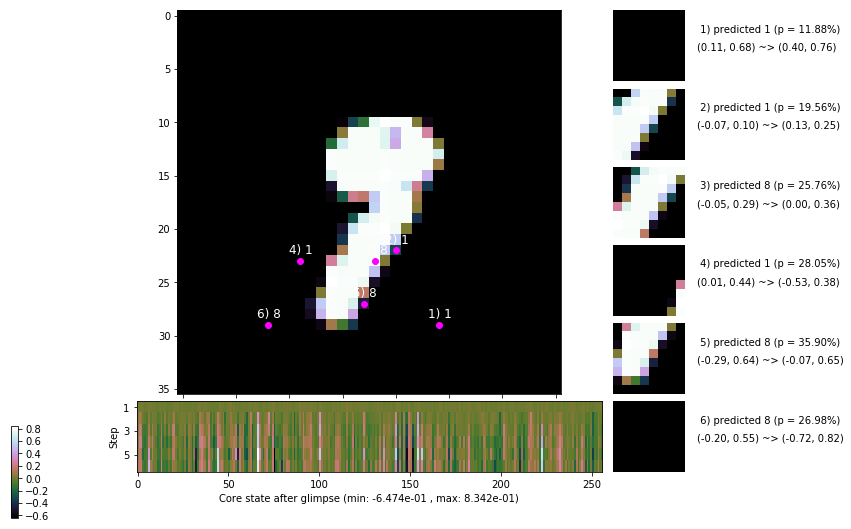

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 176.5 ms/b | lr: 9.96e-04 | grad 2norm: 15.82 | grad inf norm:  5.277
         Weights || abs max:  0.60 ( 3120.06) | mean:  1.27e-03 ( 0.02) | var: 5.69e-03 (  109.49)
          Biases || abs max:  0.21 (  566.62) | mean:  1.72e-02 ( 0.64) | var: 1.41e-03 ( 1646.78)
                    class loss: 1.368 | steps: 3.769 | reward:  0.594 | acc.: 52.95%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 175.6 ms/b | lr: 9.95e-04 | grad 2norm: 16.52 | grad inf norm:  4.948
         Weights || abs max:  0.63 ( 6752.59) | mean:  1.12e-03 ( 0.03) | var: 6.66e-03 ( 2385.02)
          Biases || abs max:  0.23 (  365.68) | mean:  1.72e-02 ( 0.46) | var: 1.75e-03 ( 1022.15)
                    class loss: 1.240 | steps: 3.619 | reward:  0.886 | acc.: 56.30%

	Target class: 9 | Discounted rewards: [-0.234, 0.531, -0

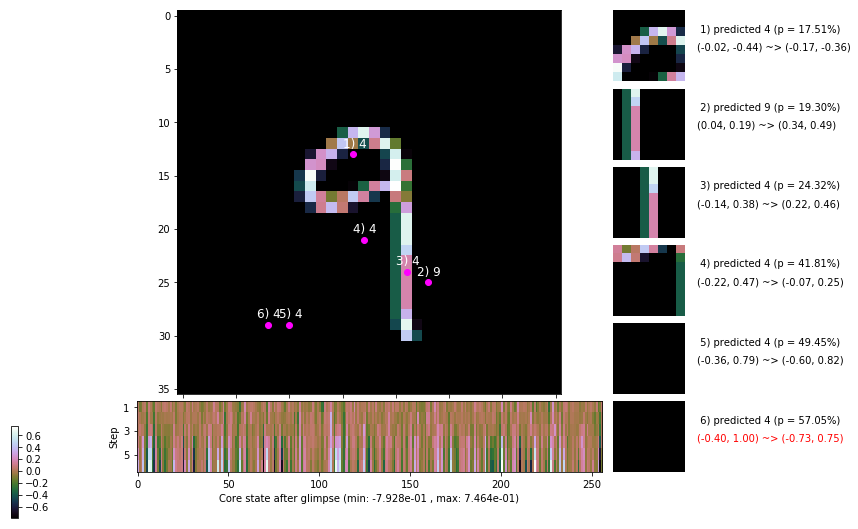

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 187.6 ms/b | lr: 9.93e-04 | grad 2norm: 17.43 | grad inf norm:  5.097
         Weights || abs max:  0.66 ( 4849.46) | mean:  1.14e-03 ( 0.02) | var: 7.47e-03 ( 1007.22)
          Biases || abs max:  0.24 (  349.08) | mean:  1.55e-02 ( 0.41) | var: 2.07e-03 ( 1113.19)
                    class loss: 1.152 | steps: 3.486 | reward:  1.131 | acc.: 58.70%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 182.8 ms/b | lr: 9.92e-04 | grad 2norm: 17.68 | grad inf norm:  4.978
         Weights || abs max:  0.72 ( 5550.18) | mean:  1.08e-03 ( 0.02) | var: 8.20e-03 (  882.05)
          Biases || abs max:  0.25 ( 1681.36) | mean:  1.40e-02 ( 1.00) | var: 2.40e-03 (187161.42)
                    class loss: 1.100 | steps: 3.391 | reward:  1.320 | acc.: 61.72%

	Target class: 3 | Discounted rewards: [-0.984, -0.969, 

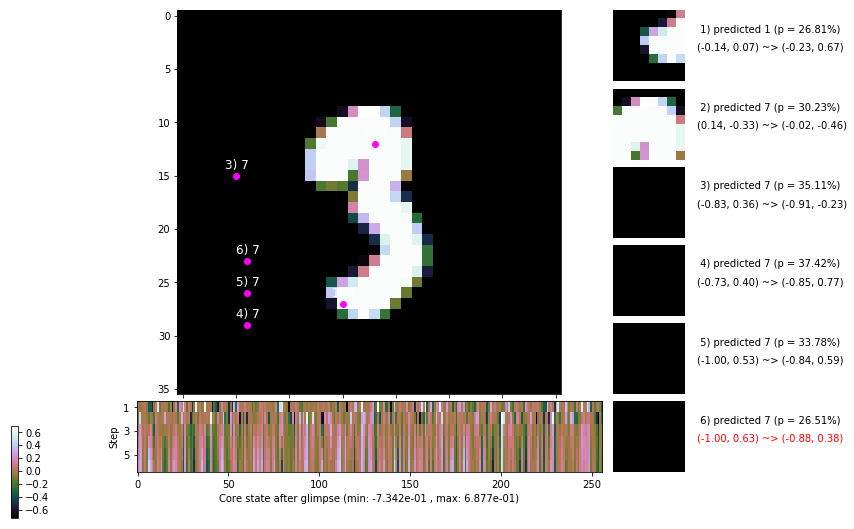

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 179.1 ms/b | lr: 9.90e-04 | grad 2norm: 18.49 | grad inf norm:  5.242
         Weights || abs max:  0.83 ( 3515.96) | mean:  1.04e-03 ( 0.02) | var: 8.83e-03 (  154.45)
          Biases || abs max:  0.26 (  292.77) | mean:  1.25e-02 ( 0.34) | var: 2.77e-03 ( 1273.53)
                    class loss: 1.038 | steps: 3.279 | reward:  1.500 | acc.: 62.93%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 172.4 ms/b | lr: 9.89e-04 | grad 2norm: 18.51 | grad inf norm:  4.908
         Weights || abs max:  0.92 ( 3863.45) | mean:  9.27e-04 ( 0.02) | var: 9.42e-03 (  277.69)
          Biases || abs max:  0.28 (  413.95) | mean:  1.13e-02 ( 0.43) | var: 3.12e-03 ( 3486.44)
                    class loss: 1.024 | steps: 3.279 | reward:  1.541 | acc.: 63.52%

	Target class: 3 | Discounted rewards: [-0.656, -0.312, 0

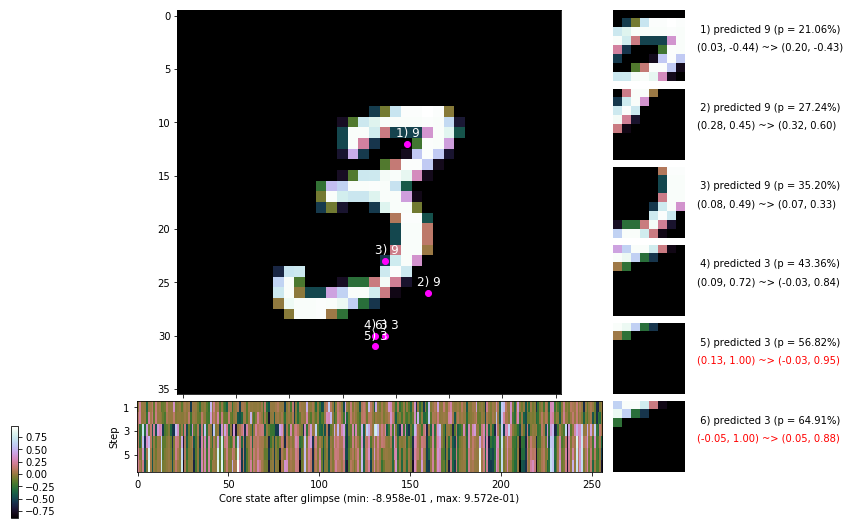

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 179.6 ms/b | lr: 9.87e-04 | grad 2norm: 18.70 | grad inf norm:  4.860
         Weights || abs max:  0.96 ( 3192.31) | mean:  8.73e-04 ( 0.02) | var: 9.94e-03 (  162.35)
          Biases || abs max:  0.31 (  162.84) | mean:  8.80e-03 ( 0.25) | var: 3.50e-03 (  106.97)
                    class loss: 0.979 | steps: 3.206 | reward:  1.685 | acc.: 65.47%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 168.1 ms/b | lr: 9.86e-04 | grad 2norm: 19.43 | grad inf norm:  5.001
         Weights || abs max:  0.96 ( 5801.82) | mean:  9.10e-04 ( 0.02) | var: 1.04e-02 ( 2652.89)
          Biases || abs max:  0.33 (  219.32) | mean:  7.46e-03 ( 0.25) | var: 3.86e-03 (  614.75)
                    class loss: 0.932 | steps: 3.123 | reward:  1.837 | acc.: 66.58%

	Target class: 1 | Discounted rewards: [-0.656, -0.312, 0

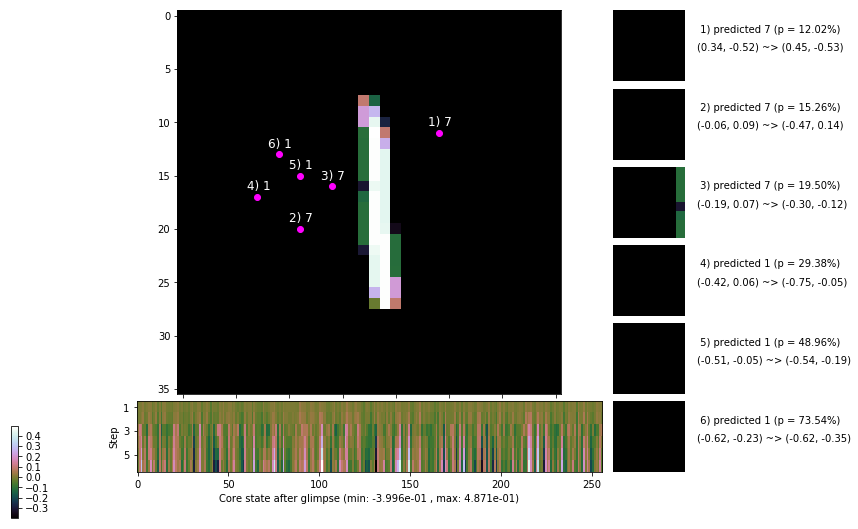

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


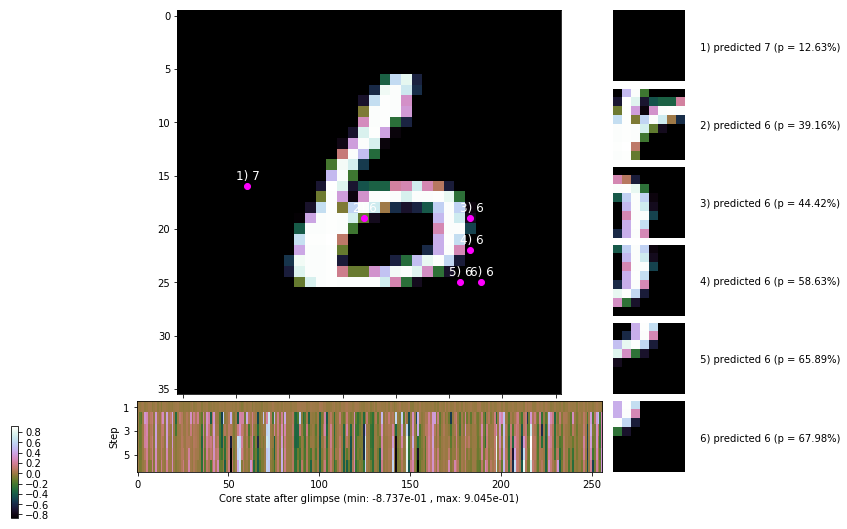


	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


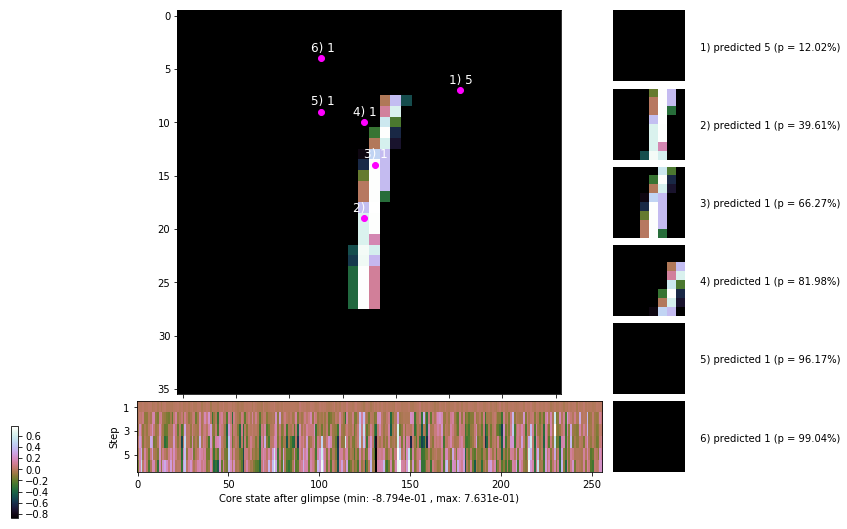

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


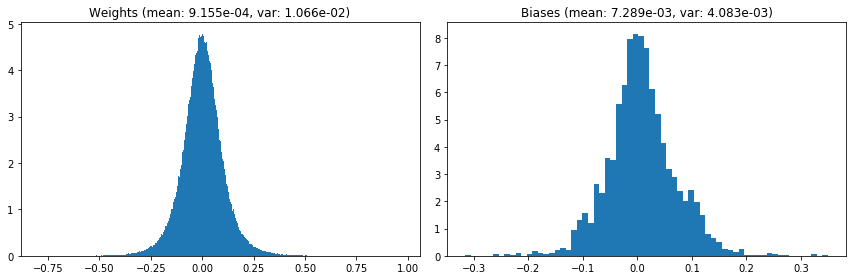

                                      Location network weights and biases


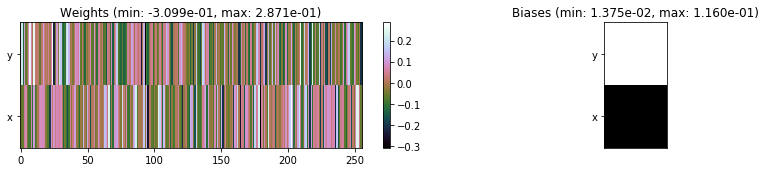

---------------------------------------------------------------------------------------------------------------
Elapsed time:  526.21 sec | TRAIN >> class loss: 1.2516 | steps:  3.581    | reward:  0.9322    | acc.: 55.633% 
                          | VAL   >> class loss: 0.8502 | steps:  2.919    | reward:  2.1978    | acc.: 68.920% 


Epoch   2/400) lr = 0.0009851
 b    300/  3000 >> 184.2 ms/b | lr: 9.84e-04 | grad 2norm: 19.69 | grad inf norm:  5.241
         Weights || abs max:  0.96 ( 2971.88) | mean:  8.94e-04 ( 0.02) | var: 1.09e-02 (  365.67)
          Biases || abs max:  0.35 (  260.07) | mean:  6.49e-03 ( 0.29) | var: 4.24e-03 ( 1258.28)
                    class loss: 0.923 | steps: 3.085 | reward:  1.897 | acc.: 67.55%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 155.1 ms/b | lr: 9.83e-04 | grad 2norm: 19.50 | grad inf norm:  4.983
         Weights || abs max:  0.95 ( 4962.02) | mean:  9.41e-04 ( 0.0

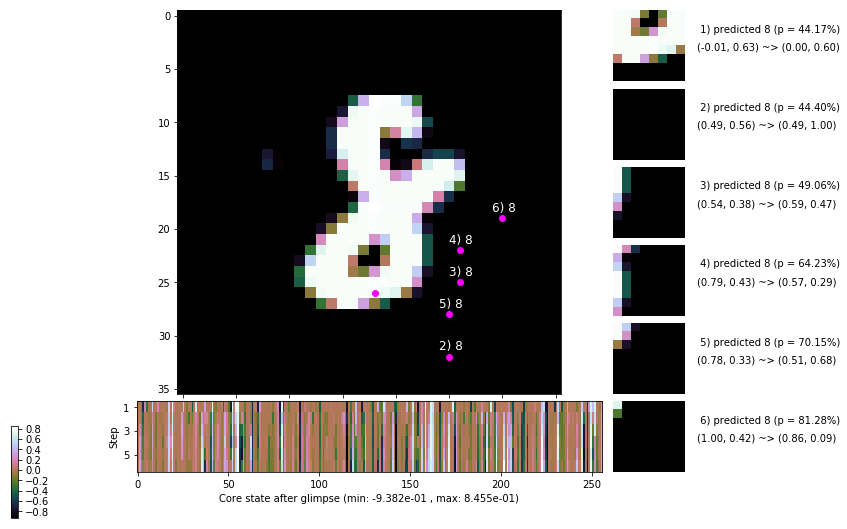

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.9 ms/b | lr: 9.81e-04 | grad 2norm: 20.16 | grad inf norm:  5.201
         Weights || abs max:  0.96 ( 8837.06) | mean:  8.71e-04 ( 0.03) | var: 1.18e-02 ( 6500.33)
          Biases || abs max:  0.39 (  400.81) | mean:  2.65e-03 ( 0.32) | var: 5.07e-03 ( 3242.17)
                    class loss: 0.919 | steps: 3.112 | reward:  1.879 | acc.: 67.12%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 166.8 ms/b | lr: 9.80e-04 | grad 2norm: 19.88 | grad inf norm:  5.034
         Weights || abs max:  0.97 (11130.45) | mean:  9.00e-04 ( 0.03) | var: 1.22e-02 (30401.31)
          Biases || abs max:  0.40 (  224.18) | mean:  1.03e-04 ( 0.27) | var: 5.47e-03 (  538.91)
                    class loss: 0.894 | steps: 3.046 | reward:  1.980 | acc.: 68.48%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

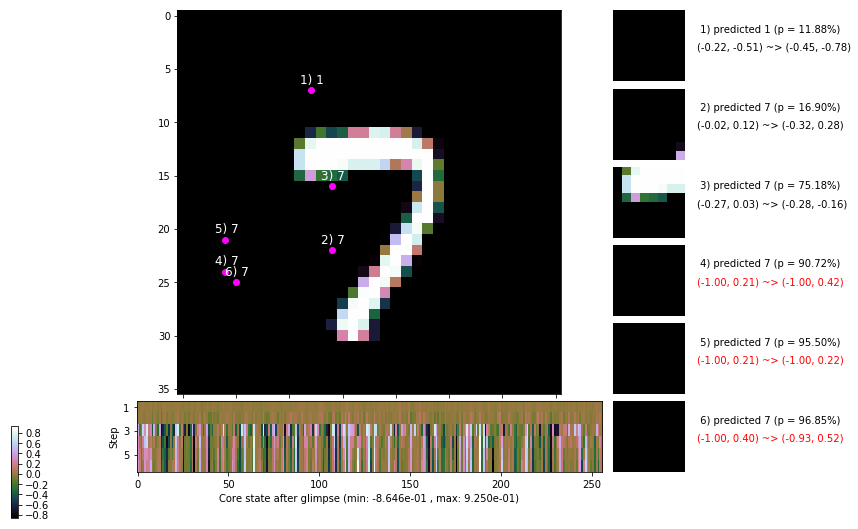

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 173.1 ms/b | lr: 9.78e-04 | grad 2norm: 19.94 | grad inf norm:  5.239
         Weights || abs max:  0.96 ( 3210.99) | mean:  8.23e-04 ( 0.02) | var: 1.26e-02 (  201.50)
          Biases || abs max:  0.41 (  322.45) | mean: -2.27e-03 ( 0.30) | var: 5.87e-03 ( 3950.31)
                    class loss: 0.893 | steps: 3.031 | reward:  2.048 | acc.: 69.53%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 172.4 ms/b | lr: 9.77e-04 | grad 2norm: 20.00 | grad inf norm:  5.006
         Weights || abs max:  0.95 ( 2830.57) | mean:  8.11e-04 ( 0.02) | var: 1.30e-02 (  165.08)
          Biases || abs max:  0.42 (  119.66) | mean: -3.99e-03 ( 0.17) | var: 6.25e-03 (   50.38)
                    class loss: 0.864 | steps: 3.038 | reward:  2.026 | acc.: 69.35%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

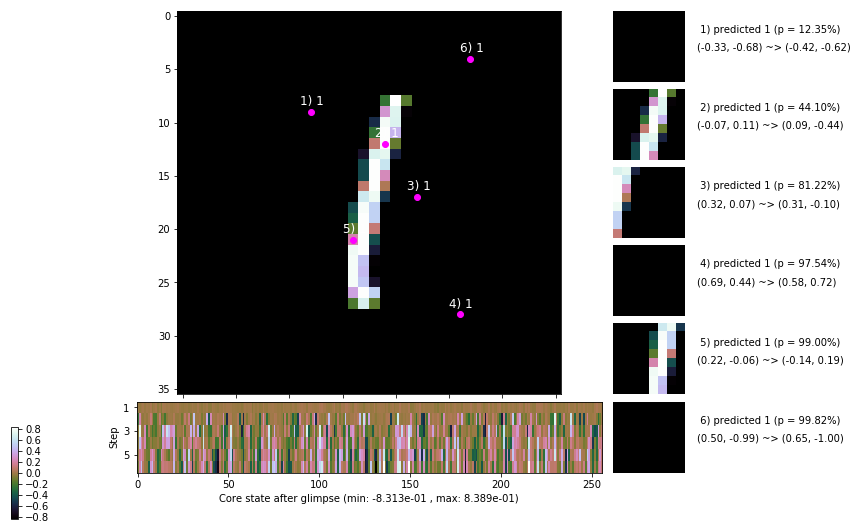

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 177.8 ms/b | lr: 9.75e-04 | grad 2norm: 20.10 | grad inf norm:  5.224
         Weights || abs max:  0.96 ( 3219.47) | mean:  7.87e-04 ( 0.02) | var: 1.34e-02 (  273.38)
          Biases || abs max:  0.44 (  119.09) | mean: -6.28e-03 ( 0.15) | var: 6.71e-03 (  169.57)
                    class loss: 0.882 | steps: 3.031 | reward:  2.000 | acc.: 68.37%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 175.2 ms/b | lr: 9.74e-04 | grad 2norm: 20.46 | grad inf norm:  5.233
         Weights || abs max:  1.00 ( 3868.67) | mean:  7.48e-04 ( 0.02) | var: 1.38e-02 (  657.31)
          Biases || abs max:  0.45 (  326.83) | mean: -7.17e-03 ( 0.31) | var: 7.06e-03 ( 5696.44)
                    class loss: 0.793 | steps: 2.932 | reward:  2.259 | acc.: 72.07%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

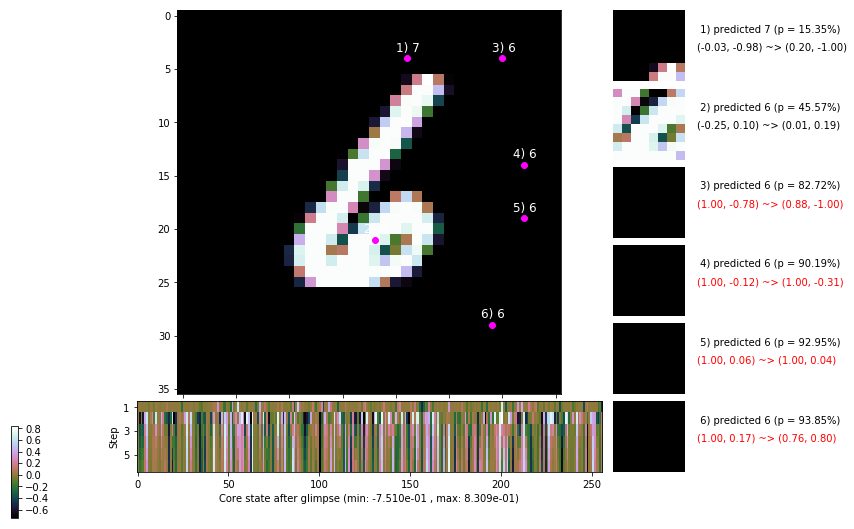

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.3 ms/b | lr: 9.72e-04 | grad 2norm: 20.31 | grad inf norm:  4.985
         Weights || abs max:  1.01 ( 3181.96) | mean:  7.77e-04 ( 0.02) | var: 1.42e-02 (  288.10)
          Biases || abs max:  0.46 (  355.96) | mean: -8.95e-03 ( 0.27) | var: 7.57e-03 ( 2462.13)
                    class loss: 0.810 | steps: 2.921 | reward:  2.246 | acc.: 71.20%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 157.1 ms/b | lr: 9.71e-04 | grad 2norm: 20.57 | grad inf norm:  4.892
         Weights || abs max:  1.04 ( 4880.73) | mean:  7.28e-04 ( 0.02) | var: 1.45e-02 ( 3321.76)
          Biases || abs max:  0.47 (  148.98) | mean: -1.07e-02 ( 0.18) | var: 7.98e-03 (  113.35)
                    class loss: 0.797 | steps: 2.879 | reward:  2.316 | acc.: 71.82%

	Target class: 6 | Discounted rewards: [1.219, 0.438, 1.8

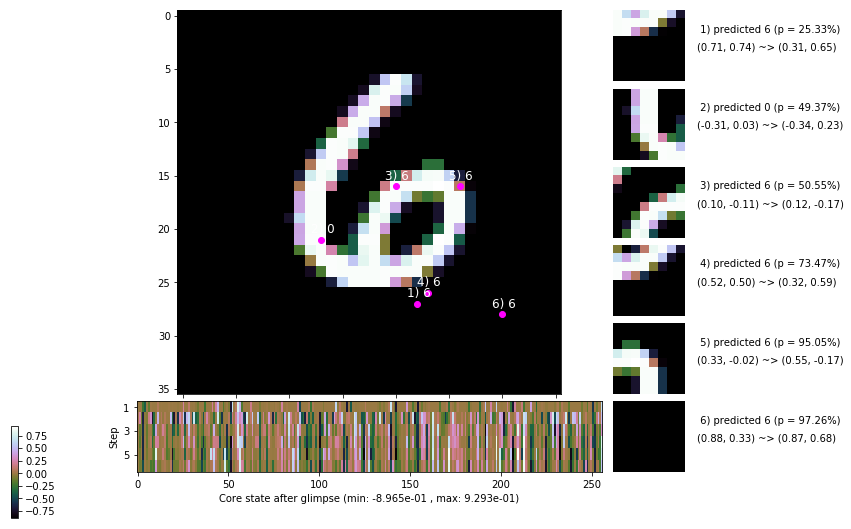

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


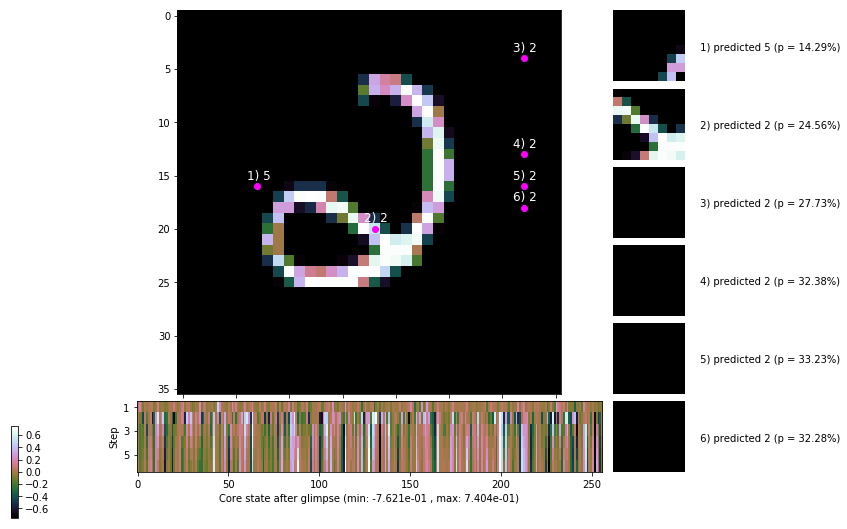


	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


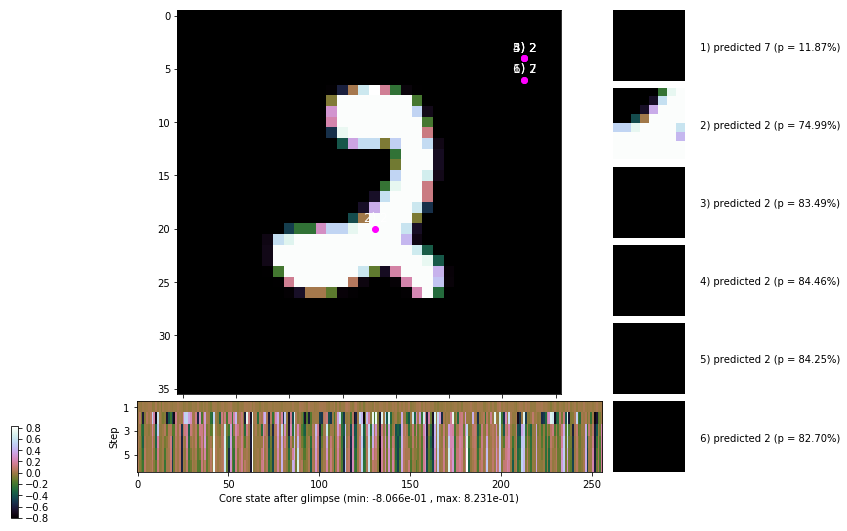

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


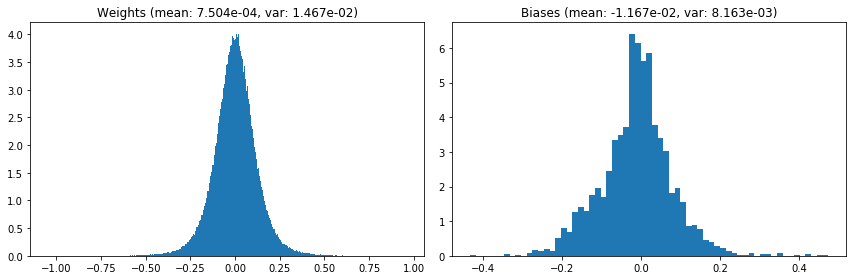

                                      Location network weights and biases


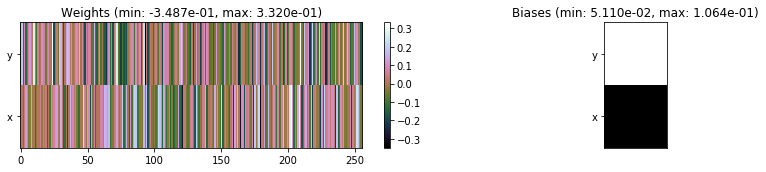

---------------------------------------------------------------------------------------------------------------
Elapsed time:  503.06 sec | TRAIN >> class loss: 0.8717 | steps:  3.023    | reward:  2.0423    | acc.: 69.180% 
                          | VAL   >> class loss: 0.7384 | steps:  2.690    | reward:  2.6343    | acc.: 73.580% 


Epoch   3/400) lr = 0.0009704
 b    300/  3000 >> 158.0 ms/b | lr: 9.69e-04 | grad 2norm: 20.11 | grad inf norm:  4.867
         Weights || abs max:  1.05 (17819.03) | mean:  6.93e-04 ( 0.04) | var: 1.49e-02 (106025.64)
          Biases || abs max:  0.47 (  150.15) | mean: -1.24e-02 ( 0.17) | var: 8.34e-03 (  210.35)
                    class loss: 0.783 | steps: 2.878 | reward:  2.307 | acc.: 72.35%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 156.8 ms/b | lr: 9.68e-04 | grad 2norm: 20.26 | grad inf norm:  4.947
         Weights || abs max:  1.08 ( 8247.82) | mean:  6.61e-04 ( 0.

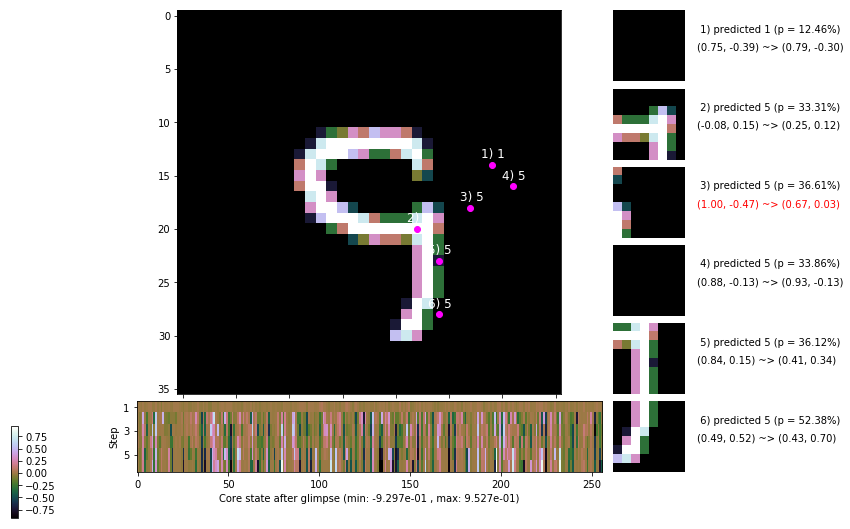

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.4 ms/b | lr: 9.67e-04 | grad 2norm: 20.42 | grad inf norm:  4.966
         Weights || abs max:  1.09 ( 3899.15) | mean:  6.06e-04 ( 0.02) | var: 1.56e-02 (  322.69)
          Biases || abs max:  0.50 (  355.67) | mean: -1.54e-02 ( 0.33) | var: 9.25e-03 (10380.84)
                    class loss: 0.731 | steps: 2.860 | reward:  2.400 | acc.: 73.72%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 156.5 ms/b | lr: 9.66e-04 | grad 2norm: 20.44 | grad inf norm:  4.993
         Weights || abs max:  1.14 ( 4059.98) | mean:  5.49e-04 ( 0.02) | var: 1.59e-02 (  744.60)
          Biases || abs max:  0.51 (  196.05) | mean: -1.77e-02 ( 0.21) | var: 9.67e-03 ( 1111.45)
                    class loss: 0.699 | steps: 2.795 | reward:  2.527 | acc.: 75.13%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

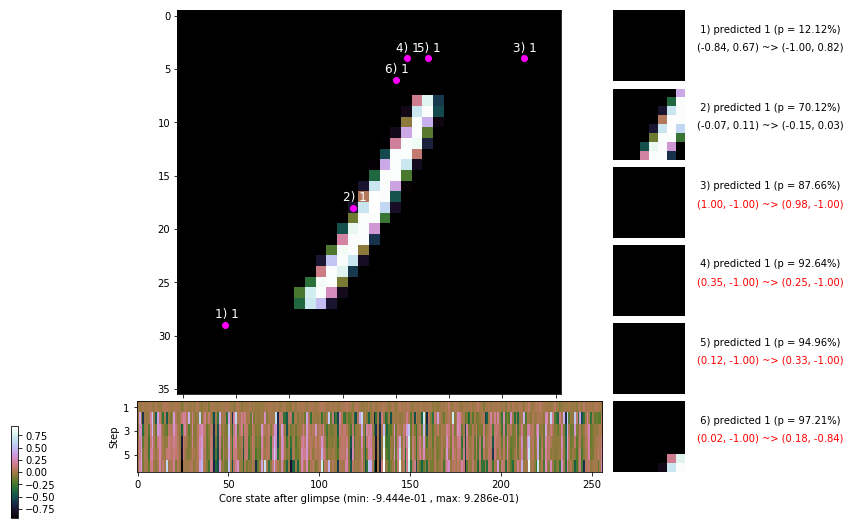

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 162.2 ms/b | lr: 9.64e-04 | grad 2norm: 21.07 | grad inf norm:  5.174
         Weights || abs max:  1.16 ( 4131.48) | mean:  5.18e-04 ( 0.02) | var: 1.62e-02 (  341.74)
          Biases || abs max:  0.52 (  127.77) | mean: -1.90e-02 ( 0.14) | var: 1.00e-02 (  191.46)
                    class loss: 0.706 | steps: 2.842 | reward:  2.480 | acc.: 75.40%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 159.5 ms/b | lr: 9.63e-04 | grad 2norm: 20.90 | grad inf norm:  4.941
         Weights || abs max:  1.19 ( 5734.34) | mean:  4.71e-04 ( 0.02) | var: 1.66e-02 ( 2283.01)
          Biases || abs max:  0.53 (  118.20) | mean: -2.06e-02 ( 0.13) | var: 1.05e-02 (  113.06)
                    class loss: 0.673 | steps: 2.763 | reward:  2.596 | acc.: 76.17%

	Target class: 5 | Discounted rewards: [-0.984, -0.969, -

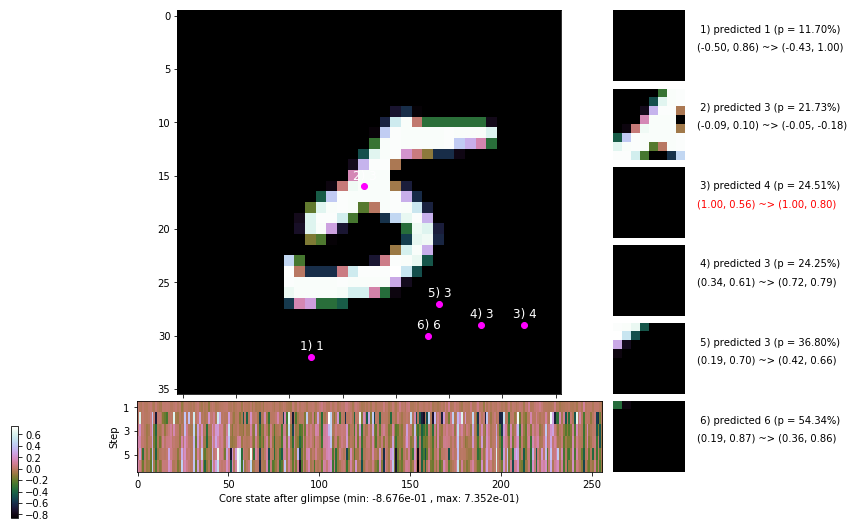

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 157.1 ms/b | lr: 9.61e-04 | grad 2norm: 20.81 | grad inf norm:  4.981
         Weights || abs max:  1.19 ( 3343.24) | mean:  4.41e-04 ( 0.02) | var: 1.69e-02 (  233.17)
          Biases || abs max:  0.54 (   64.43) | mean: -2.16e-02 ( 0.10) | var: 1.09e-02 (   23.04)
                    class loss: 0.669 | steps: 2.787 | reward:  2.570 | acc.: 76.25%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 159.8 ms/b | lr: 9.60e-04 | grad 2norm: 20.19 | grad inf norm:  4.764
         Weights || abs max:  1.20 ( 4525.04) | mean:  4.58e-04 ( 0.02) | var: 1.72e-02 ( 1325.55)
          Biases || abs max:  0.55 (  172.60) | mean: -2.33e-02 ( 0.16) | var: 1.13e-02 (  475.61)
                    class loss: 0.630 | steps: 2.707 | reward:  2.676 | acc.: 77.73%

	Target class: 0 | Discounted rewards: [1.922, 1.844, 1.6

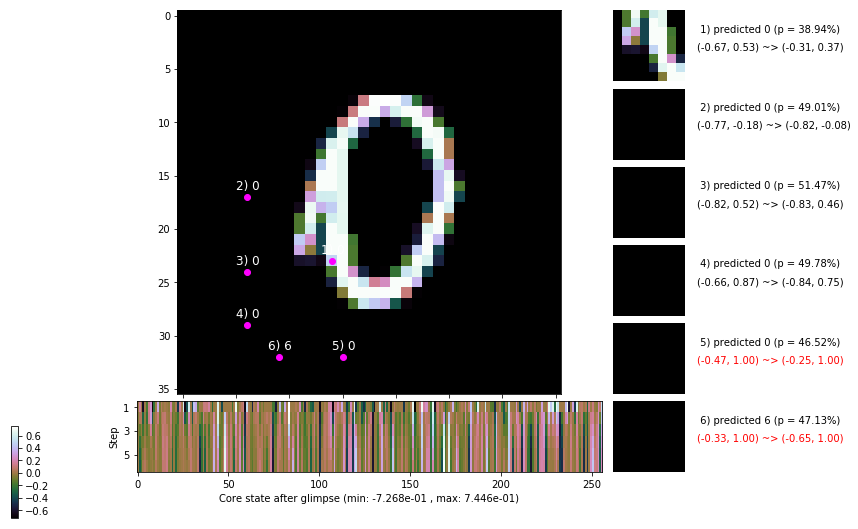

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 157.0 ms/b | lr: 9.58e-04 | grad 2norm: 20.16 | grad inf norm:  4.650
         Weights || abs max:  1.22 ( 4952.88) | mean:  4.17e-04 ( 0.02) | var: 1.75e-02 ( 1401.04)
          Biases || abs max:  0.56 (  383.18) | mean: -2.52e-02 ( 0.33) | var: 1.17e-02 (10148.00)
                    class loss: 0.644 | steps: 2.717 | reward:  2.663 | acc.: 77.50%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.5 ms/b | lr: 9.57e-04 | grad 2norm: 20.37 | grad inf norm:  4.869
         Weights || abs max:  1.24 ( 3339.57) | mean:  3.45e-04 ( 0.02) | var: 1.79e-02 (  225.25)
          Biases || abs max:  0.56 (  116.48) | mean: -2.67e-02 ( 0.13) | var: 1.22e-02 (  172.95)
                    class loss: 0.641 | steps: 2.708 | reward:  2.686 | acc.: 77.77%

	Target class: 3 | Discounted rewards: [-0.984, -0.969, -

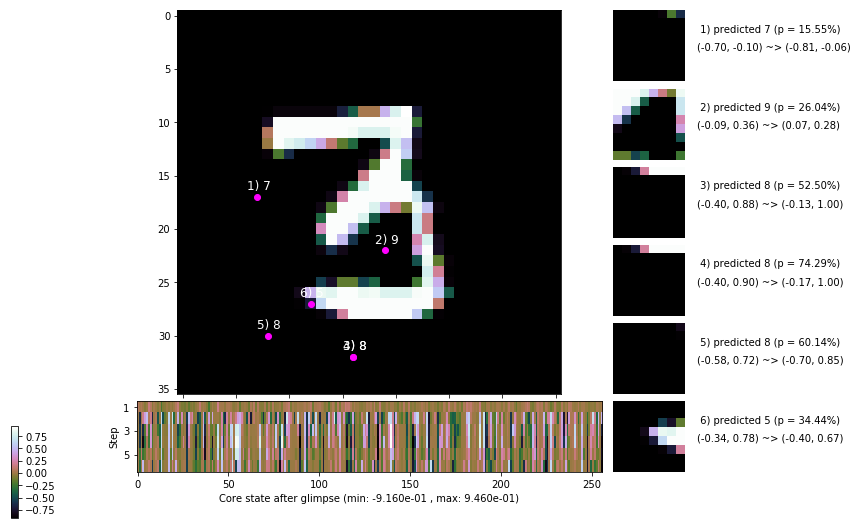

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


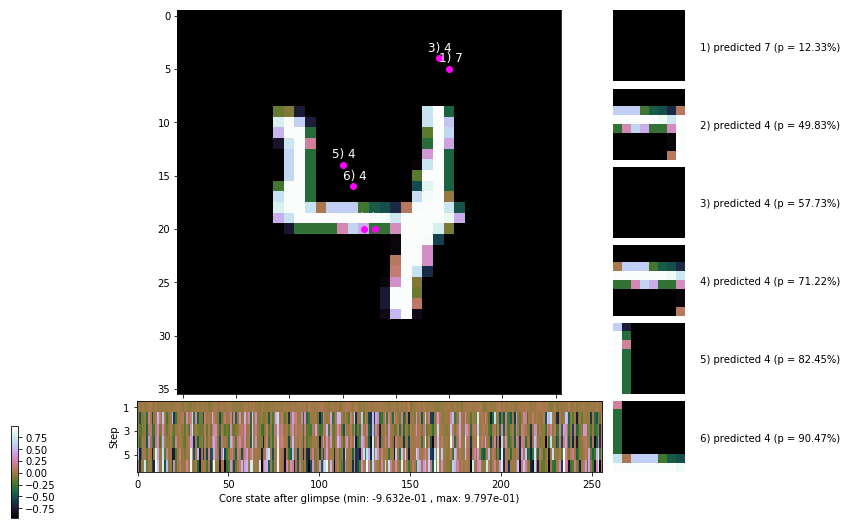


	Target class: 3 | Discounted rewards: [-0.656, -0.312, 0.375, 1.750, 1.500, 1.000]


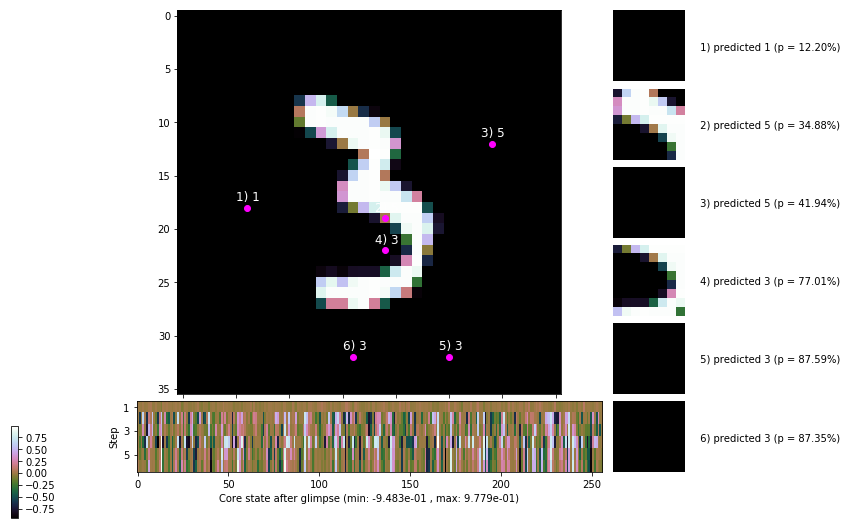

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


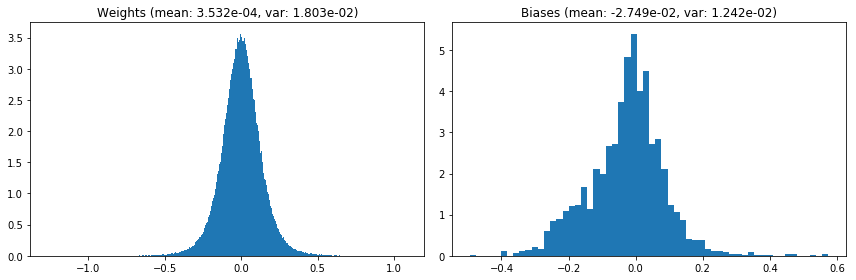

                                      Location network weights and biases


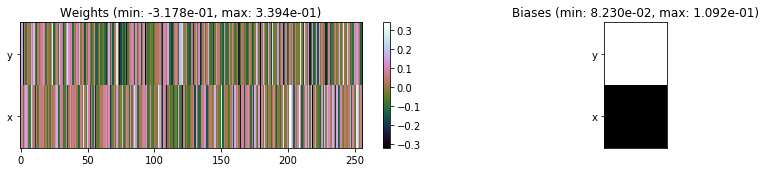

---------------------------------------------------------------------------------------------------------------
Elapsed time:  477.09 sec | TRAIN >> class loss: 0.6903 | steps:  2.790    | reward:  2.5288    | acc.: 75.523% 
                          | VAL   >> class loss: 0.5745 | steps:  2.609    | reward:  2.9103    | acc.: 79.680% 


Epoch   4/400) lr = 0.000956
 b    300/  3000 >> 157.4 ms/b | lr: 9.55e-04 | grad 2norm: 20.16 | grad inf norm:  4.813
         Weights || abs max:  1.27 ( 3609.58) | mean:  3.67e-04 ( 0.02) | var: 1.82e-02 (  231.82)
          Biases || abs max:  0.58 (   86.36) | mean: -2.84e-02 ( 0.11) | var: 1.27e-02 (   49.27)
                    class loss: 0.609 | steps: 2.688 | reward:  2.742 | acc.: 79.17%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.1 ms/b | lr: 9.54e-04 | grad 2norm: 20.10 | grad inf norm:  4.553
         Weights || abs max:  1.27 ( 5054.79) | mean:  4.09e-04 ( 0.02

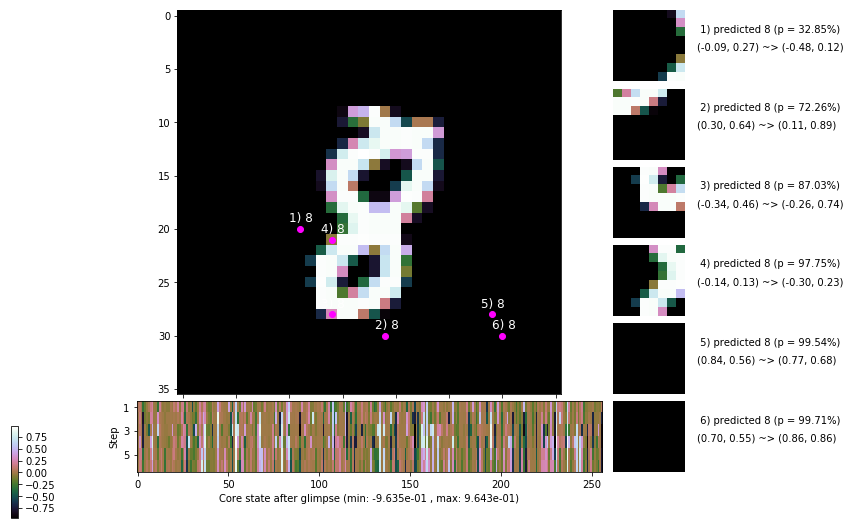

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.4 ms/b | lr: 9.52e-04 | grad 2norm: 20.64 | grad inf norm:  4.889
         Weights || abs max:  1.29 ( 7333.84) | mean:  3.74e-04 ( 0.02) | var: 1.88e-02 ( 3549.20)
          Biases || abs max:  0.58 (   74.70) | mean: -3.11e-02 ( 0.10) | var: 1.36e-02 (   38.92)
                    class loss: 0.614 | steps: 2.703 | reward:  2.702 | acc.: 77.98%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 156.8 ms/b | lr: 9.51e-04 | grad 2norm: 20.47 | grad inf norm:  4.701
         Weights || abs max:  1.31 (10774.04) | mean:  3.23e-04 ( 0.03) | var: 1.91e-02 (24477.88)
          Biases || abs max:  0.59 (   99.86) | mean: -3.20e-02 ( 0.11) | var: 1.40e-02 (   68.68)
                    class loss: 0.630 | steps: 2.699 | reward:  2.708 | acc.: 77.78%

	Target class: 7 | Discounted rewards: [-0.281, 0.438, 1.

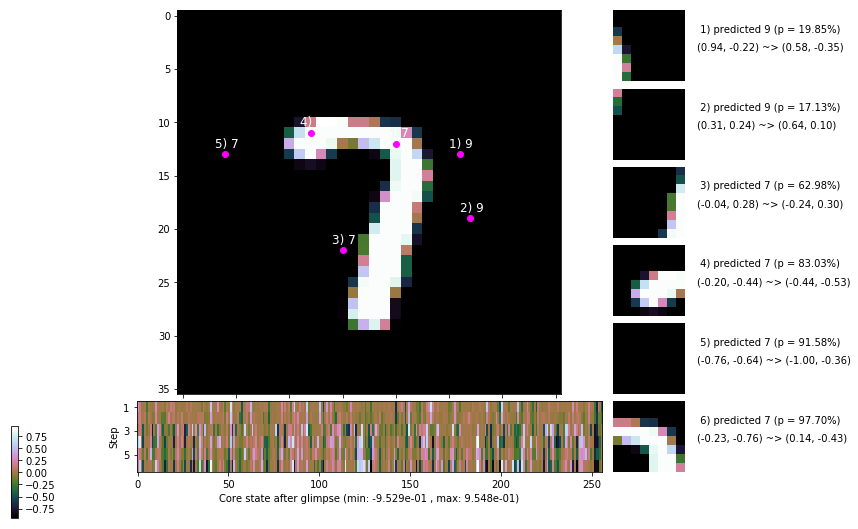

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.4 ms/b | lr: 9.49e-04 | grad 2norm: 20.37 | grad inf norm:  4.681
         Weights || abs max:  1.34 (50065.66) | mean:  3.44e-04 ( 0.10) | var: 1.94e-02 (1197888.00)
          Biases || abs max:  0.60 (  105.49) | mean: -3.25e-02 ( 0.11) | var: 1.44e-02 (  181.12)
                    class loss: 0.625 | steps: 2.659 | reward:  2.756 | acc.: 77.88%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 159.2 ms/b | lr: 9.48e-04 | grad 2norm: 20.25 | grad inf norm:  4.744
         Weights || abs max:  1.36 ( 3342.03) | mean:  3.64e-04 ( 0.02) | var: 1.97e-02 (  167.91)
          Biases || abs max:  0.61 (   82.34) | mean: -3.33e-02 ( 0.10) | var: 1.48e-02 (   79.25)
                    class loss: 0.641 | steps: 2.711 | reward:  2.684 | acc.: 77.83%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1

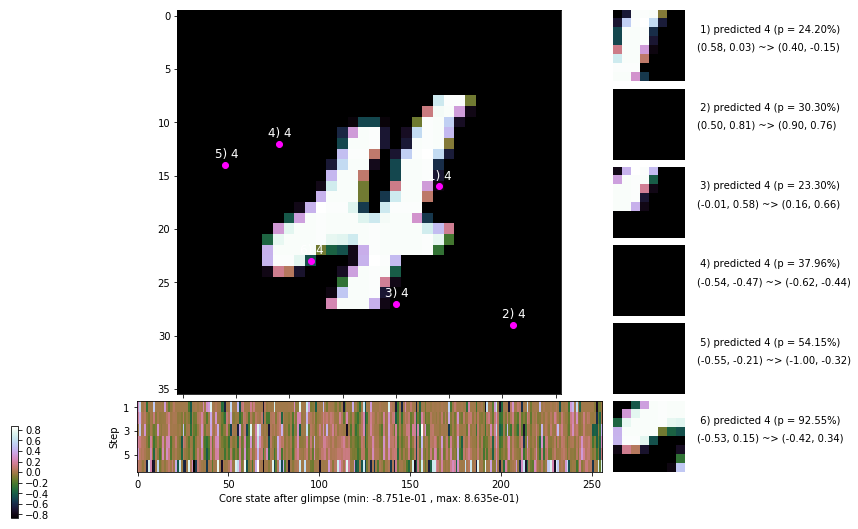

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 160.7 ms/b | lr: 9.46e-04 | grad 2norm: 20.03 | grad inf norm:  4.500
         Weights || abs max:  1.36 (20287.62) | mean:  2.98e-04 ( 0.05) | var: 2.00e-02 (133525.98)
          Biases || abs max:  0.61 (   59.75) | mean: -3.48e-02 ( 0.09) | var: 1.52e-02 (    9.97)
                    class loss: 0.631 | steps: 2.692 | reward:  2.727 | acc.: 78.08%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 159.6 ms/b | lr: 9.46e-04 | grad 2norm: 19.88 | grad inf norm:  4.628
         Weights || abs max:  1.36 ( 4336.49) | mean:  2.57e-04 ( 0.02) | var: 2.03e-02 (  488.61)
          Biases || abs max:  0.61 (  192.30) | mean: -3.67e-02 ( 0.18) | var: 1.58e-02 ( 1235.36)
                    class loss: 0.629 | steps: 2.675 | reward:  2.772 | acc.: 78.75%

	Target class: 4 | Discounted rewards: [-0.281, 0.438, 1

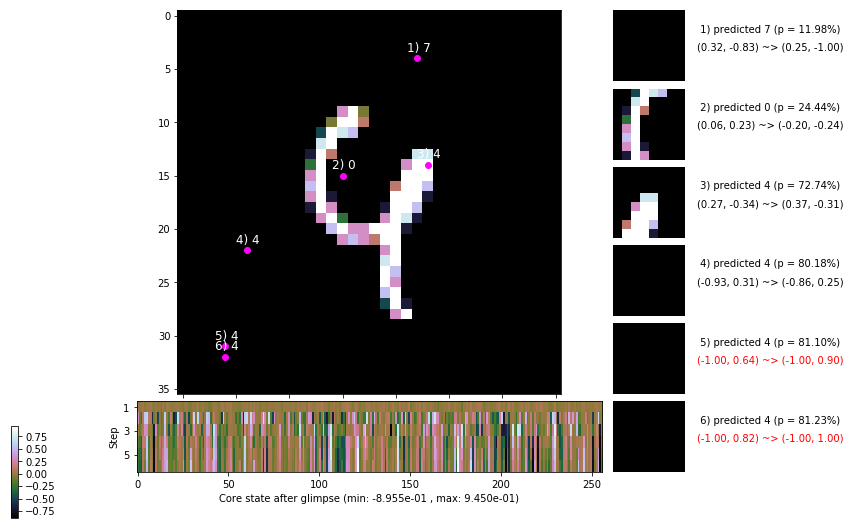

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.3 ms/b | lr: 9.44e-04 | grad 2norm: 19.90 | grad inf norm:  4.815
         Weights || abs max:  1.36 ( 3766.43) | mean:  2.12e-04 ( 0.02) | var: 2.05e-02 (  337.73)
          Biases || abs max:  0.61 (  364.87) | mean: -3.82e-02 ( 0.32) | var: 1.62e-02 (19218.89)
                    class loss: 0.586 | steps: 2.631 | reward:  2.851 | acc.: 79.77%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 157.5 ms/b | lr: 9.43e-04 | grad 2norm: 20.16 | grad inf norm:  4.833
         Weights || abs max:  1.37 ( 2265.73) | mean:  1.74e-04 ( 0.01) | var: 2.08e-02 (   72.88)
          Biases || abs max:  0.63 (   81.81) | mean: -3.87e-02 ( 0.09) | var: 1.66e-02 (   38.19)
                    class loss: 0.593 | steps: 2.631 | reward:  2.840 | acc.: 79.22%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

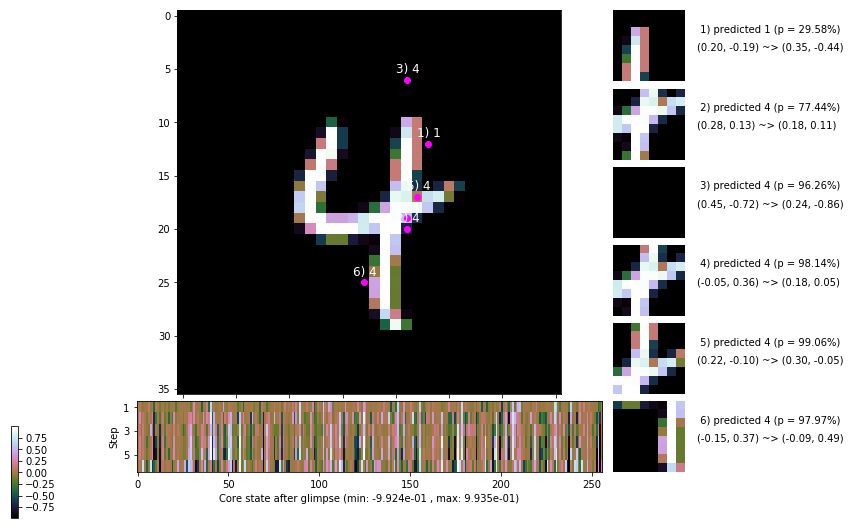

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


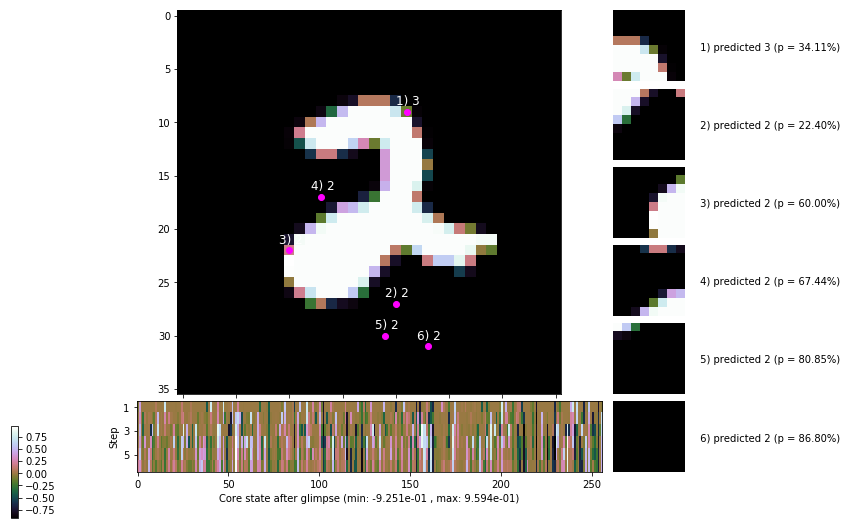


	Target class: 8 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


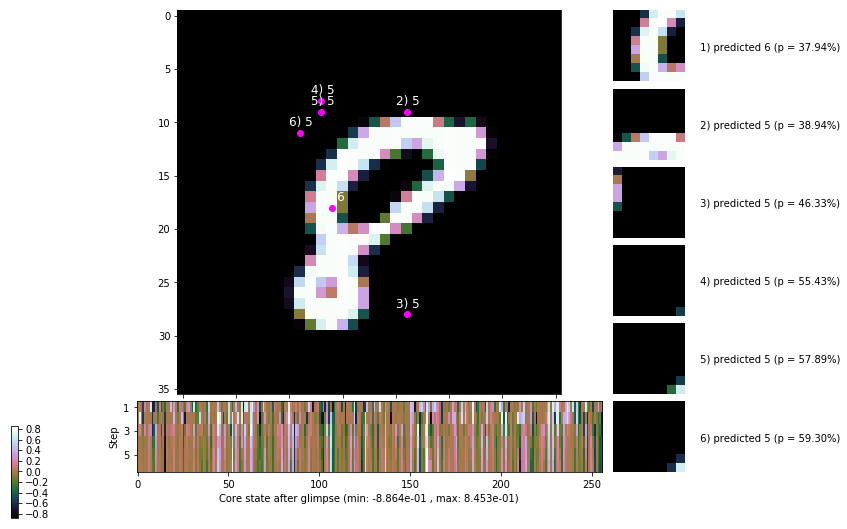

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


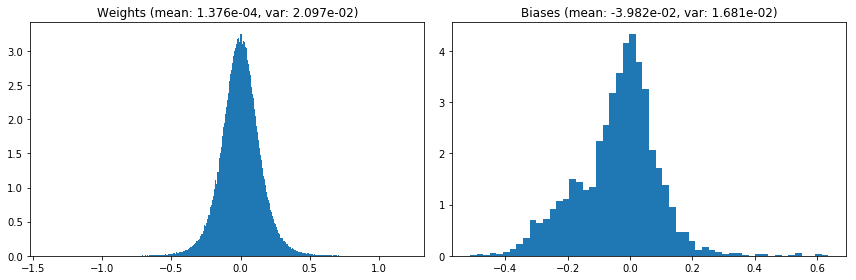

                                      Location network weights and biases


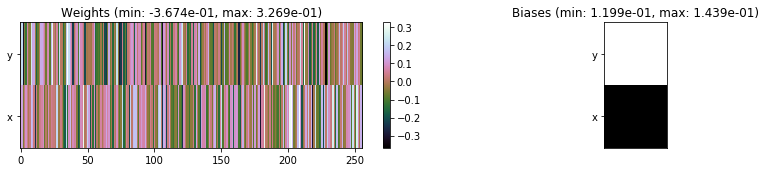

---------------------------------------------------------------------------------------------------------------
Elapsed time:  478.96 sec | TRAIN >> class loss: 0.6165 | steps:  2.679    | reward:  2.7509    | acc.: 78.557% 
                          | VAL   >> class loss: 0.5341 | steps:  2.501    | reward:  3.0981    | acc.: 81.800% 


Epoch   5/400) lr = 0.0009417
 b    300/  3000 >> 157.5 ms/b | lr: 9.41e-04 | grad 2norm: 20.19 | grad inf norm:  4.669
         Weights || abs max:  1.40 ( 2488.81) | mean:  1.40e-04 ( 0.02) | var: 2.11e-02 (   71.15)
          Biases || abs max:  0.64 (  123.81) | mean: -4.02e-02 ( 0.13) | var: 1.70e-02 (  420.13)
                    class loss: 0.584 | steps: 2.644 | reward:  2.838 | acc.: 80.32%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 159.7 ms/b | lr: 9.40e-04 | grad 2norm: 19.73 | grad inf norm:  4.639
         Weights || abs max:  1.43 ( 6349.40) | mean:  1.28e-04 ( 0.0

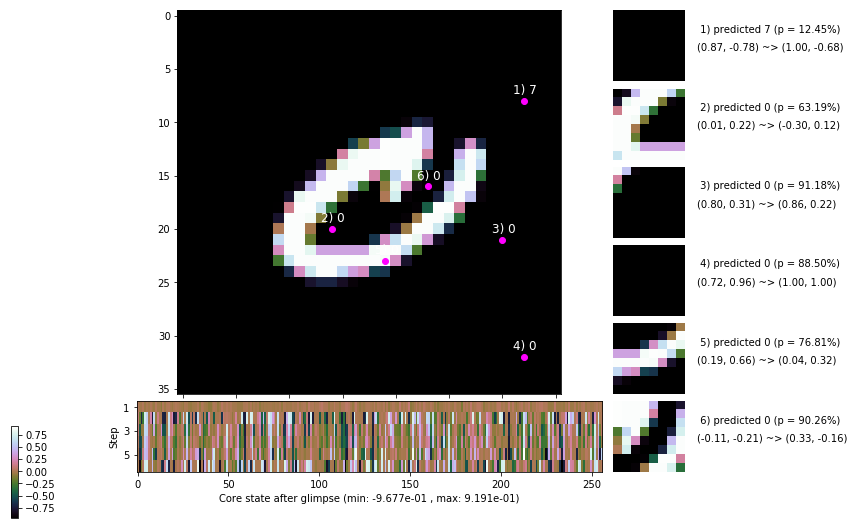

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.2 ms/b | lr: 9.38e-04 | grad 2norm: 19.67 | grad inf norm:  4.541
         Weights || abs max:  1.43 ( 6387.47) | mean:  8.76e-05 ( 0.02) | var: 2.17e-02 ( 2133.23)
          Biases || abs max:  0.67 (   88.46) | mean: -4.18e-02 ( 0.09) | var: 1.76e-02 (   74.62)
                    class loss: 0.557 | steps: 2.609 | reward:  2.929 | acc.: 81.13%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.7 ms/b | lr: 9.37e-04 | grad 2norm: 19.81 | grad inf norm:  4.669
         Weights || abs max:  1.43 ( 4588.51) | mean:  1.42e-04 ( 0.02) | var: 2.20e-02 (  823.85)
          Biases || abs max:  0.67 (   50.79) | mean: -4.29e-02 ( 0.08) | var: 1.81e-02 (    6.64)
                    class loss: 0.551 | steps: 2.592 | reward:  2.943 | acc.: 80.83%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.8

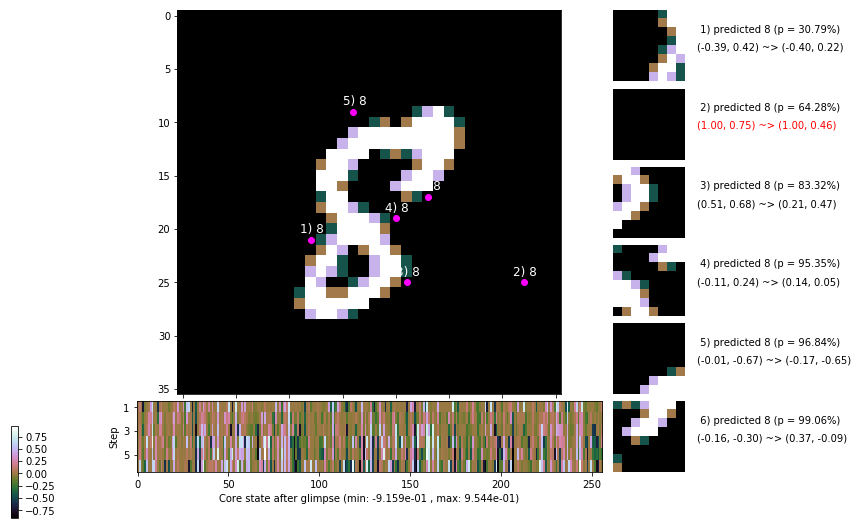

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 181.8 ms/b | lr: 9.35e-04 | grad 2norm: 19.90 | grad inf norm:  4.659
         Weights || abs max:  1.44 ( 2642.31) | mean:  1.81e-04 ( 0.01) | var: 2.22e-02 (  163.37)
          Biases || abs max:  0.67 (   50.92) | mean: -4.42e-02 ( 0.07) | var: 1.86e-02 (    9.83)
                    class loss: 0.560 | steps: 2.587 | reward:  2.928 | acc.: 80.63%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 169.4 ms/b | lr: 9.34e-04 | grad 2norm: 19.85 | grad inf norm:  4.684
         Weights || abs max:  1.44 ( 2947.56) | mean:  1.60e-04 ( 0.02) | var: 2.25e-02 (  113.39)
          Biases || abs max:  0.68 (  800.17) | mean: -4.50e-02 ( 0.37) | var: 1.90e-02 (58329.89)
                    class loss: 0.537 | steps: 2.591 | reward:  2.959 | acc.: 80.87%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

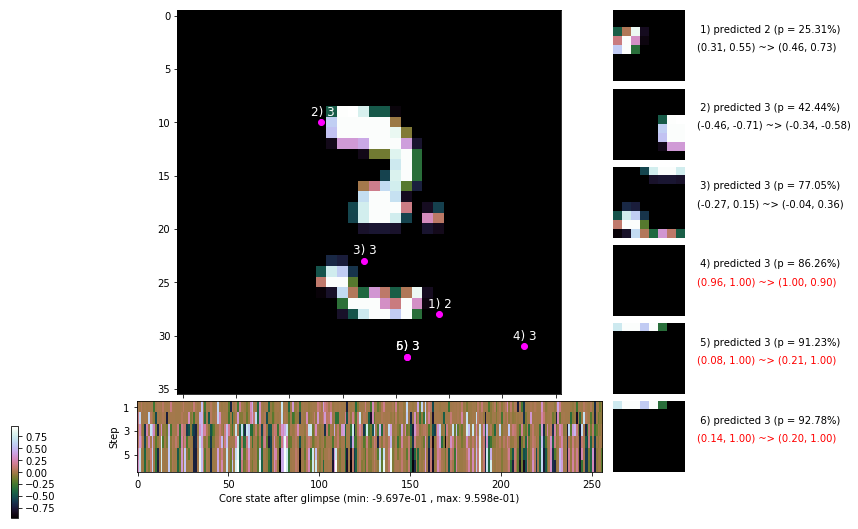

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 181.4 ms/b | lr: 9.32e-04 | grad 2norm: 19.64 | grad inf norm:  4.436
         Weights || abs max:  1.46 ( 2349.28) | mean:  1.47e-04 ( 0.01) | var: 2.28e-02 (   56.91)
          Biases || abs max:  0.68 (   71.78) | mean: -4.58e-02 ( 0.09) | var: 1.94e-02 (   25.40)
                    class loss: 0.549 | steps: 2.575 | reward:  2.955 | acc.: 81.03%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 180.4 ms/b | lr: 9.31e-04 | grad 2norm: 19.77 | grad inf norm:  4.620
         Weights || abs max:  1.48 ( 4426.83) | mean:  1.35e-04 ( 0.02) | var: 2.30e-02 (  791.91)
          Biases || abs max:  0.68 (   61.08) | mean: -4.66e-02 ( 0.08) | var: 1.98e-02 (   12.04)
                    class loss: 0.542 | steps: 2.583 | reward:  2.985 | acc.: 81.65%

	Target class: 3 | Discounted rewards: [-0.656, -0.312, 0

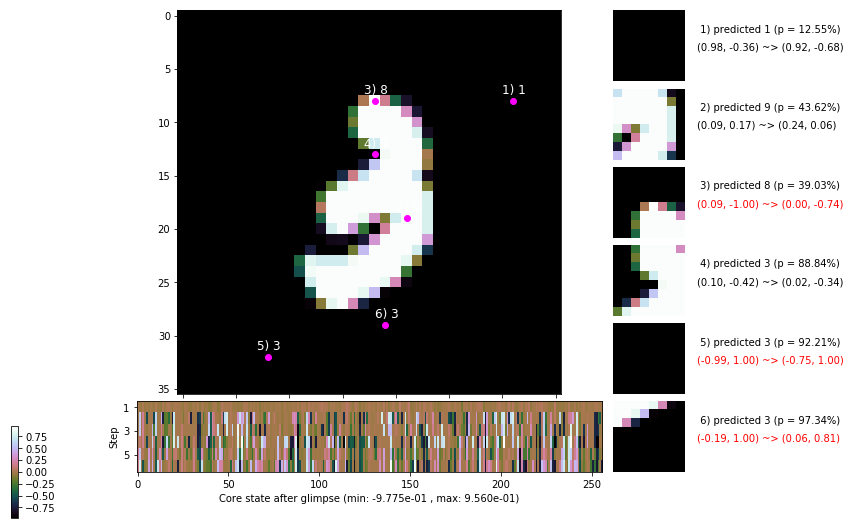

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 177.8 ms/b | lr: 9.30e-04 | grad 2norm: 19.94 | grad inf norm:  4.554
         Weights || abs max:  1.50 (68365.08) | mean:  1.26e-04 ( 0.13) | var: 2.33e-02 (2375538.25)
          Biases || abs max:  0.69 ( 2153.05) | mean: -4.69e-02 ( 0.89) | var: 2.01e-02 (504486.44)
                    class loss: 0.531 | steps: 2.596 | reward:  2.965 | acc.: 81.42%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 174.5 ms/b | lr: 9.29e-04 | grad 2norm: 19.73 | grad inf norm:  4.598
         Weights || abs max:  1.52 ( 3168.89) | mean:  1.38e-04 ( 0.02) | var: 2.35e-02 (  154.19)
          Biases || abs max:  0.70 (  125.30) | mean: -4.79e-02 ( 0.10) | var: 2.05e-02 (  290.22)
                    class loss: 0.528 | steps: 2.533 | reward:  3.052 | acc.: 82.20%

	Target class: 1 | Discounted rewards: [0.469, 1.938, 

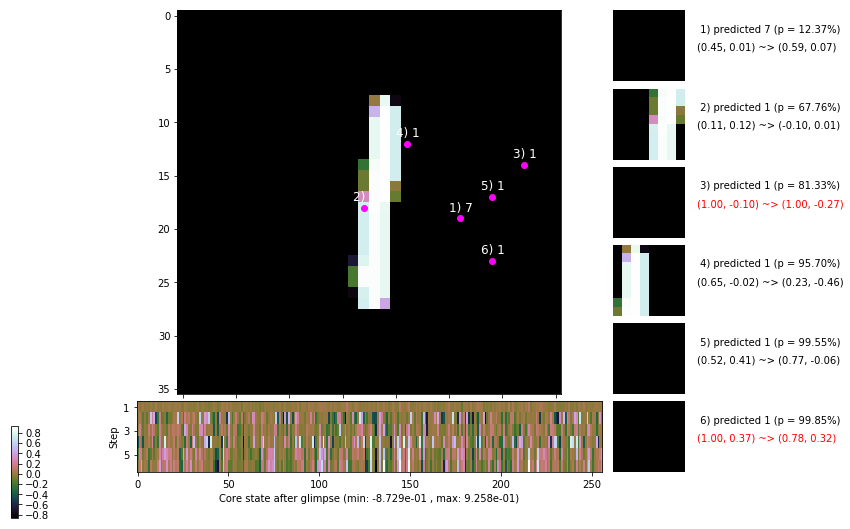

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


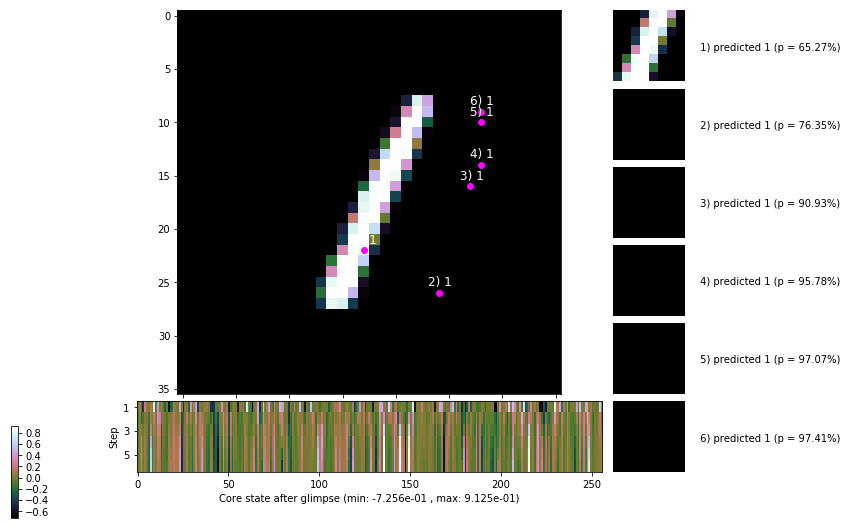


	Target class: 0 | Discounted rewards: [-0.656, -0.312, 0.375, 1.750, 1.500, 1.000]


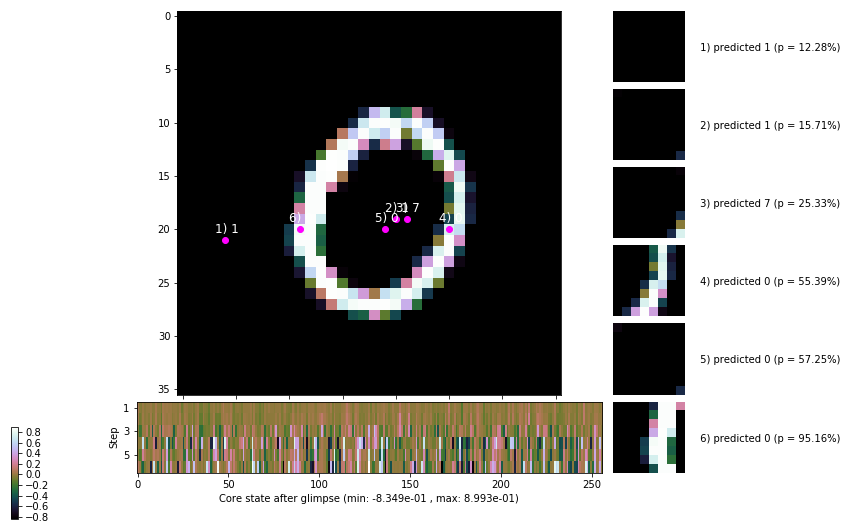

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


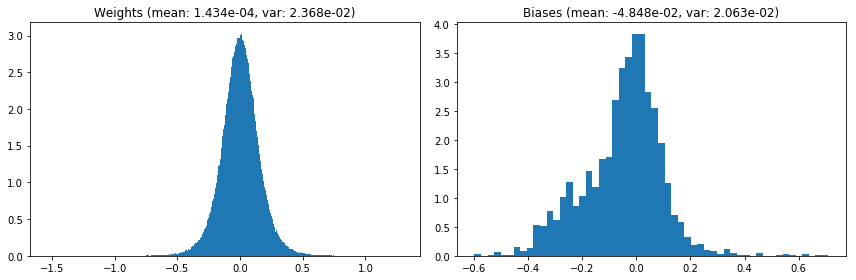

                                      Location network weights and biases


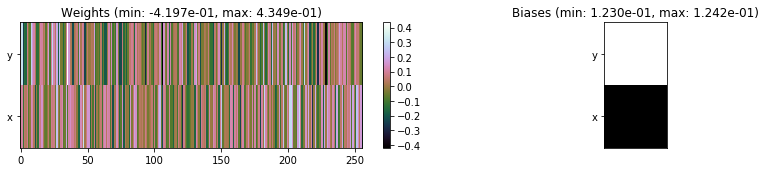

---------------------------------------------------------------------------------------------------------------
Elapsed time:  511.17 sec | TRAIN >> class loss: 0.5474 | steps:  2.589    | reward:  2.9541    | acc.: 81.200% 
                          | VAL   >> class loss: 0.4728 | steps:  2.412    | reward:  3.2883    | acc.: 84.480% 


Epoch   6/400) lr = 0.0009277
 b    300/  3000 >> 199.6 ms/b | lr: 9.27e-04 | grad 2norm: 19.73 | grad inf norm:  4.539
         Weights || abs max:  1.54 ( 3315.01) | mean:  1.66e-04 ( 0.02) | var: 2.38e-02 (  334.12)
          Biases || abs max:  0.71 (   86.48) | mean: -4.93e-02 ( 0.09) | var: 2.08e-02 (   63.61)
                    class loss: 0.530 | steps: 2.548 | reward:  3.039 | acc.: 82.33%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 175.9 ms/b | lr: 9.26e-04 | grad 2norm: 19.68 | grad inf norm:  4.452
         Weights || abs max:  1.55 ( 2226.64) | mean:  1.63e-04 ( 0.0

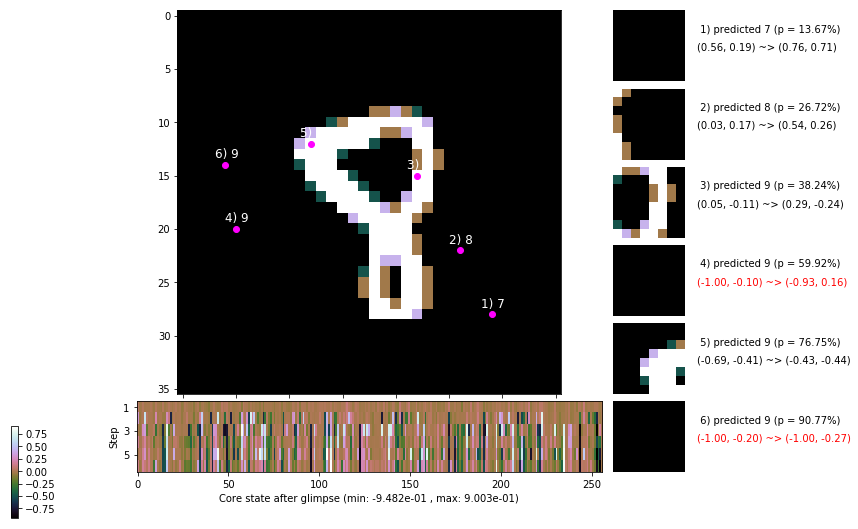

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 175.2 ms/b | lr: 9.24e-04 | grad 2norm: 19.49 | grad inf norm:  4.656
         Weights || abs max:  1.55 ( 8674.69) | mean:  1.38e-04 ( 0.03) | var: 2.43e-02 (18143.04)
          Biases || abs max:  0.72 (  109.02) | mean: -5.04e-02 ( 0.09) | var: 2.14e-02 (  140.10)
                    class loss: 0.502 | steps: 2.568 | reward:  3.039 | acc.: 82.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 184.4 ms/b | lr: 9.23e-04 | grad 2norm: 19.43 | grad inf norm:  4.391
         Weights || abs max:  1.56 ( 3522.57) | mean:  1.59e-04 ( 0.02) | var: 2.46e-02 (  522.96)
          Biases || abs max:  0.73 (  124.85) | mean: -5.05e-02 ( 0.11) | var: 2.18e-02 (  178.10)
                    class loss: 0.511 | steps: 2.536 | reward:  3.063 | acc.: 82.65%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

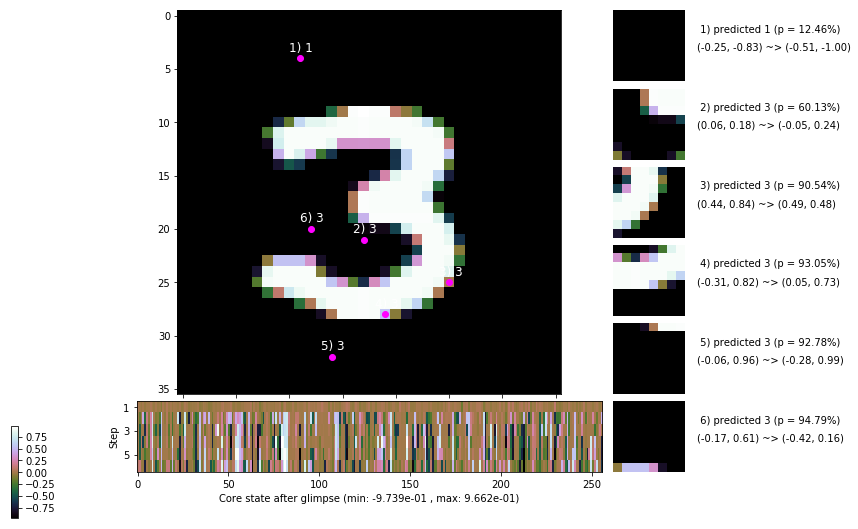

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 184.2 ms/b | lr: 9.21e-04 | grad 2norm: 19.53 | grad inf norm:  4.422
         Weights || abs max:  1.58 ( 2380.46) | mean:  1.44e-04 ( 0.01) | var: 2.48e-02 (   79.57)
          Biases || abs max:  0.73 (  114.91) | mean: -5.20e-02 ( 0.11) | var: 2.24e-02 (  220.12)
                    class loss: 0.514 | steps: 2.560 | reward:  3.056 | acc.: 82.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 180.6 ms/b | lr: 9.20e-04 | grad 2norm: 19.23 | grad inf norm:  4.489
         Weights || abs max:  1.61 ( 4111.29) | mean:  1.15e-04 ( 0.02) | var: 2.51e-02 ( 1130.64)
          Biases || abs max:  0.73 (  465.64) | mean: -5.28e-02 ( 0.24) | var: 2.27e-02 (12409.82)
                    class loss: 0.519 | steps: 2.535 | reward:  3.065 | acc.: 82.42%

	Target class: 7 | Discounted rewards: [0.516, -0.969, -0

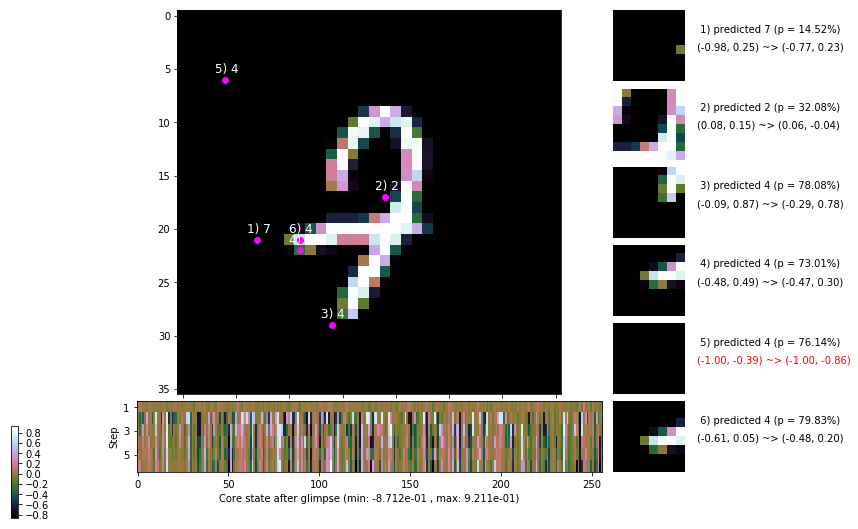

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 172.5 ms/b | lr: 9.18e-04 | grad 2norm: 19.28 | grad inf norm:  4.396
         Weights || abs max:  1.62 ( 7532.20) | mean:  1.18e-04 ( 0.02) | var: 2.53e-02 ( 7444.93)
          Biases || abs max:  0.73 (   68.00) | mean: -5.33e-02 ( 0.08) | var: 2.31e-02 (   27.70)
                    class loss: 0.495 | steps: 2.545 | reward:  3.059 | acc.: 82.95%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 174.7 ms/b | lr: 9.18e-04 | grad 2norm: 18.92 | grad inf norm:  4.359
         Weights || abs max:  1.62 ( 8537.54) | mean:  7.98e-05 ( 0.03) | var: 2.56e-02 ( 8471.75)
          Biases || abs max:  0.73 (  107.49) | mean: -5.40e-02 ( 0.10) | var: 2.33e-02 (  215.21)
                    class loss: 0.482 | steps: 2.540 | reward:  3.084 | acc.: 83.43%

	Target class: 7 | Discounted rewards: [-0.703, -0.406, 0

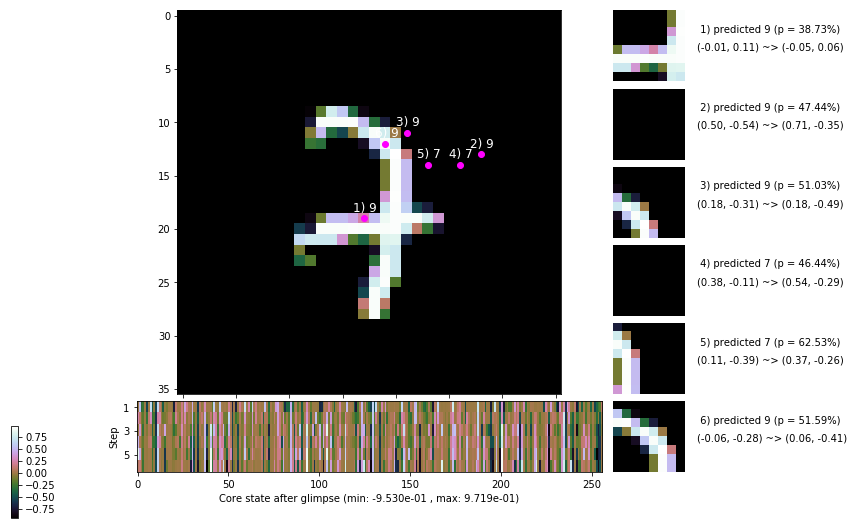

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 175.8 ms/b | lr: 9.16e-04 | grad 2norm: 19.29 | grad inf norm:  4.512
         Weights || abs max:  1.62 ( 3668.42) | mean:  2.39e-05 ( 0.02) | var: 2.58e-02 (  364.82)
          Biases || abs max:  0.74 (  133.71) | mean: -5.45e-02 ( 0.11) | var: 2.37e-02 (  244.72)
                    class loss: 0.492 | steps: 2.557 | reward:  3.046 | acc.: 83.23%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 176.0 ms/b | lr: 9.15e-04 | grad 2norm: 19.08 | grad inf norm:  4.512
         Weights || abs max:  1.63 ( 6323.32) | mean:  3.04e-05 ( 0.02) | var: 2.61e-02 ( 3949.79)
          Biases || abs max:  0.74 (   70.52) | mean: -5.52e-02 ( 0.08) | var: 2.41e-02 (   20.87)
                    class loss: 0.499 | steps: 2.521 | reward:  3.097 | acc.: 82.98%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.8

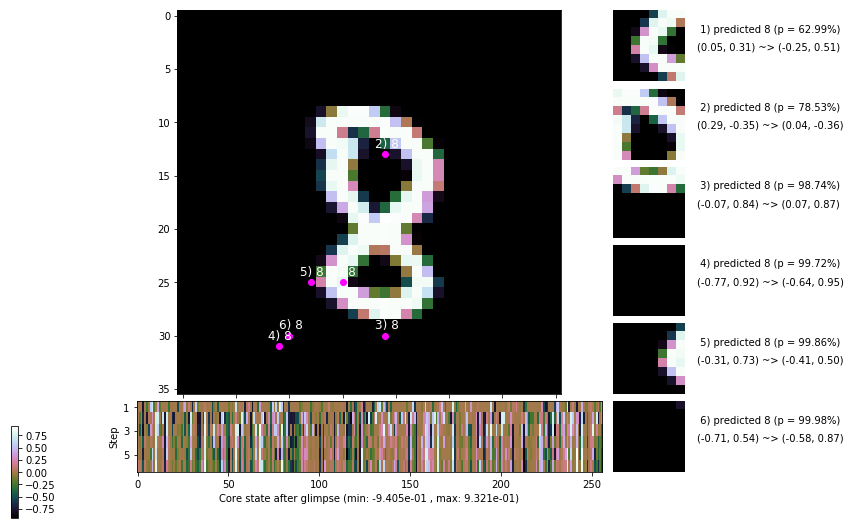

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [-0.938, -0.875, -0.750, -0.500, 0.000, 1.000]


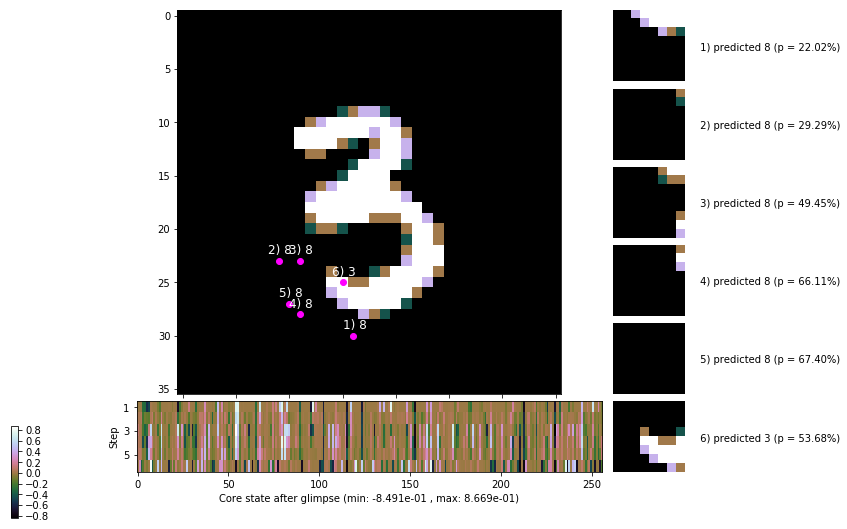


	Target class: 4 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


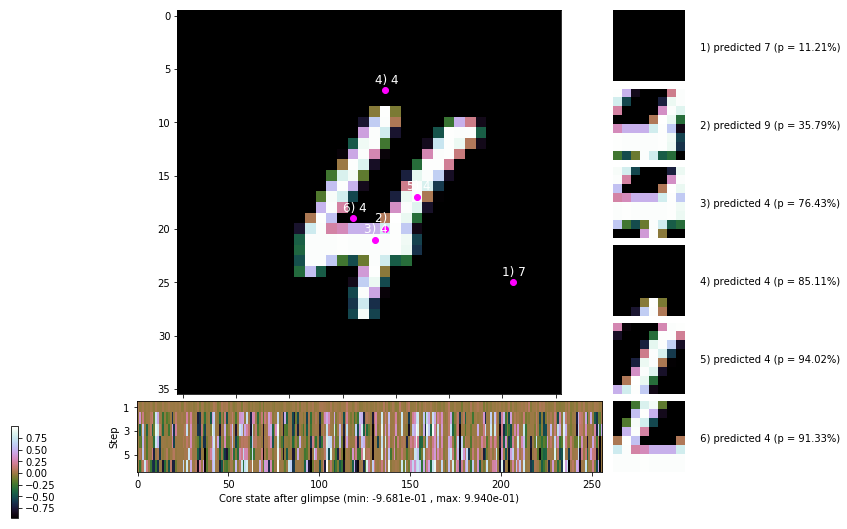

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


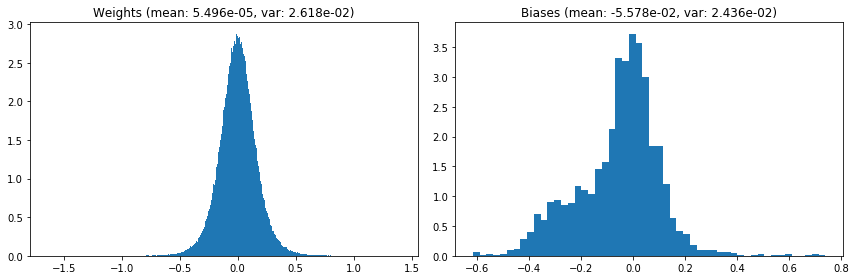

                                      Location network weights and biases


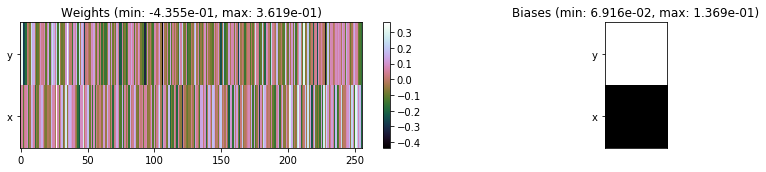

---------------------------------------------------------------------------------------------------------------
Elapsed time:  540.43 sec | TRAIN >> class loss: 0.5071 | steps:  2.547    | reward:  3.0583    | acc.: 82.718% 
                          | VAL   >> class loss: 0.4754 | steps:  2.430 :( | reward:  3.2736 :( | acc.: 83.700% :(


Epoch   7/400) lr = 0.0009139
 b    300/  3000 >> 173.0 ms/b | lr: 9.13e-04 | grad 2norm: 19.05 | grad inf norm:  4.602
         Weights || abs max:  1.64 ( 5798.74) | mean:  5.29e-05 ( 0.02) | var: 2.63e-02 ( 4194.50)
          Biases || abs max:  0.74 (  111.26) | mean: -5.63e-02 ( 0.11) | var: 2.45e-02 (  107.78)
                    class loss: 0.520 | steps: 2.566 | reward:  3.021 | acc.: 82.25%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 172.0 ms/b | lr: 9.12e-04 | grad 2norm: 19.06 | grad inf norm:  4.582
         Weights || abs max:  1.65 ( 4801.63) | mean:  3.87e-05 ( 0

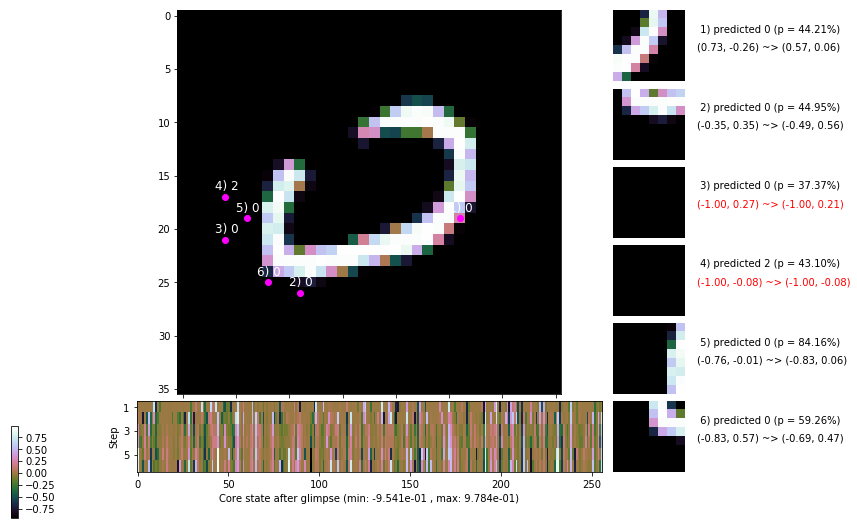

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 179.2 ms/b | lr: 9.10e-04 | grad 2norm: 18.96 | grad inf norm:  4.514
         Weights || abs max:  1.65 ( 3780.03) | mean:  1.33e-05 ( 0.02) | var: 2.68e-02 (  351.85)
          Biases || abs max:  0.74 (   74.70) | mean: -5.86e-02 ( 0.09) | var: 2.55e-02 (   29.62)
                    class loss: 0.524 | steps: 2.560 | reward:  3.034 | acc.: 81.88%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 171.0 ms/b | lr: 9.09e-04 | grad 2norm: 19.06 | grad inf norm:  4.542
         Weights || abs max:  1.65 ( 4265.04) | mean: -1.46e-05 ( 0.02) | var: 2.70e-02 (  494.76)
          Biases || abs max:  0.73 (   59.33) | mean: -5.91e-02 ( 0.08) | var: 2.58e-02 (    9.46)
                    class loss: 0.509 | steps: 2.545 | reward:  3.068 | acc.: 82.43%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

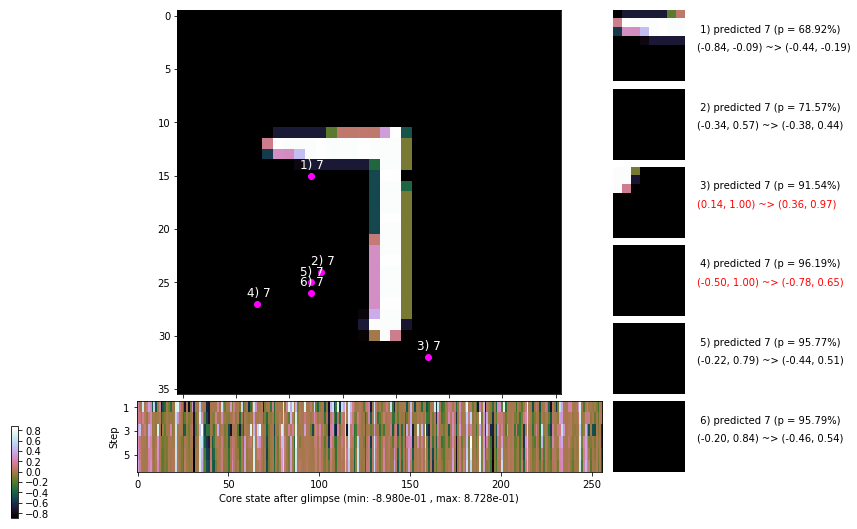

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 175.5 ms/b | lr: 9.08e-04 | grad 2norm: 18.94 | grad inf norm:  4.305
         Weights || abs max:  1.67 ( 3500.37) | mean: -9.80e-06 ( 0.02) | var: 2.73e-02 (  202.07)
          Biases || abs max:  0.74 (  135.81) | mean: -5.90e-02 ( 0.13) | var: 2.59e-02 (  617.25)
                    class loss: 0.463 | steps: 2.504 | reward:  3.155 | acc.: 84.18%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 174.1 ms/b | lr: 9.07e-04 | grad 2norm: 19.28 | grad inf norm:  4.609
         Weights || abs max:  1.67 ( 6301.67) | mean: -2.88e-05 ( 0.02) | var: 2.75e-02 ( 4906.12)
          Biases || abs max:  0.75 (   64.99) | mean: -5.99e-02 ( 0.08) | var: 2.61e-02 (   31.03)
                    class loss: 0.509 | steps: 2.538 | reward:  3.081 | acc.: 82.05%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

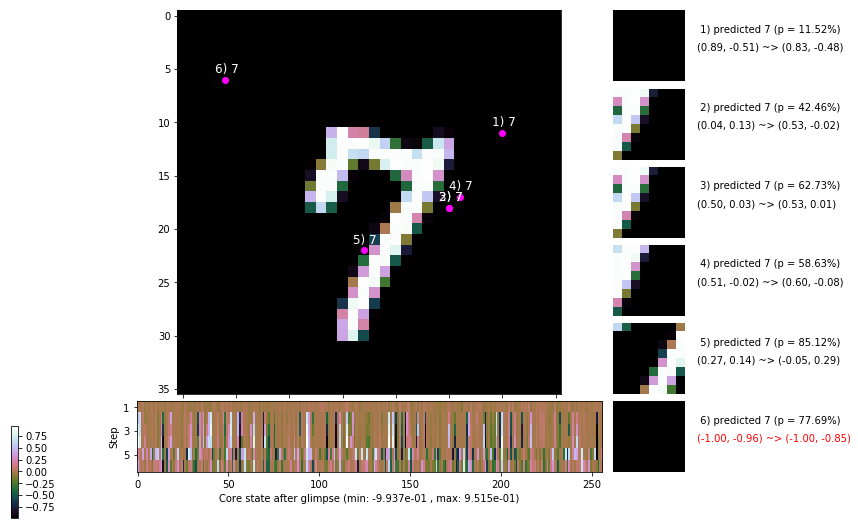

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 176.6 ms/b | lr: 9.05e-04 | grad 2norm: 18.60 | grad inf norm:  4.433
         Weights || abs max:  1.68 ( 6072.98) | mean: -4.89e-05 ( 0.02) | var: 2.77e-02 ( 4404.93)
          Biases || abs max:  0.76 (  203.26) | mean: -6.06e-02 ( 0.13) | var: 2.64e-02 (  815.87)
                    class loss: 0.475 | steps: 2.492 | reward:  3.187 | acc.: 84.25%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 168.4 ms/b | lr: 9.04e-04 | grad 2norm: 19.04 | grad inf norm:  4.511
         Weights || abs max:  1.70 ( 3346.64) | mean: -8.04e-05 ( 0.02) | var: 2.80e-02 (  197.53)
          Biases || abs max:  0.76 (   92.80) | mean: -6.07e-02 ( 0.09) | var: 2.66e-02 (   99.76)
                    class loss: 0.496 | steps: 2.502 | reward:  3.119 | acc.: 82.85%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

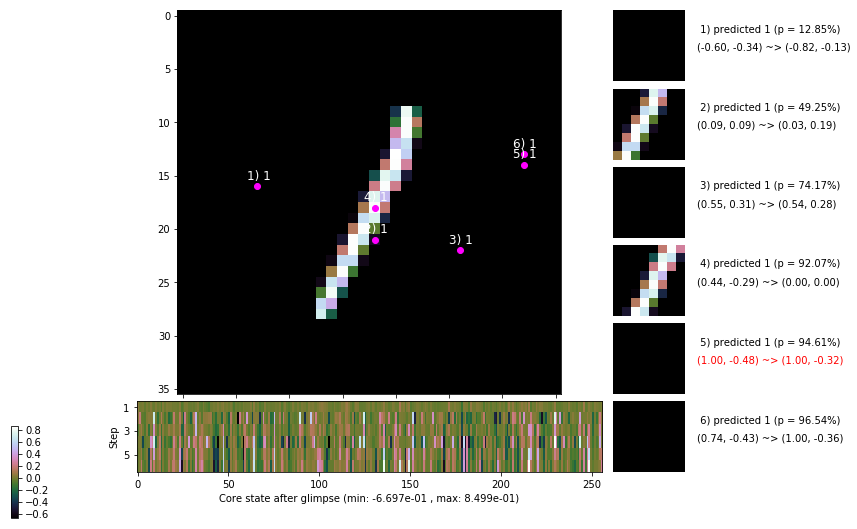

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 175.8 ms/b | lr: 9.02e-04 | grad 2norm: 19.15 | grad inf norm:  4.590
         Weights || abs max:  1.72 ( 3202.49) | mean: -1.65e-04 ( 0.02) | var: 2.82e-02 (  480.03)
          Biases || abs max:  0.76 (  137.89) | mean: -6.25e-02 ( 0.11) | var: 2.71e-02 (  205.56)
                    class loss: 0.496 | steps: 2.536 | reward:  3.084 | acc.: 82.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 174.5 ms/b | lr: 9.01e-04 | grad 2norm: 19.07 | grad inf norm:  4.433
         Weights || abs max:  1.72 ( 5568.66) | mean: -2.28e-04 ( 0.02) | var: 2.84e-02 ( 1459.80)
          Biases || abs max:  0.75 (  100.63) | mean: -6.36e-02 ( 0.10) | var: 2.74e-02 (   78.72)
                    class loss: 0.489 | steps: 2.499 | reward:  3.138 | acc.: 83.40%

	Target class: 2 | Discounted rewards: [-0.141, 0.719, -0

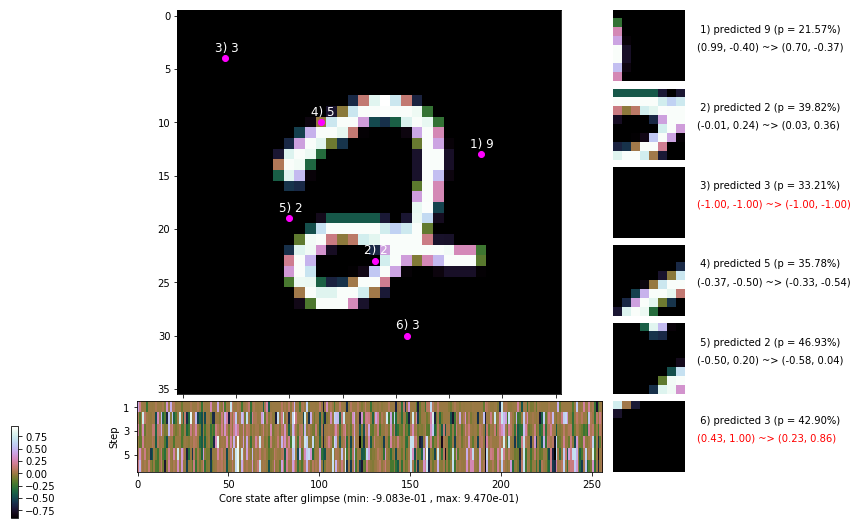

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


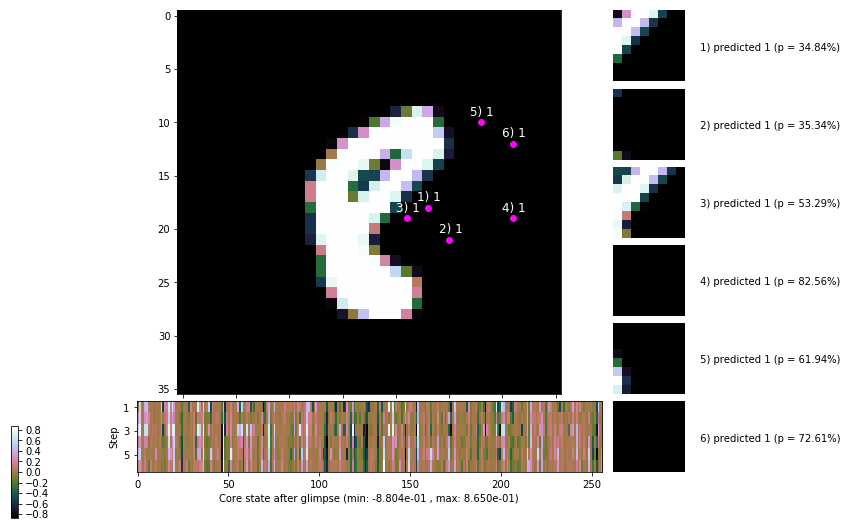


	Target class: 6 | Discounted rewards: [1.641, 1.281, 0.562, -0.875, -0.750, -0.500]


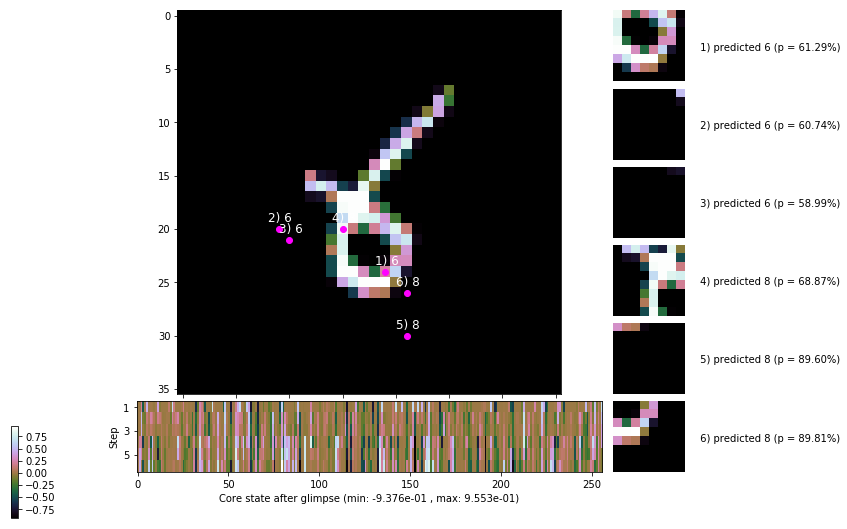

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


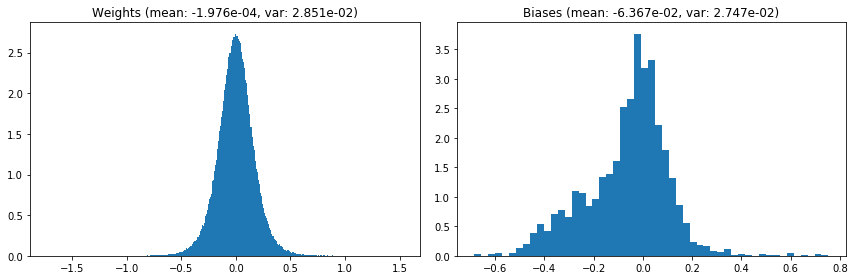

                                      Location network weights and biases


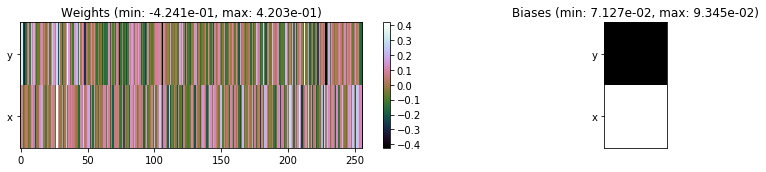

---------------------------------------------------------------------------------------------------------------
Elapsed time:  522.76 sec | TRAIN >> class loss: 0.5014 | steps:  2.531    | reward:  3.0895    | acc.: 82.740% 
                          | VAL   >> class loss: 0.4326 | steps:  2.380    | reward:  3.3825    | acc.: 85.120% 


Epoch   8/400) lr = 0.0009003
 b    300/  3000 >> 171.3 ms/b | lr: 8.99e-04 | grad 2norm: 19.02 | grad inf norm:  4.370
         Weights || abs max:  1.72 ( 5271.70) | mean: -2.46e-04 ( 0.02) | var: 2.86e-02 ( 2367.56)
          Biases || abs max:  0.75 (  118.15) | mean: -6.33e-02 ( 0.11) | var: 2.76e-02 (  447.72)
                    class loss: 0.478 | steps: 2.493 | reward:  3.139 | acc.: 83.45%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 172.8 ms/b | lr: 8.98e-04 | grad 2norm: 19.42 | grad inf norm:  4.507
         Weights || abs max:  1.72 ( 2455.08) | mean: -2.52e-04 ( 0.0

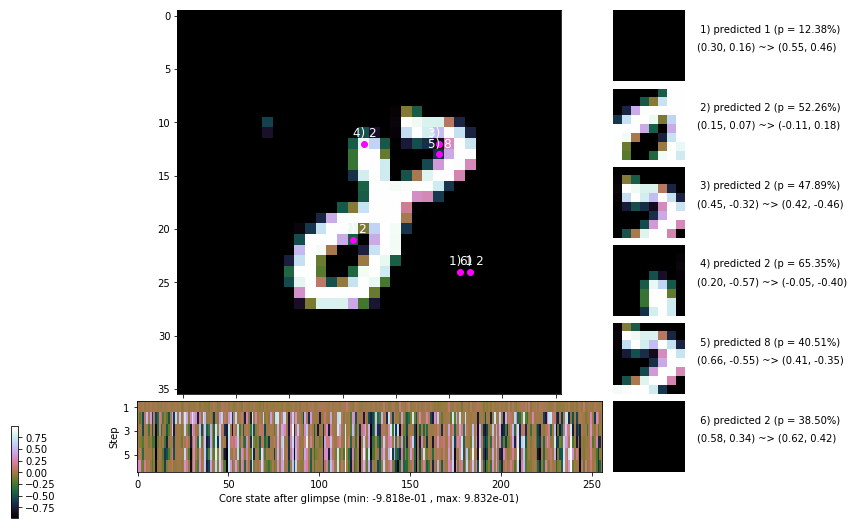

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 170.6 ms/b | lr: 8.97e-04 | grad 2norm: 18.61 | grad inf norm:  4.206
         Weights || abs max:  1.73 (70452.86) | mean: -2.14e-04 ( 0.14) | var: 2.91e-02 (2437239.75)
          Biases || abs max:  0.75 (   92.97) | mean: -6.47e-02 ( 0.08) | var: 2.83e-02 (  111.95)
                    class loss: 0.434 | steps: 2.464 | reward:  3.245 | acc.: 85.47%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 171.7 ms/b | lr: 8.96e-04 | grad 2norm: 18.91 | grad inf norm:  4.488
         Weights || abs max:  1.74 ( 2733.78) | mean: -2.02e-04 ( 0.01) | var: 2.93e-02 (   97.63)
          Biases || abs max:  0.75 (  102.04) | mean: -6.54e-02 ( 0.10) | var: 2.85e-02 (  194.35)
                    class loss: 0.462 | steps: 2.476 | reward:  3.200 | acc.: 84.47%

	Target class: 6 | Discounted rewards: [-0.281, 0.438, 

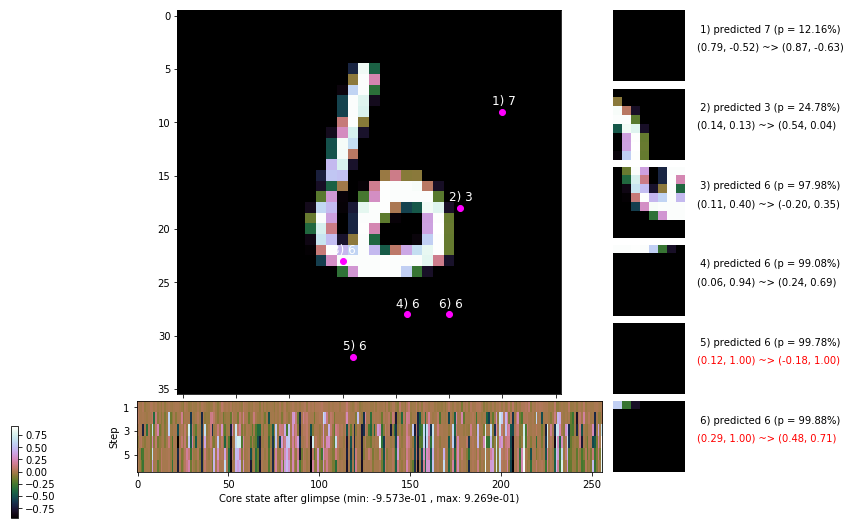

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 173.1 ms/b | lr: 8.94e-04 | grad 2norm: 19.01 | grad inf norm:  4.489
         Weights || abs max:  1.73 ( 5174.55) | mean: -1.88e-04 ( 0.02) | var: 2.95e-02 ( 1429.00)
          Biases || abs max:  0.75 (   63.36) | mean: -6.57e-02 ( 0.07) | var: 2.88e-02 (   39.30)
                    class loss: 0.458 | steps: 2.493 | reward:  3.194 | acc.: 84.63%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 170.9 ms/b | lr: 8.93e-04 | grad 2norm: 18.67 | grad inf norm:  4.365
         Weights || abs max:  1.72 ( 2953.84) | mean: -1.86e-04 ( 0.01) | var: 2.97e-02 (  180.56)
          Biases || abs max:  0.75 (   49.78) | mean: -6.61e-02 ( 0.07) | var: 2.92e-02 (   10.25)
                    class loss: 0.455 | steps: 2.473 | reward:  3.219 | acc.: 84.75%

	Target class: 8 | Discounted rewards: [-0.984, -0.969, -

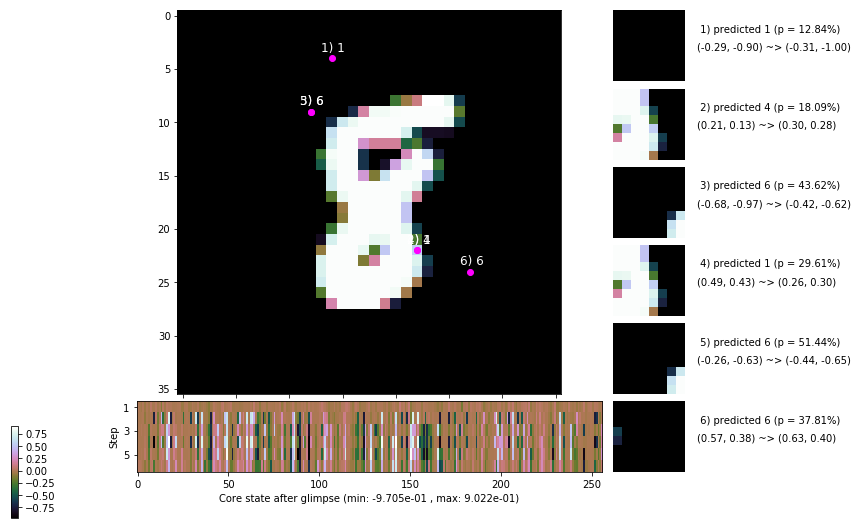

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 170.9 ms/b | lr: 8.91e-04 | grad 2norm: 18.75 | grad inf norm:  4.432
         Weights || abs max:  1.74 ( 1922.87) | mean: -1.76e-04 ( 0.01) | var: 2.99e-02 (   40.88)
          Biases || abs max:  0.75 (   57.53) | mean: -6.62e-02 ( 0.06) | var: 2.94e-02 (   16.18)
                    class loss: 0.476 | steps: 2.490 | reward:  3.157 | acc.: 83.90%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 167.1 ms/b | lr: 8.90e-04 | grad 2norm: 19.40 | grad inf norm:  4.593
         Weights || abs max:  1.73 ( 4495.89) | mean: -1.79e-04 ( 0.02) | var: 3.01e-02 ( 2164.71)
          Biases || abs max:  0.75 (   67.73) | mean: -6.64e-02 ( 0.07) | var: 2.96e-02 (   18.76)
                    class loss: 0.479 | steps: 2.501 | reward:  3.148 | acc.: 83.35%

	Target class: 7 | Discounted rewards: [0.516, -0.969, -0

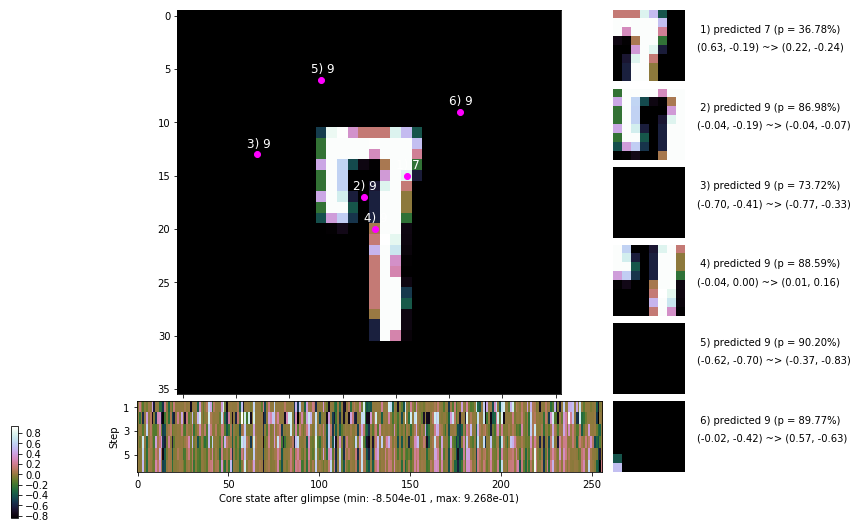

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 174.3 ms/b | lr: 8.89e-04 | grad 2norm: 18.87 | grad inf norm:  4.546
         Weights || abs max:  1.74 ( 2776.37) | mean: -2.00e-04 ( 0.01) | var: 3.03e-02 (  122.57)
          Biases || abs max:  0.76 (  128.66) | mean: -6.72e-02 ( 0.12) | var: 3.01e-02 (  613.36)
                    class loss: 0.461 | steps: 2.477 | reward:  3.204 | acc.: 84.18%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 171.4 ms/b | lr: 8.88e-04 | grad 2norm: 18.56 | grad inf norm:  4.454
         Weights || abs max:  1.76 ( 3706.78) | mean: -2.02e-04 ( 0.02) | var: 3.05e-02 (  667.20)
          Biases || abs max:  0.76 (   86.35) | mean: -6.82e-02 ( 0.08) | var: 3.05e-02 (  190.83)
                    class loss: 0.442 | steps: 2.437 | reward:  3.279 | acc.: 85.23%

	Target class: 8 | Discounted rewards: [-0.984, -0.969, -

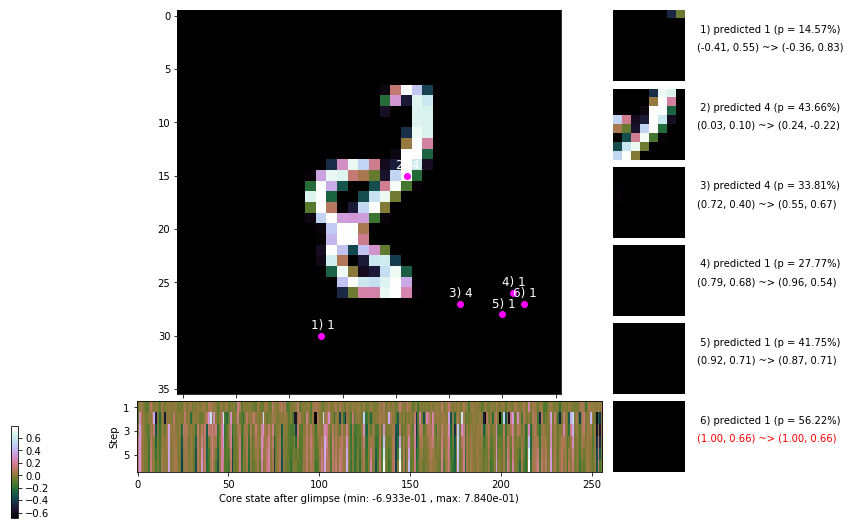

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


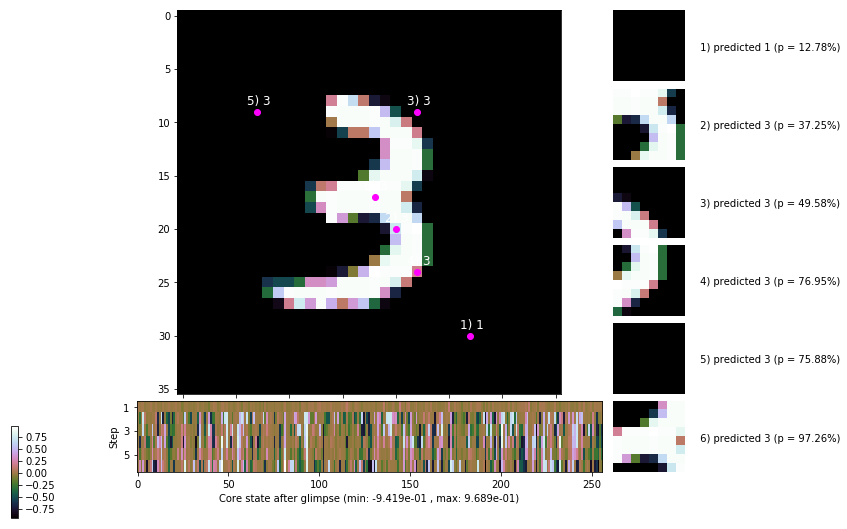


	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


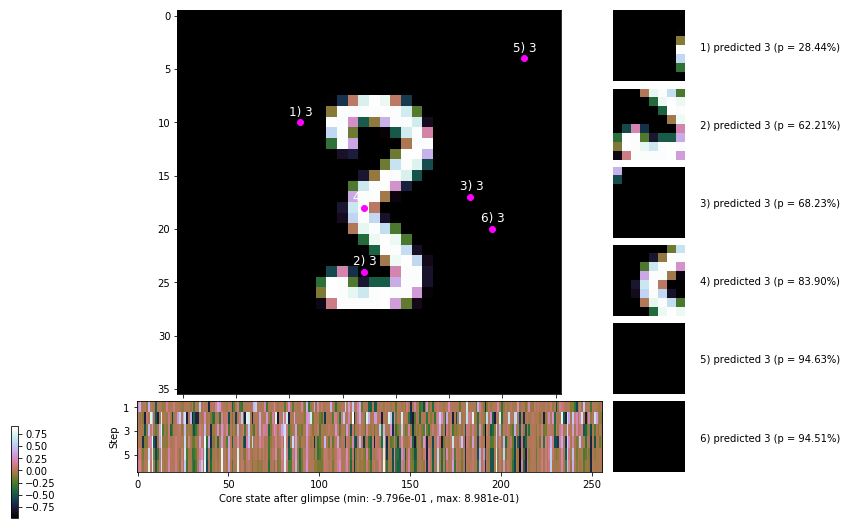

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


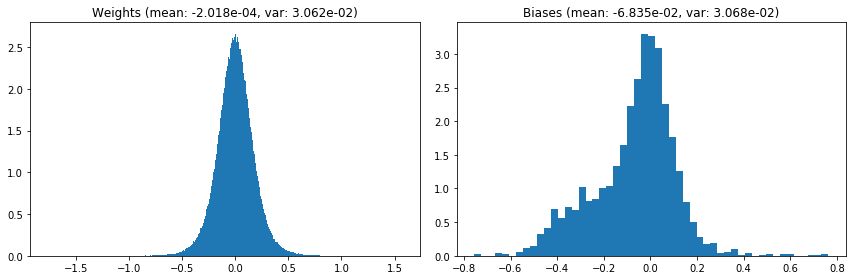

                                      Location network weights and biases


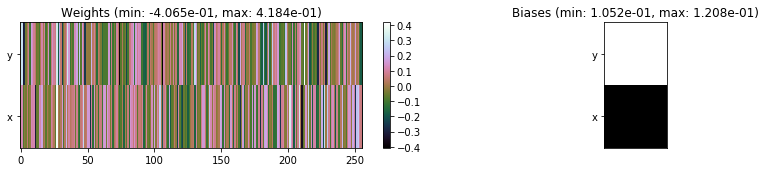

---------------------------------------------------------------------------------------------------------------
Elapsed time:  515.05 sec | TRAIN >> class loss: 0.4636 | steps:  2.482    | reward:  3.1900    | acc.: 84.287% 
                          | VAL   >> class loss: 0.4421 | steps:  2.353    | reward:  3.4380    | acc.: 85.260% 


Epoch   9/400) lr = 0.0008869
 b    300/  3000 >> 172.8 ms/b | lr: 8.86e-04 | grad 2norm: 18.55 | grad inf norm:  4.447
         Weights || abs max:  1.77 ( 2803.58) | mean: -1.66e-04 ( 0.01) | var: 3.07e-02 (  158.59)
          Biases || abs max:  0.77 (   54.93) | mean: -6.85e-02 ( 0.07) | var: 3.08e-02 (   17.80)
                    class loss: 0.459 | steps: 2.478 | reward:  3.254 | acc.: 85.62%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 170.4 ms/b | lr: 8.85e-04 | grad 2norm: 18.90 | grad inf norm:  4.418
         Weights || abs max:  1.76 ( 1929.07) | mean: -1.57e-04 ( 0.0

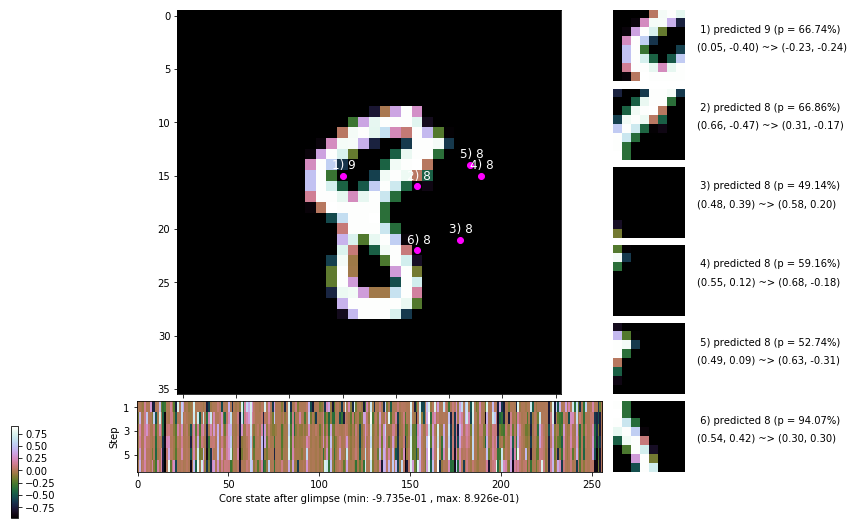

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 172.8 ms/b | lr: 8.83e-04 | grad 2norm: 18.69 | grad inf norm:  4.407
         Weights || abs max:  1.75 ( 8971.06) | mean: -1.61e-04 ( 0.03) | var: 3.12e-02 (14720.85)
          Biases || abs max:  0.78 (   87.74) | mean: -6.92e-02 ( 0.08) | var: 3.14e-02 (  120.82)
                    class loss: 0.450 | steps: 2.470 | reward:  3.243 | acc.: 84.77%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 167.6 ms/b | lr: 8.82e-04 | grad 2norm: 18.73 | grad inf norm:  4.414
         Weights || abs max:  1.76 ( 9979.73) | mean: -1.89e-04 ( 0.03) | var: 3.14e-02 (16052.25)
          Biases || abs max:  0.78 (   56.81) | mean: -7.00e-02 ( 0.07) | var: 3.18e-02 (   16.23)
                    class loss: 0.451 | steps: 2.487 | reward:  3.240 | acc.: 84.78%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

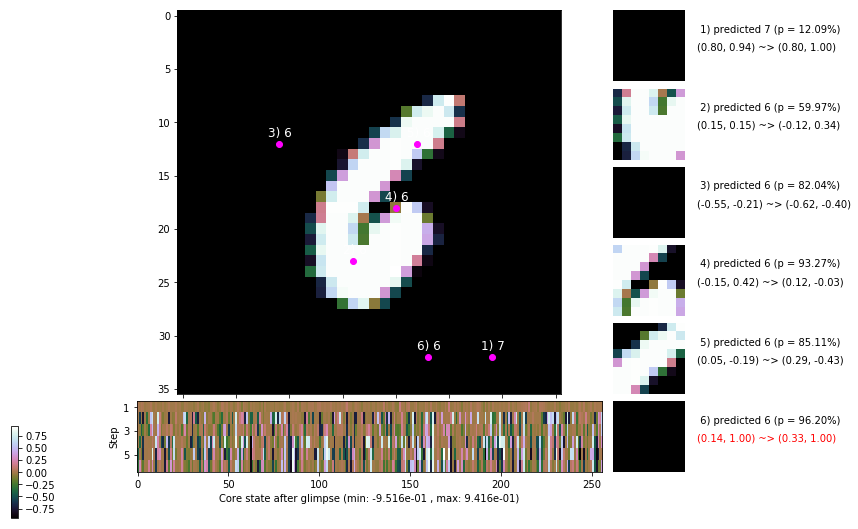

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 172.4 ms/b | lr: 8.81e-04 | grad 2norm: 18.94 | grad inf norm:  4.674
         Weights || abs max:  1.76 ( 2815.20) | mean: -1.87e-04 ( 0.01) | var: 3.16e-02 (  352.95)
          Biases || abs max:  0.77 (   75.13) | mean: -7.02e-02 ( 0.08) | var: 3.21e-02 (   27.90)
                    class loss: 0.451 | steps: 2.523 | reward:  3.162 | acc.: 84.28%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 176.0 ms/b | lr: 8.80e-04 | grad 2norm: 18.48 | grad inf norm:  4.405
         Weights || abs max:  1.76 ( 3884.87) | mean: -2.45e-04 ( 0.02) | var: 3.18e-02 ( 1038.22)
          Biases || abs max:  0.77 (   77.44) | mean: -7.11e-02 ( 0.07) | var: 3.23e-02 (   76.34)
                    class loss: 0.442 | steps: 2.463 | reward:  3.266 | acc.: 85.40%

	Target class: 5 | Discounted rewards: [-0.281, 0.438, 1.

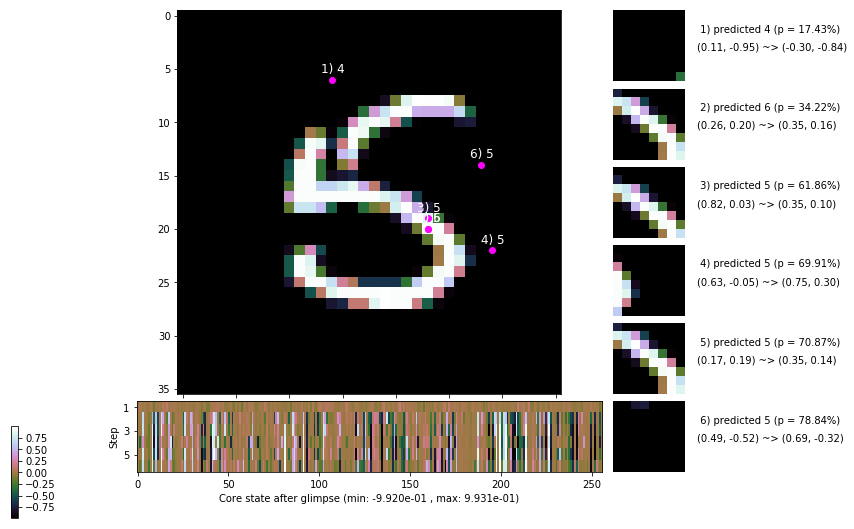

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 172.3 ms/b | lr: 8.78e-04 | grad 2norm: 18.71 | grad inf norm:  4.409
         Weights || abs max:  1.76 ( 2986.35) | mean: -3.29e-04 ( 0.02) | var: 3.20e-02 (  141.90)
          Biases || abs max:  0.77 (   60.34) | mean: -7.25e-02 ( 0.07) | var: 3.25e-02 (   44.47)
                    class loss: 0.434 | steps: 2.440 | reward:  3.270 | acc.: 85.15%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 173.6 ms/b | lr: 8.77e-04 | grad 2norm: 18.62 | grad inf norm:  4.440
         Weights || abs max:  1.77 ( 2179.16) | mean: -2.81e-04 ( 0.01) | var: 3.22e-02 (   45.54)
          Biases || abs max:  0.79 (   59.06) | mean: -7.22e-02 ( 0.07) | var: 3.29e-02 (   28.03)
                    class loss: 0.436 | steps: 2.462 | reward:  3.252 | acc.: 85.40%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

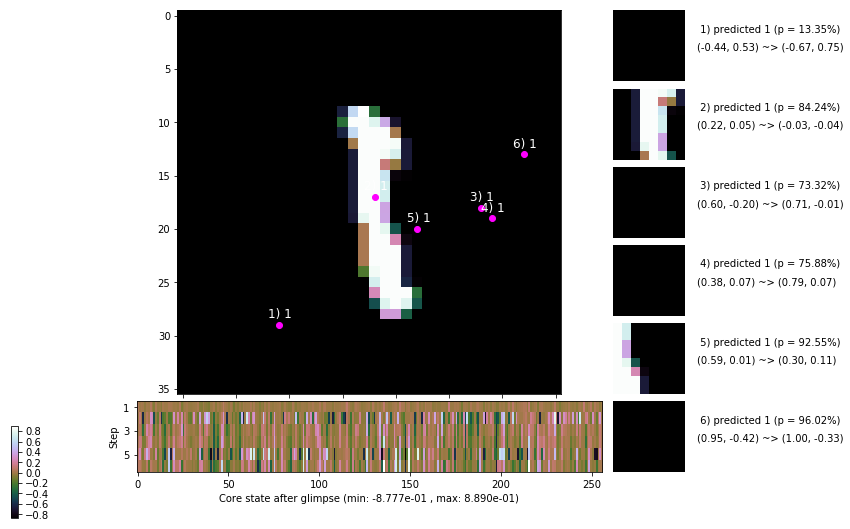

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 176.7 ms/b | lr: 8.75e-04 | grad 2norm: 18.37 | grad inf norm:  4.306
         Weights || abs max:  1.79 ( 3268.53) | mean: -2.95e-04 ( 0.02) | var: 3.25e-02 (  215.73)
          Biases || abs max:  0.79 (  105.99) | mean: -7.30e-02 ( 0.10) | var: 3.35e-02 (  195.58)
                    class loss: 0.416 | steps: 2.420 | reward:  3.333 | acc.: 85.75%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 174.3 ms/b | lr: 8.75e-04 | grad 2norm: 18.08 | grad inf norm:  4.243
         Weights || abs max:  1.81 ( 7289.53) | mean: -3.39e-04 ( 0.02) | var: 3.27e-02 (11828.38)
          Biases || abs max:  0.80 (   53.84) | mean: -7.35e-02 ( 0.07) | var: 3.39e-02 (   11.93)
                    class loss: 0.388 | steps: 2.444 | reward:  3.326 | acc.: 87.22%

	Target class: 4 | Discounted rewards: [0.094, 1.188, 0.3

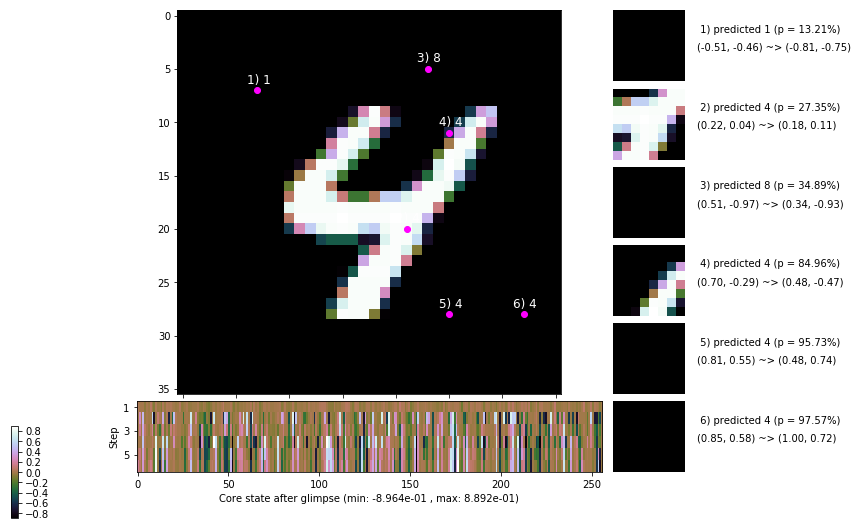

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


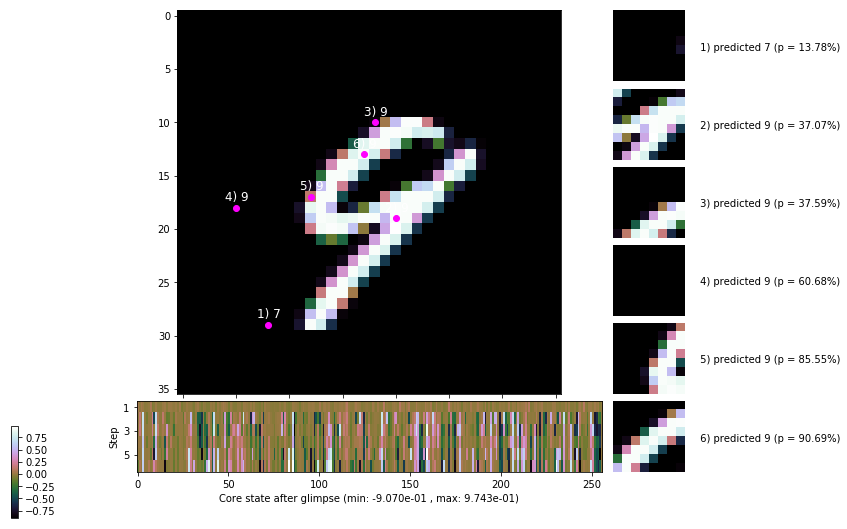


	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


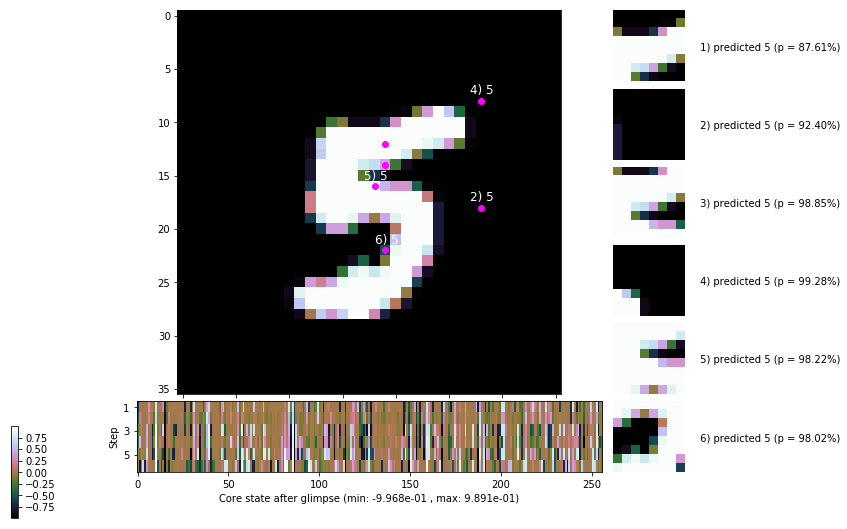

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


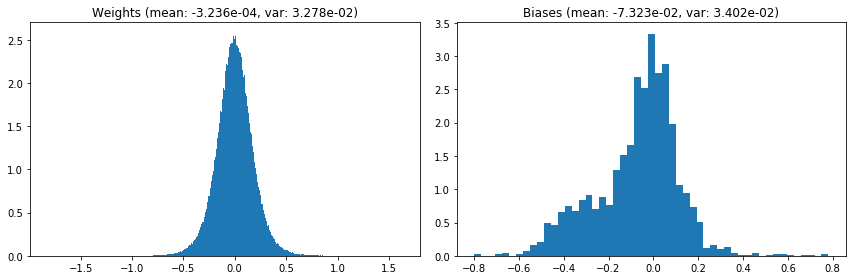

                                      Location network weights and biases


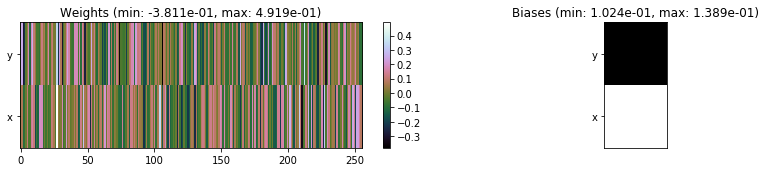

---------------------------------------------------------------------------------------------------------------
Elapsed time:  519.35 sec | TRAIN >> class loss: 0.4370 | steps:  2.464    | reward:  3.2601    | acc.: 85.315% 
                          | VAL   >> class loss: 0.3617 | steps:  2.286    | reward:  3.5841    | acc.: 87.940% 


Epoch  10/400) lr = 0.0008737
 b    300/  3000 >> 172.2 ms/b | lr: 8.73e-04 | grad 2norm: 18.29 | grad inf norm:  4.246
         Weights || abs max:  1.82 ( 4797.14) | mean: -3.02e-04 ( 0.02) | var: 3.29e-02 ( 1320.18)
          Biases || abs max:  0.79 (   29.63) | mean: -7.34e-02 ( 0.05) | var: 3.42e-02 (    3.07)
                    class loss: 0.393 | steps: 2.407 | reward:  3.360 | acc.: 86.77%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 176.8 ms/b | lr: 8.72e-04 | grad 2norm: 18.25 | grad inf norm:  4.285
         Weights || abs max:  1.82 ( 3529.87) | mean: -3.46e-04 ( 0.0

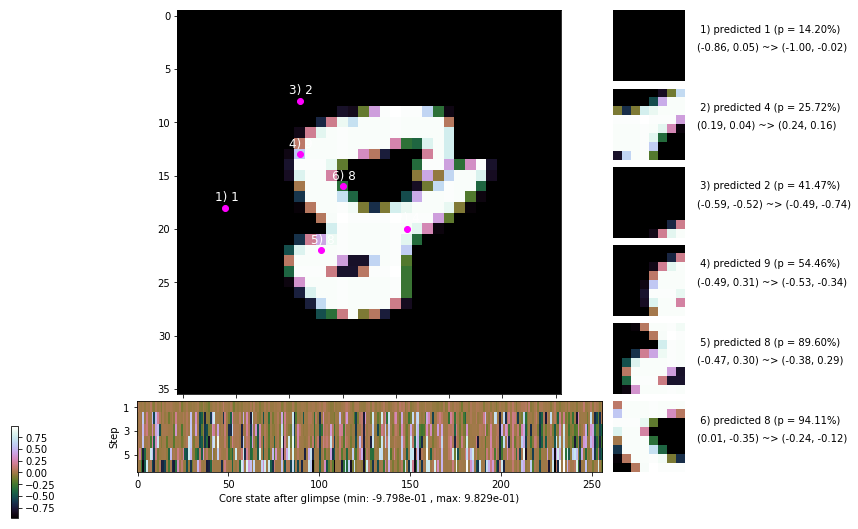

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 173.9 ms/b | lr: 8.70e-04 | grad 2norm: 18.56 | grad inf norm:  4.617
         Weights || abs max:  1.82 ( 3840.63) | mean: -3.62e-04 ( 0.02) | var: 3.33e-02 (  426.78)
          Biases || abs max:  0.81 (   91.26) | mean: -7.48e-02 ( 0.09) | var: 3.52e-02 (  283.26)
                    class loss: 0.431 | steps: 2.460 | reward:  3.292 | acc.: 85.70%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 170.7 ms/b | lr: 8.69e-04 | grad 2norm: 18.01 | grad inf norm:  4.339
         Weights || abs max:  1.82 ( 9434.57) | mean: -3.55e-04 ( 0.03) | var: 3.35e-02 (19444.60)
          Biases || abs max:  0.80 (  333.08) | mean: -7.54e-02 ( 0.18) | var: 3.55e-02 ( 4053.26)
                    class loss: 0.430 | steps: 2.447 | reward:  3.317 | acc.: 86.15%

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.8

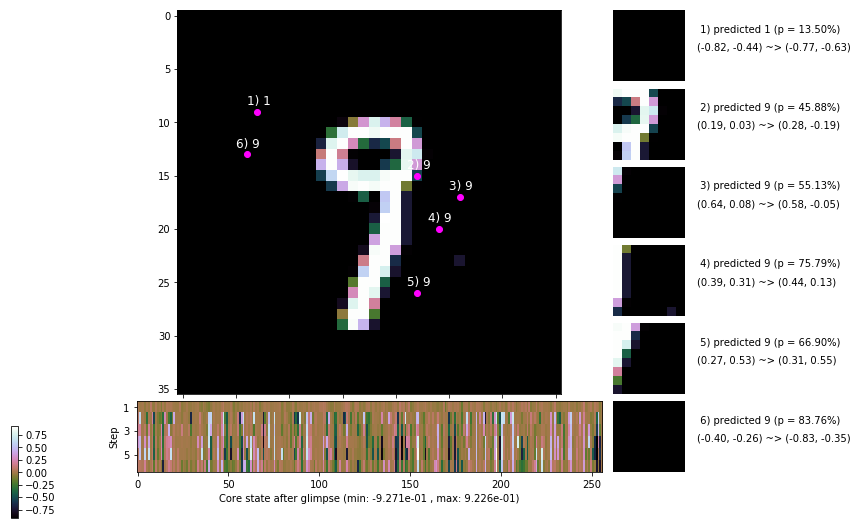

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 174.8 ms/b | lr: 8.68e-04 | grad 2norm: 18.41 | grad inf norm:  4.448
         Weights || abs max:  1.83 ( 2640.53) | mean: -4.00e-04 ( 0.01) | var: 3.37e-02 (  165.28)
          Biases || abs max:  0.80 (   45.51) | mean: -7.56e-02 ( 0.06) | var: 3.57e-02 (   13.45)
                    class loss: 0.429 | steps: 2.481 | reward:  3.255 | acc.: 85.78%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 174.2 ms/b | lr: 8.67e-04 | grad 2norm: 18.18 | grad inf norm:  4.153
         Weights || abs max:  1.83 ( 3708.92) | mean: -3.86e-04 ( 0.02) | var: 3.39e-02 (  303.28)
          Biases || abs max:  0.80 (   55.37) | mean: -7.65e-02 ( 0.07) | var: 3.59e-02 (   34.29)
                    class loss: 0.433 | steps: 2.445 | reward:  3.308 | acc.: 85.35%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

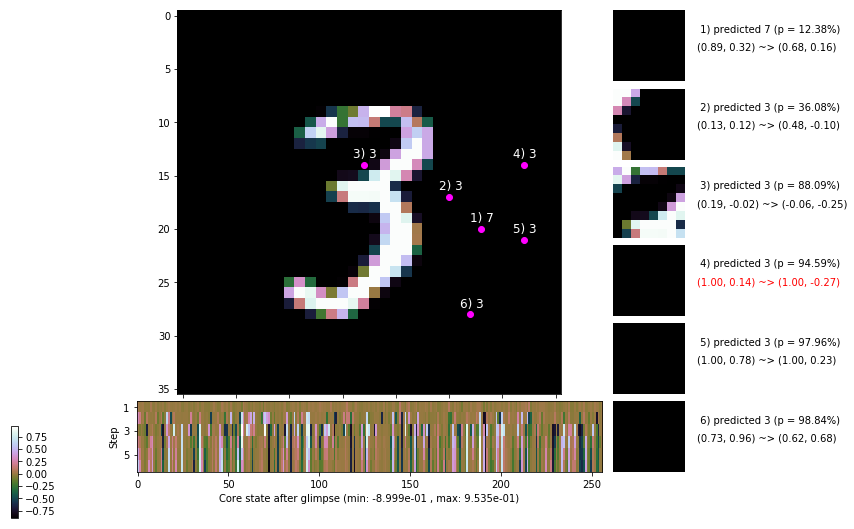

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 176.9 ms/b | lr: 8.65e-04 | grad 2norm: 18.32 | grad inf norm:  4.305
         Weights || abs max:  1.83 ( 2762.84) | mean: -3.76e-04 ( 0.01) | var: 3.41e-02 (  311.58)
          Biases || abs max:  0.81 (  742.39) | mean: -7.69e-02 ( 0.35) | var: 3.60e-02 (38827.22)
                    class loss: 0.455 | steps: 2.441 | reward:  3.253 | acc.: 84.67%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 168.4 ms/b | lr: 8.64e-04 | grad 2norm: 17.97 | grad inf norm:  4.215
         Weights || abs max:  1.84 ( 5142.44) | mean: -3.30e-04 ( 0.02) | var: 3.43e-02 ( 3616.89)
          Biases || abs max:  0.80 (   84.68) | mean: -7.63e-02 ( 0.09) | var: 3.62e-02 (   24.36)
                    class loss: 0.431 | steps: 2.444 | reward:  3.297 | acc.: 85.38%

	Target class: 5 | Discounted rewards: [-0.094, 0.812, -0

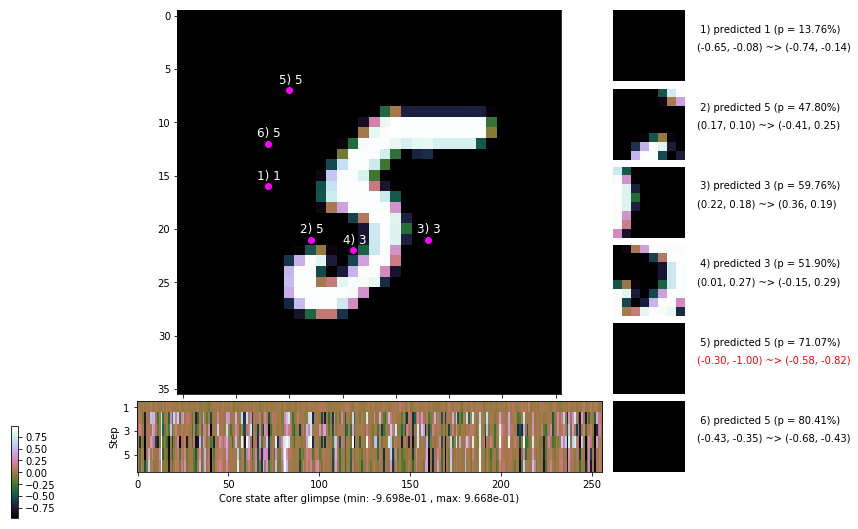

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 160.7 ms/b | lr: 8.62e-04 | grad 2norm: 17.51 | grad inf norm:  4.248
         Weights || abs max:  1.83 ( 3776.28) | mean: -4.08e-04 ( 0.02) | var: 3.45e-02 (  489.50)
          Biases || abs max:  0.81 (  837.50) | mean: -7.66e-02 ( 0.37) | var: 3.67e-02 (59532.19)
                    class loss: 0.409 | steps: 2.386 | reward:  3.384 | acc.: 86.00%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.4 ms/b | lr: 8.62e-04 | grad 2norm: 18.14 | grad inf norm:  4.364
         Weights || abs max:  1.83 ( 3924.22) | mean: -4.67e-04 ( 0.02) | var: 3.47e-02 (  827.89)
          Biases || abs max:  0.83 (   43.34) | mean: -7.65e-02 ( 0.06) | var: 3.71e-02 (    4.94)
                    class loss: 0.460 | steps: 2.447 | reward:  3.289 | acc.: 85.12%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

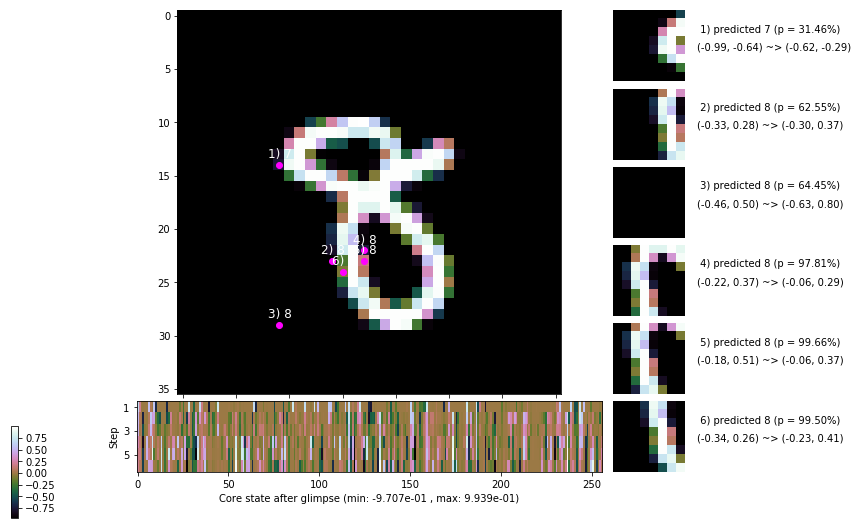

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


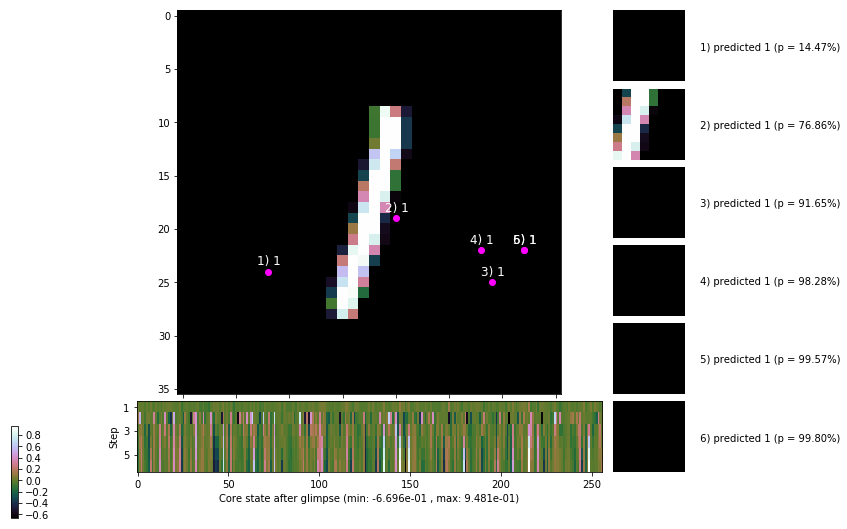


	Target class: 8 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


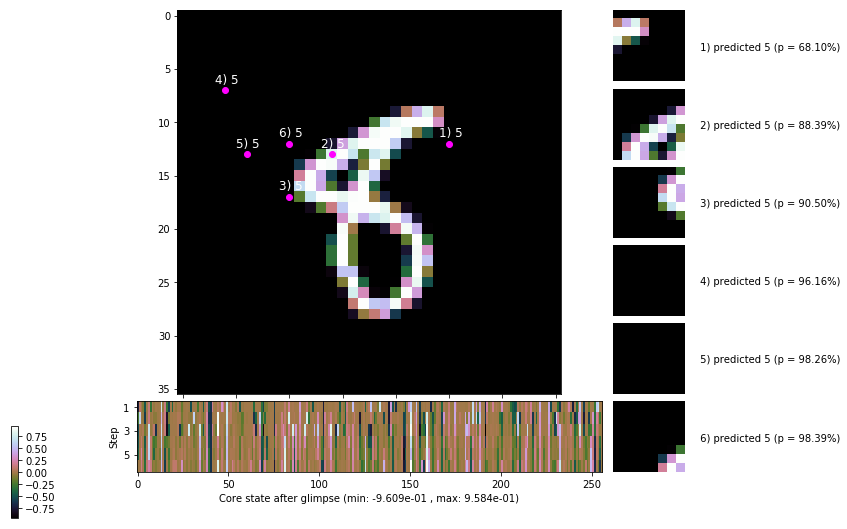

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


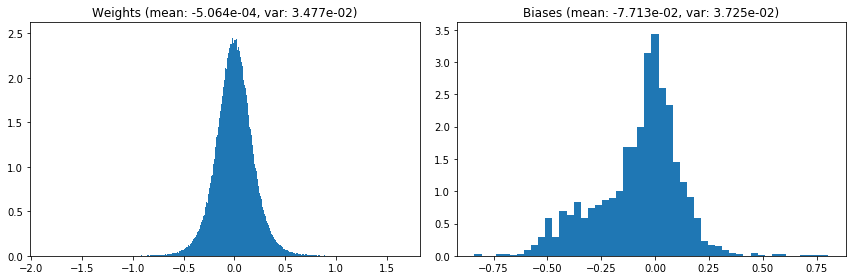

                                      Location network weights and biases


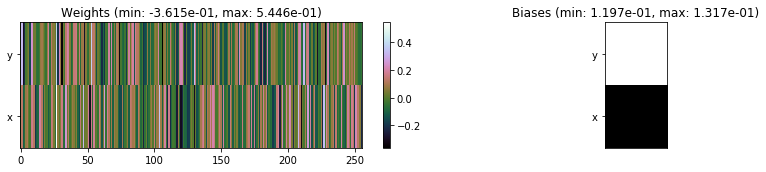

---------------------------------------------------------------------------------------------------------------
Elapsed time:  510.57 sec | TRAIN >> class loss: 0.4306 | steps:  2.439    | reward:  3.3046    | acc.: 85.668% 
                          | VAL   >> class loss: 0.4222 | steps:  2.294 :( | reward:  3.5301 :( | acc.: 85.560% :(


Epoch  11/400) lr = 0.0008606
 b    300/  3000 >> 150.8 ms/b | lr: 8.60e-04 | grad 2norm: 18.00 | grad inf norm:  4.337
         Weights || abs max:  1.84 (19039.01) | mean: -5.23e-04 ( 0.04) | var: 3.49e-02 (155438.81)
          Biases || abs max:  0.84 (   60.02) | mean: -7.70e-02 ( 0.07) | var: 3.74e-02 (   14.29)
                    class loss: 0.432 | steps: 2.402 | reward:  3.353 | acc.: 85.72%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.0 ms/b | lr: 8.59e-04 | grad 2norm: 18.19 | grad inf norm:  4.274
         Weights || abs max:  1.85 ( 2765.03) | mean: -4.80e-04 ( 

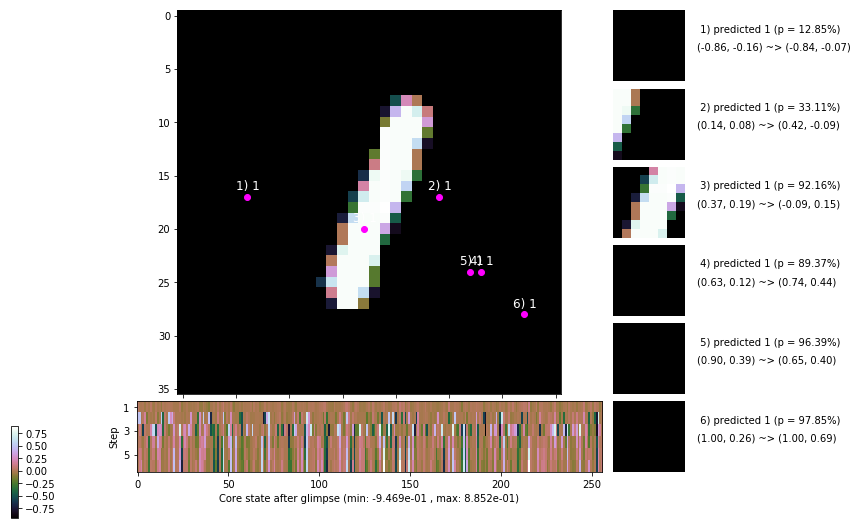

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 151.3 ms/b | lr: 8.57e-04 | grad 2norm: 17.79 | grad inf norm:  4.283
         Weights || abs max:  1.86 ( 3182.43) | mean: -4.64e-04 ( 0.02) | var: 3.53e-02 (  160.70)
          Biases || abs max:  0.84 (  327.92) | mean: -7.73e-02 ( 0.19) | var: 3.78e-02 ( 3312.93)
                    class loss: 0.430 | steps: 2.429 | reward:  3.319 | acc.: 85.42%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.0 ms/b | lr: 8.56e-04 | grad 2norm: 18.30 | grad inf norm:  4.325
         Weights || abs max:  1.87 ( 3531.69) | mean: -5.01e-04 ( 0.01) | var: 3.55e-02 (  370.25)
          Biases || abs max:  0.85 (  169.33) | mean: -7.83e-02 ( 0.15) | var: 3.80e-02 (  637.70)
                    class loss: 0.440 | steps: 2.438 | reward:  3.322 | acc.: 85.08%

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.8

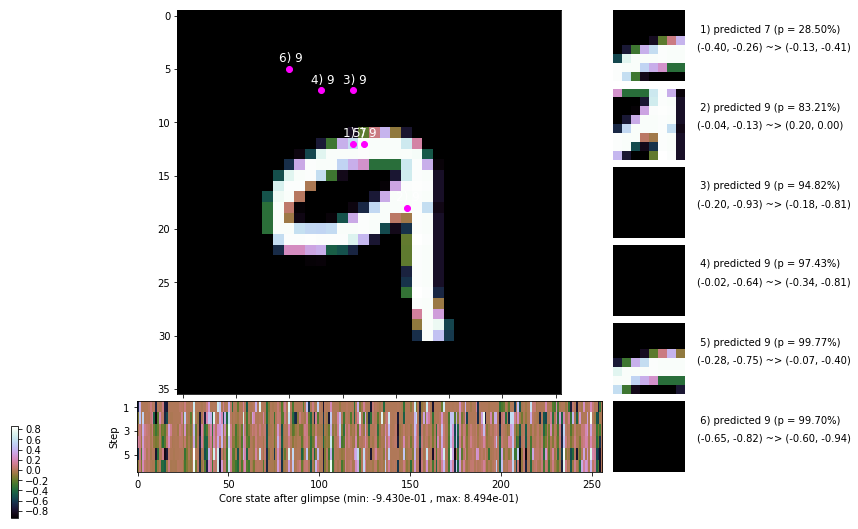

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 153.8 ms/b | lr: 8.55e-04 | grad 2norm: 17.93 | grad inf norm:  4.362
         Weights || abs max:  1.88 ( 3295.32) | mean: -5.34e-04 ( 0.01) | var: 3.57e-02 (  720.21)
          Biases || abs max:  0.85 (  134.08) | mean: -7.95e-02 ( 0.10) | var: 3.86e-02 (  555.98)
                    class loss: 0.427 | steps: 2.406 | reward:  3.338 | acc.: 85.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 149.2 ms/b | lr: 8.54e-04 | grad 2norm: 18.20 | grad inf norm:  4.220
         Weights || abs max:  1.89 ( 5259.47) | mean: -5.56e-04 ( 0.02) | var: 3.58e-02 ( 1729.10)
          Biases || abs max:  0.85 (   47.96) | mean: -8.04e-02 ( 0.06) | var: 3.88e-02 (    5.02)
                    class loss: 0.440 | steps: 2.427 | reward:  3.295 | acc.: 85.12%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

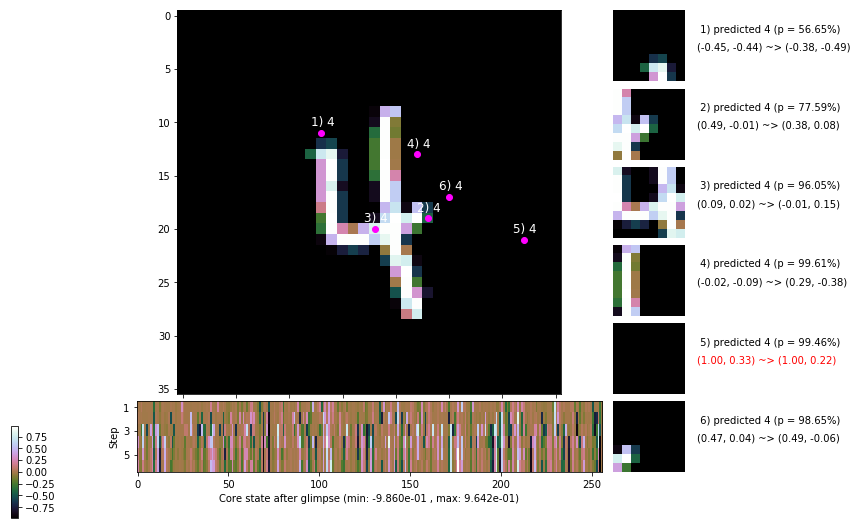

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 152.7 ms/b | lr: 8.52e-04 | grad 2norm: 17.95 | grad inf norm:  4.348
         Weights || abs max:  1.90 ( 2514.00) | mean: -5.62e-04 ( 0.01) | var: 3.60e-02 (   99.60)
          Biases || abs max:  0.87 (  259.48) | mean: -8.05e-02 ( 0.18) | var: 3.92e-02 ( 2835.93)
                    class loss: 0.442 | steps: 2.433 | reward:  3.309 | acc.: 84.90%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 156.7 ms/b | lr: 8.51e-04 | grad 2norm: 17.82 | grad inf norm:  4.375
         Weights || abs max:  1.91 ( 3113.96) | mean: -5.42e-04 ( 0.01) | var: 3.62e-02 (  215.75)
          Biases || abs max:  0.87 (   79.66) | mean: -8.04e-02 ( 0.09) | var: 3.95e-02 (   19.79)
                    class loss: 0.455 | steps: 2.432 | reward:  3.328 | acc.: 85.42%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

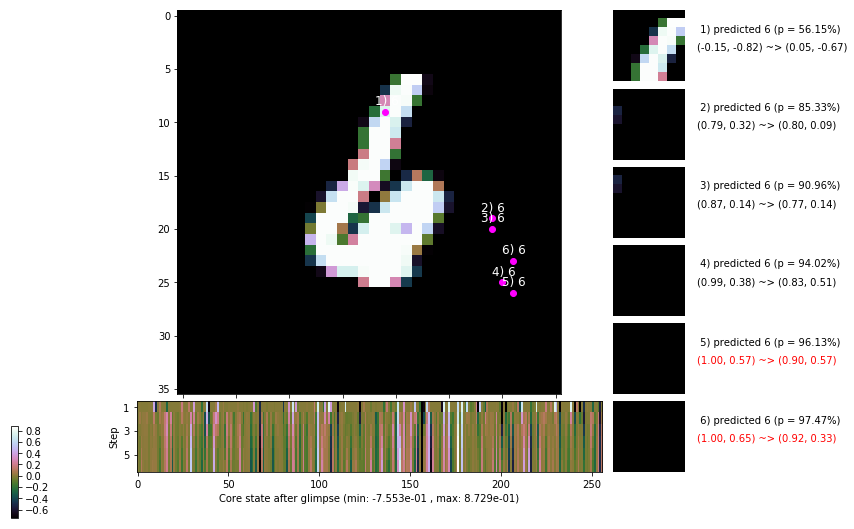

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 149.9 ms/b | lr: 8.50e-04 | grad 2norm: 18.61 | grad inf norm:  4.496
         Weights || abs max:  1.91 ( 3989.69) | mean: -5.20e-04 ( 0.02) | var: 3.64e-02 ( 1197.33)
          Biases || abs max:  0.87 (   80.69) | mean: -8.10e-02 ( 0.09) | var: 3.98e-02 (   33.60)
                    class loss: 0.476 | steps: 2.461 | reward:  3.219 | acc.: 83.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 168.1 ms/b | lr: 8.49e-04 | grad 2norm: 18.03 | grad inf norm:  4.475
         Weights || abs max:  1.89 ( 2904.66) | mean: -4.99e-04 ( 0.01) | var: 3.66e-02 (  496.01)
          Biases || abs max:  0.87 (  215.00) | mean: -8.20e-02 ( 0.16) | var: 4.00e-02 ( 1049.85)
                    class loss: 0.454 | steps: 2.451 | reward:  3.277 | acc.: 85.10%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

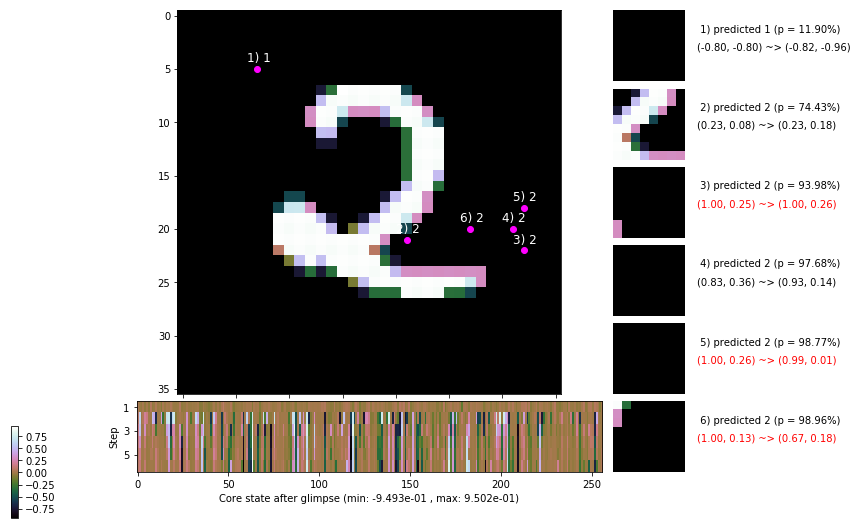

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [-0.656, -0.312, 0.375, 1.750, 1.500, 1.000]


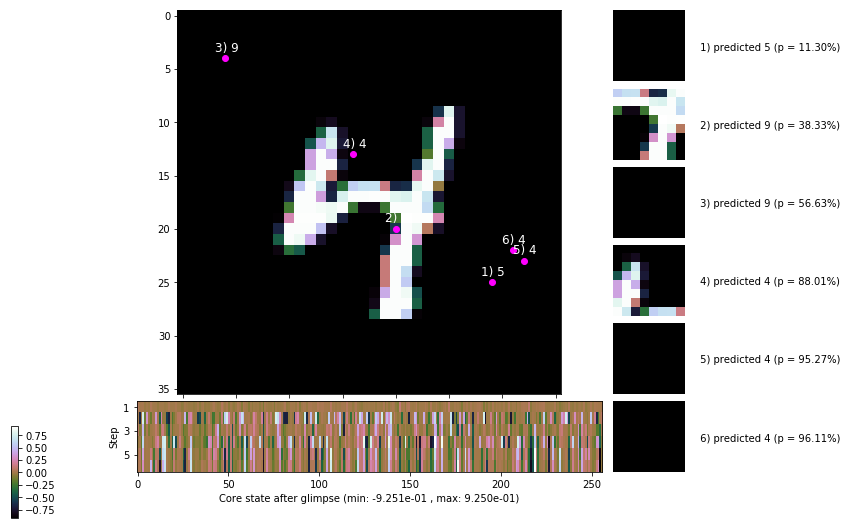


	Target class: 3 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


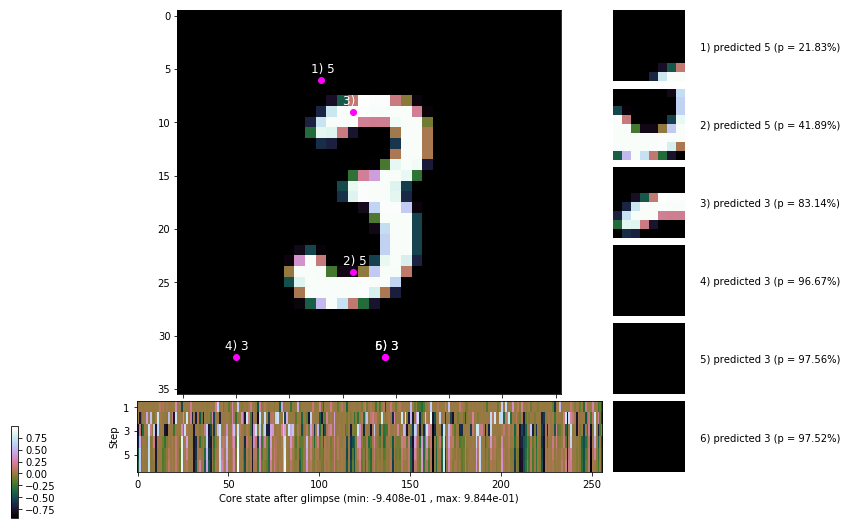

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


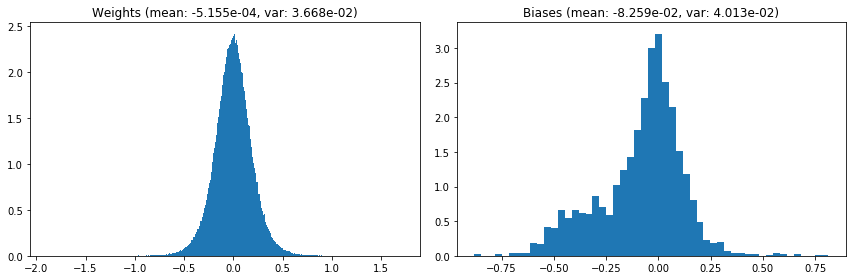

                                      Location network weights and biases


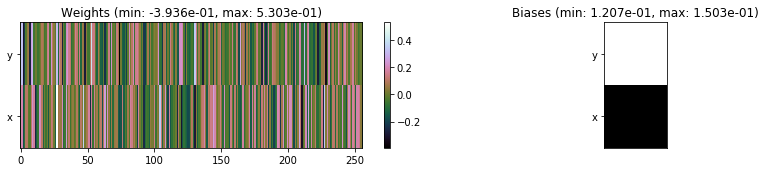

---------------------------------------------------------------------------------------------------------------
Elapsed time:  462.02 sec | TRAIN >> class loss: 0.4437 | steps:  2.434    | reward:  3.3039 :( | acc.: 85.077% :(
                          | VAL   >> class loss: 0.4078 | steps:  2.325 :( | reward:  3.5145 :( | acc.: 86.220% :(


Epoch  12/400) lr = 0.0008478
 b    300/  3000 >> 165.8 ms/b | lr: 8.47e-04 | grad 2norm: 17.49 | grad inf norm:  4.423
         Weights || abs max:  1.90 ( 3249.90) | mean: -5.27e-04 ( 0.01) | var: 3.68e-02 (  389.78)
          Biases || abs max:  0.88 (  128.26) | mean: -8.16e-02 ( 0.12) | var: 4.02e-02 (  496.53)
                    class loss: 0.430 | steps: 2.423 | reward:  3.337 | acc.: 85.98%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 163.4 ms/b | lr: 8.46e-04 | grad 2norm: 18.26 | grad inf norm:  4.603
         Weights || abs max:  1.91 ( 5052.35) | mean: -5.48e-04 (

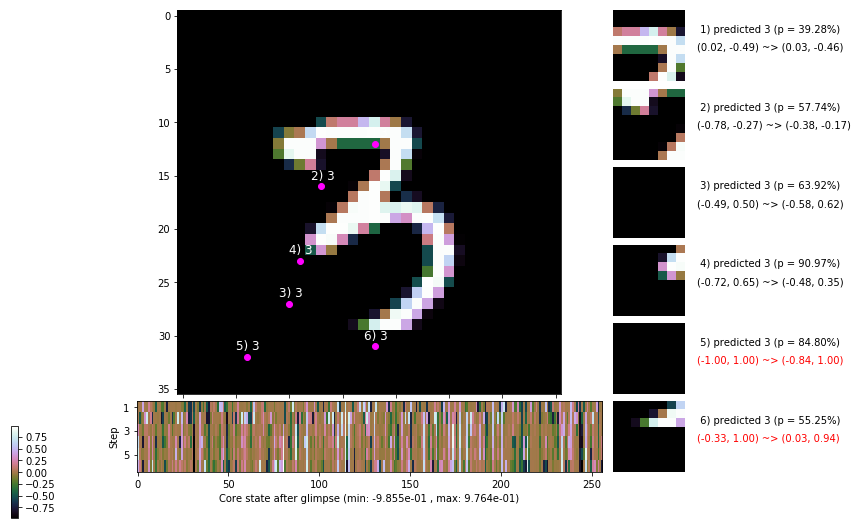

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 165.9 ms/b | lr: 8.44e-04 | grad 2norm: 17.81 | grad inf norm:  4.390
         Weights || abs max:  1.92 ( 5873.68) | mean: -6.12e-04 ( 0.02) | var: 3.71e-02 ( 2871.30)
          Biases || abs max:  0.88 (   58.71) | mean: -8.38e-02 ( 0.06) | var: 4.11e-02 (   24.51)
                    class loss: 0.434 | steps: 2.416 | reward:  3.329 | acc.: 85.07%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 166.4 ms/b | lr: 8.44e-04 | grad 2norm: 17.63 | grad inf norm:  4.313
         Weights || abs max:  1.92 ( 2445.69) | mean: -6.27e-04 ( 0.01) | var: 3.73e-02 (  222.15)
          Biases || abs max:  0.87 (  130.56) | mean: -8.38e-02 ( 0.09) | var: 4.14e-02 ( 1005.58)
                    class loss: 0.428 | steps: 2.436 | reward:  3.319 | acc.: 85.75%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

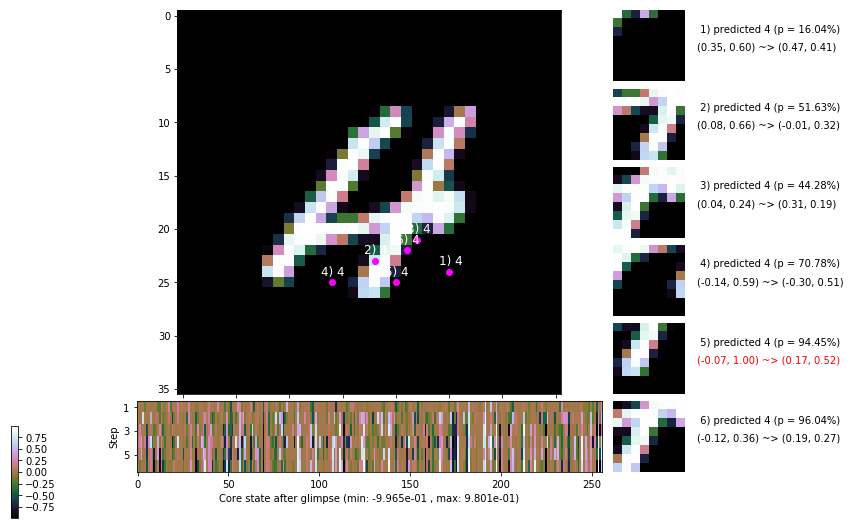

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 167.0 ms/b | lr: 8.42e-04 | grad 2norm: 17.64 | grad inf norm:  4.144
         Weights || abs max:  1.92 ( 3069.30) | mean: -6.36e-04 ( 0.01) | var: 3.75e-02 (  261.41)
          Biases || abs max:  0.89 (   70.39) | mean: -8.35e-02 ( 0.07) | var: 4.17e-02 (   28.04)
                    class loss: 0.420 | steps: 2.389 | reward:  3.404 | acc.: 85.97%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 162.0 ms/b | lr: 8.41e-04 | grad 2norm: 18.05 | grad inf norm:  4.353
         Weights || abs max:  1.92 ( 3892.90) | mean: -6.76e-04 ( 0.02) | var: 3.77e-02 (  323.20)
          Biases || abs max:  0.89 (  184.09) | mean: -8.31e-02 ( 0.11) | var: 4.18e-02 ( 1113.90)
                    class loss: 0.425 | steps: 2.388 | reward:  3.365 | acc.: 85.30%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

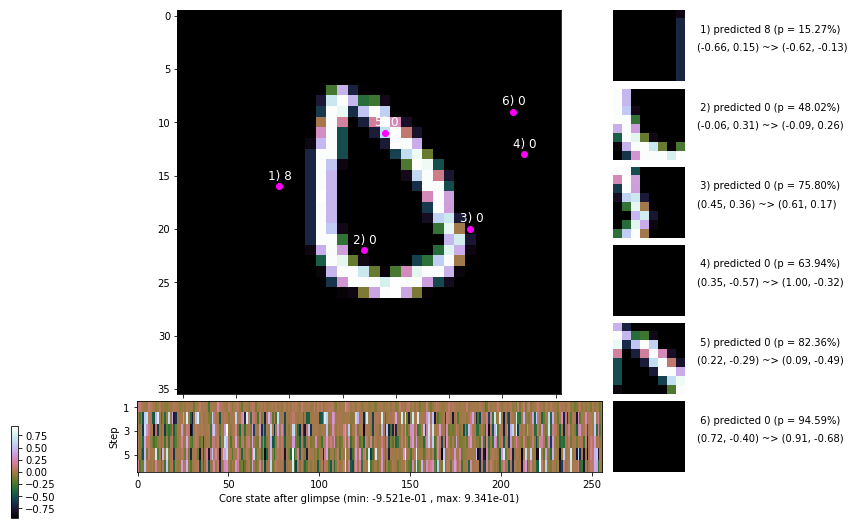

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 167.3 ms/b | lr: 8.39e-04 | grad 2norm: 17.94 | grad inf norm:  4.386
         Weights || abs max:  1.92 ( 8457.10) | mean: -6.92e-04 ( 0.02) | var: 3.79e-02 (11730.31)
          Biases || abs max:  0.90 (   67.31) | mean: -8.43e-02 ( 0.07) | var: 4.22e-02 (   22.64)
                    class loss: 0.456 | steps: 2.426 | reward:  3.298 | acc.: 84.92%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.9 ms/b | lr: 8.39e-04 | grad 2norm: 17.72 | grad inf norm:  4.217
         Weights || abs max:  1.91 ( 2395.80) | mean: -6.83e-04 ( 0.01) | var: 3.81e-02 (   77.24)
          Biases || abs max:  0.90 (  121.87) | mean: -8.45e-02 ( 0.10) | var: 4.27e-02 (  407.23)
                    class loss: 0.431 | steps: 2.416 | reward:  3.342 | acc.: 85.43%

	Target class: 9 | Discounted rewards: [-0.281, 0.438, 1.

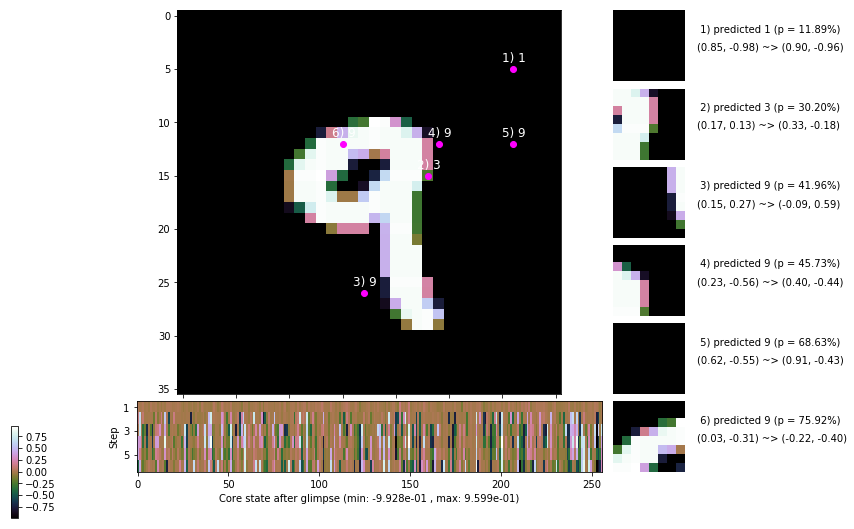

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 163.1 ms/b | lr: 8.37e-04 | grad 2norm: 17.77 | grad inf norm:  4.243
         Weights || abs max:  1.91 ( 3131.12) | mean: -6.73e-04 ( 0.01) | var: 3.82e-02 (  115.72)
          Biases || abs max:  0.89 (   99.76) | mean: -8.49e-02 ( 0.08) | var: 4.28e-02 (  208.31)
                    class loss: 0.433 | steps: 2.402 | reward:  3.326 | acc.: 84.70%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 162.9 ms/b | lr: 8.36e-04 | grad 2norm: 17.15 | grad inf norm:  4.233
         Weights || abs max:  1.92 ( 5889.18) | mean: -6.63e-04 ( 0.02) | var: 3.84e-02 ( 3053.10)
          Biases || abs max:  0.89 (   75.52) | mean: -8.57e-02 ( 0.08) | var: 4.31e-02 (   89.56)
                    class loss: 0.396 | steps: 2.400 | reward:  3.384 | acc.: 86.40%

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.8

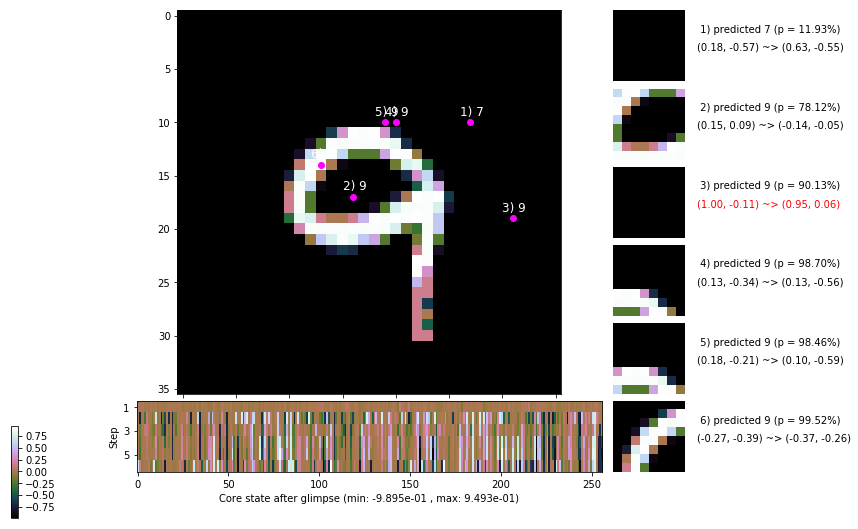

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.656, -0.688, -0.375, 0.250, 1.500, 1.000]


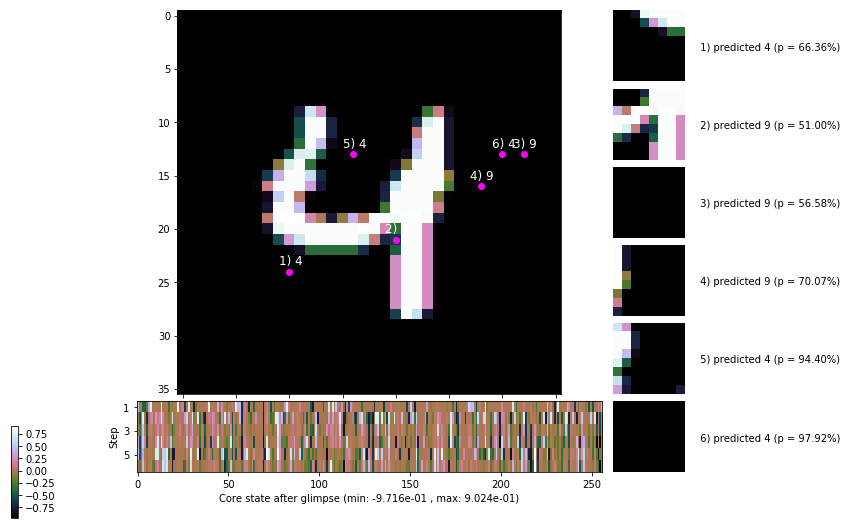


	Target class: 9 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


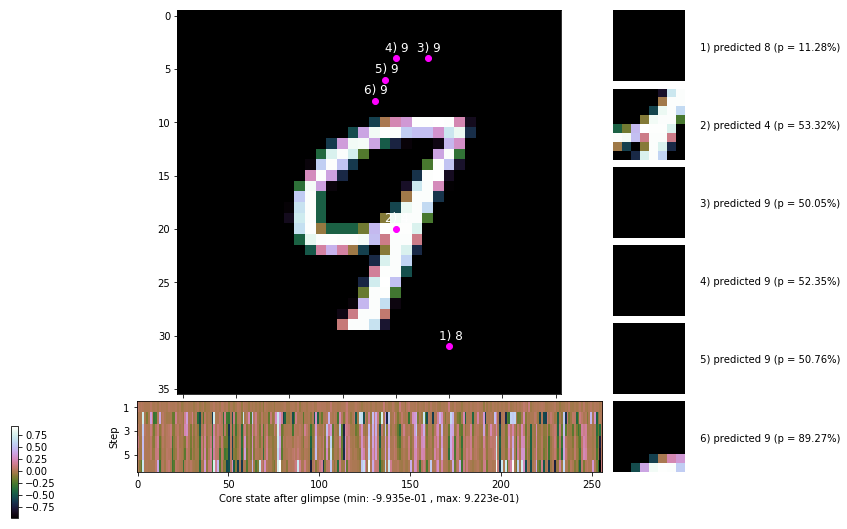

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


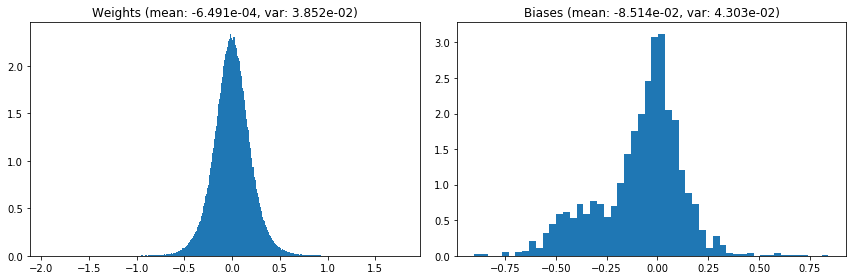

                                      Location network weights and biases


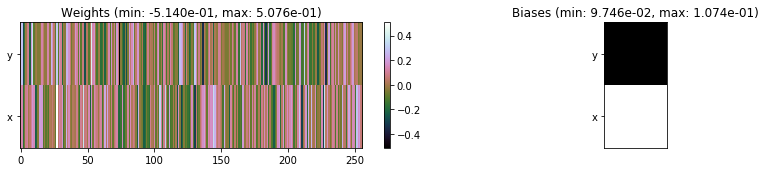

---------------------------------------------------------------------------------------------------------------
Elapsed time:  494.34 sec | TRAIN >> class loss: 0.4335 | steps:  2.415    | reward:  3.3318    | acc.: 85.293% :(
                          | VAL   >> class loss: 0.3915 | steps:  2.306 :( | reward:  3.5337 :( | acc.: 86.220% :(


Epoch  13/400) lr = 0.0008352
 b    300/  3000 >> 163.2 ms/b | lr: 8.34e-04 | grad 2norm: 17.87 | grad inf norm:  4.497
         Weights || abs max:  1.92 ( 2796.51) | mean: -6.40e-04 ( 0.01) | var: 3.86e-02 (  115.18)
          Biases || abs max:  0.91 (  167.45) | mean: -8.54e-02 ( 0.11) | var: 4.31e-02 (  611.72)
                    class loss: 0.416 | steps: 2.414 | reward:  3.360 | acc.: 86.28%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 162.1 ms/b | lr: 8.34e-04 | grad 2norm: 17.56 | grad inf norm:  4.394
         Weights || abs max:  1.92 ( 6827.82) | mean: -6.25e-04 (

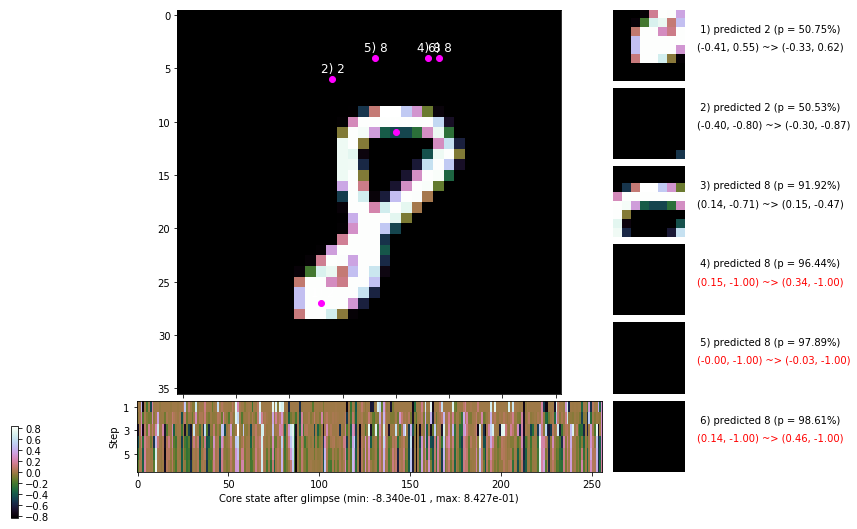

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 163.9 ms/b | lr: 8.32e-04 | grad 2norm: 17.66 | grad inf norm:  4.372
         Weights || abs max:  1.92 ( 3492.54) | mean: -6.13e-04 ( 0.02) | var: 3.90e-02 (  275.34)
          Biases || abs max:  0.92 (   70.94) | mean: -8.54e-02 ( 0.07) | var: 4.35e-02 (   22.68)
                    class loss: 0.427 | steps: 2.417 | reward:  3.318 | acc.: 85.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 164.9 ms/b | lr: 8.31e-04 | grad 2norm: 17.63 | grad inf norm:  4.362
         Weights || abs max:  1.92 ( 9242.32) | mean: -5.94e-04 ( 0.03) | var: 3.91e-02 (12735.10)
          Biases || abs max:  0.93 (   44.78) | mean: -8.58e-02 ( 0.06) | var: 4.37e-02 (    7.82)
                    class loss: 0.408 | steps: 2.422 | reward:  3.346 | acc.: 86.27%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

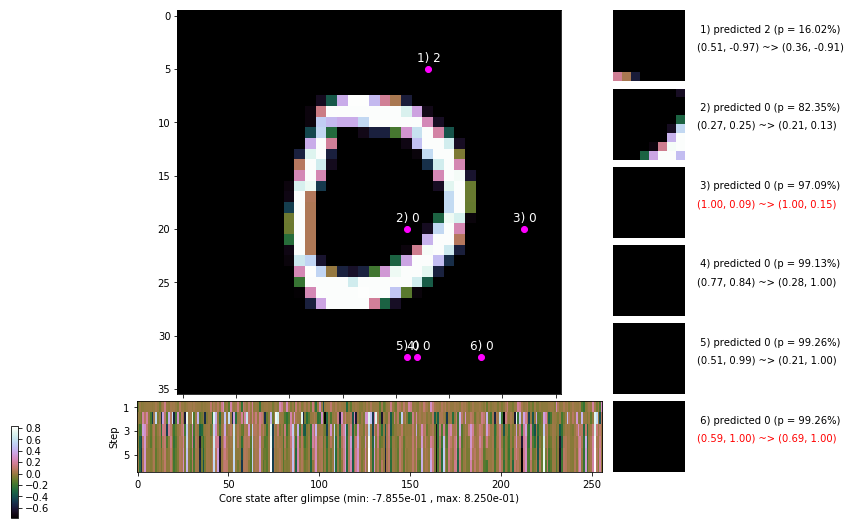

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.1 ms/b | lr: 8.29e-04 | grad 2norm: 17.65 | grad inf norm:  4.177
         Weights || abs max:  1.92 ( 3036.67) | mean: -6.04e-04 ( 0.01) | var: 3.93e-02 (  210.80)
          Biases || abs max:  0.94 (   65.59) | mean: -8.70e-02 ( 0.07) | var: 4.40e-02 (   11.35)
                    class loss: 0.435 | steps: 2.383 | reward:  3.329 | acc.: 85.13%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 164.4 ms/b | lr: 8.29e-04 | grad 2norm: 17.71 | grad inf norm:  4.371
         Weights || abs max:  1.92 ( 2601.20) | mean: -5.57e-04 ( 0.01) | var: 3.95e-02 (   87.08)
          Biases || abs max:  0.97 (  130.54) | mean: -8.72e-02 ( 0.09) | var: 4.44e-02 (  547.98)
                    class loss: 0.420 | steps: 2.423 | reward:  3.320 | acc.: 85.87%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

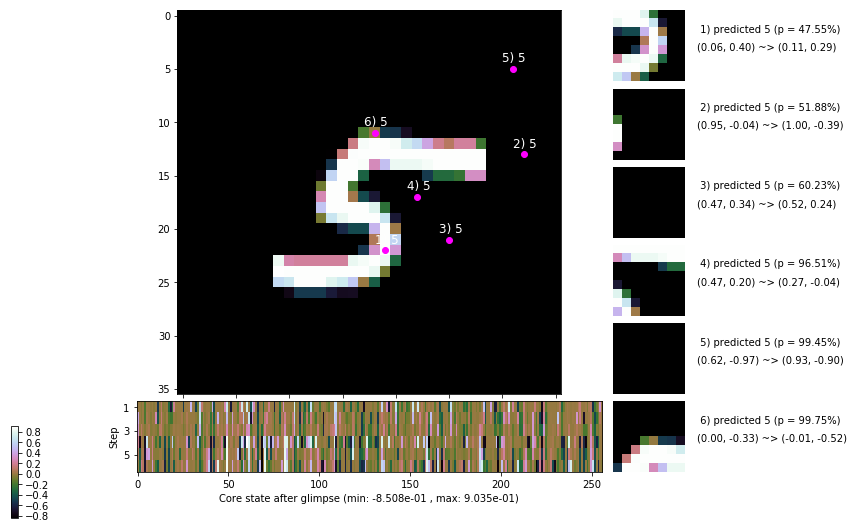

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.6 ms/b | lr: 8.27e-04 | grad 2norm: 18.06 | grad inf norm:  4.443
         Weights || abs max:  1.93 ( 2026.97) | mean: -5.68e-04 ( 0.01) | var: 3.96e-02 (   40.34)
          Biases || abs max:  0.96 (  268.75) | mean: -8.74e-02 ( 0.15) | var: 4.46e-02 ( 2178.76)
                    class loss: 0.440 | steps: 2.407 | reward:  3.316 | acc.: 85.50%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.5 ms/b | lr: 8.26e-04 | grad 2norm: 17.93 | grad inf norm:  4.454
         Weights || abs max:  1.94 ( 2868.25) | mean: -5.62e-04 ( 0.01) | var: 3.98e-02 (  158.68)
          Biases || abs max:  0.96 (  145.21) | mean: -8.73e-02 ( 0.10) | var: 4.49e-02 (  429.44)
                    class loss: 0.405 | steps: 2.396 | reward:  3.349 | acc.: 86.02%

	Target class: 6 | Discounted rewards: [-0.281, 0.438, 1.

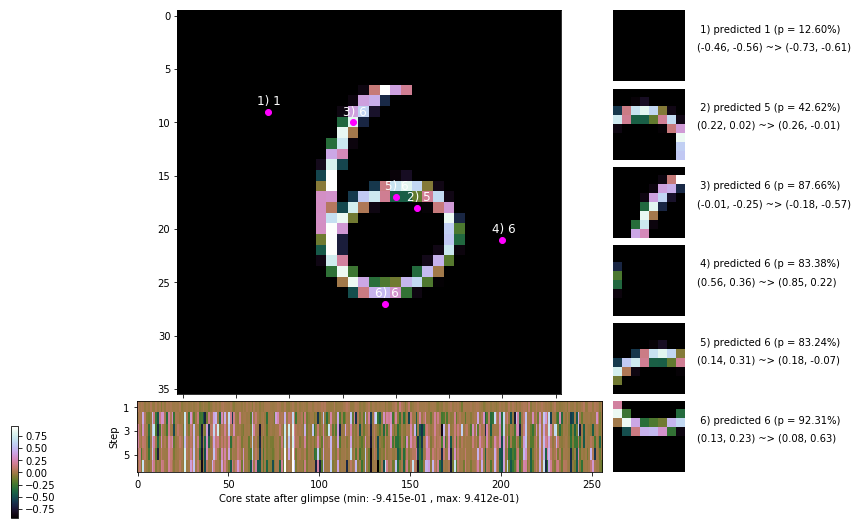

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.6 ms/b | lr: 8.24e-04 | grad 2norm: 17.86 | grad inf norm:  4.346
         Weights || abs max:  1.95 ( 9356.02) | mean: -5.37e-04 ( 0.03) | var: 4.00e-02 (12931.51)
          Biases || abs max:  0.97 (   73.48) | mean: -8.71e-02 ( 0.08) | var: 4.52e-02 (  127.96)
                    class loss: 0.406 | steps: 2.394 | reward:  3.375 | acc.: 86.15%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 173.2 ms/b | lr: 8.24e-04 | grad 2norm: 17.83 | grad inf norm:  4.411
         Weights || abs max:  1.96 ( 2651.93) | mean: -4.82e-04 ( 0.01) | var: 4.01e-02 (  220.67)
          Biases || abs max:  0.96 (   46.61) | mean: -8.76e-02 ( 0.06) | var: 4.54e-02 (    5.77)
                    class loss: 0.414 | steps: 2.399 | reward:  3.385 | acc.: 85.75%

	Target class: 3 | Discounted rewards: [0.562, -0.875, -0

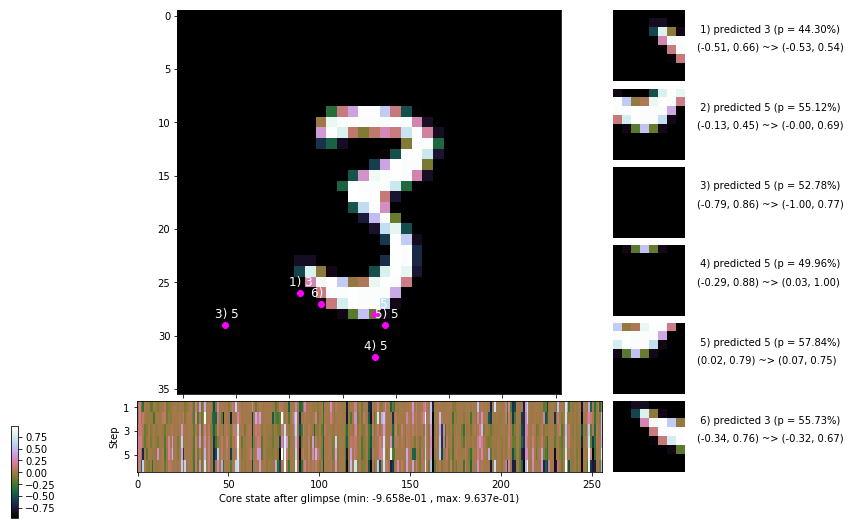

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


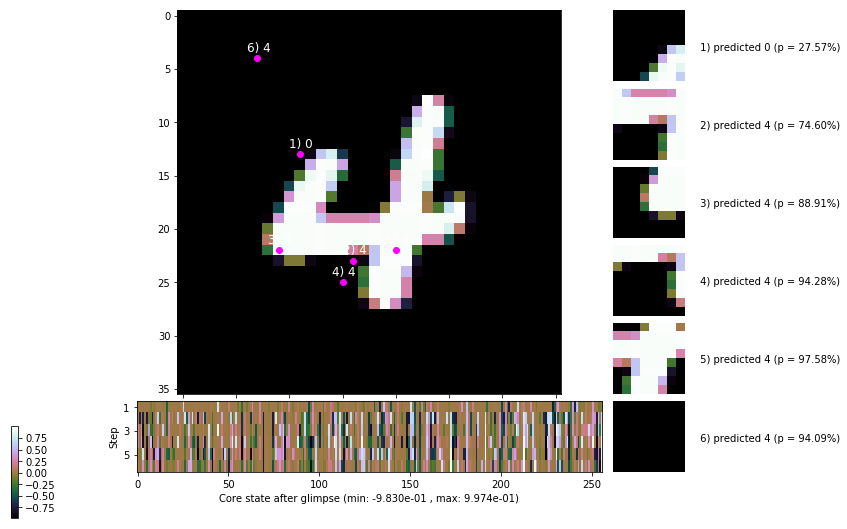


	Target class: 1 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


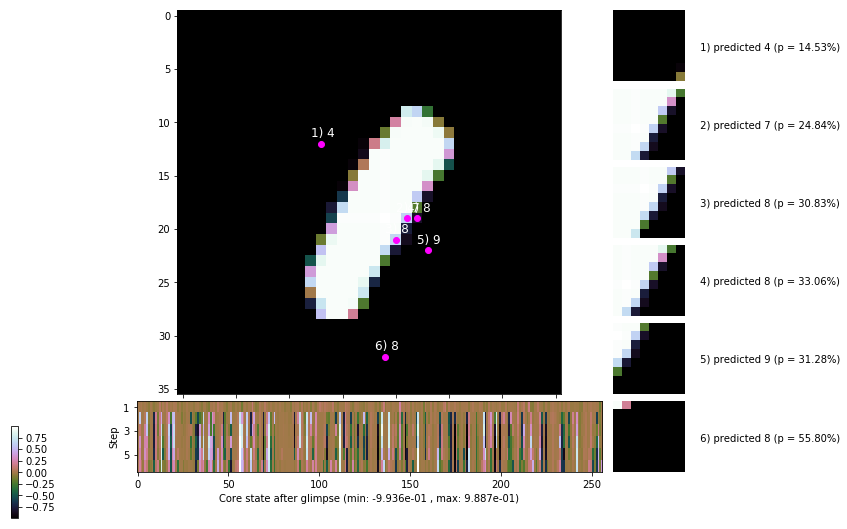

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


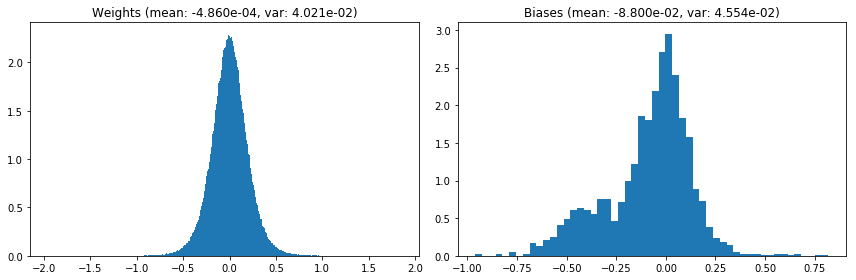

                                      Location network weights and biases


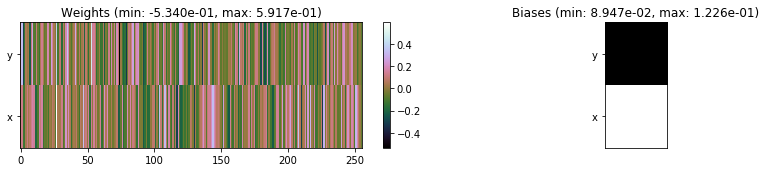

---------------------------------------------------------------------------------------------------------------
Elapsed time:  493.15 sec | TRAIN >> class loss: 0.4200 | steps:  2.405    | reward:  3.3490    | acc.: 85.863% 
                          | VAL   >> class loss: 0.4089 | steps:  2.275    | reward:  3.5601 :( | acc.: 85.980% :(


Epoch  14/400) lr = 0.0008228
 b    300/  3000 >> 188.9 ms/b | lr: 8.22e-04 | grad 2norm: 17.92 | grad inf norm:  4.362
         Weights || abs max:  1.96 ( 2870.76) | mean: -4.94e-04 ( 0.01) | var: 4.03e-02 (  178.02)
          Biases || abs max:  0.97 (   80.32) | mean: -8.84e-02 ( 0.08) | var: 4.57e-02 (   28.43)
                    class loss: 0.413 | steps: 2.372 | reward:  3.415 | acc.: 85.78%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 170.8 ms/b | lr: 8.21e-04 | grad 2norm: 17.69 | grad inf norm:  4.266
         Weights || abs max:  1.97 ( 3892.55) | mean: -5.33e-04 ( 0

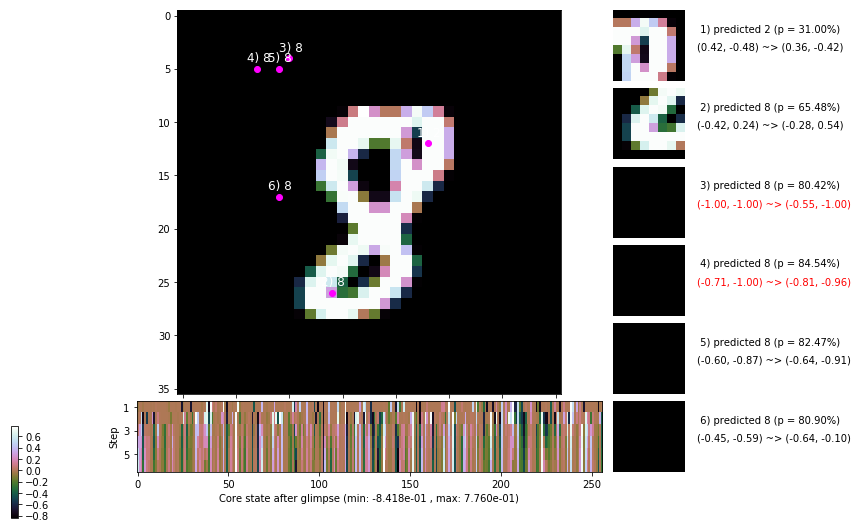

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 172.5 ms/b | lr: 8.19e-04 | grad 2norm: 18.04 | grad inf norm:  4.396
         Weights || abs max:  1.96 ( 6546.24) | mean: -4.78e-04 ( 0.02) | var: 4.06e-02 ( 2497.52)
          Biases || abs max:  0.97 (   53.31) | mean: -8.88e-02 ( 0.06) | var: 4.62e-02 (    7.01)
                    class loss: 0.421 | steps: 2.423 | reward:  3.327 | acc.: 85.53%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 164.3 ms/b | lr: 8.19e-04 | grad 2norm: 17.35 | grad inf norm:  4.265
         Weights || abs max:  1.96 (11861.58) | mean: -4.68e-04 ( 0.03) | var: 4.08e-02 (29564.44)
          Biases || abs max:  0.98 (  862.09) | mean: -8.89e-02 ( 0.38) | var: 4.64e-02 (61545.73)
                    class loss: 0.413 | steps: 2.398 | reward:  3.398 | acc.: 86.63%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

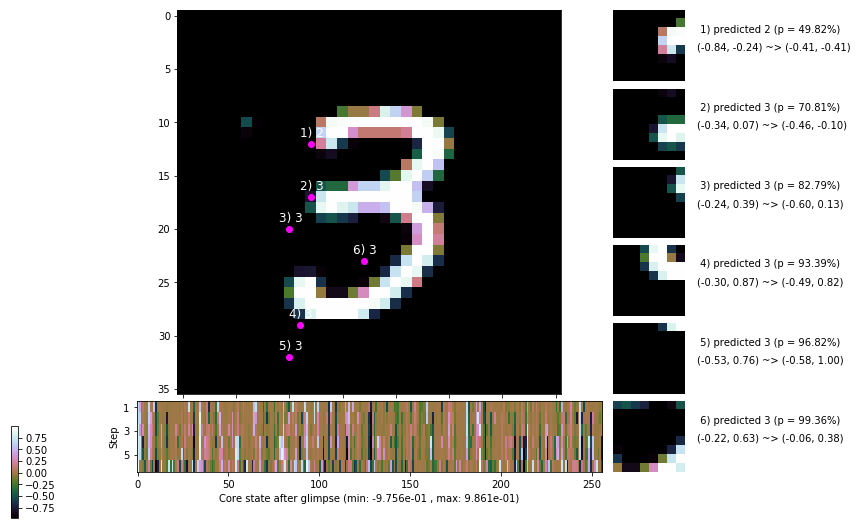

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 168.5 ms/b | lr: 8.17e-04 | grad 2norm: 17.19 | grad inf norm:  4.318
         Weights || abs max:  1.96 ( 4159.16) | mean: -4.85e-04 ( 0.02) | var: 4.10e-02 (  817.51)
          Biases || abs max:  0.99 (   94.02) | mean: -8.93e-02 ( 0.09) | var: 4.66e-02 (   59.94)
                    class loss: 0.405 | steps: 2.378 | reward:  3.416 | acc.: 86.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 164.8 ms/b | lr: 8.16e-04 | grad 2norm: 17.31 | grad inf norm:  4.219
         Weights || abs max:  1.98 ( 2947.99) | mean: -4.81e-04 ( 0.01) | var: 4.11e-02 (  220.51)
          Biases || abs max:  0.99 (   67.20) | mean: -8.96e-02 ( 0.08) | var: 4.68e-02 (   20.86)
                    class loss: 0.401 | steps: 2.368 | reward:  3.429 | acc.: 86.40%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

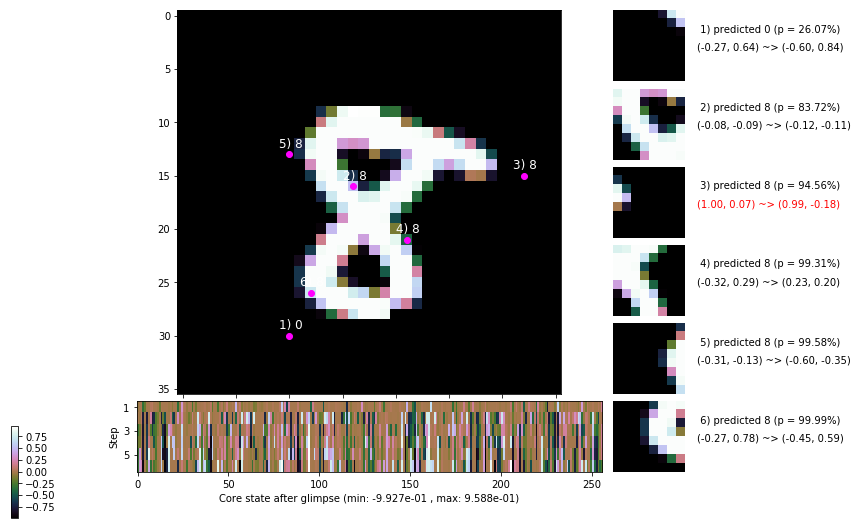

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 168.9 ms/b | lr: 8.15e-04 | grad 2norm: 17.24 | grad inf norm:  4.276
         Weights || abs max:  1.98 ( 2272.42) | mean: -4.94e-04 ( 0.01) | var: 4.13e-02 (  131.44)
          Biases || abs max:  1.00 (  106.87) | mean: -8.97e-02 ( 0.09) | var: 4.69e-02 (  195.87)
                    class loss: 0.397 | steps: 2.389 | reward:  3.437 | acc.: 86.60%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 176.9 ms/b | lr: 8.14e-04 | grad 2norm: 17.81 | grad inf norm:  4.362
         Weights || abs max:  1.99 (33982.14) | mean: -5.07e-04 ( 0.07) | var: 4.15e-02 (473158.38)
          Biases || abs max:  1.00 (  137.90) | mean: -9.00e-02 ( 0.11) | var: 4.73e-02 (  164.88)
                    class loss: 0.405 | steps: 2.405 | reward:  3.388 | acc.: 86.60%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.

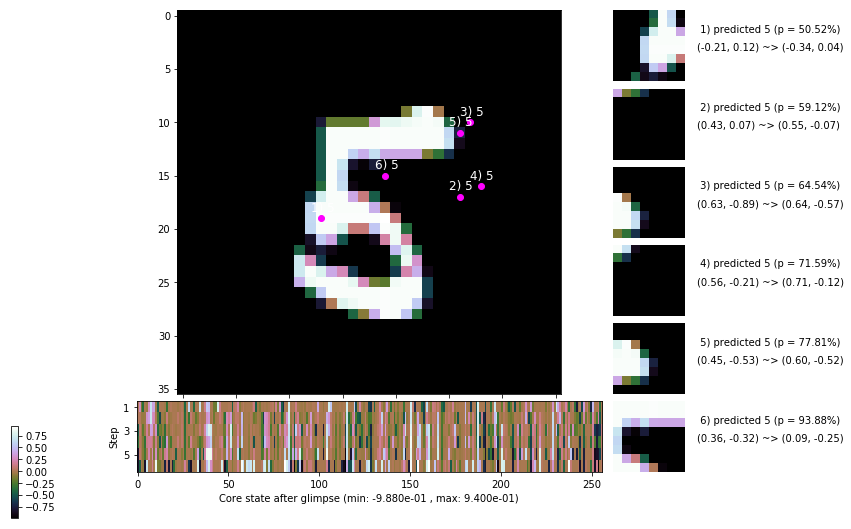

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 169.2 ms/b | lr: 8.12e-04 | grad 2norm: 17.35 | grad inf norm:  4.197
         Weights || abs max:  1.99 ( 4276.15) | mean: -5.05e-04 ( 0.02) | var: 4.16e-02 (  525.31)
          Biases || abs max:  0.99 (   78.55) | mean: -9.05e-02 ( 0.07) | var: 4.76e-02 (  149.05)
                    class loss: 0.401 | steps: 2.357 | reward:  3.438 | acc.: 86.47%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 170.7 ms/b | lr: 8.11e-04 | grad 2norm: 17.01 | grad inf norm:  4.178
         Weights || abs max:  1.97 ( 4419.28) | mean: -5.23e-04 ( 0.02) | var: 4.18e-02 ( 1303.76)
          Biases || abs max:  0.99 (   75.50) | mean: -9.12e-02 ( 0.08) | var: 4.80e-02 (   95.39)
                    class loss: 0.413 | steps: 2.388 | reward:  3.404 | acc.: 86.17%

	Target class: 6 | Discounted rewards: [-0.609, -0.219, 0

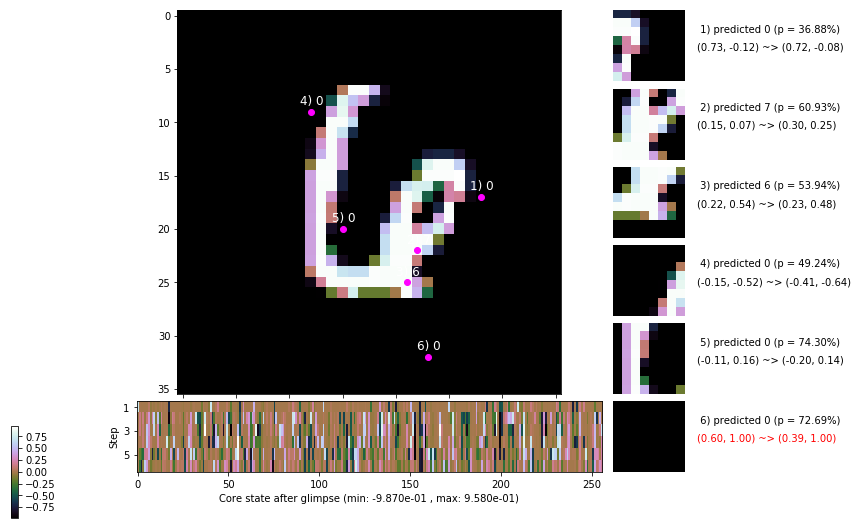

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


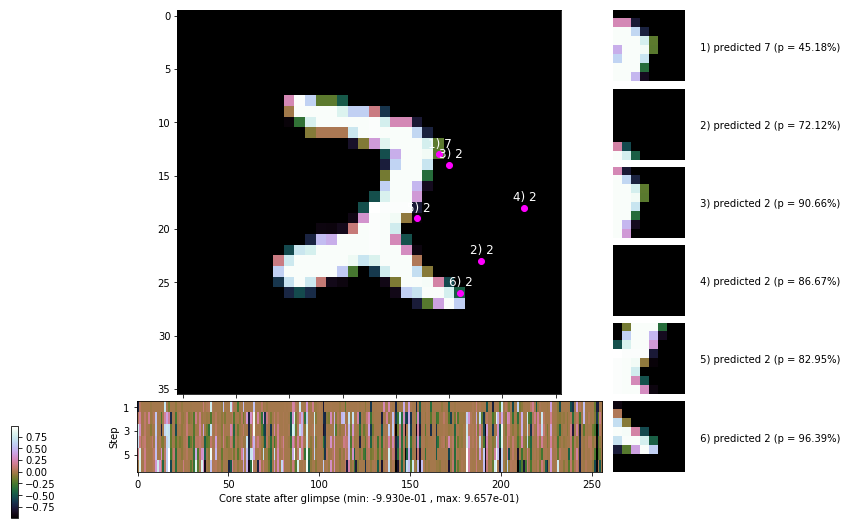


	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


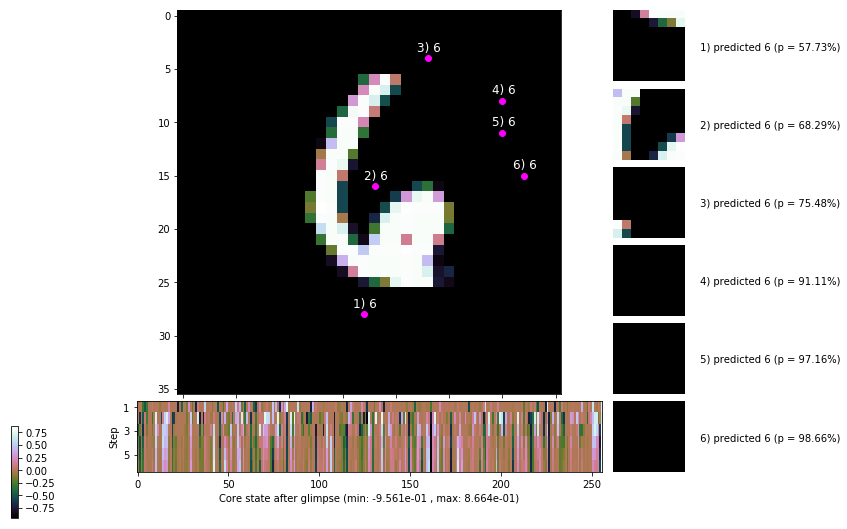

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


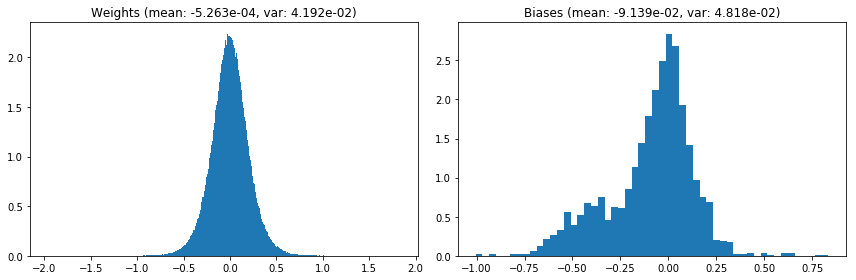

                                      Location network weights and biases


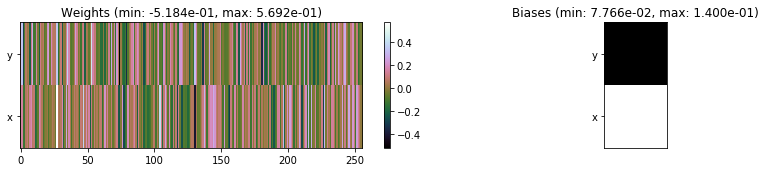

---------------------------------------------------------------------------------------------------------------
Elapsed time:  515.35 sec | TRAIN >> class loss: 0.4082 | steps:  2.388    | reward:  3.4015    | acc.: 86.287% 
                          | VAL   >> class loss: 0.3948 | steps:  2.297 :( | reward:  3.5769 :( | acc.: 86.520% :(


Epoch  15/400) lr = 0.0008105
 b    300/  3000 >> 181.2 ms/b | lr: 8.10e-04 | grad 2norm: 16.93 | grad inf norm:  4.167
         Weights || abs max:  1.97 ( 3752.25) | mean: -5.41e-04 ( 0.02) | var: 4.20e-02 (  537.37)
          Biases || abs max:  1.00 (  126.04) | mean: -9.13e-02 ( 0.10) | var: 4.83e-02 (  477.04)
                    class loss: 0.403 | steps: 2.360 | reward:  3.464 | acc.: 87.37%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 168.9 ms/b | lr: 8.09e-04 | grad 2norm: 17.32 | grad inf norm:  4.118
         Weights || abs max:  1.96 ( 1811.86) | mean: -5.50e-04 ( 0

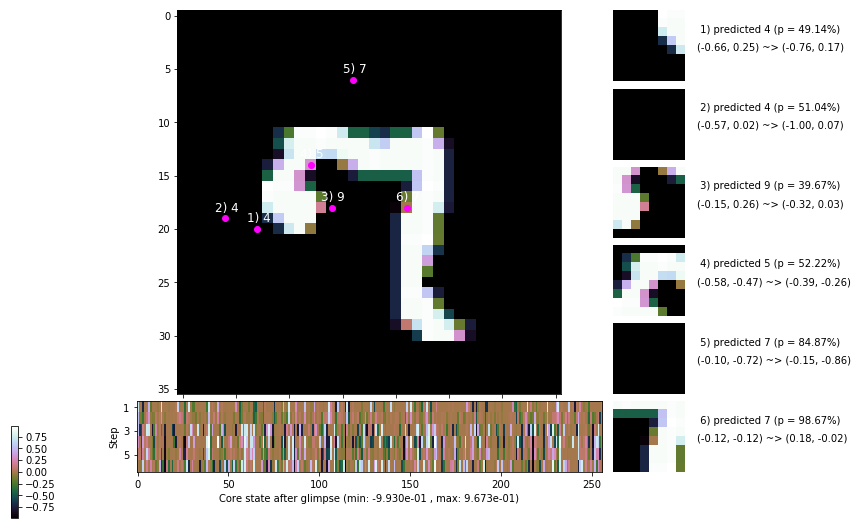

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 170.3 ms/b | lr: 8.07e-04 | grad 2norm: 17.03 | grad inf norm:  4.336
         Weights || abs max:  1.97 ( 2272.78) | mean: -5.73e-04 ( 0.01) | var: 4.23e-02 (  150.31)
          Biases || abs max:  1.01 (  128.15) | mean: -9.18e-02 ( 0.10) | var: 4.85e-02 (  187.83)
                    class loss: 0.397 | steps: 2.371 | reward:  3.442 | acc.: 87.20%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 174.3 ms/b | lr: 8.06e-04 | grad 2norm: 16.98 | grad inf norm:  4.284
         Weights || abs max:  1.98 ( 3397.92) | mean: -5.73e-04 ( 0.01) | var: 4.25e-02 (  347.15)
          Biases || abs max:  1.01 (  851.94) | mean: -9.25e-02 ( 0.40) | var: 4.88e-02 (50504.57)
                    class loss: 0.412 | steps: 2.364 | reward:  3.423 | acc.: 86.62%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

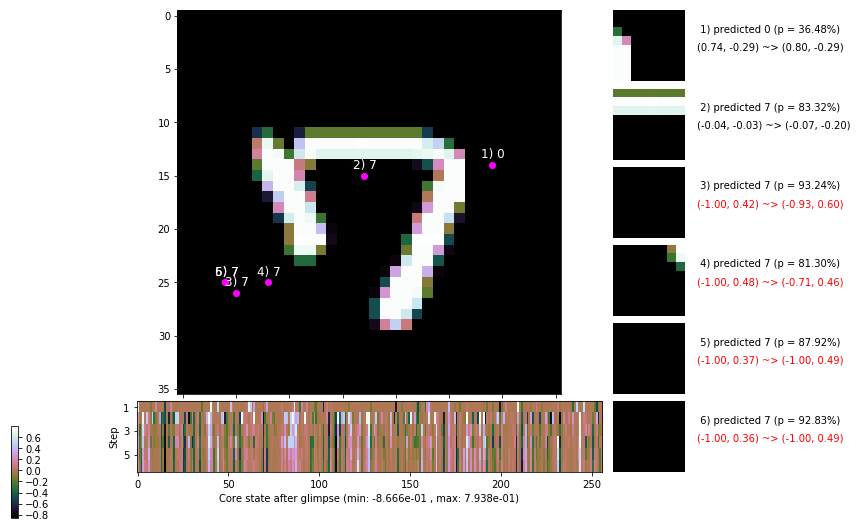

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 170.6 ms/b | lr: 8.05e-04 | grad 2norm: 17.36 | grad inf norm:  4.248
         Weights || abs max:  1.99 (78804.82) | mean: -5.81e-04 ( 0.15) | var: 4.27e-02 (3054539.25)
          Biases || abs max:  1.02 (   81.82) | mean: -9.29e-02 ( 0.09) | var: 4.92e-02 (   56.82)
                    class loss: 0.417 | steps: 2.381 | reward:  3.387 | acc.: 85.57%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 173.6 ms/b | lr: 8.04e-04 | grad 2norm: 17.03 | grad inf norm:  4.232
         Weights || abs max:  1.99 ( 4922.08) | mean: -5.85e-04 ( 0.02) | var: 4.28e-02 ( 1320.56)
          Biases || abs max:  1.03 (  395.20) | mean: -9.31e-02 ( 0.20) | var: 4.93e-02 ( 5496.30)
                    class loss: 0.403 | steps: 2.379 | reward:  3.384 | acc.: 86.43%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1

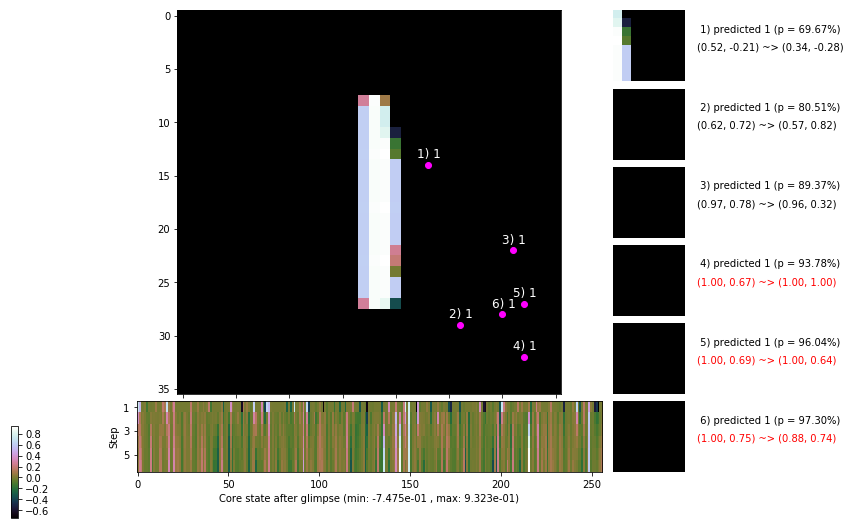

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 174.2 ms/b | lr: 8.02e-04 | grad 2norm: 16.97 | grad inf norm:  4.159
         Weights || abs max:  1.98 ( 6140.40) | mean: -5.85e-04 ( 0.02) | var: 4.30e-02 ( 7737.29)
          Biases || abs max:  1.02 (  127.20) | mean: -9.38e-02 ( 0.10) | var: 4.97e-02 (  185.00)
                    class loss: 0.413 | steps: 2.374 | reward:  3.436 | acc.: 86.60%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 171.3 ms/b | lr: 8.02e-04 | grad 2norm: 16.88 | grad inf norm:  4.218
         Weights || abs max:  1.99 ( 2690.49) | mean: -5.86e-04 ( 0.01) | var: 4.31e-02 (  268.59)
          Biases || abs max:  1.02 (   66.31) | mean: -9.47e-02 ( 0.08) | var: 5.00e-02 (   23.68)
                    class loss: 0.414 | steps: 2.344 | reward:  3.425 | acc.: 85.57%

	Target class: 4 | Discounted rewards: [1.641, 1.281, 0.5

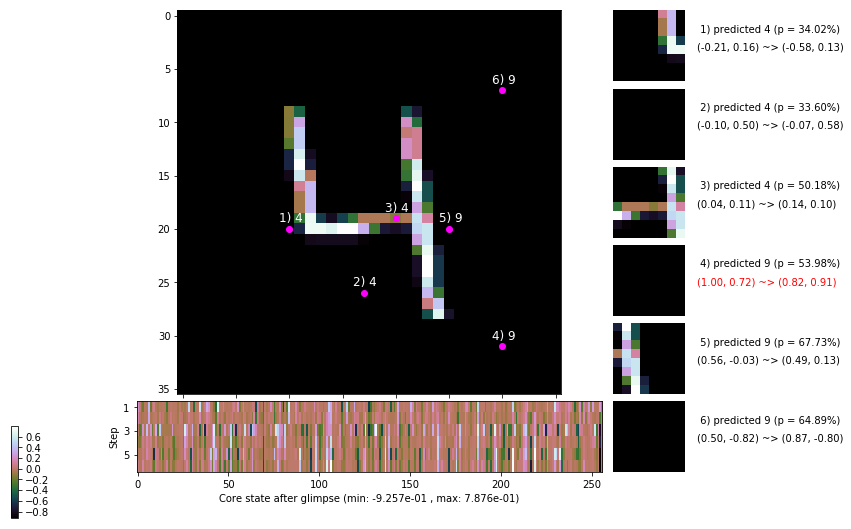

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 172.6 ms/b | lr: 8.00e-04 | grad 2norm: 17.18 | grad inf norm:  4.100
         Weights || abs max:  1.99 ( 3881.10) | mean: -6.11e-04 ( 0.02) | var: 4.33e-02 (  551.50)
          Biases || abs max:  1.02 (  213.22) | mean: -9.48e-02 ( 0.13) | var: 5.02e-02 ( 3430.60)
                    class loss: 0.423 | steps: 2.388 | reward:  3.352 | acc.: 85.70%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 175.2 ms/b | lr: 7.99e-04 | grad 2norm: 16.90 | grad inf norm:  4.338
         Weights || abs max:  1.99 ( 3021.14) | mean: -6.47e-04 ( 0.01) | var: 4.35e-02 (  383.48)
          Biases || abs max:  1.02 (   58.61) | mean: -9.45e-02 ( 0.08) | var: 5.03e-02 (   11.73)
                    class loss: 0.427 | steps: 2.373 | reward:  3.402 | acc.: 86.23%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

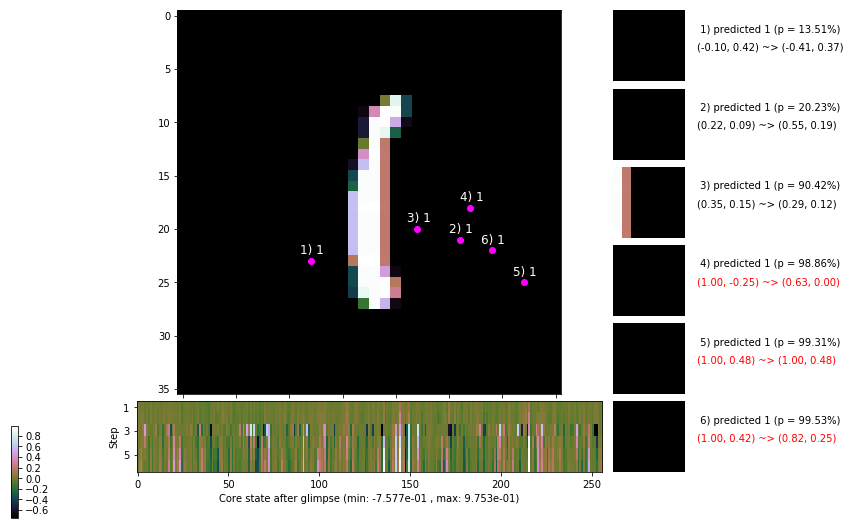

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


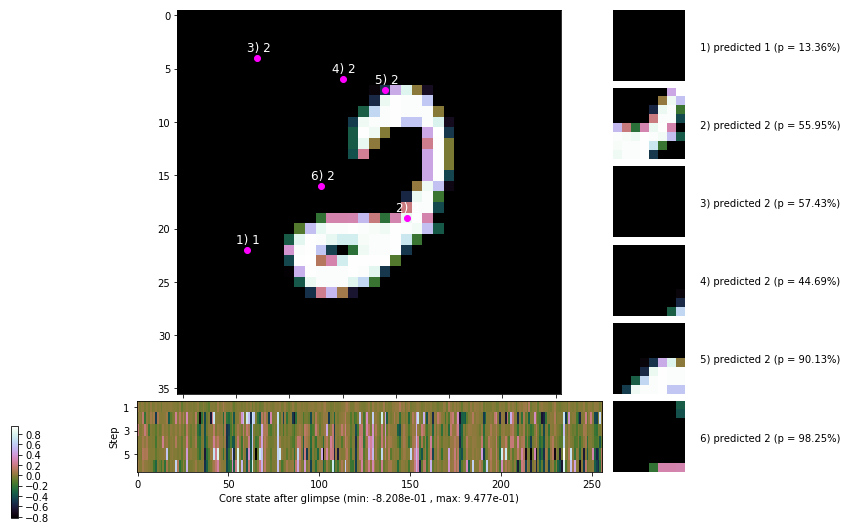


	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


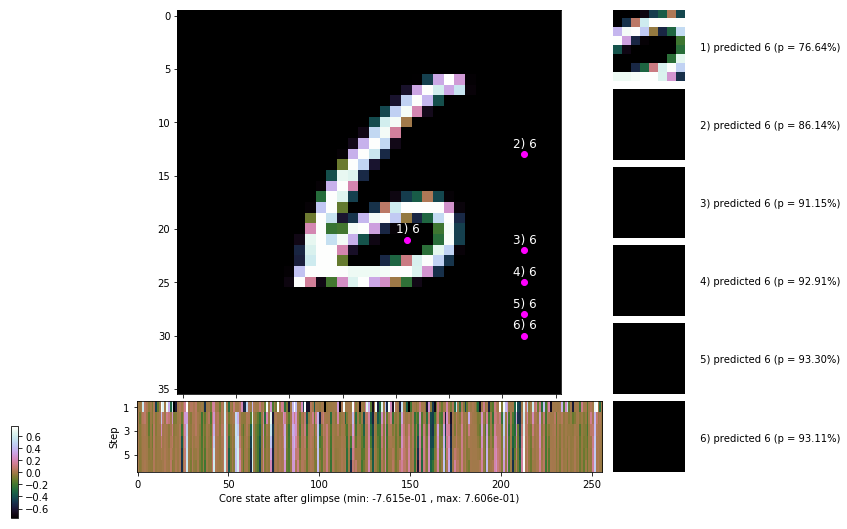

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


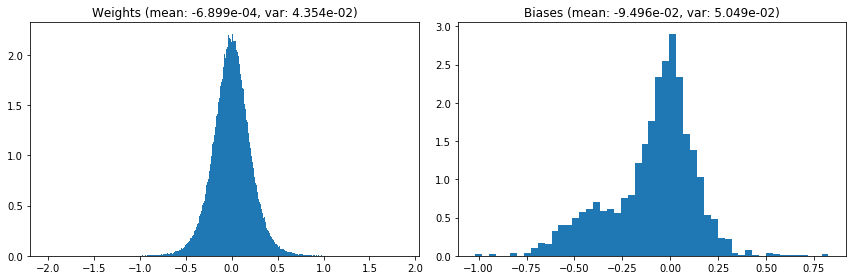

                                      Location network weights and biases


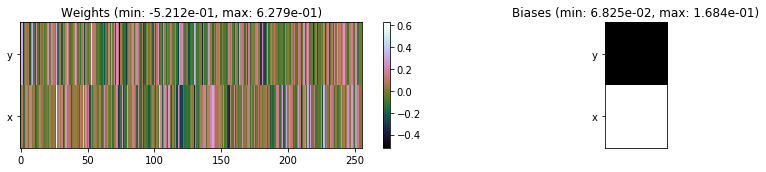

---------------------------------------------------------------------------------------------------------------
Elapsed time:  520.42 sec | TRAIN >> class loss: 0.4114 | steps:  2.370    | reward:  3.4120    | acc.: 86.392% 
                          | VAL   >> class loss: 0.4206 | steps:  2.303 :( | reward:  3.5205 :( | acc.: 85.900% :(


Epoch  16/400) lr = 0.0007984
 b    300/  3000 >> 180.7 ms/b | lr: 7.98e-04 | grad 2norm: 16.85 | grad inf norm:  4.270
         Weights || abs max:  2.00 ( 1955.33) | mean: -6.90e-04 ( 0.01) | var: 4.36e-02 (   51.81)
          Biases || abs max:  1.02 (   80.06) | mean: -9.50e-02 ( 0.08) | var: 5.05e-02 (   31.01)
                    class loss: 0.411 | steps: 2.381 | reward:  3.398 | acc.: 86.23%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 171.6 ms/b | lr: 7.97e-04 | grad 2norm: 16.75 | grad inf norm:  4.061
         Weights || abs max:  2.01 ( 2857.37) | mean: -7.02e-04 ( 0

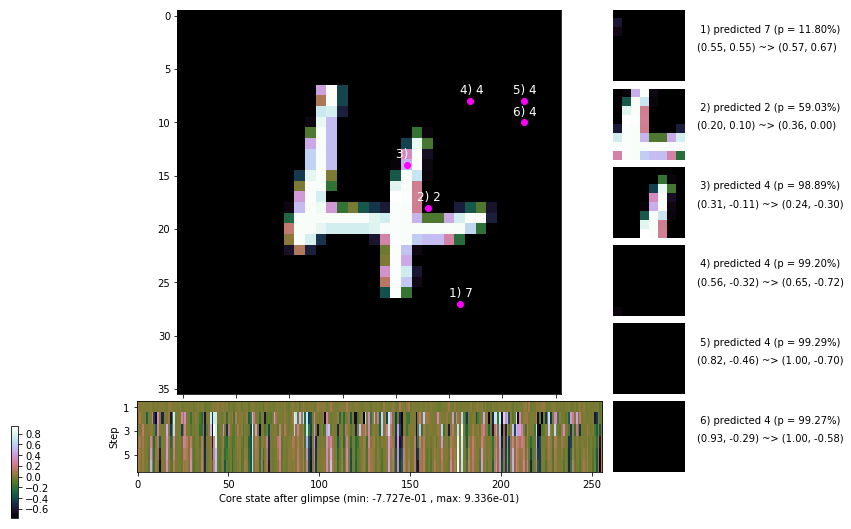

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 180.3 ms/b | lr: 7.95e-04 | grad 2norm: 16.89 | grad inf norm:  4.363
         Weights || abs max:  2.02 ( 2904.64) | mean: -6.97e-04 ( 0.01) | var: 4.40e-02 (  283.05)
          Biases || abs max:  1.03 (   72.46) | mean: -9.59e-02 ( 0.08) | var: 5.14e-02 (   46.91)
                    class loss: 0.414 | steps: 2.392 | reward:  3.389 | acc.: 86.07%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 168.9 ms/b | lr: 7.94e-04 | grad 2norm: 16.79 | grad inf norm:  4.199
         Weights || abs max:  2.02 ( 3709.96) | mean: -7.40e-04 ( 0.02) | var: 4.41e-02 (  238.95)
          Biases || abs max:  1.01 (  115.84) | mean: -9.58e-02 ( 0.09) | var: 5.16e-02 (  251.80)
                    class loss: 0.418 | steps: 2.400 | reward:  3.366 | acc.: 86.07%

	Target class: 9 | Discounted rewards: [1.828, 1.656, 1.3

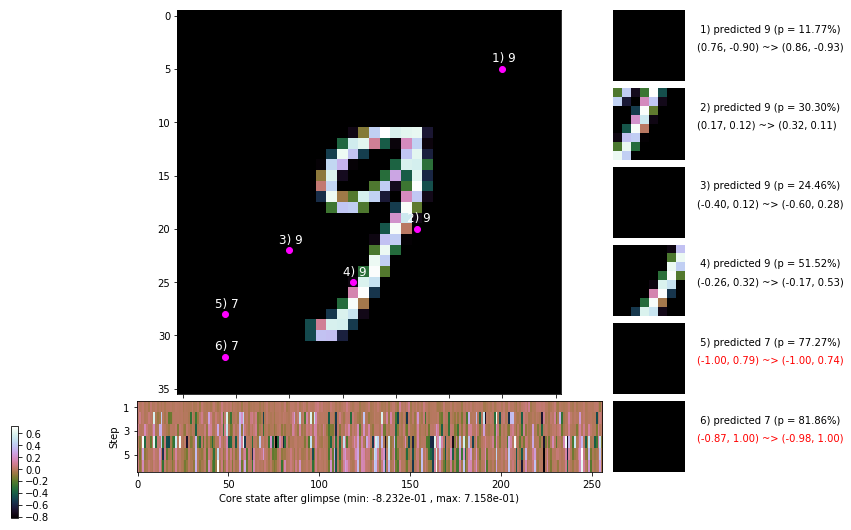

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 177.1 ms/b | lr: 7.93e-04 | grad 2norm: 16.90 | grad inf norm:  4.370
         Weights || abs max:  2.03 ( 2616.33) | mean: -7.27e-04 ( 0.01) | var: 4.43e-02 (  141.28)
          Biases || abs max:  1.02 (  166.15) | mean: -9.54e-02 ( 0.12) | var: 5.18e-02 (  697.11)
                    class loss: 0.408 | steps: 2.385 | reward:  3.389 | acc.: 86.22%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 182.0 ms/b | lr: 7.92e-04 | grad 2norm: 16.77 | grad inf norm:  4.273
         Weights || abs max:  2.03 ( 6552.88) | mean: -7.39e-04 ( 0.02) | var: 4.44e-02 (10810.29)
          Biases || abs max:  1.02 (  160.78) | mean: -9.60e-02 ( 0.12) | var: 5.22e-02 (  159.45)
                    class loss: 0.443 | steps: 2.410 | reward:  3.319 | acc.: 85.22%

	Target class: 2 | Discounted rewards: [-0.281, 0.438, 1.

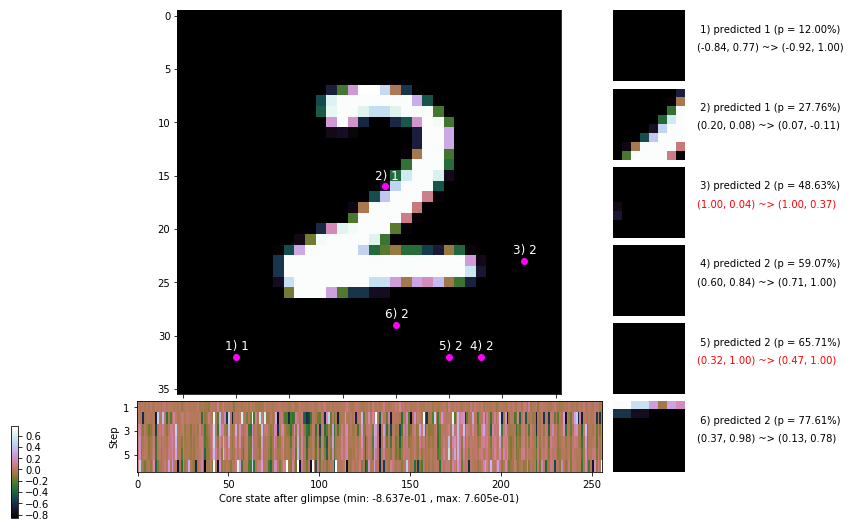

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 195.3 ms/b | lr: 7.90e-04 | grad 2norm: 16.67 | grad inf norm:  4.024
         Weights || abs max:  2.03 ( 4576.66) | mean: -7.13e-04 ( 0.02) | var: 4.46e-02 ( 1915.54)
          Biases || abs max:  1.04 (  125.65) | mean: -9.62e-02 ( 0.10) | var: 5.21e-02 (  187.47)
                    class loss: 0.401 | steps: 2.378 | reward:  3.417 | acc.: 86.85%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 180.8 ms/b | lr: 7.90e-04 | grad 2norm: 16.49 | grad inf norm:  4.052
         Weights || abs max:  2.04 ( 2947.02) | mean: -7.49e-04 ( 0.01) | var: 4.47e-02 (  597.44)
          Biases || abs max:  1.03 (   87.55) | mean: -9.71e-02 ( 0.08) | var: 5.25e-02 (  159.82)
                    class loss: 0.411 | steps: 2.359 | reward:  3.456 | acc.: 87.13%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

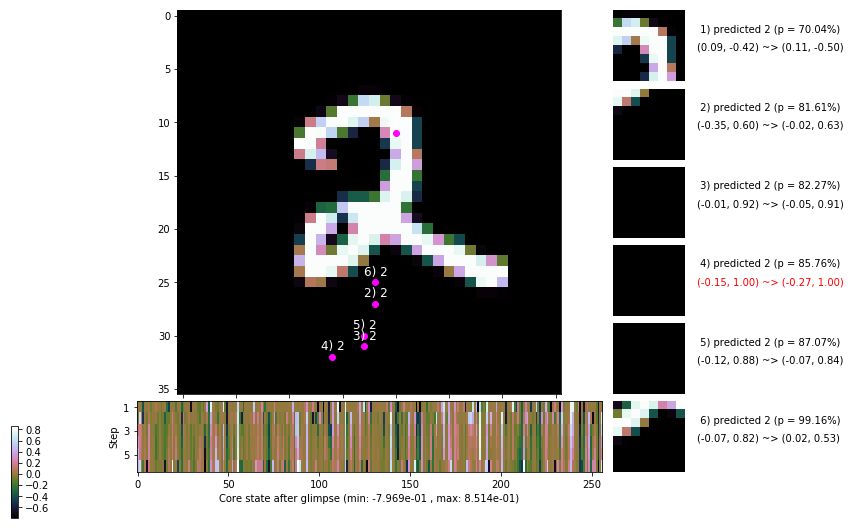

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 175.1 ms/b | lr: 7.88e-04 | grad 2norm: 16.66 | grad inf norm:  4.265
         Weights || abs max:  2.04 ( 4116.03) | mean: -7.71e-04 ( 0.02) | var: 4.49e-02 (  635.75)
          Biases || abs max:  1.04 (  128.58) | mean: -9.70e-02 ( 0.13) | var: 5.28e-02 ( 1595.45)
                    class loss: 0.408 | steps: 2.341 | reward:  3.470 | acc.: 86.18%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 182.0 ms/b | lr: 7.87e-04 | grad 2norm: 16.56 | grad inf norm:  4.006
         Weights || abs max:  2.04 ( 5331.75) | mean: -7.82e-04 ( 0.02) | var: 4.50e-02 (  937.35)
          Biases || abs max:  1.05 (   84.31) | mean: -9.77e-02 ( 0.09) | var: 5.30e-02 (  105.82)
                    class loss: 0.406 | steps: 2.389 | reward:  3.397 | acc.: 86.32%

	Target class: 9 | Discounted rewards: [-0.281, 0.438, 1.

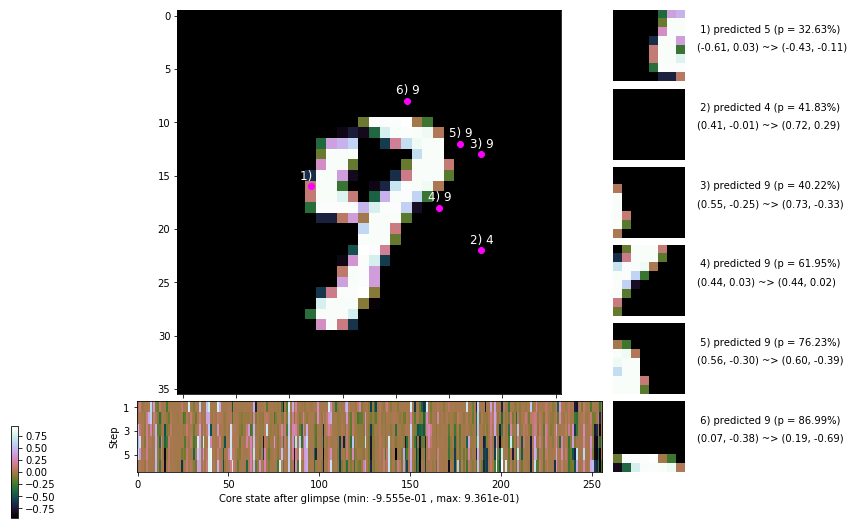

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


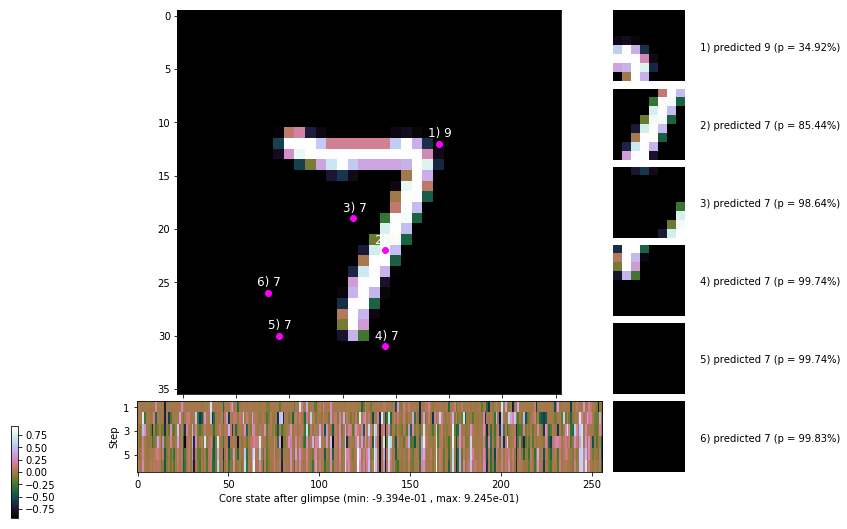


	Target class: 4 | Discounted rewards: [-0.656, -0.312, 0.375, 1.750, 1.500, 1.000]


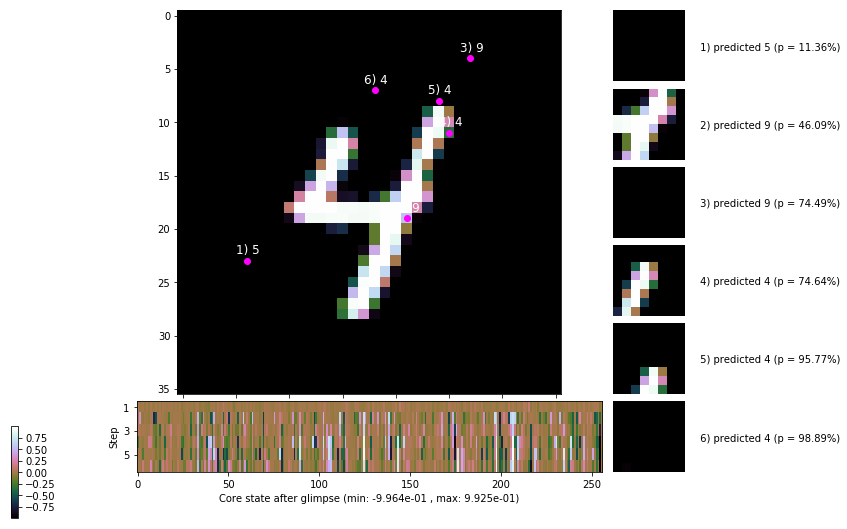

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


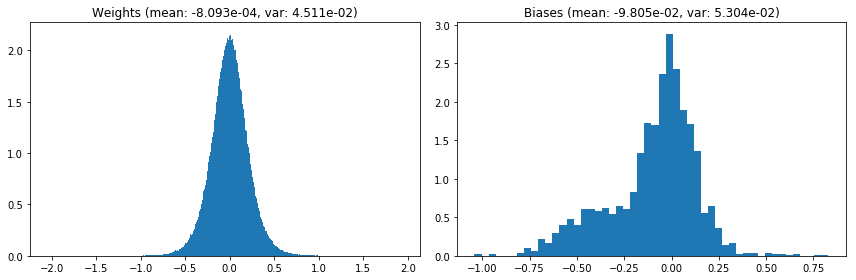

                                      Location network weights and biases


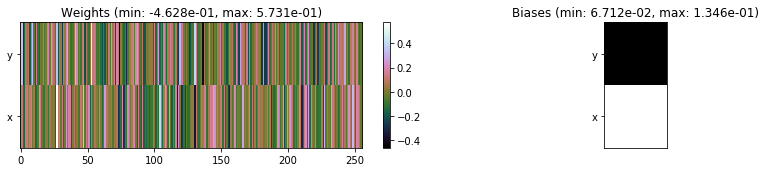

---------------------------------------------------------------------------------------------------------------
Elapsed time:  538.96 sec | TRAIN >> class loss: 0.4141 | steps:  2.382 :( | reward:  3.4019 :( | acc.: 86.253% :(
                          | VAL   >> class loss: 0.3957 | steps:  2.306 :( | reward:  3.5385 :( | acc.: 86.520% :(


Epoch  17/400) lr = 0.0007865
 b    300/  3000 >> 170.7 ms/b | lr: 7.86e-04 | grad 2norm: 16.59 | grad inf norm:  4.210
         Weights || abs max:  2.04 (19327.62) | mean: -7.98e-04 ( 0.04) | var: 4.52e-02 (158958.58)
          Biases || abs max:  1.03 (   57.80) | mean: -9.79e-02 ( 0.07) | var: 5.29e-02 (   10.34)
                    class loss: 0.400 | steps: 2.367 | reward:  3.403 | acc.: 86.43%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 155.5 ms/b | lr: 7.85e-04 | grad 2norm: 16.67 | grad inf norm:  4.222
         Weights || abs max:  2.04 (11774.01) | mean: -7.90e-04 

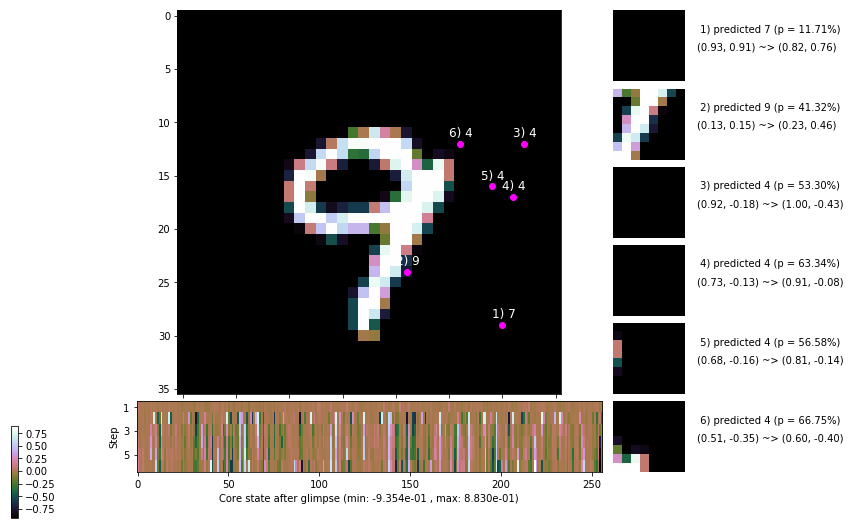

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 150.9 ms/b | lr: 7.83e-04 | grad 2norm: 16.73 | grad inf norm:  4.170
         Weights || abs max:  2.05 ( 4199.92) | mean: -7.89e-04 ( 0.02) | var: 4.55e-02 (  727.85)
          Biases || abs max:  1.04 (  100.53) | mean: -9.72e-02 ( 0.08) | var: 5.31e-02 (  398.52)
                    class loss: 0.390 | steps: 2.350 | reward:  3.451 | acc.: 86.98%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 150.2 ms/b | lr: 7.83e-04 | grad 2norm: 16.89 | grad inf norm:  4.298
         Weights || abs max:  2.05 ( 3819.61) | mean: -7.94e-04 ( 0.02) | var: 4.57e-02 (  545.91)
          Biases || abs max:  1.03 (   77.97) | mean: -9.70e-02 ( 0.07) | var: 5.34e-02 (   44.01)
                    class loss: 0.394 | steps: 2.358 | reward:  3.438 | acc.: 86.65%

	Target class: 6 | Discounted rewards: [-0.844, -0.688, -

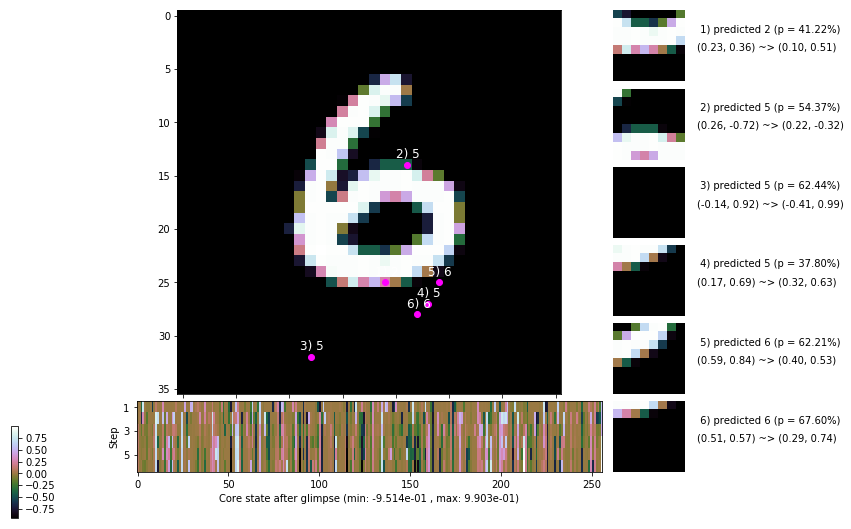

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 149.3 ms/b | lr: 7.81e-04 | grad 2norm: 16.40 | grad inf norm:  3.918
         Weights || abs max:  2.05 ( 4107.78) | mean: -7.92e-04 ( 0.02) | var: 4.58e-02 ( 1098.13)
          Biases || abs max:  1.04 (  118.69) | mean: -9.77e-02 ( 0.10) | var: 5.38e-02 (  178.04)
                    class loss: 0.394 | steps: 2.372 | reward:  3.427 | acc.: 87.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.9 ms/b | lr: 7.80e-04 | grad 2norm: 17.08 | grad inf norm:  4.240
         Weights || abs max:  2.05 ( 2723.02) | mean: -8.36e-04 ( 0.01) | var: 4.60e-02 (   98.87)
          Biases || abs max:  1.04 (  125.68) | mean: -9.73e-02 ( 0.11) | var: 5.40e-02 (  150.25)
                    class loss: 0.387 | steps: 2.356 | reward:  3.454 | acc.: 87.02%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

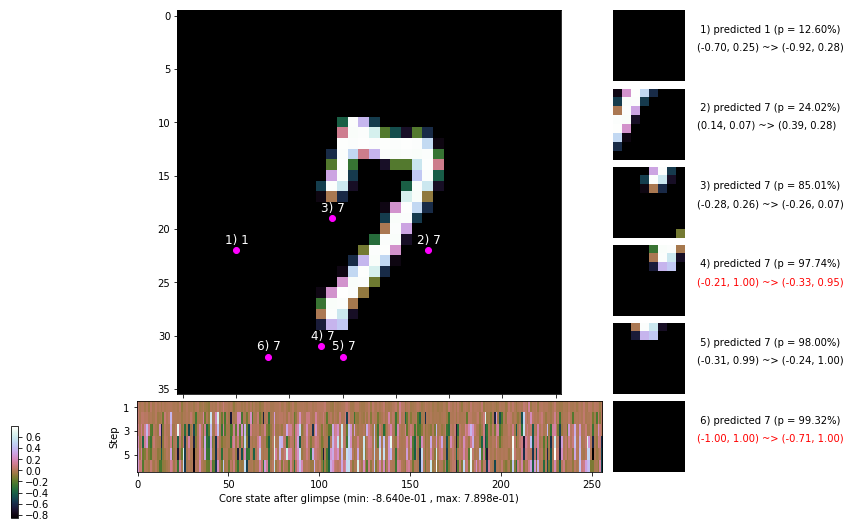

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.3 ms/b | lr: 7.79e-04 | grad 2norm: 16.47 | grad inf norm:  4.037
         Weights || abs max:  2.05 ( 3468.75) | mean: -8.02e-04 ( 0.01) | var: 4.61e-02 (  717.80)
          Biases || abs max:  1.04 (  163.59) | mean: -9.78e-02 ( 0.12) | var: 5.43e-02 ( 1216.47)
                    class loss: 0.365 | steps: 2.312 | reward:  3.519 | acc.: 87.37%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 183.4 ms/b | lr: 7.78e-04 | grad 2norm: 16.70 | grad inf norm:  4.030
         Weights || abs max:  2.06 ( 4746.71) | mean: -7.69e-04 ( 0.02) | var: 4.63e-02 (  639.73)
          Biases || abs max:  1.04 (   94.55) | mean: -9.78e-02 ( 0.09) | var: 5.45e-02 (  110.92)
                    class loss: 0.373 | steps: 2.354 | reward:  3.494 | acc.: 87.68%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

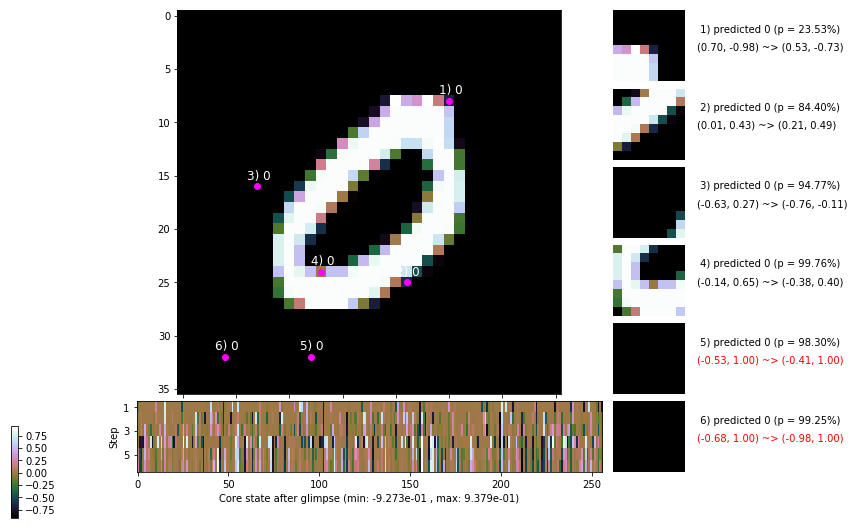

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 151.6 ms/b | lr: 7.76e-04 | grad 2norm: 16.43 | grad inf norm:  4.210
         Weights || abs max:  2.08 ( 3733.84) | mean: -7.93e-04 ( 0.02) | var: 4.64e-02 (  313.55)
          Biases || abs max:  1.05 (  132.82) | mean: -9.79e-02 ( 0.11) | var: 5.47e-02 (  134.41)
                    class loss: 0.370 | steps: 2.310 | reward:  3.530 | acc.: 87.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 166.1 ms/b | lr: 7.76e-04 | grad 2norm: 16.98 | grad inf norm:  4.232
         Weights || abs max:  2.08 ( 3167.83) | mean: -7.97e-04 ( 0.01) | var: 4.66e-02 (  376.64)
          Biases || abs max:  1.06 (   83.63) | mean: -9.85e-02 ( 0.09) | var: 5.50e-02 (   43.48)
                    class loss: 0.414 | steps: 2.419 | reward:  3.351 | acc.: 85.80%

	Target class: 9 | Discounted rewards: [-0.984, -0.969, -

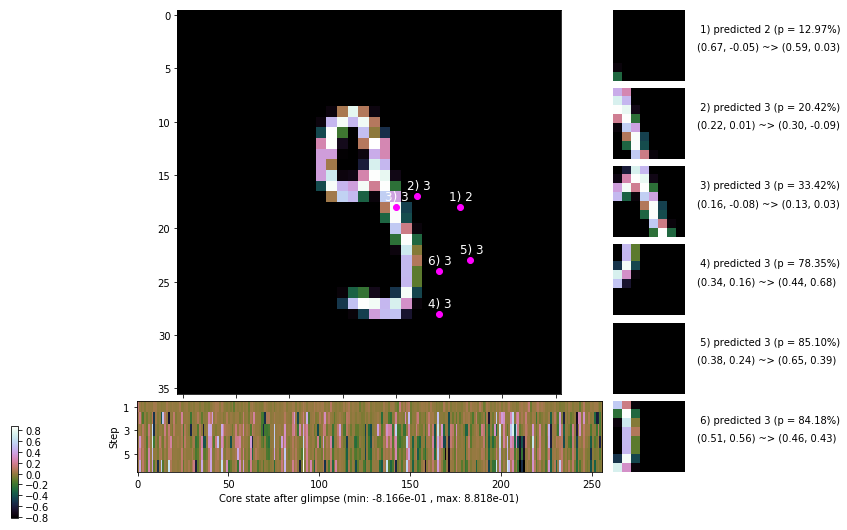

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.375, 1.750, 1.500, 1.000, 0.000, 1.000]


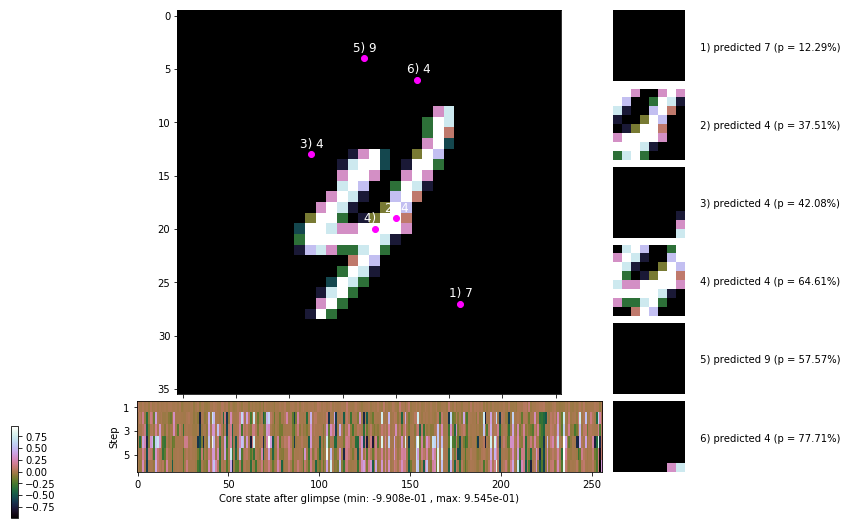


	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


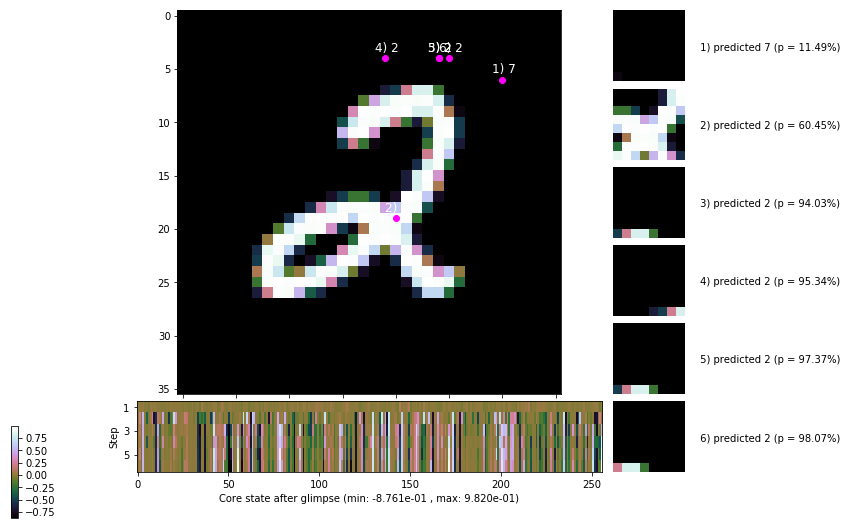

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


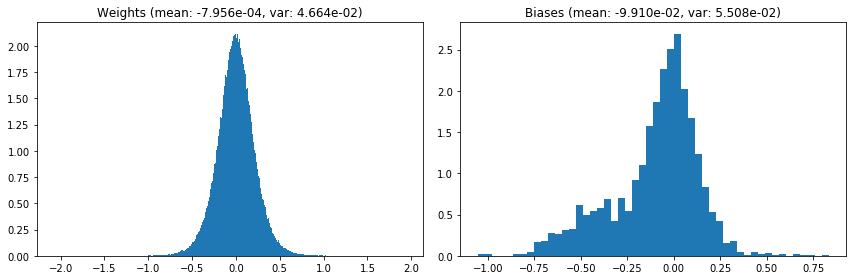

                                      Location network weights and biases


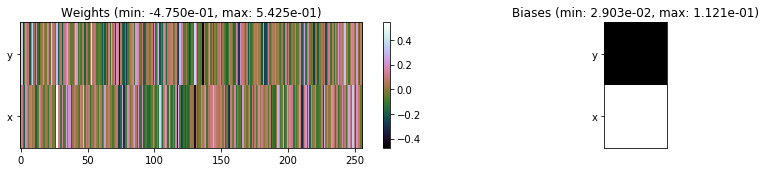

---------------------------------------------------------------------------------------------------------------
Elapsed time:  470.04 sec | TRAIN >> class loss: 0.3862 | steps:  2.354    | reward:  3.4534    | acc.: 86.992% 
                          | VAL   >> class loss: 0.3647 | steps:  2.246    | reward:  3.6573    | acc.: 88.140% 


Epoch  18/400) lr = 0.0007748
 b    300/  3000 >> 150.0 ms/b | lr: 7.74e-04 | grad 2norm: 16.69 | grad inf norm:  4.139
         Weights || abs max:  2.08 (24622.81) | mean: -7.78e-04 ( 0.05) | var: 4.67e-02 (86478.47)
          Biases || abs max:  1.05 (   71.17) | mean: -9.93e-02 ( 0.08) | var: 5.52e-02 (   15.12)
                    class loss: 0.406 | steps: 2.381 | reward:  3.406 | acc.: 86.47%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 153.7 ms/b | lr: 7.73e-04 | grad 2norm: 16.43 | grad inf norm:  4.020
         Weights || abs max:  2.09 (14818.32) | mean: -8.01e-04 ( 0.0

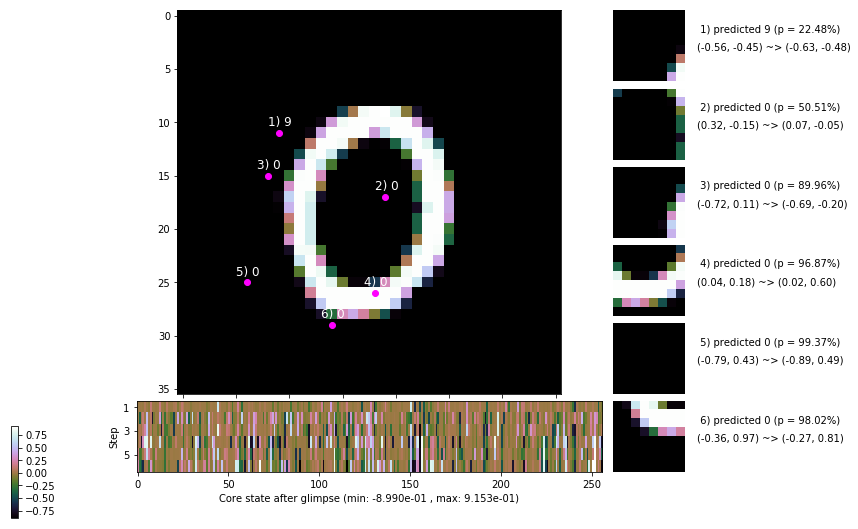

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.6 ms/b | lr: 7.72e-04 | grad 2norm: 16.62 | grad inf norm:  4.165
         Weights || abs max:  2.08 ( 4951.42) | mean: -7.94e-04 ( 0.02) | var: 4.70e-02 ( 2821.68)
          Biases || abs max:  1.05 (   53.46) | mean: -9.93e-02 ( 0.06) | var: 5.55e-02 (    9.78)
                    class loss: 0.383 | steps: 2.342 | reward:  3.499 | acc.: 87.23%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 156.8 ms/b | lr: 7.71e-04 | grad 2norm: 16.49 | grad inf norm:  4.190
         Weights || abs max:  2.06 ( 5411.98) | mean: -7.45e-04 ( 0.02) | var: 4.71e-02 ( 3621.86)
          Biases || abs max:  1.06 (  286.73) | mean: -1.00e-01 ( 0.16) | var: 5.58e-02 ( 6088.41)
                    class loss: 0.380 | steps: 2.335 | reward:  3.514 | acc.: 87.15%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

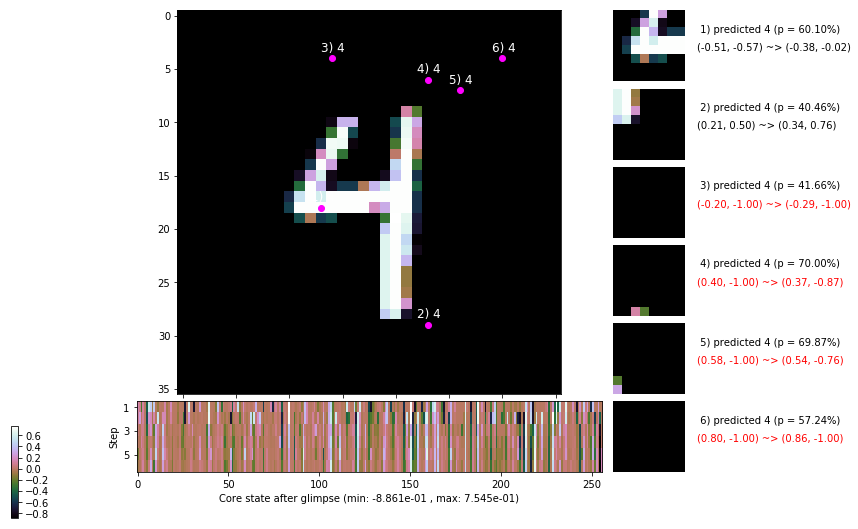

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 151.7 ms/b | lr: 7.69e-04 | grad 2norm: 16.76 | grad inf norm:  4.211
         Weights || abs max:  2.06 (10002.31) | mean: -6.76e-04 ( 0.03) | var: 4.73e-02 (20507.37)
          Biases || abs max:  1.06 (   95.00) | mean: -1.00e-01 ( 0.08) | var: 5.59e-02 (   90.53)
                    class loss: 0.396 | steps: 2.356 | reward:  3.466 | acc.: 86.97%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.7 ms/b | lr: 7.69e-04 | grad 2norm: 16.86 | grad inf norm:  4.126
         Weights || abs max:  2.04 ( 4707.17) | mean: -6.70e-04 ( 0.02) | var: 4.74e-02 ( 1926.49)
          Biases || abs max:  1.07 (  107.45) | mean: -1.00e-01 ( 0.08) | var: 5.62e-02 (  296.83)
                    class loss: 0.390 | steps: 2.355 | reward:  3.440 | acc.: 86.75%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

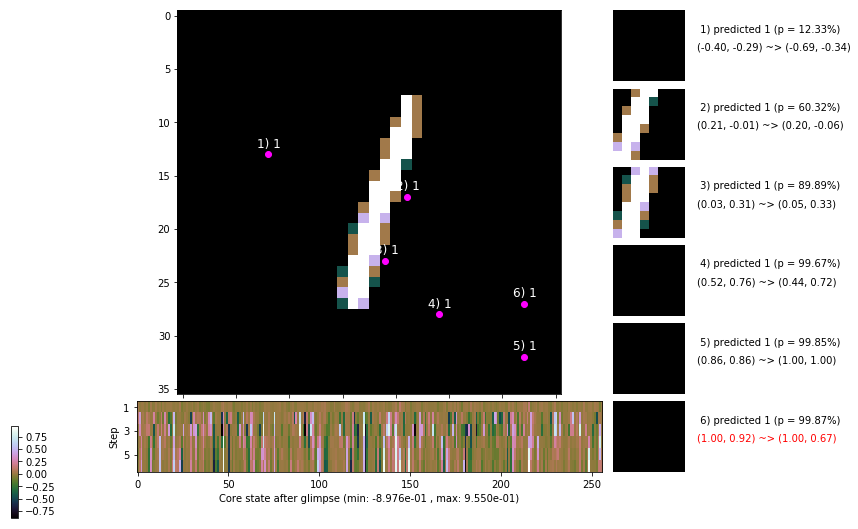

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 147.3 ms/b | lr: 7.67e-04 | grad 2norm: 16.62 | grad inf norm:  3.927
         Weights || abs max:  2.05 ( 2958.59) | mean: -6.32e-04 ( 0.01) | var: 4.76e-02 (  491.42)
          Biases || abs max:  1.07 (  131.99) | mean: -9.95e-02 ( 0.10) | var: 5.62e-02 (  502.63)
                    class loss: 0.368 | steps: 2.330 | reward:  3.509 | acc.: 87.73%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 148.4 ms/b | lr: 7.66e-04 | grad 2norm: 16.78 | grad inf norm:  4.134
         Weights || abs max:  2.07 ( 7891.61) | mean: -6.39e-04 ( 0.02) | var: 4.77e-02 (11273.70)
          Biases || abs max:  1.08 (   72.27) | mean: -9.97e-02 ( 0.08) | var: 5.63e-02 (   20.72)
                    class loss: 0.396 | steps: 2.330 | reward:  3.471 | acc.: 86.35%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

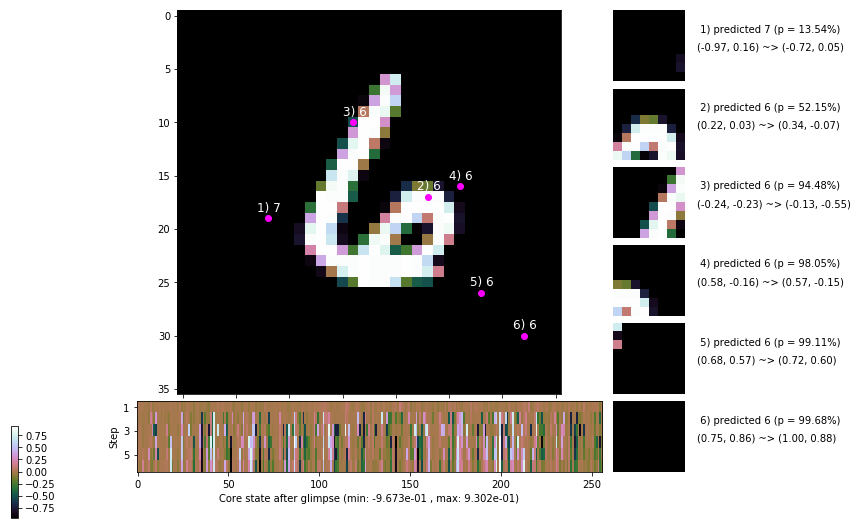

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 176.5 ms/b | lr: 7.65e-04 | grad 2norm: 16.88 | grad inf norm:  4.124
         Weights || abs max:  2.06 ( 2269.13) | mean: -6.57e-04 ( 0.01) | var: 4.78e-02 (   55.43)
          Biases || abs max:  1.08 (   58.54) | mean: -9.97e-02 ( 0.07) | var: 5.64e-02 (   12.99)
                    class loss: 0.398 | steps: 2.353 | reward:  3.459 | acc.: 86.58%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 154.5 ms/b | lr: 7.64e-04 | grad 2norm: 16.54 | grad inf norm:  4.088
         Weights || abs max:  2.06 ( 1964.48) | mean: -7.00e-04 ( 0.01) | var: 4.80e-02 (   42.69)
          Biases || abs max:  1.07 (  225.82) | mean: -1.00e-01 ( 0.14) | var: 5.66e-02 ( 1478.25)
                    class loss: 0.392 | steps: 2.324 | reward:  3.493 | acc.: 87.02%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

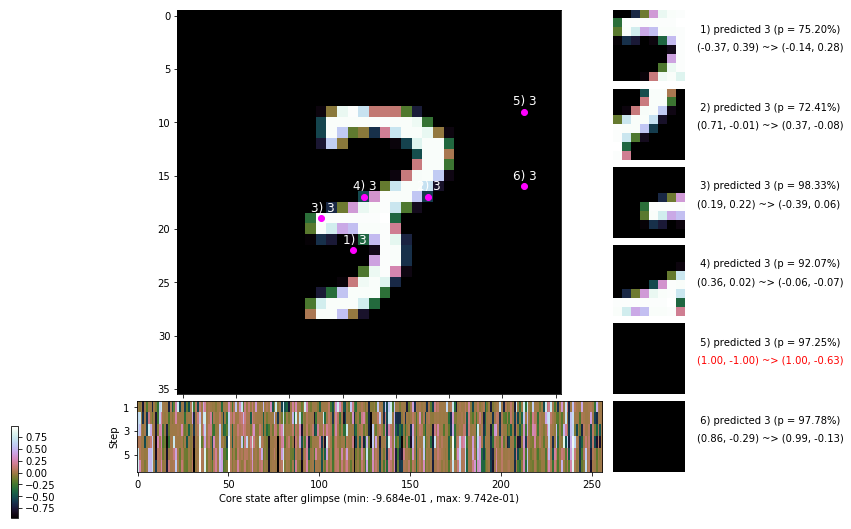

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


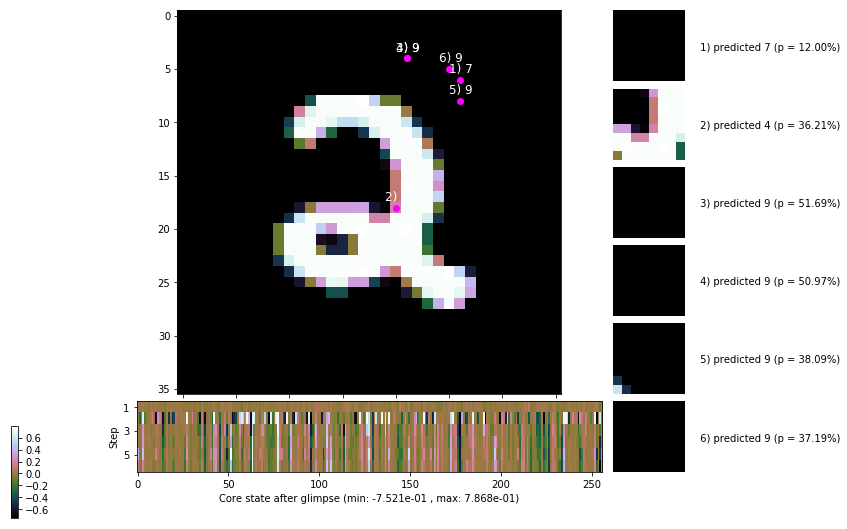


	Target class: 9 | Discounted rewards: [-0.609, -0.219, 0.562, -0.875, -0.750, -0.500]


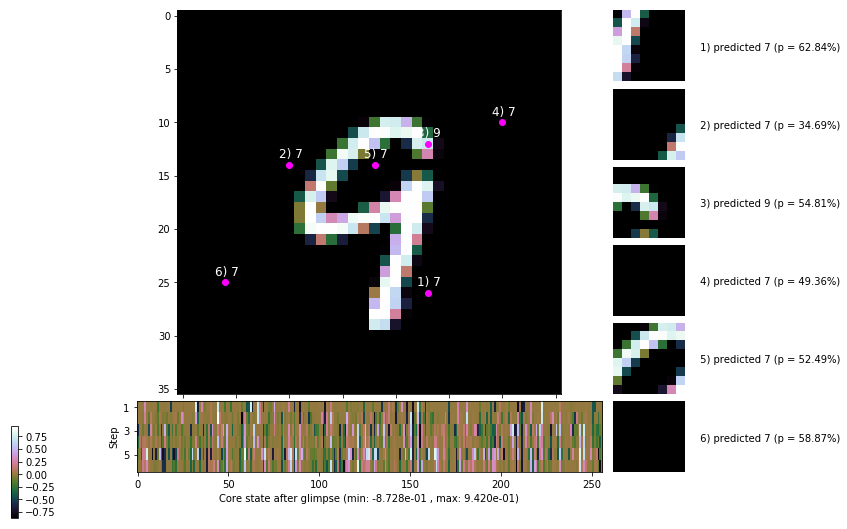

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


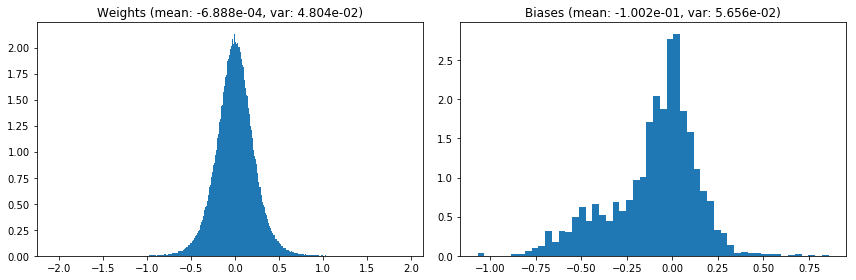

                                      Location network weights and biases


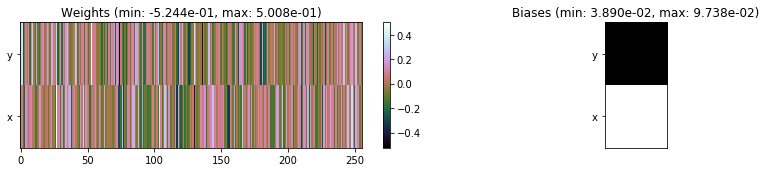

---------------------------------------------------------------------------------------------------------------
Elapsed time:  463.67 sec | TRAIN >> class loss: 0.3878 | steps:  2.346    | reward:  3.4729    | acc.: 87.023% 
                          | VAL   >> class loss: 0.3421 | steps:  2.196    | reward:  3.7356    | acc.: 88.100% :(


Epoch  19/400) lr = 0.0007633
 b    300/  3000 >> 144.7 ms/b | lr: 7.63e-04 | grad 2norm: 16.48 | grad inf norm:  4.070
         Weights || abs max:  2.06 ( 2737.25) | mean: -7.14e-04 ( 0.01) | var: 4.81e-02 (  354.58)
          Biases || abs max:  1.07 (  122.88) | mean: -1.01e-01 ( 0.09) | var: 5.68e-02 (  235.46)
                    class loss: 0.376 | steps: 2.325 | reward:  3.518 | acc.: 87.63%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.1 ms/b | lr: 7.62e-04 | grad 2norm: 16.67 | grad inf norm:  4.336
         Weights || abs max:  2.06 (16223.72) | mean: -7.35e-04 ( 0

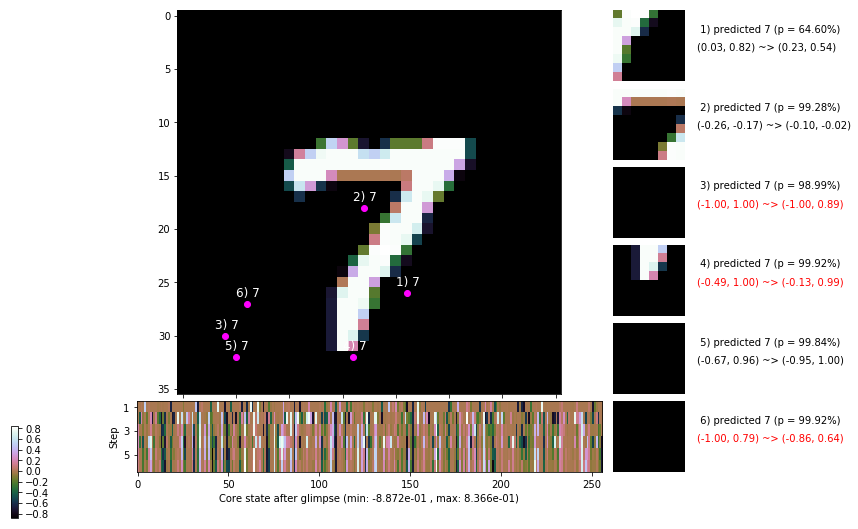

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 149.3 ms/b | lr: 7.60e-04 | grad 2norm: 16.43 | grad inf norm:  4.185
         Weights || abs max:  2.05 ( 5913.52) | mean: -7.34e-04 ( 0.02) | var: 4.84e-02 ( 4532.73)
          Biases || abs max:  1.06 (   79.47) | mean: -1.01e-01 ( 0.08) | var: 5.75e-02 (   49.56)
                    class loss: 0.392 | steps: 2.341 | reward:  3.494 | acc.: 86.97%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.3 ms/b | lr: 7.59e-04 | grad 2norm: 16.35 | grad inf norm:  4.191
         Weights || abs max:  2.04 ( 3149.84) | mean: -7.28e-04 ( 0.01) | var: 4.85e-02 (  169.94)
          Biases || abs max:  1.06 (   80.14) | mean: -1.02e-01 ( 0.08) | var: 5.77e-02 (   38.90)
                    class loss: 0.375 | steps: 2.339 | reward:  3.526 | acc.: 87.58%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

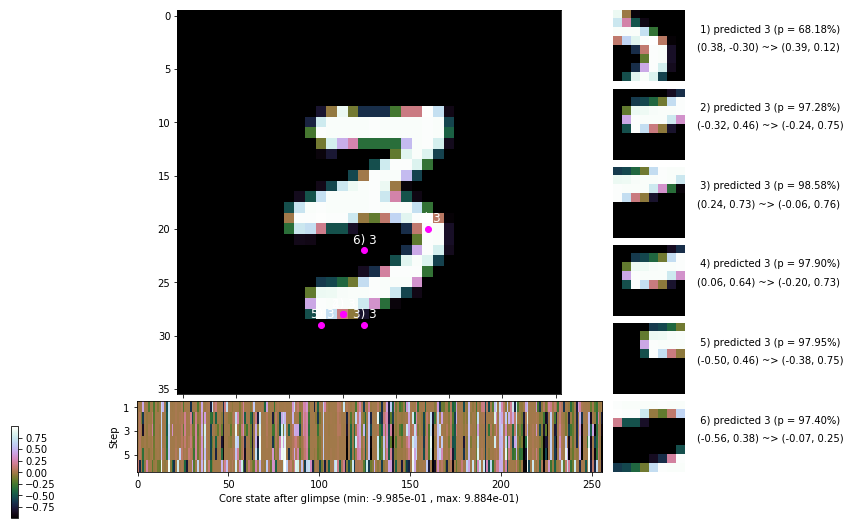

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 147.4 ms/b | lr: 7.58e-04 | grad 2norm: 16.60 | grad inf norm:  4.148
         Weights || abs max:  2.04 ( 4389.29) | mean: -7.47e-04 ( 0.02) | var: 4.86e-02 (  642.24)
          Biases || abs max:  1.07 (   88.11) | mean: -1.02e-01 ( 0.08) | var: 5.78e-02 (   58.15)
                    class loss: 0.378 | steps: 2.334 | reward:  3.511 | acc.: 87.33%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.3 ms/b | lr: 7.57e-04 | grad 2norm: 16.62 | grad inf norm:  4.224
         Weights || abs max:  2.04 (22383.65) | mean: -7.19e-04 ( 0.05) | var: 4.88e-02 (181116.16)
          Biases || abs max:  1.07 (  261.78) | mean: -1.02e-01 ( 0.15) | var: 5.80e-02 (  534.25)
                    class loss: 0.385 | steps: 2.357 | reward:  3.486 | acc.: 87.00%

	Target class: 9 | Discounted rewards: [-0.984, -0.969, 

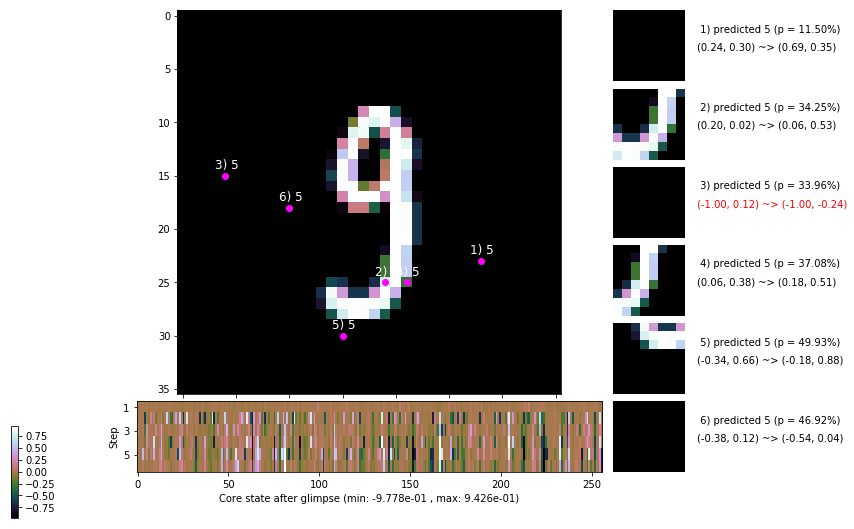

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 148.0 ms/b | lr: 7.56e-04 | grad 2norm: 16.40 | grad inf norm:  4.221
         Weights || abs max:  2.05 ( 2686.16) | mean: -7.29e-04 ( 0.01) | var: 4.89e-02 (  161.43)
          Biases || abs max:  1.09 (   86.62) | mean: -1.02e-01 ( 0.08) | var: 5.82e-02 (   91.35)
                    class loss: 0.385 | steps: 2.345 | reward:  3.515 | acc.: 87.33%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 150.1 ms/b | lr: 7.55e-04 | grad 2norm: 16.05 | grad inf norm:  4.079
         Weights || abs max:  2.05 ( 9454.99) | mean: -6.75e-04 ( 0.03) | var: 4.91e-02 (13678.41)
          Biases || abs max:  1.09 (   79.68) | mean: -1.02e-01 ( 0.08) | var: 5.84e-02 (   38.14)
                    class loss: 0.391 | steps: 2.321 | reward:  3.509 | acc.: 86.83%

	Target class: 3 | Discounted rewards: [-0.281, 0.438, 1.

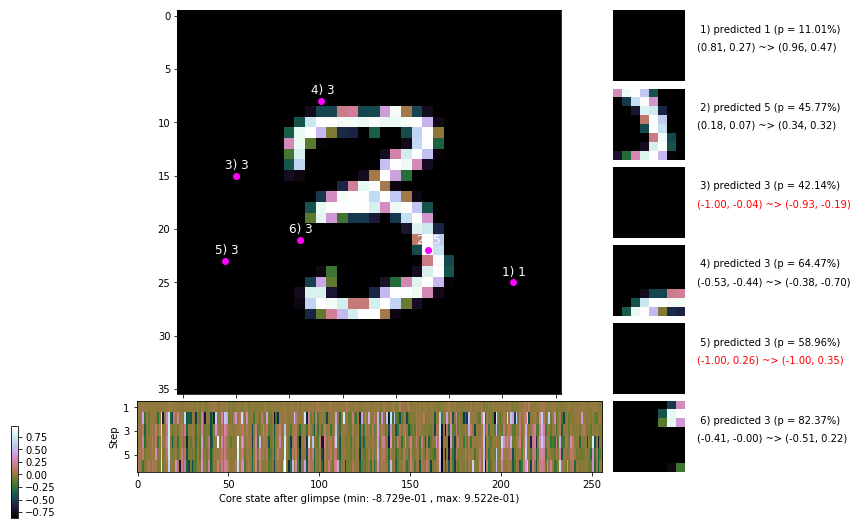

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 144.0 ms/b | lr: 7.53e-04 | grad 2norm: 16.18 | grad inf norm:  4.218
         Weights || abs max:  2.05 ( 4167.37) | mean: -6.55e-04 ( 0.02) | var: 4.92e-02 (  500.44)
          Biases || abs max:  1.07 (   75.40) | mean: -1.02e-01 ( 0.07) | var: 5.86e-02 (   54.24)
                    class loss: 0.391 | steps: 2.341 | reward:  3.515 | acc.: 87.18%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.3 ms/b | lr: 7.53e-04 | grad 2norm: 16.33 | grad inf norm:  4.105
         Weights || abs max:  2.07 ( 5711.46) | mean: -6.19e-04 ( 0.02) | var: 4.93e-02 ( 2761.80)
          Biases || abs max:  1.08 (   63.62) | mean: -1.02e-01 ( 0.06) | var: 5.88e-02 (  128.50)
                    class loss: 0.401 | steps: 2.347 | reward:  3.491 | acc.: 86.85%

	Target class: 9 | Discounted rewards: [-0.656, -0.312, 0

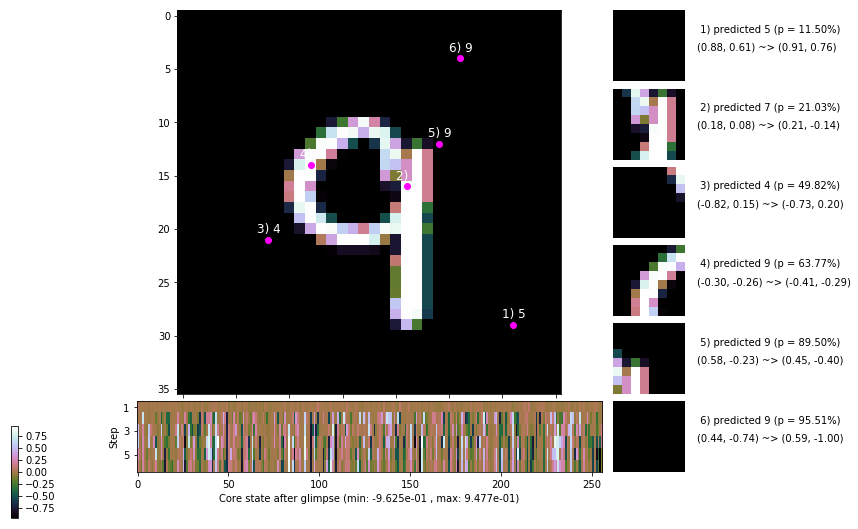

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


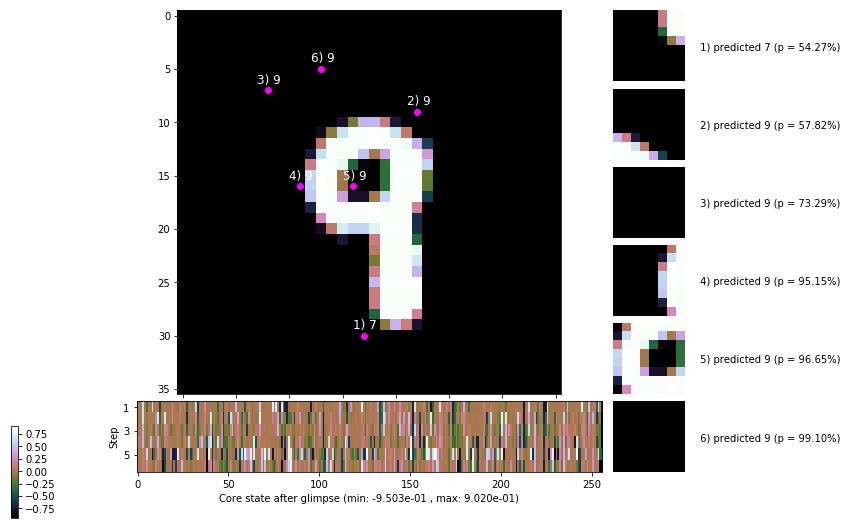


	Target class: 2 | Discounted rewards: [-0.656, -0.312, 0.375, 1.750, 1.500, 1.000]


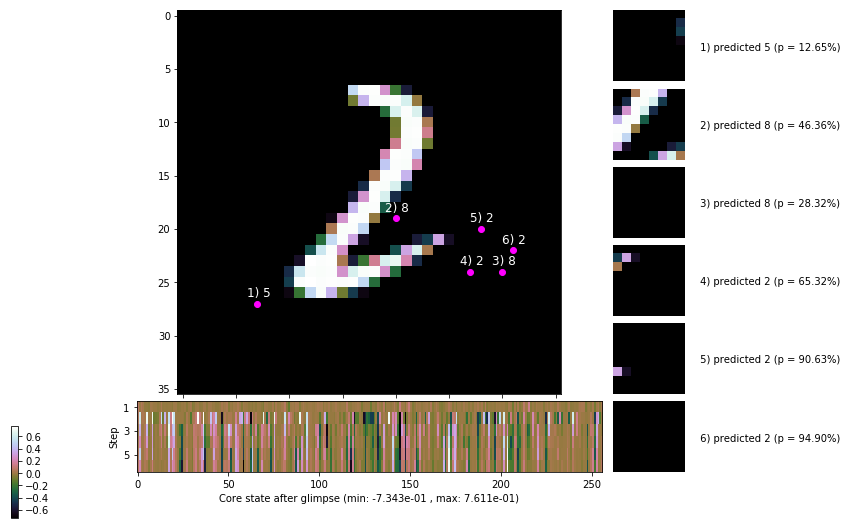

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


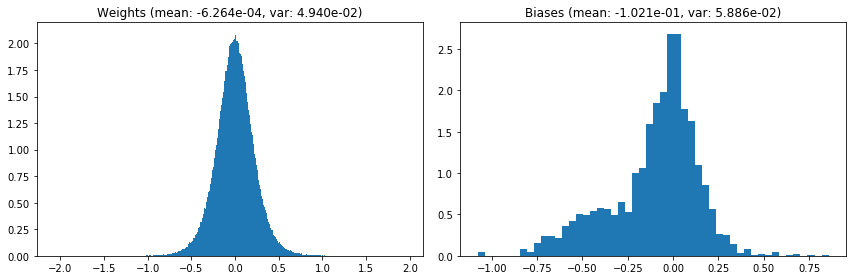

                                      Location network weights and biases


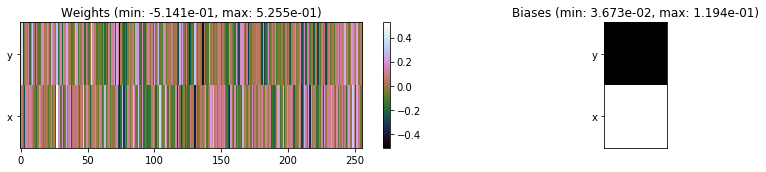

---------------------------------------------------------------------------------------------------------------
Elapsed time:  438.19 sec | TRAIN >> class loss: 0.3871 | steps:  2.338    | reward:  3.5061    | acc.: 87.168% 
                          | VAL   >> class loss: 0.3707 | steps:  2.212 :( | reward:  3.6846 :( | acc.: 87.120% :(


Epoch  20/400) lr = 0.0007519
 b    300/  3000 >> 147.9 ms/b | lr: 7.51e-04 | grad 2norm: 16.63 | grad inf norm:  4.457
         Weights || abs max:  2.08 ( 4139.96) | mean: -6.62e-04 ( 0.02) | var: 4.95e-02 ( 1147.82)
          Biases || abs max:  1.08 (  131.24) | mean: -1.03e-01 ( 0.10) | var: 5.90e-02 (  277.09)
                    class loss: 0.407 | steps: 2.362 | reward:  3.426 | acc.: 86.07%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.9 ms/b | lr: 7.50e-04 | grad 2norm: 16.33 | grad inf norm:  4.116
         Weights || abs max:  2.08 ( 8123.60) | mean: -7.01e-04 ( 0

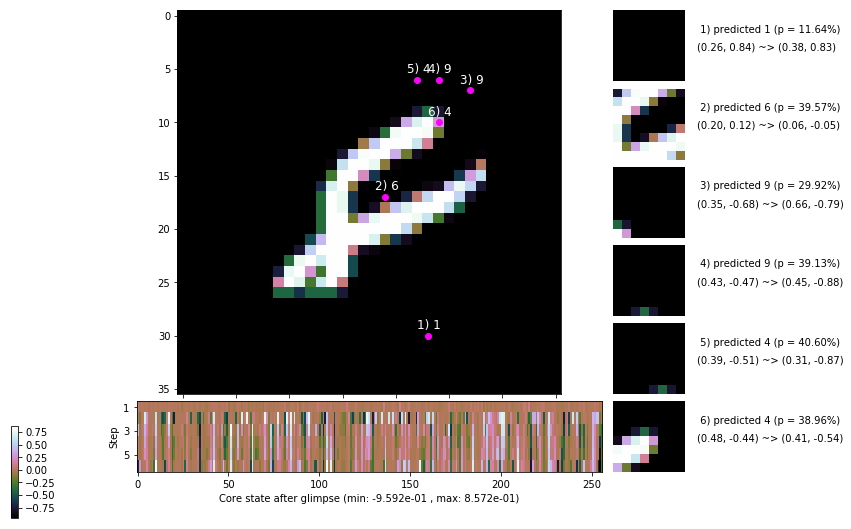

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 148.8 ms/b | lr: 7.49e-04 | grad 2norm: 16.34 | grad inf norm:  4.083
         Weights || abs max:  2.09 ( 3323.78) | mean: -7.24e-04 ( 0.01) | var: 4.97e-02 (  307.99)
          Biases || abs max:  1.10 (   46.14) | mean: -1.03e-01 ( 0.06) | var: 5.93e-02 (    9.30)
                    class loss: 0.410 | steps: 2.370 | reward:  3.431 | acc.: 86.65%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.7 ms/b | lr: 7.48e-04 | grad 2norm: 16.30 | grad inf norm:  4.172
         Weights || abs max:  2.08 (31281.13) | mean: -7.48e-04 ( 0.07) | var: 4.98e-02 (266613.75)
          Biases || abs max:  1.09 (   69.45) | mean: -1.04e-01 ( 0.08) | var: 5.95e-02 (   33.92)
                    class loss: 0.410 | steps: 2.388 | reward:  3.413 | acc.: 86.07%

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.

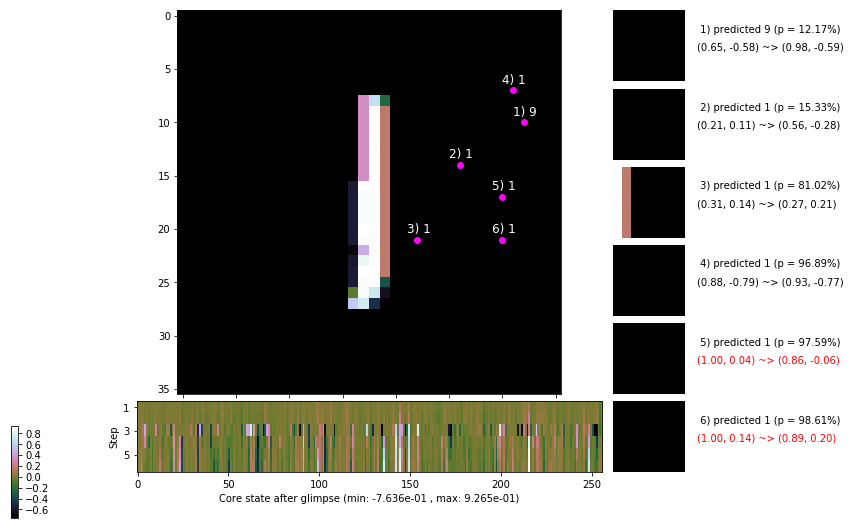

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.4 ms/b | lr: 7.47e-04 | grad 2norm: 16.65 | grad inf norm:  4.247
         Weights || abs max:  2.09 ( 3525.69) | mean: -7.56e-04 ( 0.01) | var: 5.00e-02 (  322.07)
          Biases || abs max:  1.09 (   59.32) | mean: -1.03e-01 ( 0.06) | var: 5.96e-02 (   18.34)
                    class loss: 0.391 | steps: 2.354 | reward:  3.461 | acc.: 86.65%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 146.4 ms/b | lr: 7.46e-04 | grad 2norm: 16.01 | grad inf norm:  3.909
         Weights || abs max:  2.10 ( 4715.96) | mean: -7.64e-04 ( 0.02) | var: 5.01e-02 (  445.03)
          Biases || abs max:  1.09 (   65.97) | mean: -1.03e-01 ( 0.07) | var: 5.98e-02 (   35.68)
                    class loss: 0.384 | steps: 2.339 | reward:  3.466 | acc.: 87.13%

	Target class: 8 | Discounted rewards: [0.281, 1.562, 1.1

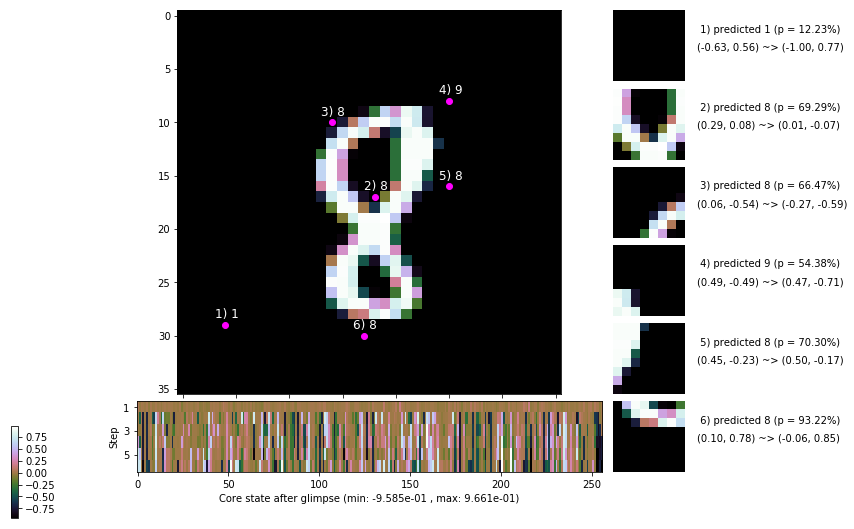

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 145.8 ms/b | lr: 7.44e-04 | grad 2norm: 16.18 | grad inf norm:  3.879
         Weights || abs max:  2.10 ( 3442.35) | mean: -6.94e-04 ( 0.02) | var: 5.03e-02 (  233.47)
          Biases || abs max:  1.10 (   66.86) | mean: -1.03e-01 ( 0.08) | var: 6.00e-02 (   25.38)
                    class loss: 0.382 | steps: 2.334 | reward:  3.463 | acc.: 87.08%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 143.4 ms/b | lr: 7.44e-04 | grad 2norm: 16.03 | grad inf norm:  3.993
         Weights || abs max:  2.10 ( 3521.95) | mean: -7.24e-04 ( 0.02) | var: 5.04e-02 (  126.78)
          Biases || abs max:  1.10 (   83.54) | mean: -1.03e-01 ( 0.08) | var: 6.05e-02 (   40.26)
                    class loss: 0.377 | steps: 2.346 | reward:  3.484 | acc.: 87.42%

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.8

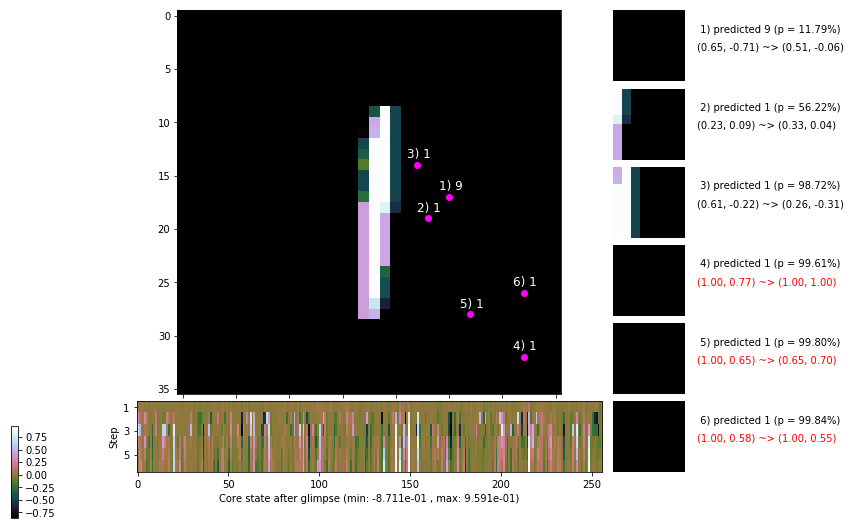

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 150.3 ms/b | lr: 7.42e-04 | grad 2norm: 16.48 | grad inf norm:  4.151
         Weights || abs max:  2.10 ( 9227.24) | mean: -7.13e-04 ( 0.03) | var: 5.05e-02 (10854.81)
          Biases || abs max:  1.10 (   49.64) | mean: -1.03e-01 ( 0.06) | var: 6.06e-02 (    6.99)
                    class loss: 0.386 | steps: 2.342 | reward:  3.492 | acc.: 87.38%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.4 ms/b | lr: 7.41e-04 | grad 2norm: 16.43 | grad inf norm:  3.981
         Weights || abs max:  2.09 ( 3344.61) | mean: -7.08e-04 ( 0.01) | var: 5.07e-02 (  182.03)
          Biases || abs max:  1.12 (   79.02) | mean: -1.04e-01 ( 0.08) | var: 6.10e-02 (  107.57)
                    class loss: 0.380 | steps: 2.331 | reward:  3.490 | acc.: 87.05%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

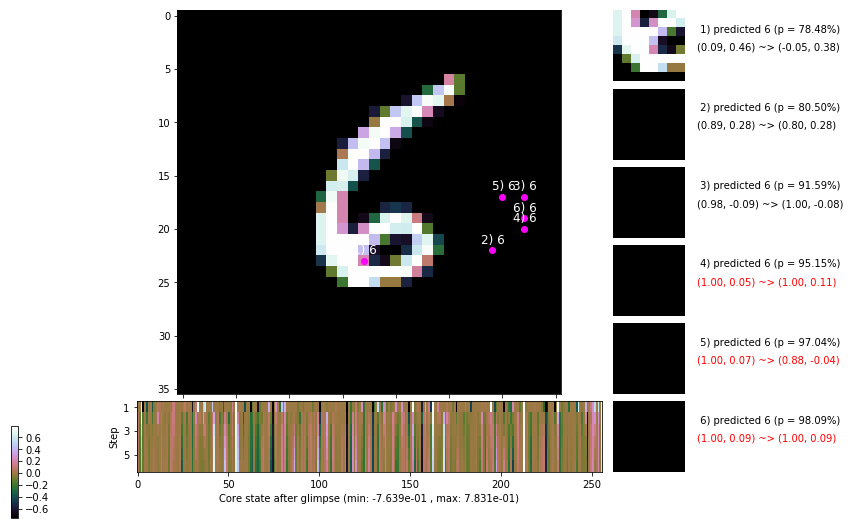

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


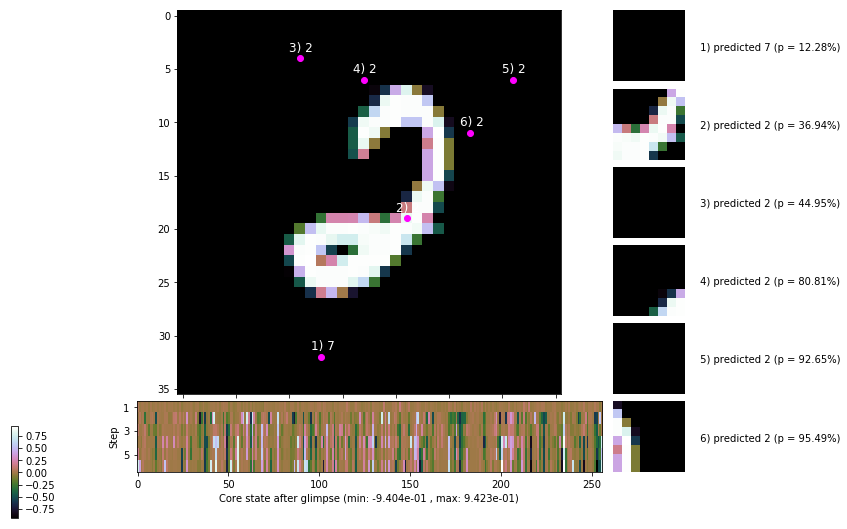


	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


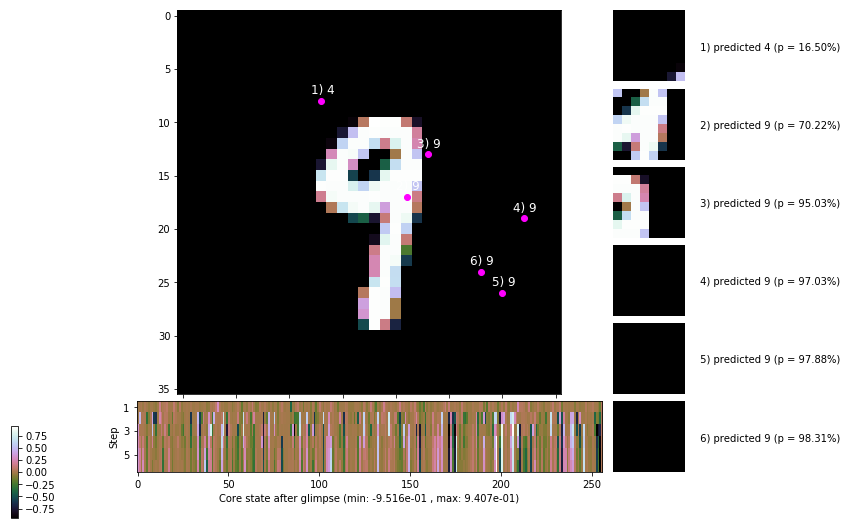

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


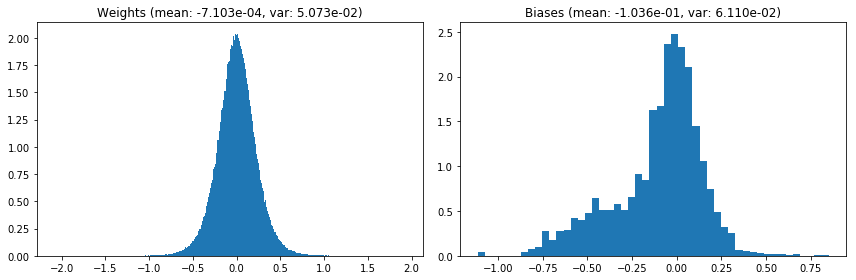

                                      Location network weights and biases


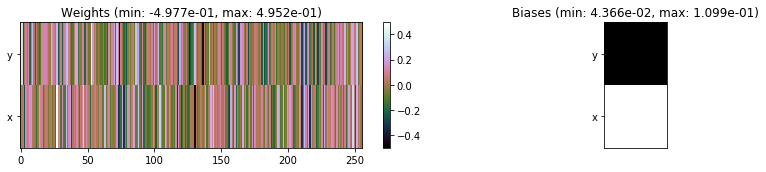

---------------------------------------------------------------------------------------------------------------
Elapsed time:  436.86 sec | TRAIN >> class loss: 0.3922 | steps:  2.351 :( | reward:  3.4586 :( | acc.: 86.810% :(
                          | VAL   >> class loss: 0.3613 | steps:  2.178    | reward:  3.7497    | acc.: 87.880% :(


Epoch  21/400) lr = 0.0007407
 b    300/  3000 >> 142.3 ms/b | lr: 7.40e-04 | grad 2norm: 16.73 | grad inf norm:  4.204
         Weights || abs max:  2.09 ( 1845.55) | mean: -7.16e-04 ( 0.01) | var: 5.08e-02 (   41.76)
          Biases || abs max:  1.13 (  135.21) | mean: -1.04e-01 ( 0.12) | var: 6.12e-02 (  635.47)
                    class loss: 0.384 | steps: 2.356 | reward:  3.474 | acc.: 87.08%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 146.9 ms/b | lr: 7.39e-04 | grad 2norm: 16.29 | grad inf norm:  4.176
         Weights || abs max:  2.09 ( 2331.66) | mean: -7.09e-04 (

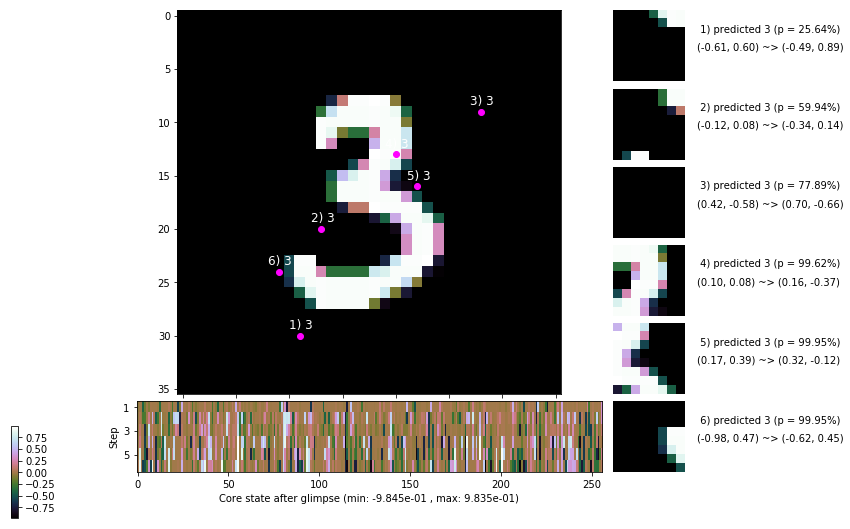

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 140.6 ms/b | lr: 7.38e-04 | grad 2norm: 16.44 | grad inf norm:  4.265
         Weights || abs max:  2.09 ( 4932.62) | mean: -6.98e-04 ( 0.02) | var: 5.11e-02 ( 1478.41)
          Biases || abs max:  1.13 (   27.03) | mean: -1.04e-01 ( 0.04) | var: 6.15e-02 (    2.37)
                    class loss: 0.374 | steps: 2.335 | reward:  3.506 | acc.: 87.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 147.1 ms/b | lr: 7.37e-04 | grad 2norm: 16.50 | grad inf norm:  4.298
         Weights || abs max:  2.09 (30765.45) | mean: -7.16e-04 ( 0.06) | var: 5.12e-02 (406378.03)
          Biases || abs max:  1.13 (  133.20) | mean: -1.05e-01 ( 0.09) | var: 6.15e-02 (  640.85)
                    class loss: 0.363 | steps: 2.315 | reward:  3.554 | acc.: 88.27%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.

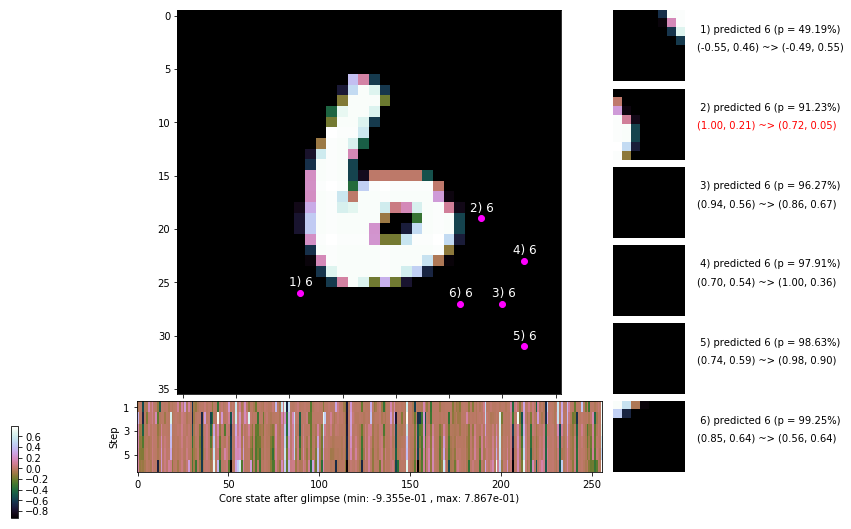

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.2 ms/b | lr: 7.36e-04 | grad 2norm: 16.08 | grad inf norm:  3.977
         Weights || abs max:  2.09 ( 3175.83) | mean: -7.35e-04 ( 0.02) | var: 5.13e-02 (  243.58)
          Biases || abs max:  1.14 (   98.37) | mean: -1.05e-01 ( 0.08) | var: 6.17e-02 (  149.79)
                    class loss: 0.356 | steps: 2.299 | reward:  3.574 | acc.: 88.03%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.6 ms/b | lr: 7.35e-04 | grad 2norm: 15.93 | grad inf norm:  3.982
         Weights || abs max:  2.09 ( 6191.80) | mean: -7.36e-04 ( 0.02) | var: 5.15e-02 ( 6140.41)
          Biases || abs max:  1.14 (   76.13) | mean: -1.05e-01 ( 0.08) | var: 6.19e-02 (   76.96)
                    class loss: 0.363 | steps: 2.298 | reward:  3.583 | acc.: 87.45%

	Target class: 9 | Discounted rewards: [-0.469, 0.062, 1.

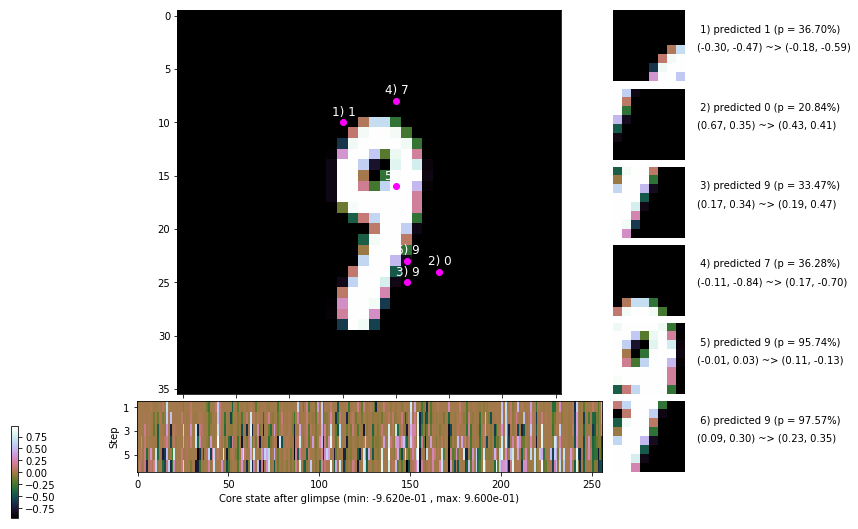

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 149.6 ms/b | lr: 7.33e-04 | grad 2norm: 16.15 | grad inf norm:  4.076
         Weights || abs max:  2.09 (14200.37) | mean: -7.31e-04 ( 0.03) | var: 5.16e-02 (33172.45)
          Biases || abs max:  1.14 (  368.72) | mean: -1.05e-01 ( 0.19) | var: 6.21e-02 ( 8951.61)
                    class loss: 0.382 | steps: 2.312 | reward:  3.529 | acc.: 87.25%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 143.7 ms/b | lr: 7.33e-04 | grad 2norm: 16.01 | grad inf norm:  4.147
         Weights || abs max:  2.09 (87776.77) | mean: -7.63e-04 ( 0.17) | var: 5.17e-02 (3918621.00)
          Biases || abs max:  1.12 (   51.12) | mean: -1.06e-01 ( 0.06) | var: 6.24e-02 (   18.82)
                    class loss: 0.386 | steps: 2.364 | reward:  3.457 | acc.: 87.20%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1

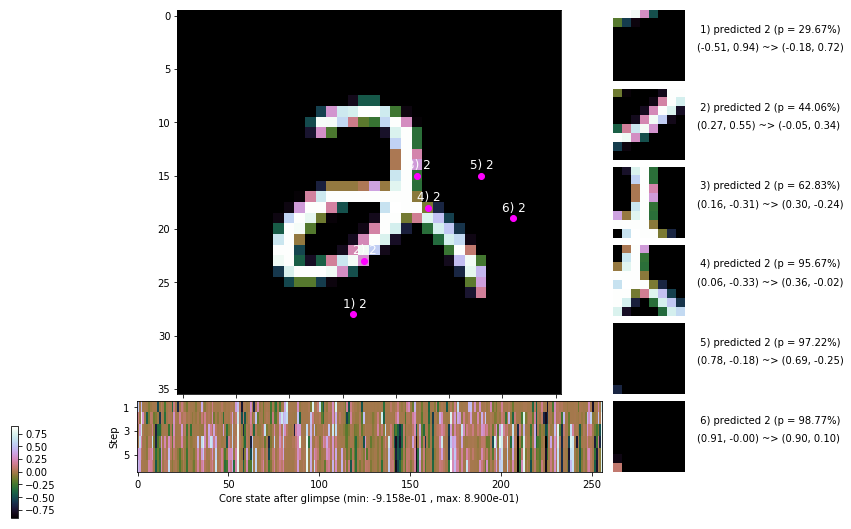

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 140.6 ms/b | lr: 7.31e-04 | grad 2norm: 16.28 | grad inf norm:  4.249
         Weights || abs max:  2.09 ( 2441.77) | mean: -7.65e-04 ( 0.01) | var: 5.18e-02 (   81.79)
          Biases || abs max:  1.12 (   30.68) | mean: -1.07e-01 ( 0.05) | var: 6.27e-02 (    2.12)
                    class loss: 0.381 | steps: 2.350 | reward:  3.501 | acc.: 87.33%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.6 ms/b | lr: 7.30e-04 | grad 2norm: 16.39 | grad inf norm:  4.173
         Weights || abs max:  2.08 ( 5787.79) | mean: -7.72e-04 ( 0.02) | var: 5.20e-02 ( 2609.69)
          Biases || abs max:  1.12 (   95.54) | mean: -1.07e-01 ( 0.08) | var: 6.28e-02 (   66.80)
                    class loss: 0.395 | steps: 2.360 | reward:  3.459 | acc.: 86.52%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

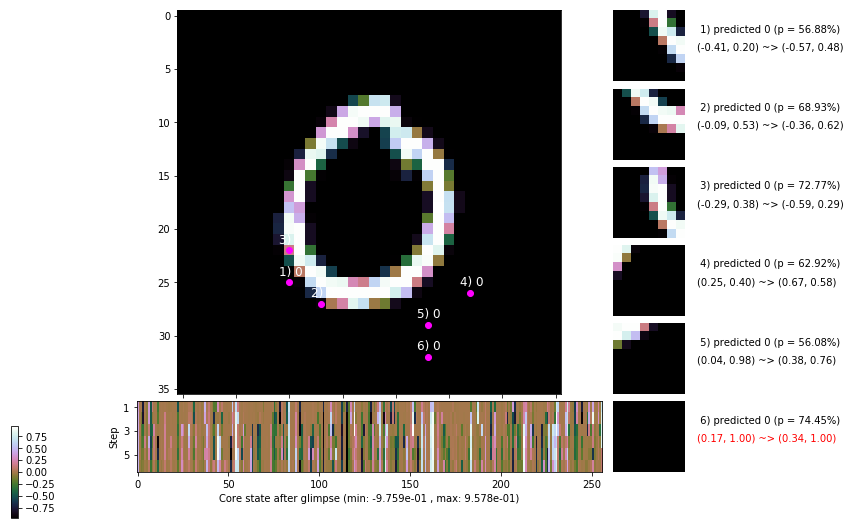

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


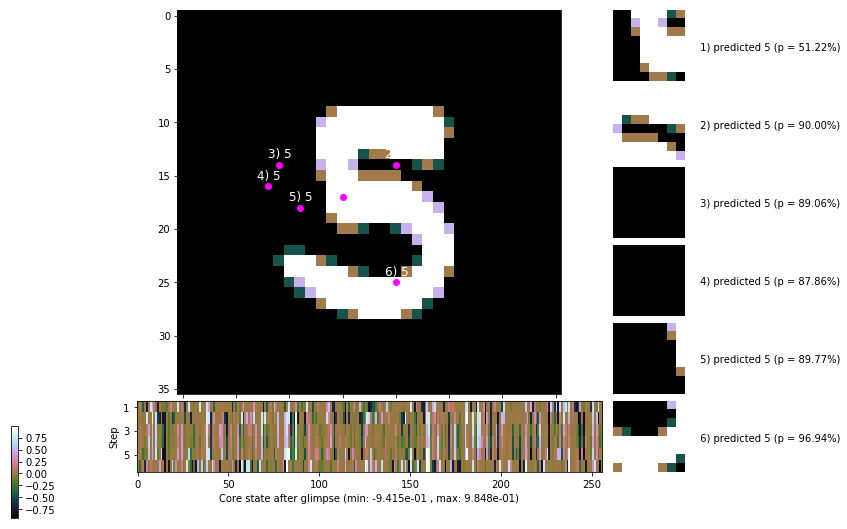


	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


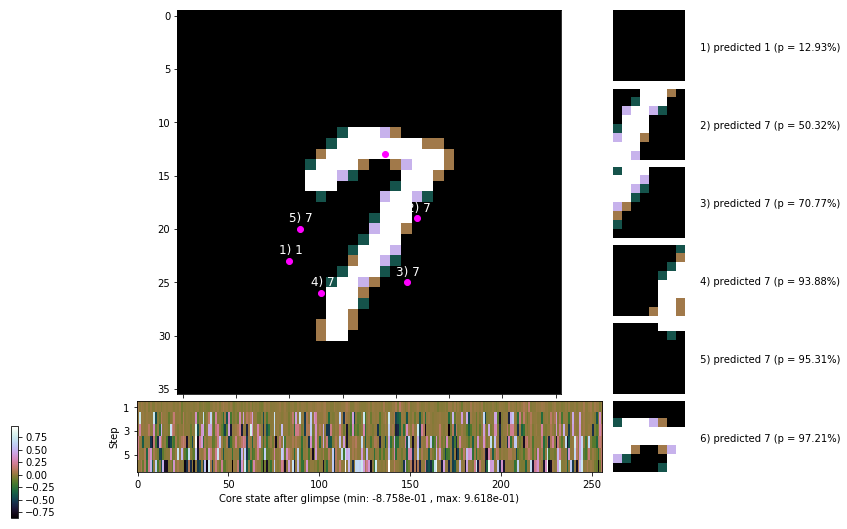

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


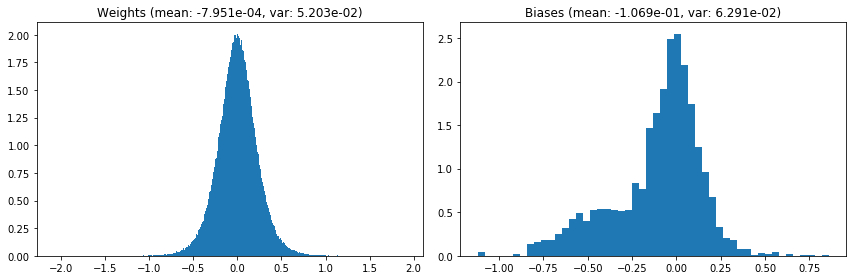

                                      Location network weights and biases


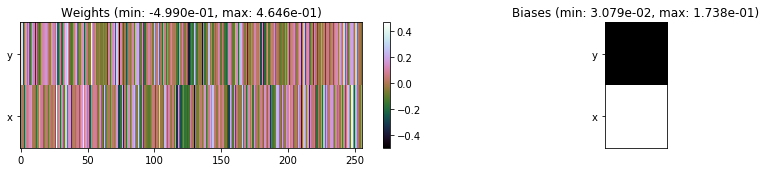

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.84 sec | TRAIN >> class loss: 0.3749 | steps:  2.329    | reward:  3.5204    | acc.: 87.502% 
                          | VAL   >> class loss: 0.3768 | steps:  2.225 :( | reward:  3.6708 :( | acc.: 87.100% :(


Epoch  22/400) lr = 0.0007297
 b    300/  3000 >> 142.6 ms/b | lr: 7.29e-04 | grad 2norm: 16.08 | grad inf norm:  4.240
         Weights || abs max:  2.08 ( 3171.64) | mean: -7.66e-04 ( 0.02) | var: 5.21e-02 (  222.93)
          Biases || abs max:  1.13 (   96.92) | mean: -1.06e-01 ( 0.08) | var: 6.30e-02 (  167.59)
                    class loss: 0.384 | steps: 2.320 | reward:  3.523 | acc.: 87.15%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 148.9 ms/b | lr: 7.28e-04 | grad 2norm: 15.85 | grad inf norm:  4.106
         Weights || abs max:  2.08 (11103.26) | mean: -7.36e-04 ( 0

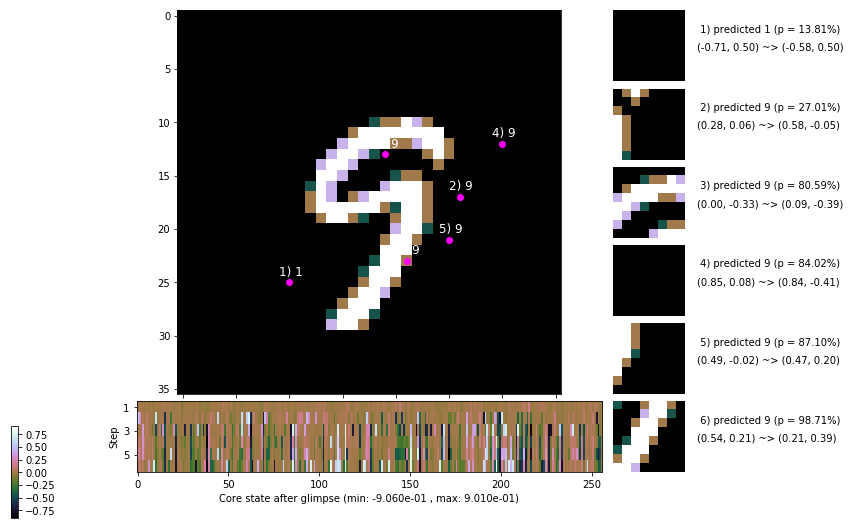

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.4 ms/b | lr: 7.27e-04 | grad 2norm: 16.28 | grad inf norm:  4.266
         Weights || abs max:  2.07 ( 2123.64) | mean: -7.13e-04 ( 0.01) | var: 5.24e-02 (   72.54)
          Biases || abs max:  1.14 (   55.26) | mean: -1.07e-01 ( 0.07) | var: 6.34e-02 (    5.14)
                    class loss: 0.414 | steps: 2.373 | reward:  3.418 | acc.: 86.35%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.6 ms/b | lr: 7.26e-04 | grad 2norm: 16.08 | grad inf norm:  4.113
         Weights || abs max:  2.08 ( 1875.02) | mean: -6.88e-04 ( 0.01) | var: 5.25e-02 (   67.13)
          Biases || abs max:  1.13 (   67.31) | mean: -1.07e-01 ( 0.07) | var: 6.33e-02 (   12.25)
                    class loss: 0.389 | steps: 2.364 | reward:  3.467 | acc.: 86.60%

	Target class: 3 | Discounted rewards: [-0.281, 0.438, 1.

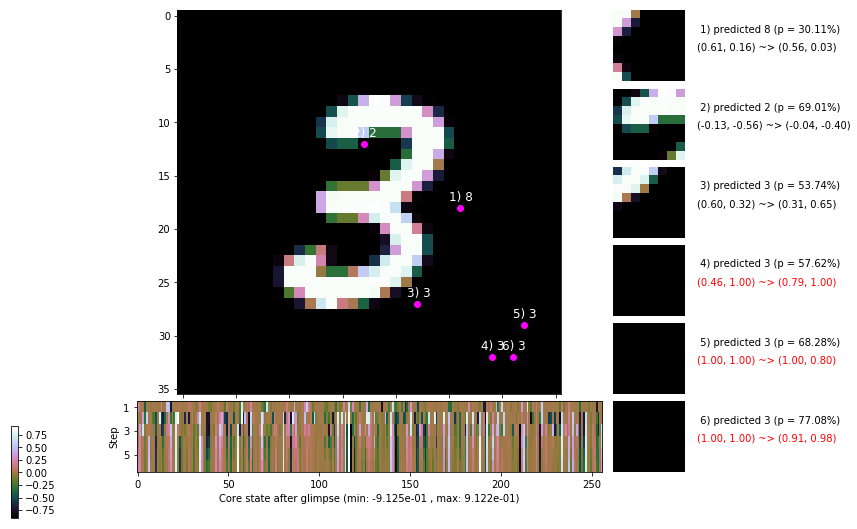

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 147.3 ms/b | lr: 7.25e-04 | grad 2norm: 15.86 | grad inf norm:  4.134
         Weights || abs max:  2.08 ( 6915.54) | mean: -7.07e-04 ( 0.02) | var: 5.26e-02 ( 5180.45)
          Biases || abs max:  1.13 (   80.20) | mean: -1.07e-01 ( 0.08) | var: 6.36e-02 (   21.72)
                    class loss: 0.360 | steps: 2.320 | reward:  3.562 | acc.: 88.00%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.3 ms/b | lr: 7.24e-04 | grad 2norm: 15.85 | grad inf norm:  4.097
         Weights || abs max:  2.09 ( 2926.41) | mean: -7.21e-04 ( 0.01) | var: 5.28e-02 (  199.62)
          Biases || abs max:  1.13 (  201.36) | mean: -1.07e-01 ( 0.16) | var: 6.37e-02 (  765.59)
                    class loss: 0.374 | steps: 2.337 | reward:  3.541 | acc.: 87.52%

	Target class: 9 | Discounted rewards: [-0.938, -0.875, -

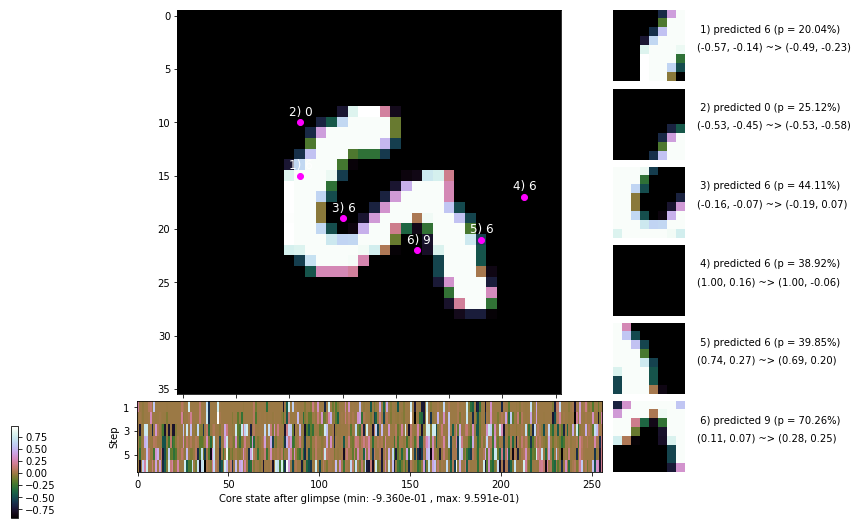

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.9 ms/b | lr: 7.22e-04 | grad 2norm: 16.23 | grad inf norm:  4.130
         Weights || abs max:  2.11 ( 2672.84) | mean: -7.19e-04 ( 0.01) | var: 5.29e-02 (  172.08)
          Biases || abs max:  1.14 (  256.41) | mean: -1.07e-01 ( 0.15) | var: 6.38e-02 ( 3164.61)
                    class loss: 0.371 | steps: 2.311 | reward:  3.556 | acc.: 87.65%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 146.3 ms/b | lr: 7.22e-04 | grad 2norm: 16.03 | grad inf norm:  3.981
         Weights || abs max:  2.12 ( 3004.25) | mean: -6.87e-04 ( 0.01) | var: 5.30e-02 (  408.86)
          Biases || abs max:  1.15 (  285.23) | mean: -1.07e-01 ( 0.17) | var: 6.39e-02 ( 3501.58)
                    class loss: 0.359 | steps: 2.322 | reward:  3.546 | acc.: 87.65%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

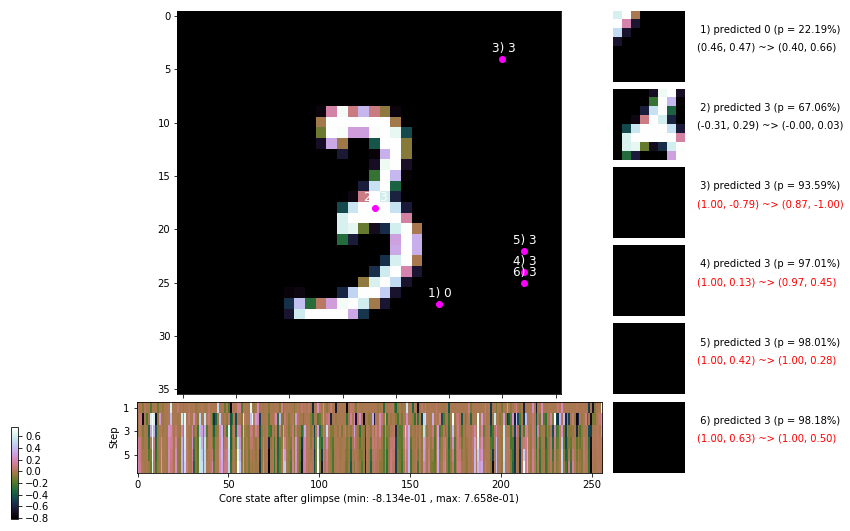

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 146.9 ms/b | lr: 7.20e-04 | grad 2norm: 16.09 | grad inf norm:  4.084
         Weights || abs max:  2.12 ( 3941.84) | mean: -7.07e-04 ( 0.02) | var: 5.32e-02 (  834.25)
          Biases || abs max:  1.14 (  194.07) | mean: -1.07e-01 ( 0.12) | var: 6.42e-02 ( 1910.60)
                    class loss: 0.381 | steps: 2.359 | reward:  3.493 | acc.: 87.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 165.9 ms/b | lr: 7.20e-04 | grad 2norm: 15.64 | grad inf norm:  3.970
         Weights || abs max:  2.13 ( 2298.13) | mean: -7.10e-04 ( 0.01) | var: 5.33e-02 (   98.20)
          Biases || abs max:  1.14 (  114.64) | mean: -1.07e-01 ( 0.11) | var: 6.42e-02 (  373.55)
                    class loss: 0.345 | steps: 2.311 | reward:  3.604 | acc.: 88.60%

	Target class: 4 | Discounted rewards: [-0.281, 0.438, 1.

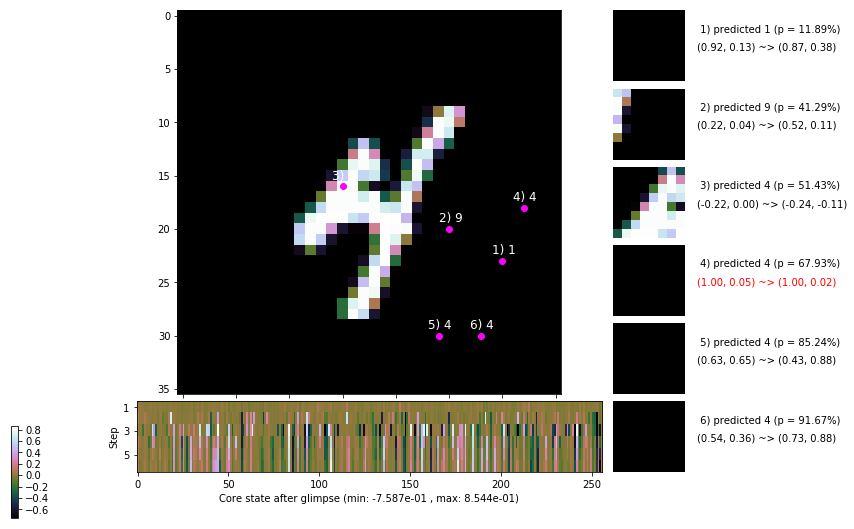

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


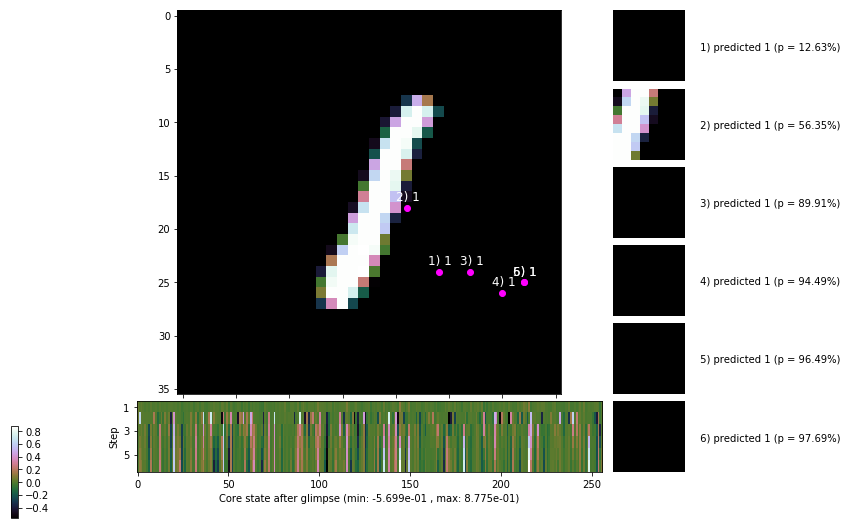


	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


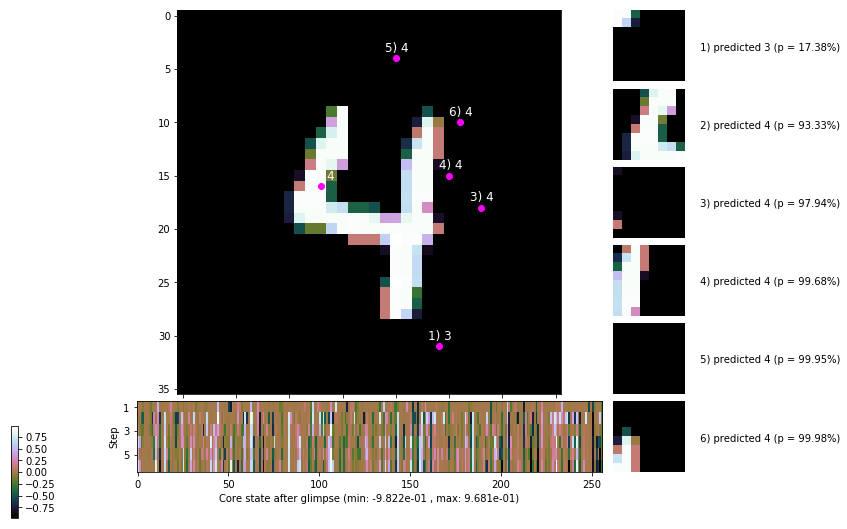

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


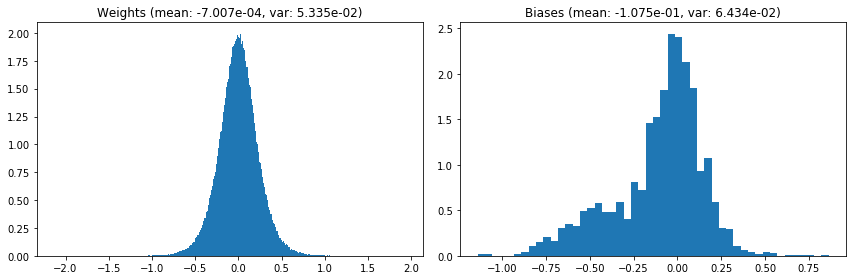

                                      Location network weights and biases


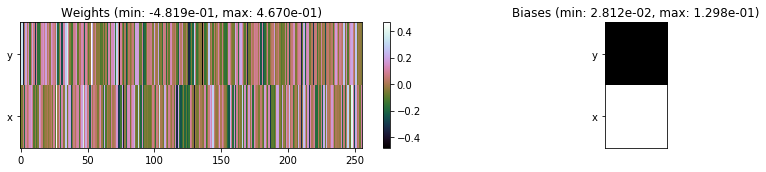

---------------------------------------------------------------------------------------------------------------
Elapsed time:  444.30 sec | TRAIN >> class loss: 0.3772 | steps:  2.336 :( | reward:  3.5206    | acc.: 87.395% :(
                          | VAL   >> class loss: 0.3472 | steps:  2.209 :( | reward:  3.7653    | acc.: 88.620% 


Epoch  23/400) lr = 0.0007188
 b    300/  3000 >> 167.3 ms/b | lr: 7.18e-04 | grad 2norm: 15.95 | grad inf norm:  4.110
         Weights || abs max:  2.13 ( 3674.34) | mean: -6.97e-04 ( 0.02) | var: 5.34e-02 (  402.98)
          Biases || abs max:  1.14 (   55.48) | mean: -1.08e-01 ( 0.06) | var: 6.45e-02 (   24.14)
                    class loss: 0.372 | steps: 2.313 | reward:  3.584 | acc.: 88.08%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 168.1 ms/b | lr: 7.17e-04 | grad 2norm: 15.93 | grad inf norm:  3.976
         Weights || abs max:  2.12 ( 3269.73) | mean: -7.47e-04 ( 0

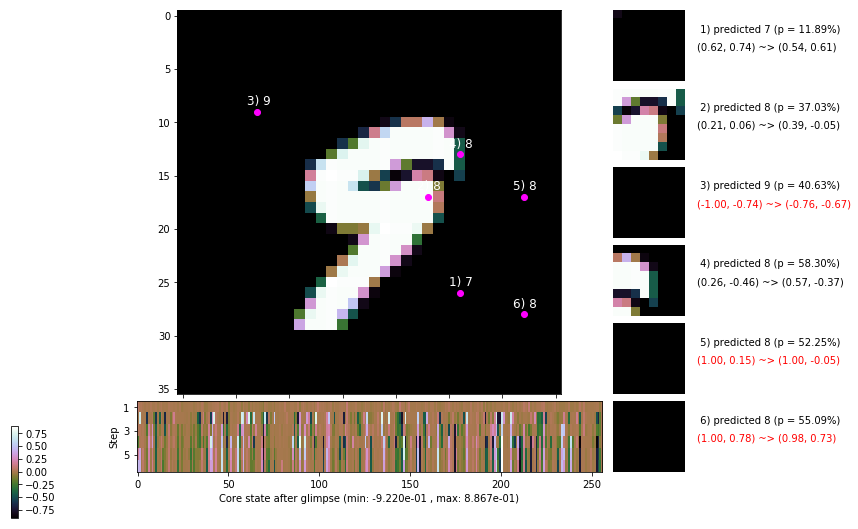

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 173.4 ms/b | lr: 7.16e-04 | grad 2norm: 15.99 | grad inf norm:  4.129
         Weights || abs max:  2.10 (10759.58) | mean: -7.79e-04 ( 0.03) | var: 5.36e-02 (17034.75)
          Biases || abs max:  1.15 (   89.04) | mean: -1.08e-01 ( 0.07) | var: 6.50e-02 (  132.33)
                    class loss: 0.358 | steps: 2.313 | reward:  3.564 | acc.: 87.97%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 171.3 ms/b | lr: 7.15e-04 | grad 2norm: 16.12 | grad inf norm:  4.178
         Weights || abs max:  2.11 ( 2437.03) | mean: -8.12e-04 ( 0.01) | var: 5.37e-02 (   79.58)
          Biases || abs max:  1.15 (   60.83) | mean: -1.09e-01 ( 0.07) | var: 6.53e-02 (   25.73)
                    class loss: 0.380 | steps: 2.351 | reward:  3.505 | acc.: 87.32%

	Target class: 6 | Discounted rewards: [-0.656, -0.312, 0

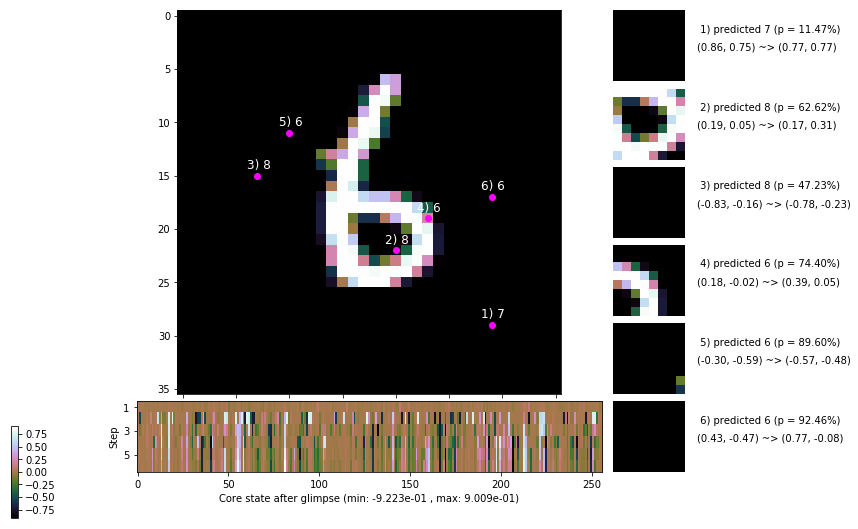

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 173.7 ms/b | lr: 7.14e-04 | grad 2norm: 15.81 | grad inf norm:  4.122
         Weights || abs max:  2.12 ( 3164.40) | mean: -8.11e-04 ( 0.01) | var: 5.39e-02 (  233.84)
          Biases || abs max:  1.15 (   61.88) | mean: -1.09e-01 ( 0.07) | var: 6.54e-02 (   28.42)
                    class loss: 0.353 | steps: 2.320 | reward:  3.575 | acc.: 88.70%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 168.1 ms/b | lr: 7.13e-04 | grad 2norm: 15.92 | grad inf norm:  4.095
         Weights || abs max:  2.12 ( 3936.45) | mean: -8.09e-04 ( 0.02) | var: 5.40e-02 (  623.76)
          Biases || abs max:  1.17 (   73.46) | mean: -1.09e-01 ( 0.07) | var: 6.57e-02 (   24.51)
                    class loss: 0.368 | steps: 2.313 | reward:  3.564 | acc.: 87.83%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

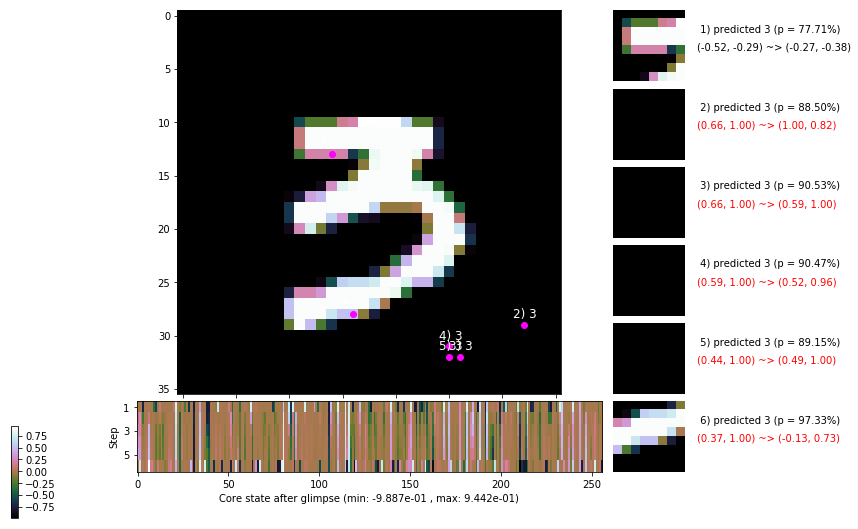

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 173.4 ms/b | lr: 7.12e-04 | grad 2norm: 16.12 | grad inf norm:  4.274
         Weights || abs max:  2.12 ( 3969.61) | mean: -8.06e-04 ( 0.02) | var: 5.41e-02 (  792.41)
          Biases || abs max:  1.17 (   73.54) | mean: -1.10e-01 ( 0.07) | var: 6.58e-02 (   30.95)
                    class loss: 0.361 | steps: 2.329 | reward:  3.562 | acc.: 88.10%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 164.8 ms/b | lr: 7.11e-04 | grad 2norm: 15.97 | grad inf norm:  4.085
         Weights || abs max:  2.12 ( 3700.27) | mean: -8.04e-04 ( 0.01) | var: 5.43e-02 (  367.93)
          Biases || abs max:  1.17 (   47.41) | mean: -1.09e-01 ( 0.06) | var: 6.58e-02 (   10.16)
                    class loss: 0.369 | steps: 2.335 | reward:  3.562 | acc.: 88.43%

	Target class: 8 | Discounted rewards: [-0.984, -0.969, -

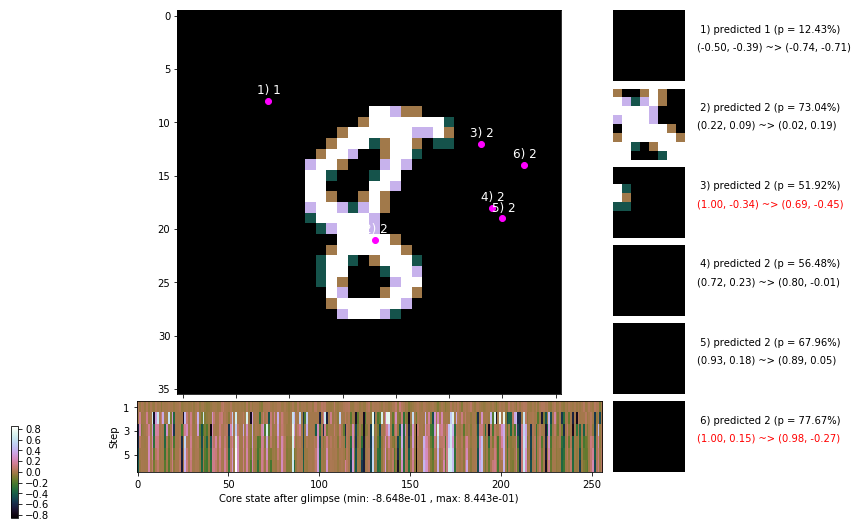

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 170.1 ms/b | lr: 7.10e-04 | grad 2norm: 15.71 | grad inf norm:  4.013
         Weights || abs max:  2.13 ( 3114.96) | mean: -8.01e-04 ( 0.01) | var: 5.44e-02 (  379.41)
          Biases || abs max:  1.17 (   58.50) | mean: -1.10e-01 ( 0.06) | var: 6.60e-02 (   11.23)
                    class loss: 0.345 | steps: 2.303 | reward:  3.608 | acc.: 88.78%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 170.3 ms/b | lr: 7.09e-04 | grad 2norm: 15.66 | grad inf norm:  4.072
         Weights || abs max:  2.12 ( 5964.88) | mean: -7.80e-04 ( 0.02) | var: 5.45e-02 ( 2419.52)
          Biases || abs max:  1.18 (   49.02) | mean: -1.10e-01 ( 0.06) | var: 6.61e-02 (    8.45)
                    class loss: 0.337 | steps: 2.263 | reward:  3.636 | acc.: 88.58%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

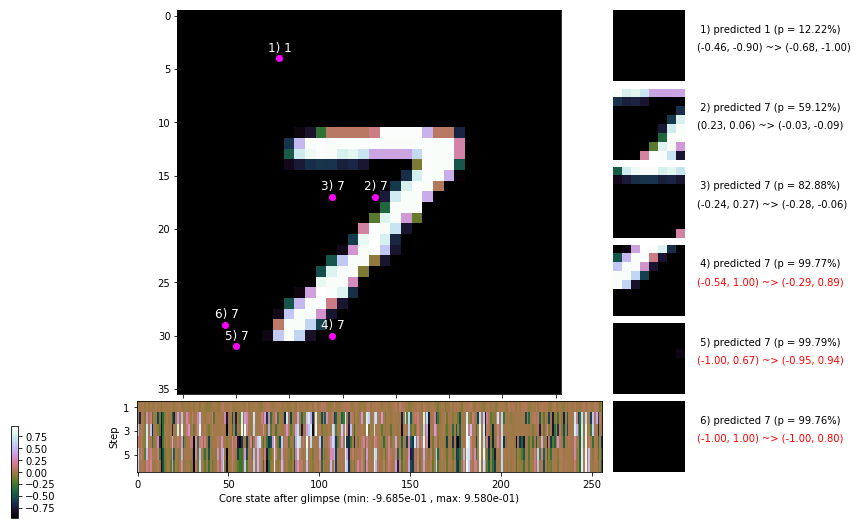

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


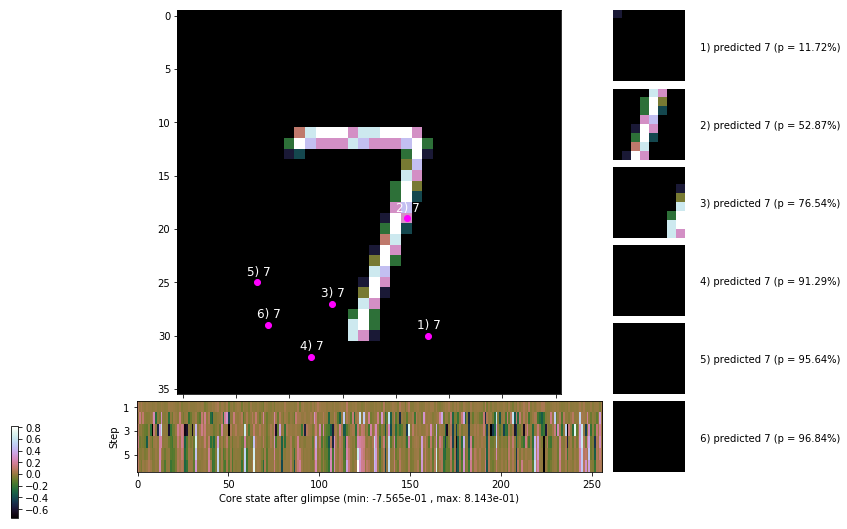


	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


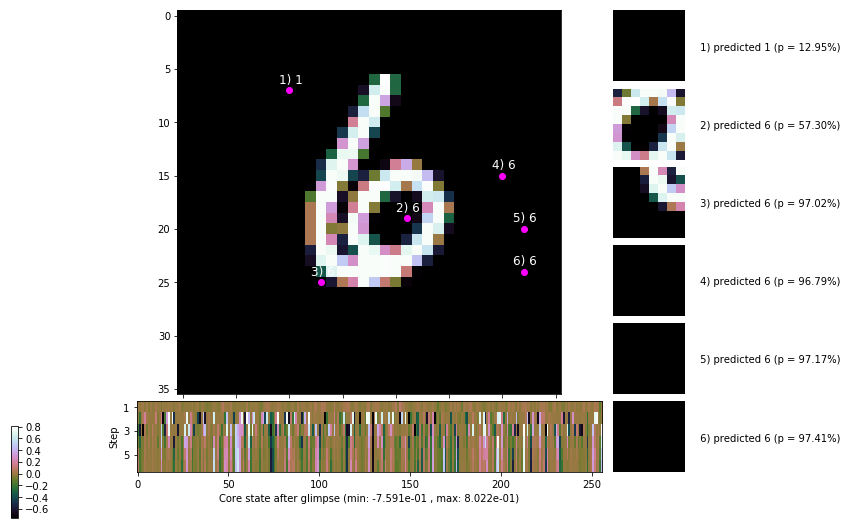

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


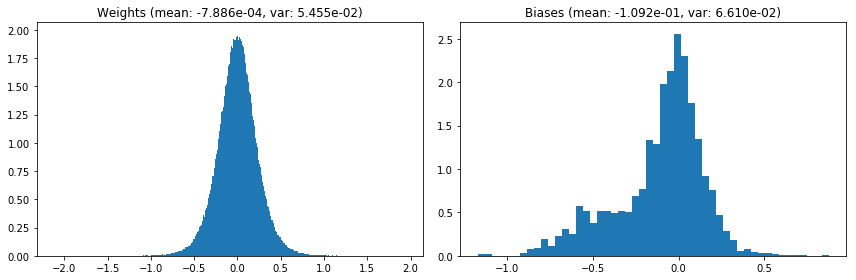

                                      Location network weights and biases


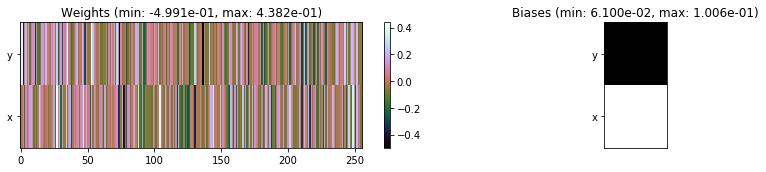

---------------------------------------------------------------------------------------------------------------
Elapsed time:  511.04 sec | TRAIN >> class loss: 0.3596 | steps:  2.314    | reward:  3.5750    | acc.: 88.187% 
                          | VAL   >> class loss: 0.3417 | steps:  2.211 :( | reward:  3.7446 :( | acc.: 88.760% 


Epoch  24/400) lr = 0.0007081
 b    300/  3000 >> 167.2 ms/b | lr: 7.07e-04 | grad 2norm: 16.05 | grad inf norm:  4.129
         Weights || abs max:  2.12 ( 2803.41) | mean: -7.95e-04 ( 0.01) | var: 5.46e-02 (  108.87)
          Biases || abs max:  1.17 (  109.26) | mean: -1.10e-01 ( 0.09) | var: 6.63e-02 (  293.74)
                    class loss: 0.357 | steps: 2.335 | reward:  3.532 | acc.: 87.98%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 171.7 ms/b | lr: 7.07e-04 | grad 2norm: 15.91 | grad inf norm:  4.085
         Weights || abs max:  2.12 ( 3200.73) | mean: -7.97e-04 ( 0.0

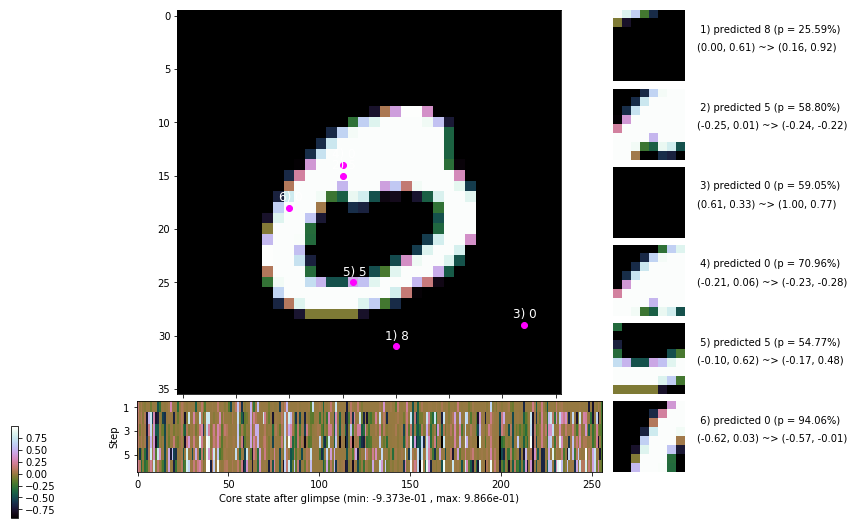

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 169.7 ms/b | lr: 7.05e-04 | grad 2norm: 15.95 | grad inf norm:  3.984
         Weights || abs max:  2.13 ( 3444.12) | mean: -7.75e-04 ( 0.01) | var: 5.49e-02 (  404.93)
          Biases || abs max:  1.18 (  109.33) | mean: -1.10e-01 ( 0.10) | var: 6.65e-02 (  832.78)
                    class loss: 0.359 | steps: 2.318 | reward:  3.570 | acc.: 88.28%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 168.1 ms/b | lr: 7.05e-04 | grad 2norm: 15.74 | grad inf norm:  3.872
         Weights || abs max:  2.13 (39126.46) | mean: -7.27e-04 ( 0.08) | var: 5.50e-02 (594314.06)
          Biases || abs max:  1.18 (  106.49) | mean: -1.10e-01 ( 0.09) | var: 6.64e-02 (  281.20)
                    class loss: 0.357 | steps: 2.310 | reward:  3.561 | acc.: 88.20%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.

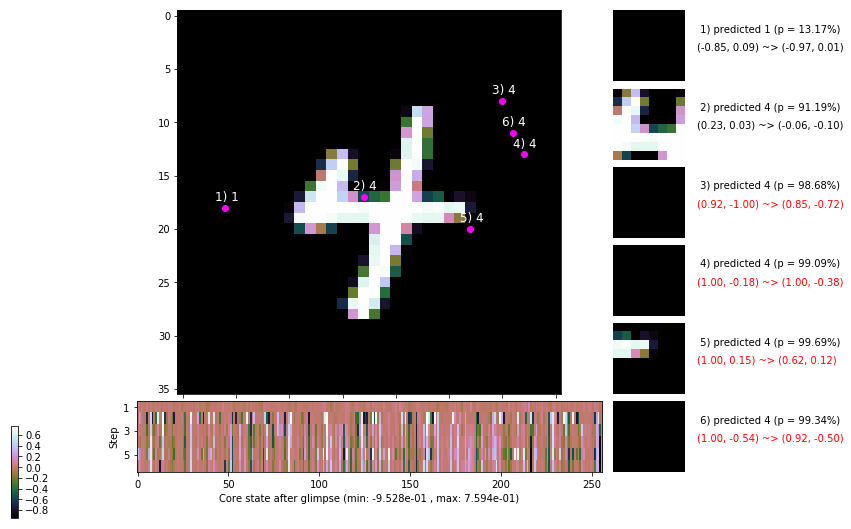

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 170.3 ms/b | lr: 7.03e-04 | grad 2norm: 16.40 | grad inf norm:  4.232
         Weights || abs max:  2.14 ( 5556.22) | mean: -7.13e-04 ( 0.02) | var: 5.51e-02 ( 2674.65)
          Biases || abs max:  1.17 (   53.00) | mean: -1.09e-01 ( 0.06) | var: 6.64e-02 (   14.93)
                    class loss: 0.363 | steps: 2.316 | reward:  3.561 | acc.: 87.75%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 168.9 ms/b | lr: 7.02e-04 | grad 2norm: 15.98 | grad inf norm:  4.002
         Weights || abs max:  2.16 ( 4590.96) | mean: -7.15e-04 ( 0.02) | var: 5.52e-02 ( 2515.90)
          Biases || abs max:  1.17 (   60.99) | mean: -1.10e-01 ( 0.06) | var: 6.68e-02 (   51.97)
                    class loss: 0.352 | steps: 2.318 | reward:  3.546 | acc.: 88.18%

	Target class: 0 | Discounted rewards: [-0.281, 0.438, 1.

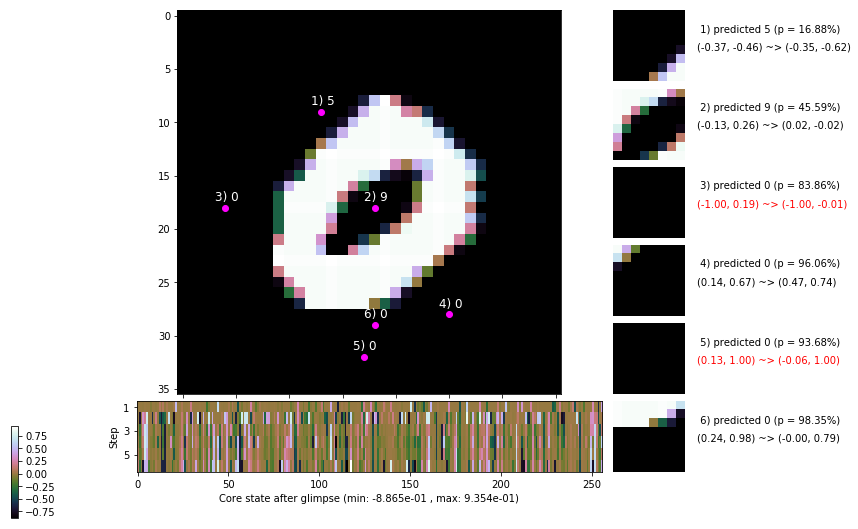

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 171.3 ms/b | lr: 7.01e-04 | grad 2norm: 16.08 | grad inf norm:  4.038
         Weights || abs max:  2.15 ( 5025.40) | mean: -6.83e-04 ( 0.02) | var: 5.53e-02 ( 3467.33)
          Biases || abs max:  1.18 (   92.99) | mean: -1.09e-01 ( 0.08) | var: 6.69e-02 (   67.15)
                    class loss: 0.361 | steps: 2.327 | reward:  3.527 | acc.: 87.87%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 167.7 ms/b | lr: 7.00e-04 | grad 2norm: 15.88 | grad inf norm:  3.860
         Weights || abs max:  2.15 ( 3578.95) | mean: -6.96e-04 ( 0.02) | var: 5.54e-02 (  231.74)
          Biases || abs max:  1.19 (  120.98) | mean: -1.10e-01 ( 0.11) | var: 6.71e-02 (  397.83)
                    class loss: 0.371 | steps: 2.278 | reward:  3.593 | acc.: 87.50%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

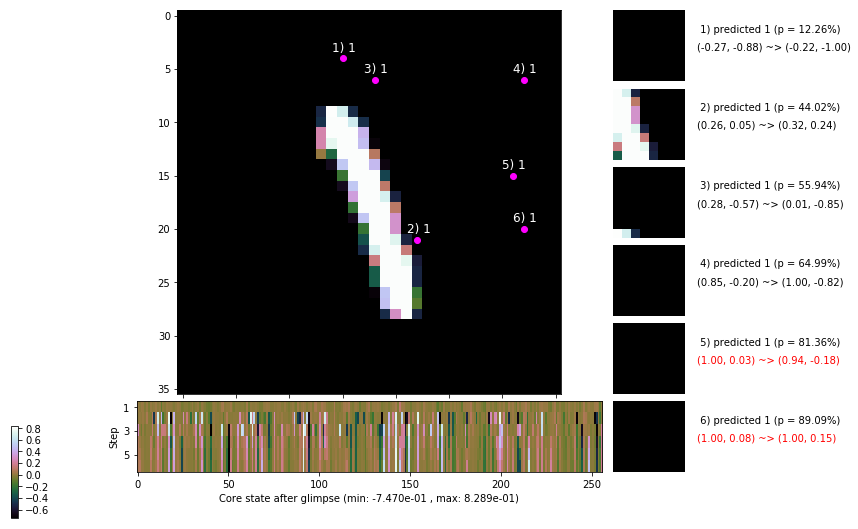

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 181.1 ms/b | lr: 6.99e-04 | grad 2norm: 16.13 | grad inf norm:  4.217
         Weights || abs max:  2.14 ( 2355.17) | mean: -6.93e-04 ( 0.01) | var: 5.55e-02 (  186.76)
          Biases || abs max:  1.18 (   63.51) | mean: -1.11e-01 ( 0.07) | var: 6.74e-02 (   74.44)
                    class loss: 0.367 | steps: 2.338 | reward:  3.529 | acc.: 87.23%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 173.1 ms/b | lr: 6.98e-04 | grad 2norm: 15.95 | grad inf norm:  3.987
         Weights || abs max:  2.15 ( 8527.10) | mean: -7.30e-04 ( 0.02) | var: 5.57e-02 (14302.28)
          Biases || abs max:  1.20 (  130.19) | mean: -1.10e-01 ( 0.11) | var: 6.75e-02 (  225.22)
                    class loss: 0.364 | steps: 2.320 | reward:  3.519 | acc.: 87.55%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

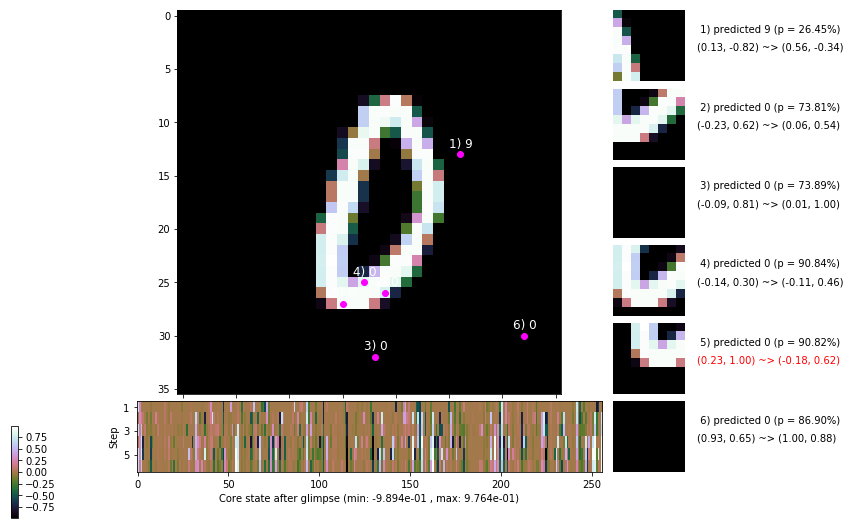

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


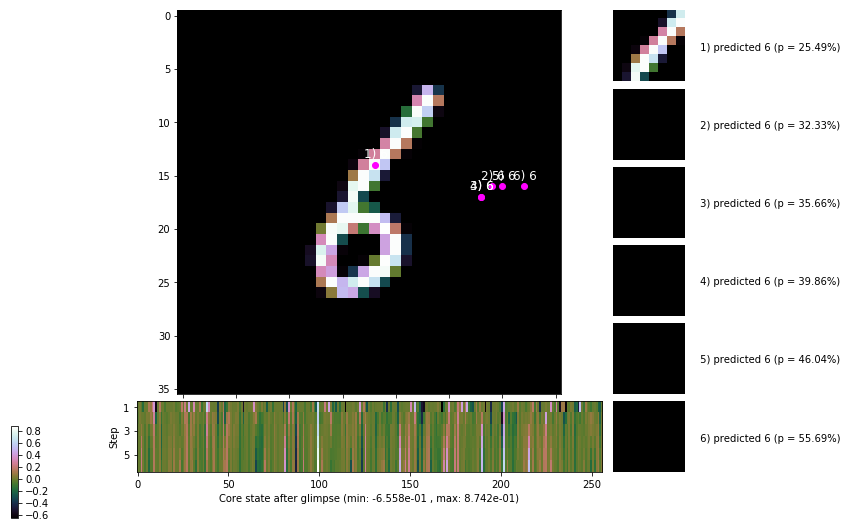


	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


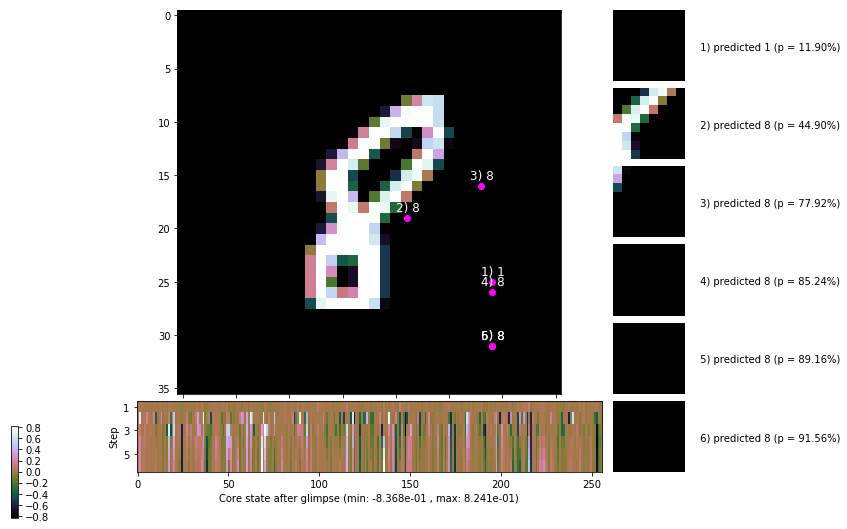

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


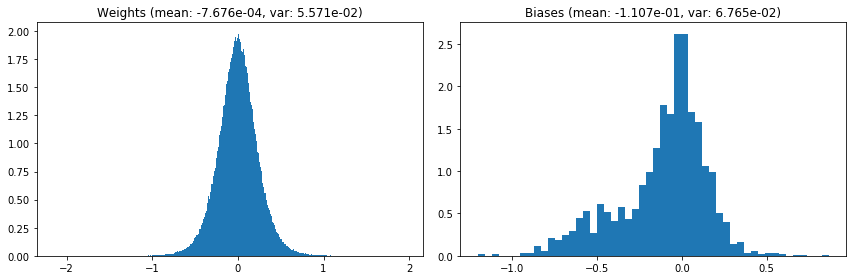

                                      Location network weights and biases


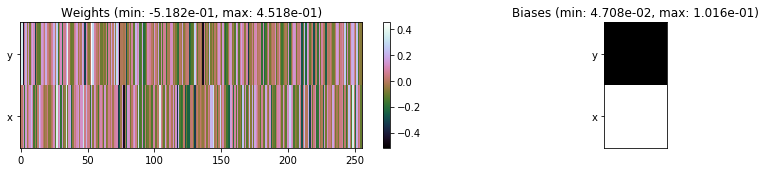

---------------------------------------------------------------------------------------------------------------
Elapsed time:  513.53 sec | TRAIN >> class loss: 0.3613 | steps:  2.316 :( | reward:  3.5523 :( | acc.: 87.897% :(
                          | VAL   >> class loss: 0.3642 | steps:  2.192 :( | reward:  3.7317 :( | acc.: 87.720% :(


Epoch  25/400) lr = 0.0006976
 b    300/  3000 >> 169.1 ms/b | lr: 6.97e-04 | grad 2norm: 15.75 | grad inf norm:  4.036
         Weights || abs max:  2.14 ( 3002.77) | mean: -7.61e-04 ( 0.01) | var: 5.58e-02 (  197.80)
          Biases || abs max:  1.21 (  248.85) | mean: -1.11e-01 ( 0.14) | var: 6.77e-02 ( 2590.71)
                    class loss: 0.363 | steps: 2.321 | reward:  3.549 | acc.: 88.32%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 169.2 ms/b | lr: 6.96e-04 | grad 2norm: 15.44 | grad inf norm:  3.962
         Weights || abs max:  2.15 ( 5600.91) | mean: -7.38e-04 (

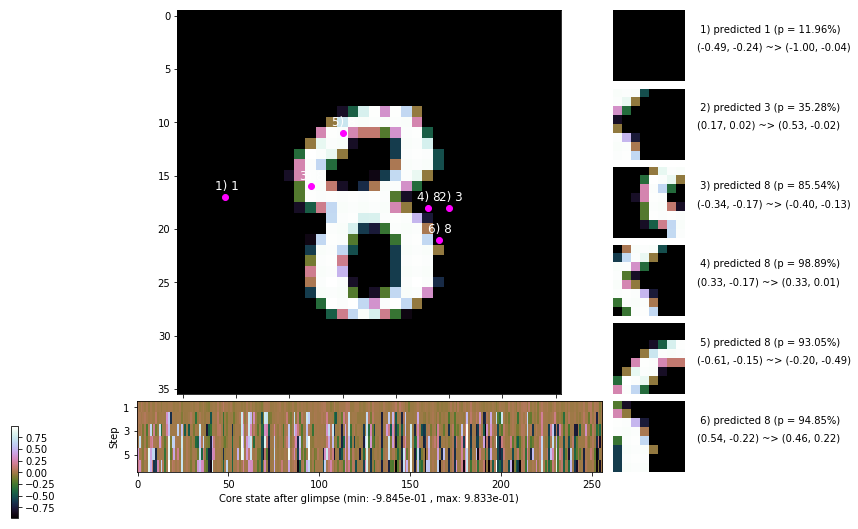

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 174.5 ms/b | lr: 6.95e-04 | grad 2norm: 16.03 | grad inf norm:  4.070
         Weights || abs max:  2.15 ( 3669.12) | mean: -7.65e-04 ( 0.01) | var: 5.60e-02 (  356.85)
          Biases || abs max:  1.21 (   85.49) | mean: -1.11e-01 ( 0.08) | var: 6.82e-02 (   25.82)
                    class loss: 0.377 | steps: 2.337 | reward:  3.517 | acc.: 87.33%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 165.6 ms/b | lr: 6.94e-04 | grad 2norm: 15.63 | grad inf norm:  3.936
         Weights || abs max:  2.14 ( 1865.52) | mean: -7.91e-04 ( 0.01) | var: 5.61e-02 (   45.57)
          Biases || abs max:  1.21 (   77.37) | mean: -1.11e-01 ( 0.08) | var: 6.83e-02 (   25.97)
                    class loss: 0.366 | steps: 2.292 | reward:  3.577 | acc.: 87.95%

	Target class: 8 | Discounted rewards: [-0.281, 0.438, 1.

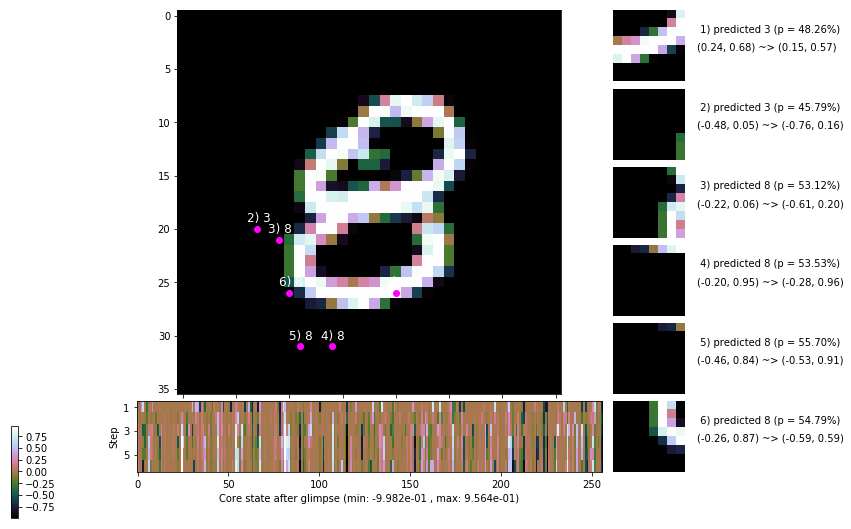

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 165.7 ms/b | lr: 6.93e-04 | grad 2norm: 15.75 | grad inf norm:  3.983
         Weights || abs max:  2.15 ( 2825.09) | mean: -7.97e-04 ( 0.01) | var: 5.62e-02 (  114.75)
          Biases || abs max:  1.22 (  146.38) | mean: -1.11e-01 ( 0.11) | var: 6.85e-02 (  209.39)
                    class loss: 0.369 | steps: 2.290 | reward:  3.575 | acc.: 87.85%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 170.4 ms/b | lr: 6.92e-04 | grad 2norm: 15.85 | grad inf norm:  3.972
         Weights || abs max:  2.15 ( 2661.39) | mean: -8.37e-04 ( 0.01) | var: 5.64e-02 (  257.34)
          Biases || abs max:  1.23 (   58.60) | mean: -1.11e-01 ( 0.06) | var: 6.86e-02 (   12.37)
                    class loss: 0.356 | steps: 2.292 | reward:  3.608 | acc.: 88.13%

	Target class: 3 | Discounted rewards: [-0.656, -0.312, 0

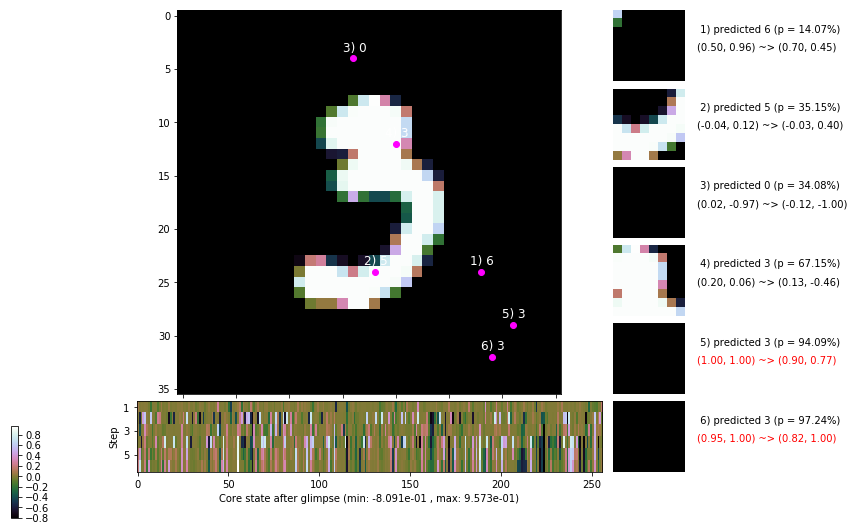

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 173.6 ms/b | lr: 6.91e-04 | grad 2norm: 16.02 | grad inf norm:  4.101
         Weights || abs max:  2.15 ( 2589.87) | mean: -8.32e-04 ( 0.01) | var: 5.64e-02 (  190.14)
          Biases || abs max:  1.22 (   95.23) | mean: -1.11e-01 ( 0.08) | var: 6.87e-02 (  267.89)
                    class loss: 0.375 | steps: 2.291 | reward:  3.576 | acc.: 87.35%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 177.4 ms/b | lr: 6.90e-04 | grad 2norm: 15.62 | grad inf norm:  3.930
         Weights || abs max:  2.16 ( 3162.13) | mean: -8.39e-04 ( 0.01) | var: 5.66e-02 (  373.75)
          Biases || abs max:  1.22 (   62.49) | mean: -1.12e-01 ( 0.07) | var: 6.89e-02 (   21.05)
                    class loss: 0.358 | steps: 2.326 | reward:  3.565 | acc.: 87.92%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

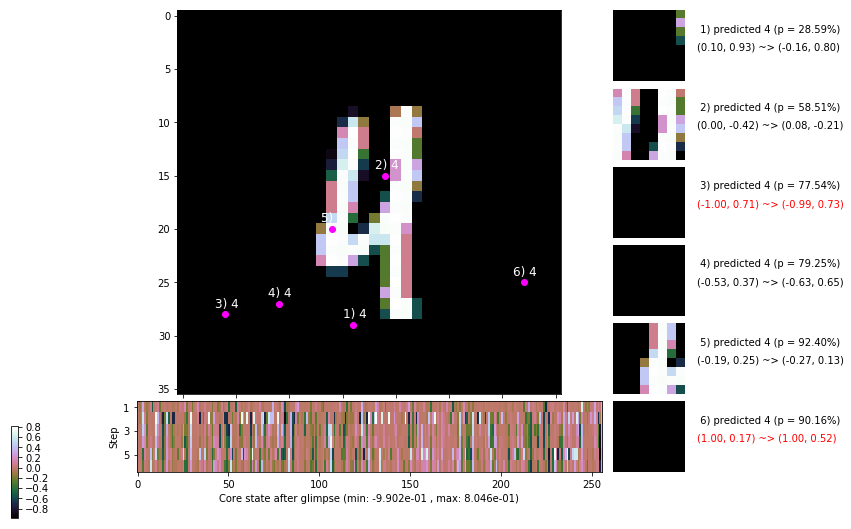

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 177.1 ms/b | lr: 6.89e-04 | grad 2norm: 15.53 | grad inf norm:  4.017
         Weights || abs max:  2.17 ( 4834.81) | mean: -8.09e-04 ( 0.02) | var: 5.67e-02 ( 3346.85)
          Biases || abs max:  1.22 (   63.14) | mean: -1.12e-01 ( 0.06) | var: 6.92e-02 (   35.04)
                    class loss: 0.362 | steps: 2.256 | reward:  3.630 | acc.: 88.05%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 176.5 ms/b | lr: 6.88e-04 | grad 2norm: 15.80 | grad inf norm:  4.018
         Weights || abs max:  2.16 ( 6803.97) | mean: -7.94e-04 ( 0.02) | var: 5.68e-02 ( 2860.74)
          Biases || abs max:  1.22 (   56.73) | mean: -1.12e-01 ( 0.06) | var: 6.92e-02 (   21.20)
                    class loss: 0.360 | steps: 2.297 | reward:  3.581 | acc.: 87.70%

	Target class: 5 | Discounted rewards: [0.141, 1.281, 0.5

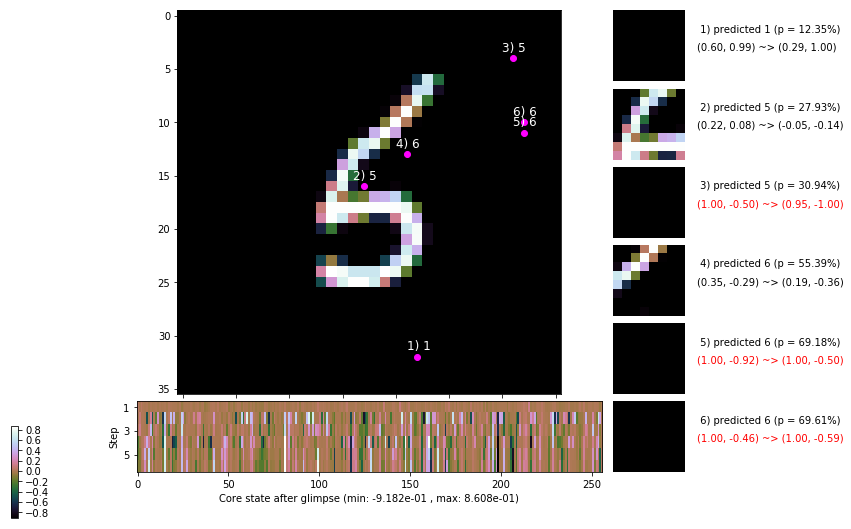

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


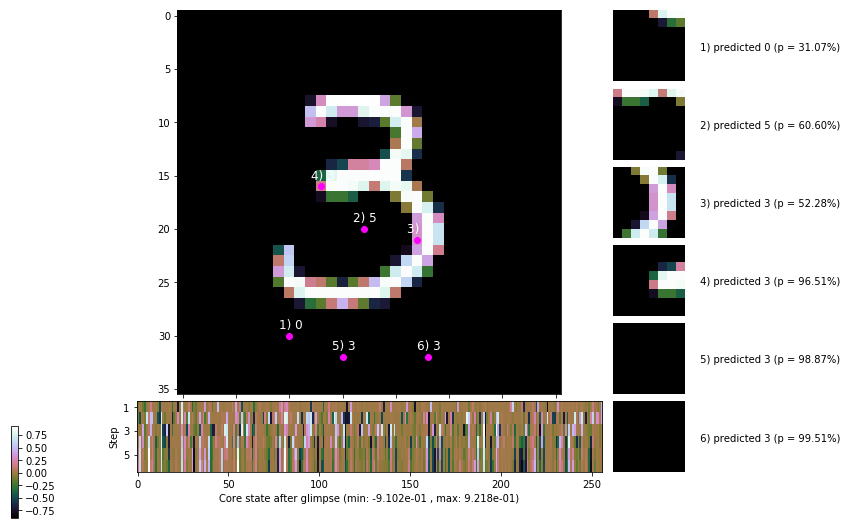


	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


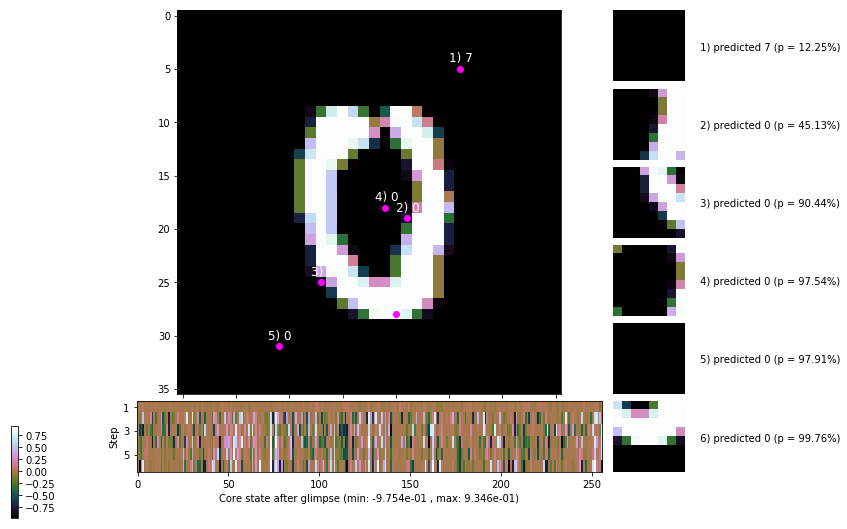

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


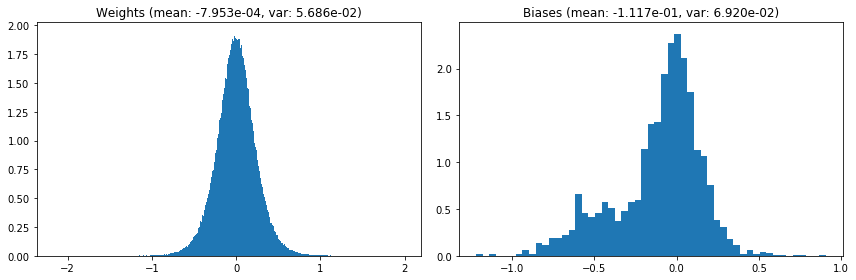

                                      Location network weights and biases


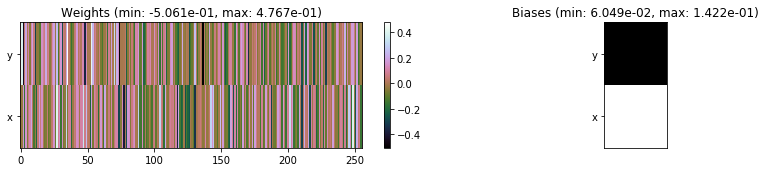

---------------------------------------------------------------------------------------------------------------
Elapsed time:  516.46 sec | TRAIN >> class loss: 0.3659 | steps:  2.301    | reward:  3.5730 :( | acc.: 87.865% :(
                          | VAL   >> class loss: 0.3629 | steps:  2.221 :( | reward:  3.7197 :( | acc.: 87.720% :(


Epoch  26/400) lr = 0.0006872
 b    300/  3000 >> 167.1 ms/b | lr: 6.86e-04 | grad 2norm: 15.56 | grad inf norm:  4.084
         Weights || abs max:  2.16 ( 6230.49) | mean: -7.97e-04 ( 0.02) | var: 5.69e-02 ( 4954.49)
          Biases || abs max:  1.22 (   60.62) | mean: -1.12e-01 ( 0.07) | var: 6.94e-02 (   10.86)
                    class loss: 0.377 | steps: 2.299 | reward:  3.576 | acc.: 87.62%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 172.6 ms/b | lr: 6.86e-04 | grad 2norm: 15.77 | grad inf norm:  4.119
         Weights || abs max:  2.17 ( 7985.54) | mean: -8.24e-04 (

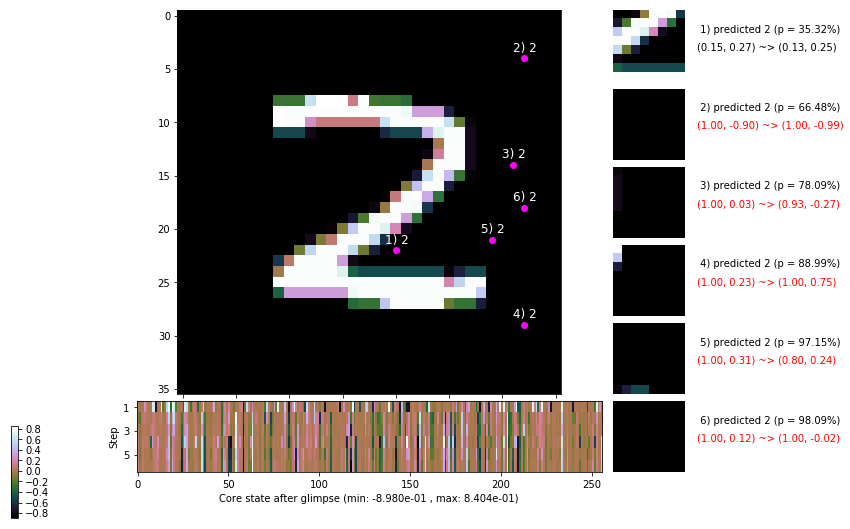

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 169.2 ms/b | lr: 6.84e-04 | grad 2norm: 16.03 | grad inf norm:  4.304
         Weights || abs max:  2.19 ( 4370.13) | mean: -8.31e-04 ( 0.02) | var: 5.71e-02 ( 1588.43)
          Biases || abs max:  1.23 (   38.11) | mean: -1.13e-01 ( 0.05) | var: 6.96e-02 (    3.01)
                    class loss: 0.402 | steps: 2.313 | reward:  3.510 | acc.: 86.82%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 166.4 ms/b | lr: 6.84e-04 | grad 2norm: 15.47 | grad inf norm:  3.902
         Weights || abs max:  2.19 ( 2894.57) | mean: -8.60e-04 ( 0.01) | var: 5.73e-02 (  208.60)
          Biases || abs max:  1.23 (   37.30) | mean: -1.14e-01 ( 0.05) | var: 6.95e-02 (    3.90)
                    class loss: 0.365 | steps: 2.317 | reward:  3.535 | acc.: 87.78%

	Target class: 8 | Discounted rewards: [-0.375, 0.250, 1.

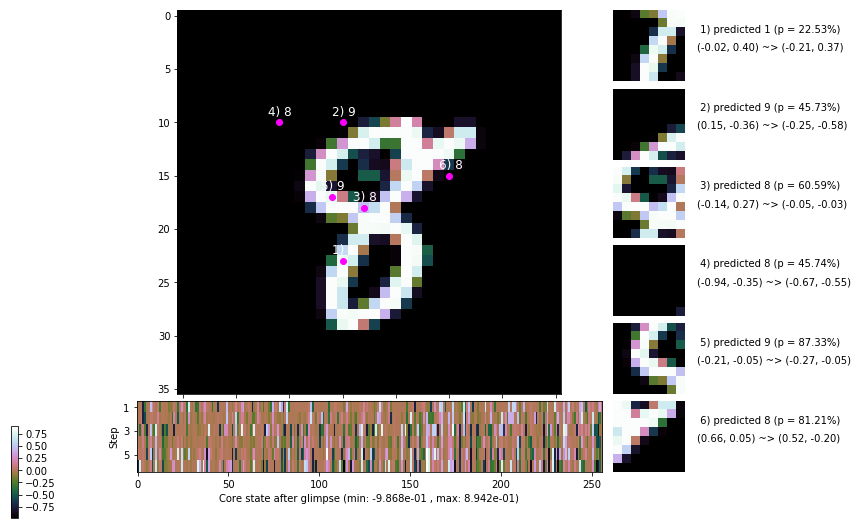

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 170.6 ms/b | lr: 6.82e-04 | grad 2norm: 15.55 | grad inf norm:  4.082
         Weights || abs max:  2.18 ( 3169.91) | mean: -8.47e-04 ( 0.01) | var: 5.74e-02 (  160.38)
          Biases || abs max:  1.23 (  133.65) | mean: -1.14e-01 ( 0.09) | var: 6.96e-02 (  143.96)
                    class loss: 0.366 | steps: 2.318 | reward:  3.550 | acc.: 87.73%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 170.9 ms/b | lr: 6.82e-04 | grad 2norm: 15.81 | grad inf norm:  3.997
         Weights || abs max:  2.20 ( 4718.66) | mean: -8.31e-04 ( 0.02) | var: 5.75e-02 (  586.16)
          Biases || abs max:  1.23 (   57.09) | mean: -1.14e-01 ( 0.06) | var: 6.97e-02 (   14.91)
                    class loss: 0.359 | steps: 2.296 | reward:  3.564 | acc.: 87.87%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

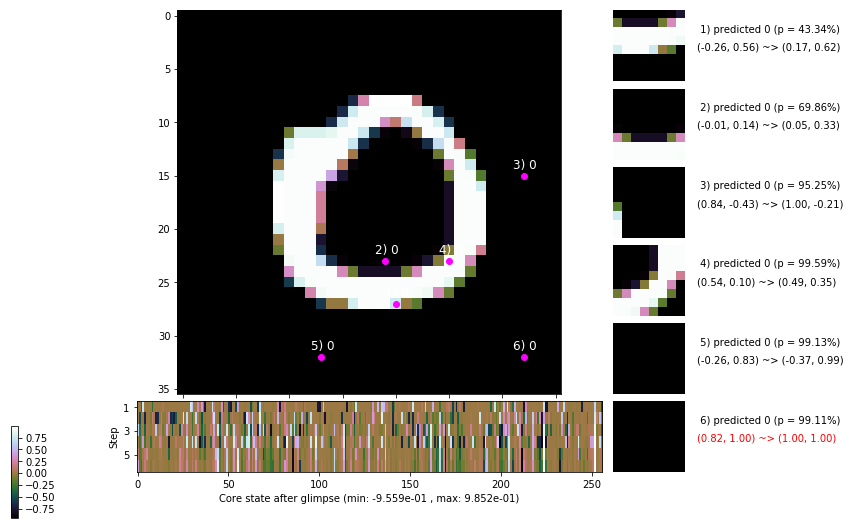

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 171.9 ms/b | lr: 6.80e-04 | grad 2norm: 15.73 | grad inf norm:  4.099
         Weights || abs max:  2.20 (10167.60) | mean: -8.49e-04 ( 0.03) | var: 5.76e-02 (22358.86)
          Biases || abs max:  1.22 (   73.37) | mean: -1.14e-01 ( 0.07) | var: 6.98e-02 (   20.28)
                    class loss: 0.373 | steps: 2.344 | reward:  3.501 | acc.: 87.22%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 144.9 ms/b | lr: 6.80e-04 | grad 2norm: 15.84 | grad inf norm:  4.045
         Weights || abs max:  2.19 ( 2182.24) | mean: -8.42e-04 ( 0.01) | var: 5.77e-02 (   96.49)
          Biases || abs max:  1.22 (  209.56) | mean: -1.14e-01 ( 0.13) | var: 6.99e-02 (  851.70)
                    class loss: 0.360 | steps: 2.302 | reward:  3.585 | acc.: 88.20%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

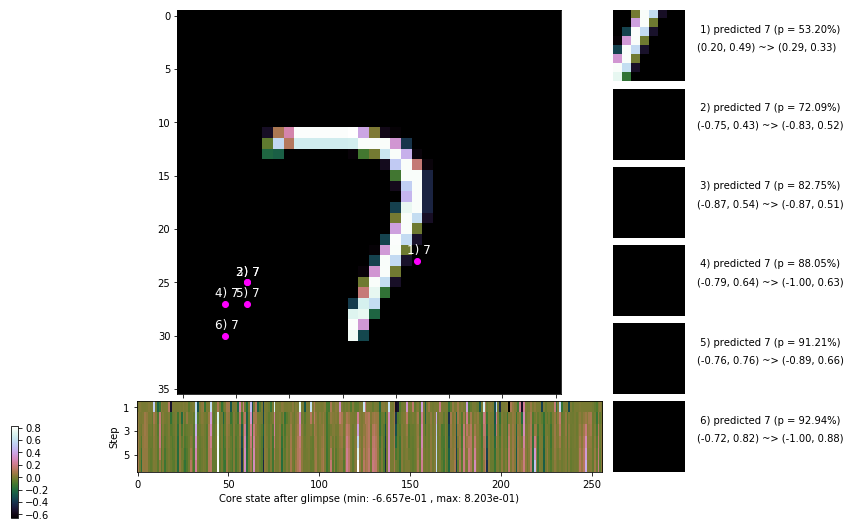

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.0 ms/b | lr: 6.78e-04 | grad 2norm: 15.81 | grad inf norm:  4.115
         Weights || abs max:  2.20 ( 2004.53) | mean: -8.53e-04 ( 0.01) | var: 5.78e-02 (   43.93)
          Biases || abs max:  1.23 (   72.45) | mean: -1.13e-01 ( 0.08) | var: 7.01e-02 (   23.00)
                    class loss: 0.367 | steps: 2.272 | reward:  3.572 | acc.: 87.08%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 157.9 ms/b | lr: 6.78e-04 | grad 2norm: 15.78 | grad inf norm:  4.116
         Weights || abs max:  2.20 ( 2411.45) | mean: -8.50e-04 ( 0.01) | var: 5.79e-02 (  126.26)
          Biases || abs max:  1.23 (  122.63) | mean: -1.13e-01 ( 0.10) | var: 7.02e-02 (  163.47)
                    class loss: 0.368 | steps: 2.294 | reward:  3.587 | acc.: 87.68%

	Target class: 3 | Discounted rewards: [-0.281, 0.438, 1.

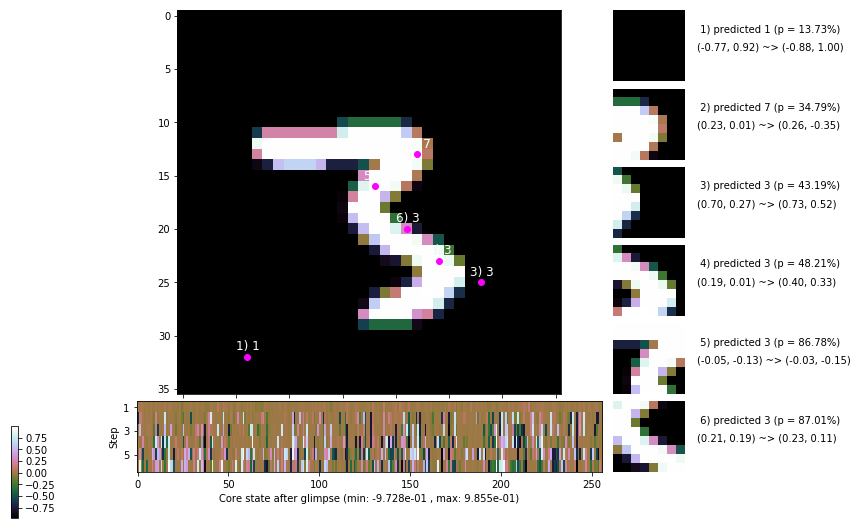

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


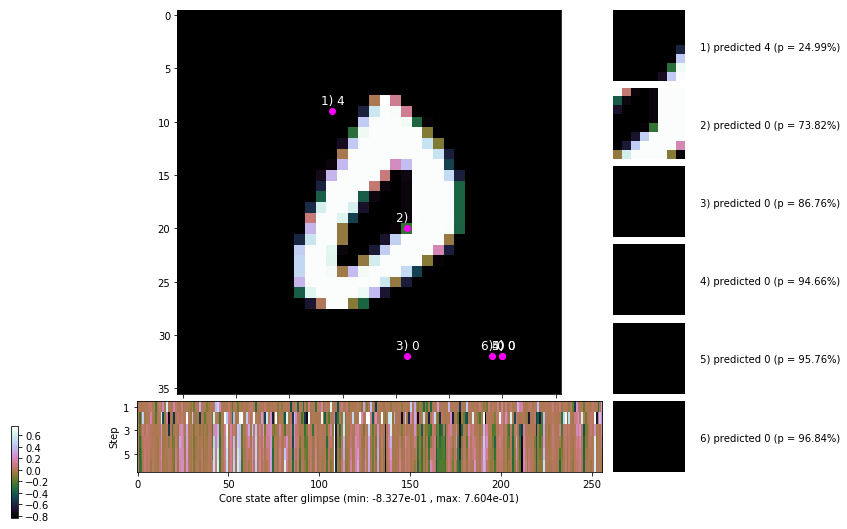


	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


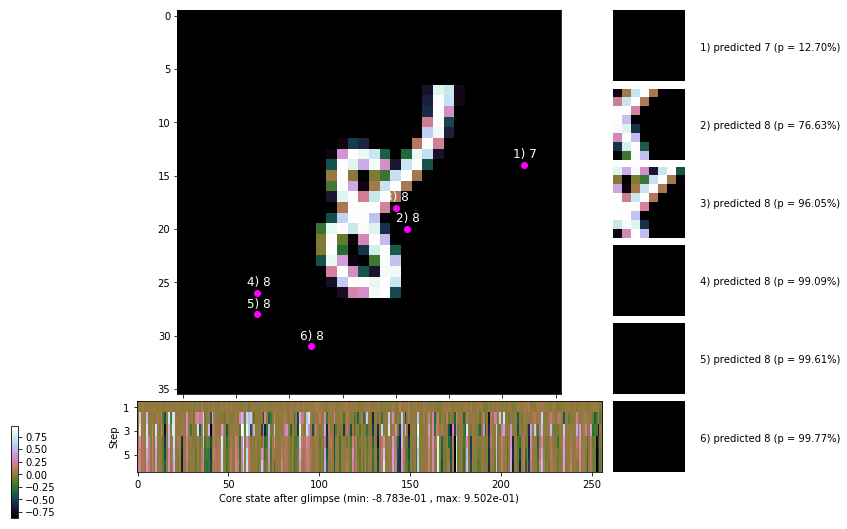

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


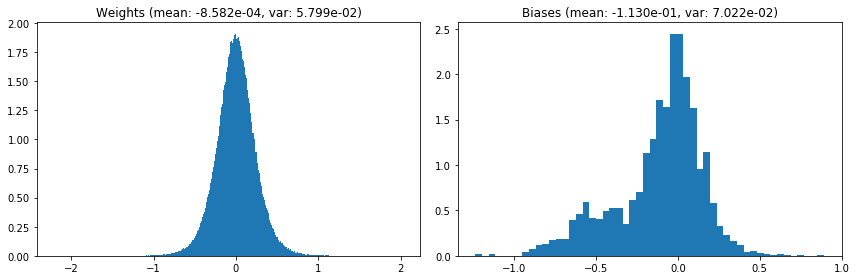

                                      Location network weights and biases


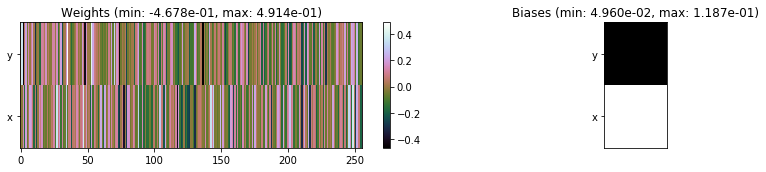

---------------------------------------------------------------------------------------------------------------
Elapsed time:  494.28 sec | TRAIN >> class loss: 0.3732 | steps:  2.308 :( | reward:  3.5494 :( | acc.: 87.468% :(
                          | VAL   >> class loss: 0.3605 | steps:  2.217 :( | reward:  3.7041 :( | acc.: 87.980% :(


Epoch  27/400) lr = 0.0006769
 b    300/  3000 >> 152.6 ms/b | lr: 6.76e-04 | grad 2norm: 15.64 | grad inf norm:  4.029
         Weights || abs max:  2.21 ( 3766.52) | mean: -8.54e-04 ( 0.02) | var: 5.80e-02 (  301.22)
          Biases || abs max:  1.24 (  119.40) | mean: -1.13e-01 ( 0.10) | var: 7.03e-02 (  357.59)
                    class loss: 0.362 | steps: 2.297 | reward:  3.592 | acc.: 87.95%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 148.9 ms/b | lr: 6.76e-04 | grad 2norm: 15.73 | grad inf norm:  3.885
         Weights || abs max:  2.21 ( 2094.53) | mean: -8.53e-04 (

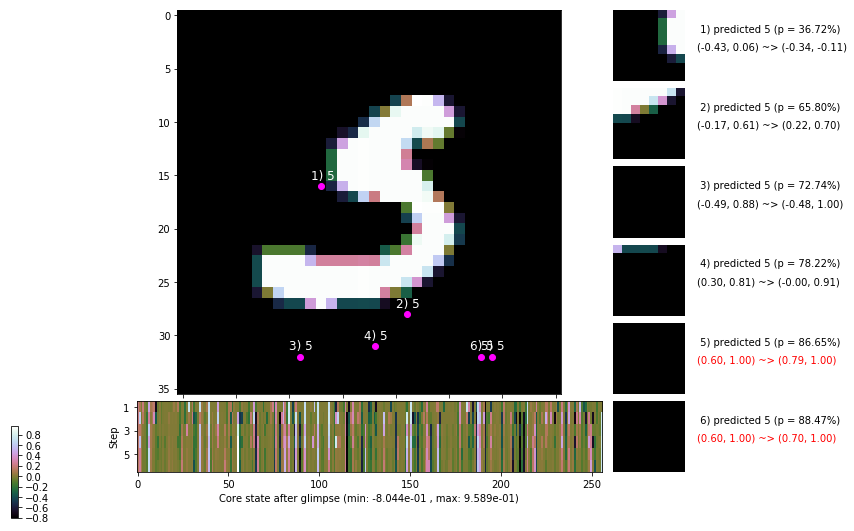

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 149.2 ms/b | lr: 6.74e-04 | grad 2norm: 15.69 | grad inf norm:  4.055
         Weights || abs max:  2.21 ( 4046.07) | mean: -9.00e-04 ( 0.02) | var: 5.82e-02 (  550.02)
          Biases || abs max:  1.25 (   97.89) | mean: -1.14e-01 ( 0.10) | var: 7.05e-02 (  307.22)
                    class loss: 0.363 | steps: 2.300 | reward:  3.577 | acc.: 87.45%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.7 ms/b | lr: 6.74e-04 | grad 2norm: 15.79 | grad inf norm:  4.192
         Weights || abs max:  2.21 (19350.25) | mean: -9.41e-04 ( 0.04) | var: 5.83e-02 (129075.84)
          Biases || abs max:  1.25 (   53.35) | mean: -1.15e-01 ( 0.06) | var: 7.05e-02 (   13.68)
                    class loss: 0.363 | steps: 2.310 | reward:  3.541 | acc.: 87.88%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.

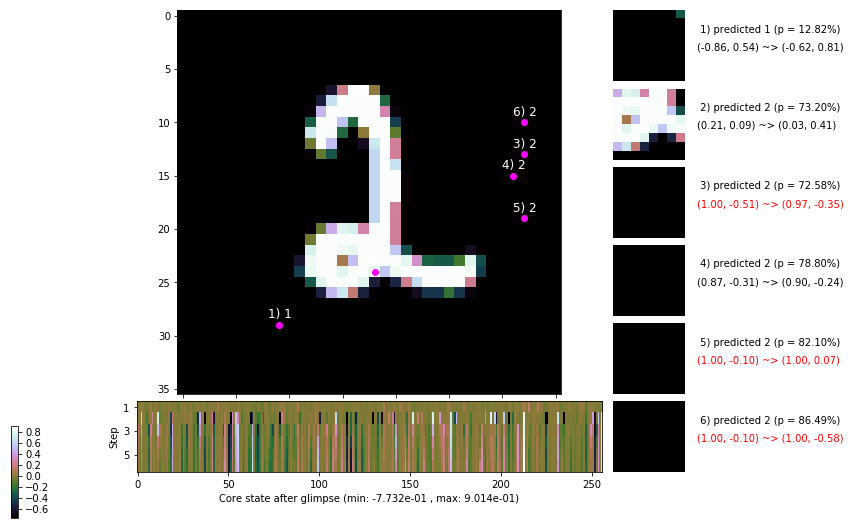

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 148.6 ms/b | lr: 6.72e-04 | grad 2norm: 15.94 | grad inf norm:  4.156
         Weights || abs max:  2.21 ( 6107.25) | mean: -9.53e-04 ( 0.02) | var: 5.85e-02 ( 6976.60)
          Biases || abs max:  1.24 (  124.37) | mean: -1.14e-01 ( 0.09) | var: 7.04e-02 (  450.32)
                    class loss: 0.371 | steps: 2.300 | reward:  3.551 | acc.: 87.23%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.9 ms/b | lr: 6.72e-04 | grad 2norm: 15.69 | grad inf norm:  3.984
         Weights || abs max:  2.21 ( 3224.45) | mean: -9.38e-04 ( 0.01) | var: 5.86e-02 (  218.52)
          Biases || abs max:  1.25 (   58.58) | mean: -1.14e-01 ( 0.07) | var: 7.05e-02 (    9.43)
                    class loss: 0.377 | steps: 2.340 | reward:  3.509 | acc.: 86.97%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

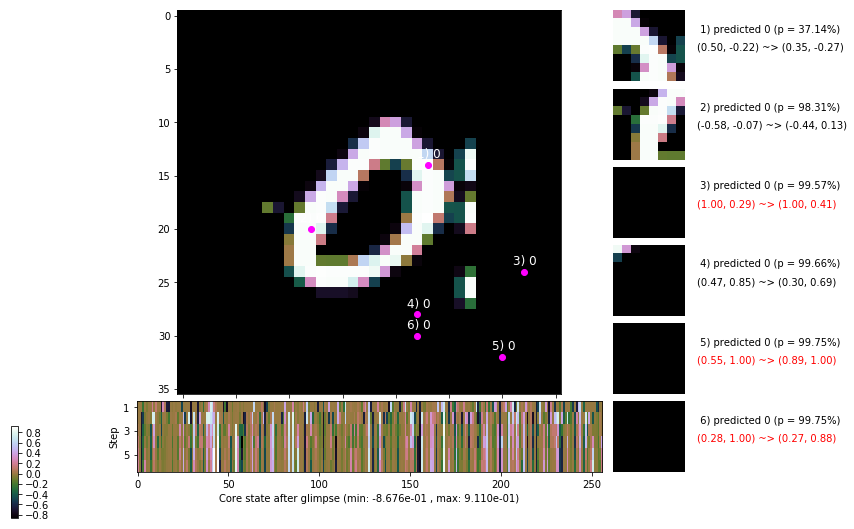

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.9 ms/b | lr: 6.70e-04 | grad 2norm: 15.50 | grad inf norm:  3.957
         Weights || abs max:  2.21 ( 2334.61) | mean: -9.54e-04 ( 0.01) | var: 5.87e-02 (   59.66)
          Biases || abs max:  1.26 (   83.03) | mean: -1.15e-01 ( 0.08) | var: 7.07e-02 (   28.30)
                    class loss: 0.391 | steps: 2.304 | reward:  3.559 | acc.: 86.97%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.1 ms/b | lr: 6.70e-04 | grad 2norm: 15.60 | grad inf norm:  3.986
         Weights || abs max:  2.21 (14200.00) | mean: -9.63e-04 ( 0.03) | var: 5.88e-02 (69755.25)
          Biases || abs max:  1.26 (  306.66) | mean: -1.15e-01 ( 0.25) | var: 7.10e-02 ( 5139.11)
                    class loss: 0.392 | steps: 2.308 | reward:  3.530 | acc.: 86.78%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

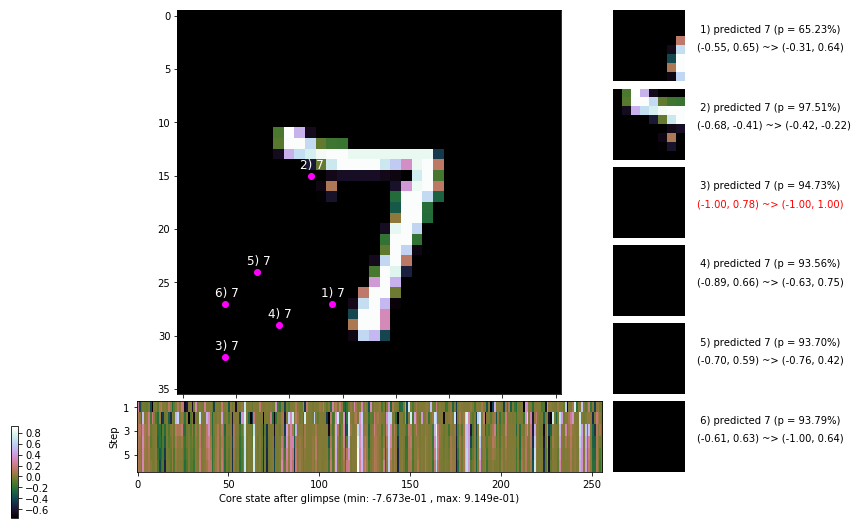

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 149.3 ms/b | lr: 6.68e-04 | grad 2norm: 15.52 | grad inf norm:  4.070
         Weights || abs max:  2.21 ( 1581.29) | mean: -9.67e-04 ( 0.01) | var: 5.89e-02 (   27.91)
          Biases || abs max:  1.26 (  144.29) | mean: -1.16e-01 ( 0.12) | var: 7.13e-02 (  583.48)
                    class loss: 0.361 | steps: 2.295 | reward:  3.575 | acc.: 87.53%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.3 ms/b | lr: 6.68e-04 | grad 2norm: 15.56 | grad inf norm:  4.122
         Weights || abs max:  2.20 ( 2481.83) | mean: -9.60e-04 ( 0.01) | var: 5.90e-02 (  160.86)
          Biases || abs max:  1.25 (  279.59) | mean: -1.16e-01 ( 0.17) | var: 7.15e-02 ( 2448.11)
                    class loss: 0.385 | steps: 2.286 | reward:  3.606 | acc.: 87.55%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

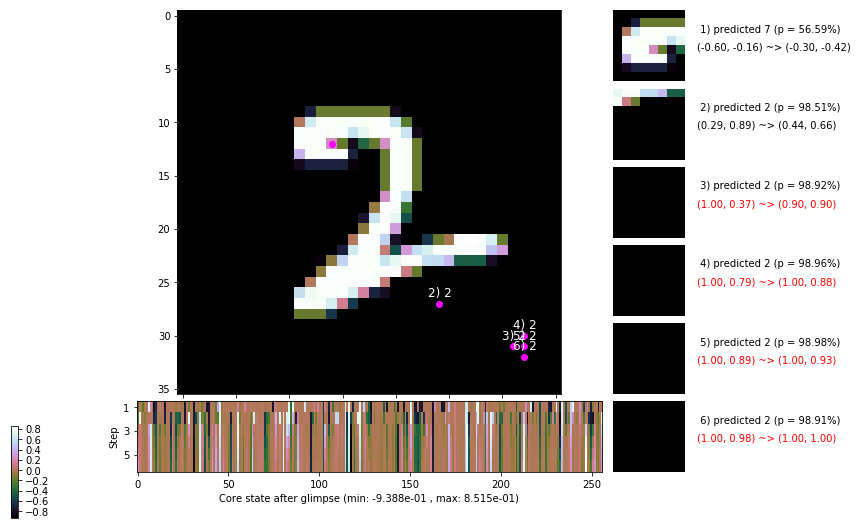

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


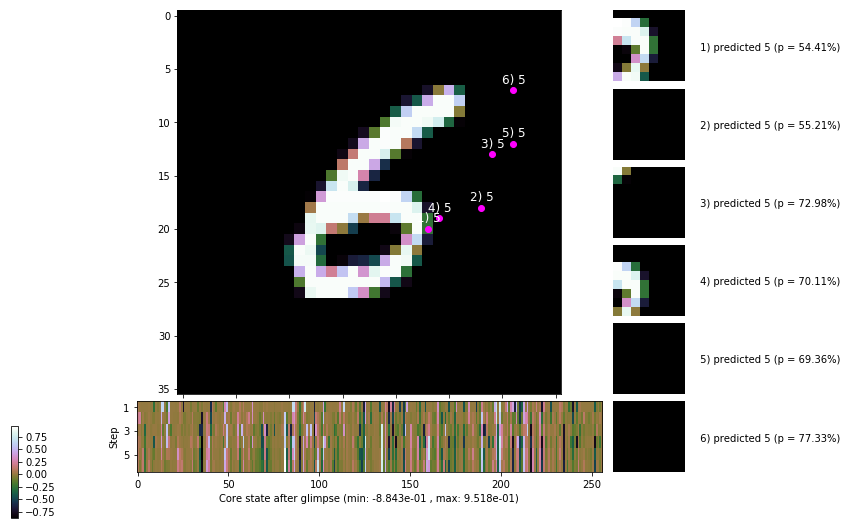


	Target class: 5 | Discounted rewards: [-0.234, 0.531, -0.938, -0.875, -0.750, -0.500]


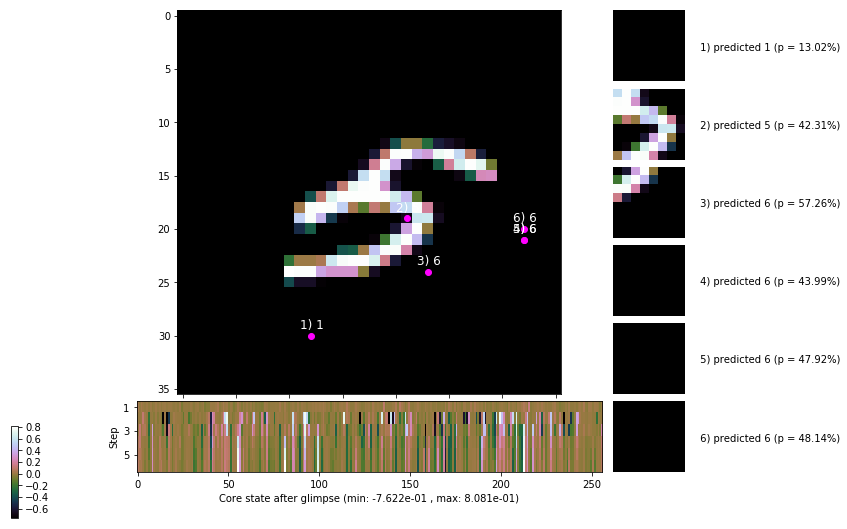

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


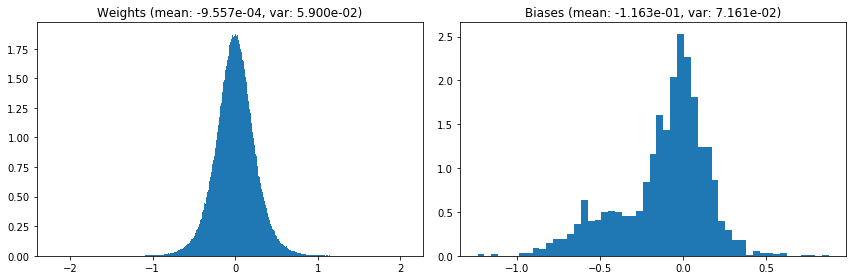

                                      Location network weights and biases


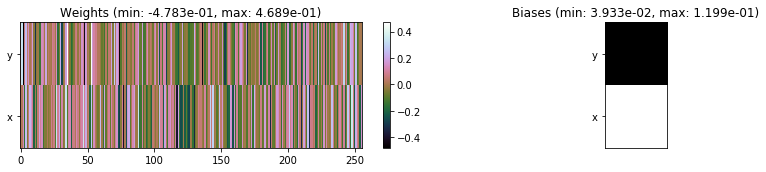

---------------------------------------------------------------------------------------------------------------
Elapsed time:  450.63 sec | TRAIN >> class loss: 0.3741 | steps:  2.304 :( | reward:  3.5602 :( | acc.: 87.395% :(
                          | VAL   >> class loss: 0.3498 | steps:  2.196 :( | reward:  3.7620 :( | acc.: 87.640% :(


Epoch  28/400) lr = 0.0006668
 b    300/  3000 >> 148.5 ms/b | lr: 6.66e-04 | grad 2norm: 15.47 | grad inf norm:  4.092
         Weights || abs max:  2.20 ( 5364.92) | mean: -9.50e-04 ( 0.02) | var: 5.91e-02 ( 2652.32)
          Biases || abs max:  1.25 (   98.22) | mean: -1.16e-01 ( 0.09) | var: 7.16e-02 (   49.53)
                    class loss: 0.359 | steps: 2.292 | reward:  3.576 | acc.: 87.83%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 150.6 ms/b | lr: 6.66e-04 | grad 2norm: 15.43 | grad inf norm:  4.054
         Weights || abs max:  2.21 ( 3126.22) | mean: -9.61e-04 (

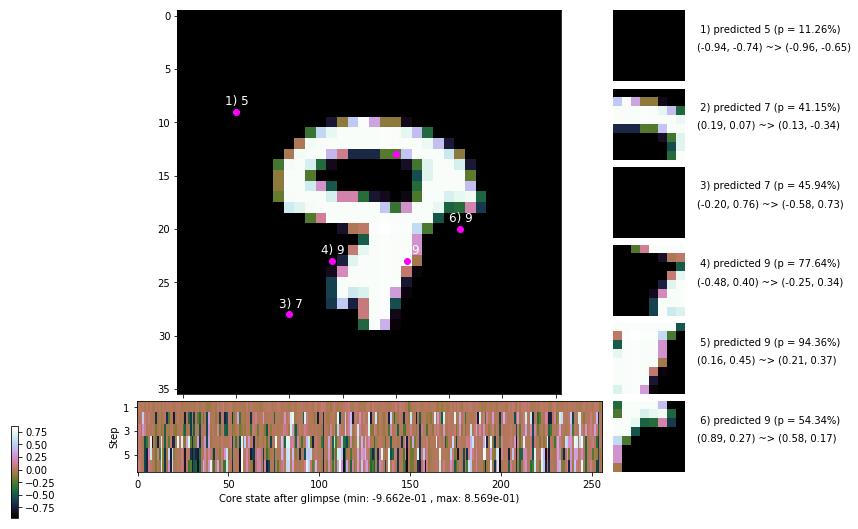

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 169.9 ms/b | lr: 6.64e-04 | grad 2norm: 15.81 | grad inf norm:  4.141
         Weights || abs max:  2.21 ( 6048.36) | mean: -9.18e-04 ( 0.02) | var: 5.93e-02 ( 3221.25)
          Biases || abs max:  1.26 (  118.88) | mean: -1.16e-01 ( 0.10) | var: 7.15e-02 (   77.02)
                    class loss: 0.386 | steps: 2.299 | reward:  3.570 | acc.: 86.97%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.7 ms/b | lr: 6.64e-04 | grad 2norm: 15.30 | grad inf norm:  3.958
         Weights || abs max:  2.20 ( 2187.07) | mean: -9.04e-04 ( 0.01) | var: 5.94e-02 (   57.13)
          Biases || abs max:  1.26 (  153.04) | mean: -1.16e-01 ( 0.12) | var: 7.17e-02 (  414.23)
                    class loss: 0.377 | steps: 2.290 | reward:  3.577 | acc.: 87.72%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

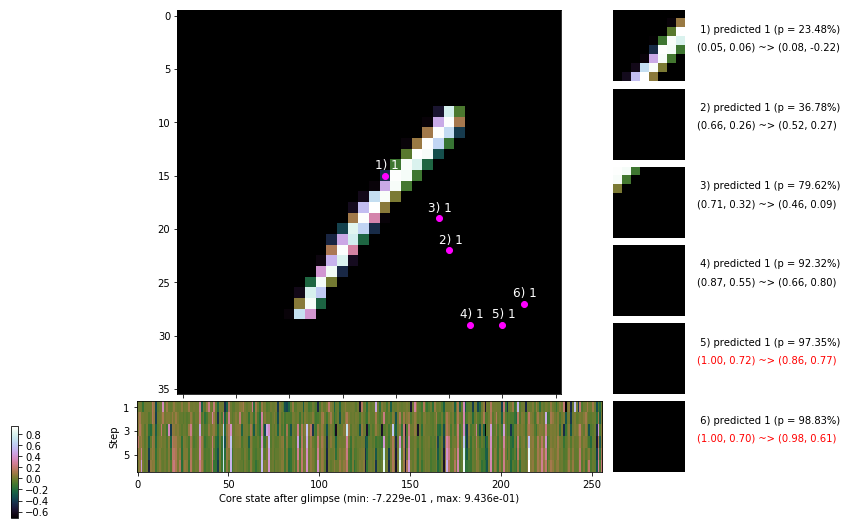

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.8 ms/b | lr: 6.62e-04 | grad 2norm: 15.85 | grad inf norm:  4.116
         Weights || abs max:  2.20 (14244.69) | mean: -8.77e-04 ( 0.03) | var: 5.95e-02 (54582.54)
          Biases || abs max:  1.26 (  134.12) | mean: -1.16e-01 ( 0.12) | var: 7.15e-02 (  257.30)
                    class loss: 0.382 | steps: 2.308 | reward:  3.539 | acc.: 87.13%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.7 ms/b | lr: 6.62e-04 | grad 2norm: 15.63 | grad inf norm:  4.107
         Weights || abs max:  2.22 ( 2286.52) | mean: -8.63e-04 ( 0.01) | var: 5.96e-02 (  358.13)
          Biases || abs max:  1.27 (  925.70) | mean: -1.16e-01 ( 0.41) | var: 7.16e-02 (71140.06)
                    class loss: 0.381 | steps: 2.313 | reward:  3.551 | acc.: 87.42%

	Target class: 2 | Discounted rewards: [1.875, 1.750, 1.5

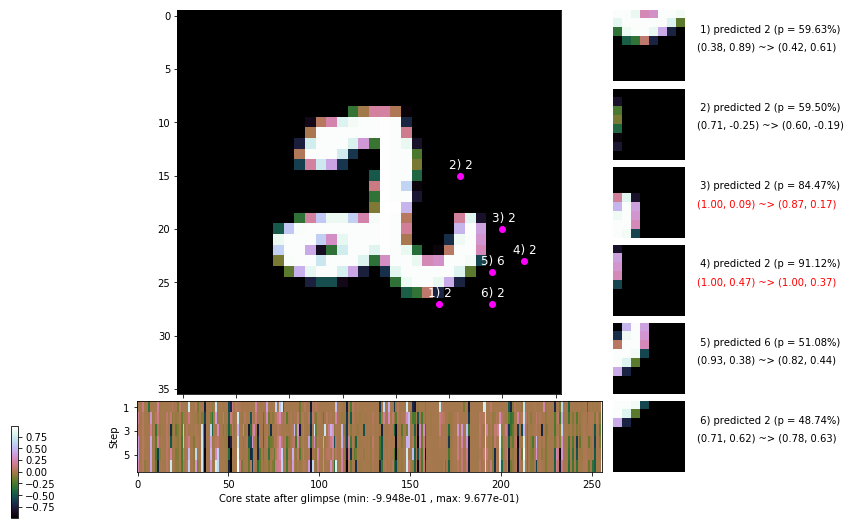

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 138.7 ms/b | lr: 6.60e-04 | grad 2norm: 15.50 | grad inf norm:  3.919
         Weights || abs max:  2.21 (10105.46) | mean: -8.72e-04 ( 0.03) | var: 5.97e-02 (26086.97)
          Biases || abs max:  1.27 (  144.43) | mean: -1.16e-01 ( 0.11) | var: 7.20e-02 (  122.58)
                    class loss: 0.361 | steps: 2.276 | reward:  3.607 | acc.: 87.88%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 133.3 ms/b | lr: 6.60e-04 | grad 2norm: 15.50 | grad inf norm:  3.937
         Weights || abs max:  2.22 ( 4391.92) | mean: -8.44e-04 ( 0.02) | var: 5.98e-02 ( 2303.32)
          Biases || abs max:  1.27 (  117.88) | mean: -1.16e-01 ( 0.09) | var: 7.21e-02 (  134.35)
                    class loss: 0.364 | steps: 2.304 | reward:  3.570 | acc.: 87.57%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

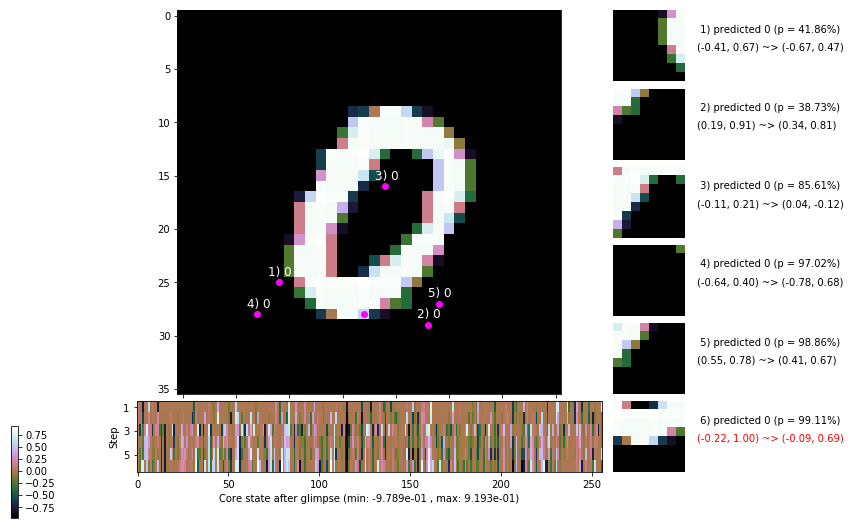

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 136.9 ms/b | lr: 6.58e-04 | grad 2norm: 15.55 | grad inf norm:  3.977
         Weights || abs max:  2.22 ( 6171.71) | mean: -8.67e-04 ( 0.02) | var: 5.99e-02 ( 7839.18)
          Biases || abs max:  1.27 (   71.64) | mean: -1.16e-01 ( 0.07) | var: 7.24e-02 (   31.32)
                    class loss: 0.355 | steps: 2.286 | reward:  3.604 | acc.: 88.07%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 131.4 ms/b | lr: 6.58e-04 | grad 2norm: 15.42 | grad inf norm:  4.093
         Weights || abs max:  2.23 ( 4261.14) | mean: -8.73e-04 ( 0.02) | var: 6.00e-02 (  683.80)
          Biases || abs max:  1.29 (  171.72) | mean: -1.16e-01 ( 0.12) | var: 7.25e-02 (  156.84)
                    class loss: 0.360 | steps: 2.334 | reward:  3.534 | acc.: 87.88%

	Target class: 8 | Discounted rewards: [-0.281, 0.438, 1.

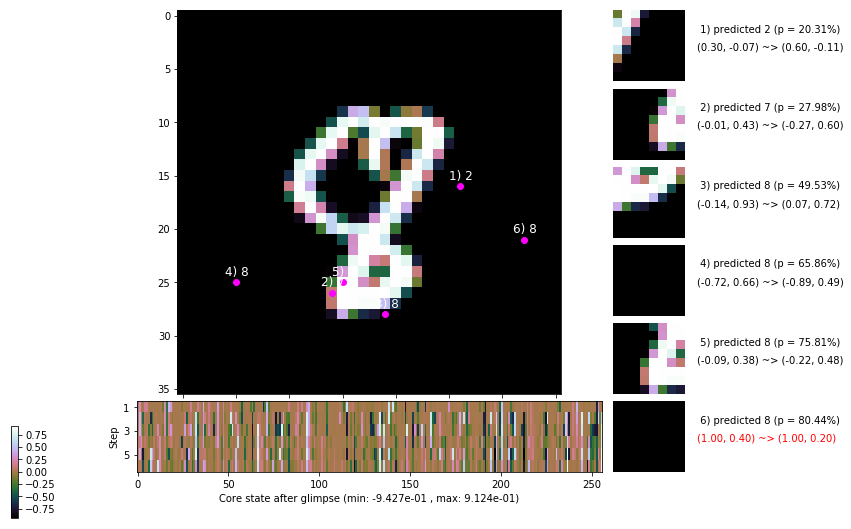

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


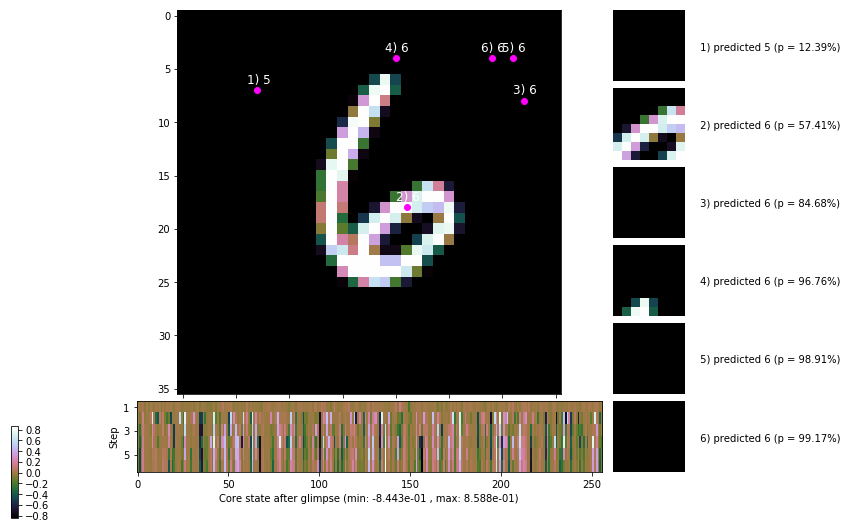


	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


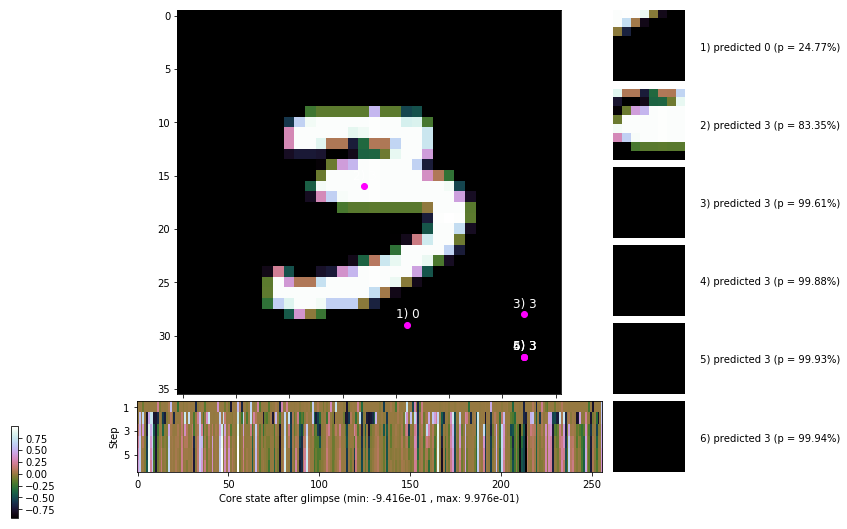

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


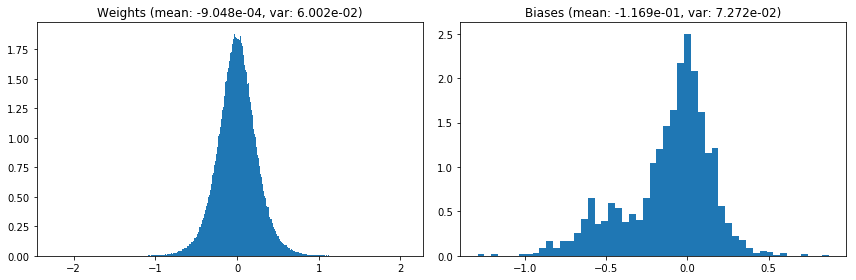

                                      Location network weights and biases


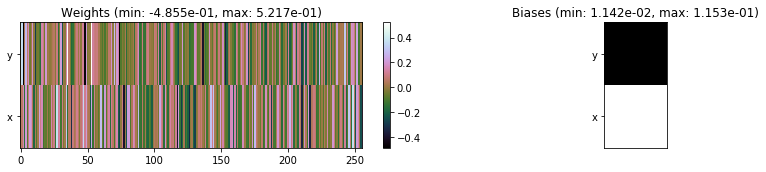

---------------------------------------------------------------------------------------------------------------
Elapsed time:  440.50 sec | TRAIN >> class loss: 0.3683 | steps:  2.299    | reward:  3.5748 :( | acc.: 87.645% :(
                          | VAL   >> class loss: 0.3669 | steps:  2.195 :( | reward:  3.7377 :( | acc.: 87.660% :(


Epoch  29/400) lr = 0.0006569
 b    300/  3000 >> 132.0 ms/b | lr: 6.56e-04 | grad 2norm: 15.09 | grad inf norm:  3.913
         Weights || abs max:  2.25 ( 3221.68) | mean: -8.91e-04 ( 0.01) | var: 6.01e-02 (  248.71)
          Biases || abs max:  1.29 (   86.10) | mean: -1.17e-01 ( 0.08) | var: 7.29e-02 (   57.08)
                    class loss: 0.370 | steps: 2.292 | reward:  3.602 | acc.: 88.03%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 134.4 ms/b | lr: 6.56e-04 | grad 2norm: 15.03 | grad inf norm:  3.897
         Weights || abs max:  2.25 ( 9594.43) | mean: -8.68e-04 (

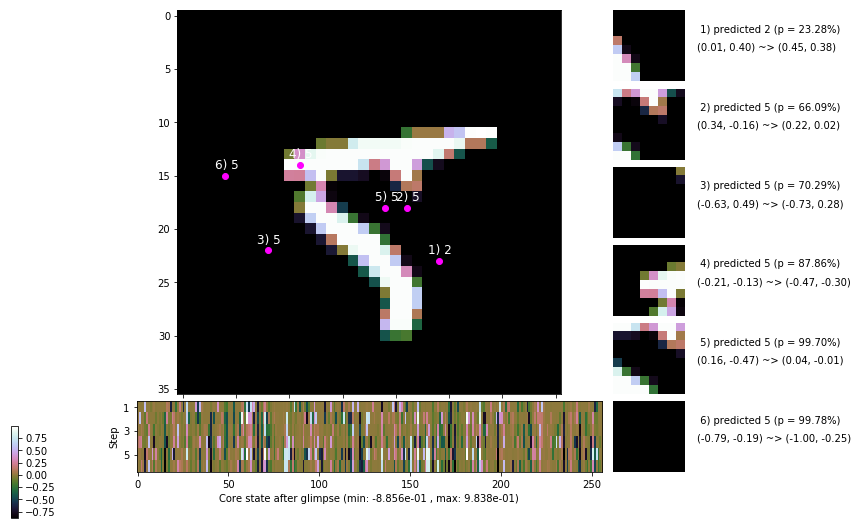

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 136.8 ms/b | lr: 6.54e-04 | grad 2norm: 15.53 | grad inf norm:  3.976
         Weights || abs max:  2.26 ( 2543.26) | mean: -8.42e-04 ( 0.01) | var: 6.03e-02 (  139.37)
          Biases || abs max:  1.28 (  390.10) | mean: -1.16e-01 ( 0.27) | var: 7.31e-02 ( 7351.99)
                    class loss: 0.366 | steps: 2.311 | reward:  3.549 | acc.: 87.28%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 132.7 ms/b | lr: 6.54e-04 | grad 2norm: 15.39 | grad inf norm:  4.021
         Weights || abs max:  2.25 ( 4991.23) | mean: -8.15e-04 ( 0.02) | var: 6.04e-02 ( 1699.33)
          Biases || abs max:  1.29 (  132.97) | mean: -1.17e-01 ( 0.11) | var: 7.34e-02 (  235.71)
                    class loss: 0.378 | steps: 2.285 | reward:  3.570 | acc.: 87.73%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

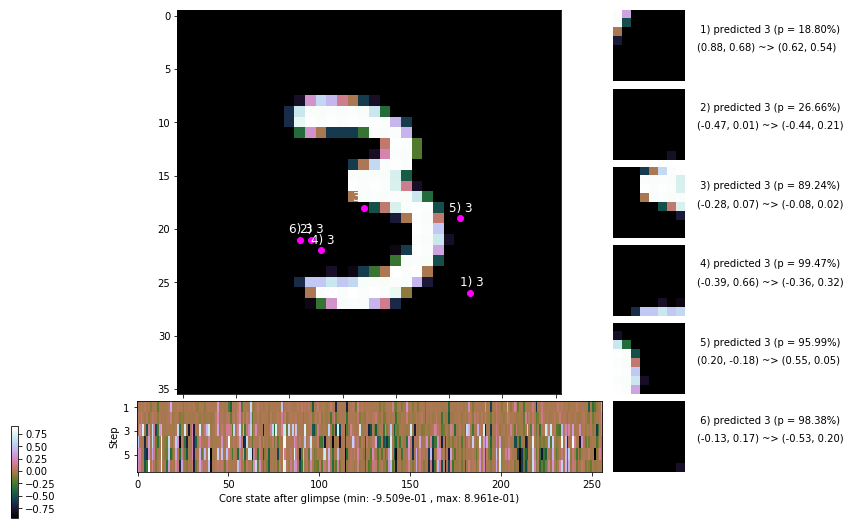

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 133.8 ms/b | lr: 6.52e-04 | grad 2norm: 15.02 | grad inf norm:  3.878
         Weights || abs max:  2.24 (19831.92) | mean: -7.94e-04 ( 0.04) | var: 6.05e-02 (159866.25)
          Biases || abs max:  1.28 (  102.77) | mean: -1.17e-01 ( 0.09) | var: 7.37e-02 (   61.03)
                    class loss: 0.359 | steps: 2.276 | reward:  3.617 | acc.: 88.20%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 134.6 ms/b | lr: 6.52e-04 | grad 2norm: 15.11 | grad inf norm:  3.768
         Weights || abs max:  2.23 ( 4195.66) | mean: -7.85e-04 ( 0.02) | var: 6.06e-02 ( 1068.74)
          Biases || abs max:  1.28 (   74.99) | mean: -1.17e-01 ( 0.08) | var: 7.37e-02 (   29.82)
                    class loss: 0.340 | steps: 2.275 | reward:  3.658 | acc.: 88.45%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.

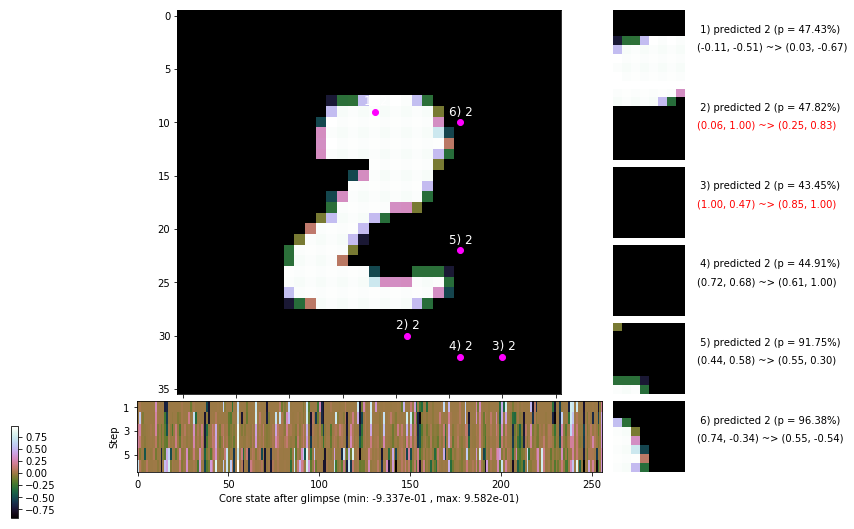

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 140.3 ms/b | lr: 6.50e-04 | grad 2norm: 15.23 | grad inf norm:  3.962
         Weights || abs max:  2.22 ( 2103.38) | mean: -7.84e-04 ( 0.01) | var: 6.07e-02 (   63.45)
          Biases || abs max:  1.28 (   85.34) | mean: -1.17e-01 ( 0.09) | var: 7.39e-02 (   32.83)
                    class loss: 0.361 | steps: 2.292 | reward:  3.585 | acc.: 88.05%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 137.8 ms/b | lr: 6.50e-04 | grad 2norm: 15.17 | grad inf norm:  3.889
         Weights || abs max:  2.23 ( 2834.05) | mean: -7.83e-04 ( 0.01) | var: 6.08e-02 (  232.85)
          Biases || abs max:  1.29 (  137.75) | mean: -1.18e-01 ( 0.11) | var: 7.41e-02 (  105.56)
                    class loss: 0.363 | steps: 2.300 | reward:  3.596 | acc.: 88.20%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

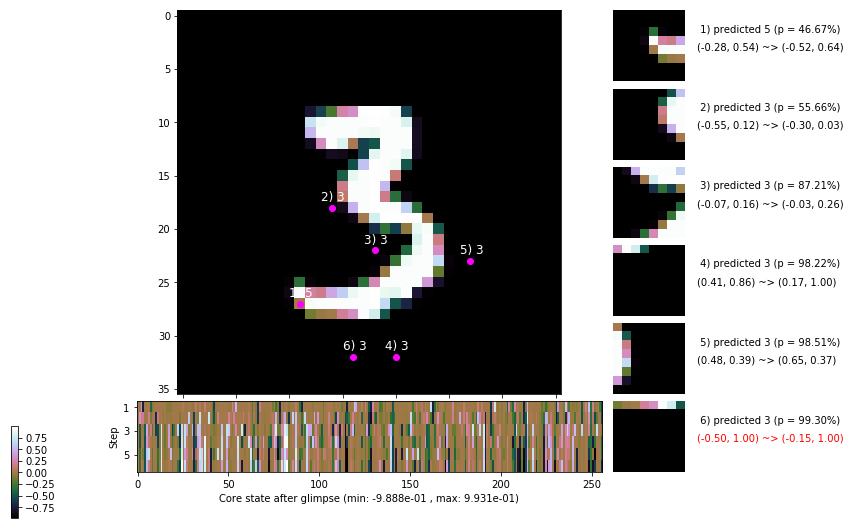

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 137.2 ms/b | lr: 6.48e-04 | grad 2norm: 15.14 | grad inf norm:  3.794
         Weights || abs max:  2.23 (10438.47) | mean: -7.81e-04 ( 0.03) | var: 6.08e-02 (18194.64)
          Biases || abs max:  1.29 (  110.68) | mean: -1.18e-01 ( 0.09) | var: 7.42e-02 (   74.79)
                    class loss: 0.344 | steps: 2.288 | reward:  3.615 | acc.: 88.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 128.4 ms/b | lr: 6.48e-04 | grad 2norm: 15.60 | grad inf norm:  4.197
         Weights || abs max:  2.24 ( 2025.79) | mean: -8.06e-04 ( 0.01) | var: 6.09e-02 (   49.05)
          Biases || abs max:  1.29 (   58.06) | mean: -1.18e-01 ( 0.06) | var: 7.44e-02 (   21.75)
                    class loss: 0.385 | steps: 2.315 | reward:  3.532 | acc.: 87.02%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

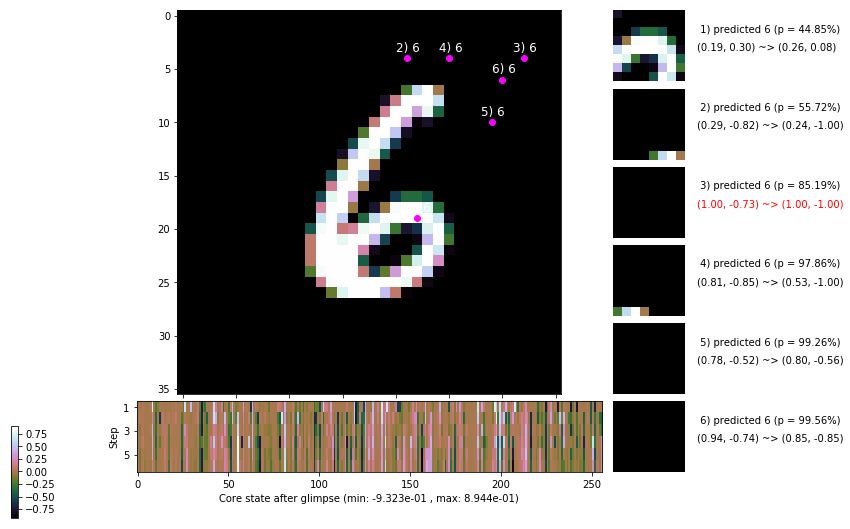

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


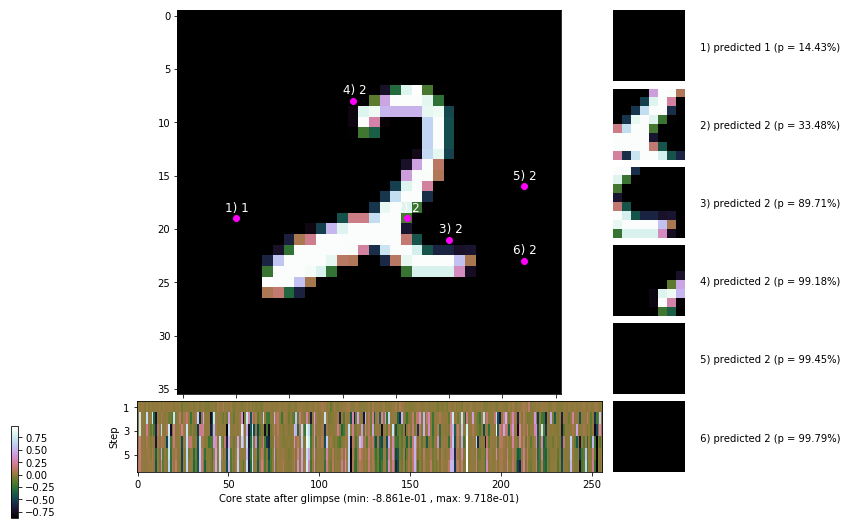


	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


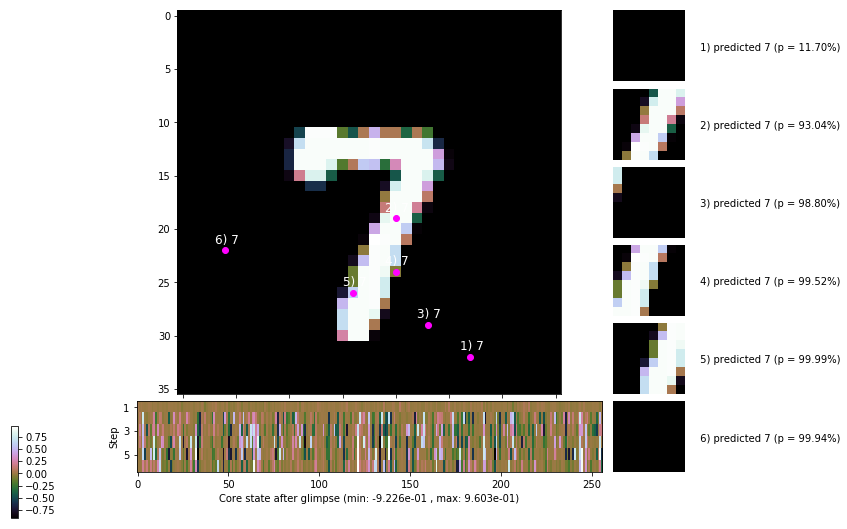

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


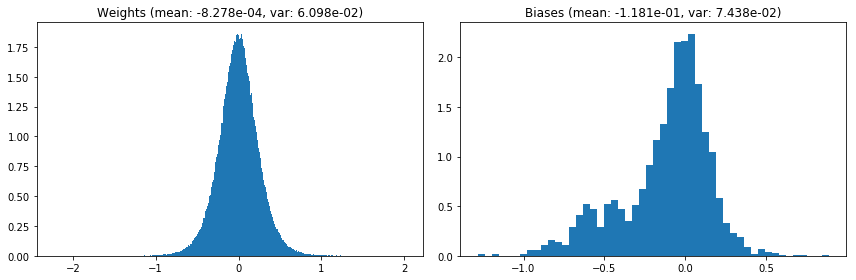

                                      Location network weights and biases


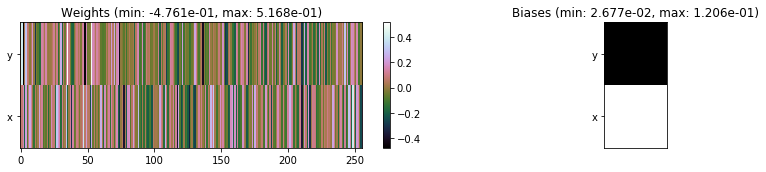

---------------------------------------------------------------------------------------------------------------
Elapsed time:  405.10 sec | TRAIN >> class loss: 0.3611 | steps:  2.289    | reward:  3.5964    | acc.: 88.012% :(
                          | VAL   >> class loss: 0.3453 | steps:  2.182 :( | reward:  3.7926    | acc.: 88.240% :(


Epoch  30/400) lr = 0.0006471
 b    300/  3000 >> 130.4 ms/b | lr: 6.46e-04 | grad 2norm: 14.97 | grad inf norm:  3.804
         Weights || abs max:  2.23 (10120.13) | mean: -8.30e-04 ( 0.03) | var: 6.10e-02 (15559.38)
          Biases || abs max:  1.28 (  119.48) | mean: -1.18e-01 ( 0.09) | var: 7.45e-02 (  268.76)
                    class loss: 0.355 | steps: 2.283 | reward:  3.631 | acc.: 88.10%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 135.1 ms/b | lr: 6.46e-04 | grad 2norm: 15.08 | grad inf norm:  3.891
         Weights || abs max:  2.22 (11610.20) | mean: -8.25e-04 (

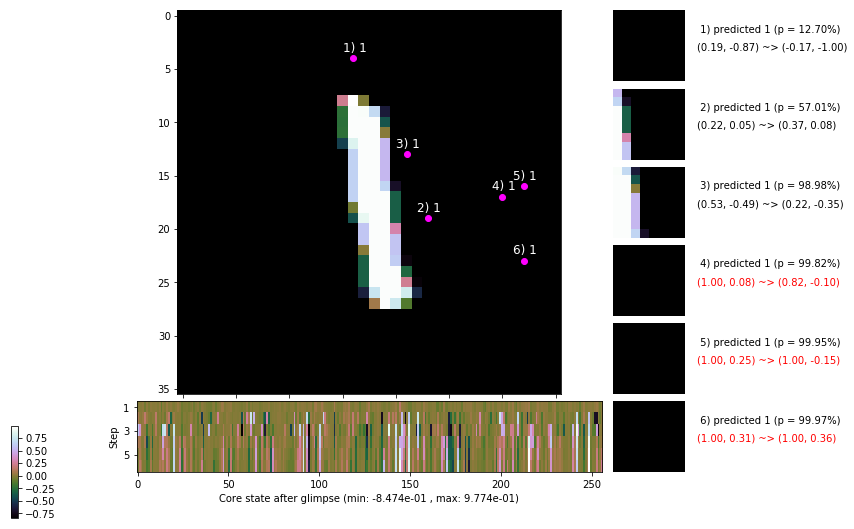

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.1 ms/b | lr: 6.45e-04 | grad 2norm: 15.21 | grad inf norm:  3.911
         Weights || abs max:  2.23 ( 2956.07) | mean: -8.07e-04 ( 0.01) | var: 6.12e-02 (  281.16)
          Biases || abs max:  1.27 (  130.28) | mean: -1.18e-01 ( 0.10) | var: 7.46e-02 (  216.95)
                    class loss: 0.345 | steps: 2.273 | reward:  3.656 | acc.: 88.95%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.7 ms/b | lr: 6.44e-04 | grad 2norm: 15.04 | grad inf norm:  3.897
         Weights || abs max:  2.23 ( 2791.00) | mean: -8.39e-04 ( 0.01) | var: 6.13e-02 (  291.18)
          Biases || abs max:  1.28 (   92.31) | mean: -1.18e-01 ( 0.09) | var: 7.49e-02 (   35.45)
                    class loss: 0.344 | steps: 2.280 | reward:  3.636 | acc.: 88.67%

	Target class: 4 | Discounted rewards: [-0.844, -0.688, -

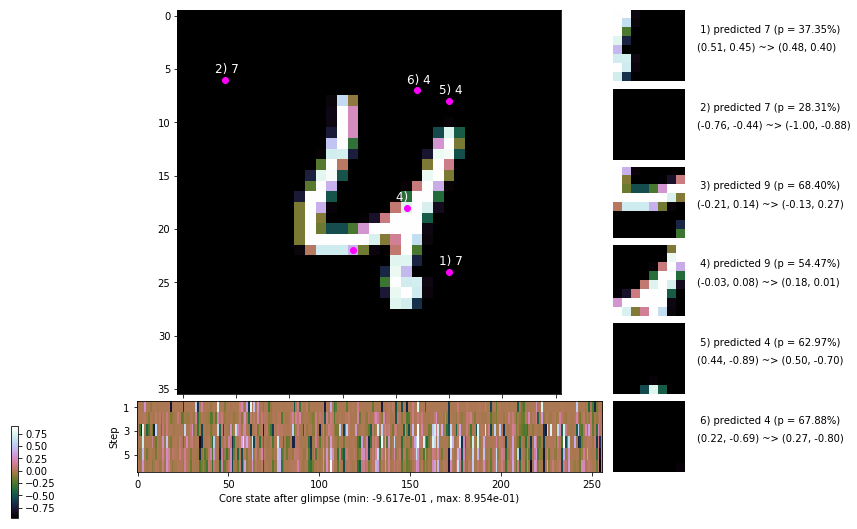

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 150.5 ms/b | lr: 6.43e-04 | grad 2norm: 14.98 | grad inf norm:  4.047
         Weights || abs max:  2.23 (48976.90) | mean: -8.24e-04 ( 0.10) | var: 6.14e-02 (1235279.62)
          Biases || abs max:  1.29 (  406.62) | mean: -1.18e-01 ( 0.21) | var: 7.48e-02 (  788.81)
                    class loss: 0.333 | steps: 2.269 | reward:  3.646 | acc.: 88.65%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 135.6 ms/b | lr: 6.42e-04 | grad 2norm: 15.27 | grad inf norm:  3.831
         Weights || abs max:  2.23 ( 2620.02) | mean: -7.97e-04 ( 0.01) | var: 6.15e-02 (  239.56)
          Biases || abs max:  1.29 (  431.53) | mean: -1.18e-01 ( 0.23) | var: 7.49e-02 ( 7359.09)
                    class loss: 0.358 | steps: 2.291 | reward:  3.598 | acc.: 88.17%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1

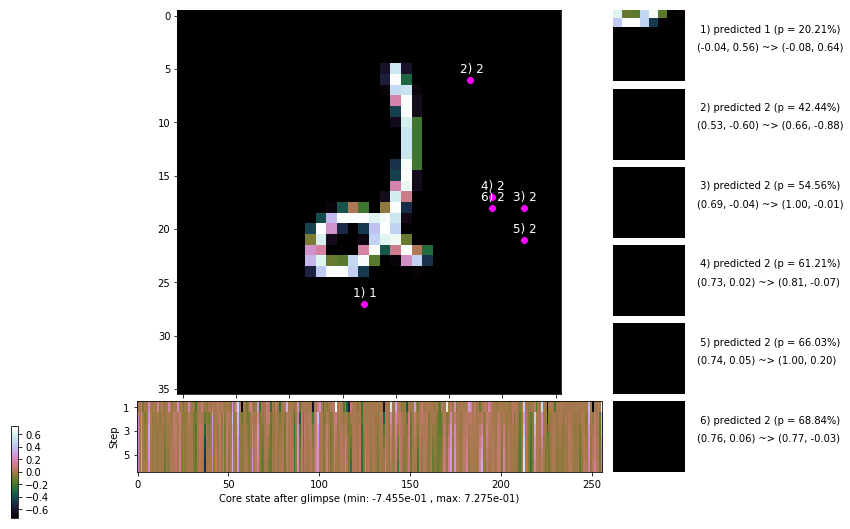

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 136.7 ms/b | lr: 6.41e-04 | grad 2norm: 14.91 | grad inf norm:  3.871
         Weights || abs max:  2.25 ( 3228.72) | mean: -8.18e-04 ( 0.01) | var: 6.16e-02 (  161.99)
          Biases || abs max:  1.29 (  277.25) | mean: -1.19e-01 ( 0.16) | var: 7.51e-02 ( 1863.19)
                    class loss: 0.332 | steps: 2.244 | reward:  3.669 | acc.: 88.87%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 146.3 ms/b | lr: 6.40e-04 | grad 2norm: 14.89 | grad inf norm:  3.835
         Weights || abs max:  2.25 (21690.08) | mean: -8.35e-04 ( 0.05) | var: 6.17e-02 (177160.39)
          Biases || abs max:  1.30 (  100.93) | mean: -1.18e-01 ( 0.09) | var: 7.52e-02 (  148.98)
                    class loss: 0.346 | steps: 2.267 | reward:  3.639 | acc.: 88.70%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.

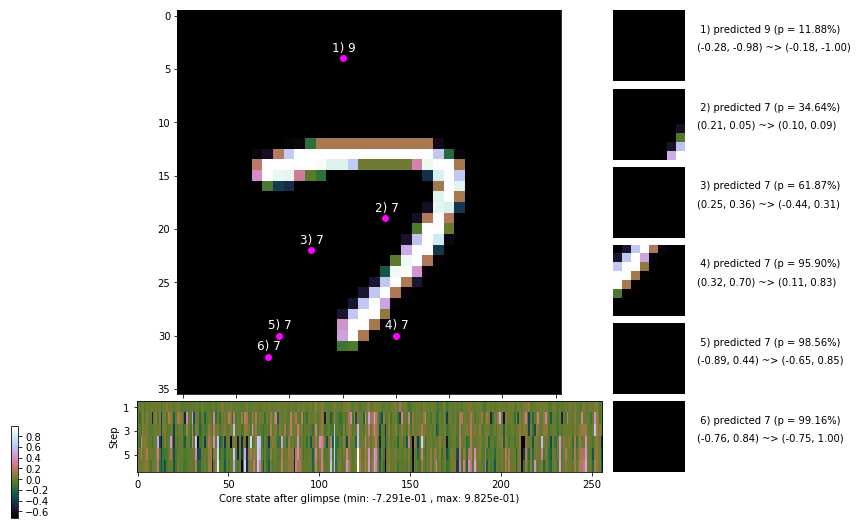

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 157.7 ms/b | lr: 6.39e-04 | grad 2norm: 15.07 | grad inf norm:  3.907
         Weights || abs max:  2.25 ( 4174.88) | mean: -8.34e-04 ( 0.01) | var: 6.18e-02 (  855.67)
          Biases || abs max:  1.31 ( 1137.98) | mean: -1.18e-01 ( 0.49) | var: 7.53e-02 (40522.90)
                    class loss: 0.355 | steps: 2.256 | reward:  3.641 | acc.: 88.27%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.4 ms/b | lr: 6.38e-04 | grad 2norm: 15.33 | grad inf norm:  4.114
         Weights || abs max:  2.23 ( 2199.08) | mean: -8.40e-04 ( 0.01) | var: 6.19e-02 (  131.66)
          Biases || abs max:  1.30 (  144.88) | mean: -1.19e-01 ( 0.11) | var: 7.53e-02 (   54.00)
                    class loss: 0.359 | steps: 2.272 | reward:  3.576 | acc.: 87.90%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

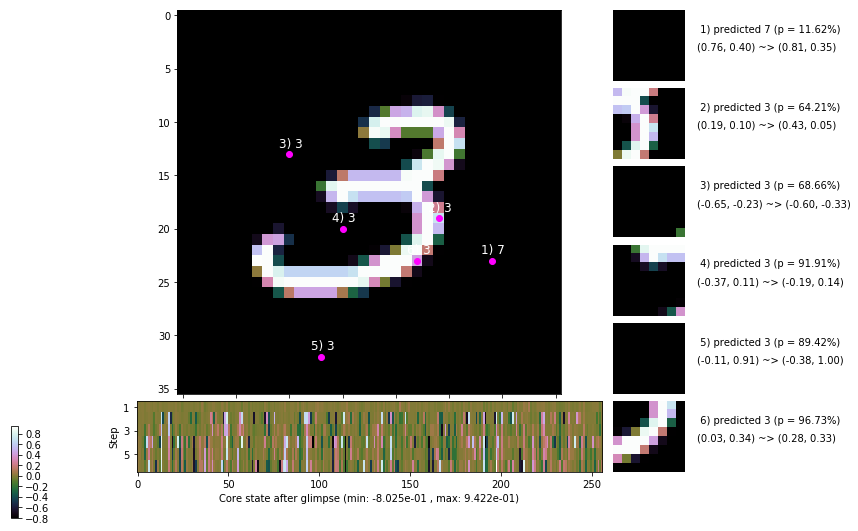

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


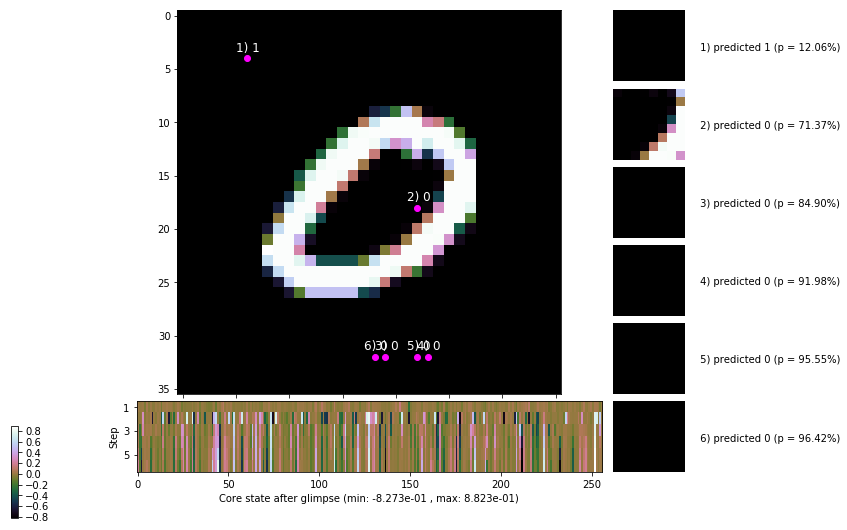


	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


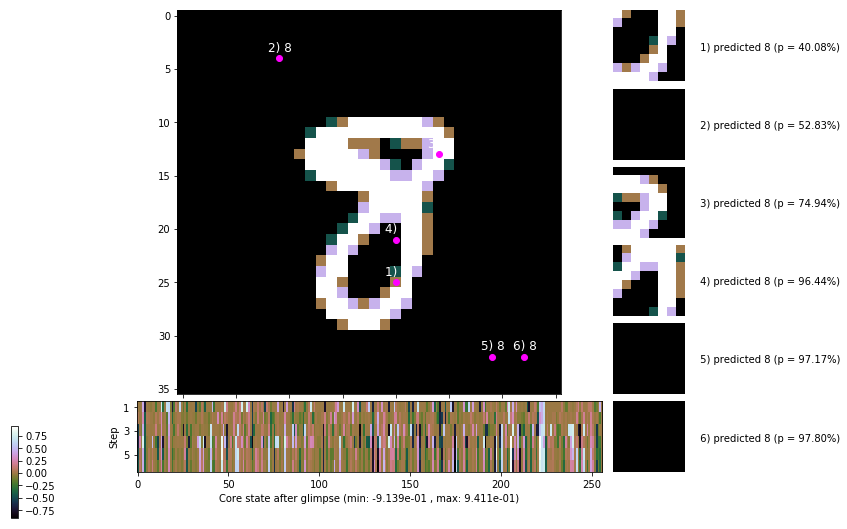

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


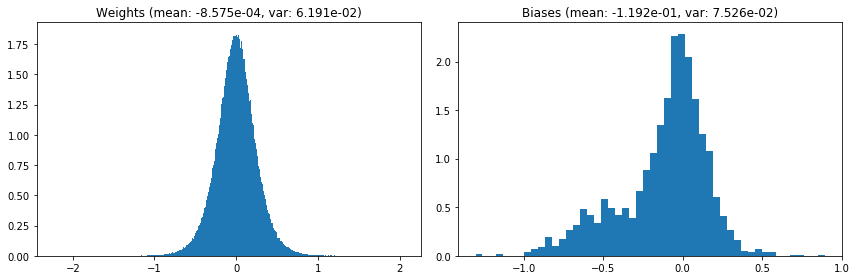

                                      Location network weights and biases


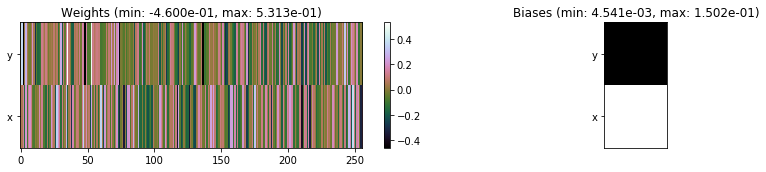

---------------------------------------------------------------------------------------------------------------
Elapsed time:  428.88 sec | TRAIN >> class loss: 0.3458 | steps:  2.269    | reward:  3.6378    | acc.: 88.505% 
                          | VAL   >> class loss: 0.3483 | steps:  2.173    | reward:  3.8070    | acc.: 88.640% :(


Epoch  31/400) lr = 0.0006375
 b    300/  3000 >> 161.6 ms/b | lr: 6.37e-04 | grad 2norm: 14.92 | grad inf norm:  3.949
         Weights || abs max:  2.23 ( 3216.64) | mean: -8.54e-04 ( 0.01) | var: 6.20e-02 (  225.60)
          Biases || abs max:  1.30 (  487.76) | mean: -1.19e-01 ( 0.25) | var: 7.54e-02 (11306.69)
                    class loss: 0.362 | steps: 2.283 | reward:  3.591 | acc.: 88.10%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 155.3 ms/b | lr: 6.36e-04 | grad 2norm: 14.72 | grad inf norm:  3.872
         Weights || abs max:  2.23 ( 5662.85) | mean: -8.56e-04 ( 0

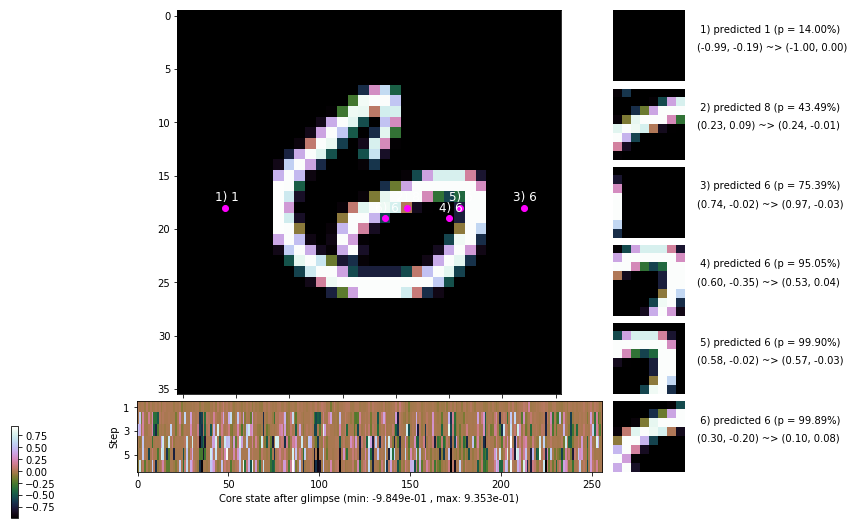

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.1 ms/b | lr: 6.35e-04 | grad 2norm: 14.87 | grad inf norm:  3.970
         Weights || abs max:  2.22 ( 3116.76) | mean: -8.39e-04 ( 0.01) | var: 6.22e-02 (  398.52)
          Biases || abs max:  1.30 (  158.55) | mean: -1.20e-01 ( 0.12) | var: 7.59e-02 (  146.21)
                    class loss: 0.347 | steps: 2.288 | reward:  3.608 | acc.: 88.20%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.6 ms/b | lr: 6.34e-04 | grad 2norm: 15.08 | grad inf norm:  3.981
         Weights || abs max:  2.23 ( 1836.56) | mean: -8.45e-04 ( 0.01) | var: 6.23e-02 (   47.84)
          Biases || abs max:  1.30 (   92.35) | mean: -1.20e-01 ( 0.09) | var: 7.61e-02 (   27.86)
                    class loss: 0.335 | steps: 2.253 | reward:  3.672 | acc.: 88.38%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

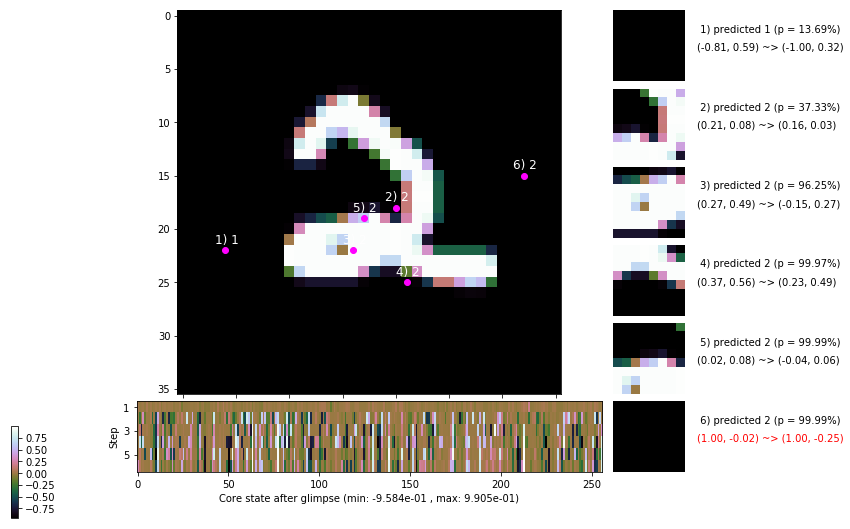

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.6 ms/b | lr: 6.33e-04 | grad 2norm: 14.80 | grad inf norm:  3.874
         Weights || abs max:  2.23 ( 4647.10) | mean: -8.39e-04 ( 0.02) | var: 6.24e-02 ( 2267.77)
          Biases || abs max:  1.30 (  514.33) | mean: -1.20e-01 ( 0.40) | var: 7.61e-02 (34804.61)
                    class loss: 0.337 | steps: 2.296 | reward:  3.641 | acc.: 88.70%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 156.9 ms/b | lr: 6.32e-04 | grad 2norm: 15.09 | grad inf norm:  3.988
         Weights || abs max:  2.23 ( 2430.62) | mean: -8.30e-04 ( 0.01) | var: 6.25e-02 (   87.84)
          Biases || abs max:  1.30 (  316.61) | mean: -1.20e-01 ( 0.18) | var: 7.62e-02 (  258.17)
                    class loss: 0.360 | steps: 2.281 | reward:  3.595 | acc.: 88.00%

	Target class: 5 | Discounted rewards: [-0.984, -0.969, -

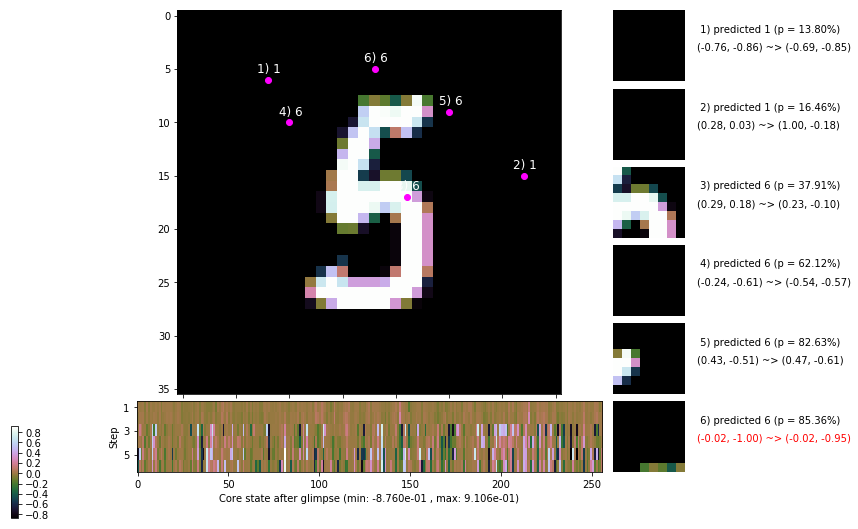

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 157.9 ms/b | lr: 6.31e-04 | grad 2norm: 15.01 | grad inf norm:  3.877
         Weights || abs max:  2.23 (14824.54) | mean: -8.54e-04 ( 0.03) | var: 6.26e-02 (45987.05)
          Biases || abs max:  1.29 (  851.34) | mean: -1.20e-01 ( 0.38) | var: 7.64e-02 (70863.66)
                    class loss: 0.350 | steps: 2.278 | reward:  3.621 | acc.: 88.25%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 162.9 ms/b | lr: 6.31e-04 | grad 2norm: 15.03 | grad inf norm:  4.057
         Weights || abs max:  2.24 ( 2564.20) | mean: -8.65e-04 ( 0.01) | var: 6.26e-02 (   96.96)
          Biases || abs max:  1.29 (   66.32) | mean: -1.20e-01 ( 0.07) | var: 7.66e-02 (   24.64)
                    class loss: 0.344 | steps: 2.260 | reward:  3.650 | acc.: 88.33%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

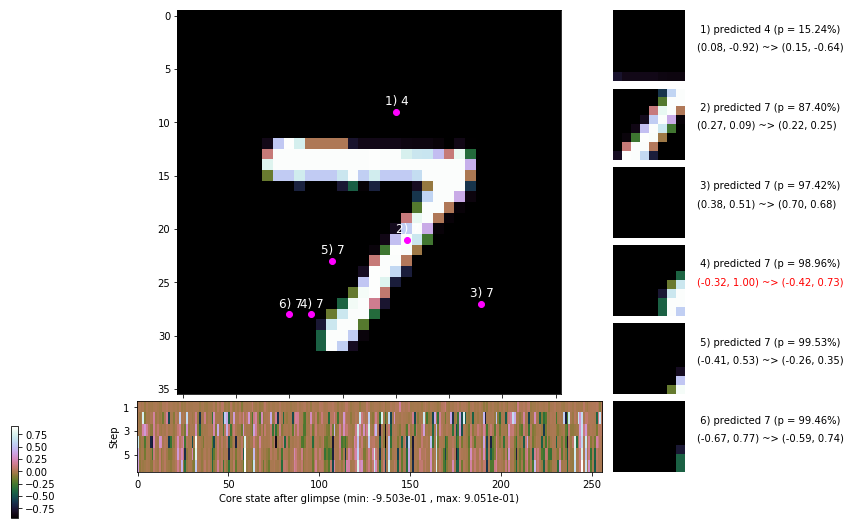

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 163.9 ms/b | lr: 6.29e-04 | grad 2norm: 14.97 | grad inf norm:  3.847
         Weights || abs max:  2.23 ( 2524.94) | mean: -8.86e-04 ( 0.01) | var: 6.27e-02 (  111.43)
          Biases || abs max:  1.29 (   67.34) | mean: -1.21e-01 ( 0.07) | var: 7.67e-02 (   63.35)
                    class loss: 0.344 | steps: 2.264 | reward:  3.648 | acc.: 88.23%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.8 ms/b | lr: 6.29e-04 | grad 2norm: 15.23 | grad inf norm:  4.047
         Weights || abs max:  2.24 ( 4712.23) | mean: -8.84e-04 ( 0.02) | var: 6.28e-02 ( 2772.65)
          Biases || abs max:  1.30 (   54.73) | mean: -1.21e-01 ( 0.06) | var: 7.68e-02 (    8.82)
                    class loss: 0.358 | steps: 2.293 | reward:  3.582 | acc.: 88.23%

	Target class: 8 | Discounted rewards: [-0.984, -0.969, -

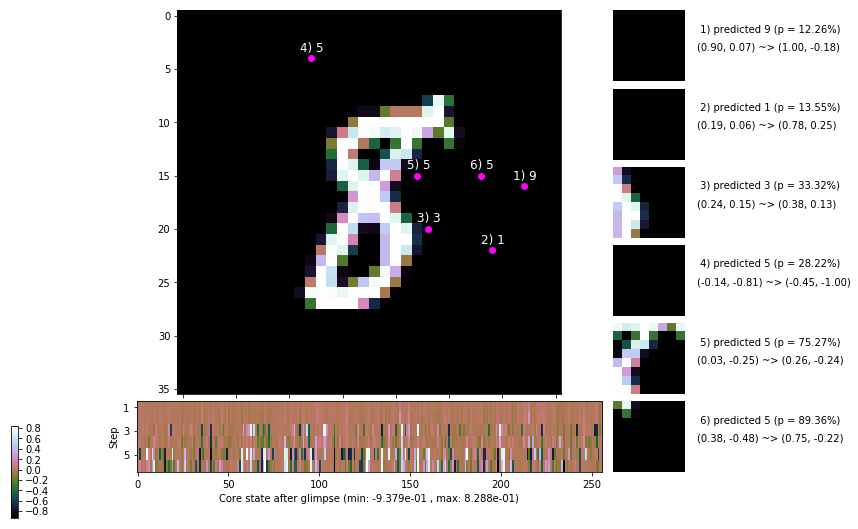

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.422, 1.844, 1.688, 1.375, 0.750, -0.500]


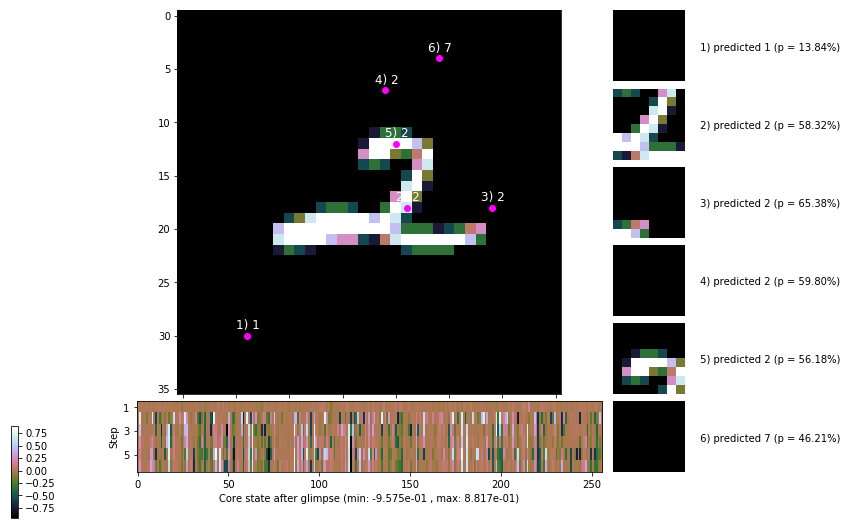


	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


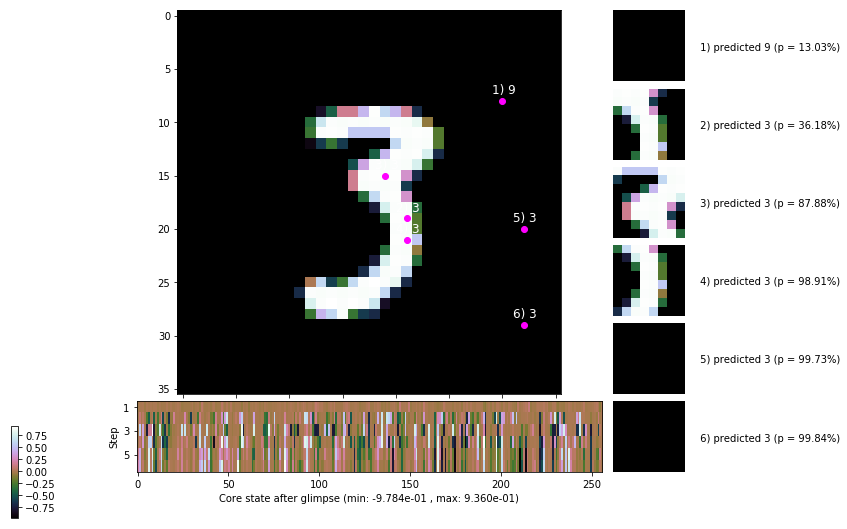

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


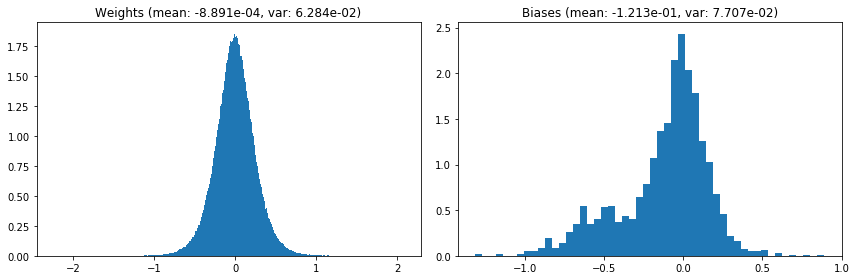

                                      Location network weights and biases


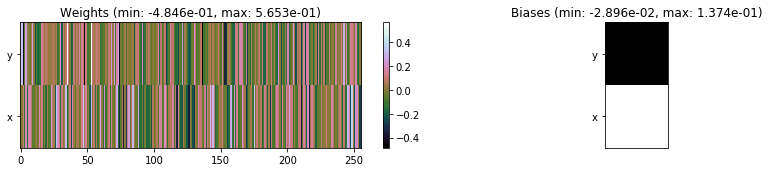

---------------------------------------------------------------------------------------------------------------
Elapsed time:  478.71 sec | TRAIN >> class loss: 0.3490 | steps:  2.276 :( | reward:  3.6254 :( | acc.: 88.305% :(
                          | VAL   >> class loss: 0.3241 | steps:  2.170    | reward:  3.8346    | acc.: 89.280% 


Epoch  32/400) lr = 0.000628
 b    300/  3000 >> 159.6 ms/b | lr: 6.27e-04 | grad 2norm: 15.04 | grad inf norm:  3.942
         Weights || abs max:  2.23 (38525.45) | mean: -8.72e-04 ( 0.08) | var: 6.29e-02 (732751.38)
          Biases || abs max:  1.30 (  176.63) | mean: -1.21e-01 ( 0.11) | var: 7.70e-02 ( 1279.06)
                    class loss: 0.348 | steps: 2.268 | reward:  3.637 | acc.: 88.68%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 159.7 ms/b | lr: 6.27e-04 | grad 2norm: 15.06 | grad inf norm:  3.798
         Weights || abs max:  2.24 ( 2598.14) | mean: -8.67e-04 ( 0

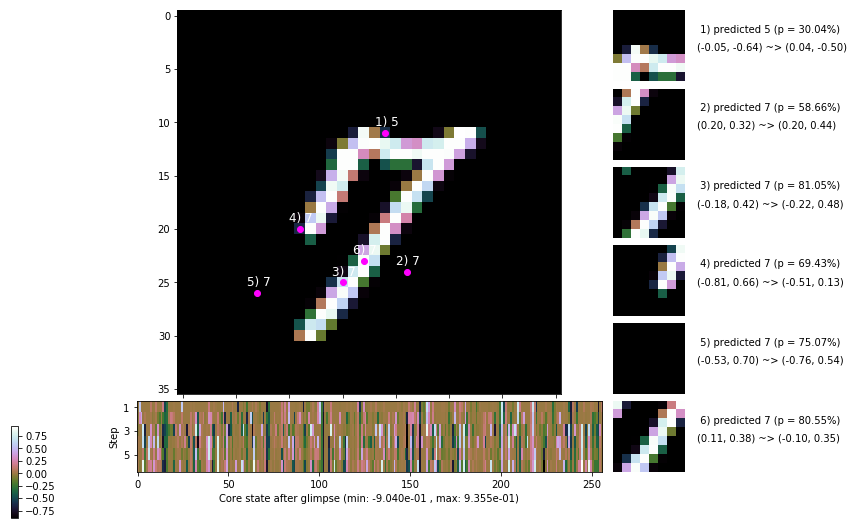

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.4 ms/b | lr: 6.25e-04 | grad 2norm: 15.01 | grad inf norm:  3.857
         Weights || abs max:  2.24 ( 4104.30) | mean: -8.40e-04 ( 0.02) | var: 6.31e-02 ( 2136.17)
          Biases || abs max:  1.31 (   69.75) | mean: -1.21e-01 ( 0.07) | var: 7.71e-02 (   11.83)
                    class loss: 0.359 | steps: 2.264 | reward:  3.641 | acc.: 88.03%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 160.3 ms/b | lr: 6.25e-04 | grad 2norm: 15.12 | grad inf norm:  3.927
         Weights || abs max:  2.24 ( 4894.05) | mean: -8.33e-04 ( 0.02) | var: 6.32e-02 ( 2311.37)
          Biases || abs max:  1.31 (   61.33) | mean: -1.21e-01 ( 0.07) | var: 7.71e-02 (   11.68)
                    class loss: 0.361 | steps: 2.253 | reward:  3.648 | acc.: 88.18%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

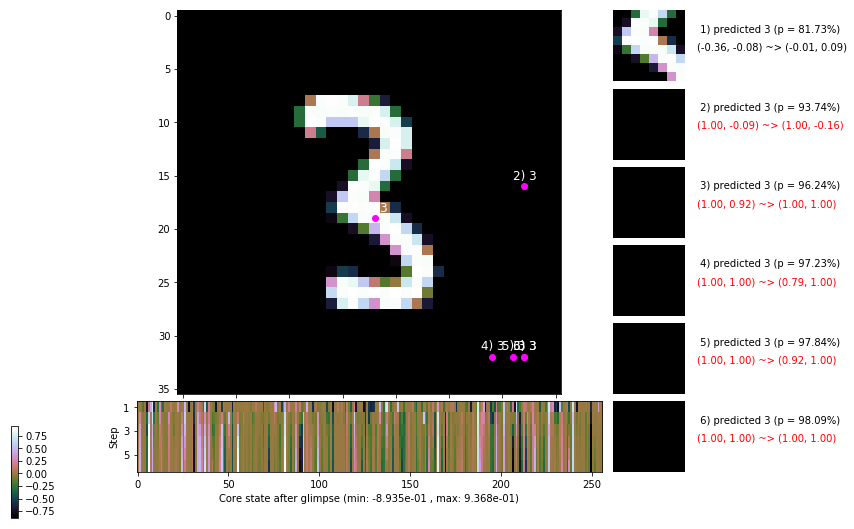

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.8 ms/b | lr: 6.24e-04 | grad 2norm: 15.77 | grad inf norm:  4.179
         Weights || abs max:  2.24 ( 5885.48) | mean: -8.60e-04 ( 0.02) | var: 6.33e-02 ( 3755.70)
          Biases || abs max:  1.30 (  104.68) | mean: -1.21e-01 ( 0.08) | var: 7.73e-02 (   52.01)
                    class loss: 0.399 | steps: 2.319 | reward:  3.525 | acc.: 86.63%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 147.3 ms/b | lr: 6.23e-04 | grad 2norm: 15.25 | grad inf norm:  4.056
         Weights || abs max:  2.23 ( 2597.96) | mean: -8.38e-04 ( 0.01) | var: 6.33e-02 (  128.32)
          Biases || abs max:  1.31 (  700.60) | mean: -1.21e-01 ( 0.55) | var: 7.75e-02 (50443.40)
                    class loss: 0.380 | steps: 2.294 | reward:  3.595 | acc.: 87.27%

	Target class: 7 | Discounted rewards: [-0.984, -0.969, -

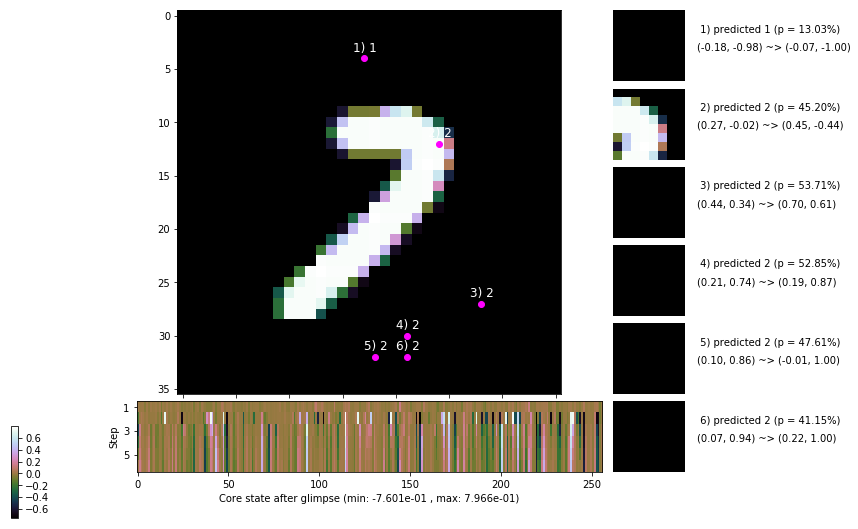

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.8 ms/b | lr: 6.22e-04 | grad 2norm: 15.22 | grad inf norm:  4.054
         Weights || abs max:  2.23 ( 6388.00) | mean: -8.18e-04 ( 0.02) | var: 6.34e-02 ( 4951.41)
          Biases || abs max:  1.30 (   44.95) | mean: -1.21e-01 ( 0.06) | var: 7.77e-02 (    7.47)
                    class loss: 0.381 | steps: 2.295 | reward:  3.572 | acc.: 86.72%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.9 ms/b | lr: 6.21e-04 | grad 2norm: 15.37 | grad inf norm:  4.265
         Weights || abs max:  2.23 ( 4434.92) | mean: -8.04e-04 ( 0.02) | var: 6.35e-02 ( 1271.23)
          Biases || abs max:  1.30 (   74.86) | mean: -1.21e-01 ( 0.08) | var: 7.78e-02 (   47.76)
                    class loss: 0.384 | steps: 2.291 | reward:  3.585 | acc.: 86.95%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

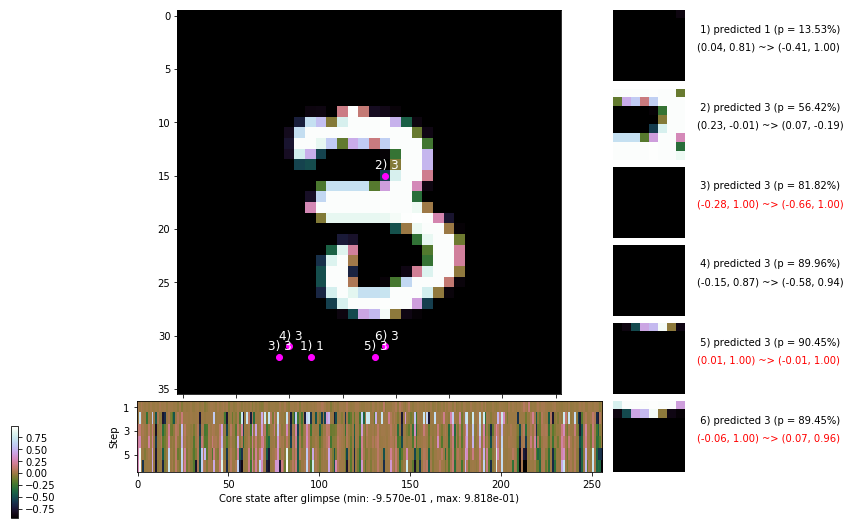

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 157.1 ms/b | lr: 6.20e-04 | grad 2norm: 15.28 | grad inf norm:  4.021
         Weights || abs max:  2.23 ( 4496.60) | mean: -8.30e-04 ( 0.02) | var: 6.36e-02 (  706.46)
          Biases || abs max:  1.30 (  104.22) | mean: -1.21e-01 ( 0.08) | var: 7.78e-02 (  249.89)
                    class loss: 0.381 | steps: 2.267 | reward:  3.592 | acc.: 87.07%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 163.1 ms/b | lr: 6.19e-04 | grad 2norm: 15.06 | grad inf norm:  4.255
         Weights || abs max:  2.24 ( 3981.14) | mean: -8.52e-04 ( 0.01) | var: 6.37e-02 ( 2298.70)
          Biases || abs max:  1.31 (   73.60) | mean: -1.21e-01 ( 0.07) | var: 7.81e-02 (   49.61)
                    class loss: 0.365 | steps: 2.278 | reward:  3.625 | acc.: 87.78%

	Target class: 2 | Discounted rewards: [1.219, 0.438, 1.8

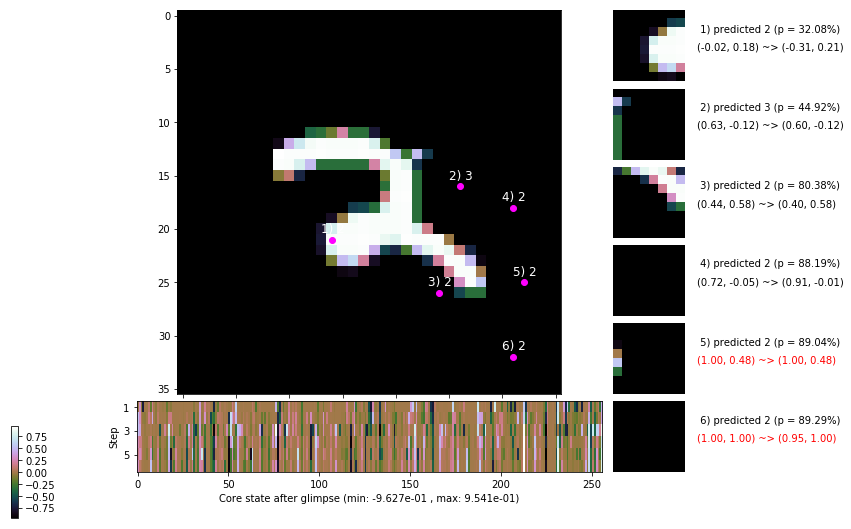

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


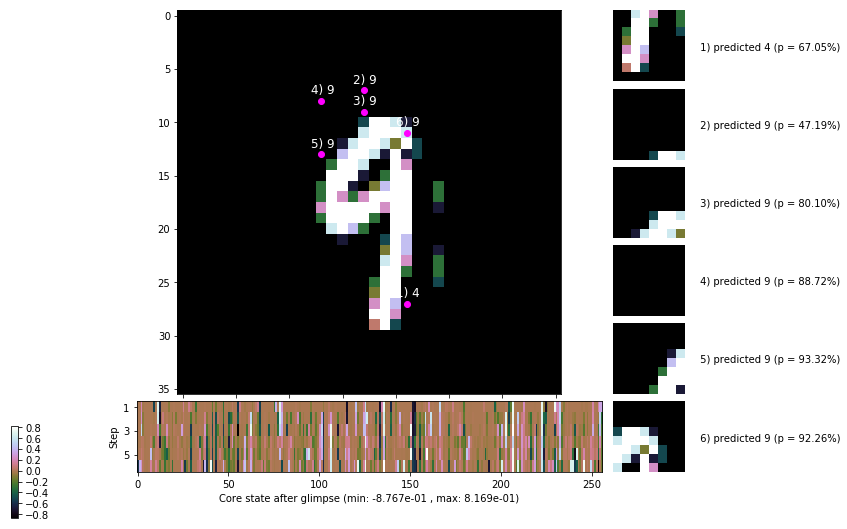


	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


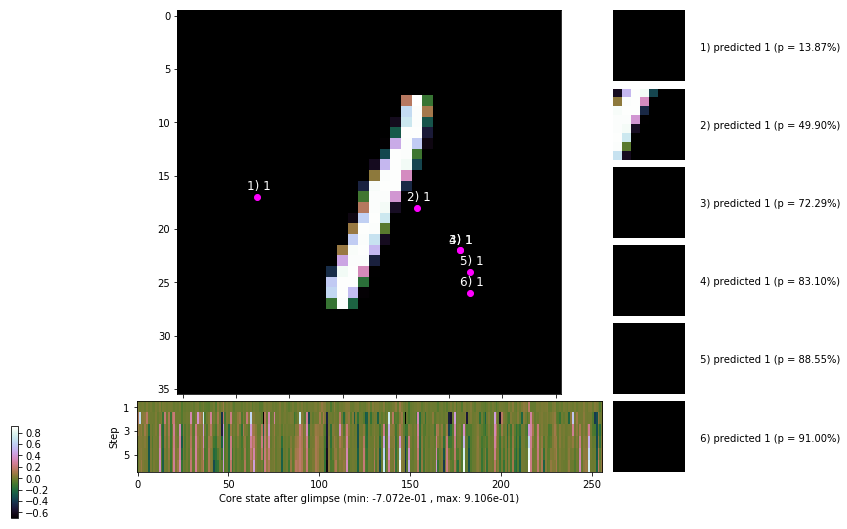

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


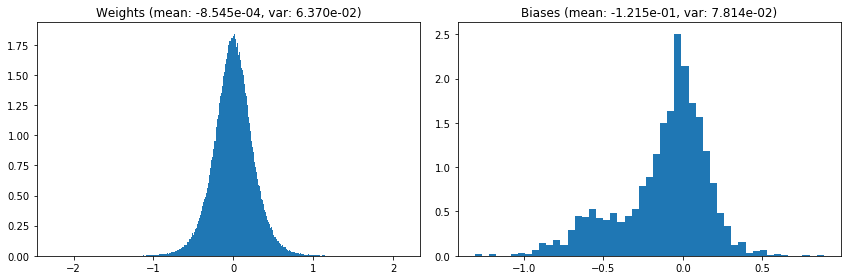

                                      Location network weights and biases


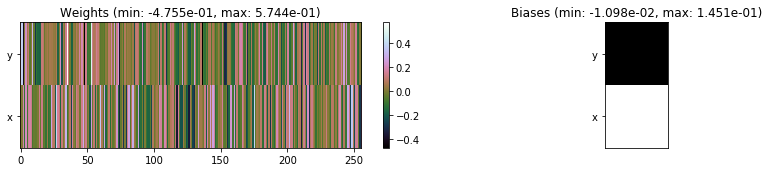

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.48 sec | TRAIN >> class loss: 0.3701 | steps:  2.278 :( | reward:  3.6077 :( | acc.: 87.582% :(
                          | VAL   >> class loss: 0.3424 | steps:  2.172 :( | reward:  3.8190 :( | acc.: 88.500% :(


Epoch  33/400) lr = 0.0006186
 b    300/  3000 >> 166.8 ms/b | lr: 6.18e-04 | grad 2norm: 14.86 | grad inf norm:  4.134
         Weights || abs max:  2.24 ( 3943.83) | mean: -8.29e-04 ( 0.02) | var: 6.38e-02 (  413.85)
          Biases || abs max:  1.30 (  161.64) | mean: -1.21e-01 ( 0.12) | var: 7.81e-02 (  110.82)
                    class loss: 0.368 | steps: 2.270 | reward:  3.631 | acc.: 87.67%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 162.1 ms/b | lr: 6.17e-04 | grad 2norm: 14.75 | grad inf norm:  3.943
         Weights || abs max:  2.24 ( 3803.70) | mean: -8.10e-04 (

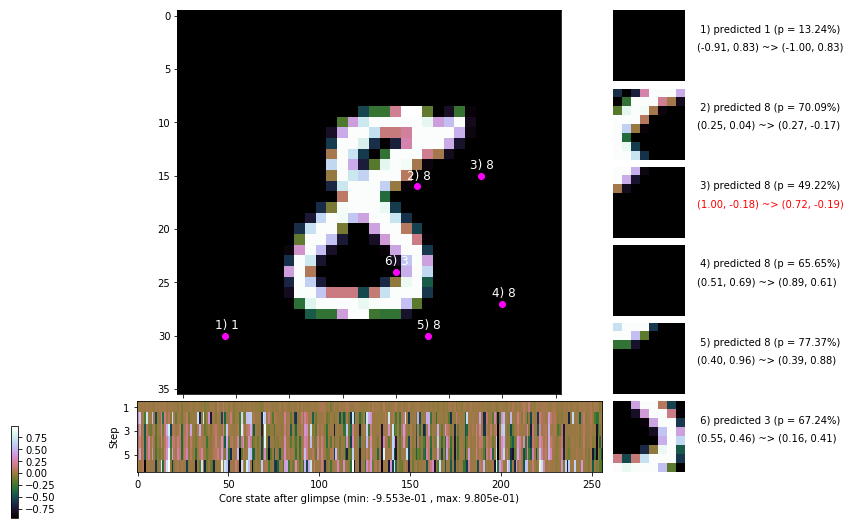

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 164.3 ms/b | lr: 6.16e-04 | grad 2norm: 15.13 | grad inf norm:  3.984
         Weights || abs max:  2.23 ( 4432.19) | mean: -7.70e-04 ( 0.02) | var: 6.40e-02 ( 1534.70)
          Biases || abs max:  1.29 (  126.79) | mean: -1.20e-01 ( 0.10) | var: 7.80e-02 (  148.68)
                    class loss: 0.354 | steps: 2.286 | reward:  3.607 | acc.: 87.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.5 ms/b | lr: 6.16e-04 | grad 2norm: 15.23 | grad inf norm:  4.216
         Weights || abs max:  2.23 ( 3345.80) | mean: -7.54e-04 ( 0.01) | var: 6.40e-02 ( 1129.33)
          Biases || abs max:  1.29 (  120.80) | mean: -1.21e-01 ( 0.10) | var: 7.84e-02 (   92.36)
                    class loss: 0.383 | steps: 2.302 | reward:  3.582 | acc.: 87.30%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

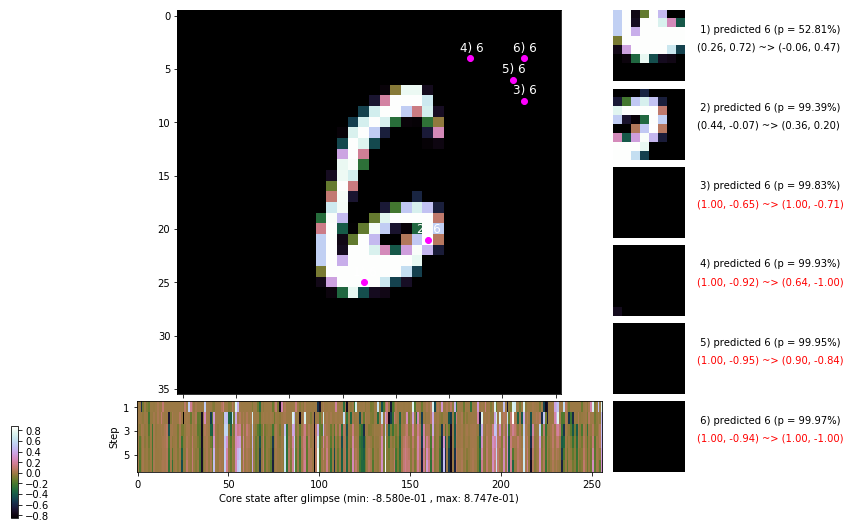

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.6 ms/b | lr: 6.14e-04 | grad 2norm: 15.16 | grad inf norm:  4.059
         Weights || abs max:  2.23 ( 5301.68) | mean: -7.73e-04 ( 0.02) | var: 6.41e-02 ( 4784.13)
          Biases || abs max:  1.29 (  165.37) | mean: -1.21e-01 ( 0.11) | var: 7.84e-02 (  101.76)
                    class loss: 0.364 | steps: 2.294 | reward:  3.597 | acc.: 87.68%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.1 ms/b | lr: 6.14e-04 | grad 2norm: 15.31 | grad inf norm:  4.052
         Weights || abs max:  2.23 ( 1406.39) | mean: -7.72e-04 ( 0.01) | var: 6.42e-02 (   24.99)
          Biases || abs max:  1.29 (  188.28) | mean: -1.21e-01 ( 0.13) | var: 7.85e-02 (   63.45)
                    class loss: 0.370 | steps: 2.290 | reward:  3.586 | acc.: 87.37%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

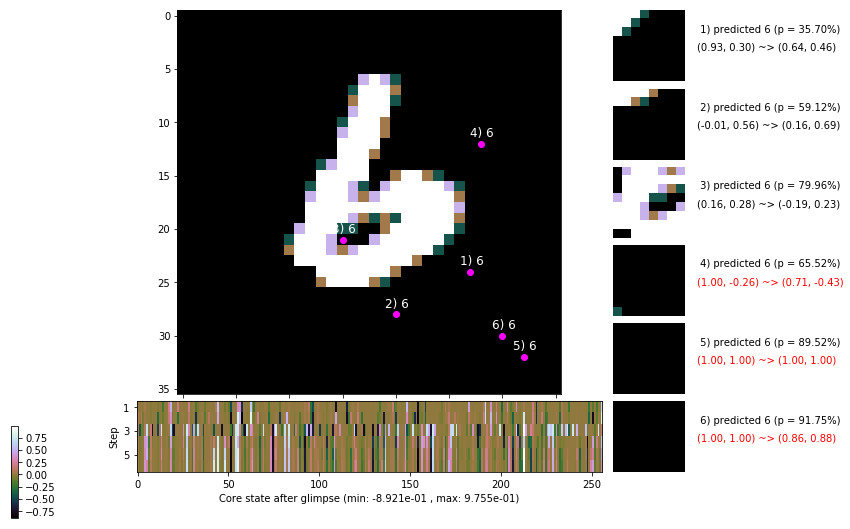

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.1 ms/b | lr: 6.12e-04 | grad 2norm: 15.26 | grad inf norm:  4.113
         Weights || abs max:  2.23 ( 7533.78) | mean: -7.46e-04 ( 0.02) | var: 6.43e-02 (10306.07)
          Biases || abs max:  1.29 (  247.57) | mean: -1.21e-01 ( 0.15) | var: 7.85e-02 ( 1069.99)
                    class loss: 0.375 | steps: 2.314 | reward:  3.561 | acc.: 87.57%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 163.8 ms/b | lr: 6.12e-04 | grad 2norm: 15.04 | grad inf norm:  3.945
         Weights || abs max:  2.23 ( 4134.02) | mean: -7.46e-04 ( 0.02) | var: 6.43e-02 (  550.09)
          Biases || abs max:  1.29 (   56.58) | mean: -1.22e-01 ( 0.07) | var: 7.85e-02 (    7.05)
                    class loss: 0.367 | steps: 2.306 | reward:  3.566 | acc.: 87.67%

	Target class: 4 | Discounted rewards: [-0.656, -0.312, 0

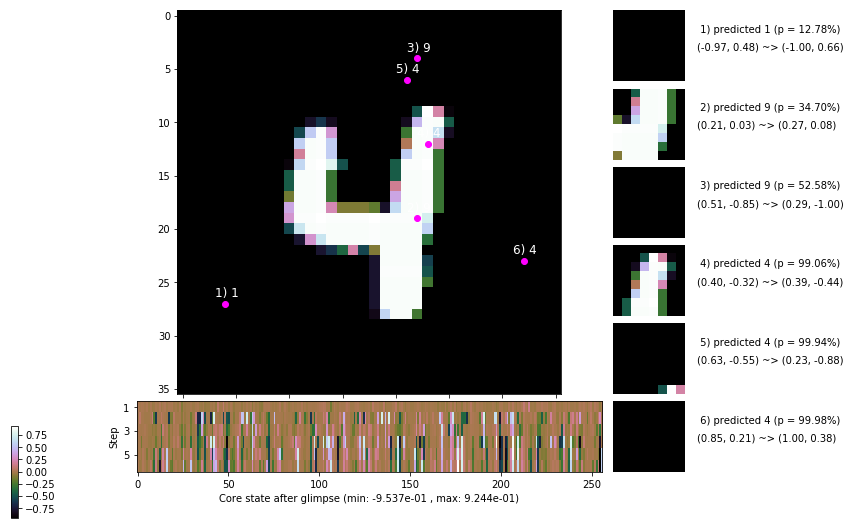

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 156.7 ms/b | lr: 6.11e-04 | grad 2norm: 14.72 | grad inf norm:  3.886
         Weights || abs max:  2.24 ( 3045.65) | mean: -7.40e-04 ( 0.01) | var: 6.44e-02 (  203.68)
          Biases || abs max:  1.29 (  119.33) | mean: -1.21e-01 ( 0.09) | var: 7.83e-02 (  165.21)
                    class loss: 0.349 | steps: 2.269 | reward:  3.665 | acc.: 88.30%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.4 ms/b | lr: 6.10e-04 | grad 2norm: 14.89 | grad inf norm:  3.975
         Weights || abs max:  2.24 (17832.24) | mean: -7.53e-04 ( 0.04) | var: 6.45e-02 (137835.94)
          Biases || abs max:  1.30 (   87.26) | mean: -1.21e-01 ( 0.08) | var: 7.84e-02 (  130.49)
                    class loss: 0.356 | steps: 2.274 | reward:  3.630 | acc.: 88.07%

	Target class: 6 | Discounted rewards: [-0.281, 0.438, 1

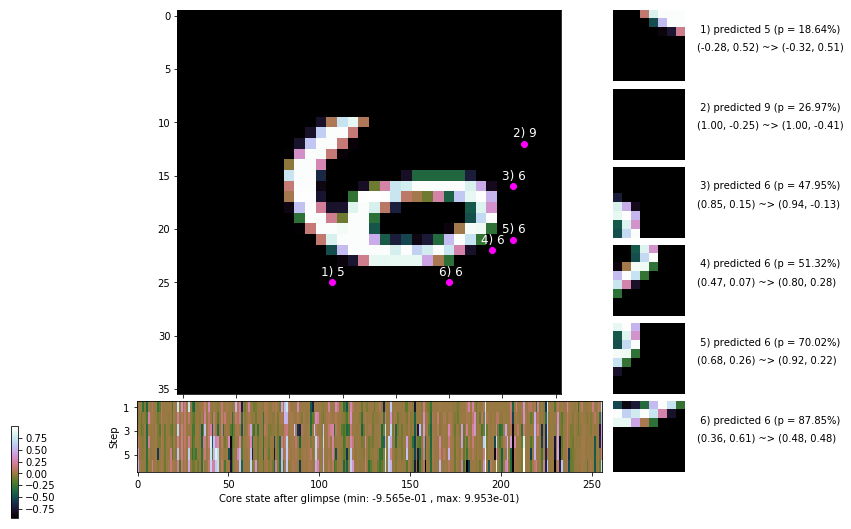

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


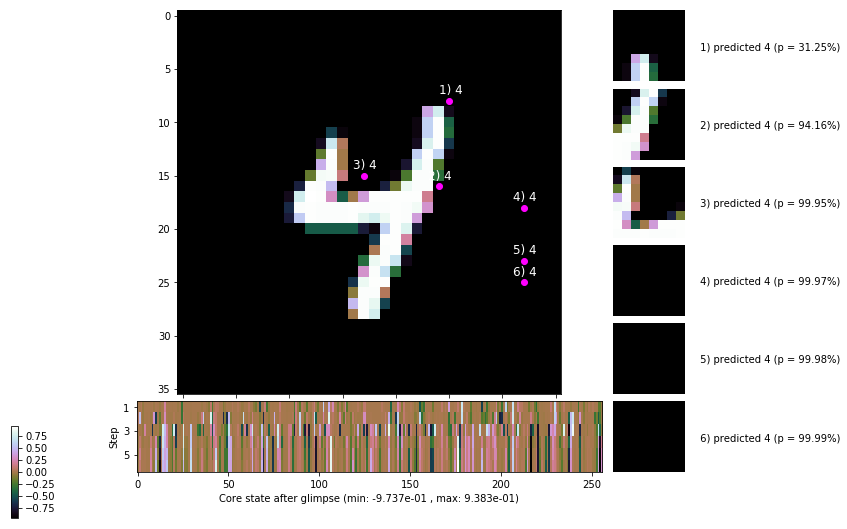


	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


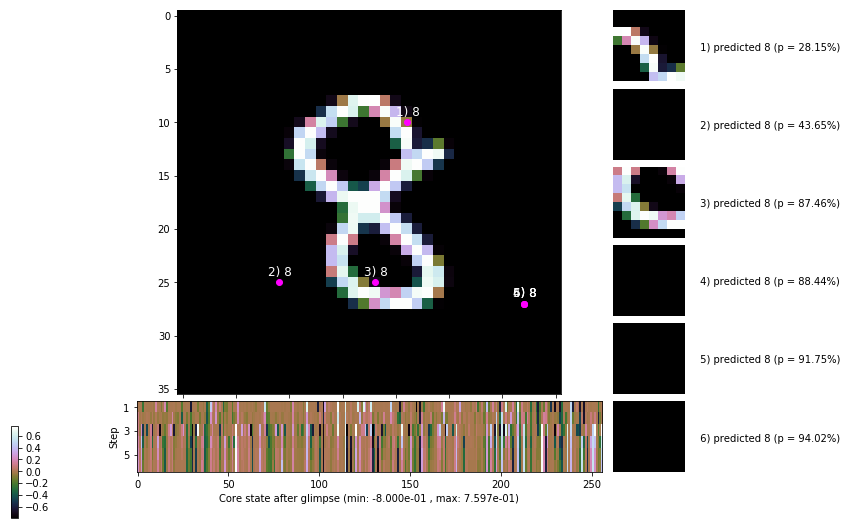

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


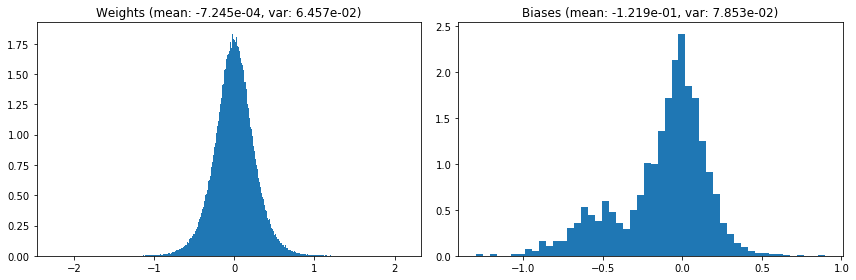

                                      Location network weights and biases


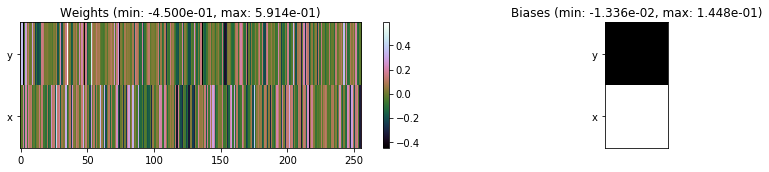

---------------------------------------------------------------------------------------------------------------
Elapsed time:  479.27 sec | TRAIN >> class loss: 0.3642 | steps:  2.286 :( | reward:  3.6094 :( | acc.: 87.797% :(
                          | VAL   >> class loss: 0.3656 | steps:  2.199 :( | reward:  3.7497 :( | acc.: 87.340% :(


Epoch  34/400) lr = 0.0006094
 b    300/  3000 >> 157.2 ms/b | lr: 6.09e-04 | grad 2norm: 14.97 | grad inf norm:  3.951
         Weights || abs max:  2.24 ( 2549.48) | mean: -7.44e-04 ( 0.01) | var: 6.46e-02 (  160.31)
          Biases || abs max:  1.30 (   75.13) | mean: -1.22e-01 ( 0.07) | var: 7.86e-02 (   45.49)
                    class loss: 0.388 | steps: 2.303 | reward:  3.572 | acc.: 87.03%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.3 ms/b | lr: 6.08e-04 | grad 2norm: 14.70 | grad inf norm:  4.063
         Weights || abs max:  2.26 ( 4791.85) | mean: -7.54e-04 (

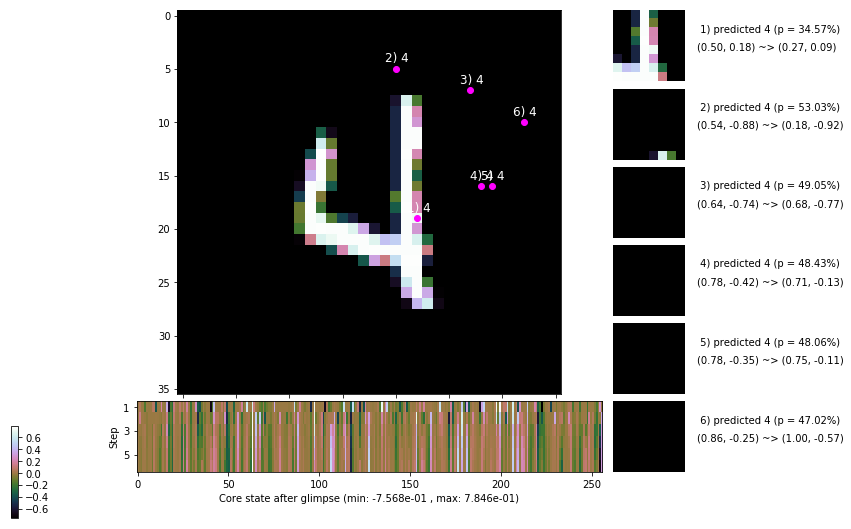

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 147.1 ms/b | lr: 6.07e-04 | grad 2norm: 15.06 | grad inf norm:  4.002
         Weights || abs max:  2.26 ( 3477.93) | mean: -7.67e-04 ( 0.01) | var: 6.48e-02 (  582.15)
          Biases || abs max:  1.31 (   66.93) | mean: -1.22e-01 ( 0.07) | var: 7.90e-02 (   12.39)
                    class loss: 0.359 | steps: 2.282 | reward:  3.621 | acc.: 87.90%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 146.9 ms/b | lr: 6.06e-04 | grad 2norm: 15.02 | grad inf norm:  4.119
         Weights || abs max:  2.26 ( 6406.00) | mean: -7.79e-04 ( 0.02) | var: 6.49e-02 ( 4616.57)
          Biases || abs max:  1.31 (  167.05) | mean: -1.22e-01 ( 0.11) | var: 7.92e-02 (  172.88)
                    class loss: 0.359 | steps: 2.243 | reward:  3.654 | acc.: 87.98%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

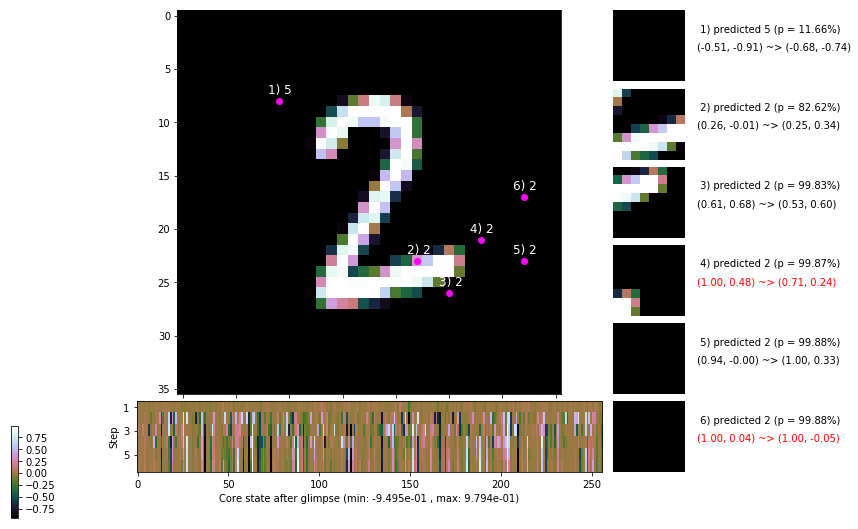

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.3 ms/b | lr: 6.05e-04 | grad 2norm: 15.38 | grad inf norm:  4.230
         Weights || abs max:  2.26 ( 4366.71) | mean: -7.59e-04 ( 0.02) | var: 6.49e-02 ( 3290.74)
          Biases || abs max:  1.31 (  312.91) | mean: -1.22e-01 ( 0.17) | var: 7.93e-02 (  357.68)
                    class loss: 0.394 | steps: 2.318 | reward:  3.556 | acc.: 86.75%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 149.4 ms/b | lr: 6.05e-04 | grad 2norm: 14.91 | grad inf norm:  3.912
         Weights || abs max:  2.28 ( 4290.22) | mean: -7.50e-04 ( 0.02) | var: 6.50e-02 ( 2938.81)
          Biases || abs max:  1.31 (  447.85) | mean: -1.22e-01 ( 0.23) | var: 7.92e-02 ( 1017.07)
                    class loss: 0.351 | steps: 2.280 | reward:  3.615 | acc.: 88.08%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

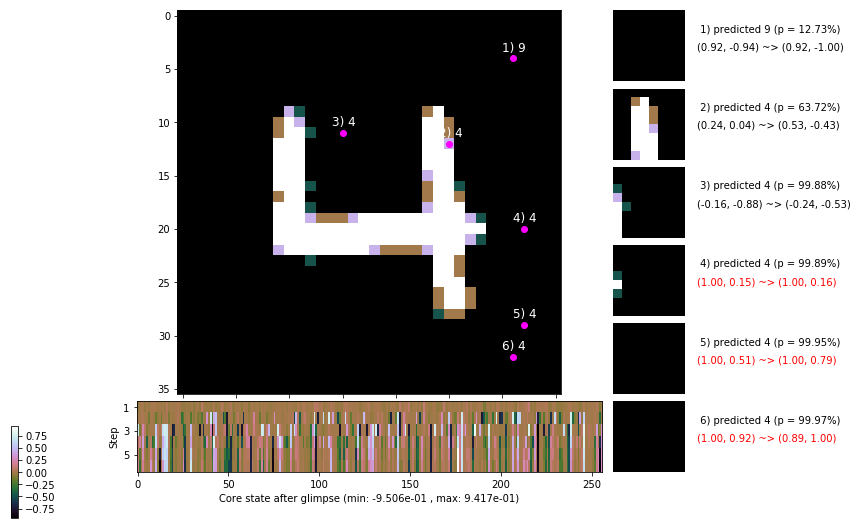

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.2 ms/b | lr: 6.03e-04 | grad 2norm: 14.89 | grad inf norm:  3.858
         Weights || abs max:  2.28 ( 3376.91) | mean: -7.23e-04 ( 0.01) | var: 6.51e-02 (  406.89)
          Biases || abs max:  1.31 (  293.74) | mean: -1.22e-01 ( 0.17) | var: 7.94e-02 (  826.27)
                    class loss: 0.374 | steps: 2.273 | reward:  3.628 | acc.: 87.63%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.7 ms/b | lr: 6.03e-04 | grad 2norm: 14.89 | grad inf norm:  4.110
         Weights || abs max:  2.27 ( 4489.63) | mean: -7.18e-04 ( 0.02) | var: 6.52e-02 ( 2638.43)
          Biases || abs max:  1.32 (  245.03) | mean: -1.23e-01 ( 0.15) | var: 7.97e-02 (  109.29)
                    class loss: 0.376 | steps: 2.282 | reward:  3.612 | acc.: 87.62%

	Target class: 7 | Discounted rewards: [-0.656, -0.312, 0

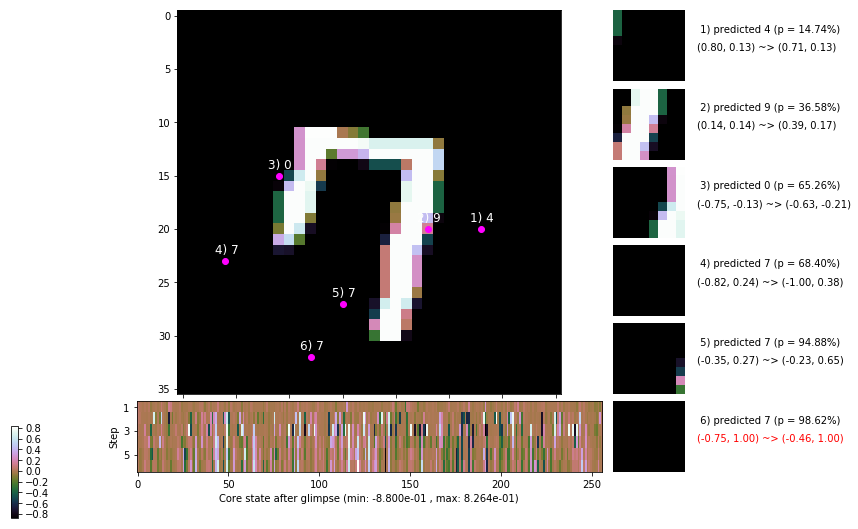

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 164.8 ms/b | lr: 6.02e-04 | grad 2norm: 14.85 | grad inf norm:  4.021
         Weights || abs max:  2.28 ( 4549.73) | mean: -7.21e-04 ( 0.02) | var: 6.53e-02 ( 1934.61)
          Biases || abs max:  1.33 (  828.35) | mean: -1.22e-01 ( 0.38) | var: 7.97e-02 ( 7925.21)
                    class loss: 0.367 | steps: 2.262 | reward:  3.632 | acc.: 87.12%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.2 ms/b | lr: 6.01e-04 | grad 2norm: 14.66 | grad inf norm:  4.017
         Weights || abs max:  2.28 ( 3492.09) | mean: -7.28e-04 ( 0.01) | var: 6.54e-02 (  522.27)
          Biases || abs max:  1.33 (  393.92) | mean: -1.22e-01 ( 0.20) | var: 7.98e-02 ( 2450.10)
                    class loss: 0.360 | steps: 2.291 | reward:  3.621 | acc.: 87.95%

	Target class: 4 | Discounted rewards: [-0.984, -0.969, -

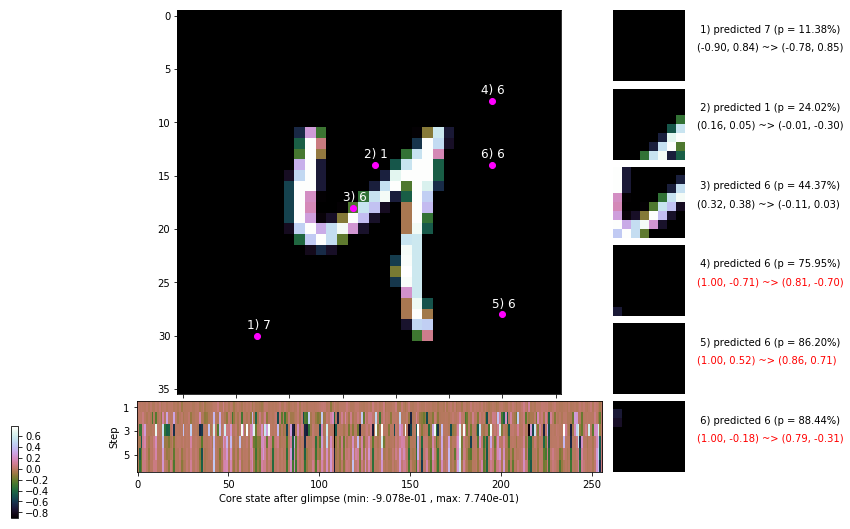

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [-0.656, -0.312, 0.375, 1.750, 1.500, 1.000]


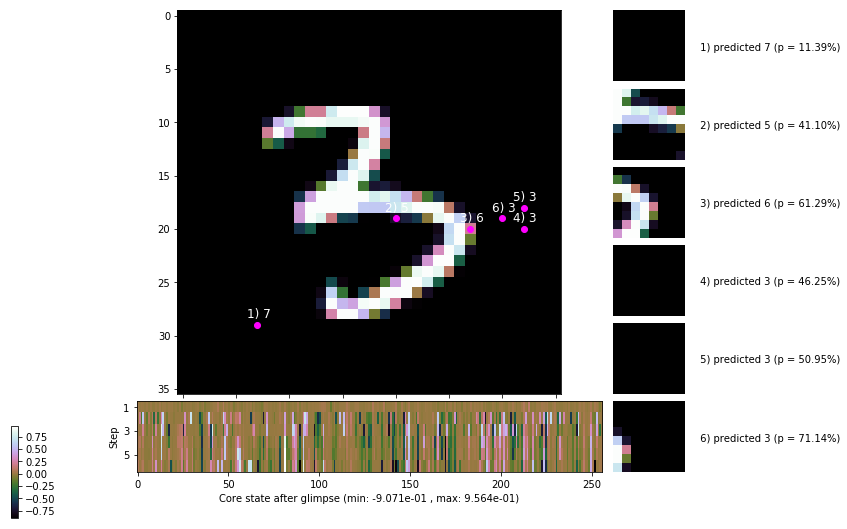


	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


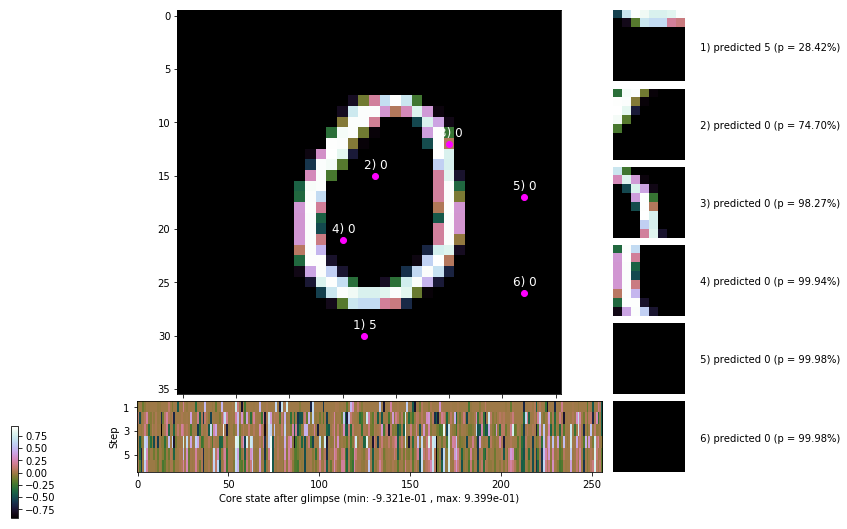

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


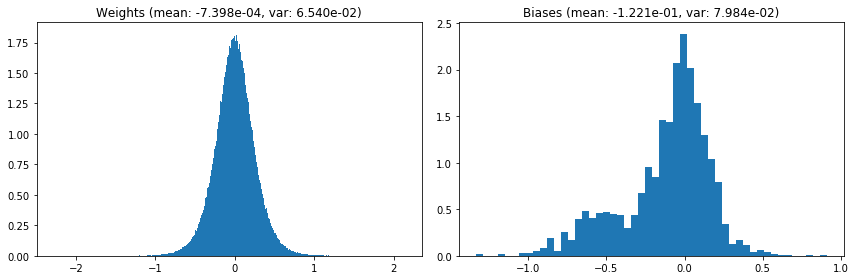

                                      Location network weights and biases


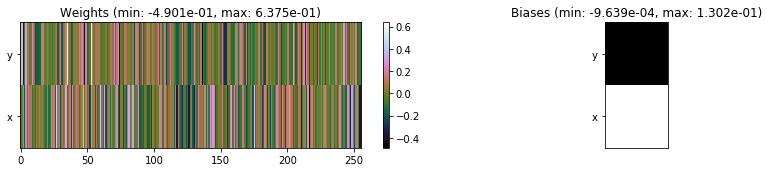

---------------------------------------------------------------------------------------------------------------
Elapsed time:  458.31 sec | TRAIN >> class loss: 0.3689 | steps:  2.281 :( | reward:  3.6129 :( | acc.: 87.605% :(
                          | VAL   >> class loss: 0.3633 | steps:  2.170 :( | reward:  3.7800 :( | acc.: 87.640% :(


Epoch  35/400) lr = 0.0006003
 b    300/  3000 >> 156.3 ms/b | lr: 6.00e-04 | grad 2norm: 14.83 | grad inf norm:  4.044
         Weights || abs max:  2.27 ( 2980.78) | mean: -7.40e-04 ( 0.01) | var: 6.54e-02 (  306.17)
          Biases || abs max:  1.33 (  166.15) | mean: -1.22e-01 ( 0.12) | var: 7.99e-02 (  160.39)
                    class loss: 0.369 | steps: 2.276 | reward:  3.588 | acc.: 87.57%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.4 ms/b | lr: 5.99e-04 | grad 2norm: 14.74 | grad inf norm:  3.994
         Weights || abs max:  2.28 ( 3213.12) | mean: -7.33e-04 (

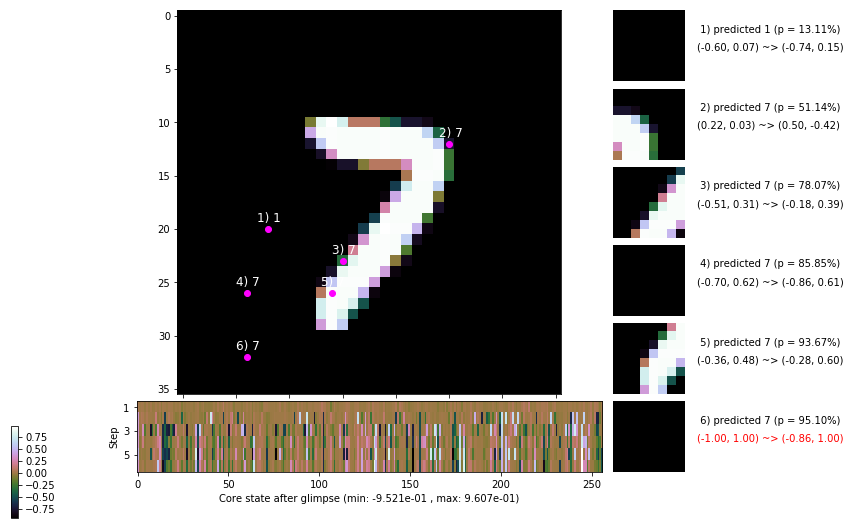

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 156.6 ms/b | lr: 5.98e-04 | grad 2norm: 14.93 | grad inf norm:  4.034
         Weights || abs max:  2.27 ( 3245.46) | mean: -7.44e-04 ( 0.01) | var: 6.56e-02 (  363.11)
          Biases || abs max:  1.34 (   50.44) | mean: -1.23e-01 ( 0.07) | var: 8.02e-02 (    8.53)
                    class loss: 0.377 | steps: 2.296 | reward:  3.579 | acc.: 87.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 150.4 ms/b | lr: 5.97e-04 | grad 2norm: 14.71 | grad inf norm:  4.057
         Weights || abs max:  2.27 (21018.23) | mean: -7.39e-04 ( 0.05) | var: 6.57e-02 (197313.91)
          Biases || abs max:  1.33 (   54.12) | mean: -1.23e-01 ( 0.07) | var: 8.02e-02 (    5.86)
                    class loss: 0.363 | steps: 2.276 | reward:  3.618 | acc.: 87.98%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.

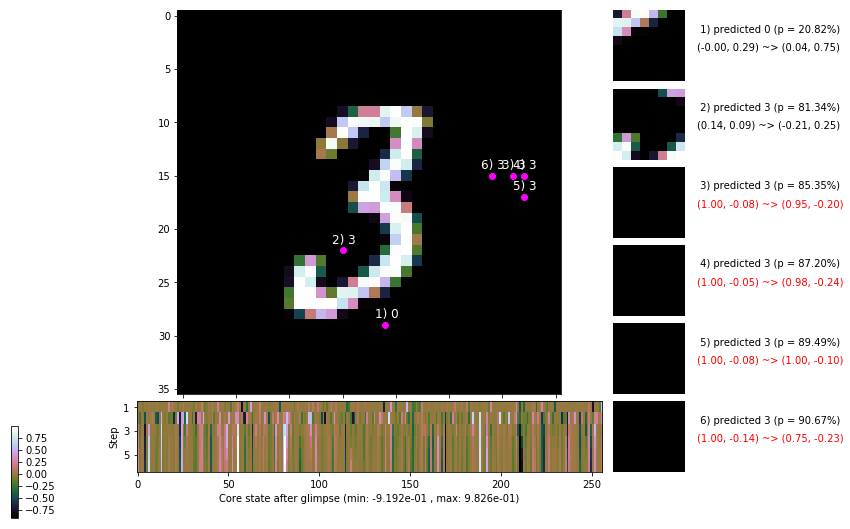

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 165.6 ms/b | lr: 5.96e-04 | grad 2norm: 14.61 | grad inf norm:  3.994
         Weights || abs max:  2.27 ( 2639.72) | mean: -7.44e-04 ( 0.01) | var: 6.58e-02 (  102.01)
          Biases || abs max:  1.33 (   89.25) | mean: -1.23e-01 ( 0.09) | var: 8.02e-02 (   65.44)
                    class loss: 0.373 | steps: 2.272 | reward:  3.629 | acc.: 87.58%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.5 ms/b | lr: 5.96e-04 | grad 2norm: 15.03 | grad inf norm:  4.100
         Weights || abs max:  2.28 ( 2762.06) | mean: -7.45e-04 ( 0.01) | var: 6.59e-02 (  146.27)
          Biases || abs max:  1.32 ( 1004.82) | mean: -1.24e-01 ( 0.45) | var: 8.04e-02 (40767.69)
                    class loss: 0.376 | steps: 2.290 | reward:  3.559 | acc.: 87.07%

	Target class: 4 | Discounted rewards: [-0.984, -0.969, -

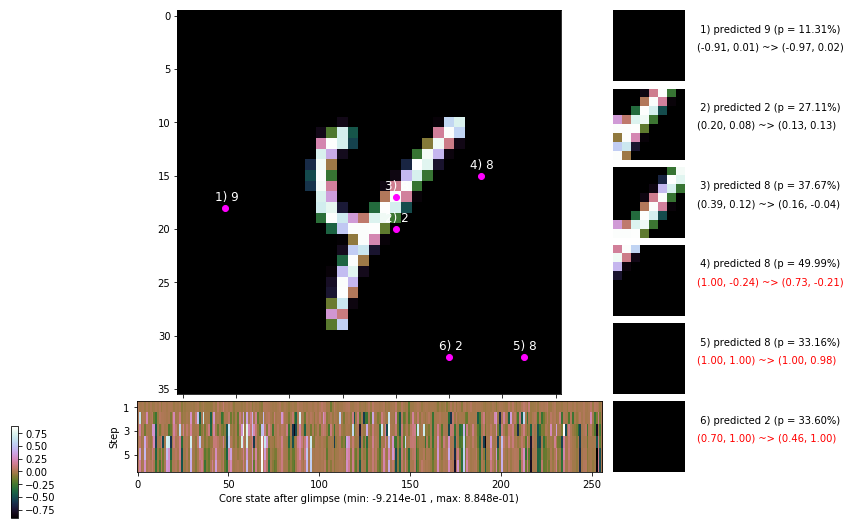

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.0 ms/b | lr: 5.94e-04 | grad 2norm: 15.09 | grad inf norm:  3.893
         Weights || abs max:  2.29 ( 3597.26) | mean: -7.28e-04 ( 0.01) | var: 6.59e-02 (  410.31)
          Biases || abs max:  1.33 (   98.17) | mean: -1.24e-01 ( 0.10) | var: 8.06e-02 (   39.13)
                    class loss: 0.376 | steps: 2.286 | reward:  3.578 | acc.: 86.93%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 148.2 ms/b | lr: 5.94e-04 | grad 2norm: 14.84 | grad inf norm:  3.902
         Weights || abs max:  2.28 ( 2830.46) | mean: -7.59e-04 ( 0.01) | var: 6.60e-02 (  193.25)
          Biases || abs max:  1.33 (  486.85) | mean: -1.23e-01 ( 0.25) | var: 8.07e-02 ( 1229.37)
                    class loss: 0.381 | steps: 2.269 | reward:  3.576 | acc.: 86.97%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

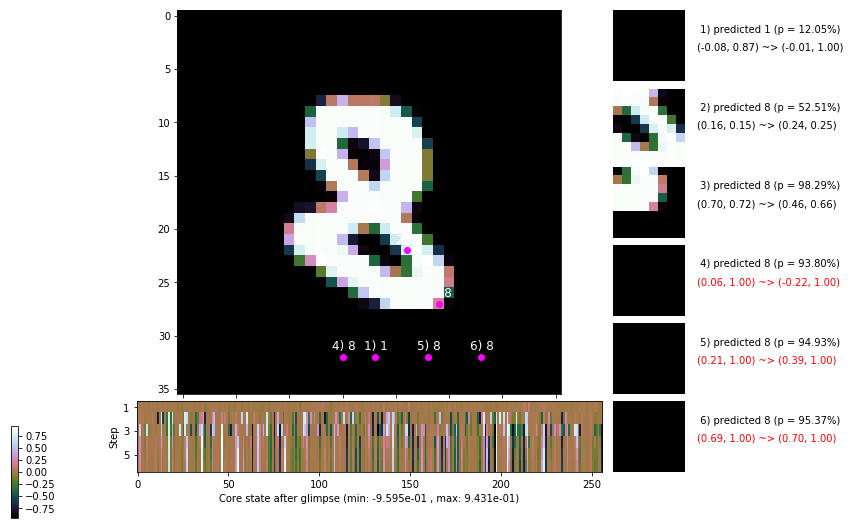

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.7 ms/b | lr: 5.93e-04 | grad 2norm: 15.14 | grad inf norm:  4.004
         Weights || abs max:  2.28 ( 4974.32) | mean: -7.44e-04 ( 0.02) | var: 6.61e-02 ( 1461.19)
          Biases || abs max:  1.33 (  435.40) | mean: -1.24e-01 ( 0.24) | var: 8.08e-02 (  439.58)
                    class loss: 0.397 | steps: 2.301 | reward:  3.506 | acc.: 86.27%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 156.5 ms/b | lr: 5.92e-04 | grad 2norm: 14.84 | grad inf norm:  4.132
         Weights || abs max:  2.28 ( 2585.26) | mean: -7.17e-04 ( 0.01) | var: 6.62e-02 (   76.34)
          Biases || abs max:  1.34 (  167.68) | mean: -1.23e-01 ( 0.12) | var: 8.08e-02 (  279.98)
                    class loss: 0.377 | steps: 2.272 | reward:  3.595 | acc.: 87.12%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

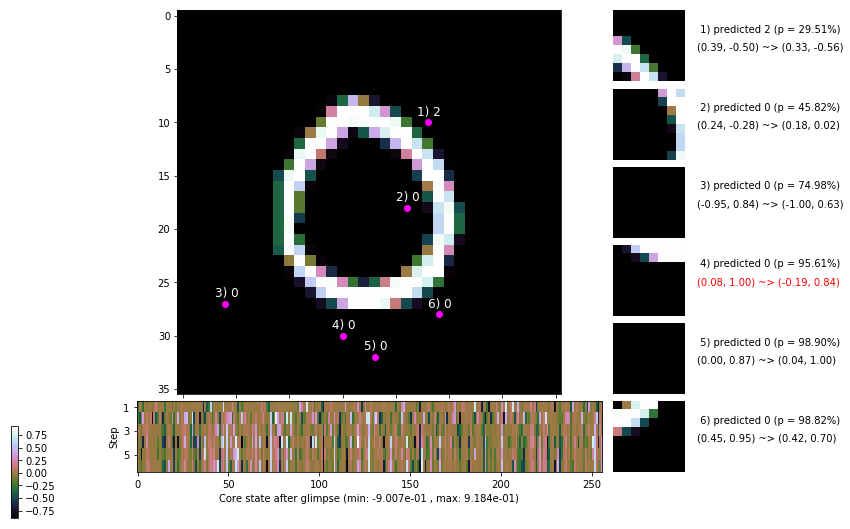

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


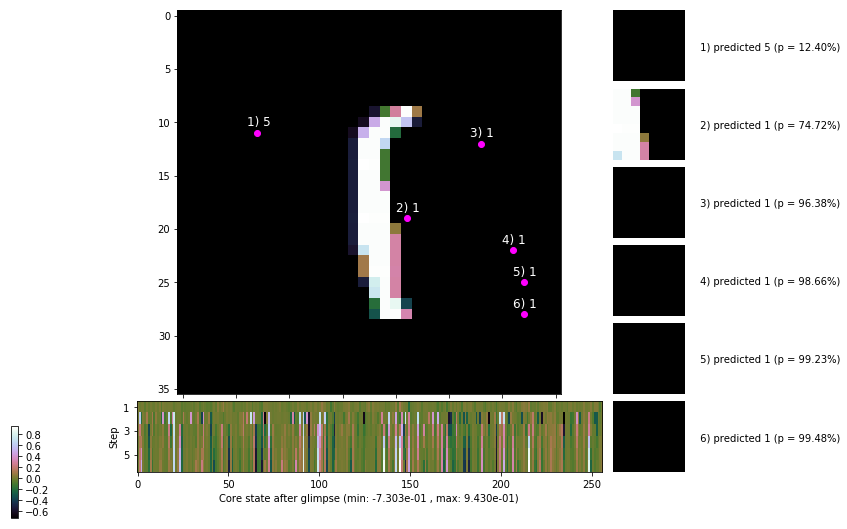


	Target class: 4 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


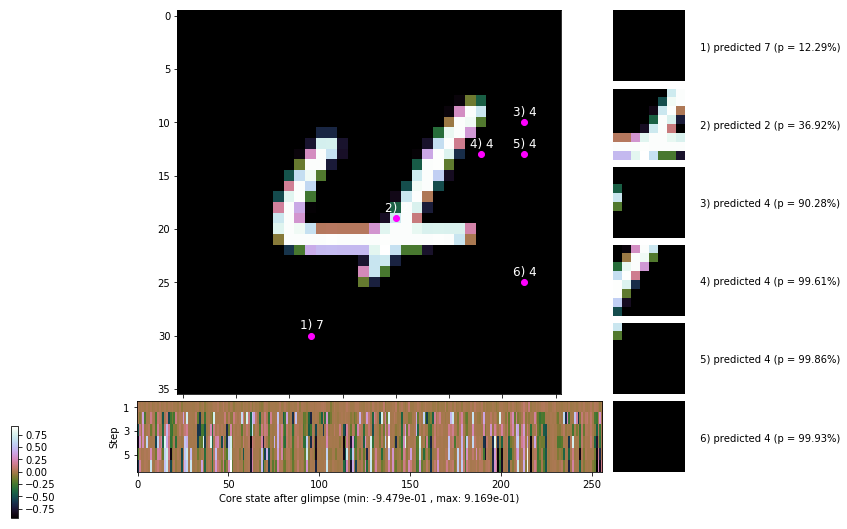

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


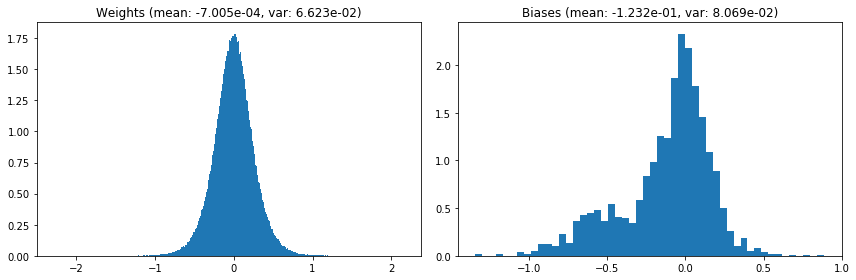

                                      Location network weights and biases


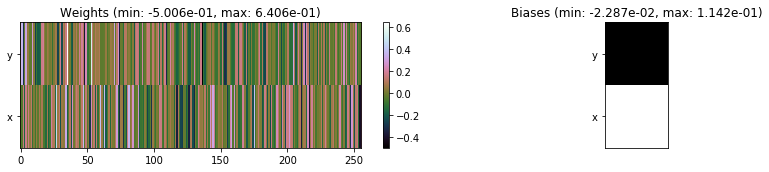

---------------------------------------------------------------------------------------------------------------
Elapsed time:  466.90 sec | TRAIN >> class loss: 0.3751 | steps:  2.281 :( | reward:  3.5844 :( | acc.: 87.302% :(
                          | VAL   >> class loss: 0.3700 | steps:  2.194 :( | reward:  3.7794 :( | acc.: 87.540% :(


Epoch  36/400) lr = 0.0005914
 b    300/  3000 >> 155.8 ms/b | lr: 5.91e-04 | grad 2norm: 15.14 | grad inf norm:  4.120
         Weights || abs max:  2.28 ( 2812.40) | mean: -7.10e-04 ( 0.01) | var: 6.63e-02 (  185.48)
          Biases || abs max:  1.34 (   53.49) | mean: -1.23e-01 ( 0.07) | var: 8.07e-02 (   22.25)
                    class loss: 0.371 | steps: 2.281 | reward:  3.593 | acc.: 87.50%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 159.0 ms/b | lr: 5.90e-04 | grad 2norm: 14.58 | grad inf norm:  3.974
         Weights || abs max:  2.28 ( 3211.80) | mean: -7.36e-04 (

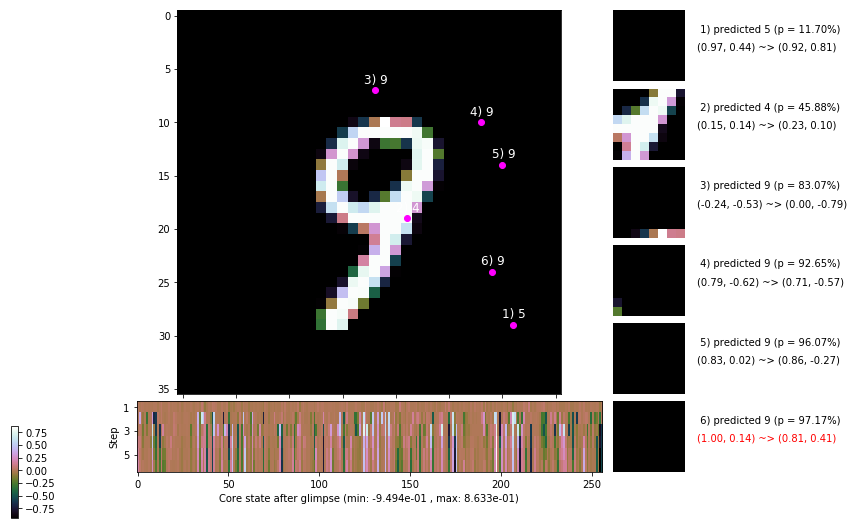

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.2 ms/b | lr: 5.89e-04 | grad 2norm: 14.83 | grad inf norm:  3.818
         Weights || abs max:  2.28 ( 2701.25) | mean: -7.46e-04 ( 0.01) | var: 6.64e-02 (  116.60)
          Biases || abs max:  1.33 (   68.42) | mean: -1.24e-01 ( 0.07) | var: 8.11e-02 (   12.74)
                    class loss: 0.366 | steps: 2.272 | reward:  3.619 | acc.: 87.73%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 150.6 ms/b | lr: 5.88e-04 | grad 2norm: 14.84 | grad inf norm:  3.934
         Weights || abs max:  2.29 ( 4262.72) | mean: -7.25e-04 ( 0.02) | var: 6.65e-02 ( 2579.02)
          Biases || abs max:  1.33 (  104.92) | mean: -1.24e-01 ( 0.09) | var: 8.11e-02 (   27.11)
                    class loss: 0.375 | steps: 2.267 | reward:  3.617 | acc.: 87.77%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

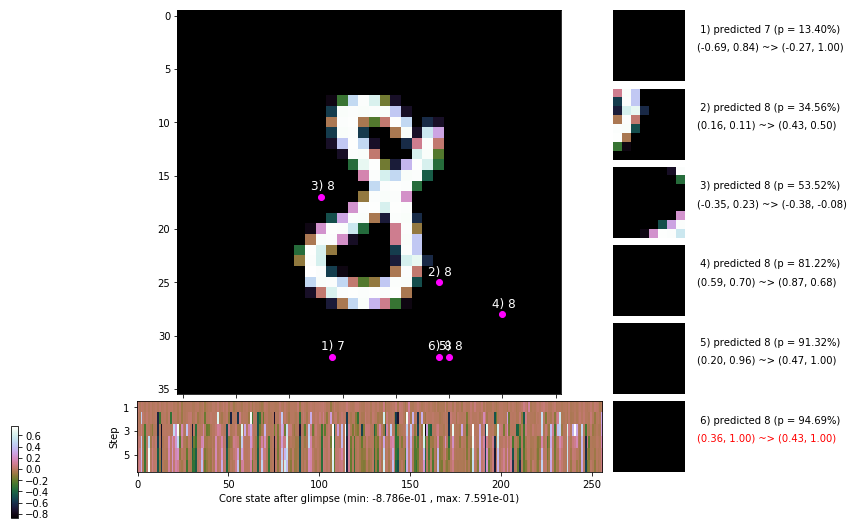

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 160.3 ms/b | lr: 5.87e-04 | grad 2norm: 14.91 | grad inf norm:  3.866
         Weights || abs max:  2.28 ( 4485.66) | mean: -7.48e-04 ( 0.02) | var: 6.66e-02 ( 2175.91)
          Biases || abs max:  1.34 (   53.85) | mean: -1.23e-01 ( 0.07) | var: 8.11e-02 (   34.84)
                    class loss: 0.353 | steps: 2.283 | reward:  3.613 | acc.: 87.90%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 159.7 ms/b | lr: 5.87e-04 | grad 2norm: 14.81 | grad inf norm:  3.906
         Weights || abs max:  2.30 ( 2213.70) | mean: -7.85e-04 ( 0.01) | var: 6.66e-02 (   68.45)
          Biases || abs max:  1.34 (  132.39) | mean: -1.24e-01 ( 0.11) | var: 8.11e-02 (   67.95)
                    class loss: 0.368 | steps: 2.288 | reward:  3.607 | acc.: 87.65%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

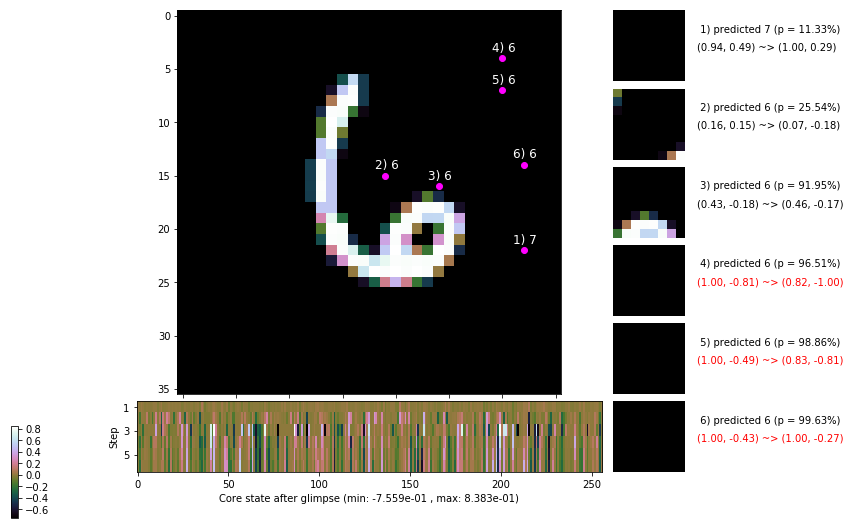

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 158.3 ms/b | lr: 5.86e-04 | grad 2norm: 14.94 | grad inf norm:  3.937
         Weights || abs max:  2.32 ( 3148.85) | mean: -8.08e-04 ( 0.01) | var: 6.67e-02 (  207.12)
          Biases || abs max:  1.35 (  109.09) | mean: -1.24e-01 ( 0.09) | var: 8.13e-02 (   98.91)
                    class loss: 0.367 | steps: 2.273 | reward:  3.600 | acc.: 87.67%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.9 ms/b | lr: 5.85e-04 | grad 2norm: 14.59 | grad inf norm:  3.788
         Weights || abs max:  2.33 ( 4421.38) | mean: -8.33e-04 ( 0.02) | var: 6.68e-02 ( 1927.19)
          Biases || abs max:  1.36 (  164.23) | mean: -1.24e-01 ( 0.13) | var: 8.14e-02 (  251.59)
                    class loss: 0.365 | steps: 2.273 | reward:  3.626 | acc.: 87.78%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

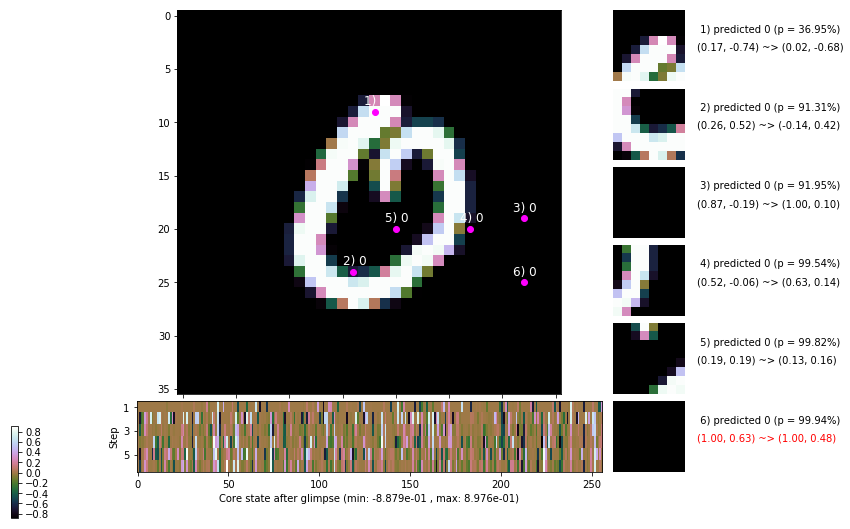

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 161.4 ms/b | lr: 5.84e-04 | grad 2norm: 14.78 | grad inf norm:  3.883
         Weights || abs max:  2.32 ( 9997.85) | mean: -8.28e-04 ( 0.03) | var: 6.68e-02 (17412.21)
          Biases || abs max:  1.36 (  346.45) | mean: -1.25e-01 ( 0.19) | var: 8.15e-02 ( 6985.52)
                    class loss: 0.360 | steps: 2.283 | reward:  3.602 | acc.: 87.38%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 147.7 ms/b | lr: 5.83e-04 | grad 2norm: 14.44 | grad inf norm:  3.863
         Weights || abs max:  2.31 ( 2724.78) | mean: -8.17e-04 ( 0.01) | var: 6.69e-02 (   96.75)
          Biases || abs max:  1.35 (  104.10) | mean: -1.25e-01 ( 0.09) | var: 8.15e-02 (  124.31)
                    class loss: 0.334 | steps: 2.240 | reward:  3.713 | acc.: 88.73%

	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.8

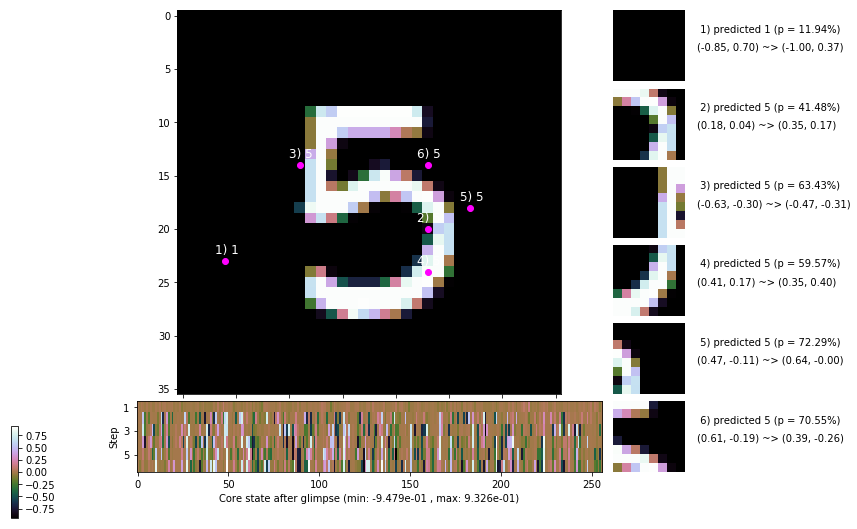

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


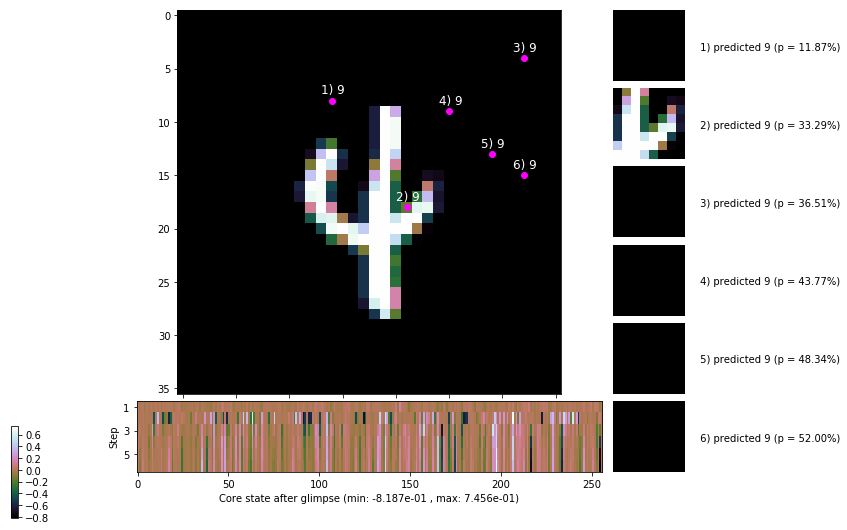


	Target class: 4 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


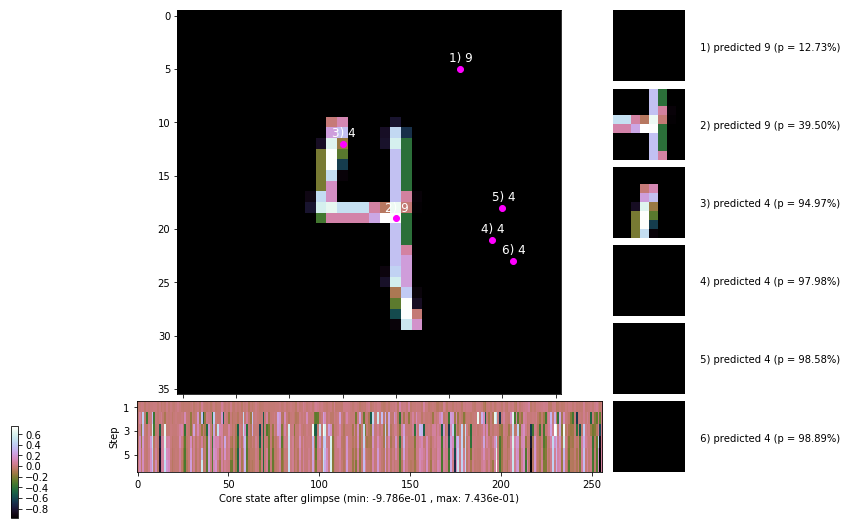

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


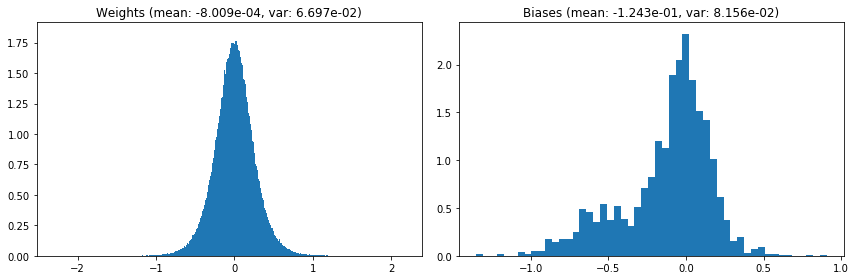

                                      Location network weights and biases


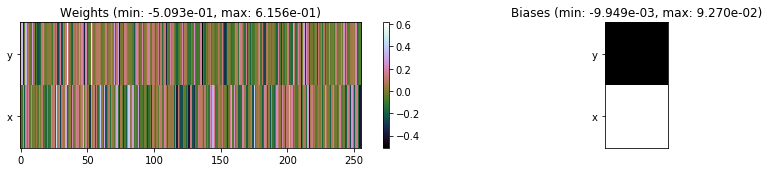

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.56 sec | TRAIN >> class loss: 0.3627 | steps:  2.272 :( | reward:  3.6202 :( | acc.: 87.787% :(
                          | VAL   >> class loss: 0.3179 | steps:  2.159    | reward:  3.8463    | acc.: 88.840% :(


Epoch  37/400) lr = 0.0005826
 b    300/  3000 >> 153.3 ms/b | lr: 5.82e-04 | grad 2norm: 14.64 | grad inf norm:  3.973
         Weights || abs max:  2.31 ( 3763.73) | mean: -8.40e-04 ( 0.01) | var: 6.70e-02 (  647.16)
          Biases || abs max:  1.35 (   88.30) | mean: -1.24e-01 ( 0.08) | var: 8.17e-02 (   88.73)
                    class loss: 0.364 | steps: 2.233 | reward:  3.669 | acc.: 87.92%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.9 ms/b | lr: 5.81e-04 | grad 2norm: 15.00 | grad inf norm:  4.030
         Weights || abs max:  2.31 ( 2393.69) | mean: -8.41e-04 (

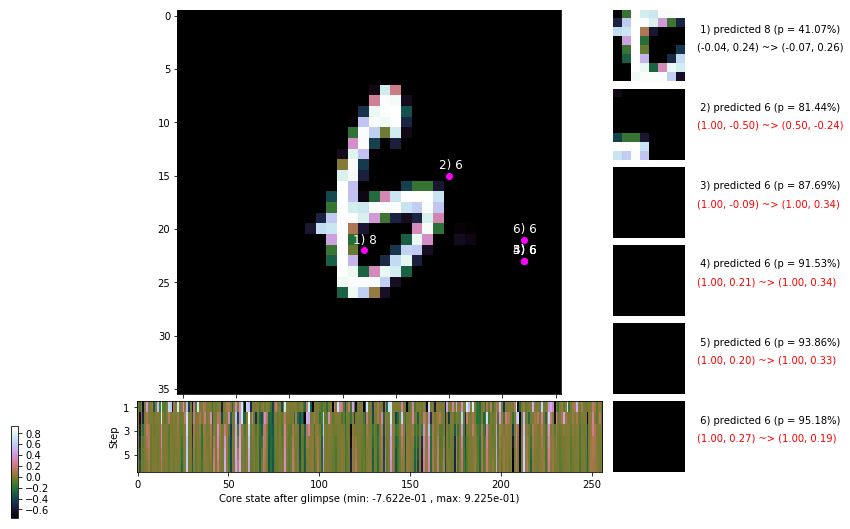

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.5 ms/b | lr: 5.80e-04 | grad 2norm: 15.08 | grad inf norm:  4.021
         Weights || abs max:  2.30 ( 3318.46) | mean: -8.47e-04 ( 0.01) | var: 6.71e-02 (  292.89)
          Biases || abs max:  1.36 (  240.66) | mean: -1.25e-01 ( 0.14) | var: 8.22e-02 ( 2461.45)
                    class loss: 0.375 | steps: 2.295 | reward:  3.567 | acc.: 87.40%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.0 ms/b | lr: 5.80e-04 | grad 2norm: 14.94 | grad inf norm:  4.027
         Weights || abs max:  2.30 ( 8218.43) | mean: -8.55e-04 ( 0.02) | var: 6.72e-02 (13187.20)
          Biases || abs max:  1.36 (  326.62) | mean: -1.25e-01 ( 0.20) | var: 8.23e-02 ( 3656.96)
                    class loss: 0.367 | steps: 2.266 | reward:  3.671 | acc.: 88.10%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

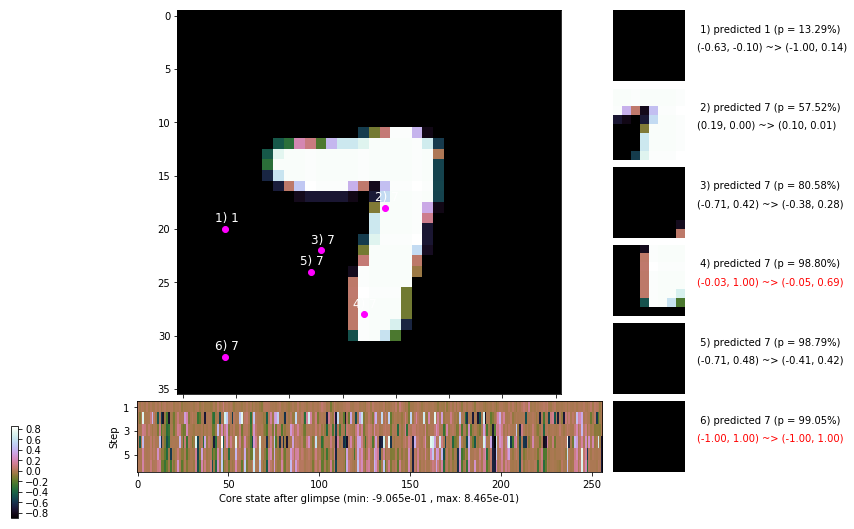

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.9 ms/b | lr: 5.79e-04 | grad 2norm: 14.40 | grad inf norm:  3.881
         Weights || abs max:  2.30 ( 4051.28) | mean: -8.73e-04 ( 0.02) | var: 6.73e-02 (  368.01)
          Biases || abs max:  1.35 (   65.47) | mean: -1.25e-01 ( 0.07) | var: 8.24e-02 (   16.47)
                    class loss: 0.355 | steps: 2.238 | reward:  3.709 | acc.: 88.17%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 164.3 ms/b | lr: 5.78e-04 | grad 2norm: 14.38 | grad inf norm:  3.911
         Weights || abs max:  2.31 (17318.11) | mean: -8.87e-04 ( 0.04) | var: 6.74e-02 (99565.85)
          Biases || abs max:  1.34 (   73.42) | mean: -1.25e-01 ( 0.08) | var: 8.24e-02 (   23.05)
                    class loss: 0.359 | steps: 2.271 | reward:  3.630 | acc.: 87.88%

	Target class: 4 | Discounted rewards: [1.922, 1.844, 1.6

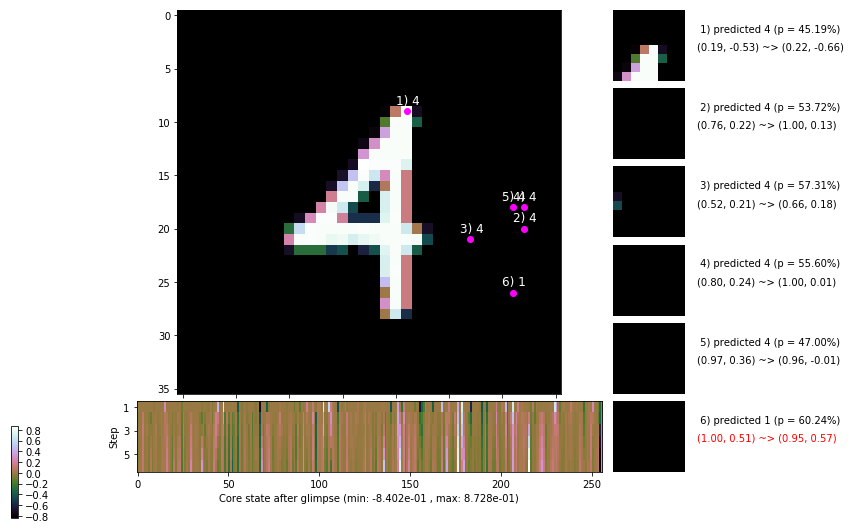

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.9 ms/b | lr: 5.77e-04 | grad 2norm: 15.10 | grad inf norm:  4.061
         Weights || abs max:  2.31 ( 1999.69) | mean: -8.86e-04 ( 0.01) | var: 6.74e-02 (   51.49)
          Biases || abs max:  1.34 (  227.19) | mean: -1.25e-01 ( 0.14) | var: 8.25e-02 ( 2502.87)
                    class loss: 0.381 | steps: 2.313 | reward:  3.558 | acc.: 87.28%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 156.2 ms/b | lr: 5.76e-04 | grad 2norm: 14.43 | grad inf norm:  3.967
         Weights || abs max:  2.30 ( 1547.91) | mean: -8.75e-04 ( 0.01) | var: 6.75e-02 (   25.30)
          Biases || abs max:  1.34 (  104.56) | mean: -1.26e-01 ( 0.10) | var: 8.25e-02 (   67.72)
                    class loss: 0.357 | steps: 2.237 | reward:  3.672 | acc.: 88.33%

	Target class: 7 | Discounted rewards: [-0.938, -0.875, -

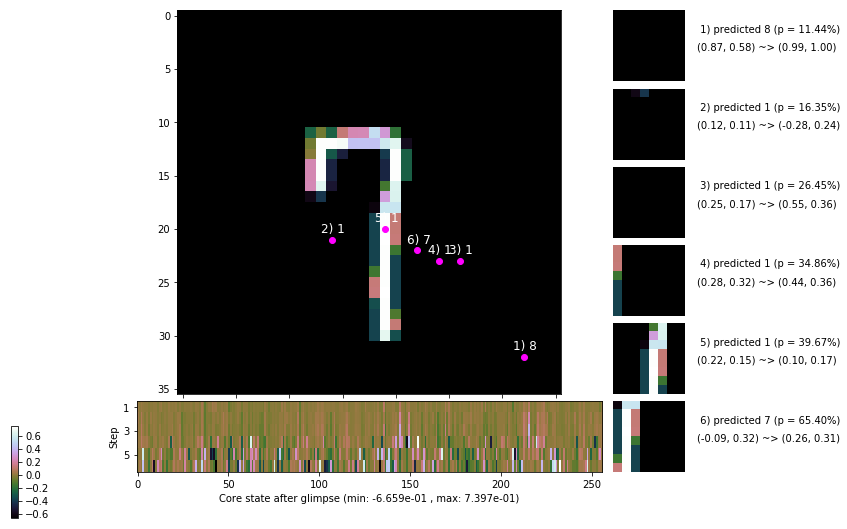

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.4 ms/b | lr: 5.75e-04 | grad 2norm: 14.41 | grad inf norm:  3.794
         Weights || abs max:  2.30 ( 3918.94) | mean: -8.82e-04 ( 0.01) | var: 6.76e-02 ( 1367.14)
          Biases || abs max:  1.32 (   49.31) | mean: -1.25e-01 ( 0.07) | var: 8.26e-02 (   10.97)
                    class loss: 0.333 | steps: 2.255 | reward:  3.693 | acc.: 88.97%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 160.2 ms/b | lr: 5.74e-04 | grad 2norm: 14.30 | grad inf norm:  3.961
         Weights || abs max:  2.30 ( 3247.09) | mean: -8.54e-04 ( 0.01) | var: 6.77e-02 ( 1329.06)
          Biases || abs max:  1.32 (  108.73) | mean: -1.25e-01 ( 0.09) | var: 8.24e-02 (  102.42)
                    class loss: 0.338 | steps: 2.256 | reward:  3.692 | acc.: 88.68%

	Target class: 3 | Discounted rewards: [-0.281, 0.438, 1.

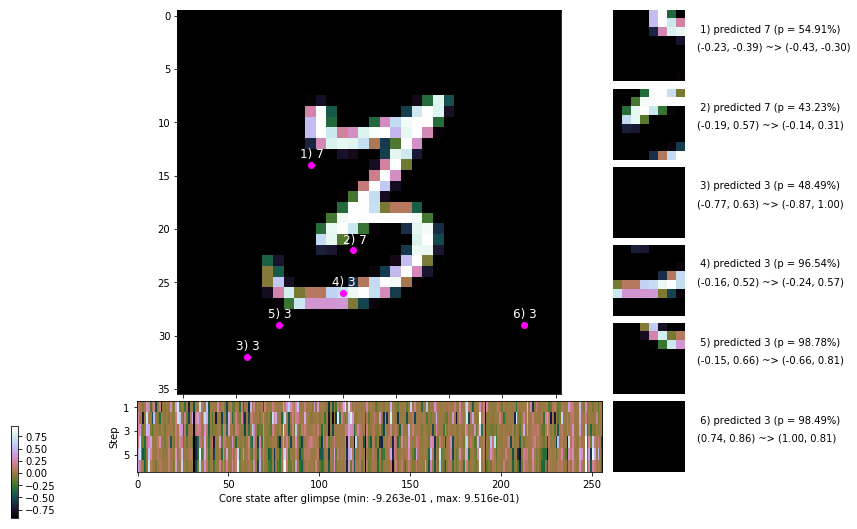

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


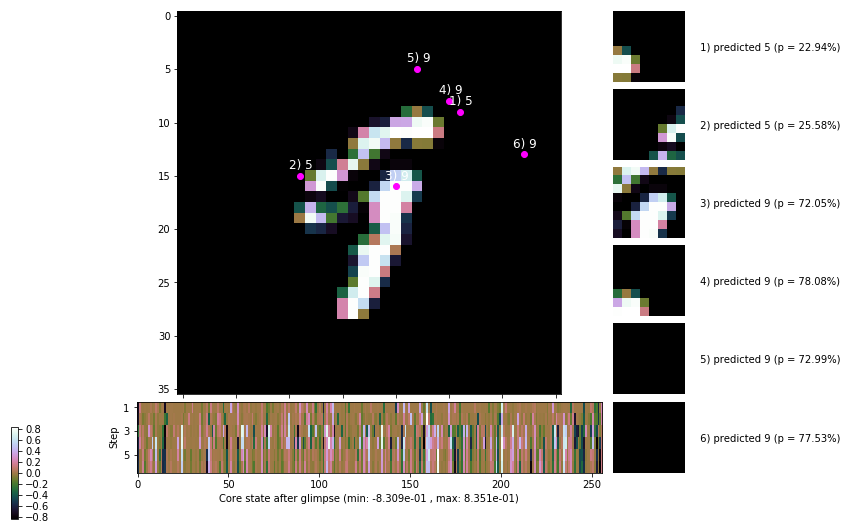


	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


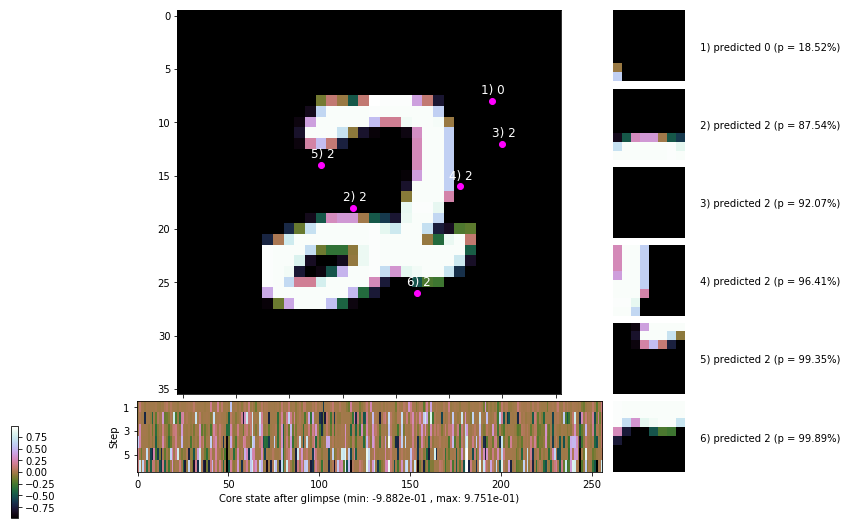

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


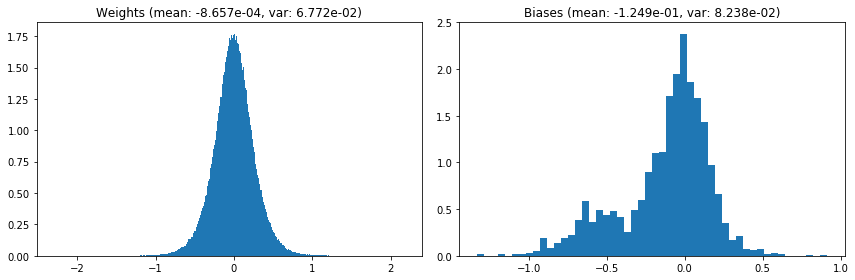

                                      Location network weights and biases


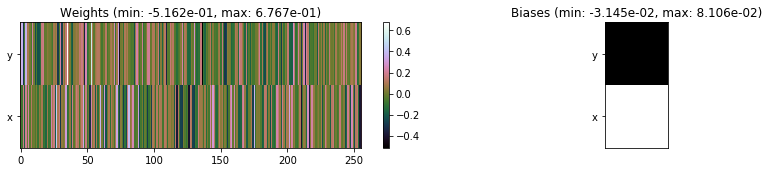

---------------------------------------------------------------------------------------------------------------
Elapsed time:  471.01 sec | TRAIN >> class loss: 0.3582 | steps:  2.261    | reward:  3.6519    | acc.: 88.077% :(
                          | VAL   >> class loss: 0.3358 | steps:  2.181 :( | reward:  3.8133 :( | acc.: 88.600% :(


Epoch  38/400) lr = 0.0005739
 b    300/  3000 >> 158.2 ms/b | lr: 5.73e-04 | grad 2norm: 14.52 | grad inf norm:  3.913
         Weights || abs max:  2.29 ( 2156.68) | mean: -8.89e-04 ( 0.01) | var: 6.77e-02 (  164.98)
          Biases || abs max:  1.33 (  125.54) | mean: -1.25e-01 ( 0.10) | var: 8.26e-02 (  159.38)
                    class loss: 0.347 | steps: 2.263 | reward:  3.667 | acc.: 88.72%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 163.6 ms/b | lr: 5.73e-04 | grad 2norm: 14.84 | grad inf norm:  4.052
         Weights || abs max:  2.30 ( 4922.61) | mean: -8.93e-04 (

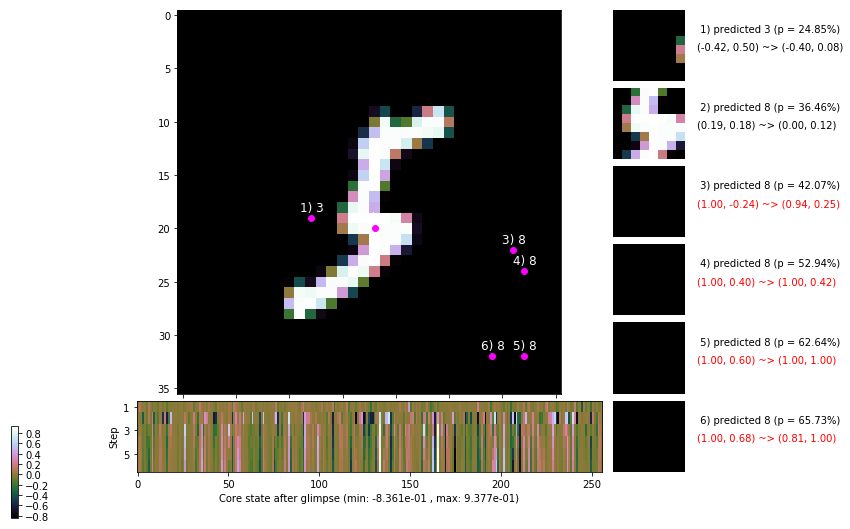

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.2 ms/b | lr: 5.72e-04 | grad 2norm: 14.35 | grad inf norm:  3.899
         Weights || abs max:  2.31 ( 2281.73) | mean: -9.00e-04 ( 0.01) | var: 6.79e-02 (   72.47)
          Biases || abs max:  1.34 (  149.21) | mean: -1.25e-01 ( 0.11) | var: 8.31e-02 (  299.91)
                    class loss: 0.344 | steps: 2.247 | reward:  3.668 | acc.: 88.45%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 157.2 ms/b | lr: 5.71e-04 | grad 2norm: 14.57 | grad inf norm:  3.794
         Weights || abs max:  2.31 ( 2261.80) | mean: -9.12e-04 ( 0.01) | var: 6.80e-02 (  158.35)
          Biases || abs max:  1.35 (   85.64) | mean: -1.26e-01 ( 0.09) | var: 8.33e-02 (   78.09)
                    class loss: 0.356 | steps: 2.233 | reward:  3.673 | acc.: 88.12%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

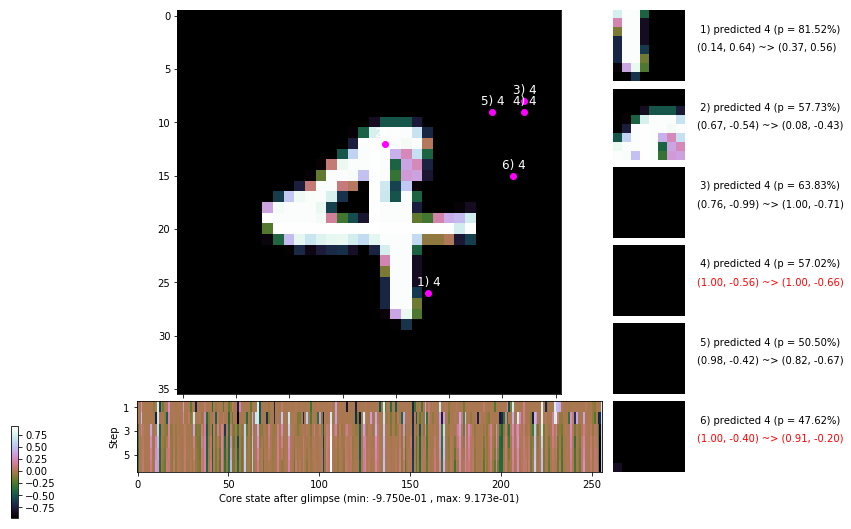

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.7 ms/b | lr: 5.70e-04 | grad 2norm: 14.63 | grad inf norm:  4.072
         Weights || abs max:  2.31 ( 2060.36) | mean: -9.13e-04 ( 0.01) | var: 6.80e-02 (   35.27)
          Biases || abs max:  1.34 (  131.71) | mean: -1.26e-01 ( 0.11) | var: 8.31e-02 (  246.67)
                    class loss: 0.356 | steps: 2.278 | reward:  3.611 | acc.: 87.63%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.6 ms/b | lr: 5.69e-04 | grad 2norm: 14.48 | grad inf norm:  3.990
         Weights || abs max:  2.32 ( 2561.09) | mean: -9.12e-04 ( 0.01) | var: 6.81e-02 (  162.02)
          Biases || abs max:  1.34 (  210.39) | mean: -1.26e-01 ( 0.13) | var: 8.34e-02 ( 1849.72)
                    class loss: 0.354 | steps: 2.253 | reward:  3.659 | acc.: 88.07%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

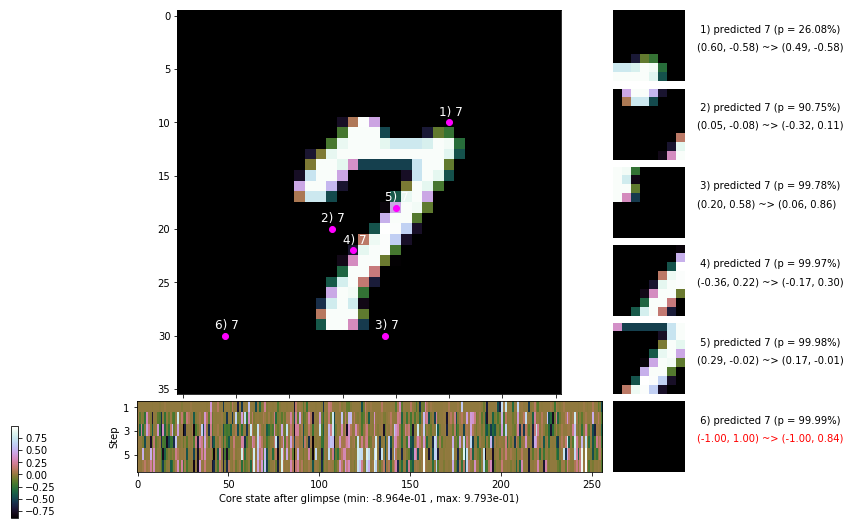

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.7 ms/b | lr: 5.68e-04 | grad 2norm: 14.18 | grad inf norm:  3.807
         Weights || abs max:  2.34 ( 1613.95) | mean: -9.27e-04 ( 0.01) | var: 6.82e-02 (   36.90)
          Biases || abs max:  1.33 (  102.29) | mean: -1.26e-01 ( 0.09) | var: 8.36e-02 (   81.51)
                    class loss: 0.350 | steps: 2.254 | reward:  3.668 | acc.: 88.57%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 154.7 ms/b | lr: 5.68e-04 | grad 2norm: 14.87 | grad inf norm:  4.151
         Weights || abs max:  2.33 ( 2983.31) | mean: -9.08e-04 ( 0.01) | var: 6.82e-02 (  352.82)
          Biases || abs max:  1.33 (  129.08) | mean: -1.27e-01 ( 0.10) | var: 8.37e-02 (  176.11)
                    class loss: 0.372 | steps: 2.276 | reward:  3.626 | acc.: 87.80%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

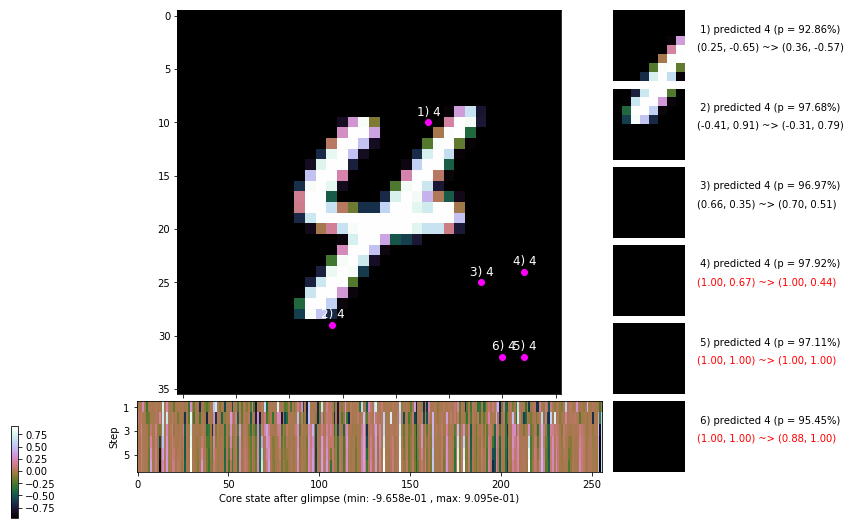

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.9 ms/b | lr: 5.66e-04 | grad 2norm: 14.46 | grad inf norm:  3.823
         Weights || abs max:  2.33 ( 5529.55) | mean: -9.12e-04 ( 0.02) | var: 6.83e-02 ( 4007.26)
          Biases || abs max:  1.33 (  681.23) | mean: -1.27e-01 ( 0.33) | var: 8.38e-02 ( 8149.48)
                    class loss: 0.352 | steps: 2.241 | reward:  3.664 | acc.: 88.12%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 150.2 ms/b | lr: 5.66e-04 | grad 2norm: 14.81 | grad inf norm:  4.042
         Weights || abs max:  2.33 ( 9600.45) | mean: -9.03e-04 ( 0.02) | var: 6.84e-02 (31007.77)
          Biases || abs max:  1.33 (   77.40) | mean: -1.27e-01 ( 0.08) | var: 8.39e-02 (   11.00)
                    class loss: 0.386 | steps: 2.302 | reward:  3.579 | acc.: 87.48%

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.8

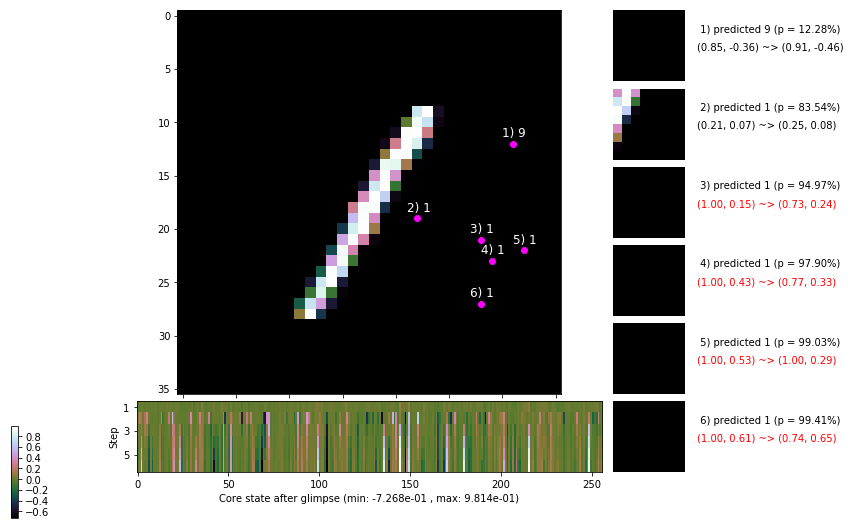

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


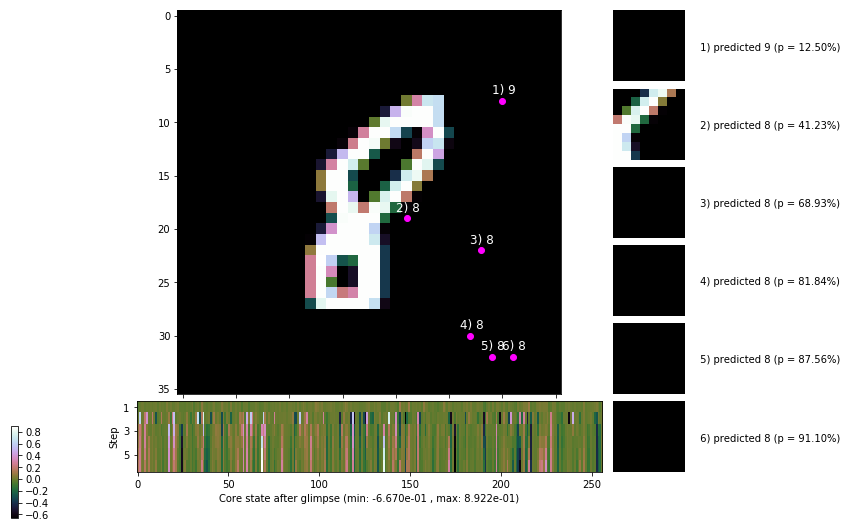


	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


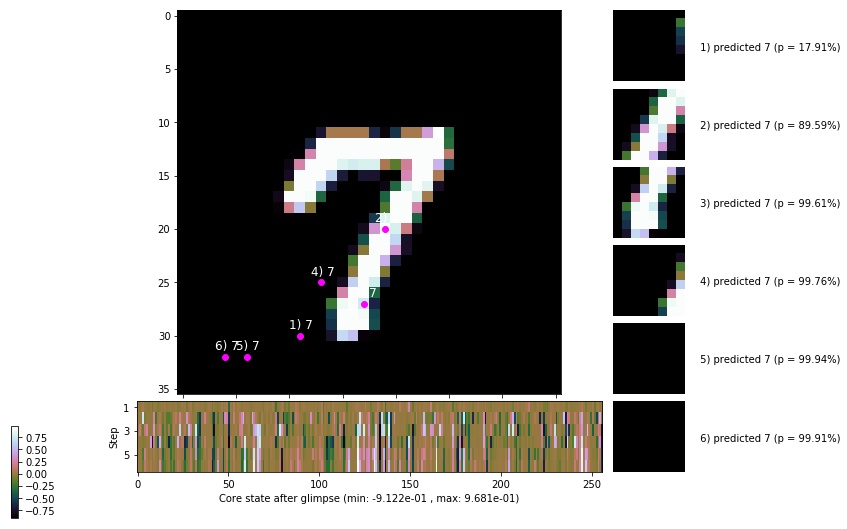

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


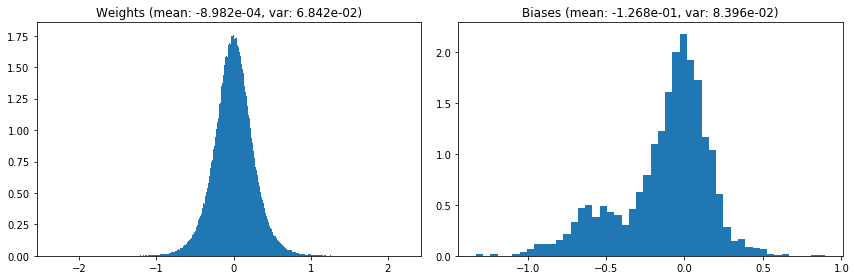

                                      Location network weights and biases


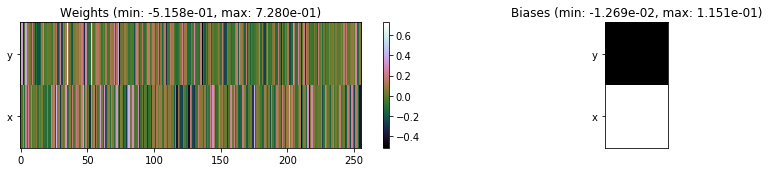

---------------------------------------------------------------------------------------------------------------
Elapsed time:  470.43 sec | TRAIN >> class loss: 0.3576 | steps:  2.261    | reward:  3.6455 :( | acc.: 88.065% :(
                          | VAL   >> class loss: 0.3549 | steps:  2.164 :( | reward:  3.8334 :( | acc.: 88.040% :(


Epoch  39/400) lr = 0.0005654
 b    300/  3000 >> 151.5 ms/b | lr: 5.65e-04 | grad 2norm: 14.89 | grad inf norm:  4.006
         Weights || abs max:  2.33 ( 3146.25) | mean: -8.81e-04 ( 0.01) | var: 6.84e-02 (  478.60)
          Biases || abs max:  1.33 (   84.56) | mean: -1.27e-01 ( 0.07) | var: 8.40e-02 (  154.88)
                    class loss: 0.368 | steps: 2.283 | reward:  3.612 | acc.: 87.60%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 155.8 ms/b | lr: 5.64e-04 | grad 2norm: 14.33 | grad inf norm:  3.748
         Weights || abs max:  2.34 ( 3895.72) | mean: -8.68e-04 (

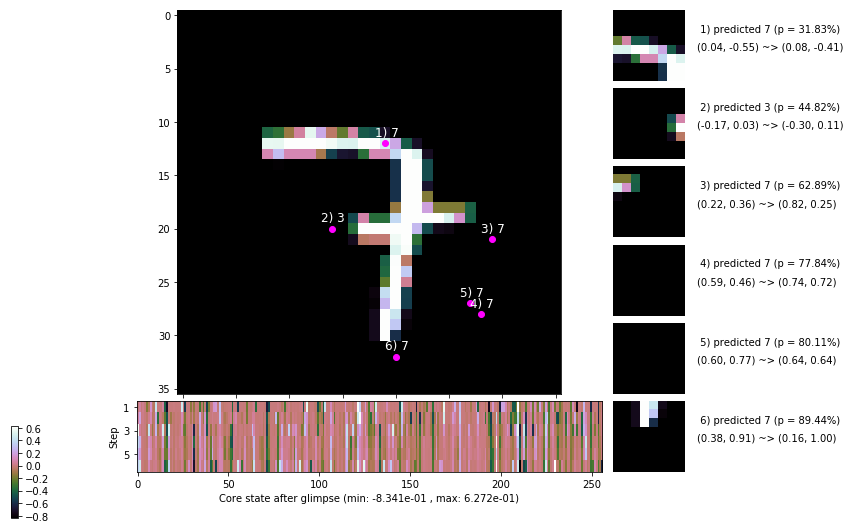

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 147.9 ms/b | lr: 5.63e-04 | grad 2norm: 14.81 | grad inf norm:  4.131
         Weights || abs max:  2.34 ( 3280.59) | mean: -8.89e-04 ( 0.01) | var: 6.86e-02 ( 1757.20)
          Biases || abs max:  1.33 (   94.42) | mean: -1.27e-01 ( 0.09) | var: 8.40e-02 (   20.80)
                    class loss: 0.364 | steps: 2.264 | reward:  3.644 | acc.: 88.03%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.5 ms/b | lr: 5.63e-04 | grad 2norm: 14.49 | grad inf norm:  3.978
         Weights || abs max:  2.36 ( 1930.54) | mean: -9.06e-04 ( 0.01) | var: 6.87e-02 (   59.90)
          Biases || abs max:  1.33 (  116.16) | mean: -1.27e-01 ( 0.10) | var: 8.40e-02 (   98.07)
                    class loss: 0.343 | steps: 2.265 | reward:  3.648 | acc.: 88.28%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

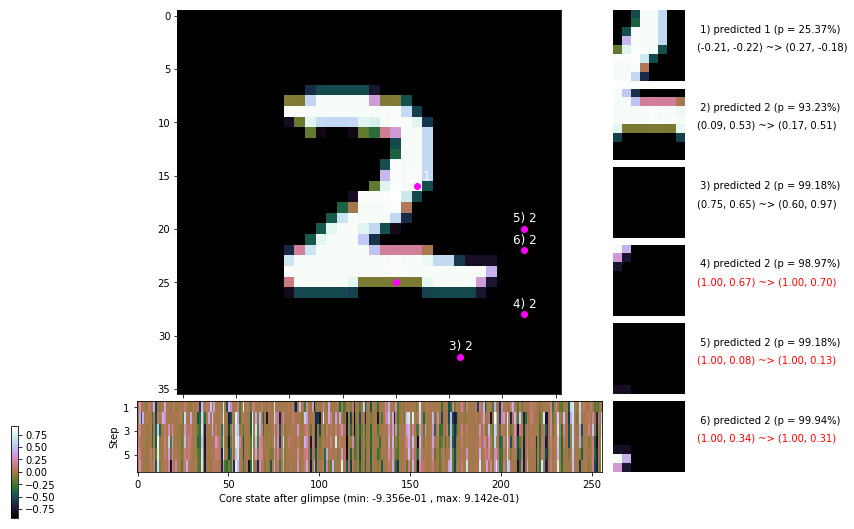

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 156.6 ms/b | lr: 5.61e-04 | grad 2norm: 14.46 | grad inf norm:  4.003
         Weights || abs max:  2.38 (19048.63) | mean: -8.96e-04 ( 0.04) | var: 6.87e-02 (136049.12)
          Biases || abs max:  1.33 (   89.86) | mean: -1.27e-01 ( 0.10) | var: 8.40e-02 (  163.46)
                    class loss: 0.355 | steps: 2.259 | reward:  3.658 | acc.: 88.33%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 157.0 ms/b | lr: 5.61e-04 | grad 2norm: 14.52 | grad inf norm:  3.789
         Weights || abs max:  2.37 ( 4832.70) | mean: -8.96e-04 ( 0.02) | var: 6.88e-02 ( 1684.44)
          Biases || abs max:  1.33 (   86.65) | mean: -1.27e-01 ( 0.09) | var: 8.40e-02 (   53.59)
                    class loss: 0.361 | steps: 2.273 | reward:  3.639 | acc.: 88.08%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.

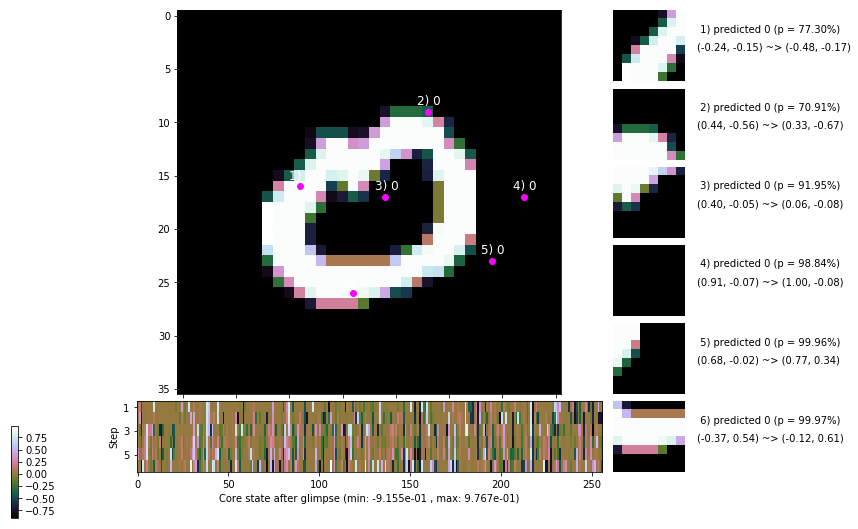

                 --------------------------------------------------------------------------------


H:\Users\Andrew\Anaconda3\envs\conda_jupyter\lib\site-packages\numpy\lib\nanfunctions.py:1315: RuntimeWarning: invalid value encountered in subtract
  np.subtract(arr, avg, out=arr, casting='unsafe')


 b   2100/  3000 >> 168.4 ms/b | lr: 5.60e-04 | grad 2norm: 14.34 | grad inf norm:  3.888
         Weights || abs max:  2.38 (     inf) | mean: -8.70e-04 (  inf) | var: 6.89e-02 (     nan)
          Biases || abs max:  1.32 (  197.54) | mean: -1.27e-01 ( 0.13) | var: 8.41e-02 (  690.11)
                    class loss: 0.345 | steps: 2.251 | reward:  3.686 | acc.: 88.93%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.7 ms/b | lr: 5.59e-04 | grad 2norm: 14.51 | grad inf norm:  4.019
         Weights || abs max:  2.38 ( 7916.95) | mean: -8.73e-04 ( 0.02) | var: 6.90e-02 (11863.45)
          Biases || abs max:  1.32 (   79.04) | mean: -1.27e-01 ( 0.08) | var: 8.41e-02 (   44.10)
                    class loss: 0.363 | steps: 2.265 | reward:  3.651 | acc.: 88.07%

	Target class: 0 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]
	                | Baseline rewards:   [0.789, 1.460, 1.047, 1.451, 1.43

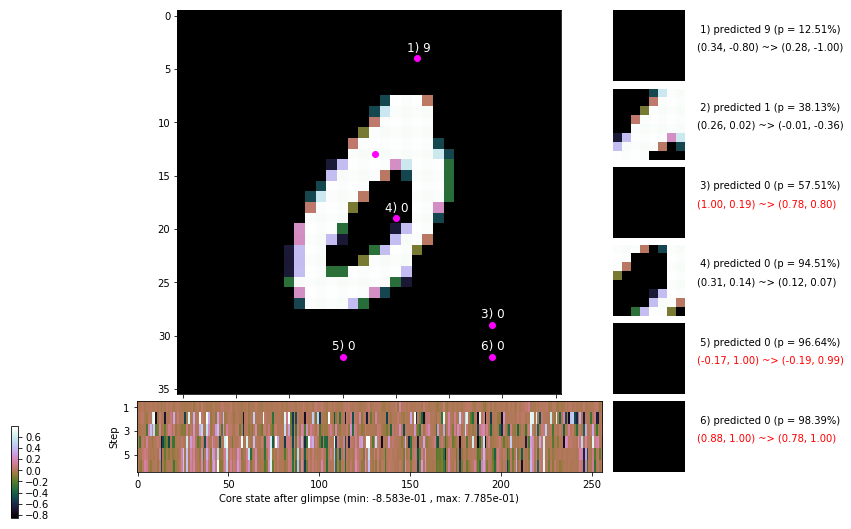

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 165.4 ms/b | lr: 5.58e-04 | grad 2norm: 14.37 | grad inf norm:  3.892
         Weights || abs max:  2.39 ( 3186.43) | mean: -8.78e-04 ( 0.01) | var: 6.90e-02 (  474.16)
          Biases || abs max:  1.32 (   97.66) | mean: -1.27e-01 ( 0.09) | var: 8.42e-02 (   11.76)
                    class loss: 0.367 | steps: 2.249 | reward:  3.660 | acc.: 87.93%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 151.9 ms/b | lr: 5.58e-04 | grad 2norm: 14.56 | grad inf norm:  3.989
         Weights || abs max:  2.39 ( 1999.47) | mean: -8.63e-04 ( 0.01) | var: 6.91e-02 (   94.28)
          Biases || abs max:  1.32 (  150.60) | mean: -1.27e-01 ( 0.11) | var: 8.43e-02 (  175.61)
                    class loss: 0.359 | steps: 2.271 | reward:  3.615 | acc.: 87.83%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

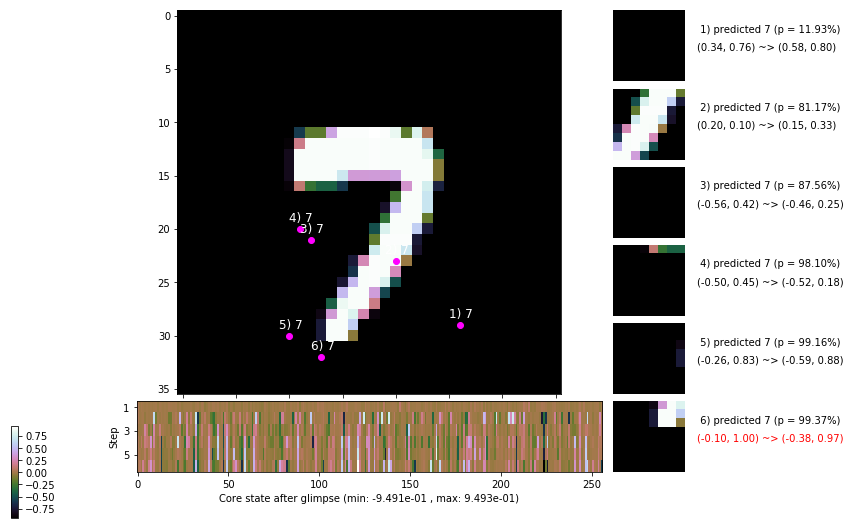

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


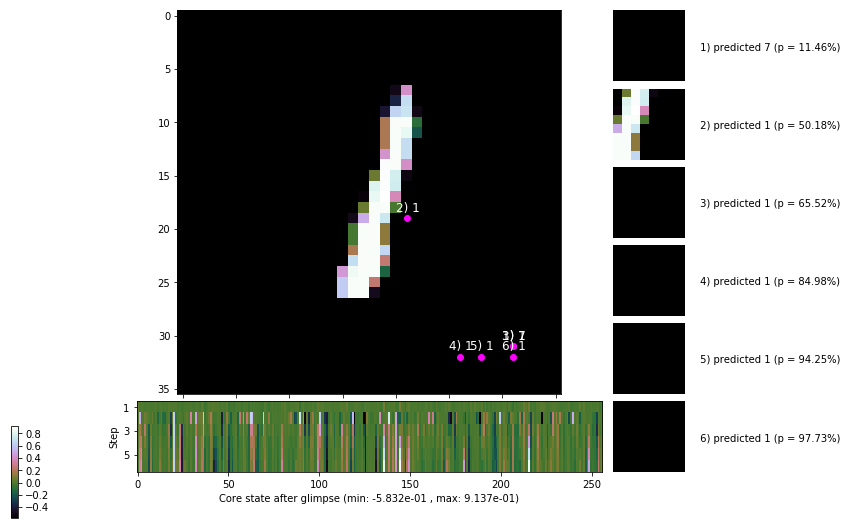


	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


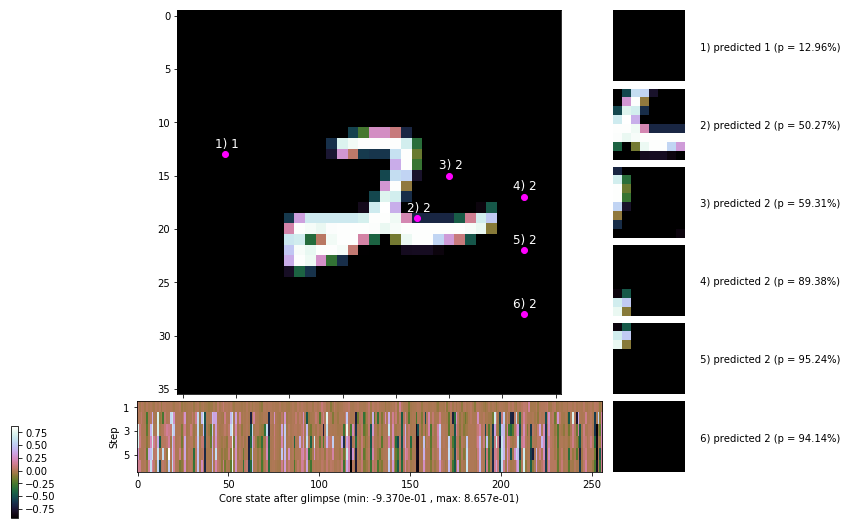

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


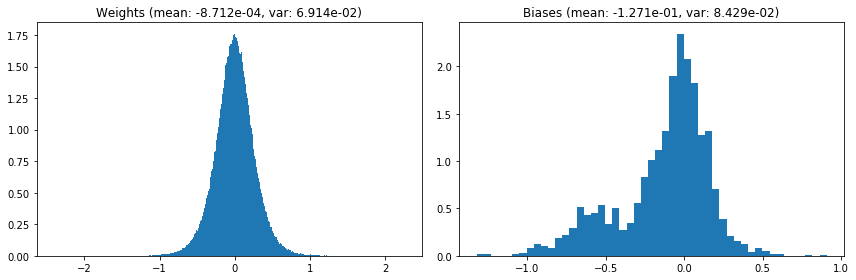

                                      Location network weights and biases


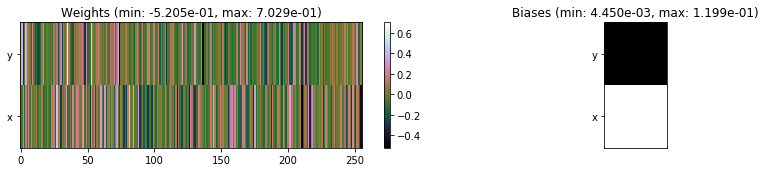

---------------------------------------------------------------------------------------------------------------
Elapsed time:  469.54 sec | TRAIN >> class loss: 0.3570 | steps:  2.261 :( | reward:  3.6517 :( | acc.: 88.150% :(
                          | VAL   >> class loss: 0.3261 | steps:  2.164 :( | reward:  3.8340 :( | acc.: 88.740% :(


Epoch  40/400) lr = 0.0005569
 b    300/  3000 >> 156.0 ms/b | lr: 5.56e-04 | grad 2norm: 14.30 | grad inf norm:  4.064
         Weights || abs max:  2.40 ( 2656.49) | mean: -8.67e-04 ( 0.01) | var: 6.92e-02 (  132.33)
          Biases || abs max:  1.32 (  918.42) | mean: -1.27e-01 ( 0.41) | var: 8.43e-02 ( 7848.92)
                    class loss: 0.359 | steps: 2.234 | reward:  3.675 | acc.: 87.92%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 150.2 ms/b | lr: 5.56e-04 | grad 2norm: 14.50 | grad inf norm:  4.050
         Weights || abs max:  2.39 (11221.16) | mean: -8.59e-04 (

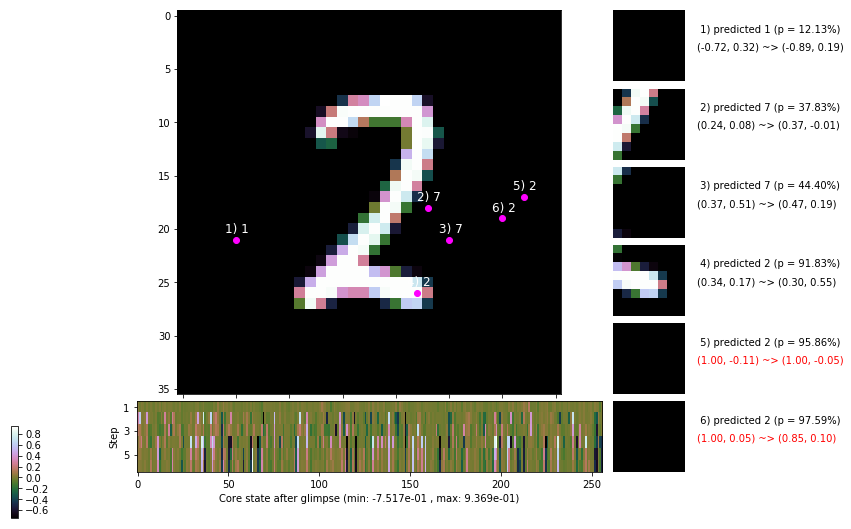

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.8 ms/b | lr: 5.55e-04 | grad 2norm: 14.66 | grad inf norm:  4.002
         Weights || abs max:  2.39 ( 2239.16) | mean: -8.88e-04 ( 0.01) | var: 6.93e-02 (   71.26)
          Biases || abs max:  1.32 (  223.59) | mean: -1.27e-01 ( 0.14) | var: 8.45e-02 (   87.60)
                    class loss: 0.379 | steps: 2.284 | reward:  3.583 | acc.: 87.15%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 160.0 ms/b | lr: 5.54e-04 | grad 2norm: 14.63 | grad inf norm:  4.021
         Weights || abs max:  2.39 ( 1914.31) | mean: -8.74e-04 ( 0.01) | var: 6.94e-02 (  129.93)
          Biases || abs max:  1.33 (   79.02) | mean: -1.27e-01 ( 0.09) | var: 8.44e-02 (   24.84)
                    class loss: 0.384 | steps: 2.287 | reward:  3.586 | acc.: 87.25%

	Target class: 9 | Discounted rewards: [-0.844, -0.688, -

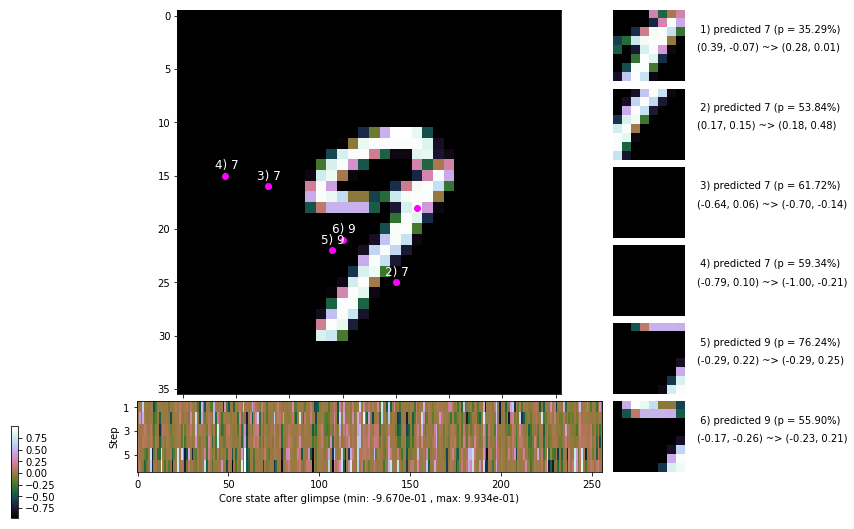

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 151.3 ms/b | lr: 5.53e-04 | grad 2norm: 14.47 | grad inf norm:  3.948
         Weights || abs max:  2.38 ( 4100.78) | mean: -8.76e-04 ( 0.01) | var: 6.95e-02 (  622.16)
          Biases || abs max:  1.33 (  198.78) | mean: -1.27e-01 ( 0.15) | var: 8.46e-02 (  889.48)
                    class loss: 0.379 | steps: 2.248 | reward:  3.628 | acc.: 87.20%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 156.8 ms/b | lr: 5.53e-04 | grad 2norm: 14.08 | grad inf norm:  3.696
         Weights || abs max:  2.38 ( 2136.55) | mean: -8.90e-04 ( 0.01) | var: 6.95e-02 (   56.51)
          Biases || abs max:  1.33 (   78.89) | mean: -1.28e-01 ( 0.09) | var: 8.48e-02 (   18.40)
                    class loss: 0.352 | steps: 2.257 | reward:  3.660 | acc.: 88.28%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

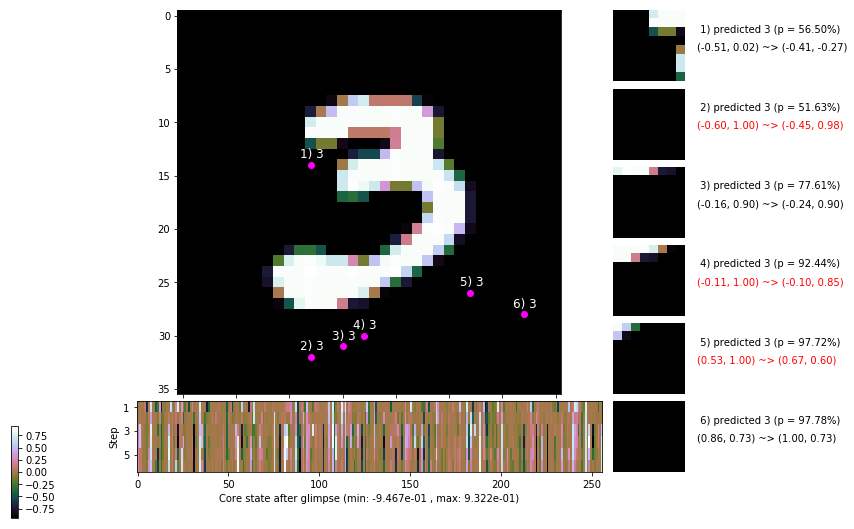

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.8 ms/b | lr: 5.51e-04 | grad 2norm: 14.33 | grad inf norm:  3.966
         Weights || abs max:  2.39 ( 3158.01) | mean: -9.09e-04 ( 0.01) | var: 6.96e-02 (  169.80)
          Biases || abs max:  1.34 (  117.65) | mean: -1.27e-01 ( 0.10) | var: 8.47e-02 (   32.55)
                    class loss: 0.358 | steps: 2.261 | reward:  3.628 | acc.: 87.65%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 152.9 ms/b | lr: 5.51e-04 | grad 2norm: 14.17 | grad inf norm:  3.875
         Weights || abs max:  2.40 ( 2950.44) | mean: -8.85e-04 ( 0.01) | var: 6.97e-02 (  162.33)
          Biases || abs max:  1.34 (  473.12) | mean: -1.28e-01 ( 0.34) | var: 8.48e-02 ( 9986.36)
                    class loss: 0.362 | steps: 2.247 | reward:  3.654 | acc.: 87.98%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

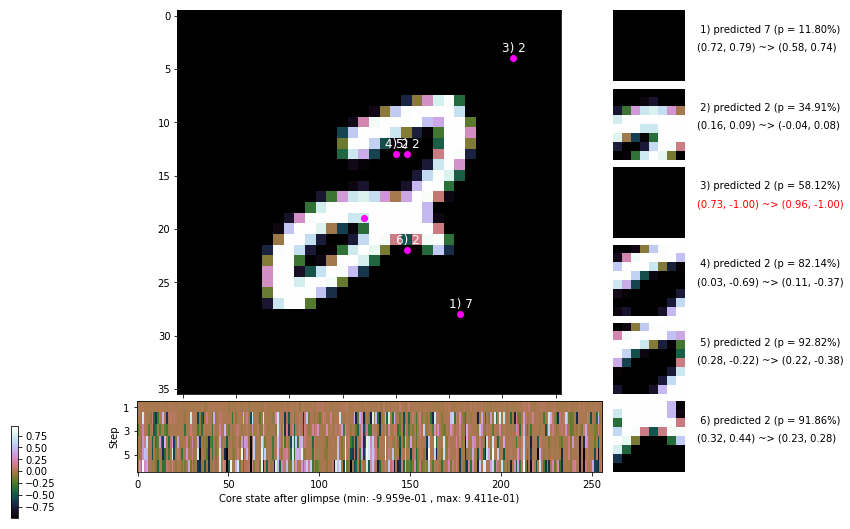

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.5 ms/b | lr: 5.50e-04 | grad 2norm: 14.29 | grad inf norm:  3.782
         Weights || abs max:  2.40 ( 4650.99) | mean: -8.89e-04 ( 0.02) | var: 6.97e-02 ( 2441.88)
          Biases || abs max:  1.34 ( 1568.73) | mean: -1.28e-01 ( 0.68) | var: 8.50e-02 (90008.48)
                    class loss: 0.380 | steps: 2.273 | reward:  3.633 | acc.: 87.75%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.0 ms/b | lr: 5.49e-04 | grad 2norm: 14.30 | grad inf norm:  3.888
         Weights || abs max:  2.40 ( 1897.59) | mean: -9.04e-04 ( 0.01) | var: 6.98e-02 (   65.50)
          Biases || abs max:  1.34 (  288.32) | mean: -1.28e-01 ( 0.17) | var: 8.51e-02 ( 1230.28)
                    class loss: 0.359 | steps: 2.249 | reward:  3.653 | acc.: 87.93%

	Target class: 6 | Discounted rewards: [-0.984, -0.969, -

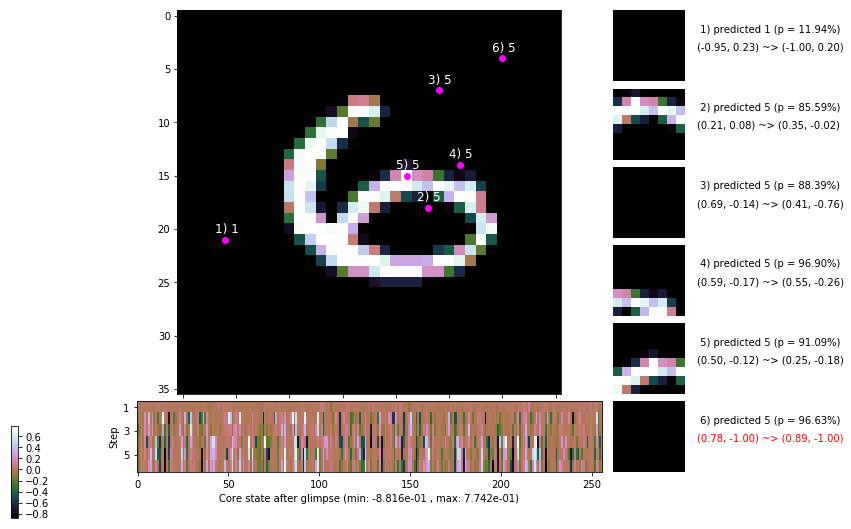

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


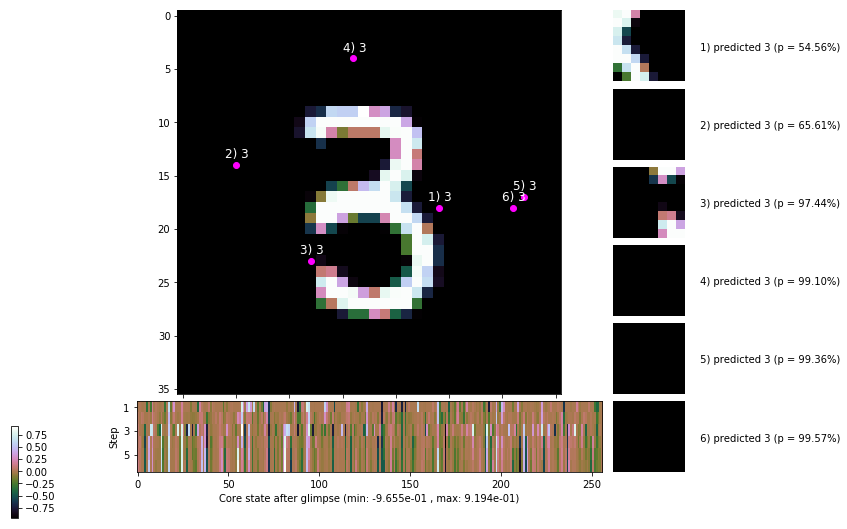


	Target class: 1 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


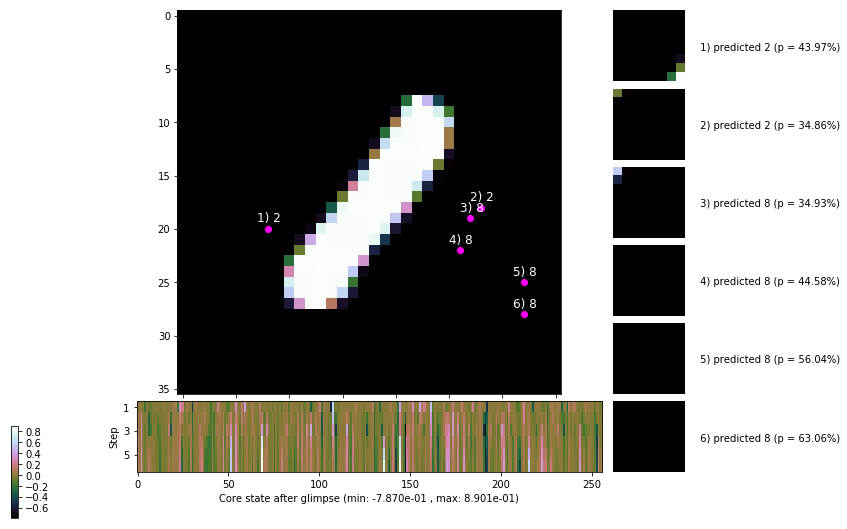

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


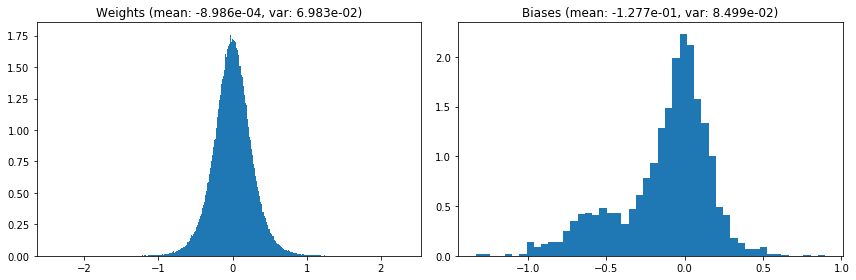

                                      Location network weights and biases


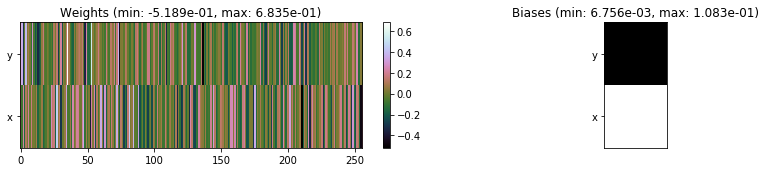

---------------------------------------------------------------------------------------------------------------
Elapsed time:  468.97 sec | TRAIN >> class loss: 0.3681 | steps:  2.262 :( | reward:  3.6315 :( | acc.: 87.668% :(
                          | VAL   >> class loss: 0.3347 | steps:  2.149    | reward:  3.8142 :( | acc.: 87.900% :(


Epoch  41/400) lr = 0.0005486
 b    300/  3000 >> 156.9 ms/b | lr: 5.48e-04 | grad 2norm: 14.36 | grad inf norm:  3.912
         Weights || abs max:  2.41 ( 3904.70) | mean: -9.03e-04 ( 0.01) | var: 6.99e-02 (  575.68)
          Biases || abs max:  1.33 (  142.68) | mean: -1.28e-01 ( 0.12) | var: 8.51e-02 (  187.51)
                    class loss: 0.381 | steps: 2.273 | reward:  3.600 | acc.: 87.33%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 160.1 ms/b | lr: 5.48e-04 | grad 2norm: 14.52 | grad inf norm:  3.930
         Weights || abs max:  2.41 ( 3129.01) | mean: -9.16e-04 (

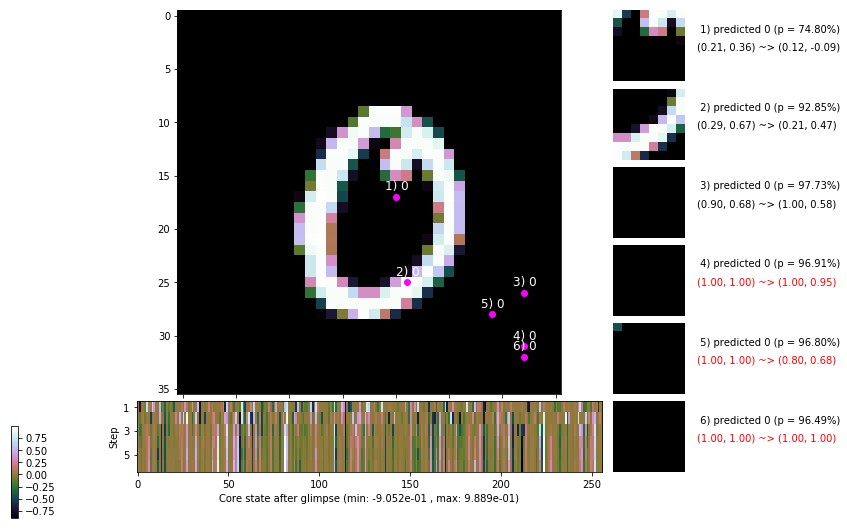

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 166.1 ms/b | lr: 5.46e-04 | grad 2norm: 14.62 | grad inf norm:  4.123
         Weights || abs max:  2.39 ( 4276.73) | mean: -9.16e-04 ( 0.02) | var: 7.00e-02 ( 1674.73)
          Biases || abs max:  1.34 (  755.72) | mean: -1.28e-01 ( 0.38) | var: 8.51e-02 (10501.25)
                    class loss: 0.369 | steps: 2.274 | reward:  3.624 | acc.: 87.60%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.5 ms/b | lr: 5.46e-04 | grad 2norm: 14.30 | grad inf norm:  3.980
         Weights || abs max:  2.39 ( 3520.95) | mean: -9.10e-04 ( 0.01) | var: 7.01e-02 (  877.44)
          Biases || abs max:  1.35 (  813.77) | mean: -1.29e-01 ( 0.39) | var: 8.53e-02 ( 3129.32)
                    class loss: 0.375 | steps: 2.298 | reward:  3.579 | acc.: 87.50%

	Target class: 0 | Discounted rewards: [-0.844, -0.688, -

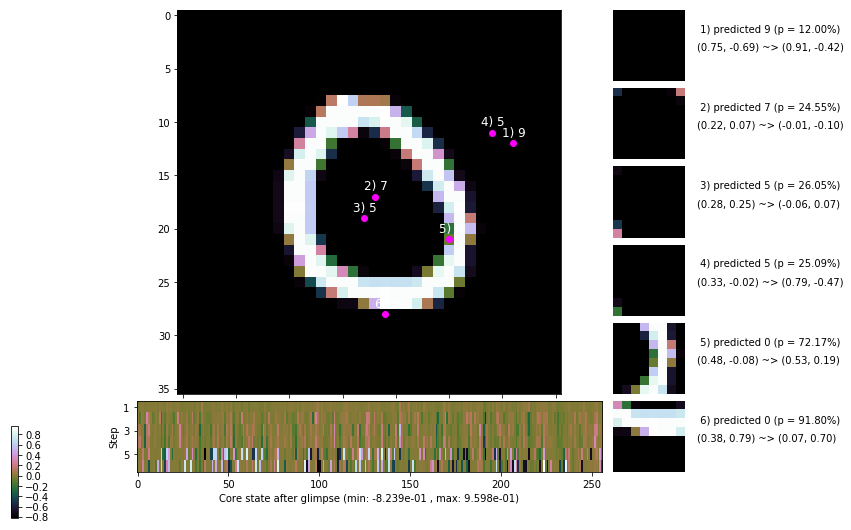

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 166.7 ms/b | lr: 5.45e-04 | grad 2norm: 14.41 | grad inf norm:  4.029
         Weights || abs max:  2.40 ( 2549.16) | mean: -9.02e-04 ( 0.01) | var: 7.01e-02 (  337.47)
          Biases || abs max:  1.35 (  709.18) | mean: -1.29e-01 ( 0.34) | var: 8.53e-02 ( 1918.56)
                    class loss: 0.359 | steps: 2.275 | reward:  3.598 | acc.: 87.68%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 163.5 ms/b | lr: 5.44e-04 | grad 2norm: 14.21 | grad inf norm:  3.913
         Weights || abs max:  2.40 ( 2960.93) | mean: -8.87e-04 ( 0.01) | var: 7.02e-02 (  207.11)
          Biases || abs max:  1.35 (   70.19) | mean: -1.29e-01 ( 0.08) | var: 8.53e-02 (   13.37)
                    class loss: 0.348 | steps: 2.265 | reward:  3.624 | acc.: 88.28%

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.8

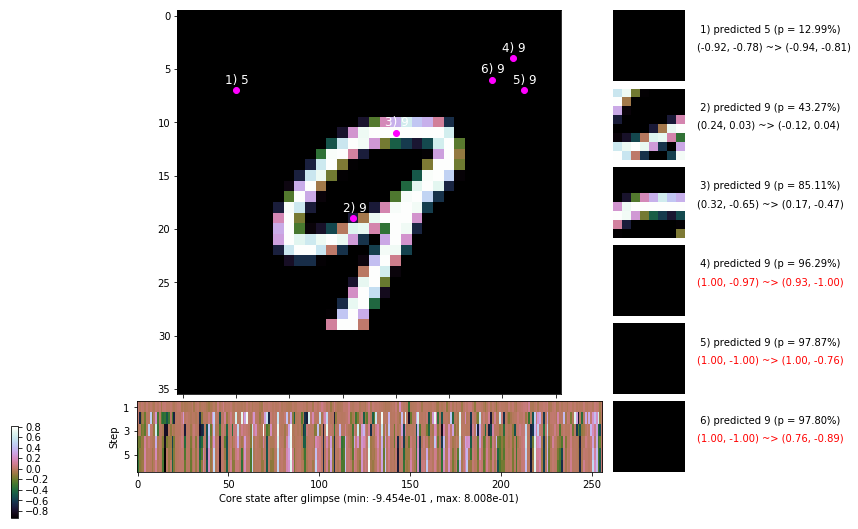

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 180.5 ms/b | lr: 5.43e-04 | grad 2norm: 14.13 | grad inf norm:  3.862
         Weights || abs max:  2.40 ( 2368.77) | mean: -8.90e-04 ( 0.01) | var: 7.03e-02 (   70.90)
          Biases || abs max:  1.34 (  581.76) | mean: -1.29e-01 ( 0.28) | var: 8.54e-02 (10713.76)
                    class loss: 0.352 | steps: 2.235 | reward:  3.707 | acc.: 88.60%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 143.7 ms/b | lr: 5.43e-04 | grad 2norm: 14.32 | grad inf norm:  3.762
         Weights || abs max:  2.40 ( 3539.68) | mean: -8.55e-04 ( 0.01) | var: 7.03e-02 (  942.25)
          Biases || abs max:  1.34 (  514.41) | mean: -1.29e-01 ( 0.28) | var: 8.55e-02 ( 4301.06)
                    class loss: 0.355 | steps: 2.239 | reward:  3.651 | acc.: 87.97%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

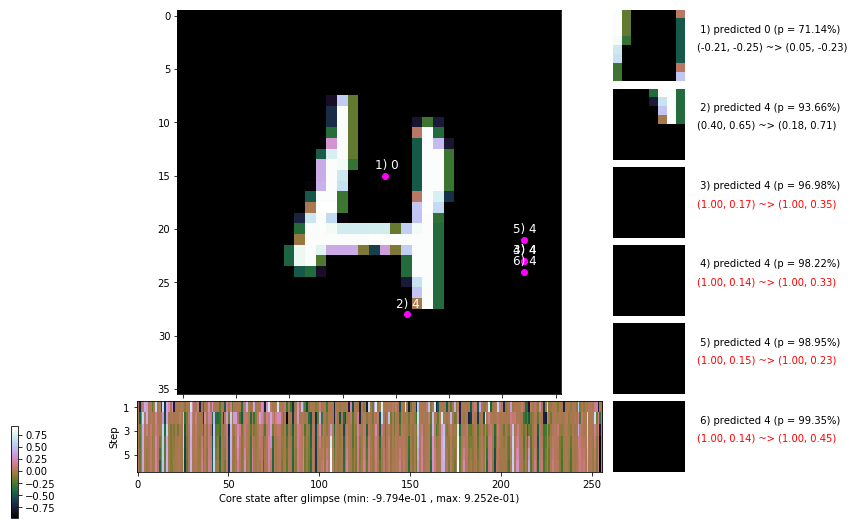

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 157.0 ms/b | lr: 5.42e-04 | grad 2norm: 14.55 | grad inf norm:  4.150
         Weights || abs max:  2.41 ( 2196.25) | mean: -8.63e-04 ( 0.01) | var: 7.04e-02 (  191.70)
          Biases || abs max:  1.34 ( 1010.30) | mean: -1.29e-01 ( 0.45) | var: 8.55e-02 (48677.58)
                    class loss: 0.367 | steps: 2.253 | reward:  3.615 | acc.: 87.60%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 148.2 ms/b | lr: 5.41e-04 | grad 2norm: 14.12 | grad inf norm:  3.826
         Weights || abs max:  2.41 ( 5335.00) | mean: -8.49e-04 ( 0.02) | var: 7.05e-02 ( 2146.37)
          Biases || abs max:  1.34 (  105.21) | mean: -1.29e-01 ( 0.09) | var: 8.55e-02 (  184.95)
                    class loss: 0.352 | steps: 2.250 | reward:  3.649 | acc.: 88.07%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

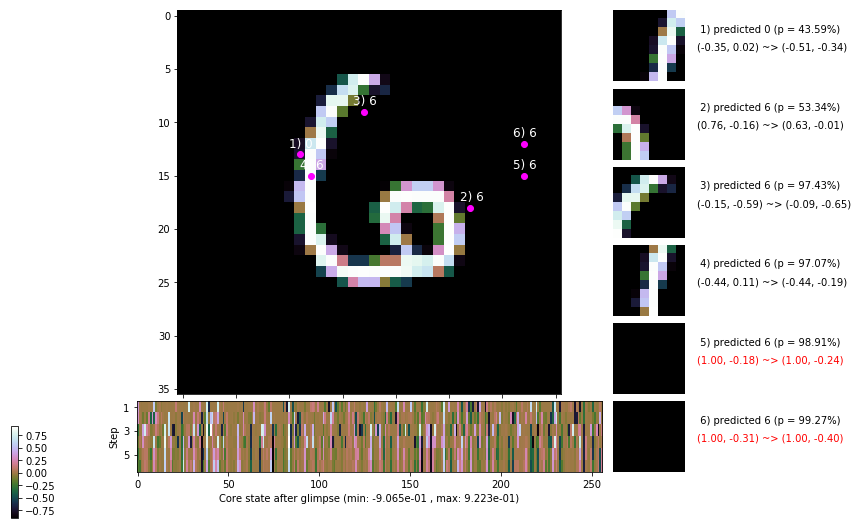

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


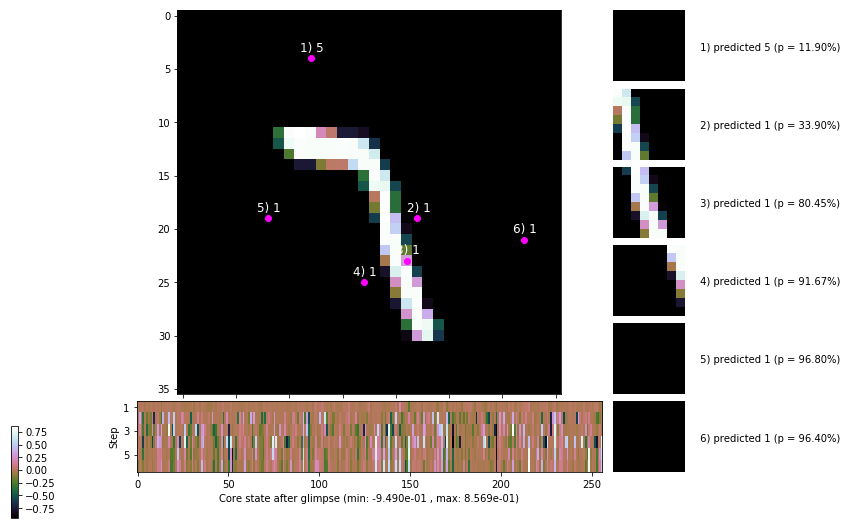


	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


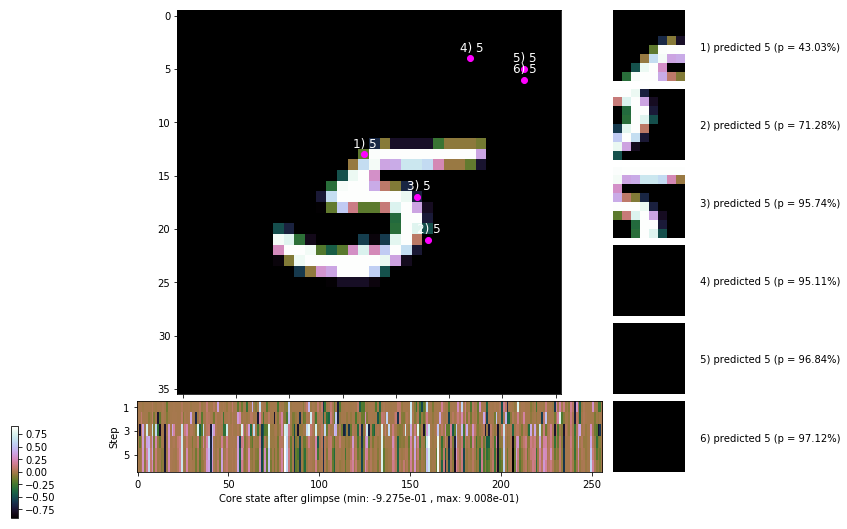

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


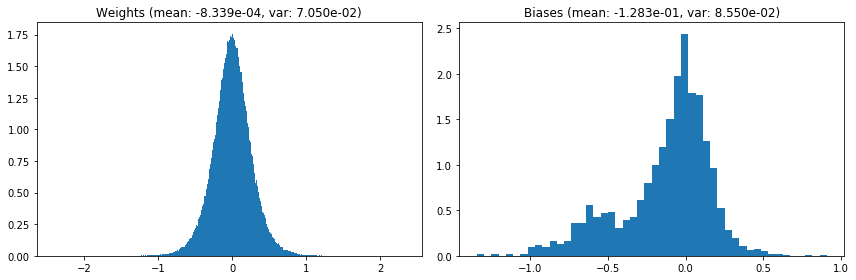

                                      Location network weights and biases


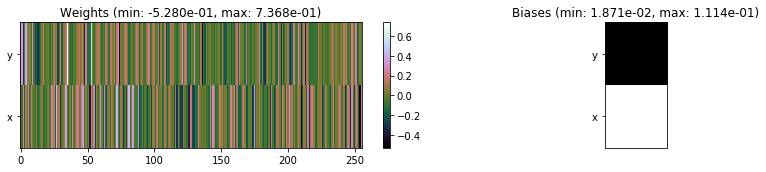

---------------------------------------------------------------------------------------------------------------
Elapsed time:  480.98 sec | TRAIN >> class loss: 0.3626 | steps:  2.262 :( | reward:  3.6260 :( | acc.: 87.810% :(
                          | VAL   >> class loss: 0.3447 | steps:  2.149    | reward:  3.8643    | acc.: 88.720% :(


Epoch  42/400) lr = 0.0005405
 b    300/  3000 >> 158.2 ms/b | lr: 5.40e-04 | grad 2norm: 14.17 | grad inf norm:  3.954
         Weights || abs max:  2.40 ( 2980.52) | mean: -8.35e-04 ( 0.01) | var: 7.05e-02 (  366.54)
          Biases || abs max:  1.35 (   47.06) | mean: -1.28e-01 ( 0.07) | var: 8.55e-02 (   12.29)
                    class loss: 0.363 | steps: 2.268 | reward:  3.621 | acc.: 87.72%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.5 ms/b | lr: 5.39e-04 | grad 2norm: 14.09 | grad inf norm:  3.926
         Weights || abs max:  2.41 ( 5461.84) | mean: -8.54e-04 (

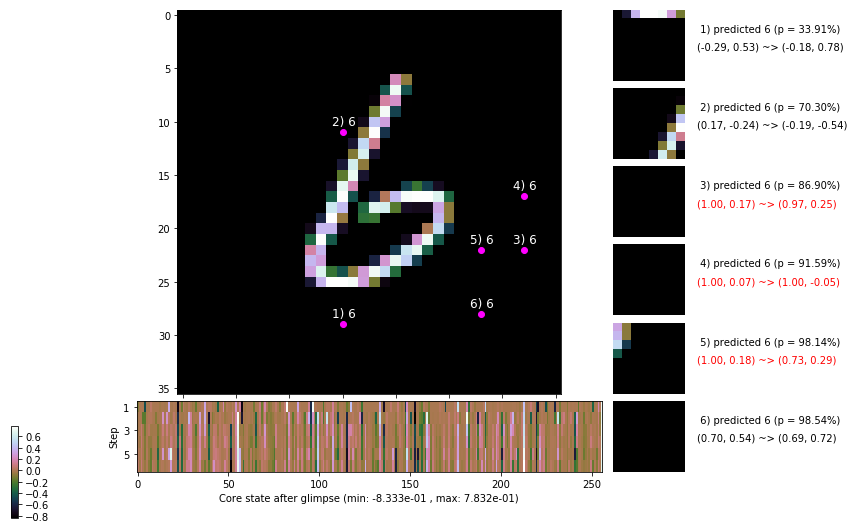

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 161.8 ms/b | lr: 5.38e-04 | grad 2norm: 14.41 | grad inf norm:  4.011
         Weights || abs max:  2.40 (14652.03) | mean: -8.50e-04 ( 0.03) | var: 7.07e-02 (71050.87)
          Biases || abs max:  1.35 (  118.82) | mean: -1.29e-01 ( 0.11) | var: 8.59e-02 (  318.47)
                    class loss: 0.379 | steps: 2.264 | reward:  3.588 | acc.: 86.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 152.4 ms/b | lr: 5.38e-04 | grad 2norm: 14.27 | grad inf norm:  4.115
         Weights || abs max:  2.40 ( 3477.94) | mean: -8.33e-04 ( 0.01) | var: 7.07e-02 (  495.28)
          Biases || abs max:  1.34 (  101.94) | mean: -1.29e-01 ( 0.10) | var: 8.59e-02 (   81.92)
                    class loss: 0.362 | steps: 2.270 | reward:  3.625 | acc.: 87.78%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

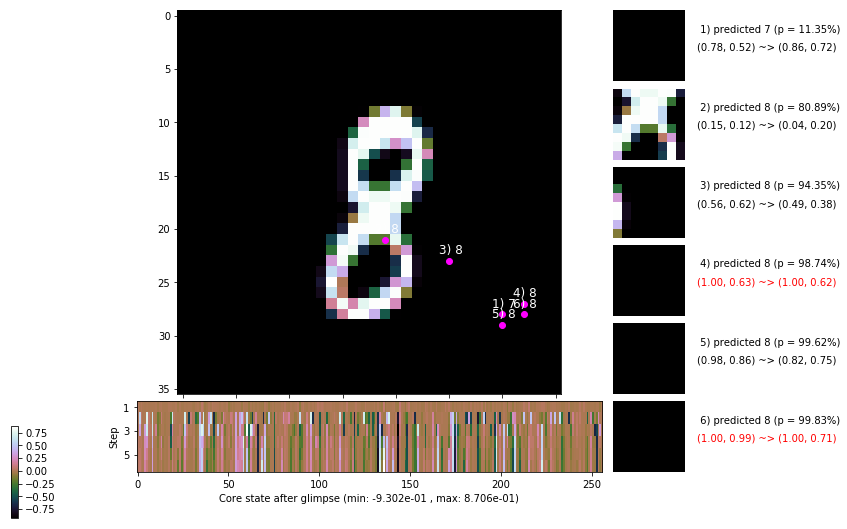

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 152.2 ms/b | lr: 5.37e-04 | grad 2norm: 14.33 | grad inf norm:  3.864
         Weights || abs max:  2.40 ( 1883.16) | mean: -8.39e-04 ( 0.01) | var: 7.08e-02 (   95.92)
          Biases || abs max:  1.34 (  160.10) | mean: -1.29e-01 ( 0.11) | var: 8.59e-02 (   91.50)
                    class loss: 0.361 | steps: 2.293 | reward:  3.606 | acc.: 88.07%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 157.7 ms/b | lr: 5.36e-04 | grad 2norm: 14.31 | grad inf norm:  3.829
         Weights || abs max:  2.41 ( 3370.27) | mean: -8.50e-04 ( 0.01) | var: 7.09e-02 (  247.54)
          Biases || abs max:  1.35 (  212.87) | mean: -1.29e-01 ( 0.14) | var: 8.59e-02 (  106.70)
                    class loss: 0.376 | steps: 2.279 | reward:  3.597 | acc.: 87.23%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

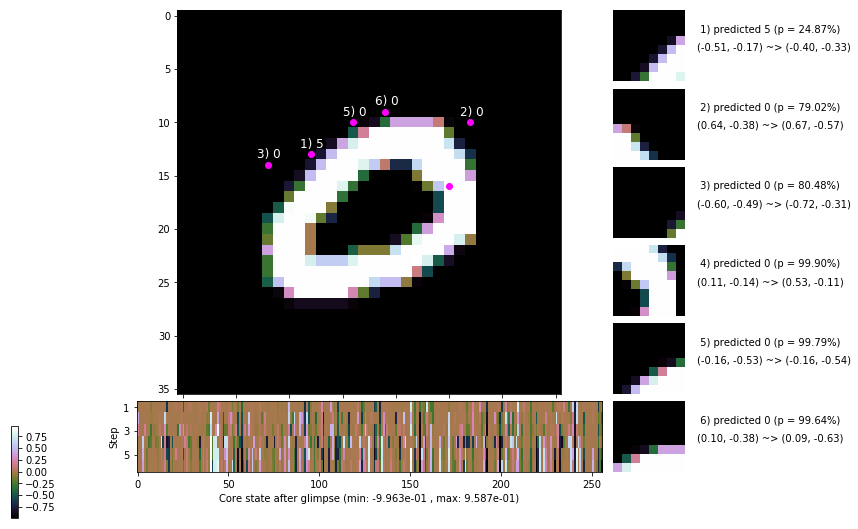

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.5 ms/b | lr: 5.35e-04 | grad 2norm: 14.39 | grad inf norm:  3.873
         Weights || abs max:  2.41 ( 4691.29) | mean: -8.32e-04 ( 0.02) | var: 7.09e-02 (  629.03)
          Biases || abs max:  1.35 (  913.57) | mean: -1.29e-01 ( 0.41) | var: 8.59e-02 ( 8134.43)
                    class loss: 0.380 | steps: 2.287 | reward:  3.579 | acc.: 87.12%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 155.3 ms/b | lr: 5.35e-04 | grad 2norm: 14.54 | grad inf norm:  4.108
         Weights || abs max:  2.42 ( 4443.94) | mean: -8.42e-04 ( 0.02) | var: 7.10e-02 ( 1989.85)
          Biases || abs max:  1.35 ( 1157.70) | mean: -1.29e-01 ( 0.60) | var: 8.60e-02 (53262.96)
                    class loss: 0.369 | steps: 2.288 | reward:  3.575 | acc.: 87.05%

	Target class: 9 | Discounted rewards: [-0.281, 0.438, 1.

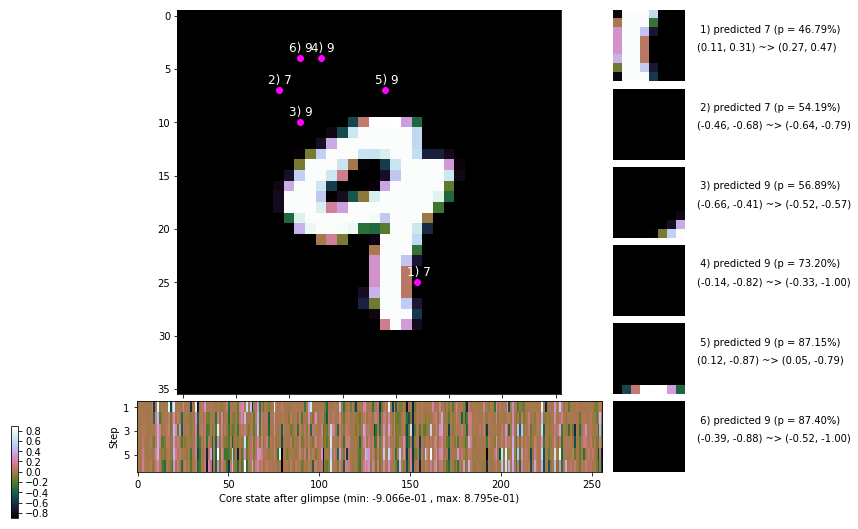

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 161.8 ms/b | lr: 5.33e-04 | grad 2norm: 14.08 | grad inf norm:  3.878
         Weights || abs max:  2.42 ( 1973.43) | mean: -8.69e-04 ( 0.01) | var: 7.10e-02 (   80.17)
          Biases || abs max:  1.35 (  621.44) | mean: -1.29e-01 ( 0.48) | var: 8.62e-02 (48705.68)
                    class loss: 0.373 | steps: 2.267 | reward:  3.624 | acc.: 87.90%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.0 ms/b | lr: 5.33e-04 | grad 2norm: 14.72 | grad inf norm:  4.152
         Weights || abs max:  2.42 ( 6032.60) | mean: -8.71e-04 ( 0.02) | var: 7.11e-02 ( 5161.21)
          Biases || abs max:  1.35 (   82.64) | mean: -1.30e-01 ( 0.08) | var: 8.65e-02 (   43.25)
                    class loss: 0.415 | steps: 2.324 | reward:  3.483 | acc.: 86.18%

	Target class: 3 | Discounted rewards: [0.516, -0.969, -0

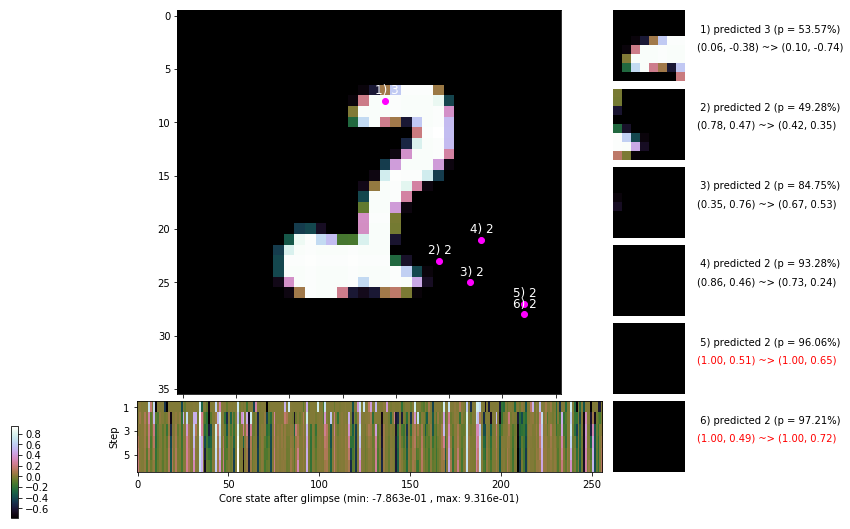

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


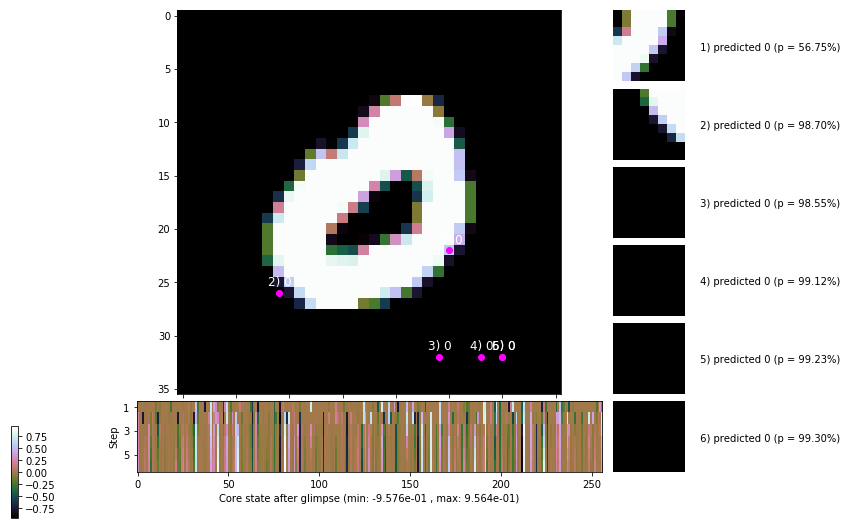


	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


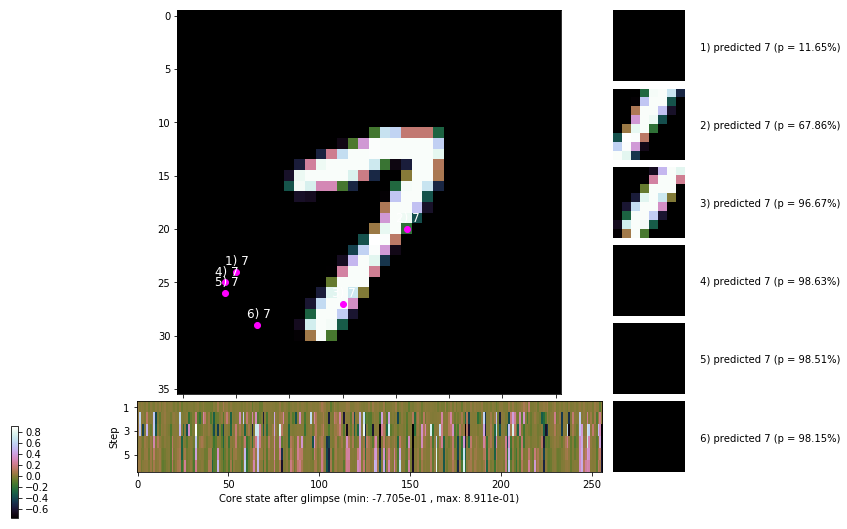

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


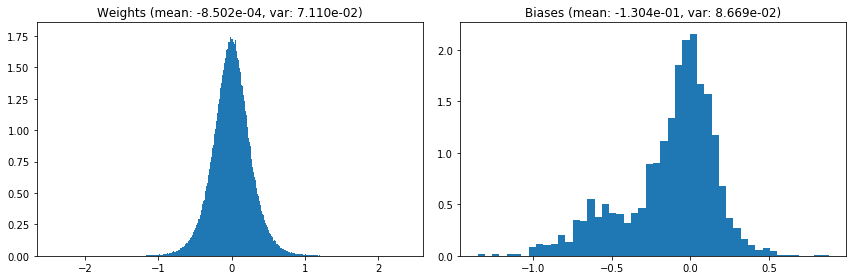

                                      Location network weights and biases


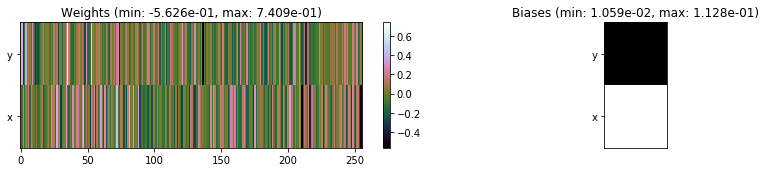

---------------------------------------------------------------------------------------------------------------
Elapsed time:  470.15 sec | TRAIN >> class loss: 0.3723 | steps:  2.282 :( | reward:  3.5942 :( | acc.: 87.407% :(
                          | VAL   >> class loss: 0.3520 | steps:  2.157 :( | reward:  3.8262 :( | acc.: 88.440% :(


Epoch  43/400) lr = 0.0005324
 b    300/  3000 >> 154.1 ms/b | lr: 5.32e-04 | grad 2norm: 14.09 | grad inf norm:  3.848
         Weights || abs max:  2.43 ( 1880.99) | mean: -8.51e-04 ( 0.01) | var: 7.11e-02 (   63.93)
          Biases || abs max:  1.35 (  564.26) | mean: -1.30e-01 ( 0.28) | var: 8.65e-02 ( 1615.88)
                    class loss: 0.369 | steps: 2.276 | reward:  3.607 | acc.: 87.08%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 150.8 ms/b | lr: 5.31e-04 | grad 2norm: 14.23 | grad inf norm:  3.939
         Weights || abs max:  2.43 ( 4889.32) | mean: -8.13e-04 (

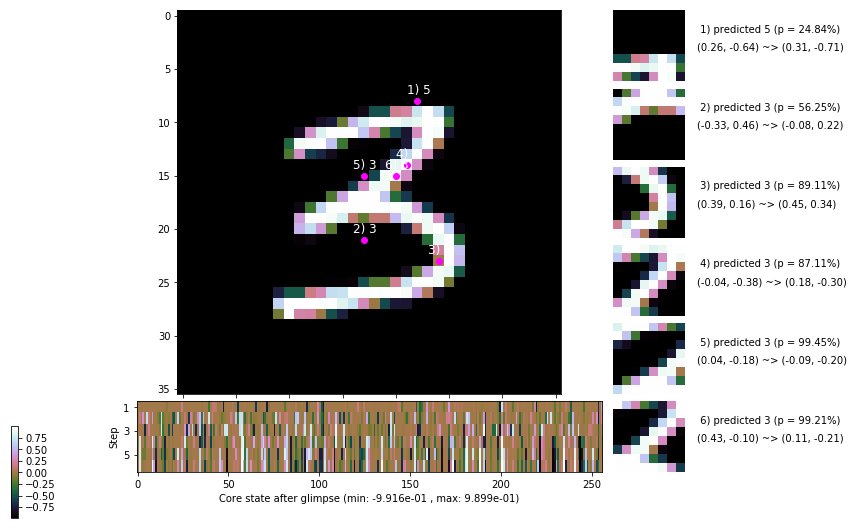

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 166.9 ms/b | lr: 5.30e-04 | grad 2norm: 14.43 | grad inf norm:  4.036
         Weights || abs max:  2.42 ( 2547.79) | mean: -7.84e-04 ( 0.01) | var: 7.13e-02 (  345.16)
          Biases || abs max:  1.36 (  113.00) | mean: -1.30e-01 ( 0.09) | var: 8.64e-02 (   48.21)
                    class loss: 0.399 | steps: 2.321 | reward:  3.504 | acc.: 86.72%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.0 ms/b | lr: 5.30e-04 | grad 2norm: 14.60 | grad inf norm:  4.217
         Weights || abs max:  2.42 ( 5121.97) | mean: -7.79e-04 ( 0.02) | var: 7.14e-02 ( 5936.38)
          Biases || abs max:  1.36 (   81.65) | mean: -1.30e-01 ( 0.09) | var: 8.65e-02 (   12.07)
                    class loss: 0.410 | steps: 2.282 | reward:  3.549 | acc.: 86.08%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

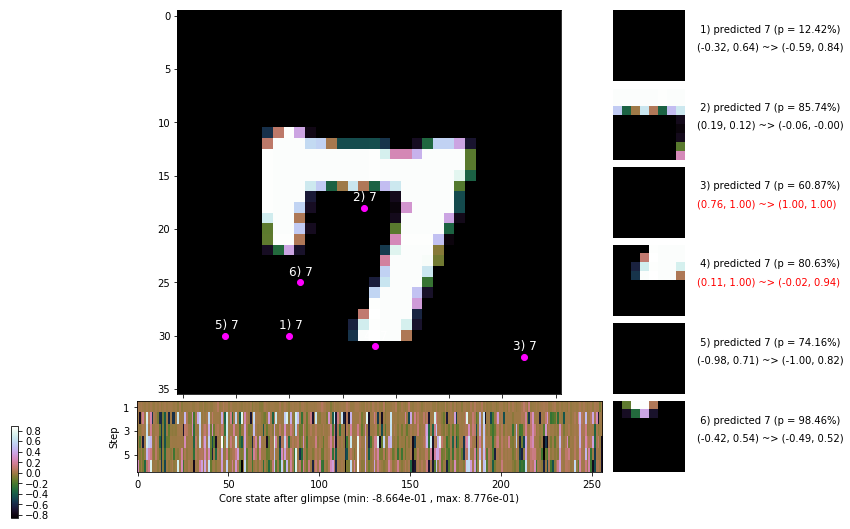

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.0 ms/b | lr: 5.29e-04 | grad 2norm: 14.40 | grad inf norm:  3.940
         Weights || abs max:  2.43 ( 3102.49) | mean: -7.75e-04 ( 0.01) | var: 7.14e-02 (  433.87)
          Biases || abs max:  1.37 (   70.93) | mean: -1.30e-01 ( 0.08) | var: 8.67e-02 (   20.42)
                    class loss: 0.391 | steps: 2.308 | reward:  3.507 | acc.: 86.73%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 159.3 ms/b | lr: 5.28e-04 | grad 2norm: 14.38 | grad inf norm:  4.121
         Weights || abs max:  2.43 ( 2341.40) | mean: -7.51e-04 ( 0.01) | var: 7.15e-02 (  124.52)
          Biases || abs max:  1.38 (  188.88) | mean: -1.30e-01 ( 0.13) | var: 8.67e-02 (  127.58)
                    class loss: 0.396 | steps: 2.292 | reward:  3.557 | acc.: 86.48%

	Target class: 1 | Discounted rewards: [0.516, -0.969, -0

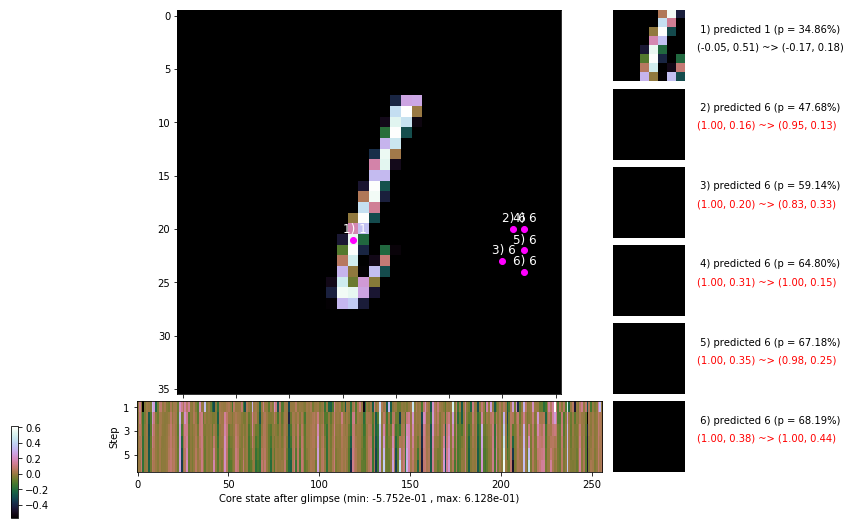

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 159.6 ms/b | lr: 5.27e-04 | grad 2norm: 14.30 | grad inf norm:  3.924
         Weights || abs max:  2.44 ( 1646.53) | mean: -7.42e-04 ( 0.01) | var: 7.15e-02 (   30.53)
          Biases || abs max:  1.37 ( 1056.04) | mean: -1.30e-01 ( 0.46) | var: 8.68e-02 (13971.53)
                    class loss: 0.392 | steps: 2.310 | reward:  3.552 | acc.: 86.70%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.6 ms/b | lr: 5.27e-04 | grad 2norm: 14.38 | grad inf norm:  3.952
         Weights || abs max:  2.43 ( 7082.06) | mean: -7.17e-04 ( 0.02) | var: 7.16e-02 (12672.24)
          Biases || abs max:  1.38 (  161.67) | mean: -1.30e-01 ( 0.14) | var: 8.69e-02 (  704.89)
                    class loss: 0.399 | steps: 2.306 | reward:  3.531 | acc.: 86.37%

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.8

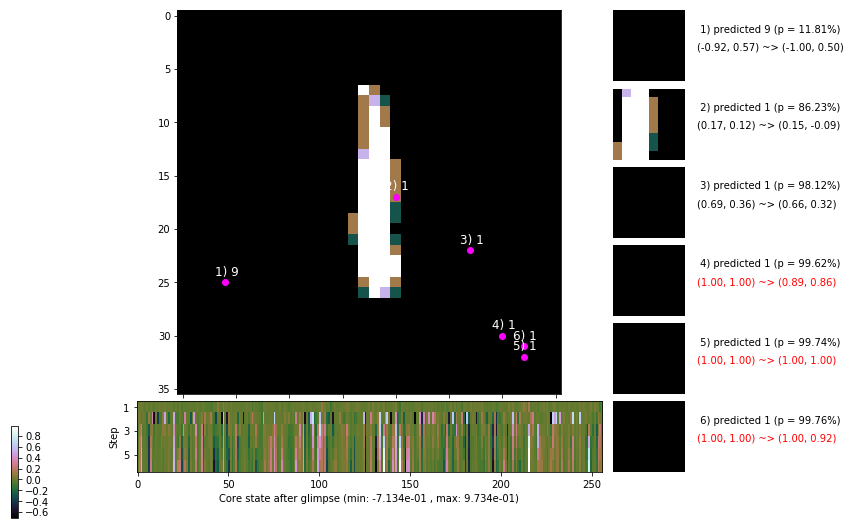

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 144.4 ms/b | lr: 5.26e-04 | grad 2norm: 14.33 | grad inf norm:  3.906
         Weights || abs max:  2.42 ( 2181.24) | mean: -7.11e-04 ( 0.01) | var: 7.17e-02 (  151.99)
          Biases || abs max:  1.38 (  129.23) | mean: -1.30e-01 ( 0.10) | var: 8.71e-02 (  498.67)
                    class loss: 0.398 | steps: 2.271 | reward:  3.571 | acc.: 86.42%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.0 ms/b | lr: 5.25e-04 | grad 2norm: 14.35 | grad inf norm:  4.058
         Weights || abs max:  2.43 ( 3304.73) | mean: -7.03e-04 ( 0.01) | var: 7.17e-02 (  169.08)
          Biases || abs max:  1.38 (  574.42) | mean: -1.31e-01 ( 0.47) | var: 8.73e-02 (55984.52)
                    class loss: 0.403 | steps: 2.285 | reward:  3.557 | acc.: 86.12%

	Target class: 6 | Discounted rewards: [-0.656, -0.312, 0

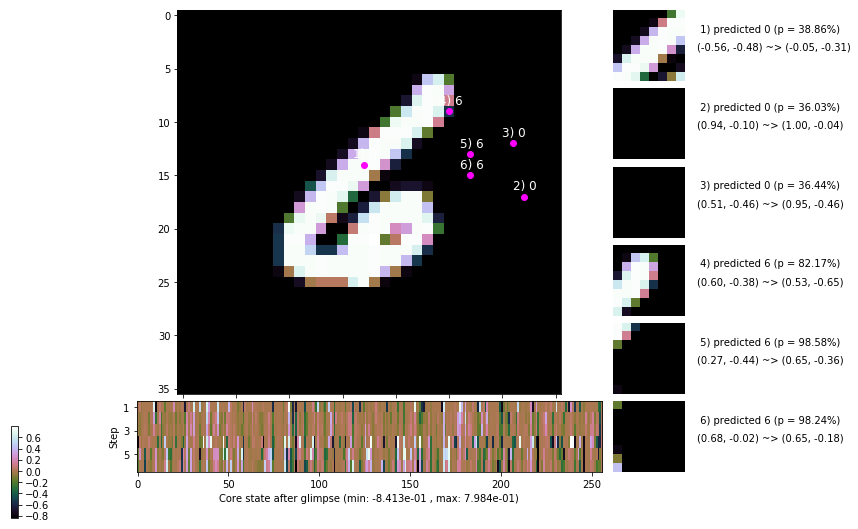

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


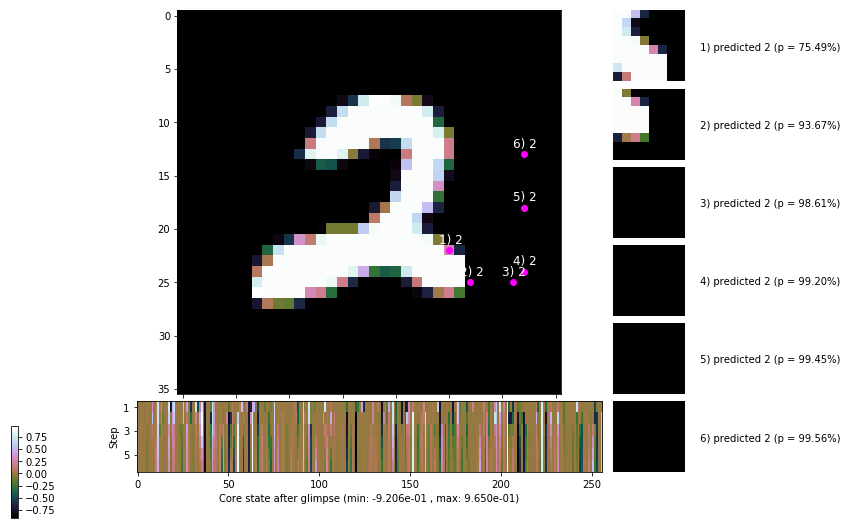


	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


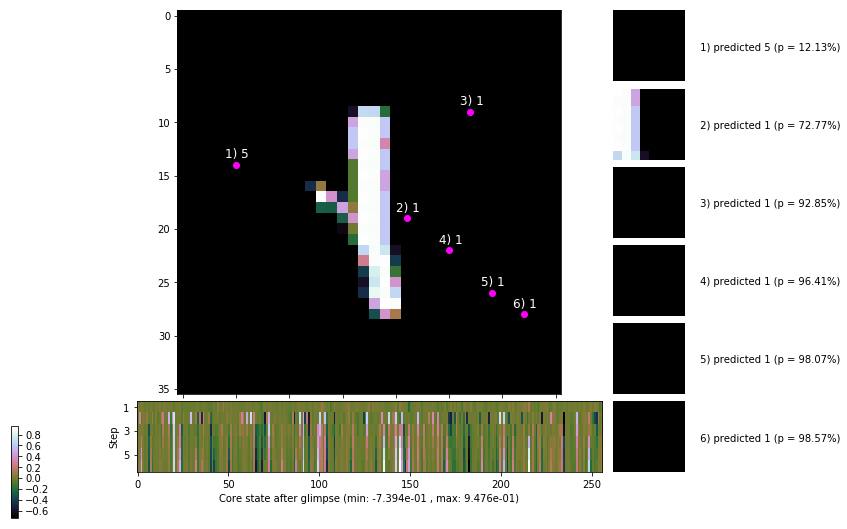

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


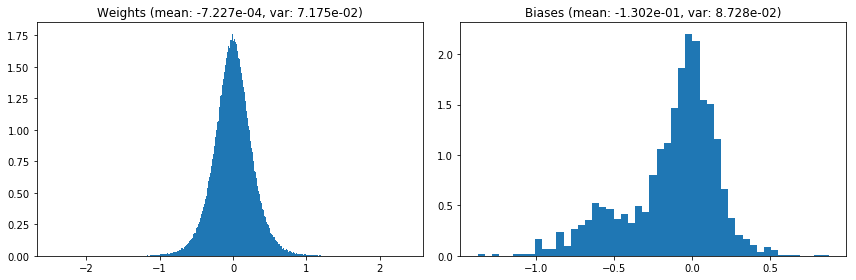

                                      Location network weights and biases


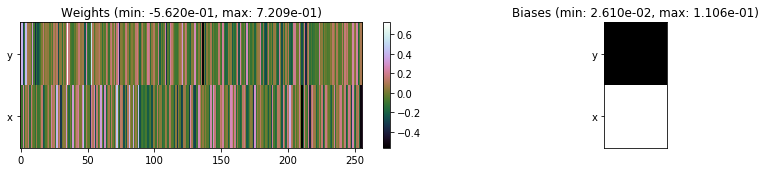

---------------------------------------------------------------------------------------------------------------
Elapsed time:  466.99 sec | TRAIN >> class loss: 0.3923 | steps:  2.288 :( | reward:  3.5602 :( | acc.: 86.662% :(
                          | VAL   >> class loss: 0.3739 | steps:  2.172 :( | reward:  3.7656 :( | acc.: 87.200% :(


Epoch  44/400) lr = 0.0005245
 b    300/  3000 >> 147.9 ms/b | lr: 5.24e-04 | grad 2norm: 14.58 | grad inf norm:  4.032
         Weights || abs max:  2.45 ( 2092.19) | mean: -7.45e-04 ( 0.01) | var: 7.18e-02 (   64.15)
          Biases || abs max:  1.38 (   80.49) | mean: -1.30e-01 ( 0.08) | var: 8.72e-02 (   51.41)
                    class loss: 0.402 | steps: 2.304 | reward:  3.513 | acc.: 86.67%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 155.4 ms/b | lr: 5.23e-04 | grad 2norm: 14.45 | grad inf norm:  4.037
         Weights || abs max:  2.45 ( 4438.93) | mean: -7.47e-04 (

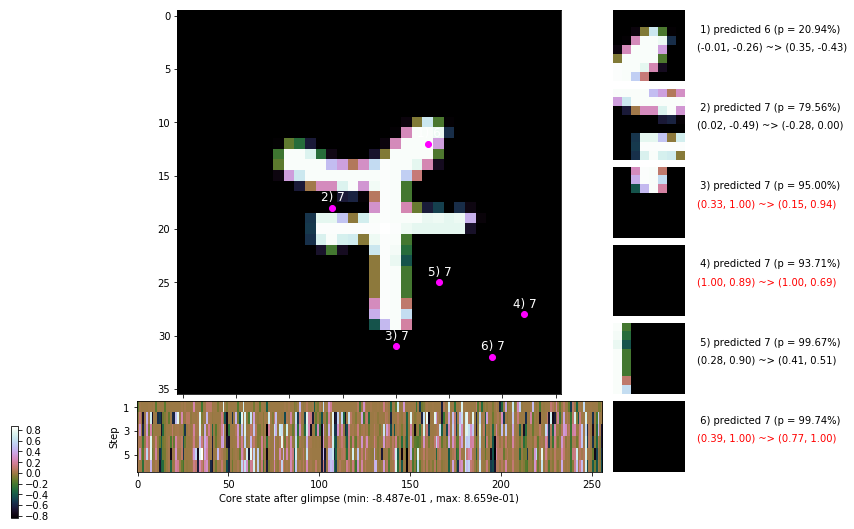

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 150.1 ms/b | lr: 5.22e-04 | grad 2norm: 14.15 | grad inf norm:  4.082
         Weights || abs max:  2.45 ( 2118.06) | mean: -7.66e-04 ( 0.01) | var: 7.19e-02 (   88.01)
          Biases || abs max:  1.38 (   62.86) | mean: -1.30e-01 ( 0.07) | var: 8.75e-02 (   17.62)
                    class loss: 0.383 | steps: 2.282 | reward:  3.608 | acc.: 87.63%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 154.2 ms/b | lr: 5.22e-04 | grad 2norm: 14.47 | grad inf norm:  4.079
         Weights || abs max:  2.45 ( 2563.85) | mean: -7.62e-04 ( 0.01) | var: 7.20e-02 (  192.05)
          Biases || abs max:  1.38 (  120.32) | mean: -1.31e-01 ( 0.10) | var: 8.76e-02 (  114.87)
                    class loss: 0.398 | steps: 2.299 | reward:  3.560 | acc.: 86.45%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

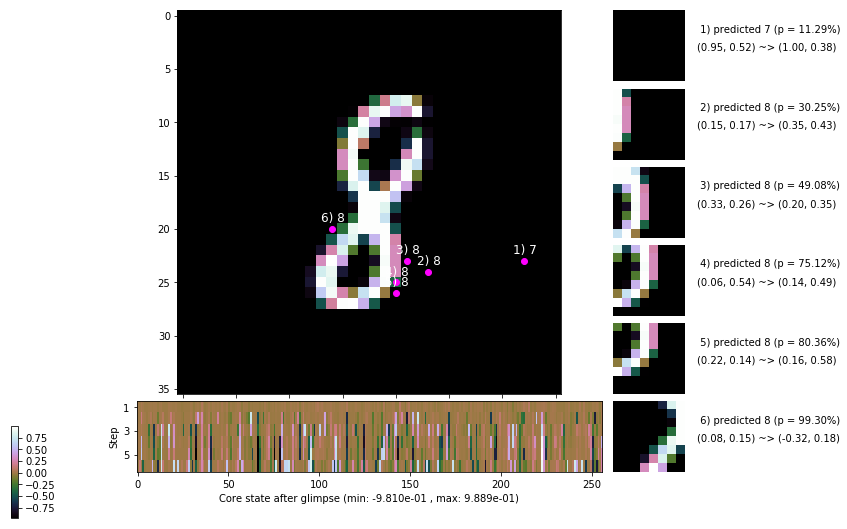

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.0 ms/b | lr: 5.21e-04 | grad 2norm: 14.43 | grad inf norm:  4.065
         Weights || abs max:  2.45 ( 2892.07) | mean: -7.70e-04 ( 0.01) | var: 7.20e-02 (  297.01)
          Biases || abs max:  1.39 (  132.85) | mean: -1.31e-01 ( 0.11) | var: 8.77e-02 (  492.90)
                    class loss: 0.413 | steps: 2.311 | reward:  3.503 | acc.: 85.82%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.5 ms/b | lr: 5.20e-04 | grad 2norm: 14.16 | grad inf norm:  3.996
         Weights || abs max:  2.44 ( 2672.64) | mean: -7.87e-04 ( 0.01) | var: 7.21e-02 (  317.77)
          Biases || abs max:  1.39 (  180.27) | mean: -1.31e-01 ( 0.13) | var: 8.78e-02 (  358.17)
                    class loss: 0.400 | steps: 2.297 | reward:  3.568 | acc.: 86.83%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

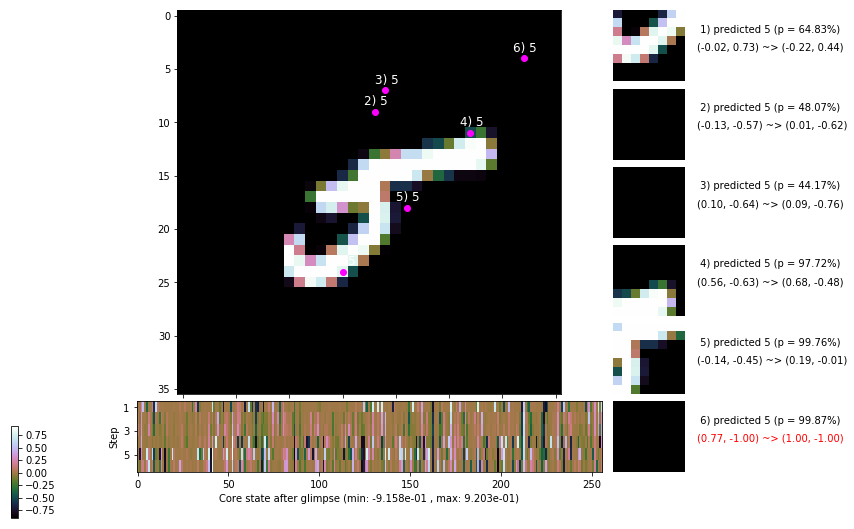

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.3 ms/b | lr: 5.19e-04 | grad 2norm: 14.41 | grad inf norm:  4.146
         Weights || abs max:  2.44 ( 4405.53) | mean: -7.86e-04 ( 0.02) | var: 7.22e-02 (  812.14)
          Biases || abs max:  1.39 (   77.89) | mean: -1.31e-01 ( 0.08) | var: 8.77e-02 (   41.36)
                    class loss: 0.398 | steps: 2.317 | reward:  3.545 | acc.: 86.68%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 168.9 ms/b | lr: 5.19e-04 | grad 2norm: 14.15 | grad inf norm:  3.924
         Weights || abs max:  2.44 ( 2954.05) | mean: -7.81e-04 ( 0.01) | var: 7.22e-02 (  394.76)
          Biases || abs max:  1.39 (  130.41) | mean: -1.30e-01 ( 0.11) | var: 8.75e-02 (  187.46)
                    class loss: 0.376 | steps: 2.283 | reward:  3.579 | acc.: 87.32%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

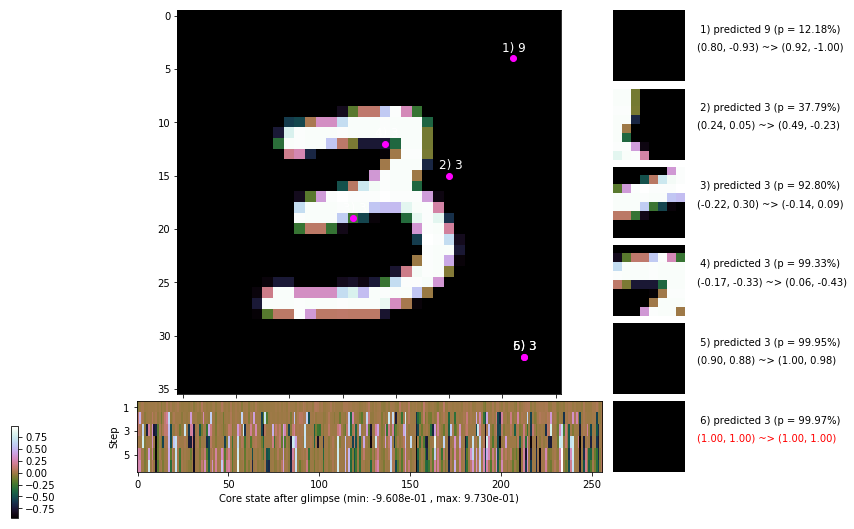

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 162.4 ms/b | lr: 5.18e-04 | grad 2norm: 14.10 | grad inf norm:  3.873
         Weights || abs max:  2.44 ( 2260.26) | mean: -7.89e-04 ( 0.01) | var: 7.23e-02 (   97.25)
          Biases || abs max:  1.40 (   74.55) | mean: -1.30e-01 ( 0.08) | var: 8.76e-02 (   35.84)
                    class loss: 0.396 | steps: 2.265 | reward:  3.595 | acc.: 86.93%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 157.6 ms/b | lr: 5.17e-04 | grad 2norm: 14.40 | grad inf norm:  4.034
         Weights || abs max:  2.43 ( 5565.82) | mean: -7.88e-04 ( 0.02) | var: 7.23e-02 ( 3941.54)
          Biases || abs max:  1.40 (  143.56) | mean: -1.30e-01 ( 0.12) | var: 8.78e-02 (  338.26)
                    class loss: 0.416 | steps: 2.314 | reward:  3.521 | acc.: 86.07%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

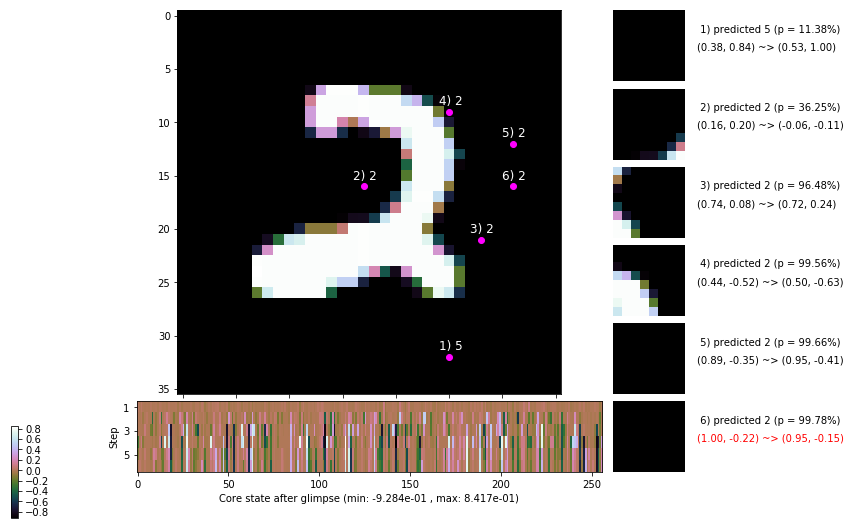

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


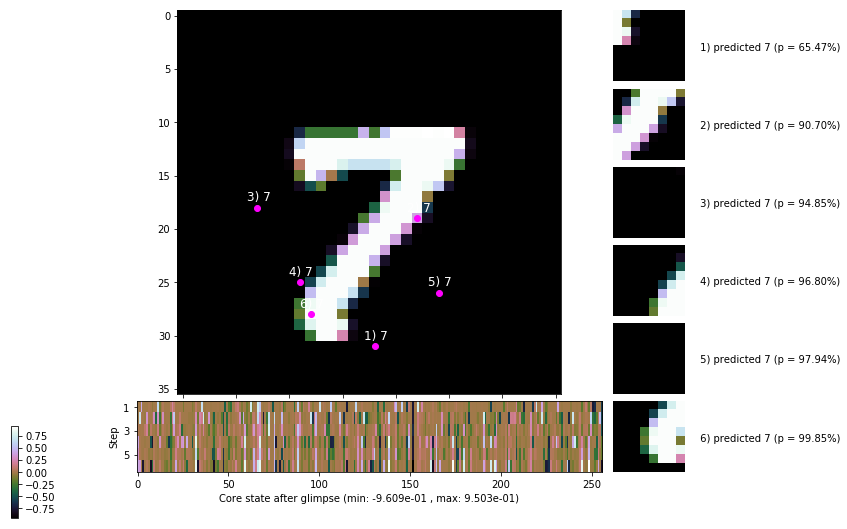


	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


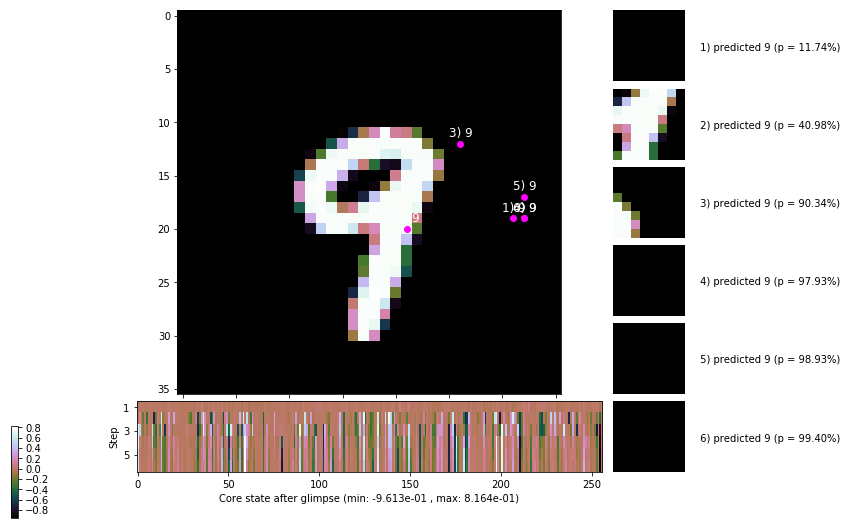

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


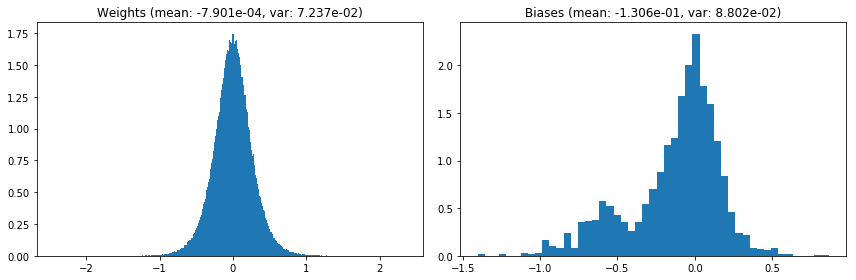

                                      Location network weights and biases


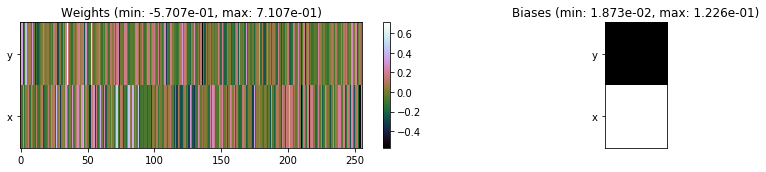

---------------------------------------------------------------------------------------------------------------
Elapsed time:  468.53 sec | TRAIN >> class loss: 0.3978 | steps:  2.293 :( | reward:  3.5589 :( | acc.: 86.702% :(
                          | VAL   >> class loss: 0.4080 | steps:  2.194 :( | reward:  3.7185 :( | acc.: 85.920% :(


Epoch  45/400) lr = 0.0005167
 b    300/  3000 >> 153.3 ms/b | lr: 5.16e-04 | grad 2norm: 14.29 | grad inf norm:  4.038
         Weights || abs max:  2.43 ( 5759.90) | mean: -7.72e-04 ( 0.02) | var: 7.24e-02 ( 3395.44)
          Biases || abs max:  1.40 (  124.06) | mean: -1.31e-01 ( 0.09) | var: 8.80e-02 (  339.47)
                    class loss: 0.405 | steps: 2.297 | reward:  3.539 | acc.: 85.98%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.2 ms/b | lr: 5.16e-04 | grad 2norm: 14.23 | grad inf norm:  3.881
         Weights || abs max:  2.43 ( 2980.29) | mean: -7.50e-04 (

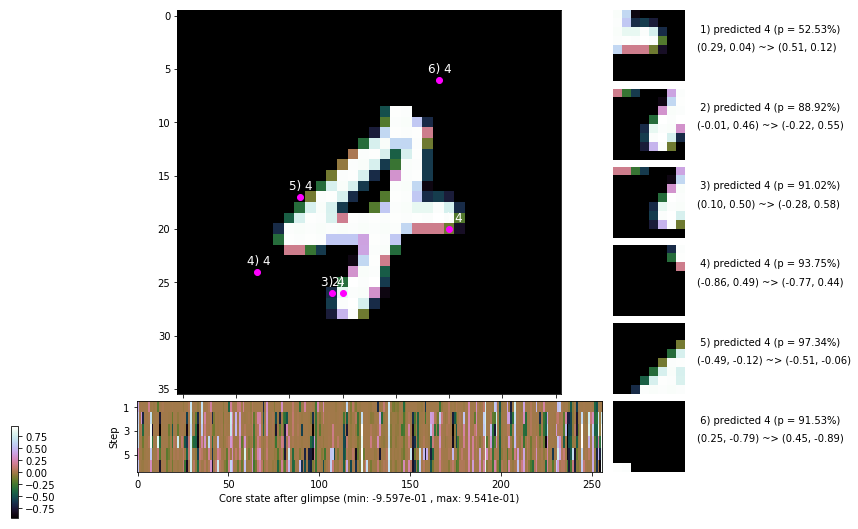

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 151.2 ms/b | lr: 5.15e-04 | grad 2norm: 14.30 | grad inf norm:  4.049
         Weights || abs max:  2.43 ( 3848.09) | mean: -7.26e-04 ( 0.01) | var: 7.25e-02 ( 1427.85)
          Biases || abs max:  1.39 (  150.90) | mean: -1.31e-01 ( 0.11) | var: 8.80e-02 (  302.17)
                    class loss: 0.409 | steps: 2.313 | reward:  3.519 | acc.: 86.23%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 147.1 ms/b | lr: 5.14e-04 | grad 2norm: 14.33 | grad inf norm:  4.053
         Weights || abs max:  2.44 ( 3443.04) | mean: -7.19e-04 ( 0.01) | var: 7.26e-02 (  980.52)
          Biases || abs max:  1.39 (  113.07) | mean: -1.31e-01 ( 0.10) | var: 8.80e-02 (   60.36)
                    class loss: 0.402 | steps: 2.304 | reward:  3.536 | acc.: 86.27%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

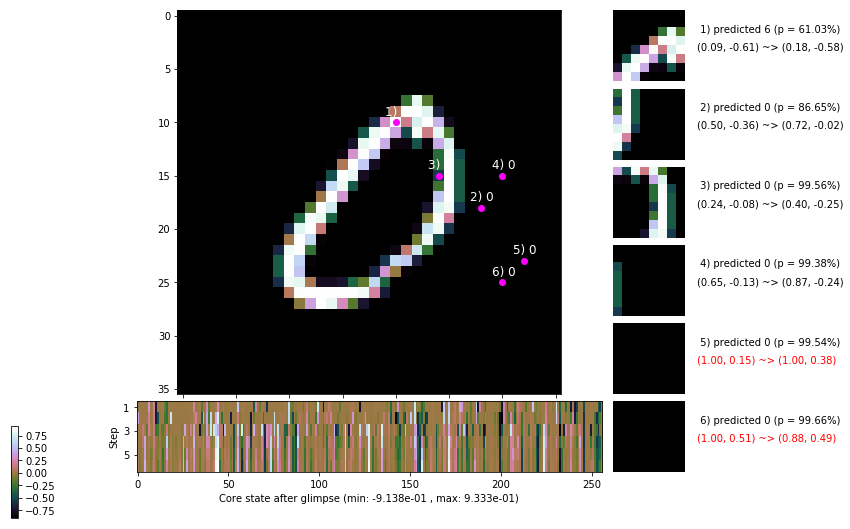

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 150.9 ms/b | lr: 5.13e-04 | grad 2norm: 14.18 | grad inf norm:  4.092
         Weights || abs max:  2.44 ( 3640.85) | mean: -7.07e-04 ( 0.01) | var: 7.26e-02 (  384.04)
          Biases || abs max:  1.39 (  307.10) | mean: -1.30e-01 ( 0.19) | var: 8.81e-02 (  760.74)
                    class loss: 0.381 | steps: 2.253 | reward:  3.630 | acc.: 87.42%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.5 ms/b | lr: 5.13e-04 | grad 2norm: 14.21 | grad inf norm:  3.981
         Weights || abs max:  2.44 ( 3255.41) | mean: -7.14e-04 ( 0.01) | var: 7.27e-02 (  518.82)
          Biases || abs max:  1.39 (  287.51) | mean: -1.31e-01 ( 0.18) | var: 8.82e-02 ( 1026.08)
                    class loss: 0.392 | steps: 2.299 | reward:  3.562 | acc.: 86.62%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

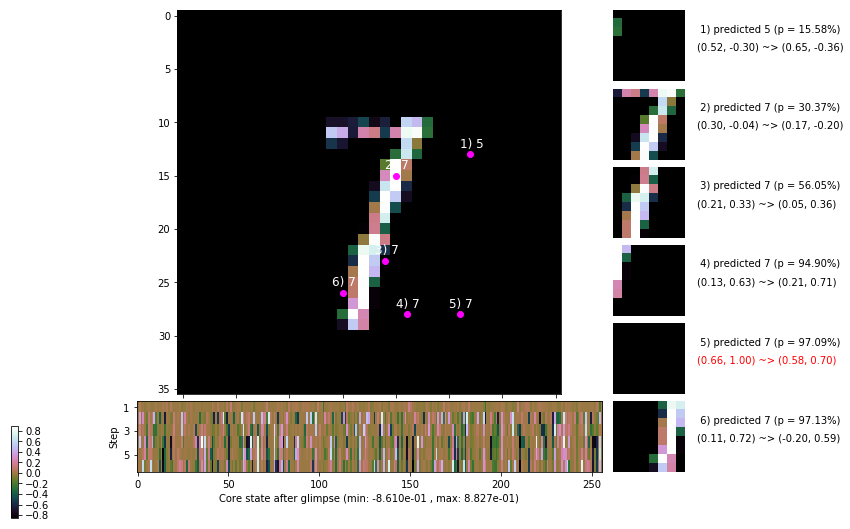

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 147.3 ms/b | lr: 5.12e-04 | grad 2norm: 14.13 | grad inf norm:  3.856
         Weights || abs max:  2.45 ( 2041.68) | mean: -7.26e-04 ( 0.01) | var: 7.27e-02 (  137.46)
          Biases || abs max:  1.40 (  893.34) | mean: -1.30e-01 ( 0.41) | var: 8.82e-02 (29905.78)
                    class loss: 0.378 | steps: 2.265 | reward:  3.642 | acc.: 87.58%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 148.3 ms/b | lr: 5.11e-04 | grad 2norm: 14.15 | grad inf norm:  3.979
         Weights || abs max:  2.46 (10130.93) | mean: -7.34e-04 ( 0.03) | var: 7.28e-02 (41187.89)
          Biases || abs max:  1.40 (  250.88) | mean: -1.31e-01 ( 0.15) | var: 8.83e-02 ( 1262.13)
                    class loss: 0.379 | steps: 2.305 | reward:  3.568 | acc.: 86.95%

	Target class: 3 | Discounted rewards: [-0.656, -0.312, 0

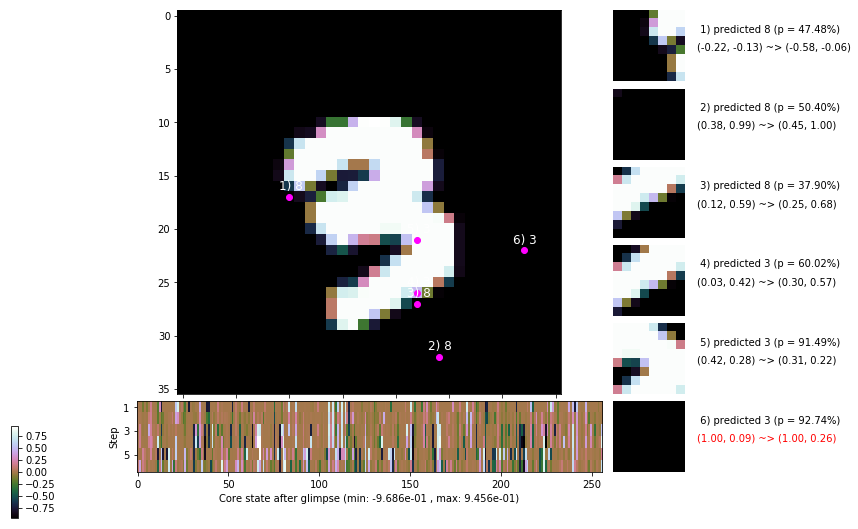

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.7 ms/b | lr: 5.10e-04 | grad 2norm: 13.89 | grad inf norm:  3.876
         Weights || abs max:  2.46 ( 2304.66) | mean: -7.39e-04 ( 0.01) | var: 7.29e-02 (   73.80)
          Biases || abs max:  1.40 (   90.13) | mean: -1.31e-01 ( 0.09) | var: 8.85e-02 (   18.49)
                    class loss: 0.374 | steps: 2.253 | reward:  3.630 | acc.: 87.45%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.3 ms/b | lr: 5.09e-04 | grad 2norm: 14.31 | grad inf norm:  4.062
         Weights || abs max:  2.45 ( 2569.86) | mean: -7.18e-04 ( 0.01) | var: 7.29e-02 (  211.42)
          Biases || abs max:  1.39 (  158.71) | mean: -1.31e-01 ( 0.12) | var: 8.85e-02 (  136.82)
                    class loss: 0.373 | steps: 2.271 | reward:  3.607 | acc.: 87.40%

	Target class: 9 | Discounted rewards: [0.844, -0.312, 0.

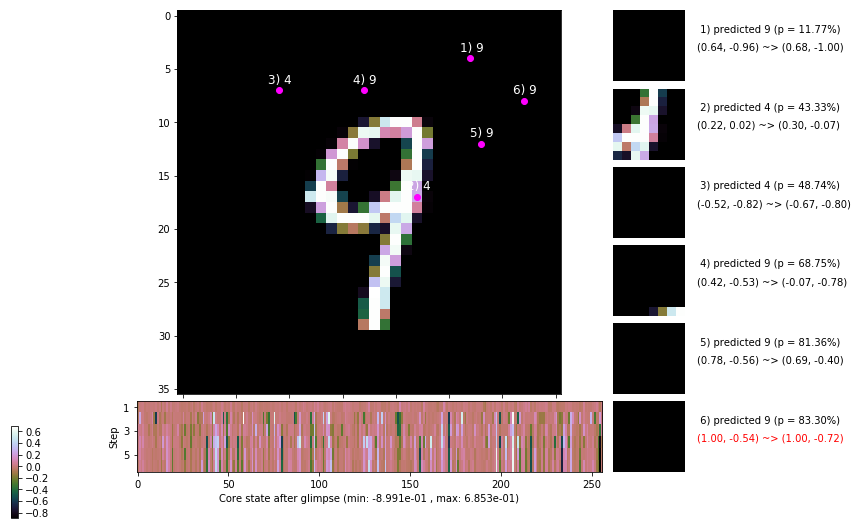

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


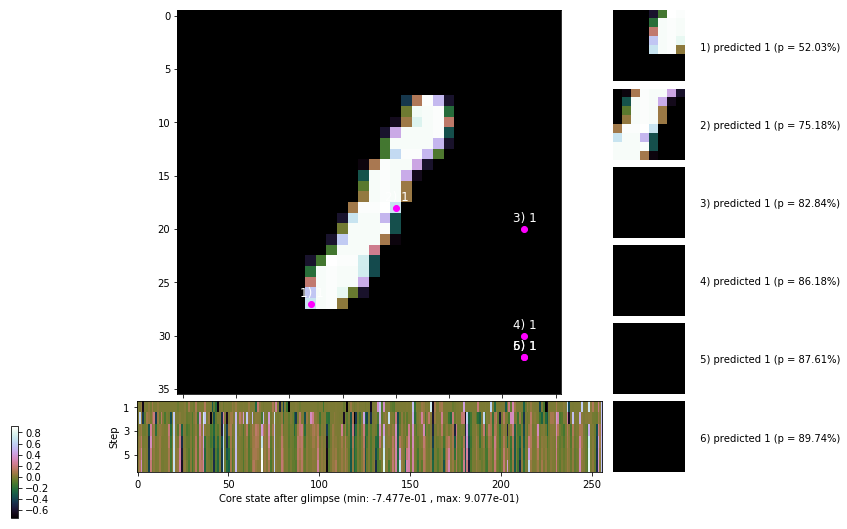


	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


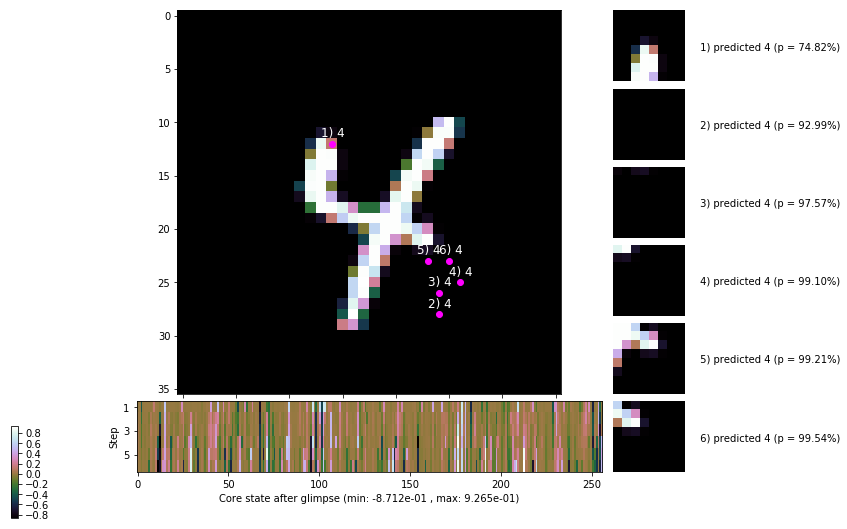

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


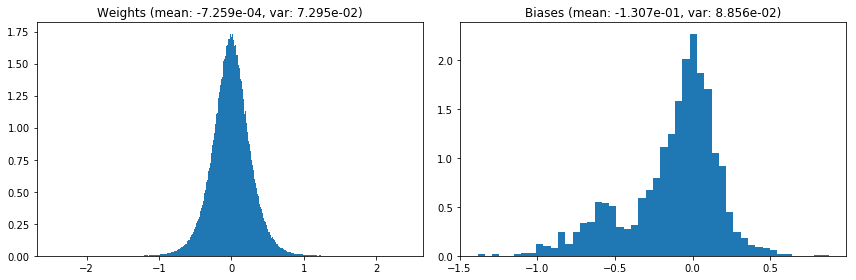

                                      Location network weights and biases


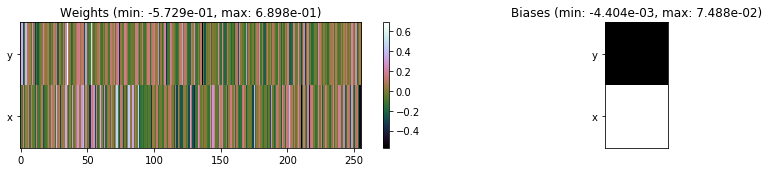

---------------------------------------------------------------------------------------------------------------
Elapsed time:  454.82 sec | TRAIN >> class loss: 0.3871 | steps:  2.285 :( | reward:  3.5810 :( | acc.: 86.938% :(
                          | VAL   >> class loss: 0.3487 | steps:  2.163 :( | reward:  3.8268 :( | acc.: 88.400% :(


Epoch  46/400) lr = 0.000509
 b    300/  3000 >> 159.8 ms/b | lr: 5.08e-04 | grad 2norm: 14.21 | grad inf norm:  4.099
         Weights || abs max:  2.45 ( 4082.74) | mean: -7.60e-04 ( 0.01) | var: 7.30e-02 ( 1037.91)
          Biases || abs max:  1.39 (   76.23) | mean: -1.31e-01 ( 0.07) | var: 8.85e-02 (   31.54)
                    class loss: 0.391 | steps: 2.321 | reward:  3.533 | acc.: 86.70%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.8 ms/b | lr: 5.08e-04 | grad 2norm: 14.32 | grad inf norm:  3.935
         Weights || abs max:  2.46 ( 2141.42) | mean: -7.88e-04 ( 

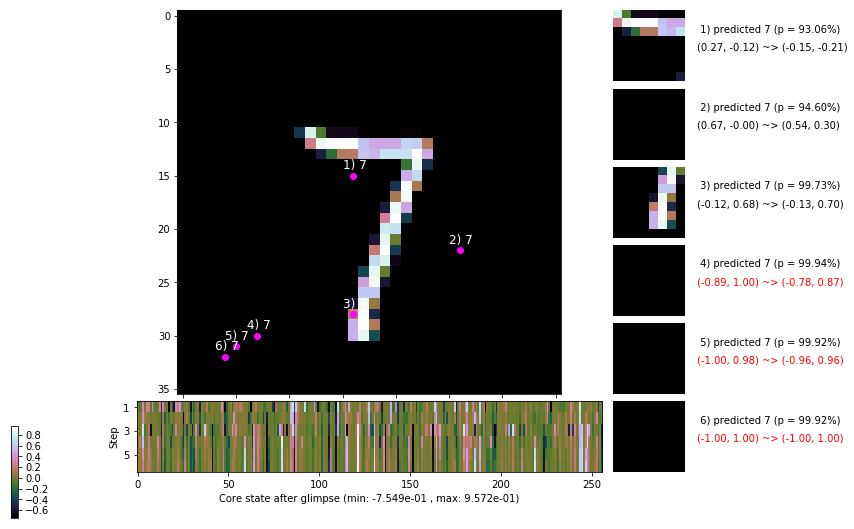

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 157.9 ms/b | lr: 5.07e-04 | grad 2norm: 14.09 | grad inf norm:  3.869
         Weights || abs max:  2.46 ( 5451.74) | mean: -7.99e-04 ( 0.02) | var: 7.31e-02 ( 1214.20)
          Biases || abs max:  1.39 (  233.04) | mean: -1.30e-01 ( 0.15) | var: 8.86e-02 ( 2084.75)
                    class loss: 0.363 | steps: 2.273 | reward:  3.613 | acc.: 87.68%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 145.7 ms/b | lr: 5.06e-04 | grad 2norm: 14.19 | grad inf norm:  3.952
         Weights || abs max:  2.47 ( 4520.04) | mean: -8.25e-04 ( 0.02) | var: 7.32e-02 ( 1324.50)
          Biases || abs max:  1.38 (  172.05) | mean: -1.31e-01 ( 0.14) | var: 8.86e-02 (  196.97)
                    class loss: 0.365 | steps: 2.295 | reward:  3.628 | acc.: 88.38%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

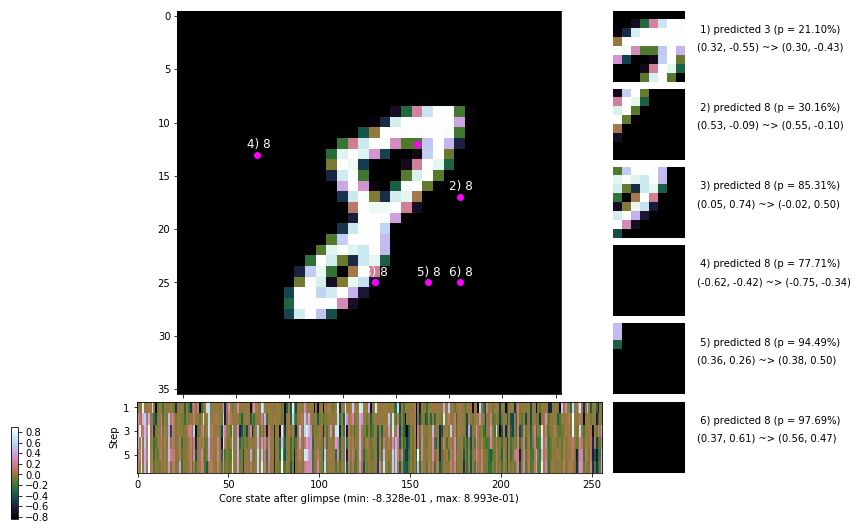

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 140.5 ms/b | lr: 5.05e-04 | grad 2norm: 14.47 | grad inf norm:  3.930
         Weights || abs max:  2.47 ( 2270.99) | mean: -8.24e-04 ( 0.01) | var: 7.32e-02 (  116.01)
          Biases || abs max:  1.38 (  143.42) | mean: -1.31e-01 ( 0.13) | var: 8.89e-02 (  262.96)
                    class loss: 0.364 | steps: 2.250 | reward:  3.631 | acc.: 87.58%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.8 ms/b | lr: 5.05e-04 | grad 2norm: 14.16 | grad inf norm:  3.959
         Weights || abs max:  2.46 ( 2716.53) | mean: -7.99e-04 ( 0.01) | var: 7.32e-02 (  211.05)
          Biases || abs max:  1.39 (  204.77) | mean: -1.31e-01 ( 0.15) | var: 8.92e-02 ( 1203.10)
                    class loss: 0.370 | steps: 2.275 | reward:  3.622 | acc.: 87.75%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

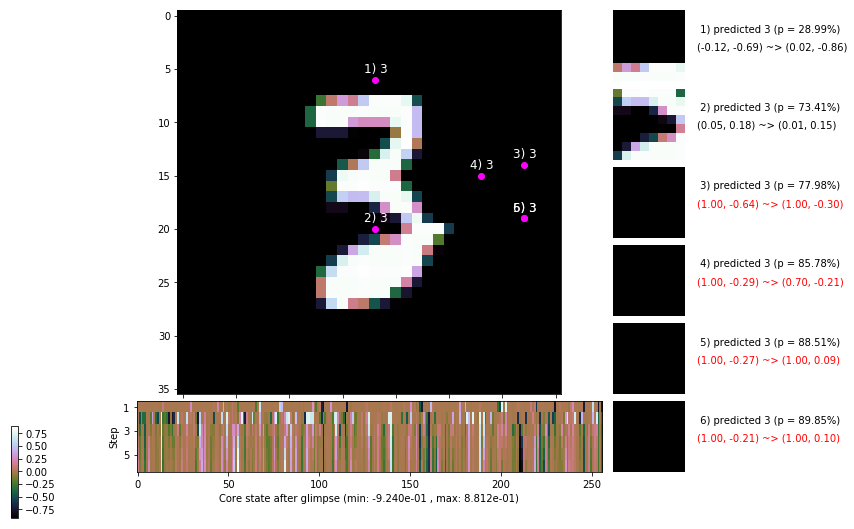

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 143.0 ms/b | lr: 5.04e-04 | grad 2norm: 14.09 | grad inf norm:  3.951
         Weights || abs max:  2.46 ( 2571.94) | mean: -8.01e-04 ( 0.01) | var: 7.33e-02 (  296.38)
          Biases || abs max:  1.39 (  111.71) | mean: -1.31e-01 ( 0.09) | var: 8.92e-02 (  132.31)
                    class loss: 0.357 | steps: 2.225 | reward:  3.686 | acc.: 87.90%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.5 ms/b | lr: 5.03e-04 | grad 2norm: 14.25 | grad inf norm:  3.854
         Weights || abs max:  2.47 ( 4191.17) | mean: -8.00e-04 ( 0.01) | var: 7.34e-02 ( 1181.76)
          Biases || abs max:  1.40 (   71.97) | mean: -1.31e-01 ( 0.09) | var: 8.93e-02 (   11.16)
                    class loss: 0.362 | steps: 2.263 | reward:  3.626 | acc.: 87.63%

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.8

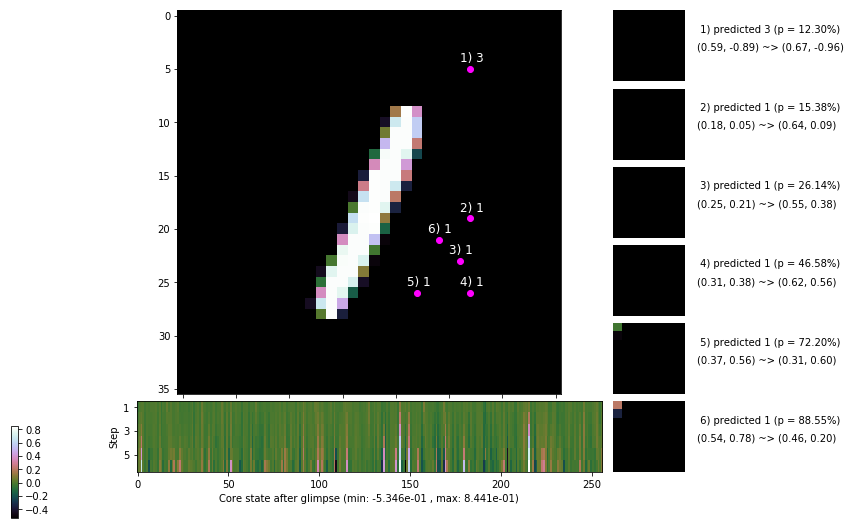

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 144.6 ms/b | lr: 5.02e-04 | grad 2norm: 14.12 | grad inf norm:  3.783
         Weights || abs max:  2.47 ( 3356.94) | mean: -8.12e-04 ( 0.01) | var: 7.34e-02 (  941.43)
          Biases || abs max:  1.40 (   98.91) | mean: -1.32e-01 ( 0.10) | var: 8.94e-02 (  224.86)
                    class loss: 0.366 | steps: 2.233 | reward:  3.678 | acc.: 88.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 139.8 ms/b | lr: 5.02e-04 | grad 2norm: 13.67 | grad inf norm:  3.820
         Weights || abs max:  2.47 ( 2588.21) | mean: -8.39e-04 ( 0.01) | var: 7.35e-02 (  306.05)
          Biases || abs max:  1.41 (  247.73) | mean: -1.32e-01 ( 0.17) | var: 8.94e-02 (  210.09)
                    class loss: 0.350 | steps: 2.250 | reward:  3.685 | acc.: 88.52%

	Target class: 5 | Discounted rewards: [-0.281, 0.438, 1.

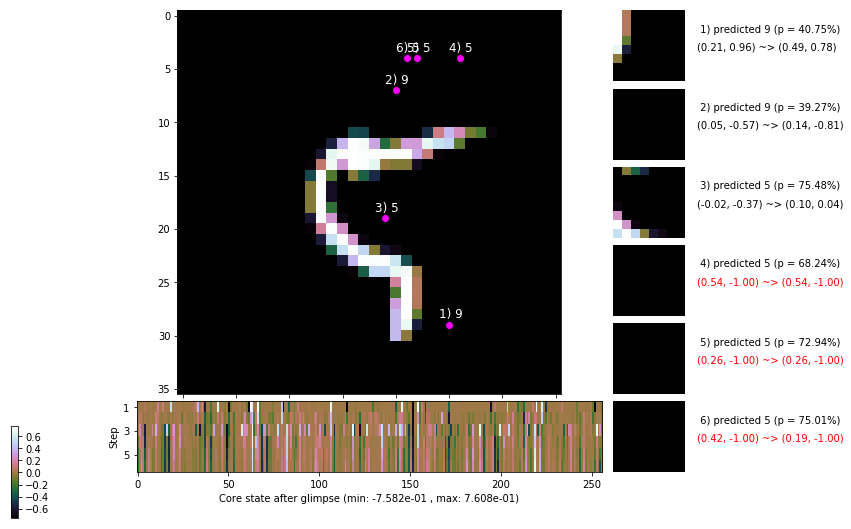

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


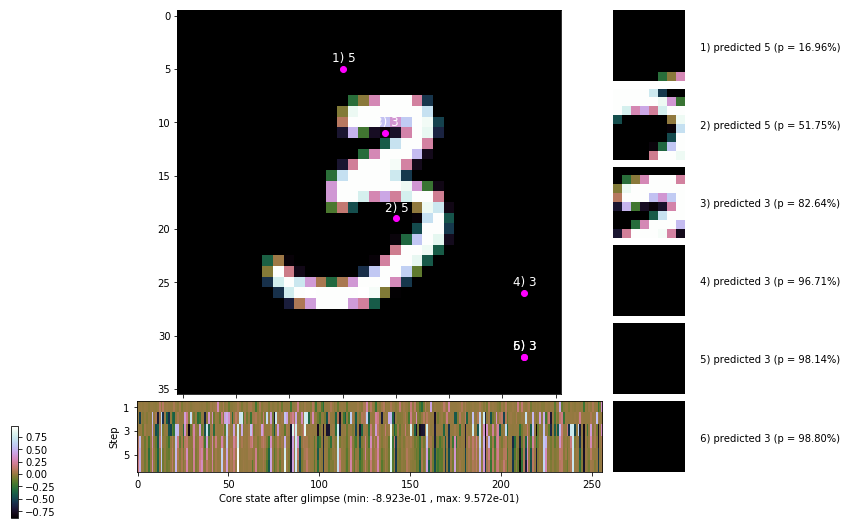


	Target class: 3 | Discounted rewards: [0.516, -0.969, -0.938, -0.875, -0.750, -0.500]


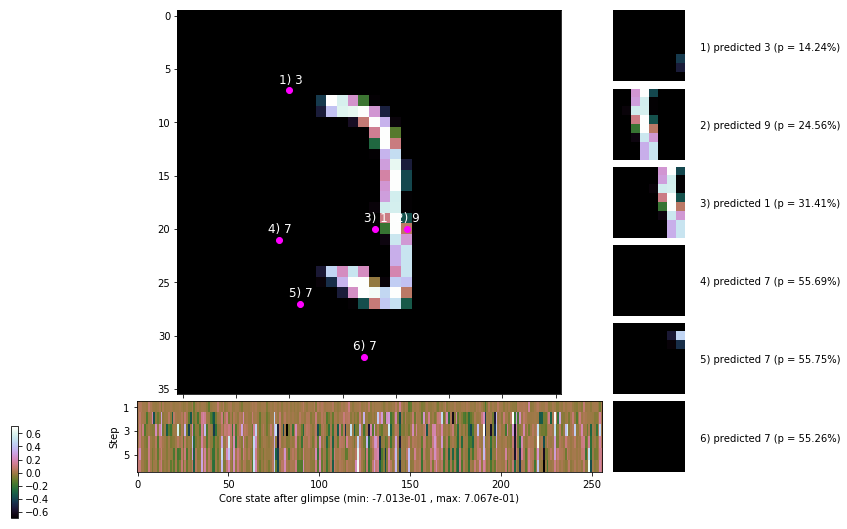

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


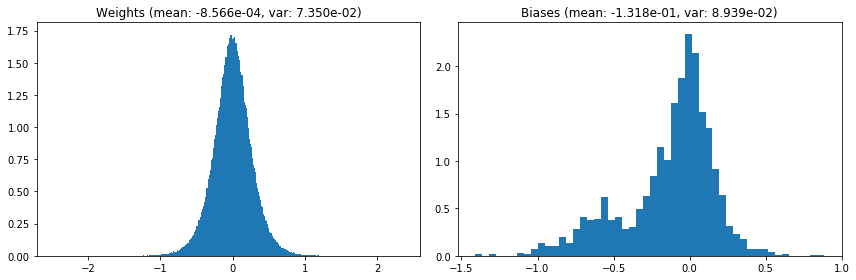

                                      Location network weights and biases


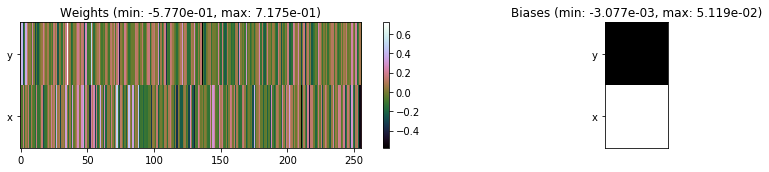

---------------------------------------------------------------------------------------------------------------
Elapsed time:  440.55 sec | TRAIN >> class loss: 0.3682 | steps:  2.268 :( | reward:  3.6237 :( | acc.: 87.682% :(
                          | VAL   >> class loss: 0.3149 | steps:  2.115    | reward:  3.9153    | acc.: 89.000% :(


Epoch  47/400) lr = 0.0005014
 b    300/  3000 >> 139.5 ms/b | lr: 5.01e-04 | grad 2norm: 13.65 | grad inf norm:  3.821
         Weights || abs max:  2.47 ( 2447.73) | mean: -8.51e-04 ( 0.01) | var: 7.35e-02 (  130.60)
          Biases || abs max:  1.41 ( 1884.14) | mean: -1.32e-01 ( 0.80) | var: 8.93e-02 (229440.67)
                    class loss: 0.321 | steps: 2.227 | reward:  3.726 | acc.: 89.47%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.4 ms/b | lr: 5.00e-04 | grad 2norm: 14.03 | grad inf norm:  3.997
         Weights || abs max:  2.48 ( 2131.99) | mean: -8.42e-04 

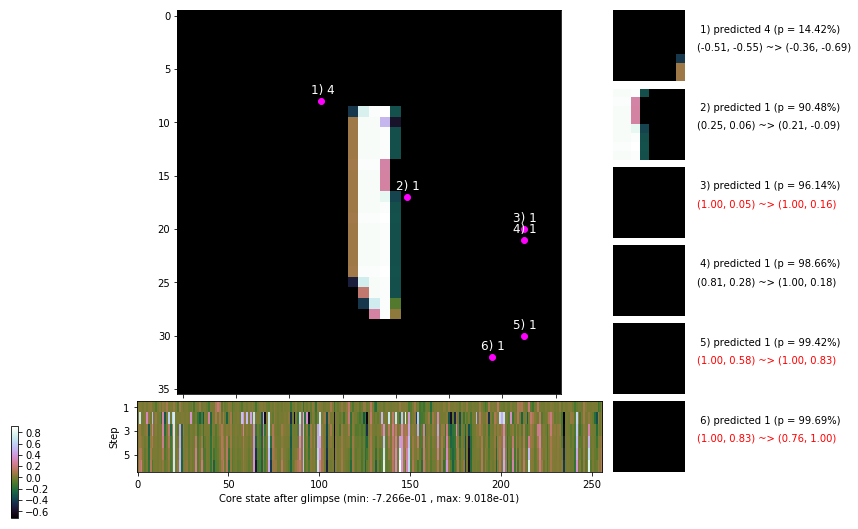

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.9 ms/b | lr: 4.99e-04 | grad 2norm: 14.35 | grad inf norm:  4.061
         Weights || abs max:  2.49 ( 2707.94) | mean: -8.42e-04 ( 0.01) | var: 7.36e-02 (  212.59)
          Biases || abs max:  1.42 (  152.47) | mean: -1.32e-01 ( 0.13) | var: 8.95e-02 (   96.69)
                    class loss: 0.368 | steps: 2.265 | reward:  3.643 | acc.: 87.87%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.0 ms/b | lr: 4.99e-04 | grad 2norm: 14.15 | grad inf norm:  3.908
         Weights || abs max:  2.51 ( 2641.72) | mean: -8.33e-04 ( 0.01) | var: 7.37e-02 (  183.09)
          Biases || abs max:  1.41 (  160.98) | mean: -1.32e-01 ( 0.14) | var: 8.96e-02 (  233.31)
                    class loss: 0.359 | steps: 2.242 | reward:  3.682 | acc.: 87.58%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

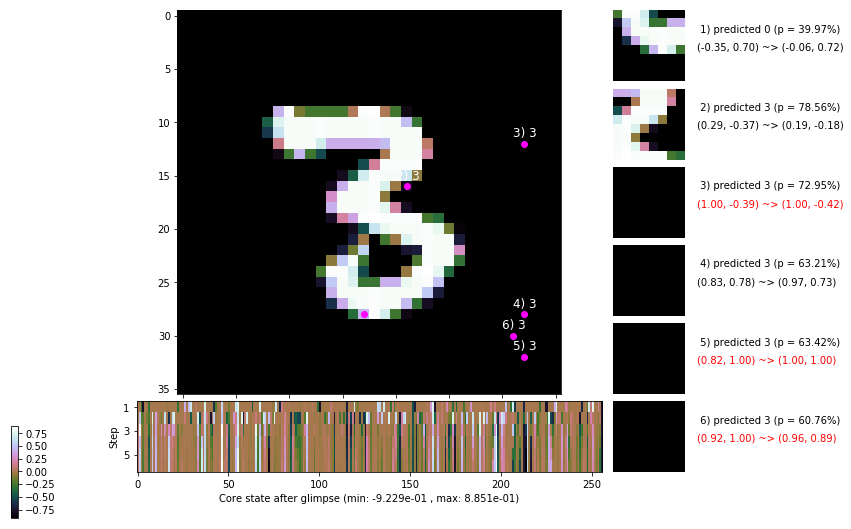

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 147.4 ms/b | lr: 4.98e-04 | grad 2norm: 14.02 | grad inf norm:  3.755
         Weights || abs max:  2.51 ( 2629.75) | mean: -8.41e-04 ( 0.01) | var: 7.38e-02 (  184.75)
          Biases || abs max:  1.41 (  839.82) | mean: -1.32e-01 ( 0.67) | var: 8.97e-02 (120926.77)
                    class loss: 0.354 | steps: 2.262 | reward:  3.631 | acc.: 88.23%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.1 ms/b | lr: 4.97e-04 | grad 2norm: 14.05 | grad inf norm:  3.885
         Weights || abs max:  2.52 ( 2713.54) | mean: -8.47e-04 ( 0.01) | var: 7.38e-02 (  171.93)
          Biases || abs max:  1.42 (   95.17) | mean: -1.31e-01 ( 0.10) | var: 8.96e-02 (   35.48)
                    class loss: 0.360 | steps: 2.274 | reward:  3.637 | acc.: 87.50%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.

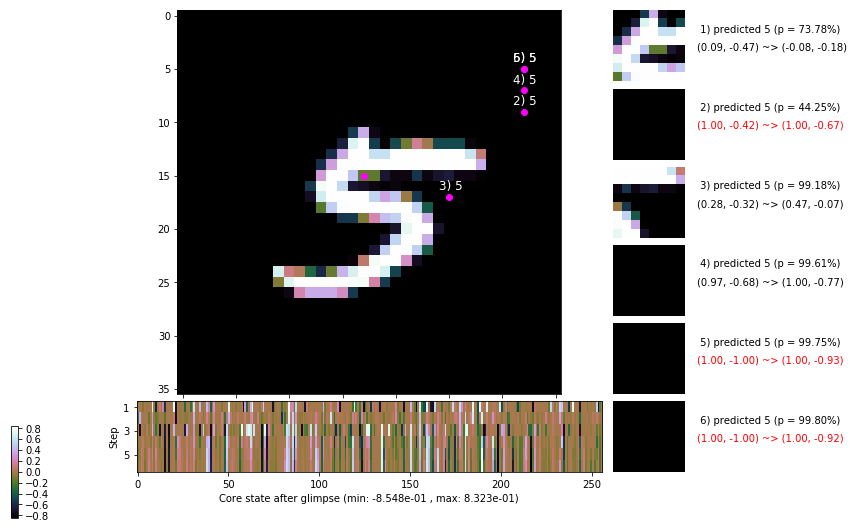

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.1 ms/b | lr: 4.96e-04 | grad 2norm: 14.19 | grad inf norm:  4.139
         Weights || abs max:  2.51 (12907.54) | mean: -8.67e-04 ( 0.03) | var: 7.39e-02 (59955.27)
          Biases || abs max:  1.41 (   87.75) | mean: -1.31e-01 ( 0.09) | var: 8.97e-02 (   71.35)
                    class loss: 0.361 | steps: 2.234 | reward:  3.673 | acc.: 87.87%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.0 ms/b | lr: 4.96e-04 | grad 2norm: 13.88 | grad inf norm:  3.967
         Weights || abs max:  2.50 ( 3058.94) | mean: -8.35e-04 ( 0.01) | var: 7.39e-02 (  204.64)
          Biases || abs max:  1.41 (  362.72) | mean: -1.32e-01 ( 0.19) | var: 8.97e-02 ( 5626.73)
                    class loss: 0.365 | steps: 2.271 | reward:  3.618 | acc.: 87.43%

	Target class: 4 | Discounted rewards: [-0.984, -0.969, -

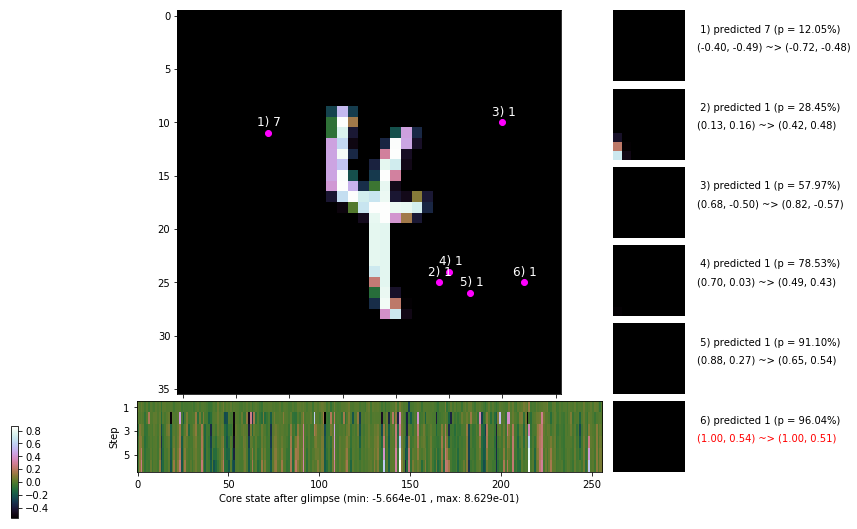

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 148.1 ms/b | lr: 4.95e-04 | grad 2norm: 13.73 | grad inf norm:  4.164
         Weights || abs max:  2.48 (13020.07) | mean: -8.26e-04 ( 0.03) | var: 7.40e-02 (41703.07)
          Biases || abs max:  1.41 (   69.64) | mean: -1.32e-01 ( 0.08) | var: 8.98e-02 (   24.68)
                    class loss: 0.365 | steps: 2.251 | reward:  3.666 | acc.: 88.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.4 ms/b | lr: 4.94e-04 | grad 2norm: 14.00 | grad inf norm:  3.826
         Weights || abs max:  2.49 ( 8128.57) | mean: -8.08e-04 ( 0.02) | var: 7.40e-02 (18417.21)
          Biases || abs max:  1.41 (  118.24) | mean: -1.31e-01 ( 0.11) | var: 8.98e-02 (  183.75)
                    class loss: 0.360 | steps: 2.223 | reward:  3.660 | acc.: 87.87%

	Target class: 1 | Discounted rewards: [-0.281, 0.438, 1.

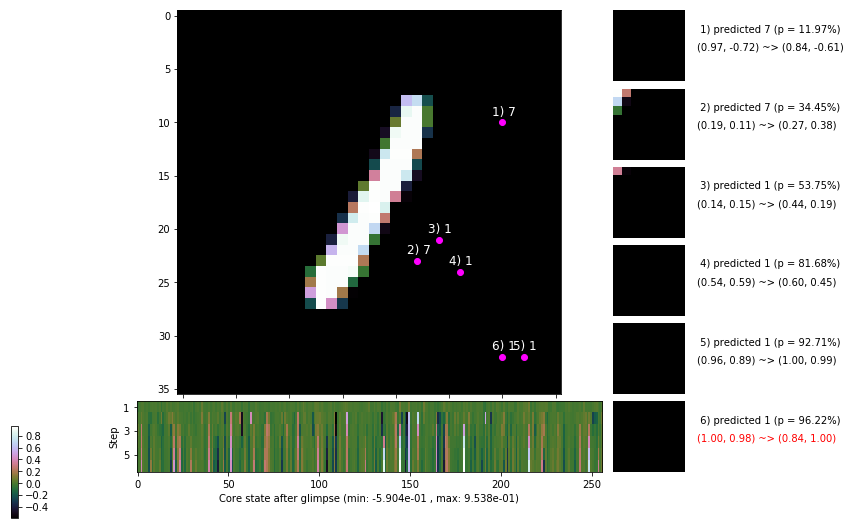

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


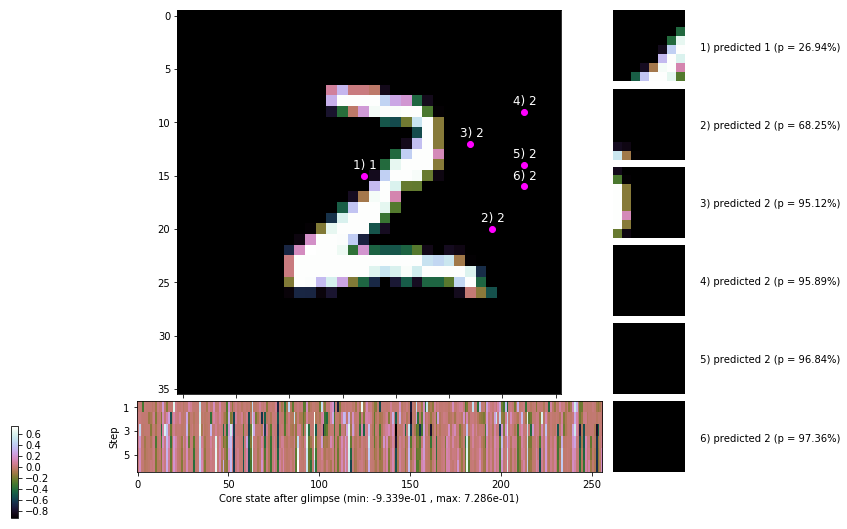


	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


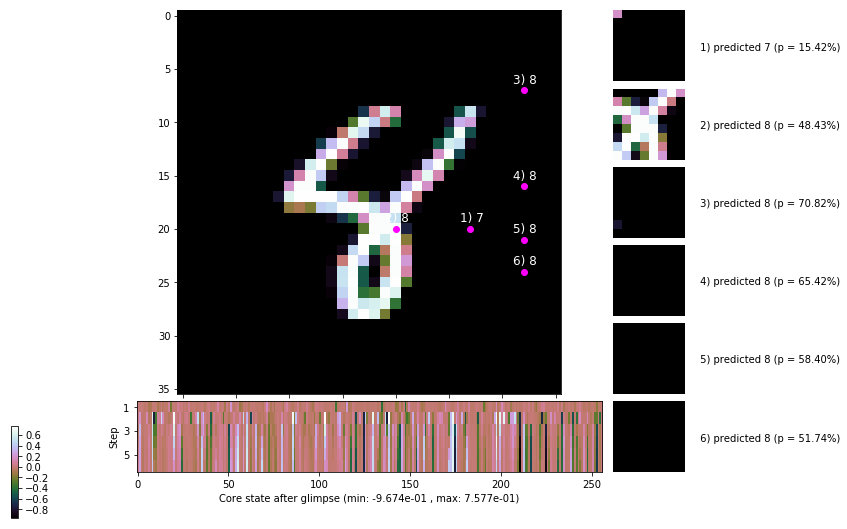

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


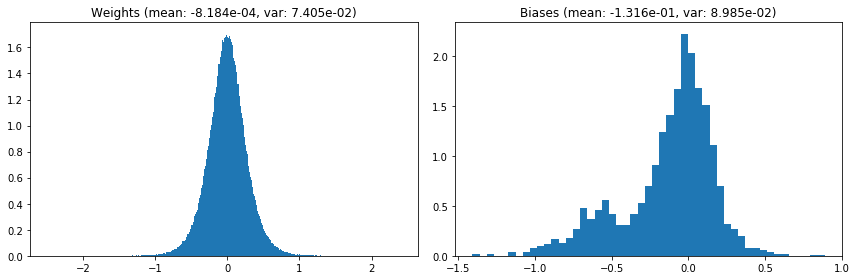

                                      Location network weights and biases


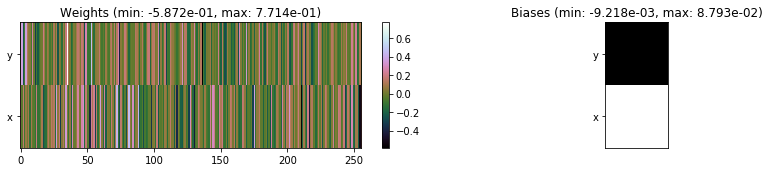

---------------------------------------------------------------------------------------------------------------
Elapsed time:  434.57 sec | TRAIN >> class loss: 0.3559 | steps:  2.251    | reward:  3.6606    | acc.: 88.085% :(
                          | VAL   >> class loss: 0.3494 | steps:  2.200 :( | reward:  3.7668 :( | acc.: 88.160% :(


Epoch  48/400) lr = 0.0004939
 b    300/  3000 >> 144.3 ms/b | lr: 4.93e-04 | grad 2norm: 13.90 | grad inf norm:  3.884
         Weights || abs max:  2.48 ( 8908.63) | mean: -8.13e-04 ( 0.02) | var: 7.41e-02 (25267.11)
          Biases || abs max:  1.41 (  107.58) | mean: -1.32e-01 ( 0.10) | var: 8.99e-02 (   21.77)
                    class loss: 0.371 | steps: 2.232 | reward:  3.680 | acc.: 87.95%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.5 ms/b | lr: 4.93e-04 | grad 2norm: 13.83 | grad inf norm:  3.918
         Weights || abs max:  2.49 ( 3581.45) | mean: -8.07e-04 (

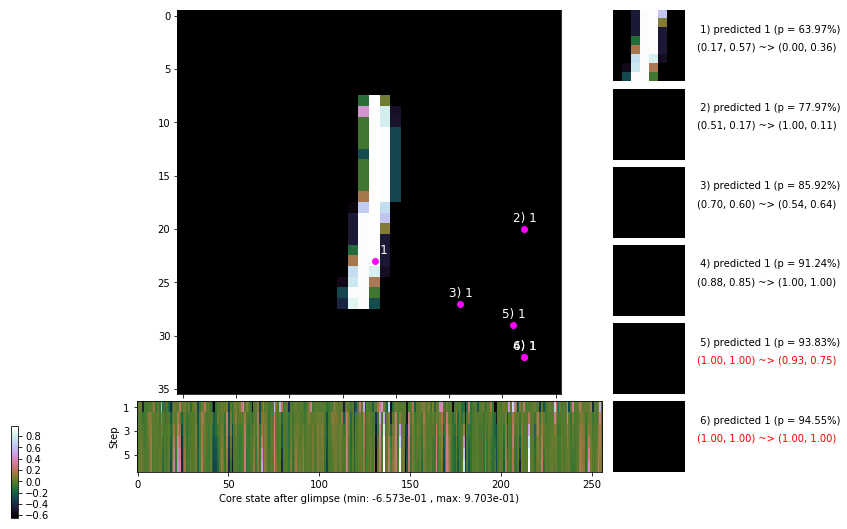

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 147.2 ms/b | lr: 4.92e-04 | grad 2norm: 13.99 | grad inf norm:  3.995
         Weights || abs max:  2.49 ( 1996.24) | mean: -7.97e-04 ( 0.01) | var: 7.42e-02 (   56.35)
          Biases || abs max:  1.41 ( 1677.28) | mean: -1.31e-01 ( 0.73) | var: 8.99e-02 (100608.16)
                    class loss: 0.365 | steps: 2.264 | reward:  3.656 | acc.: 87.92%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 145.2 ms/b | lr: 4.91e-04 | grad 2norm: 14.16 | grad inf norm:  3.934
         Weights || abs max:  2.50 ( 1788.15) | mean: -7.94e-04 ( 0.01) | var: 7.42e-02 (  128.91)
          Biases || abs max:  1.42 (   66.86) | mean: -1.31e-01 ( 0.09) | var: 9.01e-02 (   14.43)
                    class loss: 0.371 | steps: 2.260 | reward:  3.603 | acc.: 87.05%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.

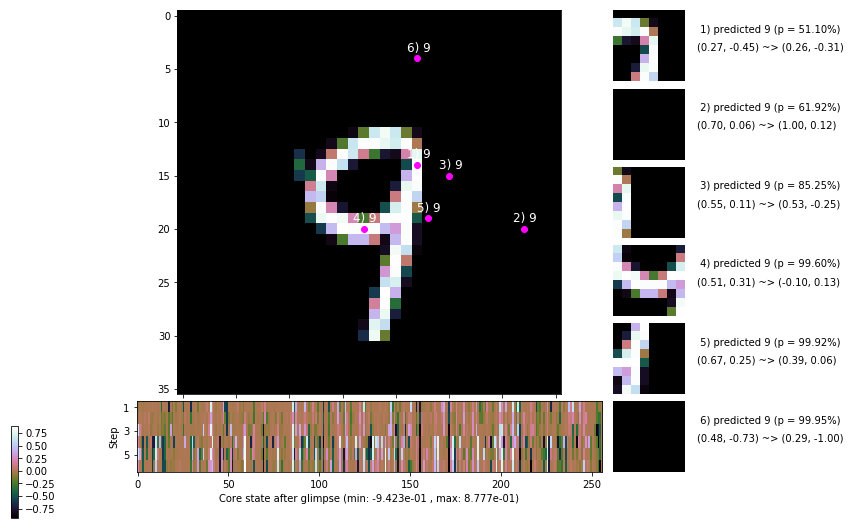

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 152.5 ms/b | lr: 4.90e-04 | grad 2norm: 14.28 | grad inf norm:  4.061
         Weights || abs max:  2.50 ( 5299.03) | mean: -8.12e-04 ( 0.02) | var: 7.43e-02 ( 3250.61)
          Biases || abs max:  1.42 (  301.58) | mean: -1.31e-01 ( 0.18) | var: 9.03e-02 (  183.45)
                    class loss: 0.359 | steps: 2.270 | reward:  3.643 | acc.: 87.97%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 161.0 ms/b | lr: 4.90e-04 | grad 2norm: 13.86 | grad inf norm:  3.927
         Weights || abs max:  2.49 ( 2879.27) | mean: -8.17e-04 ( 0.01) | var: 7.43e-02 (  927.97)
          Biases || abs max:  1.42 (  370.39) | mean: -1.31e-01 ( 0.21) | var: 9.02e-02 (  475.60)
                    class loss: 0.337 | steps: 2.244 | reward:  3.701 | acc.: 88.70%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

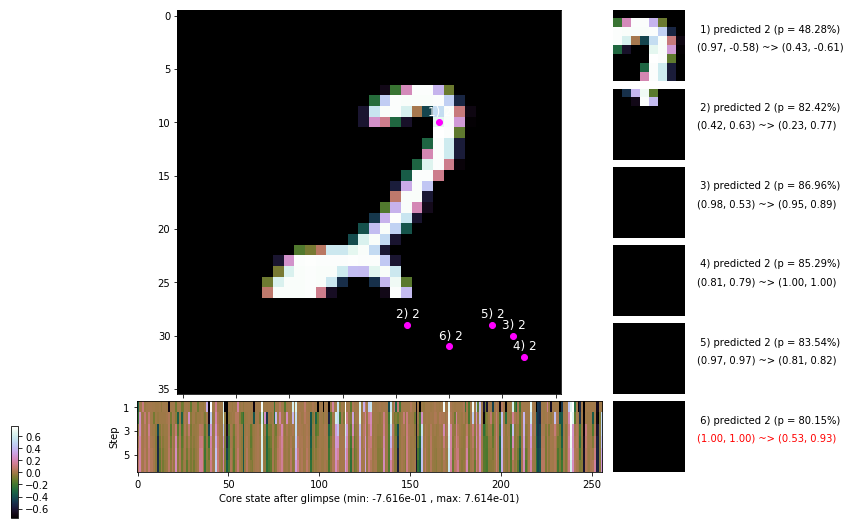

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.1 ms/b | lr: 4.89e-04 | grad 2norm: 13.92 | grad inf norm:  3.968
         Weights || abs max:  2.49 ( 2215.24) | mean: -8.31e-04 ( 0.01) | var: 7.44e-02 (   91.56)
          Biases || abs max:  1.42 (  219.56) | mean: -1.31e-01 ( 0.14) | var: 9.03e-02 (  298.84)
                    class loss: 0.354 | steps: 2.263 | reward:  3.654 | acc.: 88.02%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 158.6 ms/b | lr: 4.89e-04 | grad 2norm: 14.00 | grad inf norm:  3.887
         Weights || abs max:  2.50 ( 4978.88) | mean: -8.34e-04 ( 0.02) | var: 7.44e-02 ( 2443.69)
          Biases || abs max:  1.42 (  822.00) | mean: -1.31e-01 ( 0.42) | var: 9.05e-02 ( 2249.87)
                    class loss: 0.366 | steps: 2.248 | reward:  3.655 | acc.: 88.03%

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.8

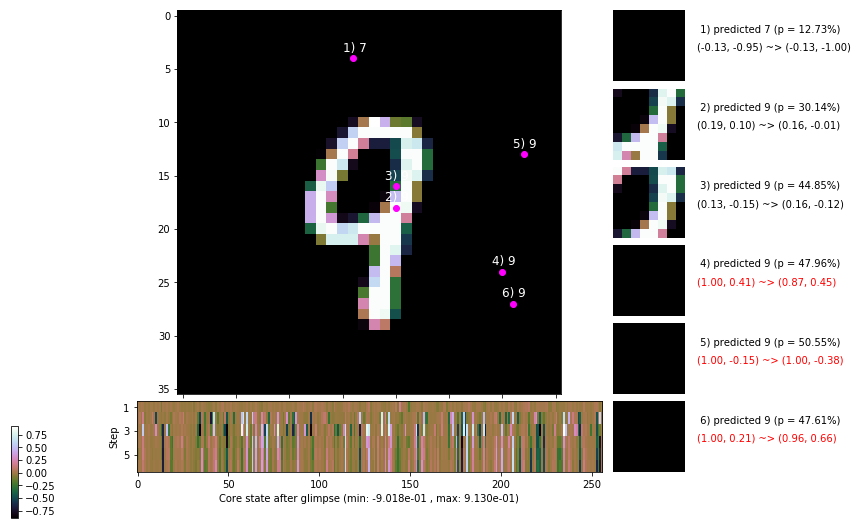

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.6 ms/b | lr: 4.88e-04 | grad 2norm: 14.13 | grad inf norm:  4.044
         Weights || abs max:  2.50 ( 2175.27) | mean: -8.28e-04 ( 0.01) | var: 7.45e-02 (  107.01)
          Biases || abs max:  1.42 (  310.22) | mean: -1.31e-01 ( 0.21) | var: 9.05e-02 ( 1598.36)
                    class loss: 0.347 | steps: 2.258 | reward:  3.666 | acc.: 88.72%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 158.1 ms/b | lr: 4.87e-04 | grad 2norm: 13.55 | grad inf norm:  3.866
         Weights || abs max:  2.51 ( 3378.44) | mean: -8.49e-04 ( 0.01) | var: 7.45e-02 (  243.06)
          Biases || abs max:  1.42 (  173.27) | mean: -1.31e-01 ( 0.14) | var: 9.06e-02 (  411.17)
                    class loss: 0.337 | steps: 2.206 | reward:  3.750 | acc.: 88.82%

	Target class: 7 | Discounted rewards: [-0.281, 0.438, 1.

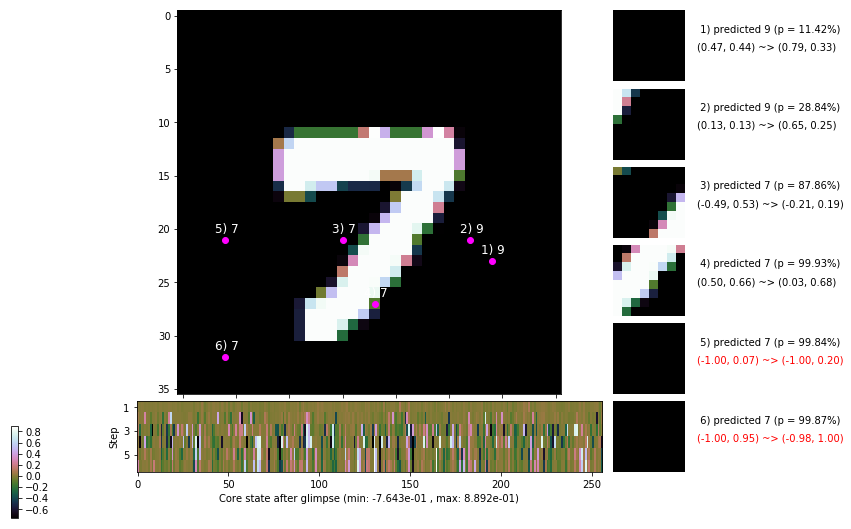

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.516, -0.969, -0.938, -0.875, -0.750, -0.500]


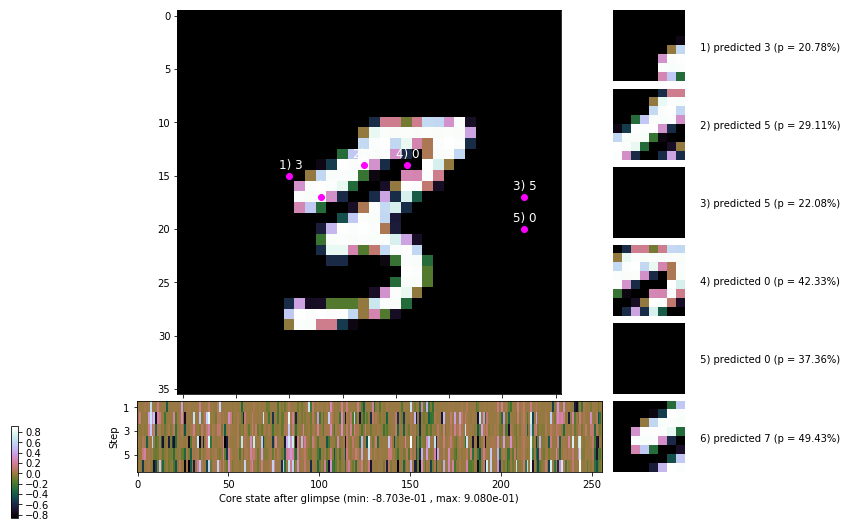


	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


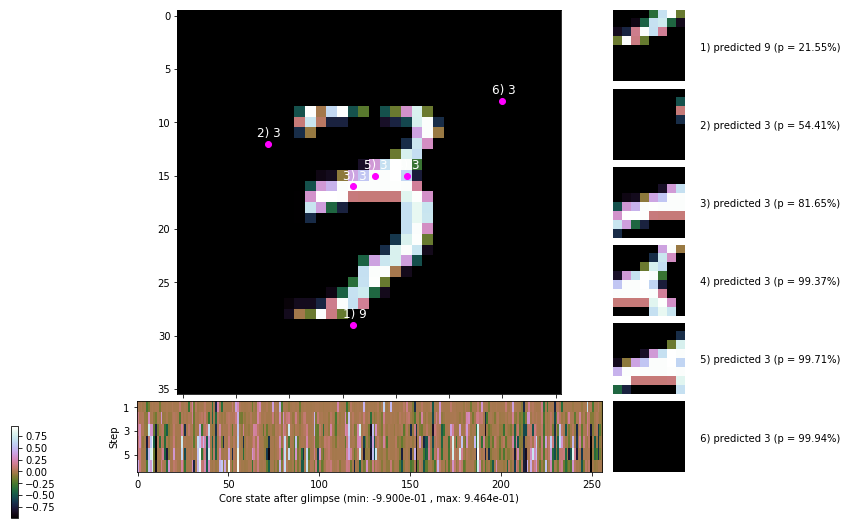

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


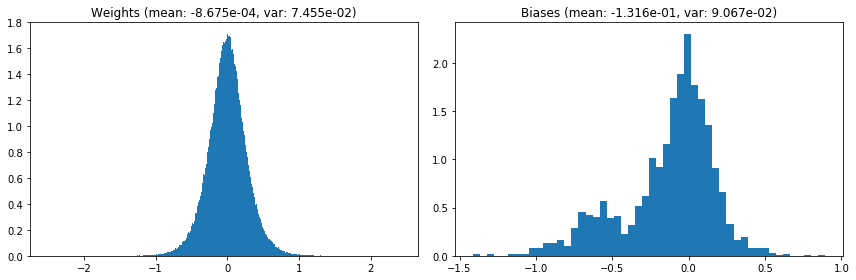

                                      Location network weights and biases


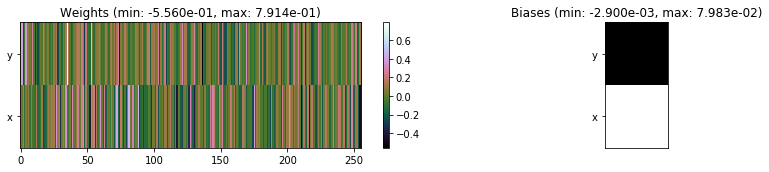

---------------------------------------------------------------------------------------------------------------
Elapsed time:  457.59 sec | TRAIN >> class loss: 0.3567 | steps:  2.252 :( | reward:  3.6620    | acc.: 88.073% :(
                          | VAL   >> class loss: 0.3431 | steps:  2.153 :( | reward:  3.8412 :( | acc.: 88.460% :(


Epoch  49/400) lr = 0.0004866
 b    300/  3000 >> 153.2 ms/b | lr: 4.86e-04 | grad 2norm: 13.58 | grad inf norm:  3.846
         Weights || abs max:  2.49 ( 6959.14) | mean: -8.44e-04 ( 0.02) | var: 7.46e-02 ( 7761.77)
          Biases || abs max:  1.42 (  155.28) | mean: -1.31e-01 ( 0.14) | var: 9.06e-02 (  263.68)
                    class loss: 0.335 | steps: 2.213 | reward:  3.716 | acc.: 88.65%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 149.1 ms/b | lr: 4.86e-04 | grad 2norm: 13.82 | grad inf norm:  3.723
         Weights || abs max:  2.50 ( 9916.25) | mean: -8.37e-04 (

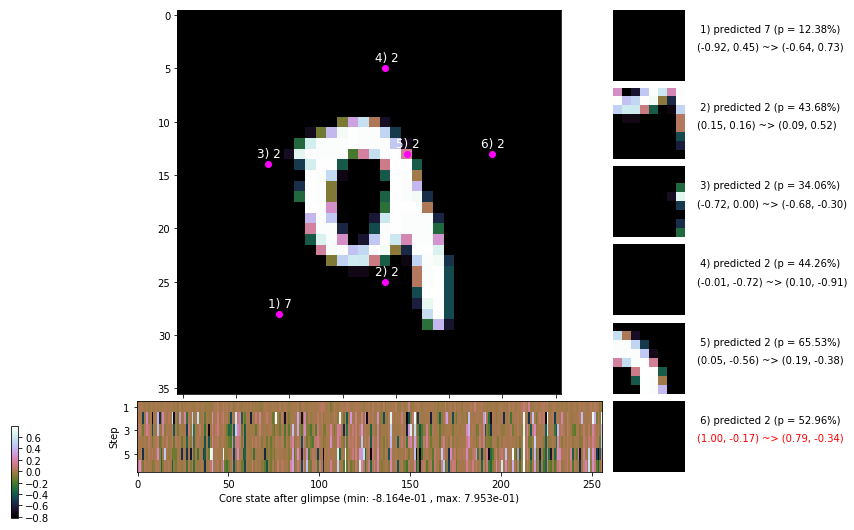

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.3 ms/b | lr: 4.85e-04 | grad 2norm: 14.03 | grad inf norm:  4.015
         Weights || abs max:  2.50 ( 4041.00) | mean: -8.35e-04 ( 0.02) | var: 7.47e-02 (  594.92)
          Biases || abs max:  1.43 (   84.08) | mean: -1.32e-01 ( 0.10) | var: 9.08e-02 (   87.63)
                    class loss: 0.362 | steps: 2.228 | reward:  3.670 | acc.: 87.60%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 149.5 ms/b | lr: 4.84e-04 | grad 2norm: 13.82 | grad inf norm:  3.991
         Weights || abs max:  2.50 ( 3897.09) | mean: -8.05e-04 ( 0.01) | var: 7.48e-02 (  451.23)
          Biases || abs max:  1.42 (  370.61) | mean: -1.31e-01 ( 0.21) | var: 9.07e-02 (  833.70)
                    class loss: 0.352 | steps: 2.232 | reward:  3.684 | acc.: 88.37%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

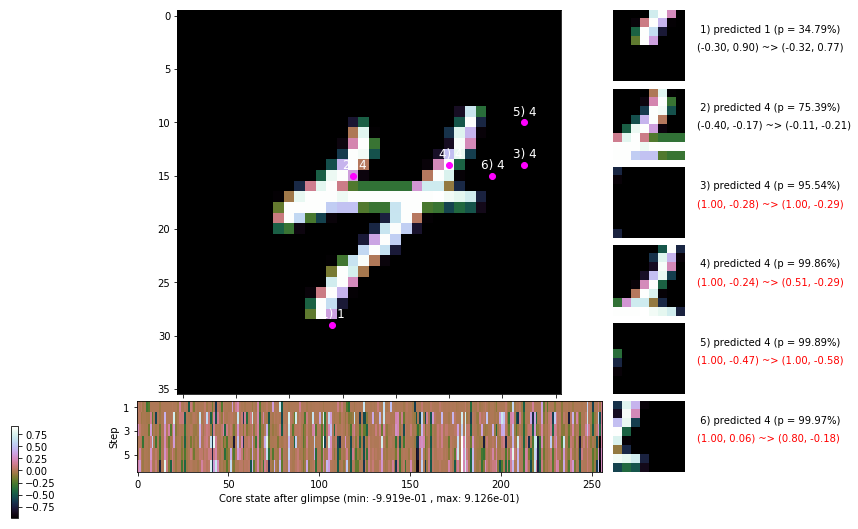

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 151.0 ms/b | lr: 4.83e-04 | grad 2norm: 13.72 | grad inf norm:  3.829
         Weights || abs max:  2.51 ( 2975.65) | mean: -8.04e-04 ( 0.01) | var: 7.48e-02 (  302.79)
          Biases || abs max:  1.42 (  447.07) | mean: -1.31e-01 ( 0.24) | var: 9.09e-02 (  752.90)
                    class loss: 0.361 | steps: 2.247 | reward:  3.672 | acc.: 88.07%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 147.3 ms/b | lr: 4.83e-04 | grad 2norm: 13.89 | grad inf norm:  3.816
         Weights || abs max:  2.50 ( 4364.28) | mean: -8.36e-04 ( 0.02) | var: 7.48e-02 ( 1394.67)
          Biases || abs max:  1.42 (  140.93) | mean: -1.32e-01 ( 0.11) | var: 9.12e-02 (   75.66)
                    class loss: 0.371 | steps: 2.245 | reward:  3.656 | acc.: 87.88%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.8

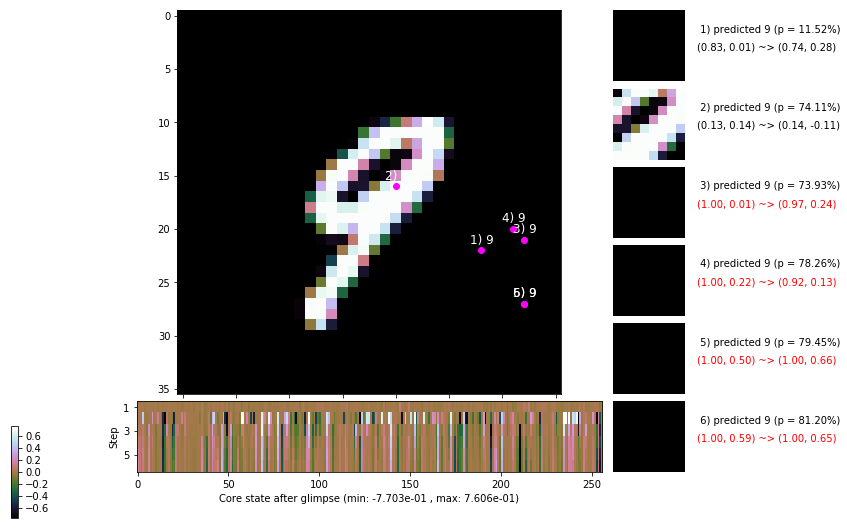

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 150.2 ms/b | lr: 4.82e-04 | grad 2norm: 13.62 | grad inf norm:  3.779
         Weights || abs max:  2.49 ( 3024.71) | mean: -8.29e-04 ( 0.01) | var: 7.49e-02 (  381.72)
          Biases || abs max:  1.41 (   60.78) | mean: -1.32e-01 ( 0.07) | var: 9.12e-02 (   16.84)
                    class loss: 0.349 | steps: 2.234 | reward:  3.700 | acc.: 88.93%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 150.9 ms/b | lr: 4.81e-04 | grad 2norm: 13.48 | grad inf norm:  3.839
         Weights || abs max:  2.48 ( 2767.19) | mean: -8.27e-04 ( 0.01) | var: 7.49e-02 (  117.81)
          Biases || abs max:  1.41 (   89.17) | mean: -1.32e-01 ( 0.09) | var: 9.12e-02 (   67.20)
                    class loss: 0.329 | steps: 2.215 | reward:  3.739 | acc.: 89.00%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

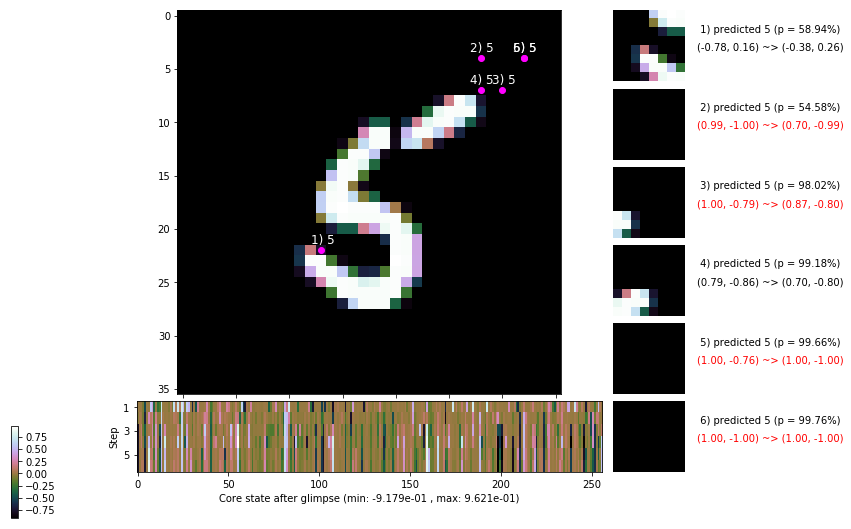

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 147.3 ms/b | lr: 4.80e-04 | grad 2norm: 14.17 | grad inf norm:  3.899
         Weights || abs max:  2.48 ( 2965.72) | mean: -8.27e-04 ( 0.01) | var: 7.50e-02 (  296.18)
          Biases || abs max:  1.41 (   59.05) | mean: -1.32e-01 ( 0.07) | var: 9.10e-02 (   17.98)
                    class loss: 0.346 | steps: 2.261 | reward:  3.663 | acc.: 88.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.4 ms/b | lr: 4.80e-04 | grad 2norm: 13.89 | grad inf norm:  3.867
         Weights || abs max:  2.48 ( 3535.50) | mean: -8.40e-04 ( 0.01) | var: 7.50e-02 (  422.71)
          Biases || abs max:  1.41 ( 1429.06) | mean: -1.32e-01 ( 0.62) | var: 9.11e-02 (36874.93)
                    class loss: 0.349 | steps: 2.244 | reward:  3.678 | acc.: 88.38%

	Target class: 4 | Discounted rewards: [-0.984, -0.969, -

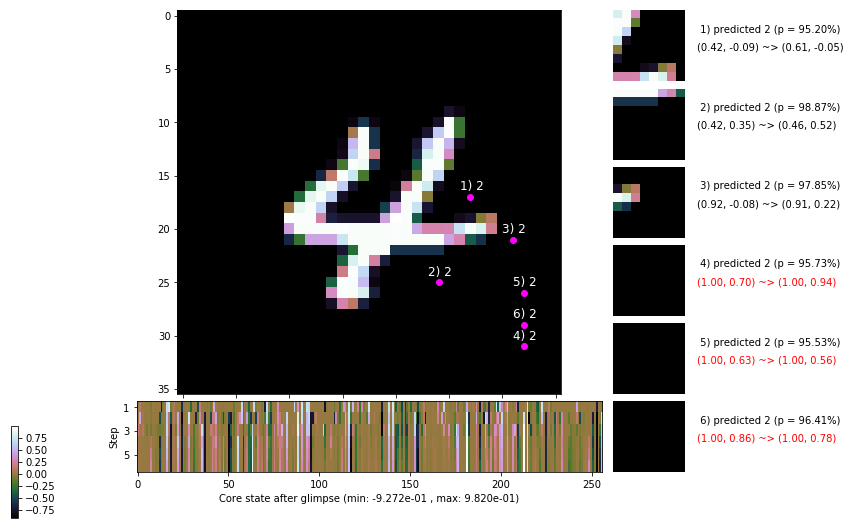

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


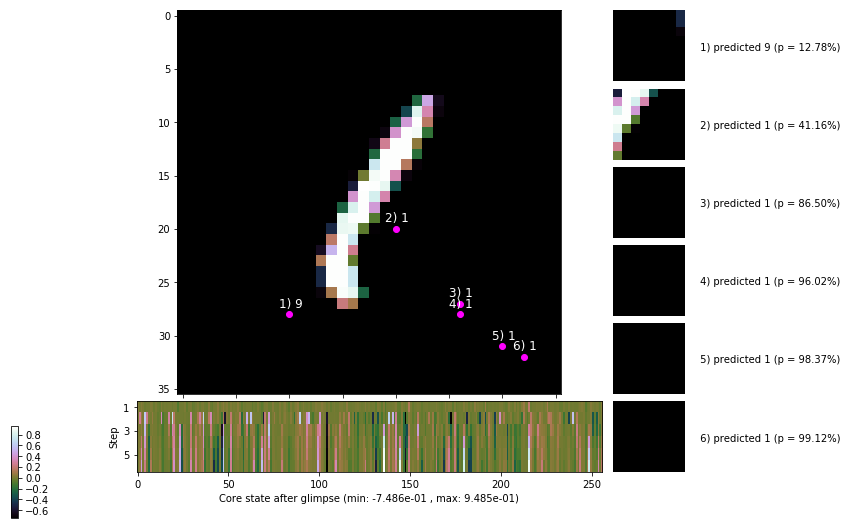


	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


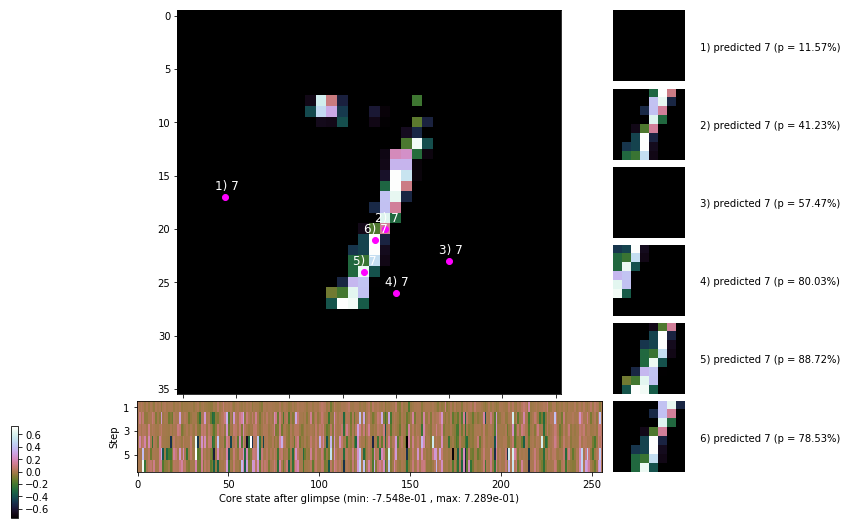

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


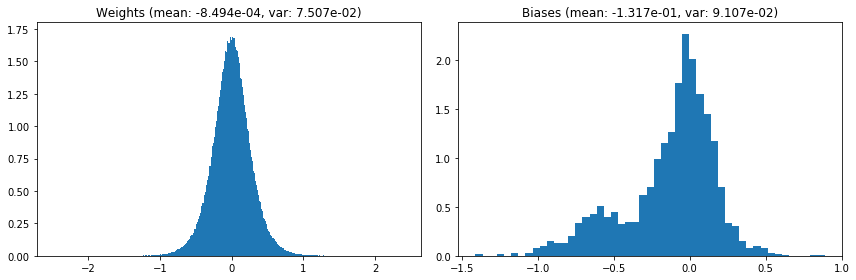

                                      Location network weights and biases


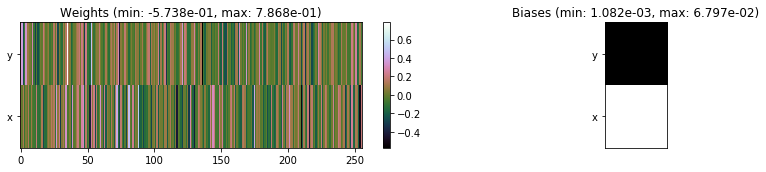

---------------------------------------------------------------------------------------------------------------
Elapsed time:  450.23 sec | TRAIN >> class loss: 0.3527 | steps:  2.239    | reward:  3.6792    | acc.: 88.267% :(
                          | VAL   >> class loss: 0.3252 | steps:  2.131 :( | reward:  3.8796 :( | acc.: 89.060% :(


Epoch  50/400) lr = 0.0004793
 b    300/  3000 >> 146.8 ms/b | lr: 4.79e-04 | grad 2norm: 13.51 | grad inf norm:  3.885
         Weights || abs max:  2.47 ( 3273.00) | mean: -8.39e-04 ( 0.01) | var: 7.51e-02 (  441.26)
          Biases || abs max:  1.41 (  419.33) | mean: -1.31e-01 ( 0.24) | var: 9.11e-02 (  632.87)
                    class loss: 0.314 | steps: 2.200 | reward:  3.796 | acc.: 89.70%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.5 ms/b | lr: 4.78e-04 | grad 2norm: 14.19 | grad inf norm:  4.013
         Weights || abs max:  2.46 ( 3329.87) | mean: -8.60e-04 (

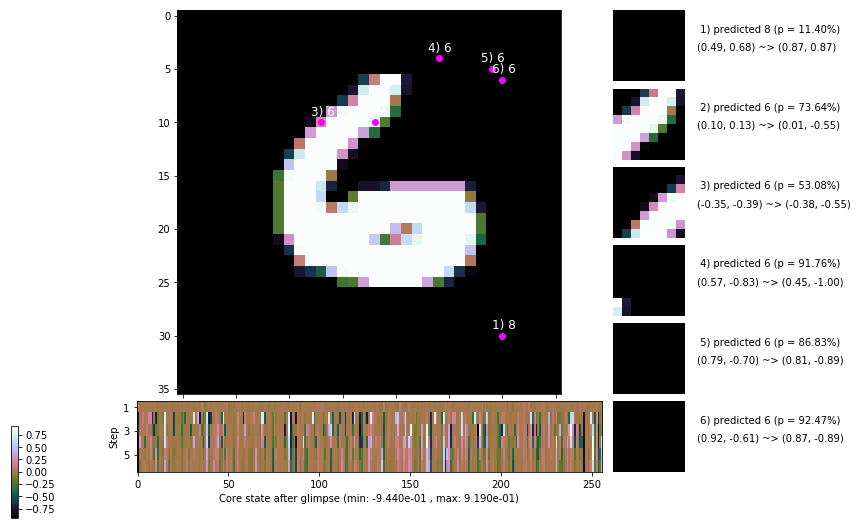

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.0 ms/b | lr: 4.77e-04 | grad 2norm: 14.20 | grad inf norm:  3.906
         Weights || abs max:  2.45 ( 2015.31) | mean: -8.41e-04 ( 0.01) | var: 7.52e-02 (  160.17)
          Biases || abs max:  1.42 (   72.00) | mean: -1.32e-01 ( 0.08) | var: 9.13e-02 (   18.04)
                    class loss: 0.369 | steps: 2.259 | reward:  3.663 | acc.: 87.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 151.4 ms/b | lr: 4.77e-04 | grad 2norm: 13.62 | grad inf norm:  3.899
         Weights || abs max:  2.44 ( 5507.08) | mean: -8.26e-04 ( 0.02) | var: 7.52e-02 ( 3652.20)
          Biases || abs max:  1.42 (   92.82) | mean: -1.32e-01 ( 0.10) | var: 9.14e-02 (   12.38)
                    class loss: 0.338 | steps: 2.261 | reward:  3.666 | acc.: 88.55%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.8

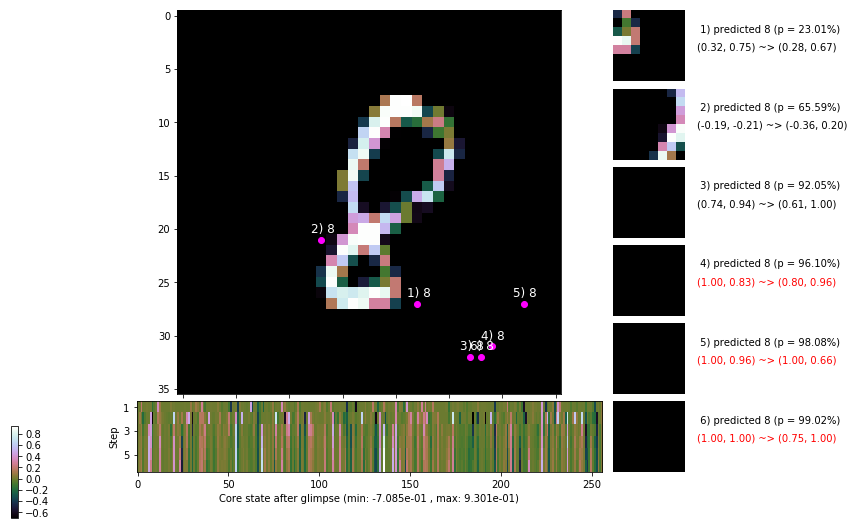

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 149.8 ms/b | lr: 4.76e-04 | grad 2norm: 13.73 | grad inf norm:  3.926
         Weights || abs max:  2.42 ( 2894.61) | mean: -8.48e-04 ( 0.01) | var: 7.53e-02 (  136.52)
          Biases || abs max:  1.42 (  383.90) | mean: -1.32e-01 ( 0.22) | var: 9.14e-02 ( 2383.26)
                    class loss: 0.335 | steps: 2.247 | reward:  3.688 | acc.: 88.60%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 147.0 ms/b | lr: 4.76e-04 | grad 2norm: 13.81 | grad inf norm:  3.799
         Weights || abs max:  2.41 ( 2423.01) | mean: -8.66e-04 ( 0.01) | var: 7.53e-02 (  152.95)
          Biases || abs max:  1.43 (  147.24) | mean: -1.32e-01 ( 0.12) | var: 9.13e-02 (  165.13)
                    class loss: 0.335 | steps: 2.240 | reward:  3.697 | acc.: 88.97%

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.8

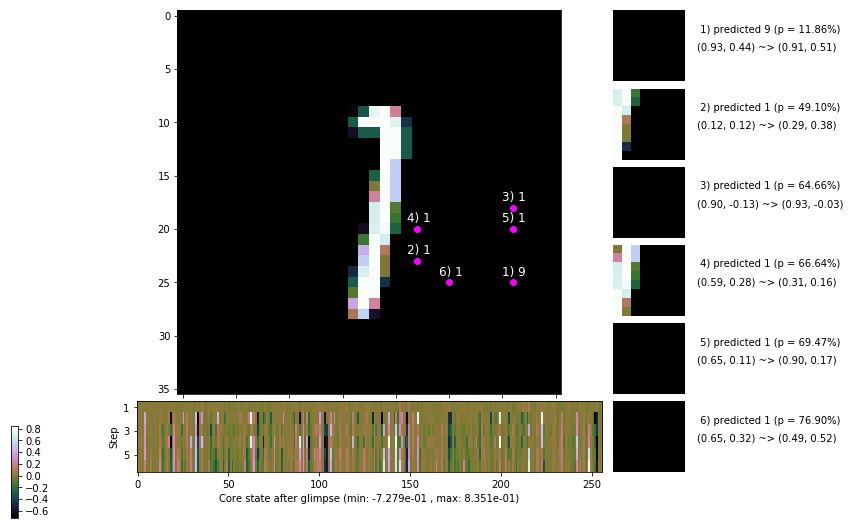

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 150.3 ms/b | lr: 4.75e-04 | grad 2norm: 13.86 | grad inf norm:  3.830
         Weights || abs max:  2.40 ( 3049.34) | mean: -8.54e-04 ( 0.01) | var: 7.54e-02 (  247.23)
          Biases || abs max:  1.43 (  104.53) | mean: -1.32e-01 ( 0.10) | var: 9.13e-02 (  106.51)
                    class loss: 0.343 | steps: 2.243 | reward:  3.680 | acc.: 89.08%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 144.1 ms/b | lr: 4.74e-04 | grad 2norm: 13.44 | grad inf norm:  3.784
         Weights || abs max:  2.40 ( 1788.30) | mean: -8.57e-04 ( 0.01) | var: 7.54e-02 (   28.66)
          Biases || abs max:  1.42 (   74.10) | mean: -1.32e-01 ( 0.09) | var: 9.13e-02 (   23.69)
                    class loss: 0.328 | steps: 2.217 | reward:  3.726 | acc.: 88.97%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

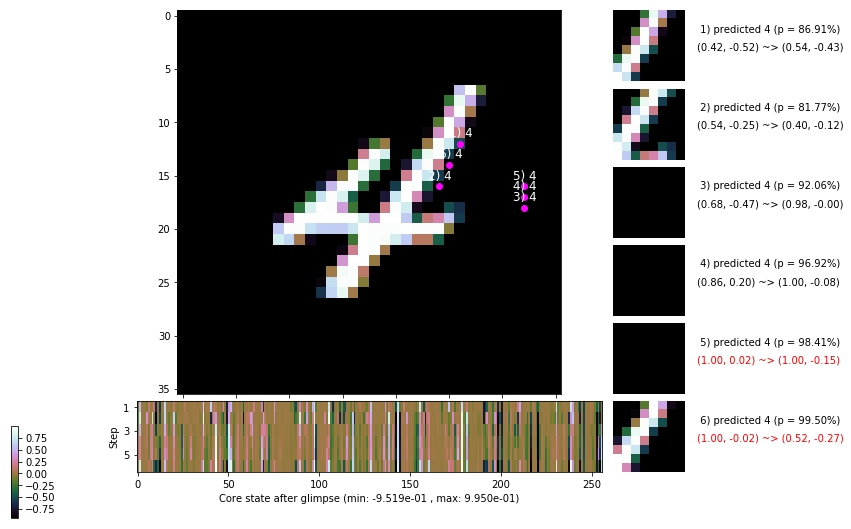

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 148.5 ms/b | lr: 4.73e-04 | grad 2norm: 13.83 | grad inf norm:  3.786
         Weights || abs max:  2.42 ( 3486.74) | mean: -8.52e-04 ( 0.01) | var: 7.55e-02 (  358.96)
          Biases || abs max:  1.42 (  330.80) | mean: -1.33e-01 ( 0.24) | var: 9.16e-02 ( 5410.78)
                    class loss: 0.349 | steps: 2.256 | reward:  3.689 | acc.: 88.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 164.6 ms/b | lr: 4.73e-04 | grad 2norm: 13.55 | grad inf norm:  3.746
         Weights || abs max:  2.43 ( 1890.20) | mean: -8.27e-04 ( 0.01) | var: 7.55e-02 (   48.32)
          Biases || abs max:  1.42 (  108.74) | mean: -1.32e-01 ( 0.09) | var: 9.17e-02 (   58.45)
                    class loss: 0.333 | steps: 2.226 | reward:  3.702 | acc.: 89.00%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

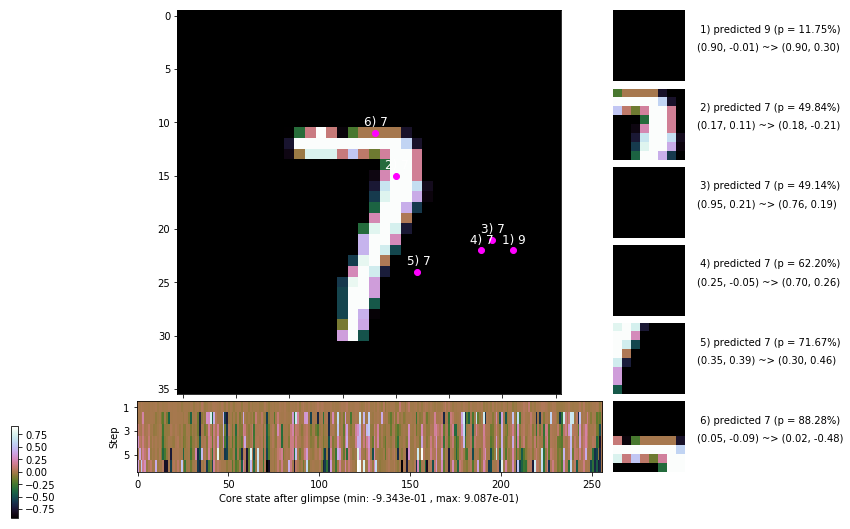

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


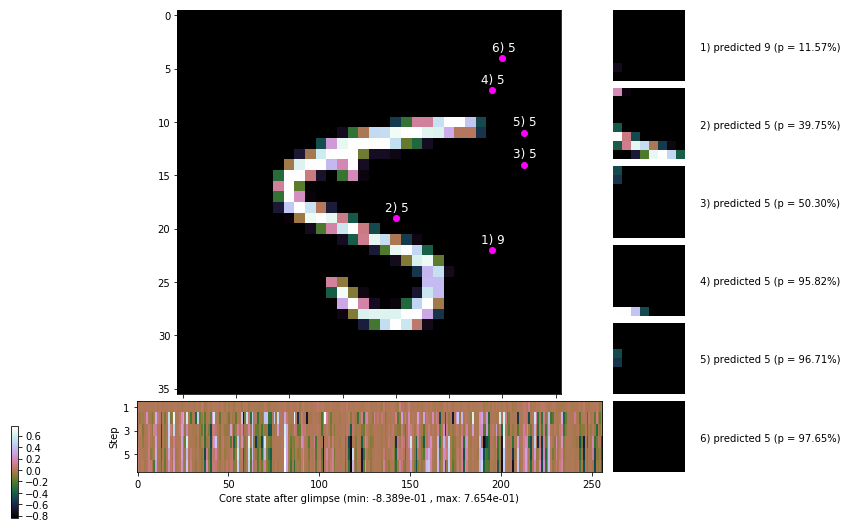


	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


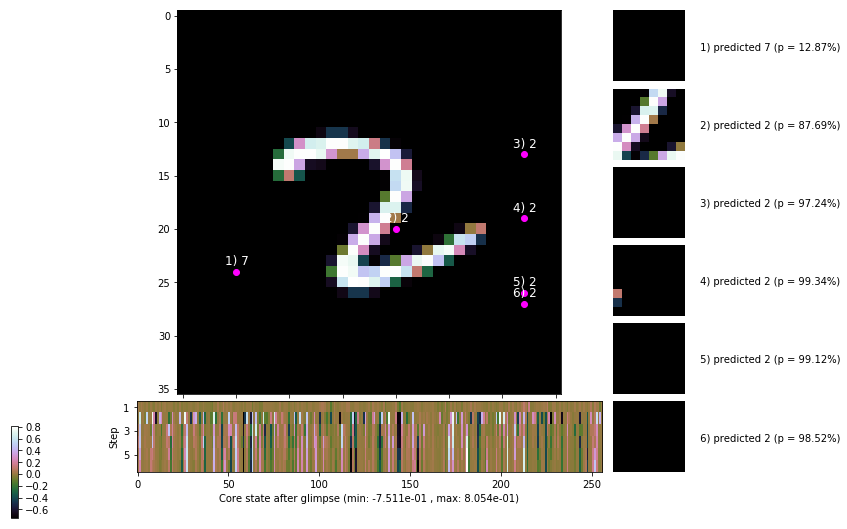

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


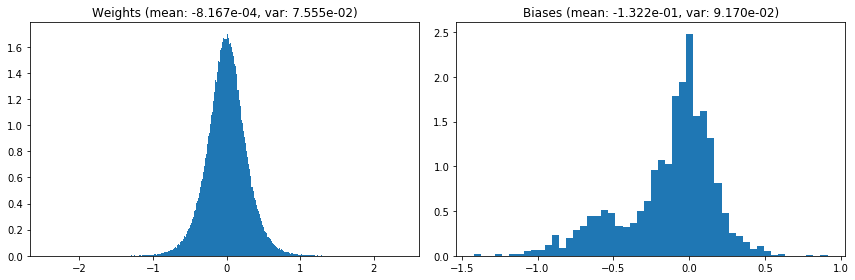

                                      Location network weights and biases


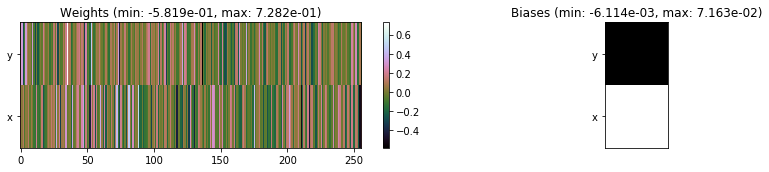

---------------------------------------------------------------------------------------------------------------
Elapsed time:  455.33 sec | TRAIN >> class loss: 0.3404 | steps:  2.238    | reward:  3.6976    | acc.: 88.677% 
                          | VAL   >> class loss: 0.3214 | steps:  2.158 :( | reward:  3.8652 :( | acc.: 89.520% 


Epoch  51/400) lr = 0.0004722
 b    300/  3000 >> 169.9 ms/b | lr: 4.72e-04 | grad 2norm: 13.72 | grad inf norm:  3.894
         Weights || abs max:  2.43 ( 1706.54) | mean: -8.31e-04 ( 0.01) | var: 7.56e-02 (   55.56)
          Biases || abs max:  1.42 (  172.52) | mean: -1.32e-01 ( 0.15) | var: 9.17e-02 (  220.99)
                    class loss: 0.329 | steps: 2.224 | reward:  3.714 | acc.: 88.68%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 161.4 ms/b | lr: 4.71e-04 | grad 2norm: 13.66 | grad inf norm:  3.724
         Weights || abs max:  2.43 ( 3213.27) | mean: -8.33e-04 ( 0.0

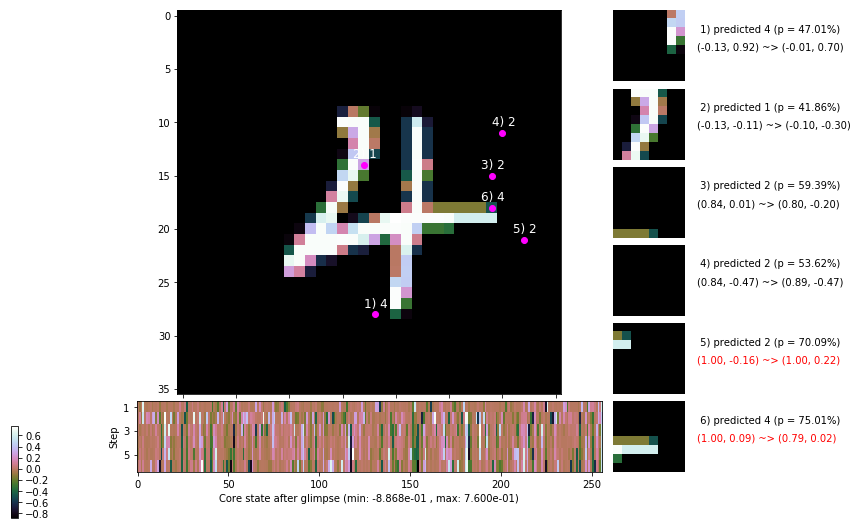

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 173.2 ms/b | lr: 4.70e-04 | grad 2norm: 13.67 | grad inf norm:  3.751
         Weights || abs max:  2.43 ( 4136.05) | mean: -8.39e-04 ( 0.01) | var: 7.57e-02 ( 3976.50)
          Biases || abs max:  1.43 (  199.74) | mean: -1.33e-01 ( 0.15) | var: 9.18e-02 (  349.02)
                    class loss: 0.338 | steps: 2.259 | reward:  3.684 | acc.: 88.88%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 157.2 ms/b | lr: 4.70e-04 | grad 2norm: 13.93 | grad inf norm:  3.943
         Weights || abs max:  2.43 (167651.00) | mean: -8.17e-04 ( 0.31) | var: 7.57e-02 (15185954.00)
          Biases || abs max:  1.43 (   42.60) | mean: -1.32e-01 ( 0.07) | var: 9.19e-02 (    9.57)
                    class loss: 0.342 | steps: 2.249 | reward:  3.680 | acc.: 88.35%

	Target class: 0 | Discounted rewards: [1.969, 1.938,

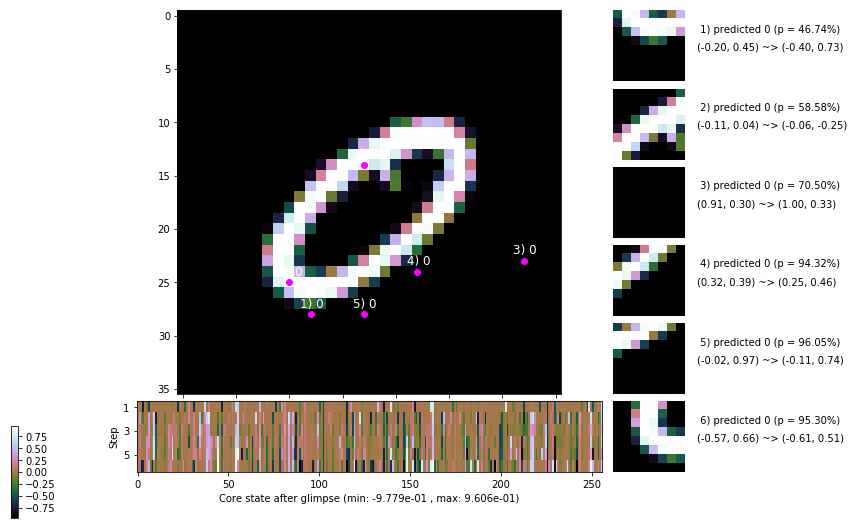

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.8 ms/b | lr: 4.69e-04 | grad 2norm: 13.79 | grad inf norm:  3.913
         Weights || abs max:  2.43 ( 5255.05) | mean: -8.14e-04 ( 0.02) | var: 7.58e-02 (  963.23)
          Biases || abs max:  1.42 (  362.32) | mean: -1.33e-01 ( 0.19) | var: 9.19e-02 ( 9557.42)
                    class loss: 0.340 | steps: 2.257 | reward:  3.669 | acc.: 88.87%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.2 ms/b | lr: 4.68e-04 | grad 2norm: 13.40 | grad inf norm:  3.636
         Weights || abs max:  2.42 ( 3396.28) | mean: -8.13e-04 ( 0.01) | var: 7.58e-02 (  379.73)
          Biases || abs max:  1.42 (  164.71) | mean: -1.32e-01 ( 0.13) | var: 9.19e-02 (  266.21)
                    class loss: 0.336 | steps: 2.216 | reward:  3.750 | acc.: 89.07%

	Target class: 4 | Discounted rewards: [-0.844, -0.688, -

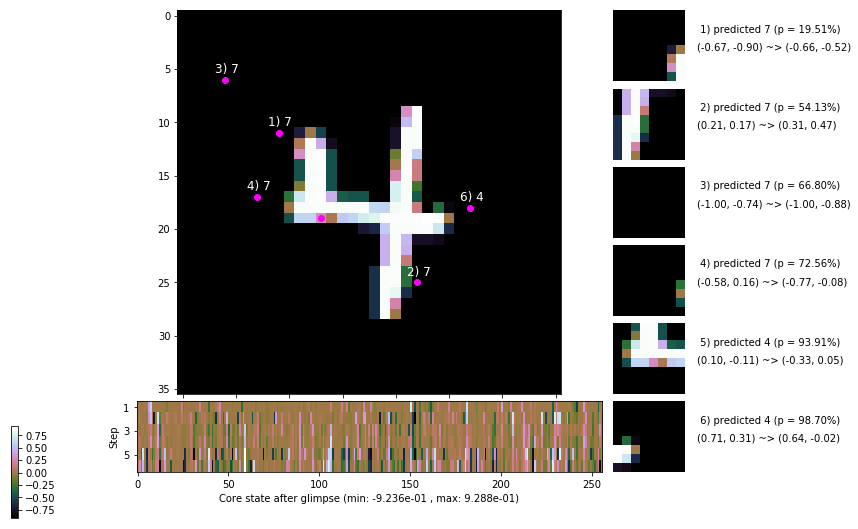

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 148.2 ms/b | lr: 4.67e-04 | grad 2norm: 13.87 | grad inf norm:  3.840
         Weights || abs max:  2.42 ( 3563.72) | mean: -8.06e-04 ( 0.01) | var: 7.58e-02 ( 1346.46)
          Biases || abs max:  1.42 (  107.42) | mean: -1.33e-01 ( 0.11) | var: 9.18e-02 (   60.70)
                    class loss: 0.341 | steps: 2.259 | reward:  3.665 | acc.: 88.82%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 143.9 ms/b | lr: 4.67e-04 | grad 2norm: 13.60 | grad inf norm:  3.696
         Weights || abs max:  2.42 ( 3542.00) | mean: -7.85e-04 ( 0.01) | var: 7.59e-02 (  599.32)
          Biases || abs max:  1.41 (   75.15) | mean: -1.33e-01 ( 0.09) | var: 9.19e-02 (   23.75)
                    class loss: 0.332 | steps: 2.220 | reward:  3.717 | acc.: 88.92%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

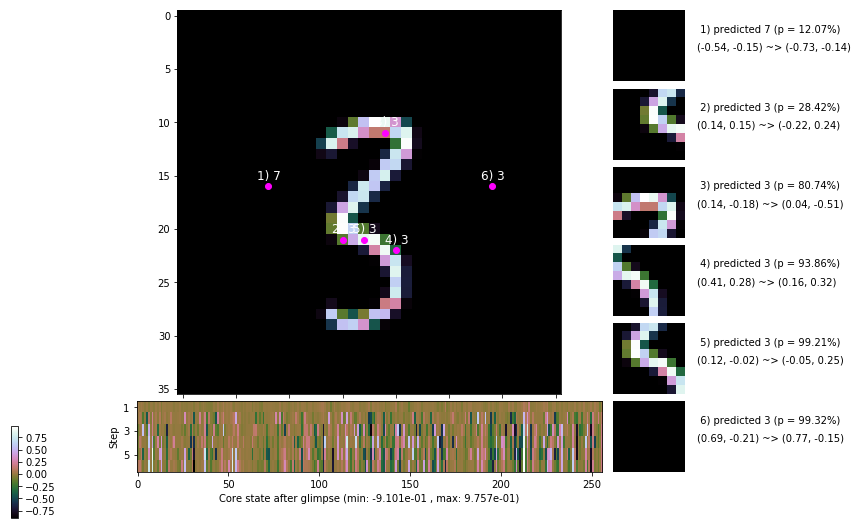

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 149.2 ms/b | lr: 4.66e-04 | grad 2norm: 13.65 | grad inf norm:  3.858
         Weights || abs max:  2.41 ( 3074.65) | mean: -7.69e-04 ( 0.01) | var: 7.59e-02 (  381.83)
          Biases || abs max:  1.42 (  896.64) | mean: -1.33e-01 ( 0.41) | var: 9.22e-02 ( 6880.63)
                    class loss: 0.341 | steps: 2.219 | reward:  3.726 | acc.: 88.52%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.0 ms/b | lr: 4.66e-04 | grad 2norm: 13.66 | grad inf norm:  3.839
         Weights || abs max:  2.41 ( 2483.89) | mean: -7.66e-04 ( 0.01) | var: 7.60e-02 (  110.74)
          Biases || abs max:  1.42 (92414.87) | mean: -1.33e-01 (35.98) | var: 9.20e-02 (979687232.00)
                    class loss: 0.336 | steps: 2.216 | reward:  3.747 | acc.: 89.08%

	Target class: 6 | Discounted rewards: [0.469, 1.938,

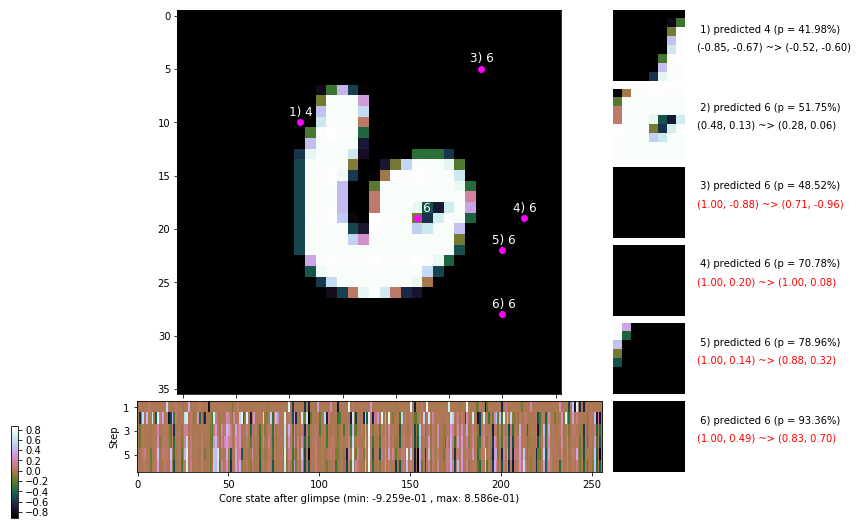

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


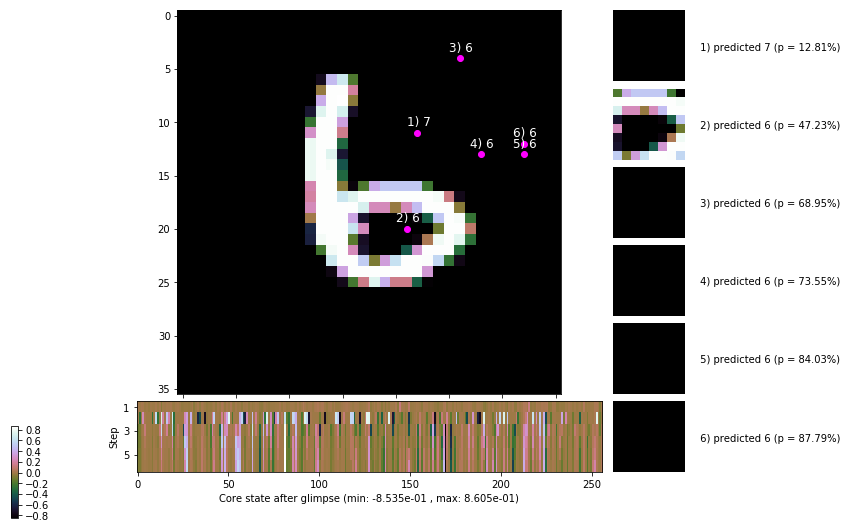


	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


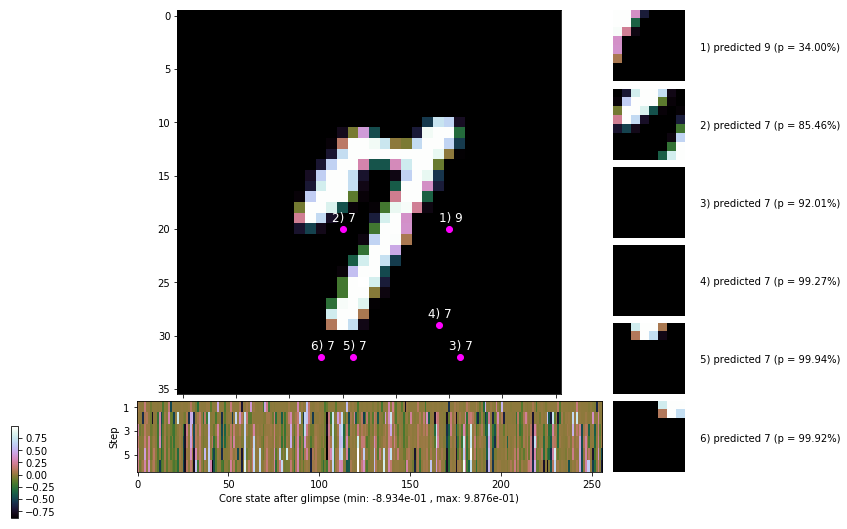

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


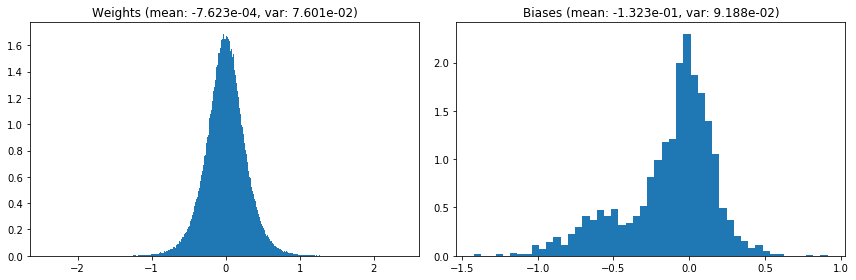

                                      Location network weights and biases


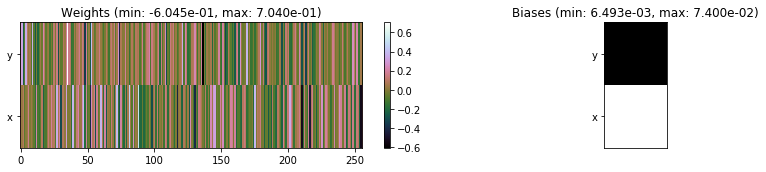

---------------------------------------------------------------------------------------------------------------
Elapsed time:  469.23 sec | TRAIN >> class loss: 0.3364 | steps:  2.234    | reward:  3.7071    | acc.: 88.813% 
                          | VAL   >> class loss: 0.3309 | steps:  2.154 :( | reward:  3.8301 :( | acc.: 88.700% :(


Epoch  52/400) lr = 0.0004652
 b    300/  3000 >> 142.2 ms/b | lr: 4.65e-04 | grad 2norm: 13.79 | grad inf norm:  4.044
         Weights || abs max:  2.40 ( 5213.27) | mean: -7.53e-04 ( 0.02) | var: 7.60e-02 ( 1712.49)
          Biases || abs max:  1.42 (  191.52) | mean: -1.32e-01 ( 0.13) | var: 9.18e-02 (  309.96)
                    class loss: 0.341 | steps: 2.208 | reward:  3.744 | acc.: 89.02%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.6 ms/b | lr: 4.64e-04 | grad 2norm: 13.96 | grad inf norm:  3.934
         Weights || abs max:  2.41 ( 4222.23) | mean: -7.68e-04 ( 0

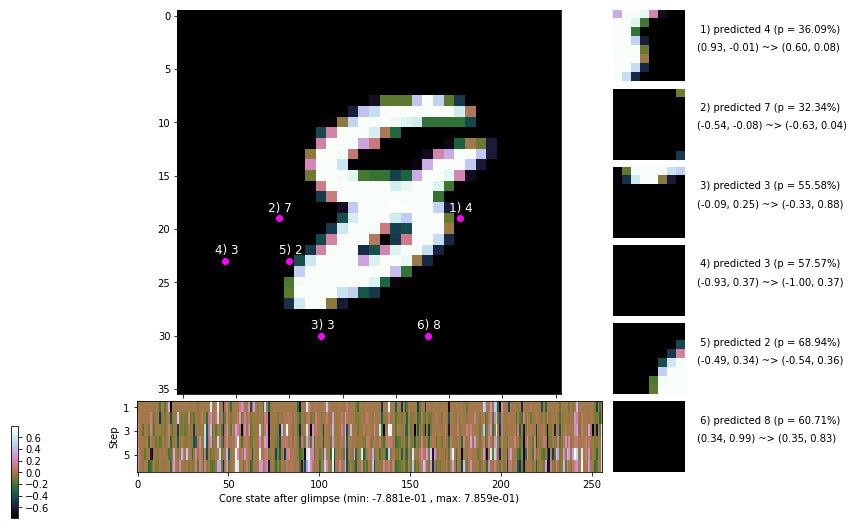

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 133.5 ms/b | lr: 4.63e-04 | grad 2norm: 13.49 | grad inf norm:  3.714
         Weights || abs max:  2.42 (17109.26) | mean: -7.87e-04 ( 0.04) | var: 7.61e-02 (119482.78)
          Biases || abs max:  1.43 (  447.95) | mean: -1.33e-01 ( 0.24) | var: 9.19e-02 ( 7101.61)
                    class loss: 0.326 | steps: 2.220 | reward:  3.724 | acc.: 89.28%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 132.8 ms/b | lr: 4.63e-04 | grad 2norm: 13.85 | grad inf norm:  3.899
         Weights || abs max:  2.42 ( 3080.60) | mean: -7.77e-04 ( 0.01) | var: 7.62e-02 (  752.87)
          Biases || abs max:  1.42 (  384.72) | mean: -1.32e-01 ( 0.22) | var: 9.19e-02 (  948.32)
                    class loss: 0.349 | steps: 2.245 | reward:  3.663 | acc.: 87.90%

	Target class: 6 | Discounted rewards: [0.094, 1.188, 0.

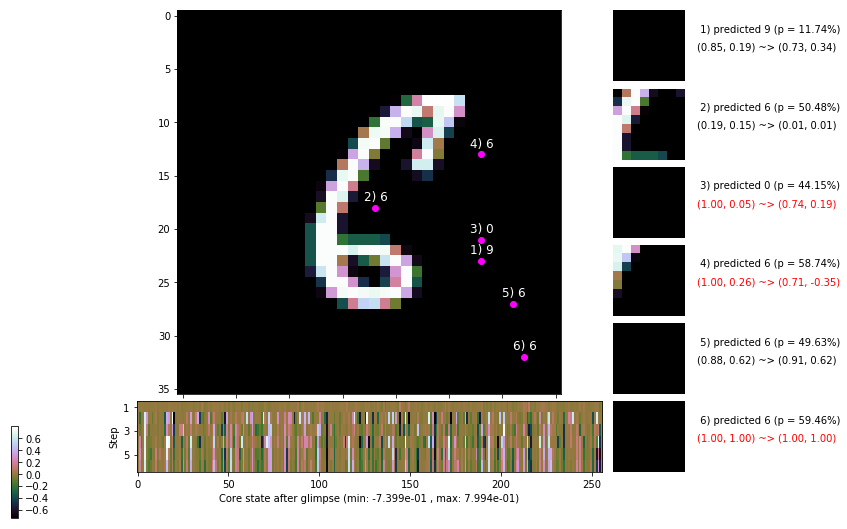

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 135.4 ms/b | lr: 4.62e-04 | grad 2norm: 13.34 | grad inf norm:  3.712
         Weights || abs max:  2.43 ( 2588.02) | mean: -7.93e-04 ( 0.01) | var: 7.62e-02 (   92.37)
          Biases || abs max:  1.43 (  205.50) | mean: -1.33e-01 ( 0.16) | var: 9.21e-02 (  152.88)
                    class loss: 0.347 | steps: 2.268 | reward:  3.648 | acc.: 88.52%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 131.2 ms/b | lr: 4.61e-04 | grad 2norm: 13.47 | grad inf norm:  3.746
         Weights || abs max:  2.43 ( 4487.70) | mean: -7.94e-04 ( 0.02) | var: 7.62e-02 ( 2822.74)
          Biases || abs max:  1.42 (  438.46) | mean: -1.33e-01 ( 0.24) | var: 9.21e-02 ( 1728.34)
                    class loss: 0.330 | steps: 2.216 | reward:  3.704 | acc.: 88.92%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

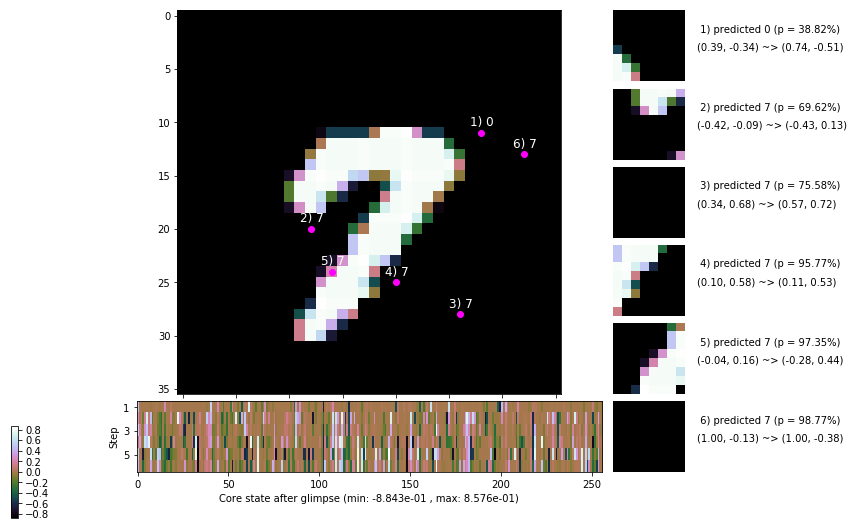

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 130.7 ms/b | lr: 4.61e-04 | grad 2norm: 13.28 | grad inf norm:  3.738
         Weights || abs max:  2.44 (13367.09) | mean: -8.34e-04 ( 0.03) | var: 7.63e-02 (67343.89)
          Biases || abs max:  1.42 (  672.18) | mean: -1.32e-01 ( 0.33) | var: 9.21e-02 ( 3551.80)
                    class loss: 0.320 | steps: 2.213 | reward:  3.730 | acc.: 89.18%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 132.3 ms/b | lr: 4.60e-04 | grad 2norm: 13.76 | grad inf norm:  4.081
         Weights || abs max:  2.44 ( 1961.24) | mean: -8.36e-04 ( 0.01) | var: 7.63e-02 (   78.92)
          Biases || abs max:  1.42 (  631.36) | mean: -1.32e-01 ( 0.31) | var: 9.22e-02 ( 7447.56)
                    class loss: 0.344 | steps: 2.239 | reward:  3.694 | acc.: 88.40%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

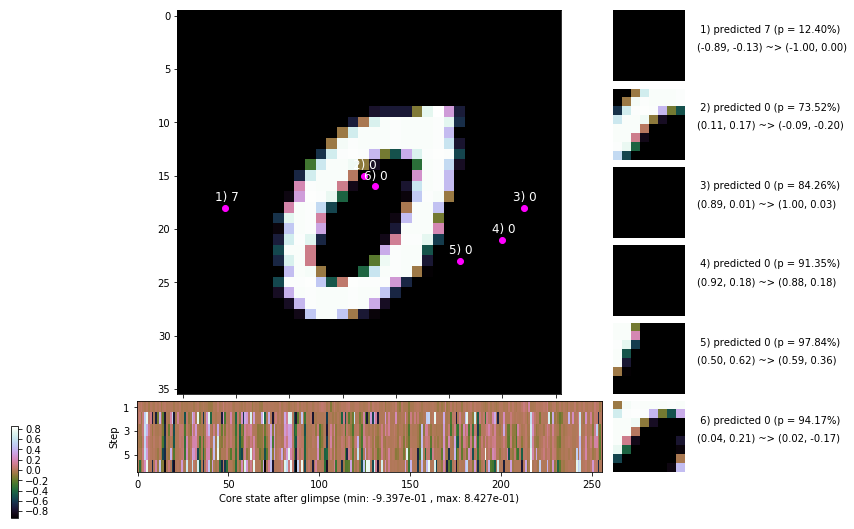

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 133.1 ms/b | lr: 4.59e-04 | grad 2norm: 13.67 | grad inf norm:  3.865
         Weights || abs max:  2.44 ( 7850.79) | mean: -8.37e-04 ( 0.02) | var: 7.64e-02 (18673.40)
          Biases || abs max:  1.42 (  295.42) | mean: -1.33e-01 ( 0.19) | var: 9.23e-02 ( 2126.73)
                    class loss: 0.340 | steps: 2.221 | reward:  3.693 | acc.: 88.35%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 132.1 ms/b | lr: 4.59e-04 | grad 2norm: 13.63 | grad inf norm:  3.883
         Weights || abs max:  2.44 ( 2450.96) | mean: -8.33e-04 ( 0.01) | var: 7.64e-02 (  157.84)
          Biases || abs max:  1.42 ( 2485.56) | mean: -1.33e-01 ( 1.05) | var: 9.23e-02 (162398.75)
                    class loss: 0.325 | steps: 2.218 | reward:  3.731 | acc.: 88.93%

	Target class: 0 | Discounted rewards: [-0.234, 0.531, -

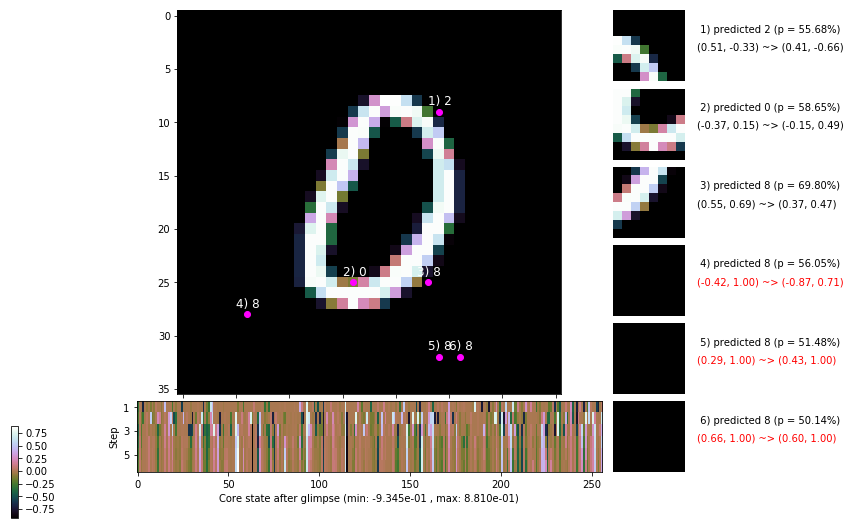

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


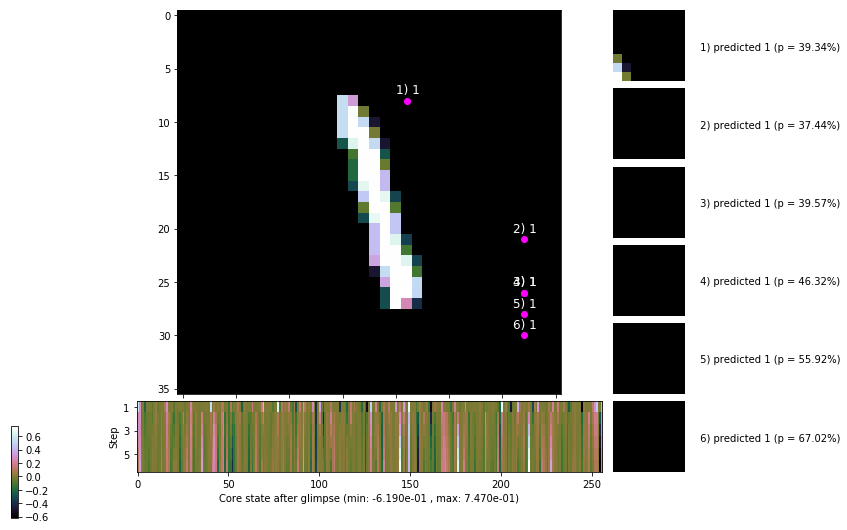


	Target class: 3 | Discounted rewards: [1.594, 1.188, 0.375, 1.750, 1.500, 1.000]


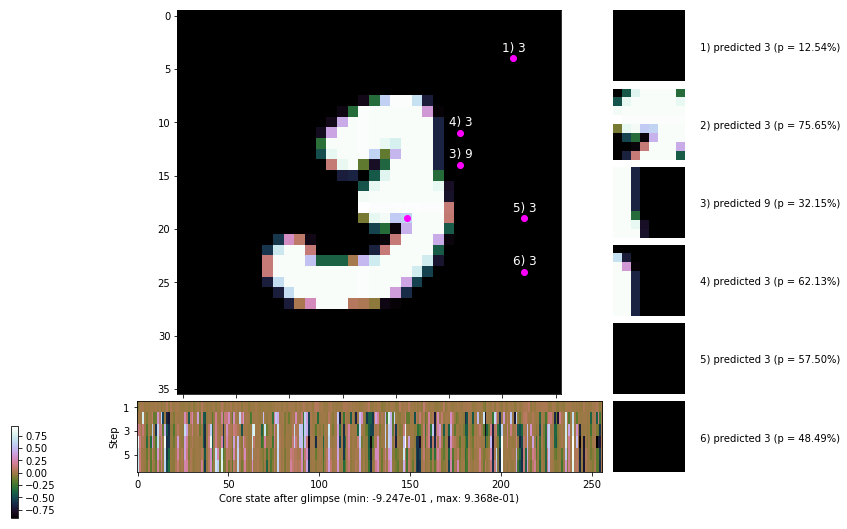

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


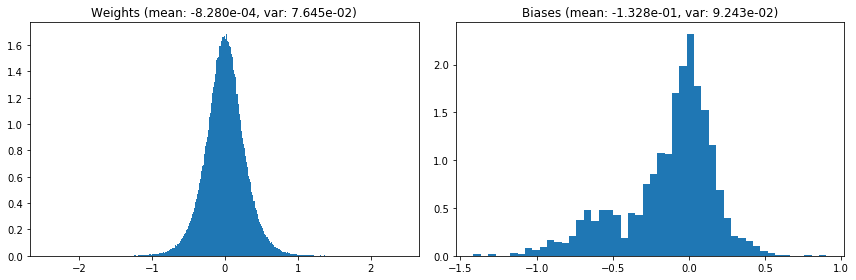

                                      Location network weights and biases


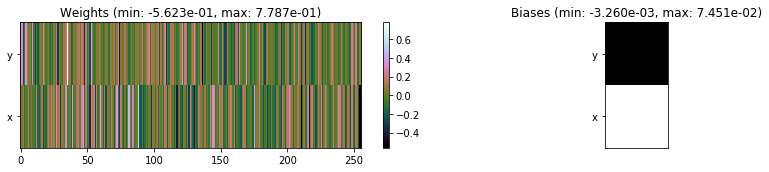

---------------------------------------------------------------------------------------------------------------
Elapsed time:  405.07 sec | TRAIN >> class loss: 0.3382 | steps:  2.232    | reward:  3.6951 :( | acc.: 88.633% :(
                          | VAL   >> class loss: 0.3102 | steps:  2.123 :( | reward:  3.8937 :( | acc.: 89.540% 


Epoch  53/400) lr = 0.0004582
 b    300/  3000 >> 126.2 ms/b | lr: 4.58e-04 | grad 2norm: 13.59 | grad inf norm:  3.800
         Weights || abs max:  2.43 ( 2799.71) | mean: -8.07e-04 ( 0.01) | var: 7.65e-02 (  283.61)
          Biases || abs max:  1.42 (  782.39) | mean: -1.33e-01 ( 0.37) | var: 9.25e-02 ( 4790.33)
                    class loss: 0.338 | steps: 2.241 | reward:  3.690 | acc.: 88.97%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 127.0 ms/b | lr: 4.57e-04 | grad 2norm: 13.45 | grad inf norm:  3.727
         Weights || abs max:  2.44 ( 2380.72) | mean: -7.98e-04 ( 0

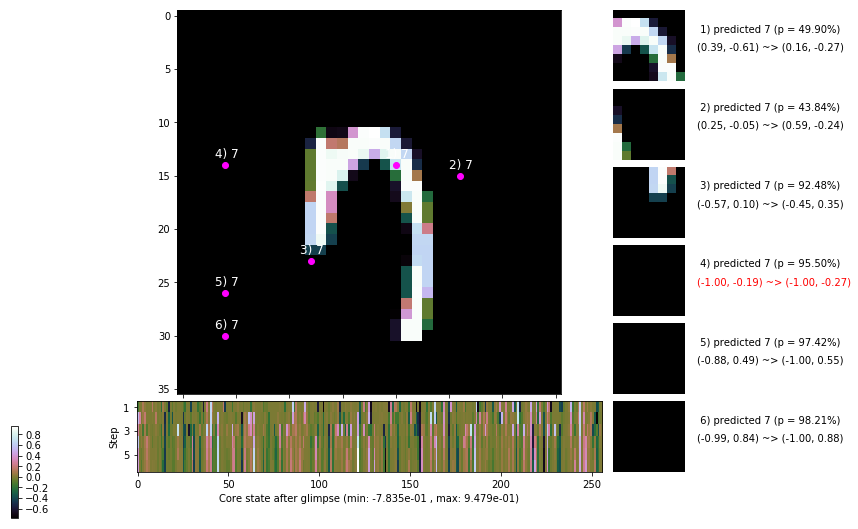

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 132.4 ms/b | lr: 4.56e-04 | grad 2norm: 13.65 | grad inf norm:  4.035
         Weights || abs max:  2.44 ( 1563.58) | mean: -7.89e-04 ( 0.01) | var: 7.66e-02 (   31.81)
          Biases || abs max:  1.41 (  114.49) | mean: -1.33e-01 ( 0.10) | var: 9.27e-02 (  103.90)
                    class loss: 0.350 | steps: 2.249 | reward:  3.650 | acc.: 88.25%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 128.5 ms/b | lr: 4.56e-04 | grad 2norm: 13.56 | grad inf norm:  3.800
         Weights || abs max:  2.45 ( 2633.10) | mean: -8.15e-04 ( 0.01) | var: 7.66e-02 (  239.58)
          Biases || abs max:  1.41 (  735.98) | mean: -1.33e-01 ( 0.35) | var: 9.29e-02 ( 5165.85)
                    class loss: 0.348 | steps: 2.200 | reward:  3.753 | acc.: 88.80%

	Target class: 9 | Discounted rewards: [-0.984, -0.969, -

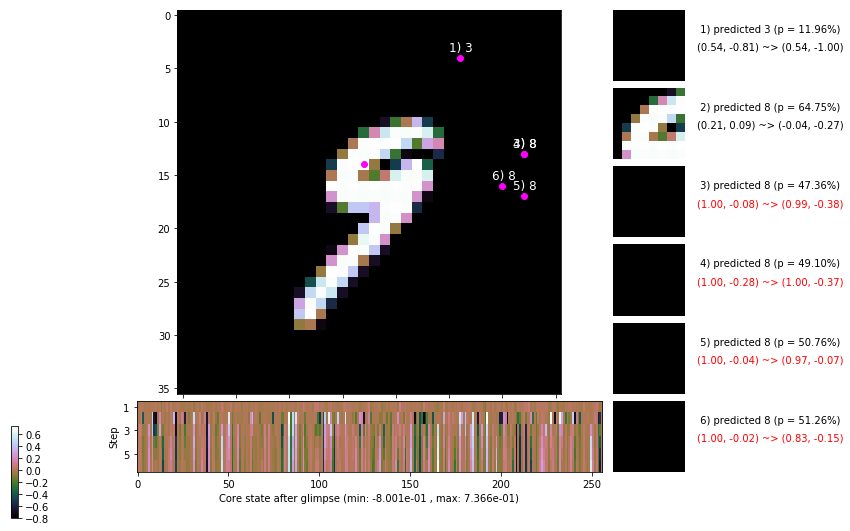

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 127.6 ms/b | lr: 4.55e-04 | grad 2norm: 13.62 | grad inf norm:  3.938
         Weights || abs max:  2.45 ( 3045.45) | mean: -8.23e-04 ( 0.01) | var: 7.66e-02 (  471.10)
          Biases || abs max:  1.41 (  202.12) | mean: -1.34e-01 ( 0.14) | var: 9.30e-02 (  187.14)
                    class loss: 0.347 | steps: 2.223 | reward:  3.724 | acc.: 88.88%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 128.5 ms/b | lr: 4.55e-04 | grad 2norm: 13.84 | grad inf norm:  3.917
         Weights || abs max:  2.44 ( 2667.85) | mean: -8.34e-04 ( 0.01) | var: 7.67e-02 (  145.33)
          Biases || abs max:  1.41 ( 1812.46) | mean: -1.34e-01 ( 0.78) | var: 9.30e-02 (186992.48)
                    class loss: 0.355 | steps: 2.275 | reward:  3.614 | acc.: 87.97%

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.

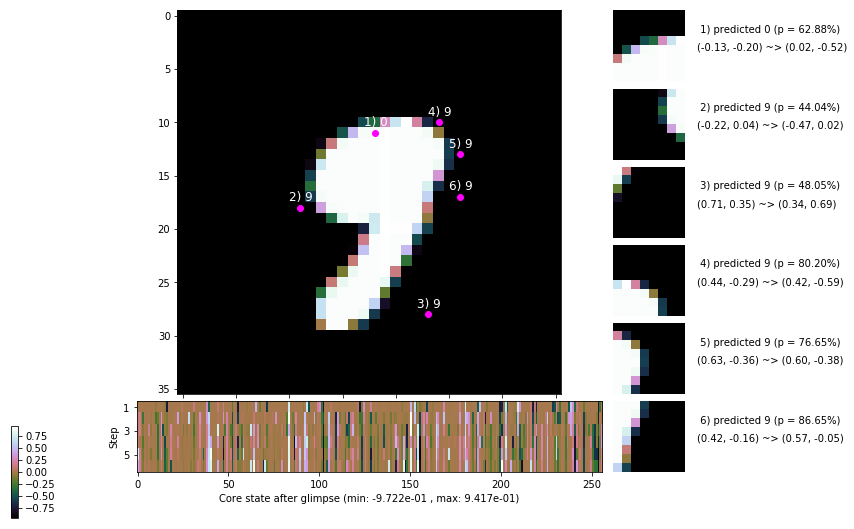

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 128.3 ms/b | lr: 4.54e-04 | grad 2norm: 13.93 | grad inf norm:  3.958
         Weights || abs max:  2.44 ( 5017.99) | mean: -8.14e-04 ( 0.02) | var: 7.67e-02 ( 1385.30)
          Biases || abs max:  1.42 (  132.30) | mean: -1.34e-01 ( 0.12) | var: 9.31e-02 (  118.93)
                    class loss: 0.361 | steps: 2.224 | reward:  3.679 | acc.: 87.65%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 126.2 ms/b | lr: 4.53e-04 | grad 2norm: 13.76 | grad inf norm:  3.774
         Weights || abs max:  2.44 ( 4064.42) | mean: -8.15e-04 ( 0.01) | var: 7.68e-02 ( 1217.12)
          Biases || abs max:  1.42 (  209.38) | mean: -1.34e-01 ( 0.15) | var: 9.31e-02 (  230.60)
                    class loss: 0.356 | steps: 2.241 | reward:  3.668 | acc.: 87.98%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

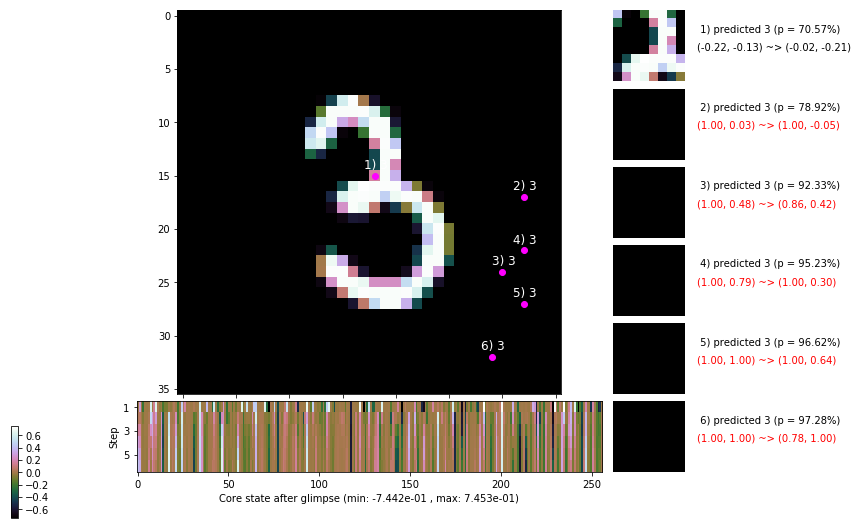

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 134.1 ms/b | lr: 4.52e-04 | grad 2norm: 13.84 | grad inf norm:  3.989
         Weights || abs max:  2.44 ( 3103.71) | mean: -8.25e-04 ( 0.01) | var: 7.68e-02 (  831.17)
          Biases || abs max:  1.42 (  924.34) | mean: -1.34e-01 ( 0.42) | var: 9.31e-02 (51799.48)
                    class loss: 0.370 | steps: 2.255 | reward:  3.649 | acc.: 87.70%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 137.8 ms/b | lr: 4.52e-04 | grad 2norm: 13.54 | grad inf norm:  3.786
         Weights || abs max:  2.45 ( 2058.31) | mean: -8.25e-04 ( 0.01) | var: 7.68e-02 (  166.04)
          Biases || abs max:  1.42 ( 3859.02) | mean: -1.34e-01 ( 1.56) | var: 9.32e-02 (1665178.00)
                    class loss: 0.348 | steps: 2.247 | reward:  3.671 | acc.: 88.10%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1

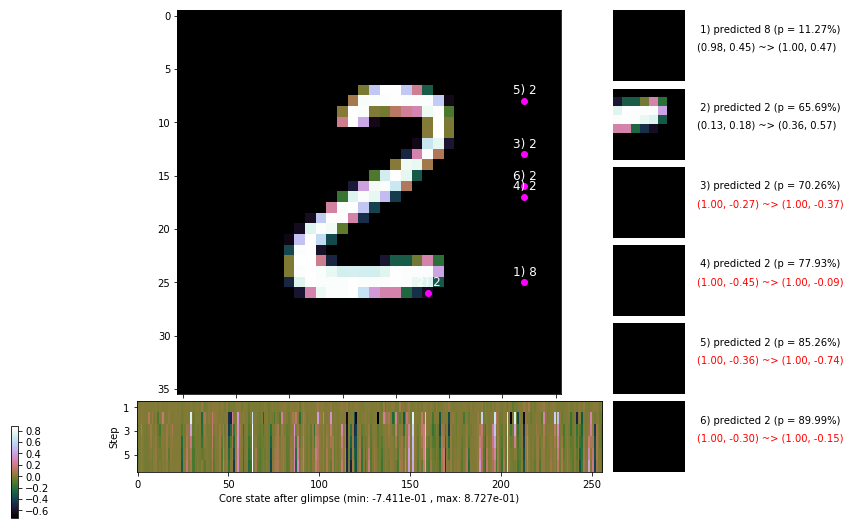

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


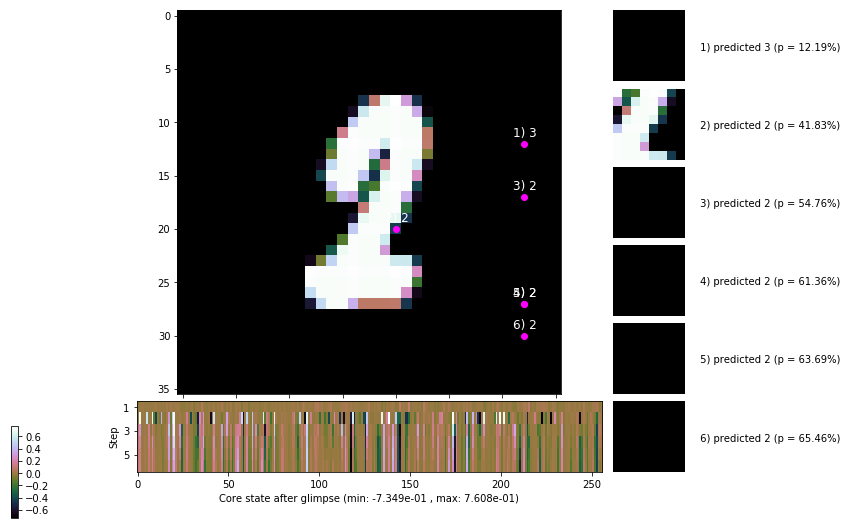


	Target class: 4 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


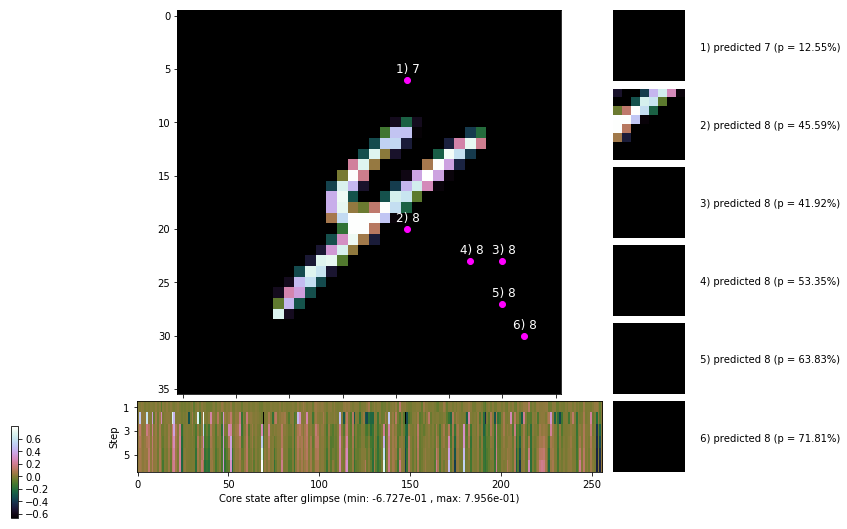

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


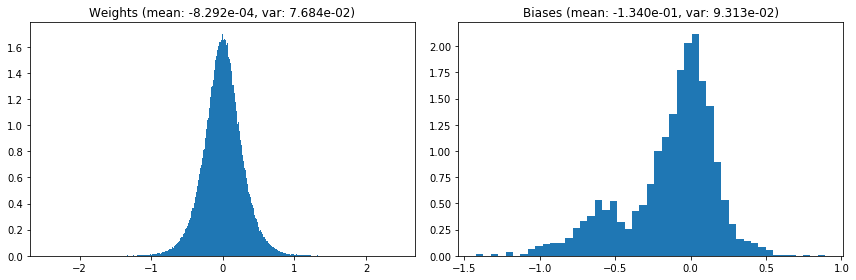

                                      Location network weights and biases


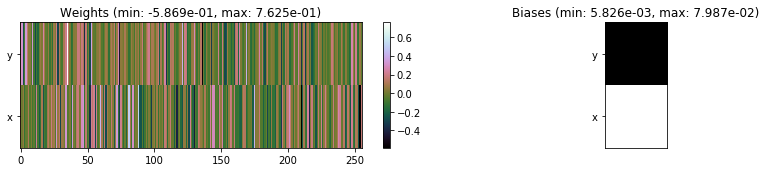

---------------------------------------------------------------------------------------------------------------
Elapsed time:  389.63 sec | TRAIN >> class loss: 0.3505 | steps:  2.240 :( | reward:  3.6806 :( | acc.: 88.335% :(
                          | VAL   >> class loss: 0.3326 | steps:  2.131 :( | reward:  3.8859 :( | acc.: 88.560% :(


Epoch  54/400) lr = 0.0004514
 b    300/  3000 >> 133.2 ms/b | lr: 4.51e-04 | grad 2norm: 13.17 | grad inf norm:  3.695
         Weights || abs max:  2.45 (13379.70) | mean: -8.08e-04 ( 0.03) | var: 7.69e-02 (60085.47)
          Biases || abs max:  1.42 (  178.16) | mean: -1.34e-01 ( 0.12) | var: 9.31e-02 (  348.28)
                    class loss: 0.337 | steps: 2.208 | reward:  3.757 | acc.: 88.85%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 135.9 ms/b | lr: 4.50e-04 | grad 2norm: 13.68 | grad inf norm:  4.005
         Weights || abs max:  2.45 ( 2974.44) | mean: -7.80e-04 (

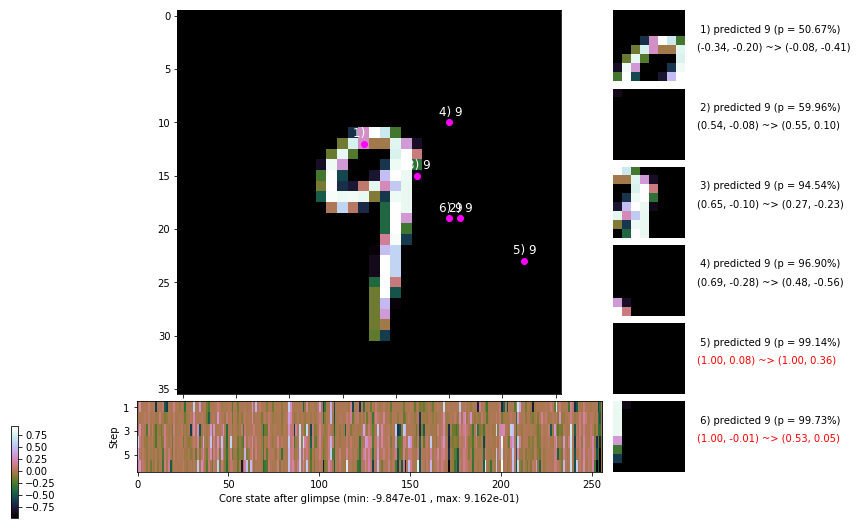

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 137.2 ms/b | lr: 4.50e-04 | grad 2norm: 13.49 | grad inf norm:  3.849
         Weights || abs max:  2.46 ( 2790.71) | mean: -7.70e-04 ( 0.01) | var: 7.69e-02 (  107.23)
          Biases || abs max:  1.43 (  396.12) | mean: -1.34e-01 ( 0.21) | var: 9.34e-02 (  252.26)
                    class loss: 0.346 | steps: 2.266 | reward:  3.665 | acc.: 88.30%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 137.1 ms/b | lr: 4.49e-04 | grad 2norm: 13.60 | grad inf norm:  3.914
         Weights || abs max:  2.46 ( 2262.81) | mean: -7.52e-04 ( 0.01) | var: 7.70e-02 (  173.10)
          Biases || abs max:  1.43 ( 2677.86) | mean: -1.34e-01 ( 1.09) | var: 9.33e-02 (126445.74)
                    class loss: 0.341 | steps: 2.248 | reward:  3.671 | acc.: 88.23%

	Target class: 8 | Discounted rewards: [-0.984, -0.969, 

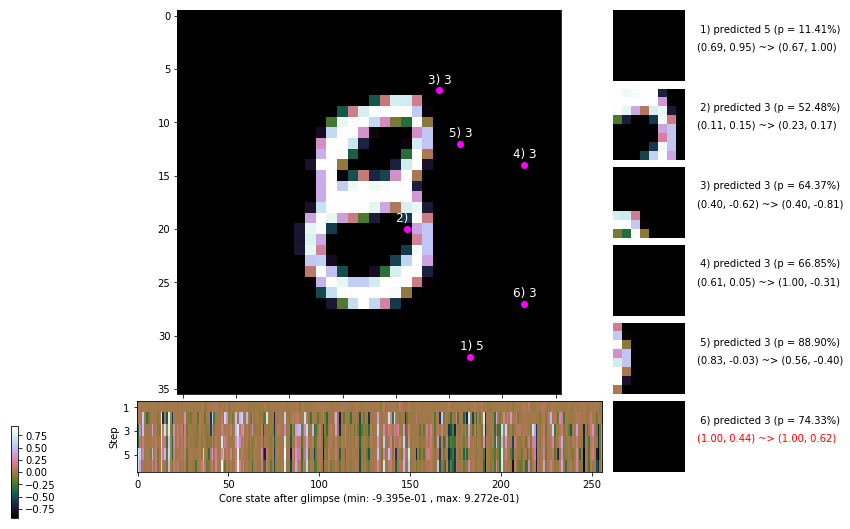

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 146.2 ms/b | lr: 4.48e-04 | grad 2norm: 13.83 | grad inf norm:  3.927
         Weights || abs max:  2.47 ( 2206.37) | mean: -7.45e-04 ( 0.01) | var: 7.70e-02 (  126.23)
          Biases || abs max:  1.43 (  108.62) | mean: -1.34e-01 ( 0.12) | var: 9.33e-02 (  607.59)
                    class loss: 0.357 | steps: 2.242 | reward:  3.660 | acc.: 87.50%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 150.6 ms/b | lr: 4.48e-04 | grad 2norm: 13.72 | grad inf norm:  4.021
         Weights || abs max:  2.48 ( 9519.78) | mean: -7.62e-04 ( 0.03) | var: 7.71e-02 (10677.48)
          Biases || abs max:  1.42 (   76.60) | mean: -1.34e-01 ( 0.09) | var: 9.34e-02 (    8.17)
                    class loss: 0.353 | steps: 2.256 | reward:  3.645 | acc.: 87.73%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

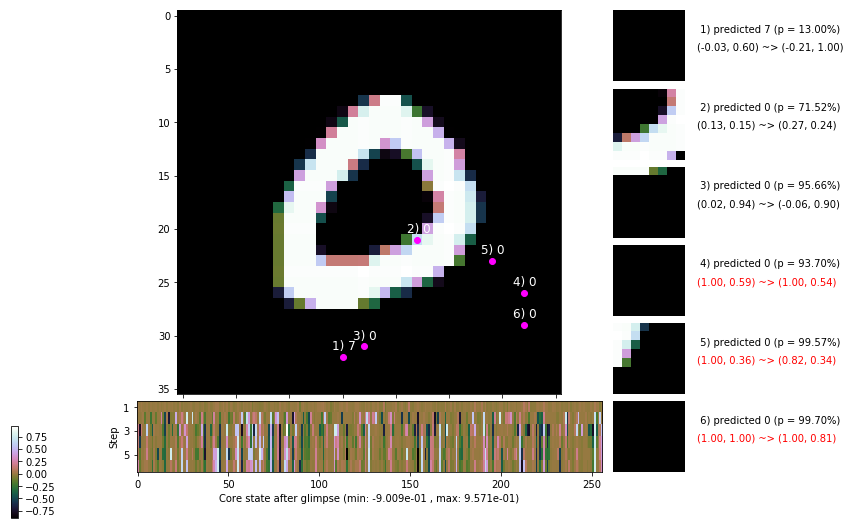

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 153.4 ms/b | lr: 4.47e-04 | grad 2norm: 13.72 | grad inf norm:  3.895
         Weights || abs max:  2.48 ( 4318.47) | mean: -7.67e-04 ( 0.01) | var: 7.71e-02 ( 1478.08)
          Biases || abs max:  1.42 (  253.52) | mean: -1.34e-01 ( 0.16) | var: 9.35e-02 (  655.36)
                    class loss: 0.352 | steps: 2.259 | reward:  3.661 | acc.: 87.67%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 170.2 ms/b | lr: 4.46e-04 | grad 2norm: 13.47 | grad inf norm:  3.812
         Weights || abs max:  2.48 ( 2796.28) | mean: -7.92e-04 ( 0.01) | var: 7.71e-02 (  299.41)
          Biases || abs max:  1.43 ( 1037.53) | mean: -1.34e-01 ( 0.47) | var: 9.37e-02 (18132.38)
                    class loss: 0.370 | steps: 2.268 | reward:  3.645 | acc.: 88.12%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

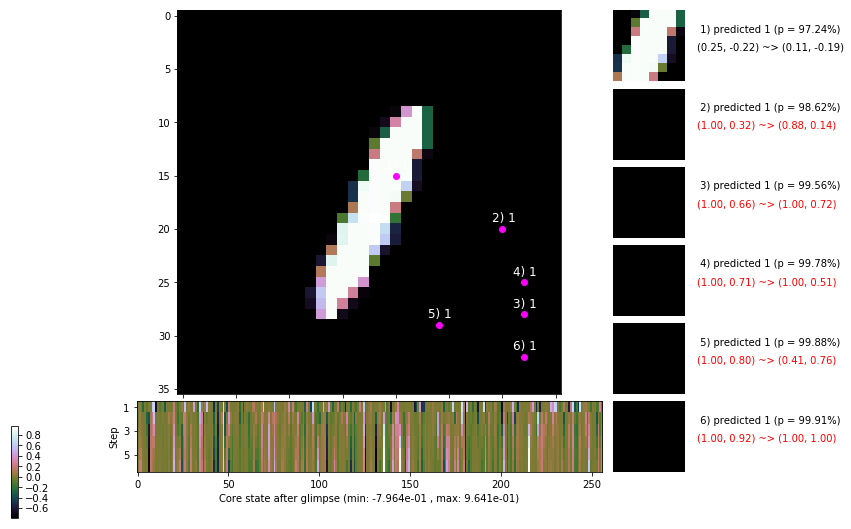

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 169.3 ms/b | lr: 4.46e-04 | grad 2norm: 13.98 | grad inf norm:  3.982
         Weights || abs max:  2.49 ( 3854.96) | mean: -7.87e-04 ( 0.01) | var: 7.72e-02 (  623.48)
          Biases || abs max:  1.42 (  153.87) | mean: -1.34e-01 ( 0.14) | var: 9.37e-02 (  847.76)
                    class loss: 0.365 | steps: 2.268 | reward:  3.637 | acc.: 87.73%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.9 ms/b | lr: 4.45e-04 | grad 2norm: 13.63 | grad inf norm:  3.899
         Weights || abs max:  2.49 ( 4011.04) | mean: -7.81e-04 ( 0.01) | var: 7.72e-02 (  699.46)
          Biases || abs max:  1.42 ( 2159.69) | mean: -1.34e-01 ( 0.91) | var: 9.36e-02 (135624.53)
                    class loss: 0.348 | steps: 2.264 | reward:  3.653 | acc.: 88.08%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.

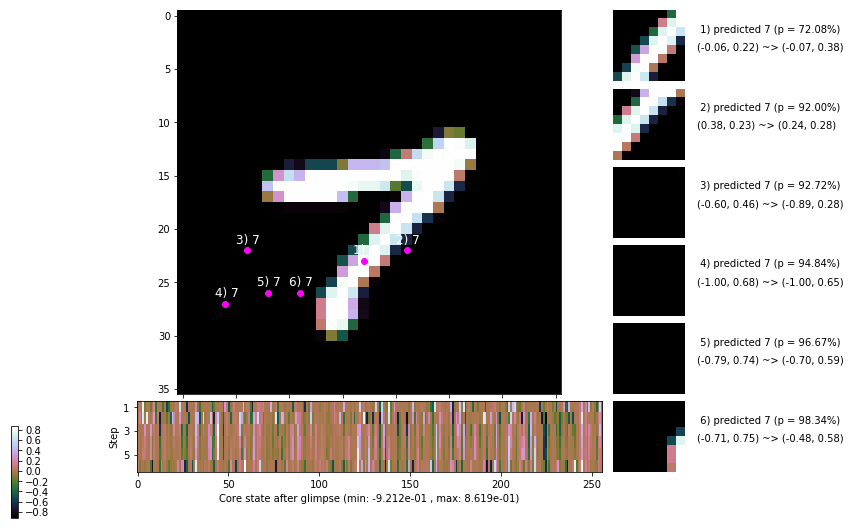

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


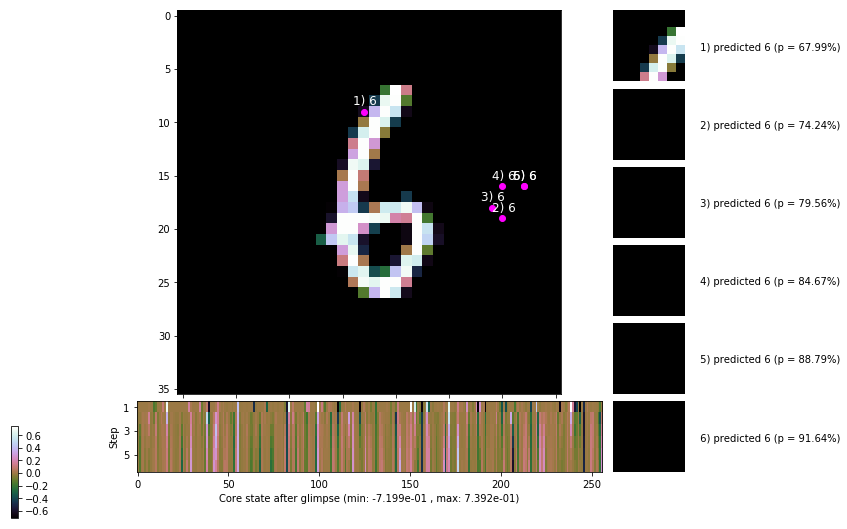


	Target class: 3 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


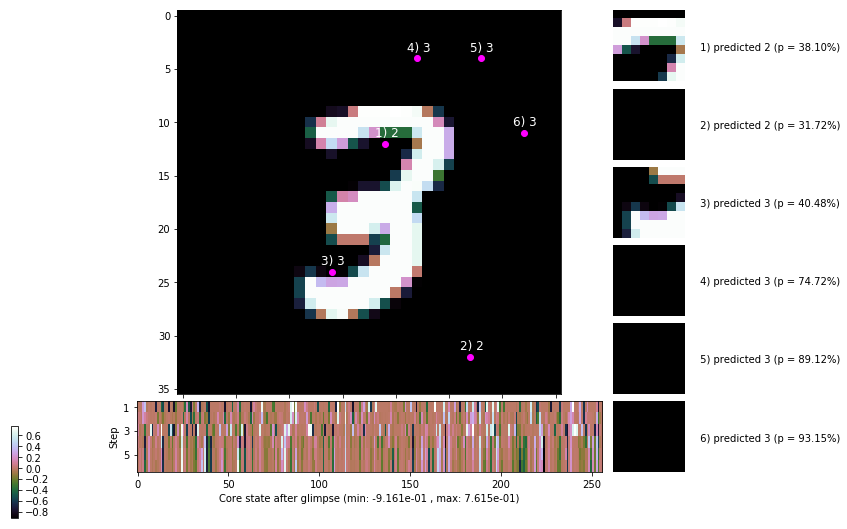

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


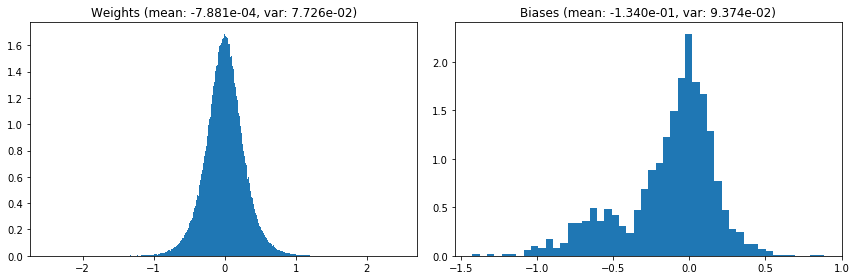

                                      Location network weights and biases


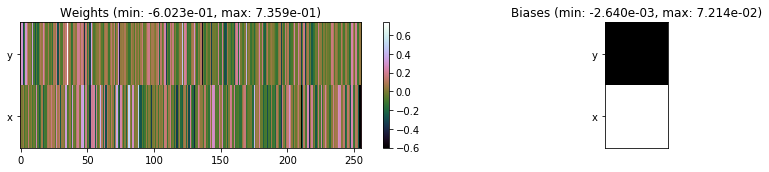

---------------------------------------------------------------------------------------------------------------
Elapsed time:  446.44 sec | TRAIN >> class loss: 0.3519 | steps:  2.252 :( | reward:  3.6671 :( | acc.: 88.030% :(
                          | VAL   >> class loss: 0.3465 | steps:  2.149 :( | reward:  3.8328 :( | acc.: 88.240% :(


Epoch  55/400) lr = 0.0004447
 b    300/  3000 >> 150.9 ms/b | lr: 4.44e-04 | grad 2norm: 13.26 | grad inf norm:  3.829
         Weights || abs max:  2.49 ( 2677.36) | mean: -7.78e-04 ( 0.01) | var: 7.73e-02 (  496.63)
          Biases || abs max:  1.42 ( 1280.44) | mean: -1.34e-01 ( 0.57) | var: 9.38e-02 (13214.68)
                    class loss: 0.331 | steps: 2.208 | reward:  3.718 | acc.: 88.78%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 149.1 ms/b | lr: 4.44e-04 | grad 2norm: 13.71 | grad inf norm:  3.879
         Weights || abs max:  2.49 (11411.12) | mean: -7.83e-04 (

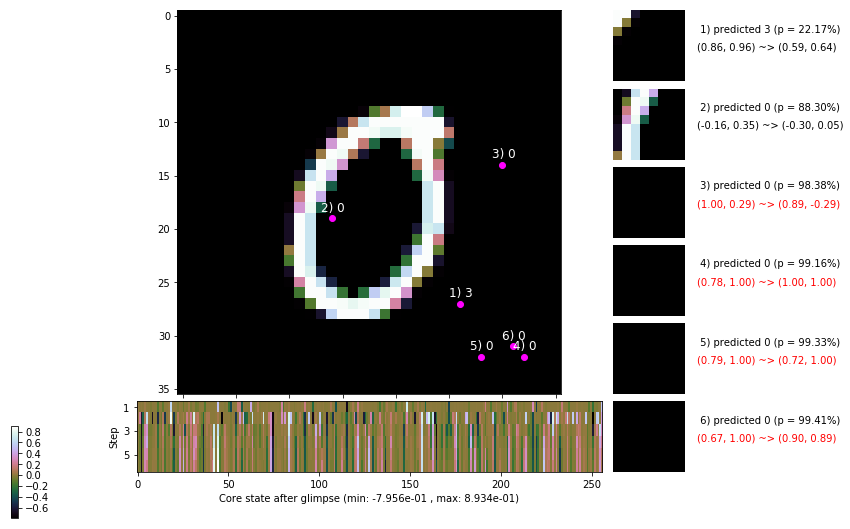

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 137.4 ms/b | lr: 4.43e-04 | grad 2norm: 13.82 | grad inf norm:  3.910
         Weights || abs max:  2.49 ( 1924.88) | mean: -8.06e-04 ( 0.01) | var: 7.74e-02 (   82.82)
          Biases || abs max:  1.42 (  324.21) | mean: -1.34e-01 ( 0.18) | var: 9.39e-02 (  477.62)
                    class loss: 0.349 | steps: 2.211 | reward:  3.696 | acc.: 88.13%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 131.2 ms/b | lr: 4.42e-04 | grad 2norm: 13.53 | grad inf norm:  4.029
         Weights || abs max:  2.49 ( 2900.18) | mean: -7.99e-04 ( 0.01) | var: 7.74e-02 (  241.41)
          Biases || abs max:  1.42 ( 1056.44) | mean: -1.34e-01 ( 0.48) | var: 9.40e-02 (35125.64)
                    class loss: 0.351 | steps: 2.243 | reward:  3.693 | acc.: 88.23%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

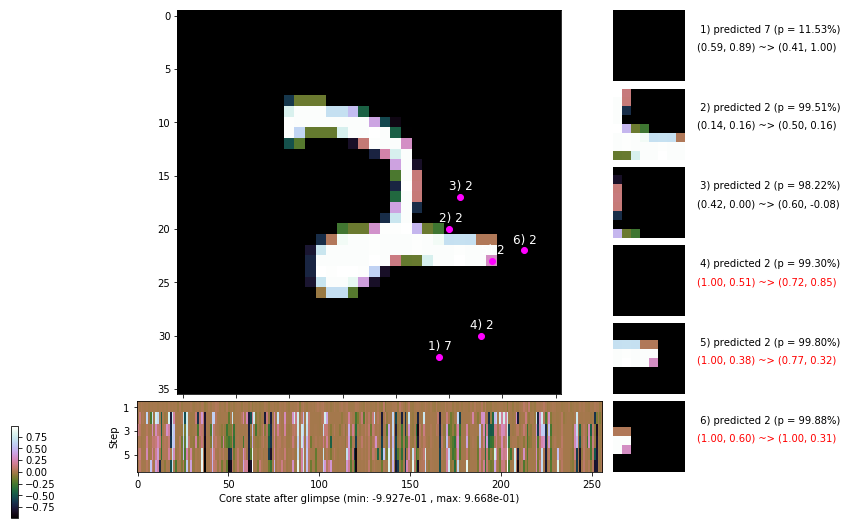

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 133.6 ms/b | lr: 4.42e-04 | grad 2norm: 13.34 | grad inf norm:  3.847
         Weights || abs max:  2.49 ( 3180.13) | mean: -7.88e-04 ( 0.01) | var: 7.74e-02 ( 1444.59)
          Biases || abs max:  1.42 (  794.34) | mean: -1.34e-01 ( 0.39) | var: 9.39e-02 (10887.41)
                    class loss: 0.340 | steps: 2.221 | reward:  3.707 | acc.: 88.70%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 135.9 ms/b | lr: 4.41e-04 | grad 2norm: 13.44 | grad inf norm:  3.850
         Weights || abs max:  2.49 ( 4985.19) | mean: -7.74e-04 ( 0.02) | var: 7.75e-02 ( 1365.37)
          Biases || abs max:  1.42 (  113.95) | mean: -1.34e-01 ( 0.11) | var: 9.38e-02 (   97.82)
                    class loss: 0.337 | steps: 2.206 | reward:  3.726 | acc.: 88.75%

	Target class: 4 | Discounted rewards: [-0.281, 0.438, 1.

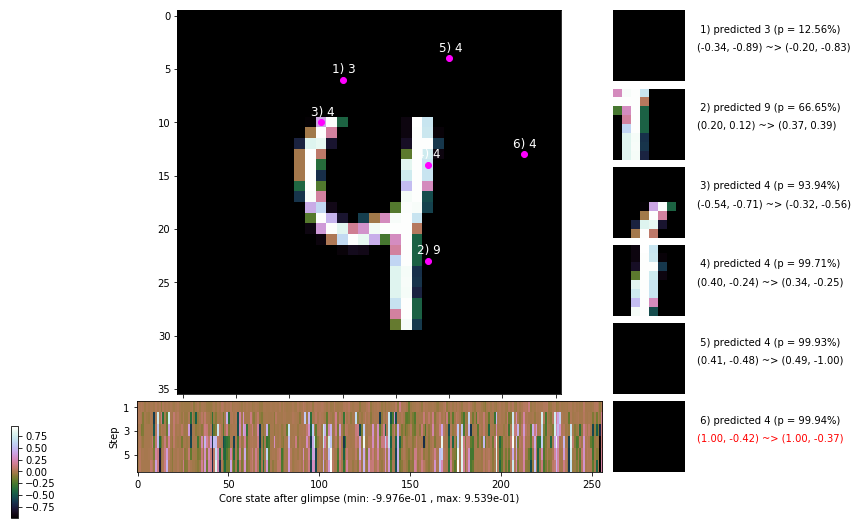

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 137.7 ms/b | lr: 4.40e-04 | grad 2norm: 13.40 | grad inf norm:  3.886
         Weights || abs max:  2.50 ( 2284.72) | mean: -7.77e-04 ( 0.01) | var: 7.75e-02 (  109.88)
          Biases || abs max:  1.42 (  171.48) | mean: -1.34e-01 ( 0.13) | var: 9.39e-02 (  150.85)
                    class loss: 0.332 | steps: 2.202 | reward:  3.751 | acc.: 88.98%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 135.1 ms/b | lr: 4.40e-04 | grad 2norm: 13.41 | grad inf norm:  3.858
         Weights || abs max:  2.50 ( 4387.85) | mean: -7.72e-04 ( 0.01) | var: 7.75e-02 ( 1012.65)
          Biases || abs max:  1.43 ( 1159.56) | mean: -1.35e-01 ( 0.51) | var: 9.41e-02 (60329.07)
                    class loss: 0.339 | steps: 2.200 | reward:  3.740 | acc.: 88.48%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

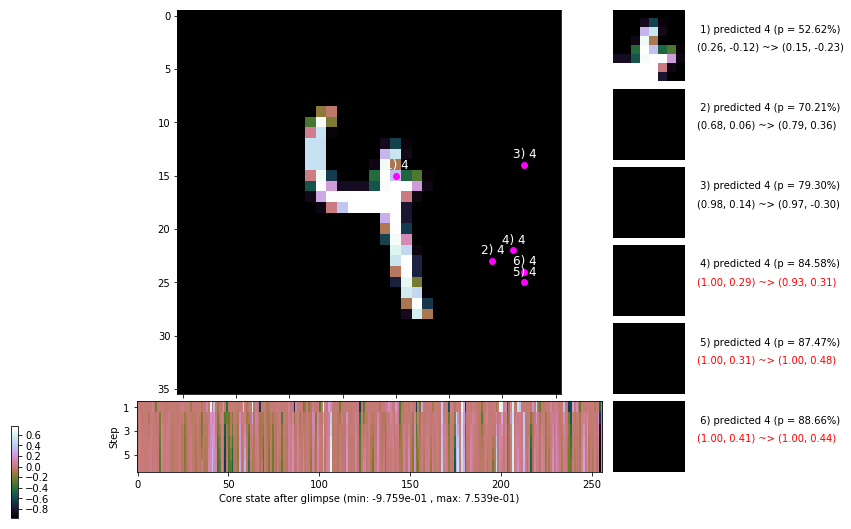

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 137.0 ms/b | lr: 4.39e-04 | grad 2norm: 13.66 | grad inf norm:  3.977
         Weights || abs max:  2.50 ( 2165.24) | mean: -7.62e-04 ( 0.01) | var: 7.76e-02 (   64.75)
          Biases || abs max:  1.42 (  848.33) | mean: -1.35e-01 ( 0.40) | var: 9.41e-02 (21726.73)
                    class loss: 0.342 | steps: 2.232 | reward:  3.679 | acc.: 88.42%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 137.2 ms/b | lr: 4.38e-04 | grad 2norm: 13.64 | grad inf norm:  3.827
         Weights || abs max:  2.51 (187186.69) | mean: -7.54e-04 ( 0.35) | var: 7.76e-02 (16193531.00)
          Biases || abs max:  1.43 (  279.70) | mean: -1.35e-01 ( 0.17) | var: 9.42e-02 (  871.60)
                    class loss: 0.345 | steps: 2.228 | reward:  3.711 | acc.: 88.47%

	Target class: 3 | Discounted rewards: [-0.984, -0.96

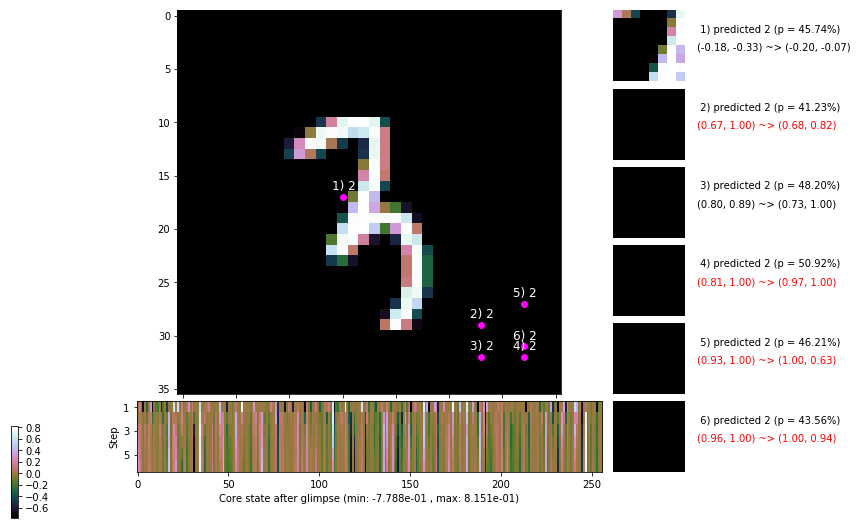

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


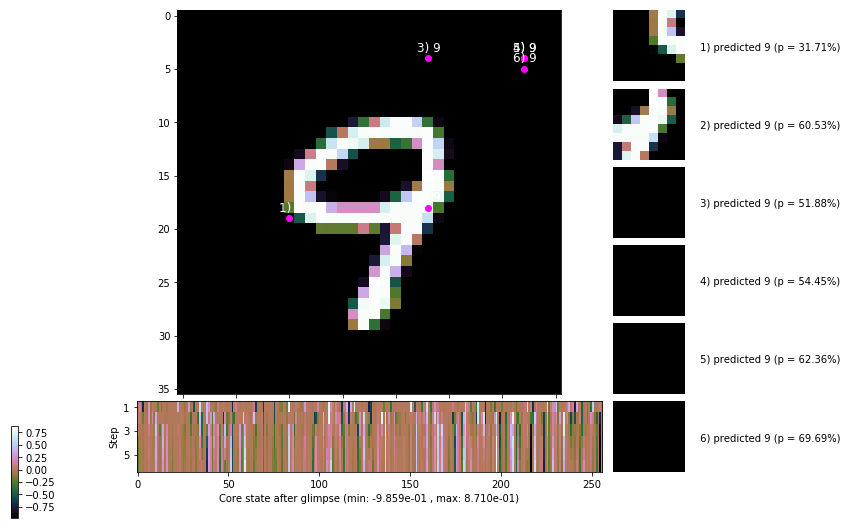


	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


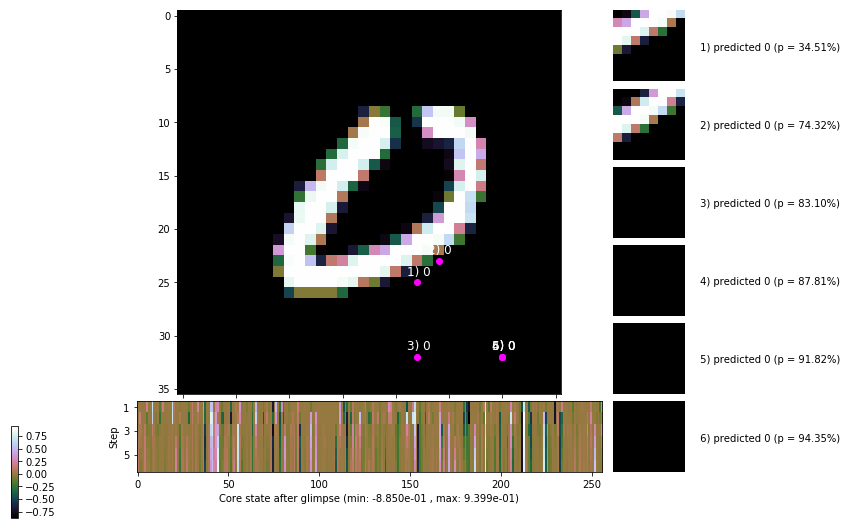

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


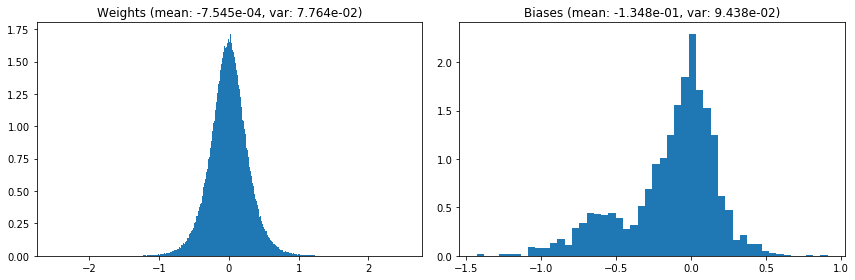

                                      Location network weights and biases


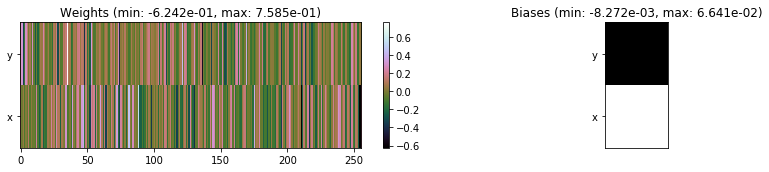

---------------------------------------------------------------------------------------------------------------
Elapsed time:  416.37 sec | TRAIN >> class loss: 0.3429 | steps:  2.220    | reward:  3.7066 :( | acc.: 88.485% :(
                          | VAL   >> class loss: 0.3357 | steps:  2.155 :( | reward:  3.8424 :( | acc.: 88.440% :(


Epoch  56/400) lr = 0.0004381
 b    300/  3000 >> 160.8 ms/b | lr: 4.38e-04 | grad 2norm: 13.66 | grad inf norm:  4.043
         Weights || abs max:  2.51 ( 2625.84) | mean: -7.60e-04 ( 0.01) | var: 7.77e-02 (  167.08)
          Biases || abs max:  1.43 (  483.26) | mean: -1.35e-01 ( 0.25) | var: 9.45e-02 (13815.67)
                    class loss: 0.353 | steps: 2.249 | reward:  3.688 | acc.: 88.23%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 148.9 ms/b | lr: 4.37e-04 | grad 2norm: 13.65 | grad inf norm:  3.900
         Weights || abs max:  2.51 (19502.95) | mean: -7.59e-04 (

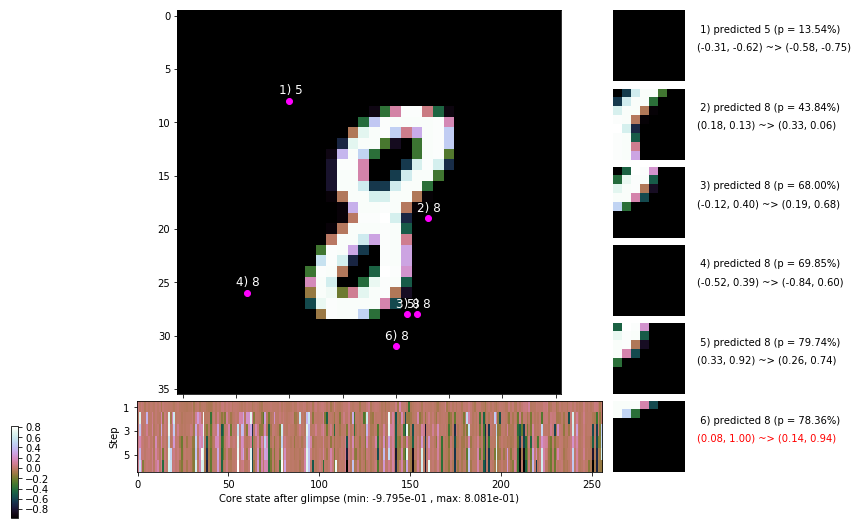

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.2 ms/b | lr: 4.36e-04 | grad 2norm: 13.55 | grad inf norm:  3.921
         Weights || abs max:  2.52 ( 6551.74) | mean: -7.66e-04 ( 0.02) | var: 7.77e-02 ( 5239.86)
          Biases || abs max:  1.43 (  294.78) | mean: -1.35e-01 ( 0.17) | var: 9.45e-02 (  391.60)
                    class loss: 0.322 | steps: 2.215 | reward:  3.735 | acc.: 88.98%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 134.1 ms/b | lr: 4.36e-04 | grad 2norm: 13.55 | grad inf norm:  3.868
         Weights || abs max:  2.52 ( 7469.92) | mean: -7.87e-04 ( 0.02) | var: 7.78e-02 (10598.43)
          Biases || abs max:  1.42 (  656.55) | mean: -1.35e-01 ( 0.32) | var: 9.44e-02 ( 6361.79)
                    class loss: 0.345 | steps: 2.249 | reward:  3.689 | acc.: 88.70%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

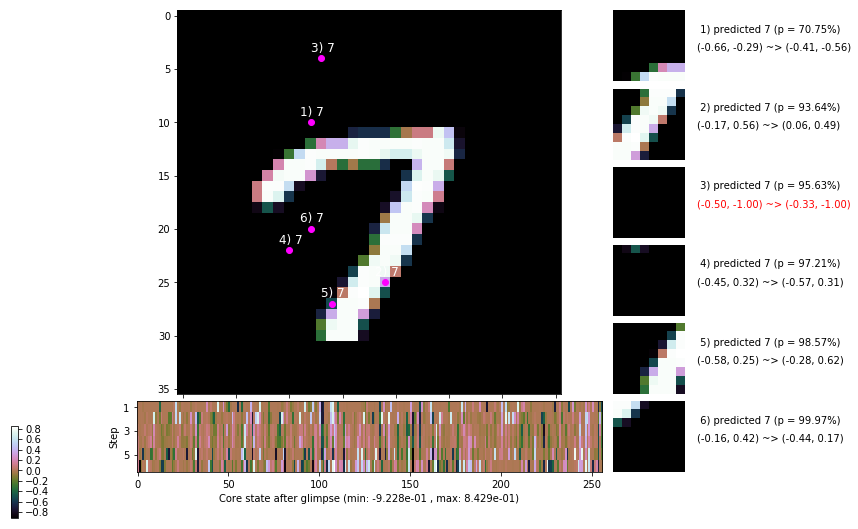

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 137.3 ms/b | lr: 4.35e-04 | grad 2norm: 13.40 | grad inf norm:  3.905
         Weights || abs max:  2.52 ( 3628.98) | mean: -7.88e-04 ( 0.01) | var: 7.78e-02 ( 1765.53)
          Biases || abs max:  1.42 (  226.98) | mean: -1.34e-01 ( 0.15) | var: 9.43e-02 (  123.70)
                    class loss: 0.336 | steps: 2.236 | reward:  3.684 | acc.: 88.42%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 136.3 ms/b | lr: 4.35e-04 | grad 2norm: 13.10 | grad inf norm:  3.698
         Weights || abs max:  2.52 ( 8966.08) | mean: -7.60e-04 ( 0.02) | var: 7.79e-02 (15041.99)
          Biases || abs max:  1.43 (  251.38) | mean: -1.34e-01 ( 0.16) | var: 9.43e-02 (  687.55)
                    class loss: 0.325 | steps: 2.200 | reward:  3.782 | acc.: 89.10%

	Target class: 3 | Discounted rewards: [-0.281, 0.438, 1.

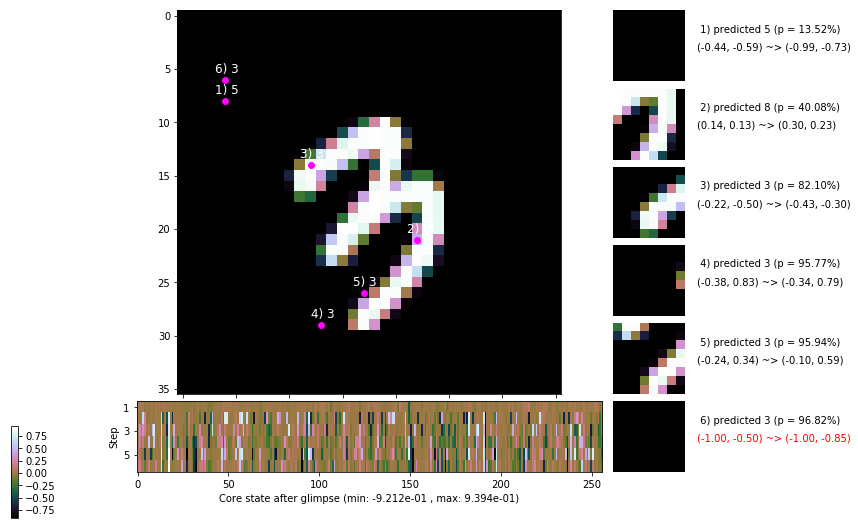

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 136.0 ms/b | lr: 4.34e-04 | grad 2norm: 13.57 | grad inf norm:  3.869
         Weights || abs max:  2.52 ( 3211.96) | mean: -7.54e-04 ( 0.01) | var: 7.79e-02 (  478.10)
          Biases || abs max:  1.44 (   69.18) | mean: -1.34e-01 ( 0.07) | var: 9.45e-02 (   16.40)
                    class loss: 0.330 | steps: 2.236 | reward:  3.700 | acc.: 88.52%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 134.8 ms/b | lr: 4.33e-04 | grad 2norm: 13.56 | grad inf norm:  3.791
         Weights || abs max:  2.51 ( 2124.76) | mean: -7.61e-04 ( 0.01) | var: 7.79e-02 (   93.67)
          Biases || abs max:  1.44 (  247.80) | mean: -1.35e-01 ( 0.15) | var: 9.45e-02 (  151.18)
                    class loss: 0.349 | steps: 2.240 | reward:  3.680 | acc.: 88.27%

	Target class: 8 | Discounted rewards: [-0.938, -0.875, -

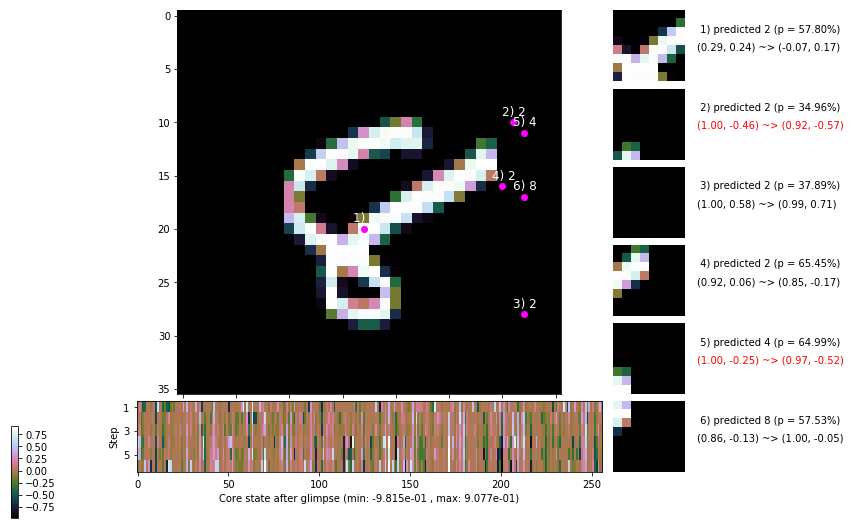

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 140.1 ms/b | lr: 4.32e-04 | grad 2norm: 13.54 | grad inf norm:  3.878
         Weights || abs max:  2.51 ( 8406.01) | mean: -7.75e-04 ( 0.02) | var: 7.80e-02 (21343.91)
          Biases || abs max:  1.44 (  447.29) | mean: -1.36e-01 ( 0.23) | var: 9.48e-02 (  418.92)
                    class loss: 0.353 | steps: 2.233 | reward:  3.696 | acc.: 88.52%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 136.3 ms/b | lr: 4.32e-04 | grad 2norm: 13.37 | grad inf norm:  3.825
         Weights || abs max:  2.52 ( 2605.26) | mean: -7.85e-04 ( 0.01) | var: 7.80e-02 (  227.00)
          Biases || abs max:  1.43 (  439.57) | mean: -1.36e-01 ( 0.26) | var: 9.48e-02 ( 2689.24)
                    class loss: 0.333 | steps: 2.234 | reward:  3.722 | acc.: 88.77%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

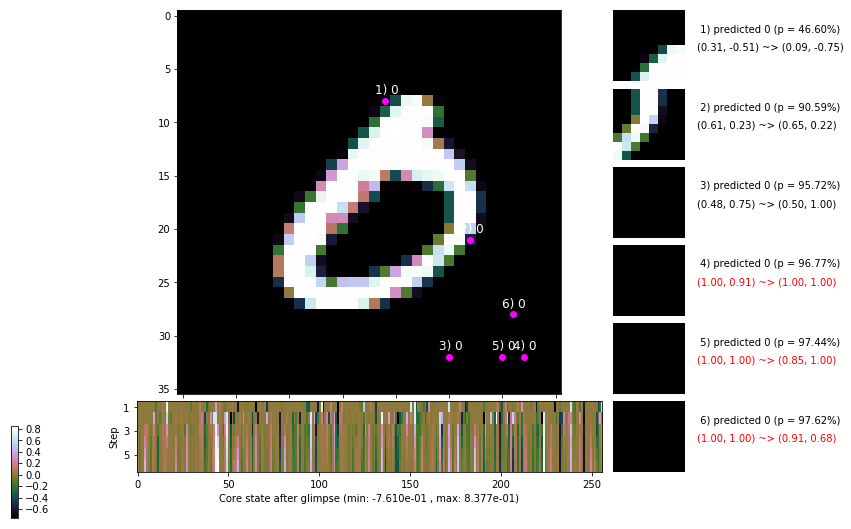

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


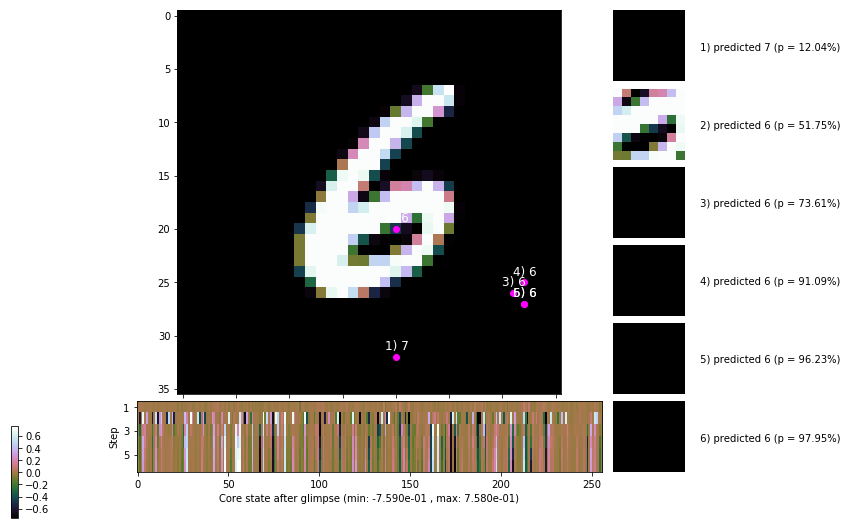


	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


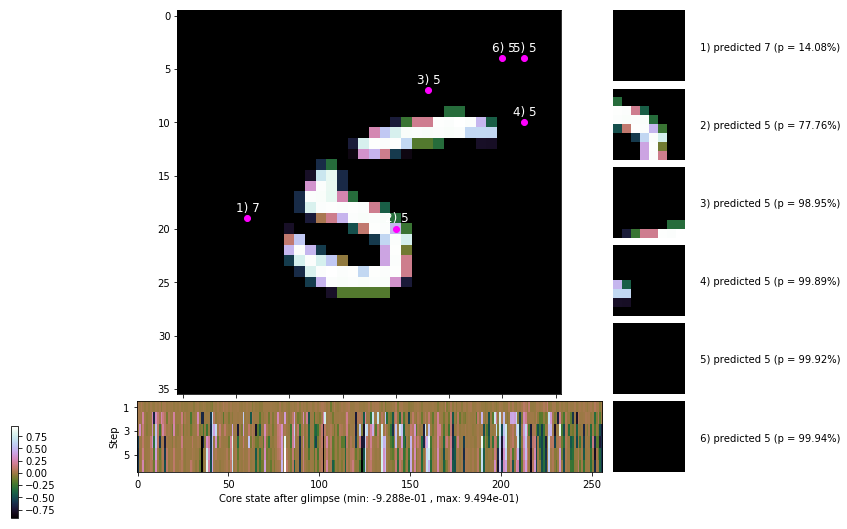

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


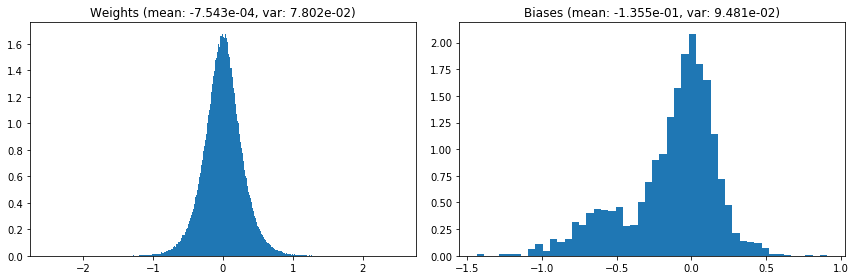

                                      Location network weights and biases


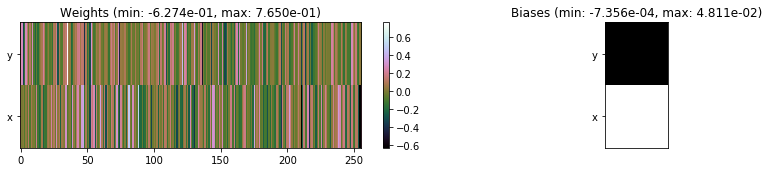

---------------------------------------------------------------------------------------------------------------
Elapsed time:  423.80 sec | TRAIN >> class loss: 0.3415 | steps:  2.234 :( | reward:  3.7037 :( | acc.: 88.493% :(
                          | VAL   >> class loss: 0.3319 | steps:  2.156 :( | reward:  3.8670 :( | acc.: 89.380% :(


Epoch  57/400) lr = 0.0004315
 b    300/  3000 >> 135.1 ms/b | lr: 4.31e-04 | grad 2norm: 13.43 | grad inf norm:  3.886
         Weights || abs max:  2.52 ( 2469.33) | mean: -7.63e-04 ( 0.01) | var: 7.81e-02 (  253.76)
          Biases || abs max:  1.43 ( 4371.32) | mean: -1.35e-01 ( 1.77) | var: 9.47e-02 (1015860.69)
                    class loss: 0.351 | steps: 2.220 | reward:  3.735 | acc.: 88.68%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 136.9 ms/b | lr: 4.31e-04 | grad 2norm: 13.45 | grad inf norm:  3.839
         Weights || abs max:  2.51 ( 2728.45) | mean: -7.60e-04

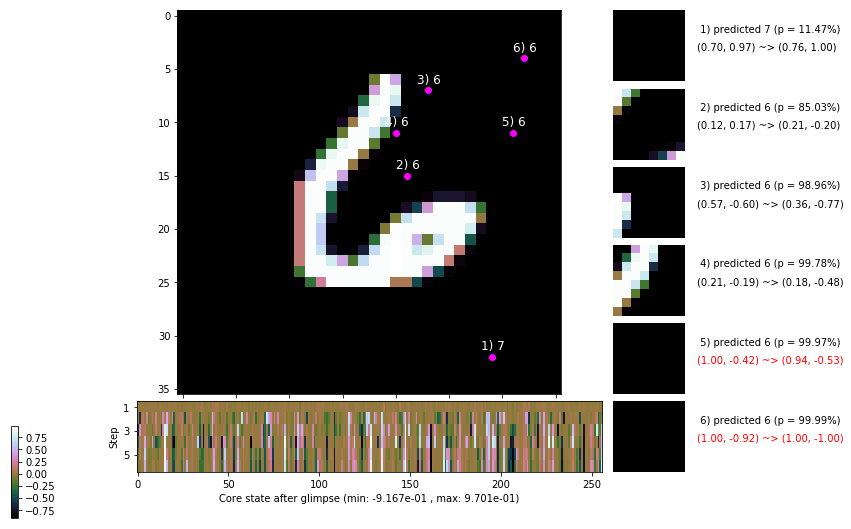

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 138.1 ms/b | lr: 4.30e-04 | grad 2norm: 13.47 | grad inf norm:  3.691
         Weights || abs max:  2.51 ( 2751.81) | mean: -7.57e-04 ( 0.01) | var: 7.81e-02 (  276.80)
          Biases || abs max:  1.44 (  206.08) | mean: -1.36e-01 ( 0.16) | var: 9.48e-02 (  191.26)
                    class loss: 0.335 | steps: 2.214 | reward:  3.705 | acc.: 88.47%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.2 ms/b | lr: 4.29e-04 | grad 2norm: 13.37 | grad inf norm:  3.850
         Weights || abs max:  2.51 ( 2516.30) | mean: -7.67e-04 ( 0.01) | var: 7.82e-02 (  212.49)
          Biases || abs max:  1.43 (  121.00) | mean: -1.35e-01 ( 0.11) | var: 9.48e-02 (  169.47)
                    class loss: 0.348 | steps: 2.220 | reward:  3.731 | acc.: 88.73%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

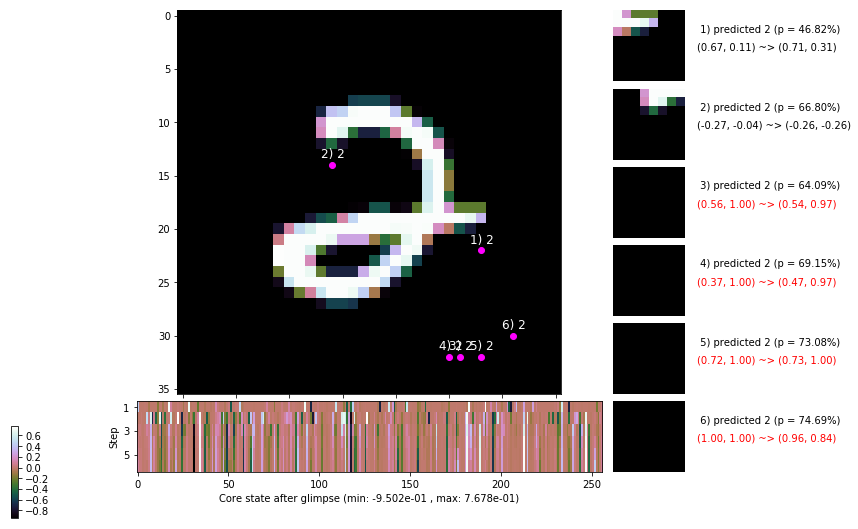

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 179.7 ms/b | lr: 4.29e-04 | grad 2norm: 13.54 | grad inf norm:  3.866
         Weights || abs max:  2.52 ( 2613.63) | mean: -7.64e-04 ( 0.01) | var: 7.82e-02 (  205.57)
          Biases || abs max:  1.44 (  740.94) | mean: -1.36e-01 ( 0.34) | var: 9.50e-02 (51488.00)
                    class loss: 0.355 | steps: 2.232 | reward:  3.689 | acc.: 88.47%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.8 ms/b | lr: 4.28e-04 | grad 2norm: 13.42 | grad inf norm:  3.871
         Weights || abs max:  2.52 ( 2995.50) | mean: -7.56e-04 ( 0.01) | var: 7.82e-02 (  514.71)
          Biases || abs max:  1.43 (  125.91) | mean: -1.36e-01 ( 0.10) | var: 9.52e-02 (   31.65)
                    class loss: 0.349 | steps: 2.244 | reward:  3.676 | acc.: 88.47%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

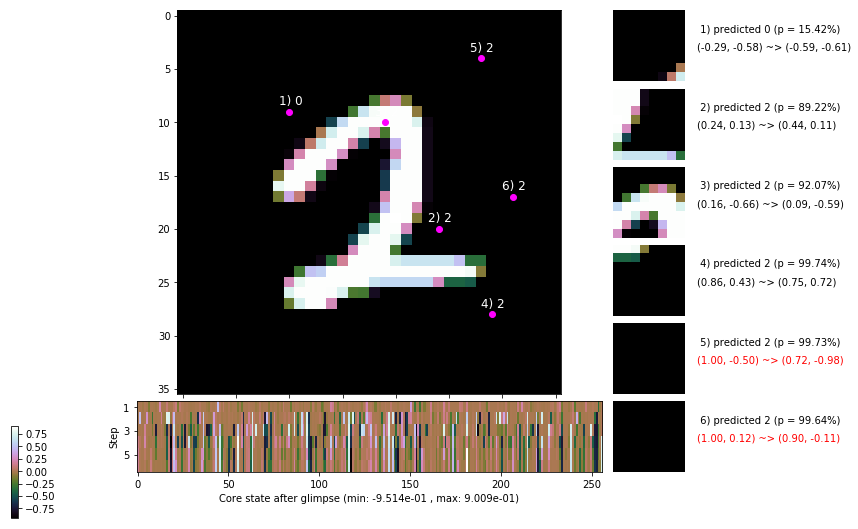

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 140.9 ms/b | lr: 4.27e-04 | grad 2norm: 13.57 | grad inf norm:  3.741
         Weights || abs max:  2.52 ( 2183.67) | mean: -7.60e-04 ( 0.01) | var: 7.82e-02 (  164.49)
          Biases || abs max:  1.43 (  151.49) | mean: -1.36e-01 ( 0.13) | var: 9.53e-02 (  522.18)
                    class loss: 0.350 | steps: 2.229 | reward:  3.701 | acc.: 88.63%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 136.1 ms/b | lr: 4.27e-04 | grad 2norm: 13.52 | grad inf norm:  4.082
         Weights || abs max:  2.52 ( 2560.80) | mean: -7.48e-04 ( 0.01) | var: 7.83e-02 (  234.20)
          Biases || abs max:  1.43 (  773.04) | mean: -1.36e-01 ( 0.37) | var: 9.52e-02 (19545.78)
                    class loss: 0.332 | steps: 2.206 | reward:  3.740 | acc.: 89.17%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

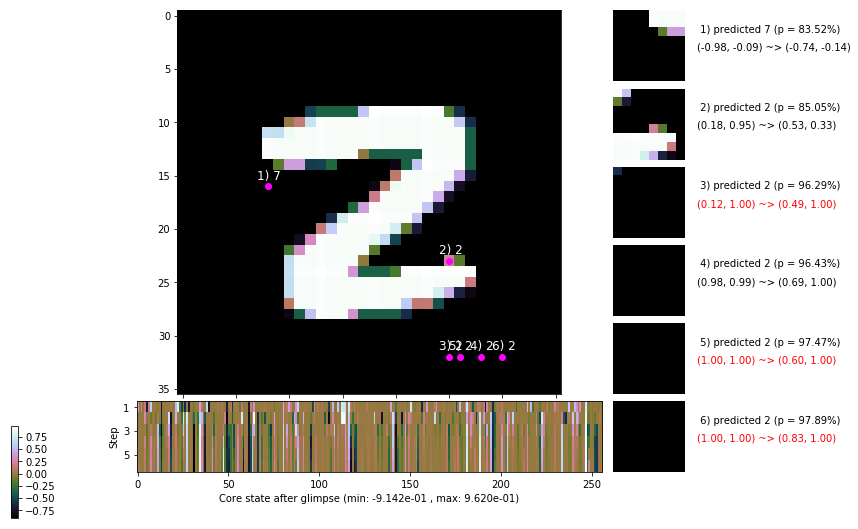

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 139.0 ms/b | lr: 4.26e-04 | grad 2norm: 13.82 | grad inf norm:  4.013
         Weights || abs max:  2.53 ( 3395.87) | mean: -7.47e-04 ( 0.01) | var: 7.83e-02 (  815.58)
          Biases || abs max:  1.43 (  202.70) | mean: -1.35e-01 ( 0.14) | var: 9.51e-02 (   82.69)
                    class loss: 0.357 | steps: 2.260 | reward:  3.635 | acc.: 87.92%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 135.1 ms/b | lr: 4.26e-04 | grad 2norm: 13.04 | grad inf norm:  3.816
         Weights || abs max:  2.53 ( 2053.13) | mean: -7.42e-04 ( 0.01) | var: 7.84e-02 (   90.39)
          Biases || abs max:  1.44 (   77.46) | mean: -1.35e-01 ( 0.08) | var: 9.51e-02 (   29.37)
                    class loss: 0.334 | steps: 2.235 | reward:  3.730 | acc.: 89.30%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

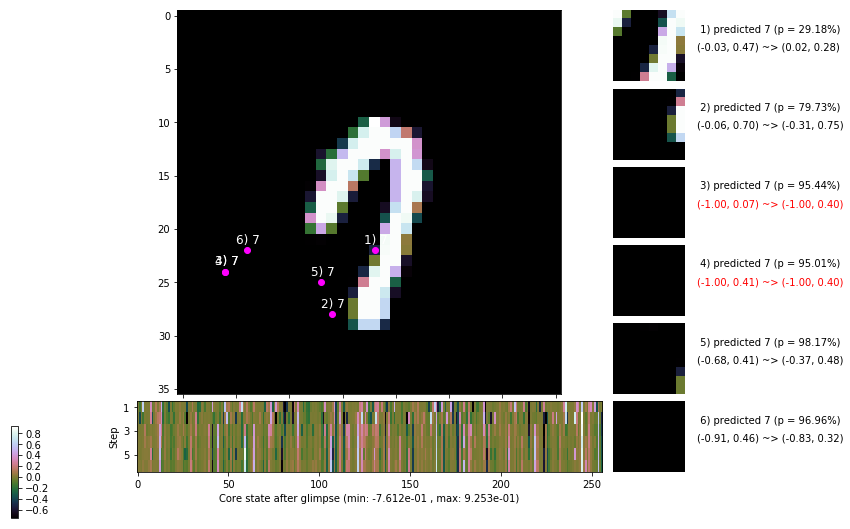

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


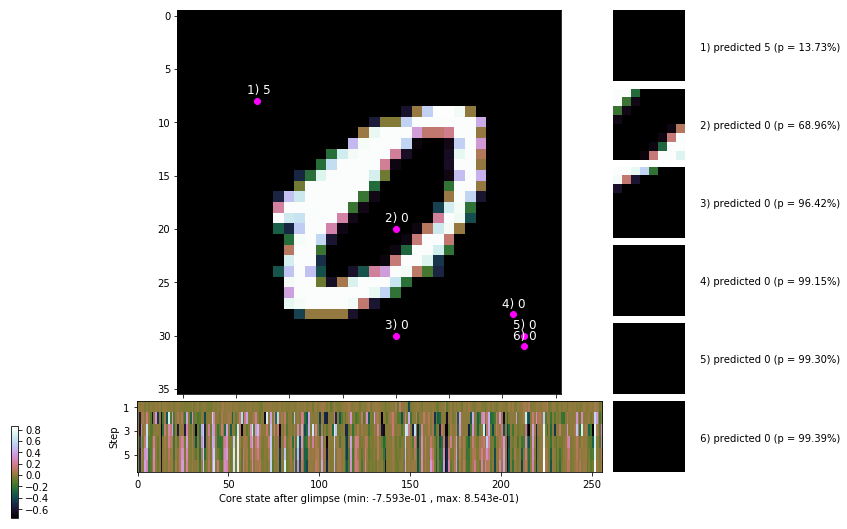


	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


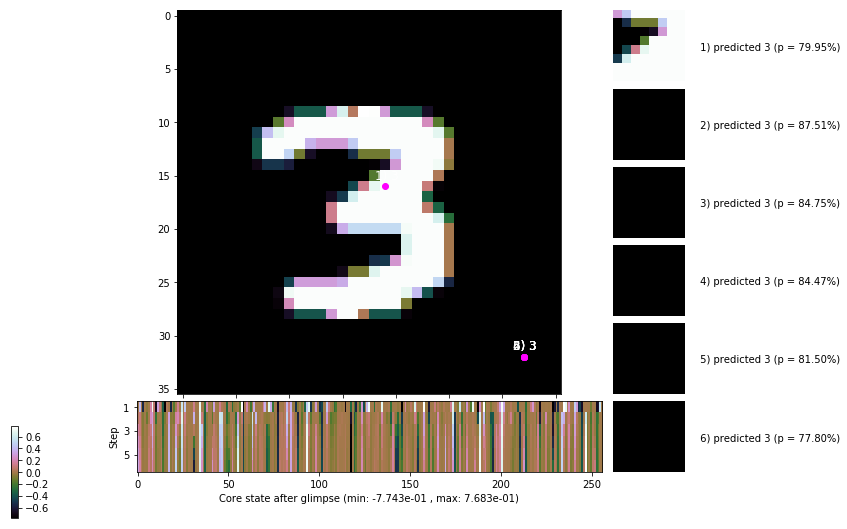

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


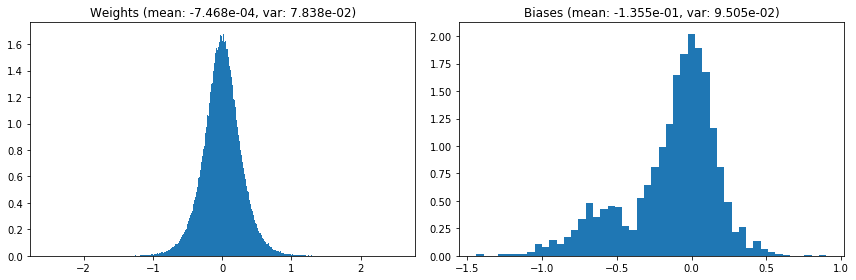

                                      Location network weights and biases


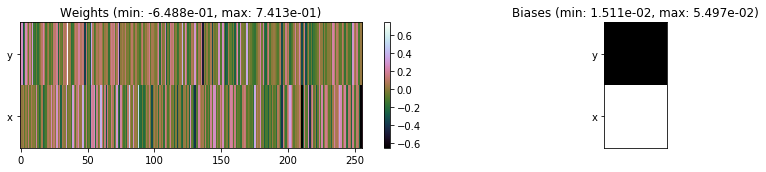

---------------------------------------------------------------------------------------------------------------
Elapsed time:  427.09 sec | TRAIN >> class loss: 0.3463 | steps:  2.229 :( | reward:  3.7003 :( | acc.: 88.575% :(
                          | VAL   >> class loss: 0.3097 | steps:  2.140 :( | reward:  3.8895 :( | acc.: 89.140% :(


Epoch  58/400) lr = 0.0004251
 b    300/  3000 >> 136.0 ms/b | lr: 4.25e-04 | grad 2norm: 13.44 | grad inf norm:  3.939
         Weights || abs max:  2.54 ( 2036.13) | mean: -7.40e-04 ( 0.01) | var: 7.84e-02 (   43.41)
          Biases || abs max:  1.44 (  126.37) | mean: -1.35e-01 ( 0.12) | var: 9.50e-02 (  390.02)
                    class loss: 0.332 | steps: 2.218 | reward:  3.726 | acc.: 88.80%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 135.6 ms/b | lr: 4.24e-04 | grad 2norm: 13.33 | grad inf norm:  3.785
         Weights || abs max:  2.54 ( 6190.86) | mean: -7.51e-04 (

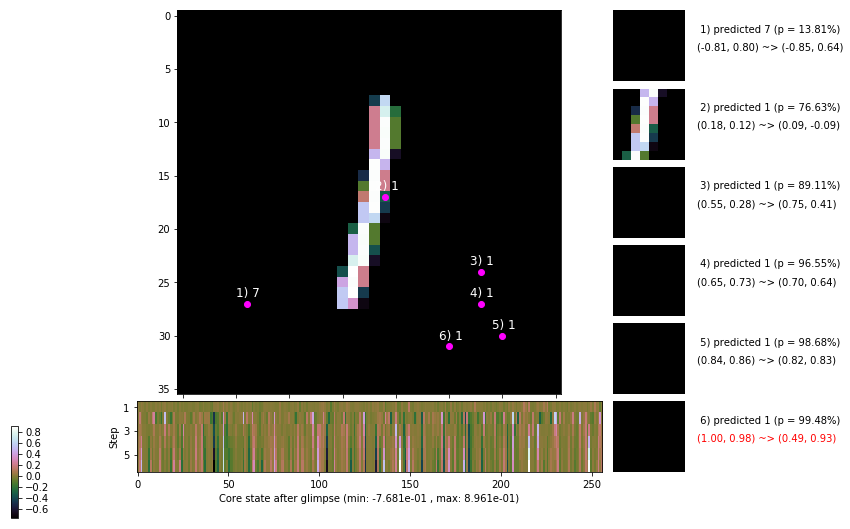

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 151.6 ms/b | lr: 4.23e-04 | grad 2norm: 13.32 | grad inf norm:  3.768
         Weights || abs max:  2.53 ( 3997.23) | mean: -7.42e-04 ( 0.02) | var: 7.85e-02 (  298.22)
          Biases || abs max:  1.43 (   74.54) | mean: -1.35e-01 ( 0.08) | var: 9.51e-02 (  129.73)
                    class loss: 0.330 | steps: 2.212 | reward:  3.730 | acc.: 88.57%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 146.5 ms/b | lr: 4.23e-04 | grad 2norm: 13.33 | grad inf norm:  3.659
         Weights || abs max:  2.53 ( 3014.34) | mean: -7.45e-04 ( 0.01) | var: 7.85e-02 (  281.38)
          Biases || abs max:  1.42 (  468.01) | mean: -1.35e-01 ( 0.23) | var: 9.51e-02 ( 4446.08)
                    class loss: 0.336 | steps: 2.210 | reward:  3.736 | acc.: 88.70%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

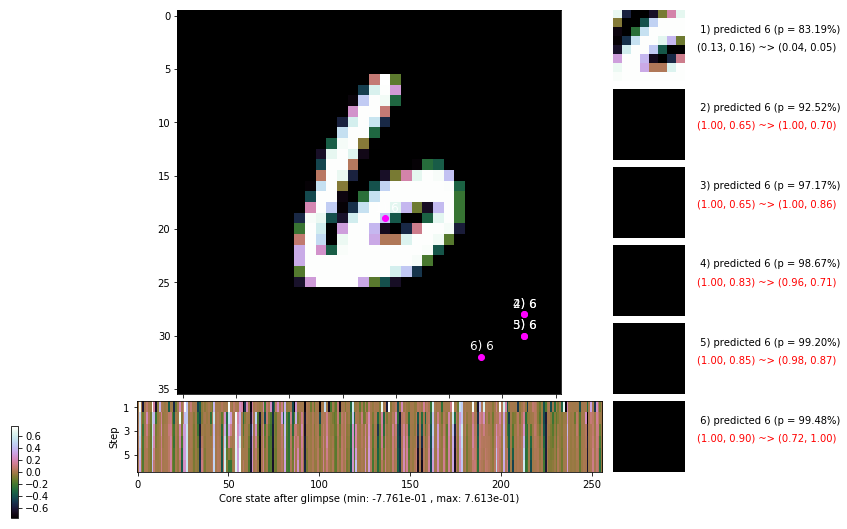

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.7 ms/b | lr: 4.22e-04 | grad 2norm: 13.41 | grad inf norm:  3.698
         Weights || abs max:  2.53 ( 2441.88) | mean: -7.46e-04 ( 0.01) | var: 7.85e-02 (  104.91)
          Biases || abs max:  1.43 (  536.65) | mean: -1.35e-01 ( 0.27) | var: 9.53e-02 (10665.11)
                    class loss: 0.357 | steps: 2.235 | reward:  3.673 | acc.: 87.98%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 143.1 ms/b | lr: 4.22e-04 | grad 2norm: 13.33 | grad inf norm:  3.885
         Weights || abs max:  2.53 ( 2422.11) | mean: -7.49e-04 ( 0.01) | var: 7.86e-02 (  196.72)
          Biases || abs max:  1.42 (  131.75) | mean: -1.35e-01 ( 0.11) | var: 9.54e-02 (  137.85)
                    class loss: 0.336 | steps: 2.222 | reward:  3.714 | acc.: 88.60%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

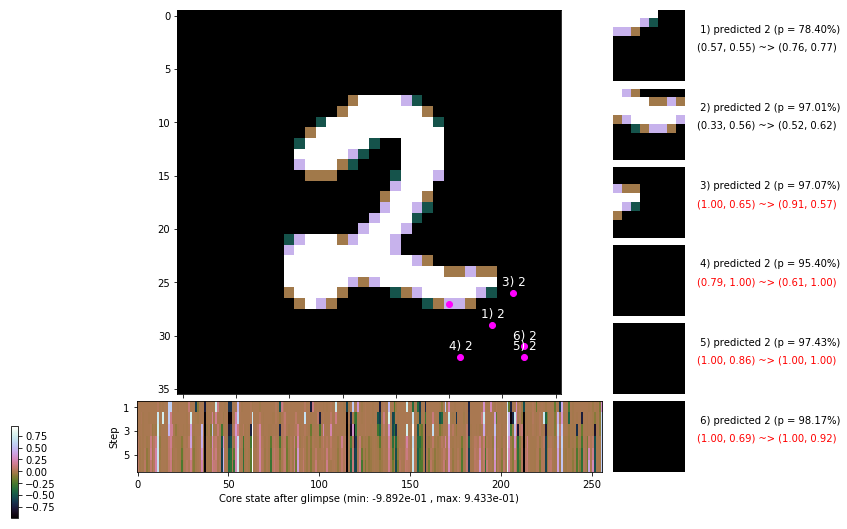

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 164.4 ms/b | lr: 4.21e-04 | grad 2norm: 13.56 | grad inf norm:  3.985
         Weights || abs max:  2.55 ( 2808.98) | mean: -7.51e-04 ( 0.01) | var: 7.86e-02 (  898.33)
          Biases || abs max:  1.43 (  184.99) | mean: -1.35e-01 ( 0.14) | var: 9.53e-02 (  392.49)
                    class loss: 0.340 | steps: 2.247 | reward:  3.695 | acc.: 88.62%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.6 ms/b | lr: 4.20e-04 | grad 2norm: 13.50 | grad inf norm:  3.839
         Weights || abs max:  2.54 ( 1206.33) | mean: -7.69e-04 ( 0.01) | var: 7.87e-02 (   19.43)
          Biases || abs max:  1.43 (  126.56) | mean: -1.36e-01 ( 0.11) | var: 9.53e-02 (   52.59)
                    class loss: 0.345 | steps: 2.253 | reward:  3.686 | acc.: 88.47%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

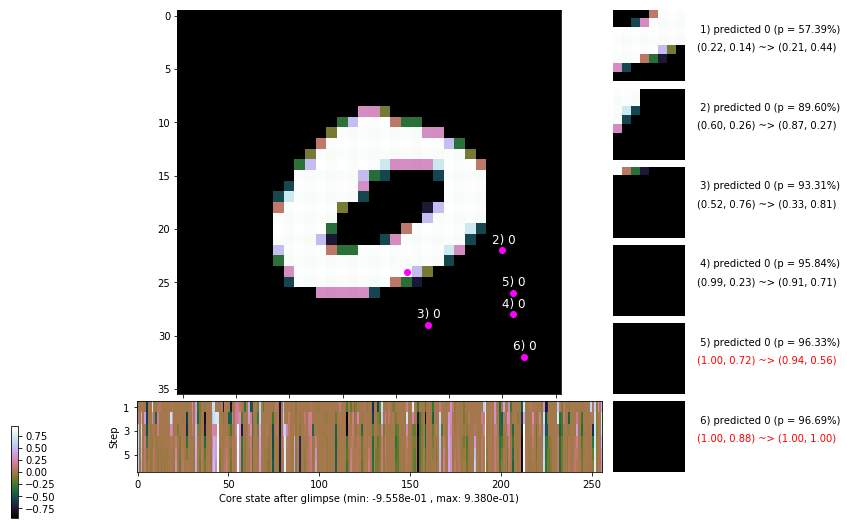

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 146.4 ms/b | lr: 4.20e-04 | grad 2norm: 13.76 | grad inf norm:  4.111
         Weights || abs max:  2.54 ( 2897.56) | mean: -7.74e-04 ( 0.01) | var: 7.87e-02 (  194.40)
          Biases || abs max:  1.42 (  153.95) | mean: -1.35e-01 ( 0.12) | var: 9.51e-02 (   69.70)
                    class loss: 0.342 | steps: 2.215 | reward:  3.716 | acc.: 88.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.5 ms/b | lr: 4.19e-04 | grad 2norm: 13.20 | grad inf norm:  3.769
         Weights || abs max:  2.54 ( 2209.92) | mean: -7.65e-04 ( 0.01) | var: 7.87e-02 (  137.58)
          Biases || abs max:  1.43 (  148.36) | mean: -1.35e-01 ( 0.11) | var: 9.51e-02 (  476.78)
                    class loss: 0.328 | steps: 2.188 | reward:  3.783 | acc.: 89.58%

	Target class: 8 | Discounted rewards: [0.281, 1.562, 1.1

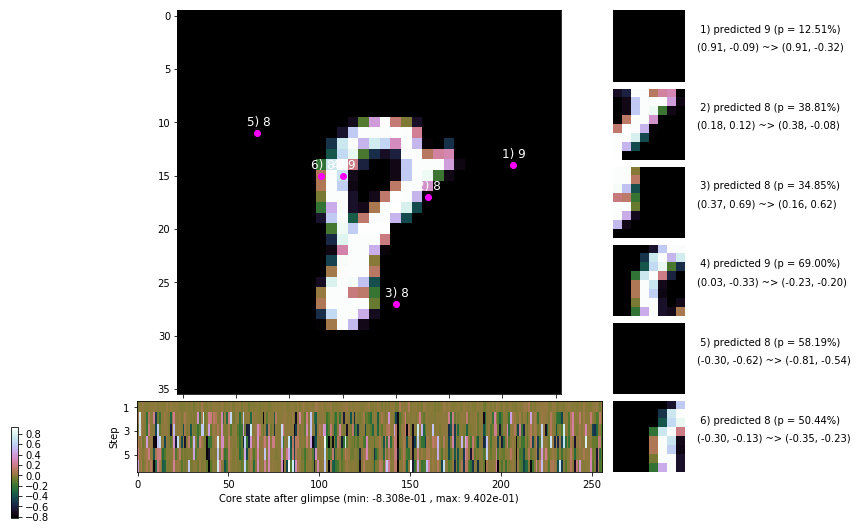

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


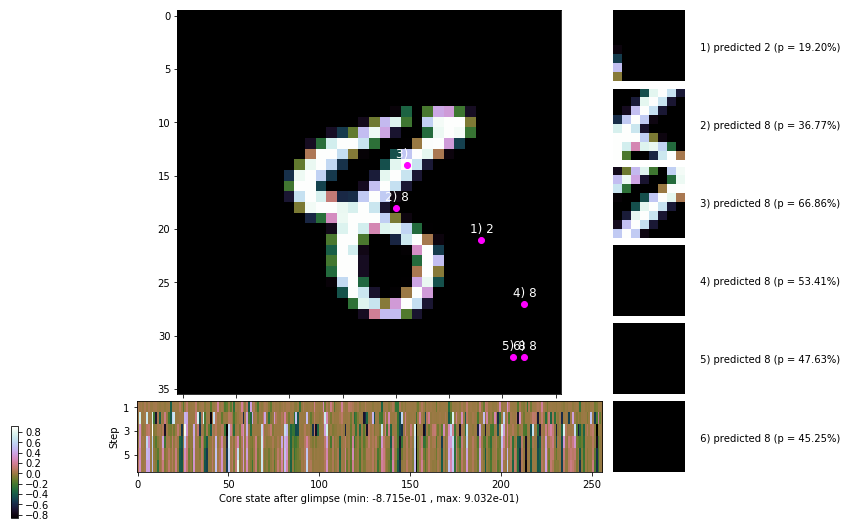


	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


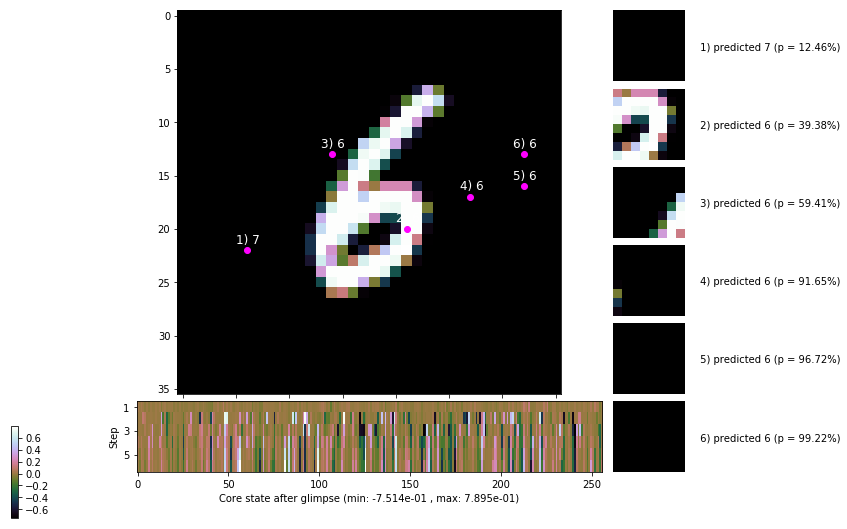

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


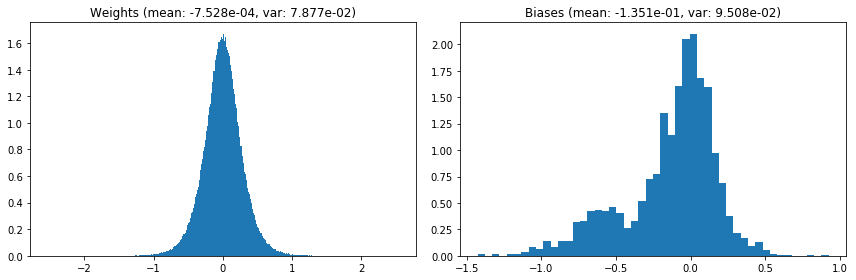

                                      Location network weights and biases


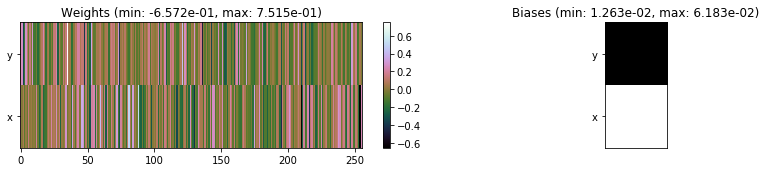

---------------------------------------------------------------------------------------------------------------
Elapsed time:  443.79 sec | TRAIN >> class loss: 0.3392 | steps:  2.222 :( | reward:  3.7176    | acc.: 88.610% :(
                          | VAL   >> class loss: 0.3236 | steps:  2.110    | reward:  3.9030 :( | acc.: 88.980% :(


Epoch  59/400) lr = 0.0004188
 b    300/  3000 >> 139.7 ms/b | lr: 4.18e-04 | grad 2norm: 13.43 | grad inf norm:  3.805
         Weights || abs max:  2.55 ( 4339.21) | mean: -7.76e-04 ( 0.02) | var: 7.88e-02 ( 1459.86)
          Biases || abs max:  1.43 (  136.41) | mean: -1.35e-01 ( 0.12) | var: 9.52e-02 (  185.64)
                    class loss: 0.339 | steps: 2.239 | reward:  3.679 | acc.: 88.37%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.7 ms/b | lr: 4.18e-04 | grad 2norm: 13.20 | grad inf norm:  3.697
         Weights || abs max:  2.55 ( 1839.34) | mean: -8.13e-04 (

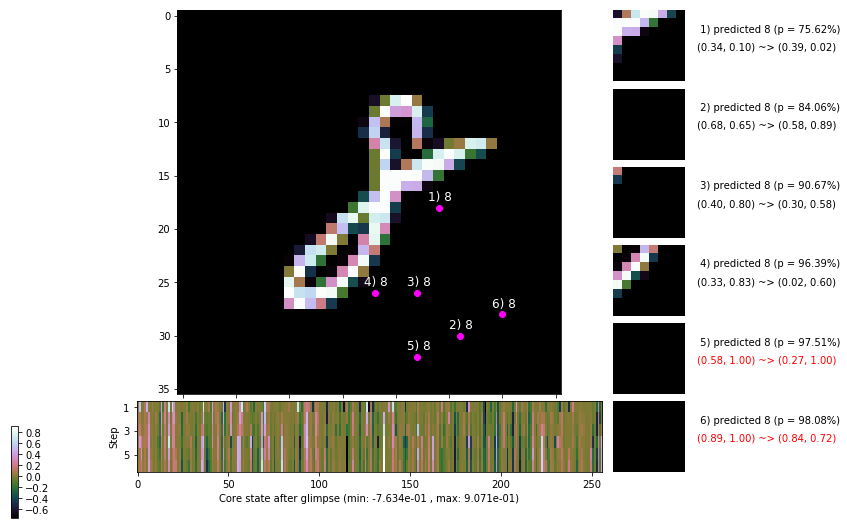

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.9 ms/b | lr: 4.17e-04 | grad 2norm: 13.18 | grad inf norm:  3.754
         Weights || abs max:  2.55 ( 8834.55) | mean: -8.00e-04 ( 0.02) | var: 7.89e-02 (10916.74)
          Biases || abs max:  1.43 (  498.24) | mean: -1.36e-01 ( 0.28) | var: 9.54e-02 ( 1804.25)
                    class loss: 0.357 | steps: 2.209 | reward:  3.734 | acc.: 88.60%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 148.8 ms/b | lr: 4.17e-04 | grad 2norm: 13.17 | grad inf norm:  3.715
         Weights || abs max:  2.55 ( 3234.21) | mean: -7.94e-04 ( 0.01) | var: 7.89e-02 (  352.11)
          Biases || abs max:  1.43 (  578.44) | mean: -1.36e-01 ( 0.30) | var: 9.53e-02 ( 1035.04)
                    class loss: 0.328 | steps: 2.207 | reward:  3.762 | acc.: 89.08%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

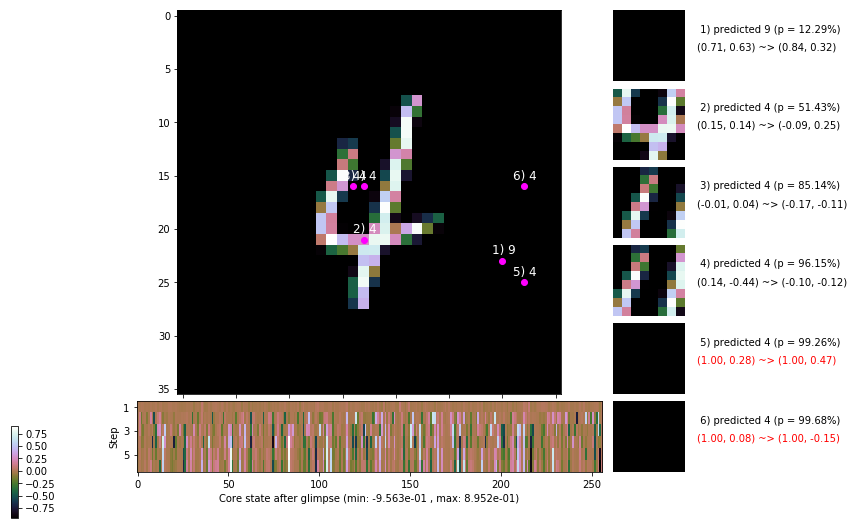

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 153.7 ms/b | lr: 4.16e-04 | grad 2norm: 13.23 | grad inf norm:  3.835
         Weights || abs max:  2.56 ( 2434.76) | mean: -7.79e-04 ( 0.01) | var: 7.89e-02 (  159.74)
          Biases || abs max:  1.43 (  238.18) | mean: -1.36e-01 ( 0.16) | var: 9.55e-02 (  192.53)
                    class loss: 0.333 | steps: 2.190 | reward:  3.765 | acc.: 89.15%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 135.9 ms/b | lr: 4.15e-04 | grad 2norm: 13.06 | grad inf norm:  3.666
         Weights || abs max:  2.56 (18464.82) | mean: -7.70e-04 ( 0.04) | var: 7.90e-02 (112135.00)
          Biases || abs max:  1.43 (  110.24) | mean: -1.36e-01 ( 0.10) | var: 9.56e-02 (   75.32)
                    class loss: 0.325 | steps: 2.206 | reward:  3.751 | acc.: 89.25%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.

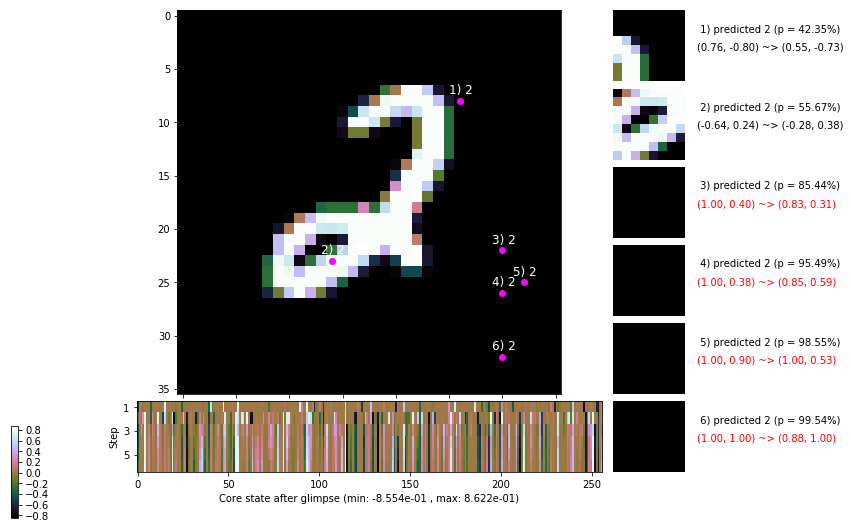

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 135.1 ms/b | lr: 4.15e-04 | grad 2norm: 13.58 | grad inf norm:  3.738
         Weights || abs max:  2.56 ( 2801.24) | mean: -7.67e-04 ( 0.01) | var: 7.90e-02 (  449.49)
          Biases || abs max:  1.43 (  122.50) | mean: -1.36e-01 ( 0.10) | var: 9.56e-02 (   61.04)
                    class loss: 0.362 | steps: 2.237 | reward:  3.673 | acc.: 87.60%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 146.2 ms/b | lr: 4.14e-04 | grad 2norm: 13.25 | grad inf norm:  3.794
         Weights || abs max:  2.58 ( 5221.29) | mean: -7.53e-04 ( 0.02) | var: 7.90e-02 ( 6135.74)
          Biases || abs max:  1.43 (  712.84) | mean: -1.36e-01 ( 0.33) | var: 9.55e-02 ( 1710.31)
                    class loss: 0.341 | steps: 2.221 | reward:  3.691 | acc.: 88.37%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

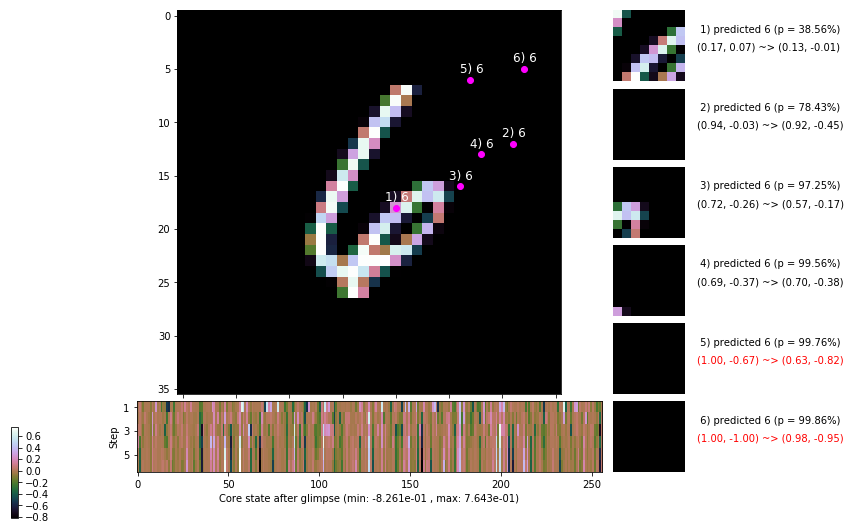

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 146.8 ms/b | lr: 4.13e-04 | grad 2norm: 13.38 | grad inf norm:  3.957
         Weights || abs max:  2.58 ( 2270.86) | mean: -7.65e-04 ( 0.01) | var: 7.91e-02 (   87.73)
          Biases || abs max:  1.43 (  639.06) | mean: -1.36e-01 ( 0.33) | var: 9.56e-02 ( 2758.48)
                    class loss: 0.340 | steps: 2.218 | reward:  3.729 | acc.: 88.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 150.1 ms/b | lr: 4.13e-04 | grad 2norm: 13.43 | grad inf norm:  3.916
         Weights || abs max:  2.58 ( 1899.80) | mean: -7.50e-04 ( 0.01) | var: 7.91e-02 (   84.09)
          Biases || abs max:  1.44 (  325.68) | mean: -1.36e-01 ( 0.20) | var: 9.56e-02 (  308.89)
                    class loss: 0.341 | steps: 2.253 | reward:  3.686 | acc.: 88.55%

	Target class: 8 | Discounted rewards: [-0.844, -0.688, -

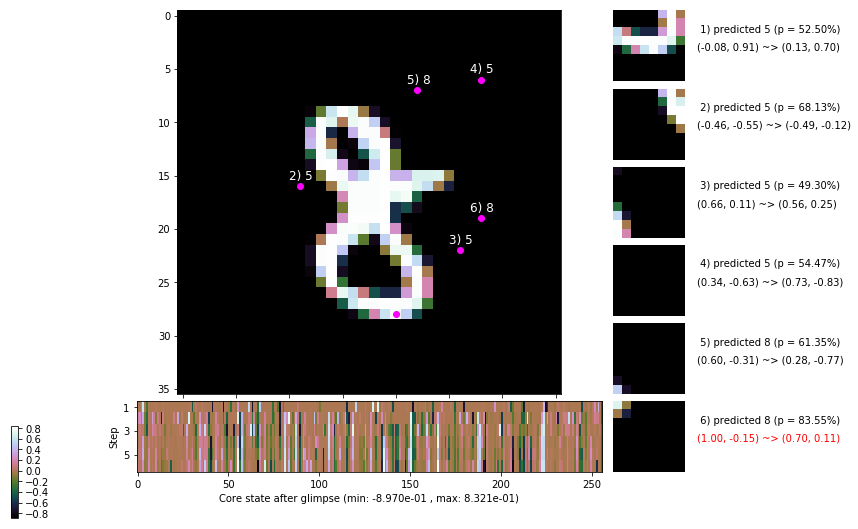

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


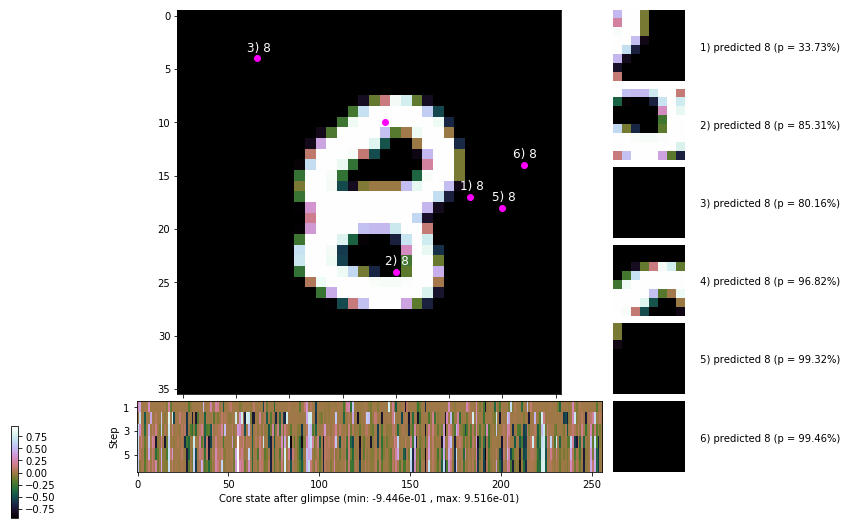


	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


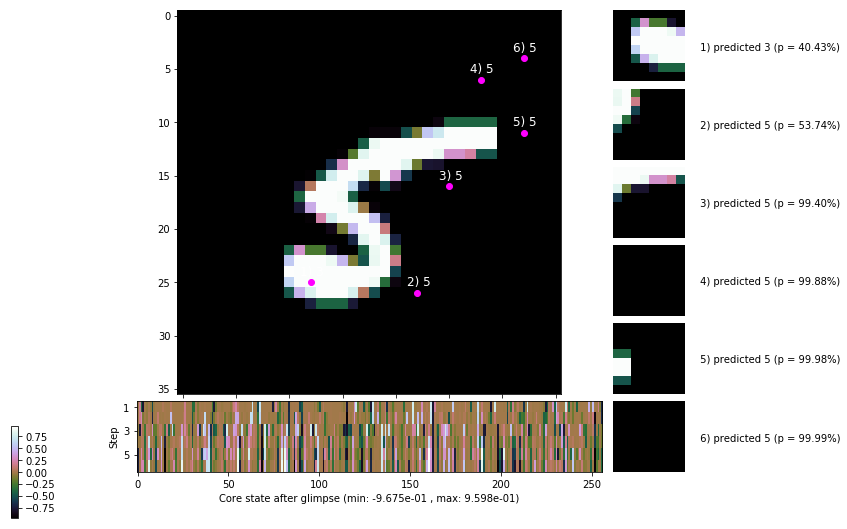

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


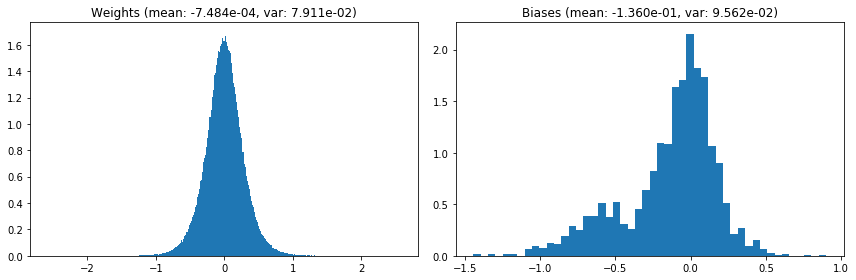

                                      Location network weights and biases


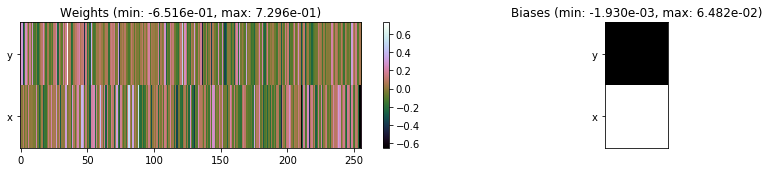

---------------------------------------------------------------------------------------------------------------
Elapsed time:  433.84 sec | TRAIN >> class loss: 0.3411 | steps:  2.222 :( | reward:  3.7186    | acc.: 88.630% :(
                          | VAL   >> class loss: 0.3302 | steps:  2.145 :( | reward:  3.8739 :( | acc.: 88.920% :(


Epoch  60/400) lr = 0.0004125
 b    300/  3000 >> 143.4 ms/b | lr: 4.12e-04 | grad 2norm: 13.41 | grad inf norm:  3.939
         Weights || abs max:  2.58 ( 2714.18) | mean: -7.46e-04 ( 0.01) | var: 7.91e-02 (  132.09)
          Biases || abs max:  1.44 ( 2606.26) | mean: -1.36e-01 ( 1.08) | var: 9.56e-02 (110939.82)
                    class loss: 0.343 | steps: 2.238 | reward:  3.676 | acc.: 88.15%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 139.5 ms/b | lr: 4.12e-04 | grad 2norm: 13.58 | grad inf norm:  3.809
         Weights || abs max:  2.58 ( 3113.52) | mean: -7.19e-04 

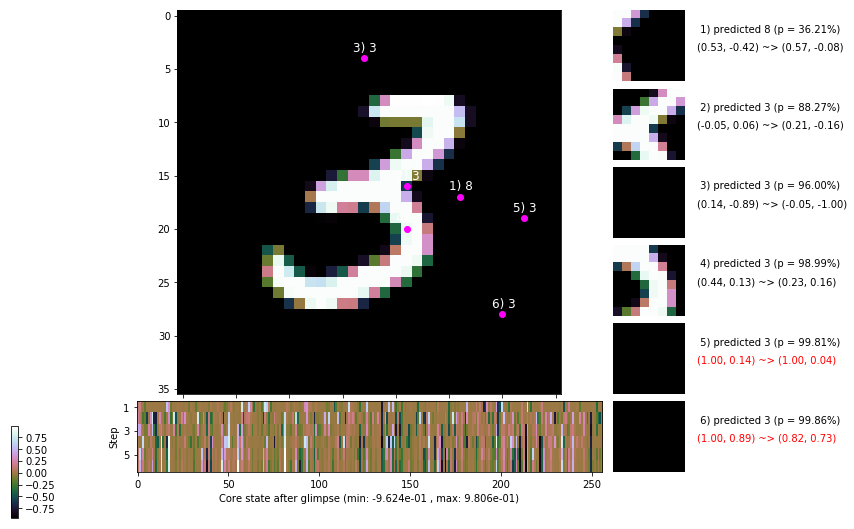

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 134.5 ms/b | lr: 4.11e-04 | grad 2norm: 13.66 | grad inf norm:  3.899
         Weights || abs max:  2.58 ( 3151.71) | mean: -7.03e-04 ( 0.01) | var: 7.92e-02 (  372.39)
          Biases || abs max:  1.44 (  950.91) | mean: -1.36e-01 ( 0.44) | var: 9.56e-02 ( 4855.20)
                    class loss: 0.354 | steps: 2.272 | reward:  3.623 | acc.: 87.67%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 136.5 ms/b | lr: 4.10e-04 | grad 2norm: 13.32 | grad inf norm:  3.830
         Weights || abs max:  2.59 ( 2811.47) | mean: -7.18e-04 ( 0.01) | var: 7.92e-02 (  204.82)
          Biases || abs max:  1.44 (  957.27) | mean: -1.37e-01 ( 0.44) | var: 9.56e-02 ( 3923.73)
                    class loss: 0.339 | steps: 2.223 | reward:  3.735 | acc.: 88.62%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

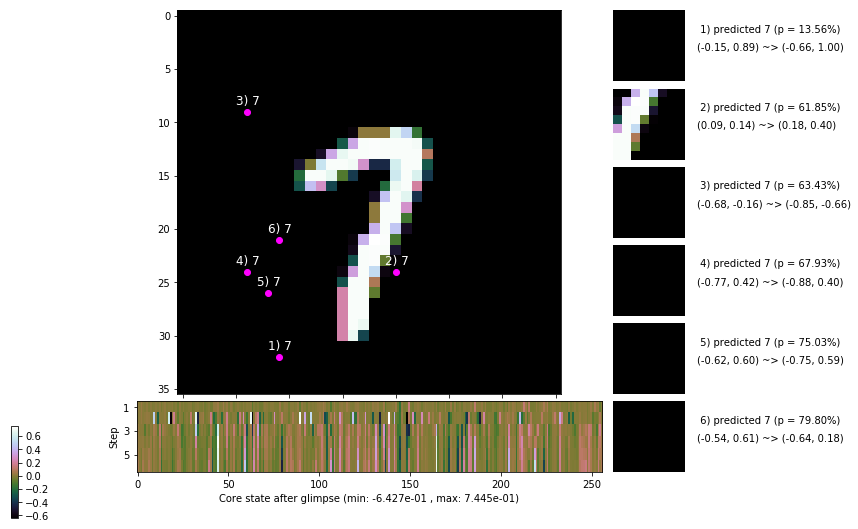

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 135.3 ms/b | lr: 4.10e-04 | grad 2norm: 13.12 | grad inf norm:  3.701
         Weights || abs max:  2.59 ( 1826.94) | mean: -7.18e-04 ( 0.01) | var: 7.93e-02 (   27.94)
          Biases || abs max:  1.44 (  473.08) | mean: -1.37e-01 ( 0.26) | var: 9.56e-02 ( 3127.85)
                    class loss: 0.334 | steps: 2.224 | reward:  3.713 | acc.: 88.83%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 132.5 ms/b | lr: 4.09e-04 | grad 2norm: 13.20 | grad inf norm:  3.964
         Weights || abs max:  2.58 (15022.02) | mean: -7.23e-04 ( 0.04) | var: 7.93e-02 (26183.06)
          Biases || abs max:  1.44 (  120.16) | mean: -1.36e-01 ( 0.12) | var: 9.55e-02 (   37.23)
                    class loss: 0.340 | steps: 2.224 | reward:  3.740 | acc.: 89.05%

	Target class: 5 | Discounted rewards: [1.219, 0.438, 1.8

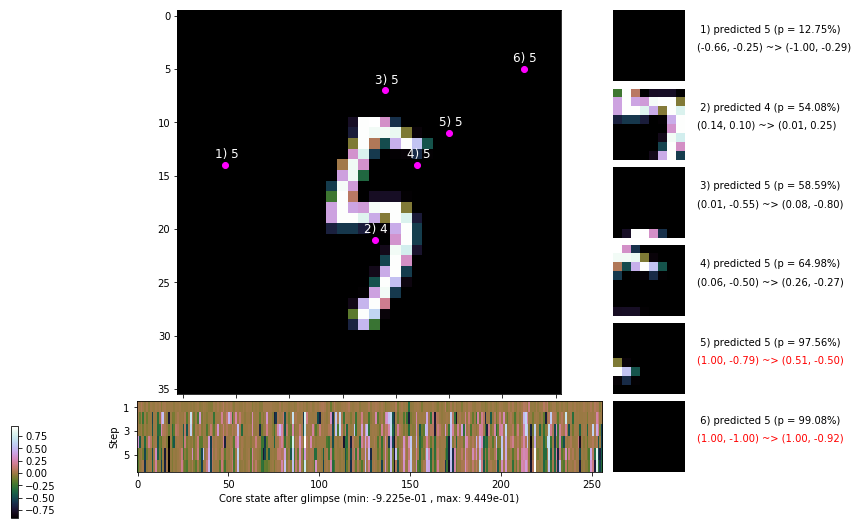

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 135.8 ms/b | lr: 4.08e-04 | grad 2norm: 13.15 | grad inf norm:  3.711
         Weights || abs max:  2.58 ( 3191.41) | mean: -7.61e-04 ( 0.01) | var: 7.93e-02 (  198.11)
          Biases || abs max:  1.44 (  276.14) | mean: -1.37e-01 ( 0.18) | var: 9.58e-02 (  768.37)
                    class loss: 0.329 | steps: 2.212 | reward:  3.734 | acc.: 89.08%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 134.4 ms/b | lr: 4.08e-04 | grad 2norm: 13.38 | grad inf norm:  3.826
         Weights || abs max:  2.57 (19579.31) | mean: -7.67e-04 ( 0.04) | var: 7.93e-02 (123111.59)
          Biases || abs max:  1.44 (  146.34) | mean: -1.37e-01 ( 0.12) | var: 9.58e-02 (   99.83)
                    class loss: 0.326 | steps: 2.217 | reward:  3.742 | acc.: 89.25%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.

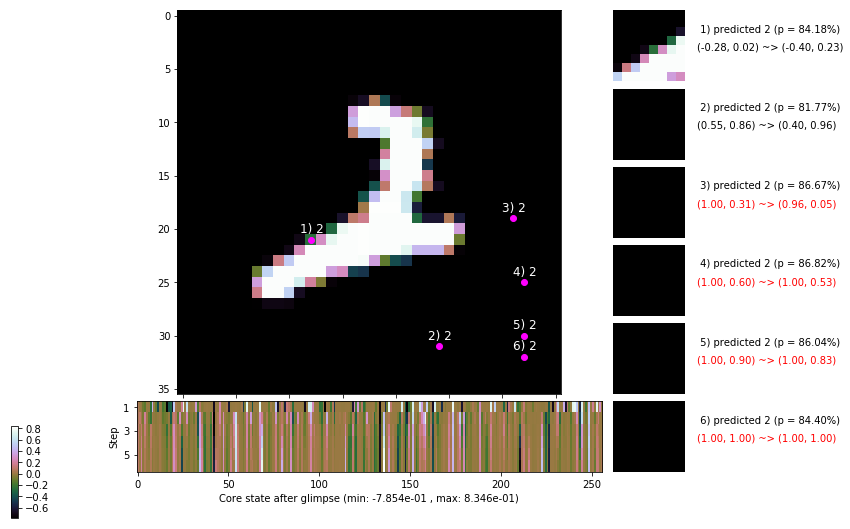

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 134.2 ms/b | lr: 4.07e-04 | grad 2norm: 13.36 | grad inf norm:  3.955
         Weights || abs max:  2.58 ( 2960.62) | mean: -7.68e-04 ( 0.01) | var: 7.94e-02 (  634.96)
          Biases || abs max:  1.43 (  120.30) | mean: -1.37e-01 ( 0.11) | var: 9.58e-02 (   77.51)
                    class loss: 0.348 | steps: 2.229 | reward:  3.721 | acc.: 88.43%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.4 ms/b | lr: 4.07e-04 | grad 2norm: 13.32 | grad inf norm:  3.863
         Weights || abs max:  2.60 ( 2532.61) | mean: -7.41e-04 ( 0.01) | var: 7.94e-02 (  166.66)
          Biases || abs max:  1.43 (  105.68) | mean: -1.37e-01 ( 0.09) | var: 9.58e-02 (   68.76)
                    class loss: 0.330 | steps: 2.232 | reward:  3.726 | acc.: 89.02%

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.8

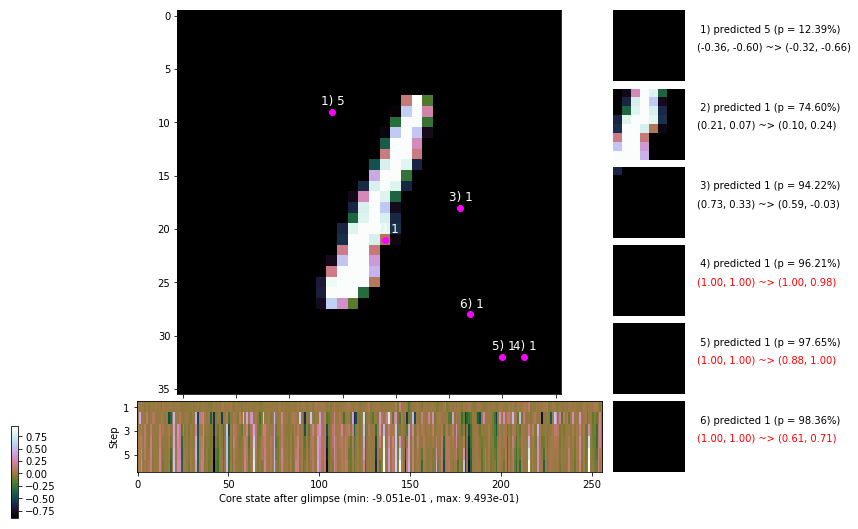

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


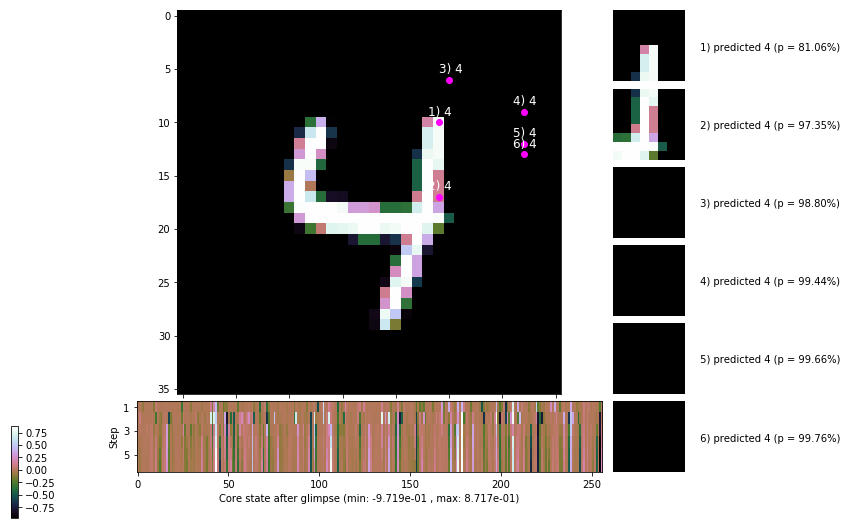


	Target class: 0 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


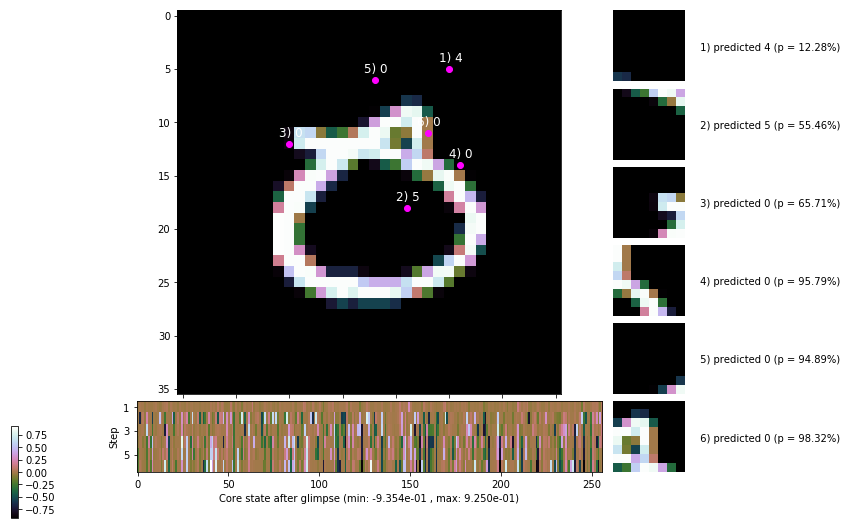

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


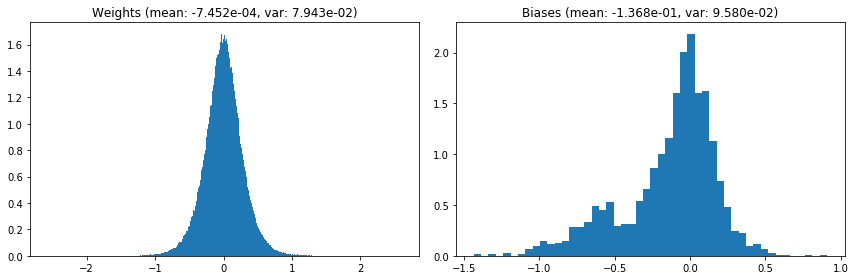

                                      Location network weights and biases


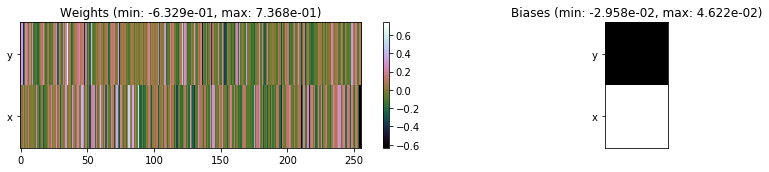

---------------------------------------------------------------------------------------------------------------
Elapsed time:  411.34 sec | TRAIN >> class loss: 0.3388 | steps:  2.233 :( | reward:  3.7088 :( | acc.: 88.675% :(
                          | VAL   >> class loss: 0.3067 | steps:  2.126 :( | reward:  3.9093 :( | acc.: 90.000% 


Epoch  61/400) lr = 0.0004064
 b    300/  3000 >> 142.5 ms/b | lr: 4.06e-04 | grad 2norm: 13.34 | grad inf norm:  3.850
         Weights || abs max:  2.59 ( 3140.17) | mean: -7.43e-04 ( 0.01) | var: 7.94e-02 (  443.58)
          Biases || abs max:  1.44 (   62.62) | mean: -1.37e-01 ( 0.08) | var: 9.58e-02 (   30.13)
                    class loss: 0.335 | steps: 2.203 | reward:  3.760 | acc.: 88.75%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 149.3 ms/b | lr: 4.06e-04 | grad 2norm: 13.41 | grad inf norm:  3.819
         Weights || abs max:  2.59 ( 3132.88) | mean: -7.53e-04 ( 0

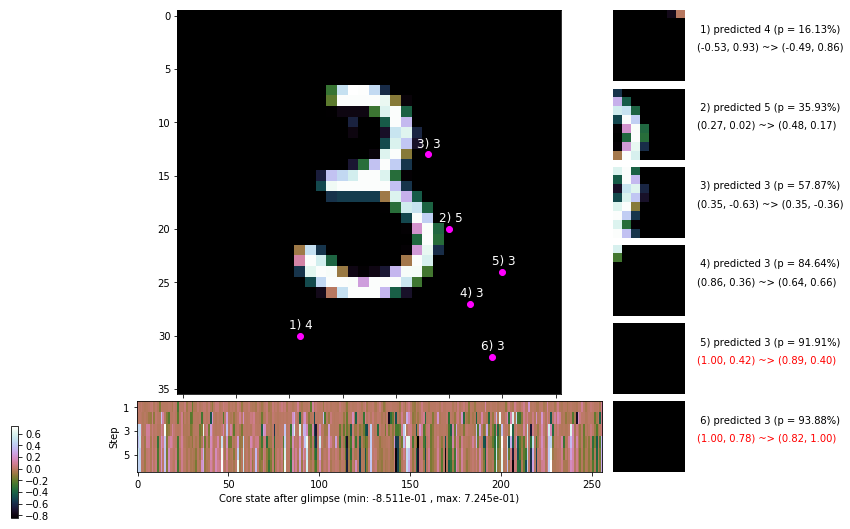

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 167.2 ms/b | lr: 4.05e-04 | grad 2norm: 13.78 | grad inf norm:  4.228
         Weights || abs max:  2.60 ( 1862.97) | mean: -7.69e-04 ( 0.01) | var: 7.95e-02 (   35.64)
          Biases || abs max:  1.43 (   92.91) | mean: -1.36e-01 ( 0.09) | var: 9.58e-02 (   65.08)
                    class loss: 0.348 | steps: 2.222 | reward:  3.711 | acc.: 88.07%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 150.3 ms/b | lr: 4.04e-04 | grad 2norm: 13.36 | grad inf norm:  3.994
         Weights || abs max:  2.61 ( 3523.94) | mean: -7.66e-04 ( 0.01) | var: 7.96e-02 (  752.16)
          Biases || abs max:  1.43 (   55.62) | mean: -1.36e-01 ( 0.07) | var: 9.59e-02 (   15.29)
                    class loss: 0.343 | steps: 2.237 | reward:  3.681 | acc.: 88.52%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

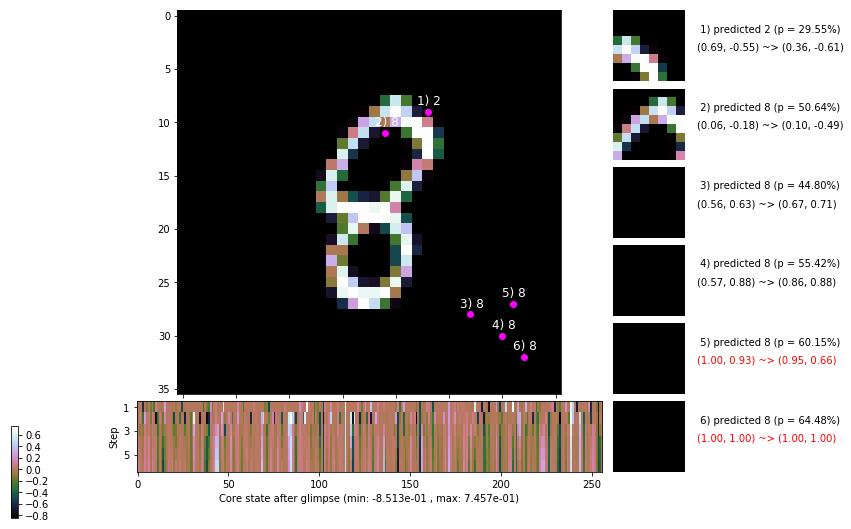

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 150.6 ms/b | lr: 4.04e-04 | grad 2norm: 13.32 | grad inf norm:  3.906
         Weights || abs max:  2.61 ( 2923.75) | mean: -7.70e-04 ( 0.01) | var: 7.96e-02 (  235.51)
          Biases || abs max:  1.44 (  102.77) | mean: -1.37e-01 ( 0.10) | var: 9.60e-02 (  155.43)
                    class loss: 0.333 | steps: 2.214 | reward:  3.738 | acc.: 88.85%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 146.1 ms/b | lr: 4.03e-04 | grad 2norm: 12.97 | grad inf norm:  3.655
         Weights || abs max:  2.62 ( 9165.62) | mean: -7.64e-04 ( 0.03) | var: 7.96e-02 ( 3269.73)
          Biases || abs max:  1.44 (   70.32) | mean: -1.36e-01 ( 0.08) | var: 9.59e-02 (   19.01)
                    class loss: 0.322 | steps: 2.215 | reward:  3.764 | acc.: 89.52%

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.8

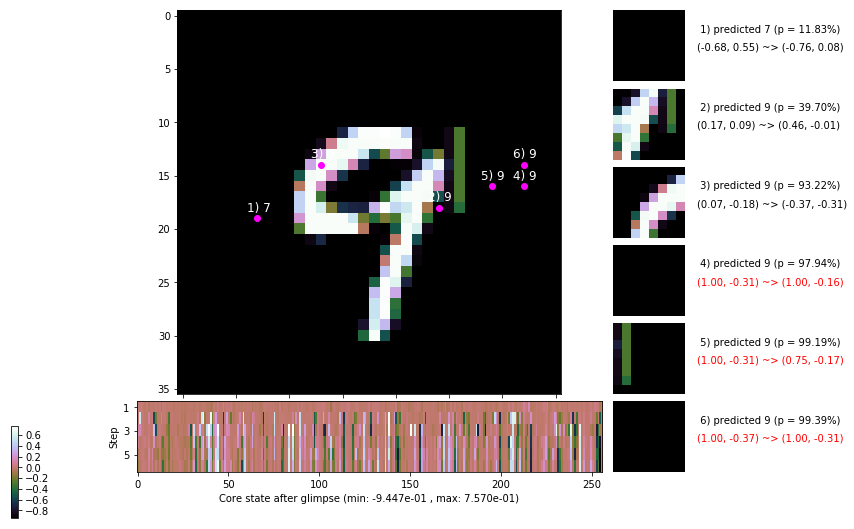

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 136.5 ms/b | lr: 4.02e-04 | grad 2norm: 13.79 | grad inf norm:  3.994
         Weights || abs max:  2.61 ( 6480.11) | mean: -7.58e-04 ( 0.02) | var: 7.97e-02 ( 4869.25)
          Biases || abs max:  1.43 (  199.21) | mean: -1.36e-01 ( 0.15) | var: 9.60e-02 (  305.71)
                    class loss: 0.355 | steps: 2.234 | reward:  3.675 | acc.: 87.97%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 135.6 ms/b | lr: 4.02e-04 | grad 2norm: 13.43 | grad inf norm:  3.827
         Weights || abs max:  2.61 ( 1785.49) | mean: -7.45e-04 ( 0.01) | var: 7.97e-02 (   30.32)
          Biases || abs max:  1.44 (  411.35) | mean: -1.37e-01 ( 0.21) | var: 9.59e-02 (13000.74)
                    class loss: 0.355 | steps: 2.253 | reward:  3.678 | acc.: 88.28%

	Target class: 2 | Discounted rewards: [0.047, 1.094, 0.1

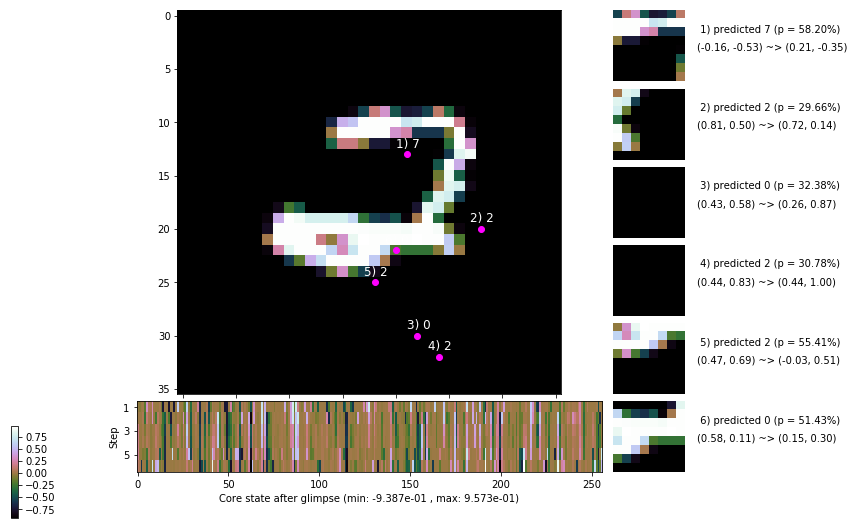

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 136.7 ms/b | lr: 4.01e-04 | grad 2norm: 13.54 | grad inf norm:  3.994
         Weights || abs max:  2.62 ( 4270.23) | mean: -7.39e-04 ( 0.02) | var: 7.97e-02 (  632.20)
          Biases || abs max:  1.45 (  171.37) | mean: -1.37e-01 ( 0.13) | var: 9.59e-02 (  329.08)
                    class loss: 0.343 | steps: 2.227 | reward:  3.711 | acc.: 88.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 134.9 ms/b | lr: 4.01e-04 | grad 2norm: 13.26 | grad inf norm:  3.693
         Weights || abs max:  2.61 ( 1676.65) | mean: -7.10e-04 ( 0.01) | var: 7.98e-02 (   86.83)
          Biases || abs max:  1.45 (   97.56) | mean: -1.37e-01 ( 0.09) | var: 9.60e-02 (   40.78)
                    class loss: 0.337 | steps: 2.227 | reward:  3.702 | acc.: 88.35%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

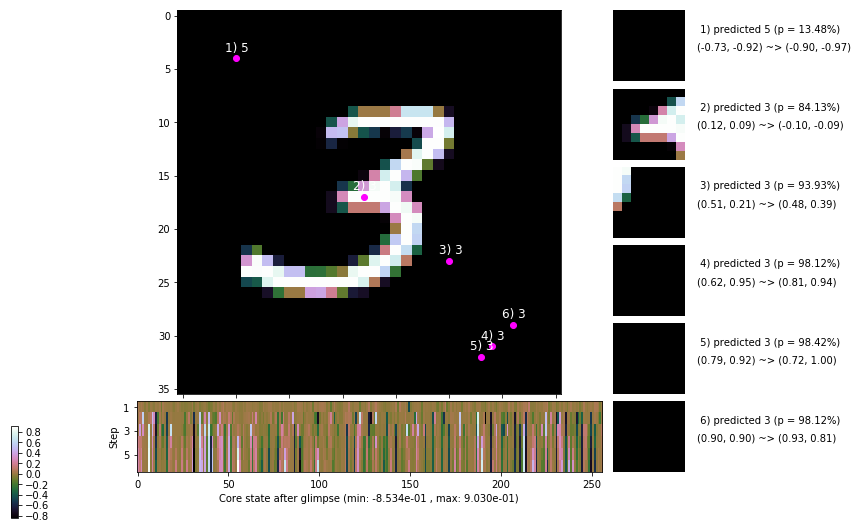

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [-0.609, -0.219, 0.562, -0.875, -0.750, -0.500]


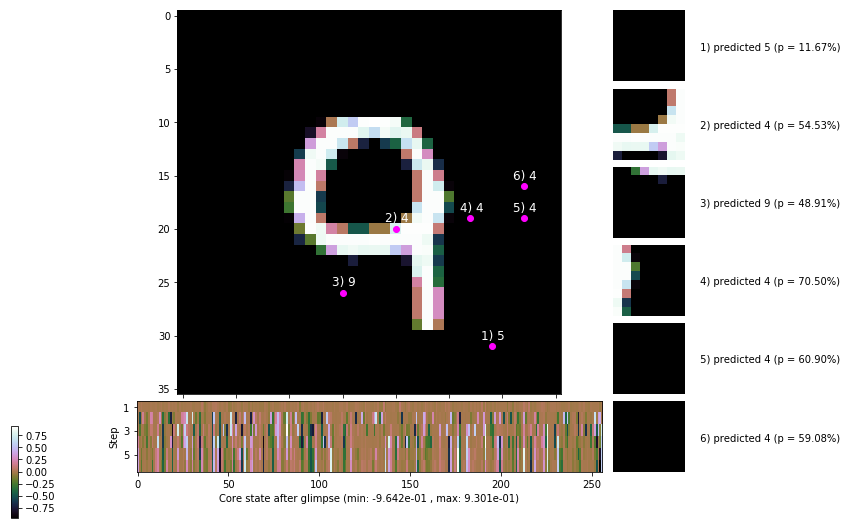


	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


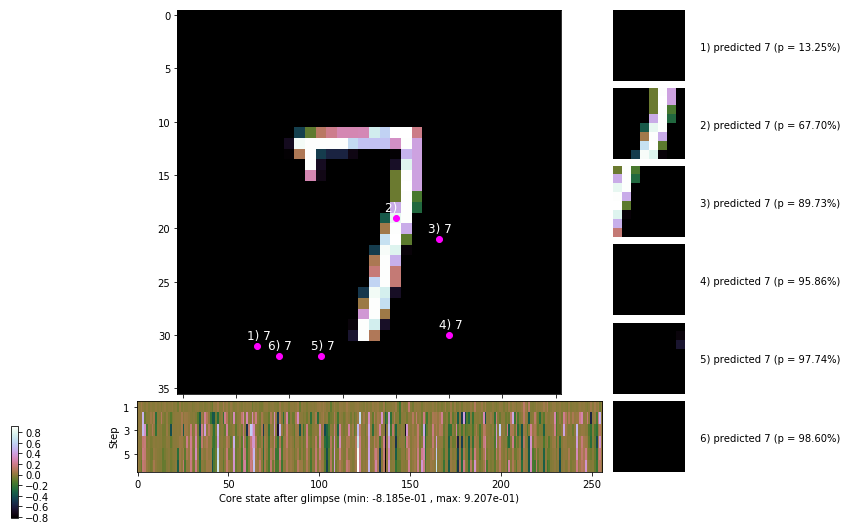

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


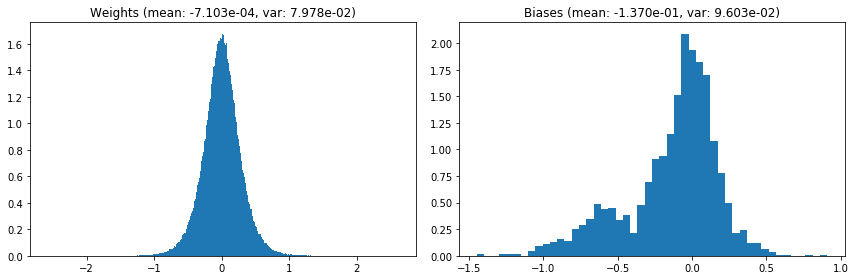

                                      Location network weights and biases


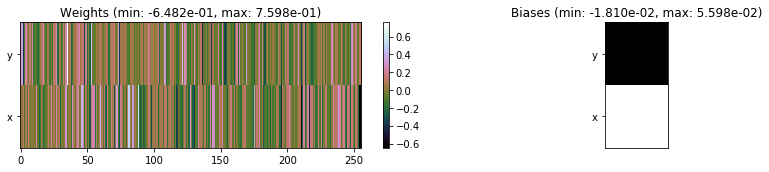

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.70 sec | TRAIN >> class loss: 0.3396 | steps:  2.224 :( | reward:  3.7151 :( | acc.: 88.565% :(
                          | VAL   >> class loss: 0.3108 | steps:  2.120 :( | reward:  3.8982 :( | acc.: 89.460% :(


Epoch  62/400) lr = 0.0004003
 b    300/  3000 >> 134.2 ms/b | lr: 4.00e-04 | grad 2norm: 13.27 | grad inf norm:  3.801
         Weights || abs max:  2.61 ( 1071.40) | mean: -6.96e-04 ( 0.01) | var: 7.98e-02 (   14.70)
          Biases || abs max:  1.45 (   43.89) | mean: -1.37e-01 ( 0.06) | var: 9.60e-02 (    6.99)
                    class loss: 0.328 | steps: 2.187 | reward:  3.773 | acc.: 89.20%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.7 ms/b | lr: 4.00e-04 | grad 2norm: 13.57 | grad inf norm:  3.931
         Weights || abs max:  2.61 ( 1063.22) | mean: -7.00e-04 (

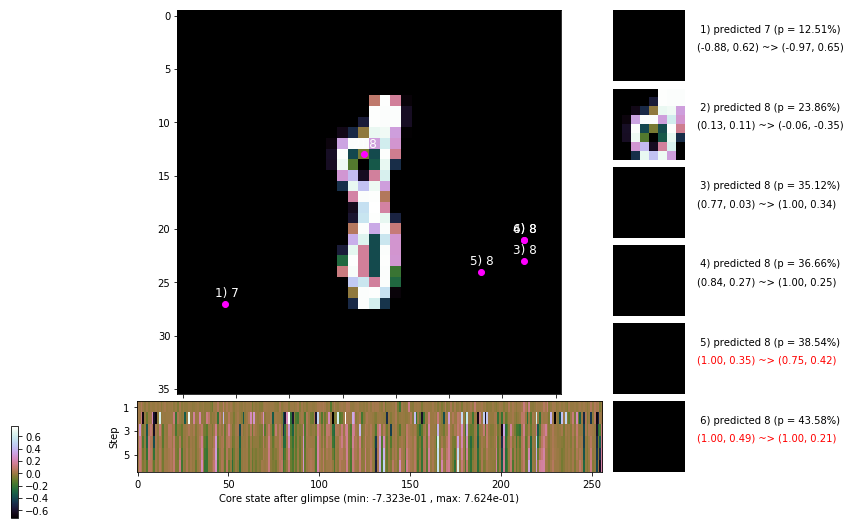

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 137.6 ms/b | lr: 3.99e-04 | grad 2norm: 13.23 | grad inf norm:  3.822
         Weights || abs max:  2.60 ( 2232.07) | mean: -6.89e-04 ( 0.01) | var: 7.98e-02 (  104.83)
          Biases || abs max:  1.45 (   69.08) | mean: -1.37e-01 ( 0.08) | var: 9.61e-02 (   21.99)
                    class loss: 0.349 | steps: 2.198 | reward:  3.735 | acc.: 88.80%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 136.1 ms/b | lr: 3.98e-04 | grad 2norm: 13.35 | grad inf norm:  3.917
         Weights || abs max:  2.59 ( 2647.29) | mean: -6.66e-04 ( 0.01) | var: 7.99e-02 (  318.81)
          Biases || abs max:  1.45 (  126.40) | mean: -1.37e-01 ( 0.10) | var: 9.60e-02 (  207.15)
                    class loss: 0.323 | steps: 2.213 | reward:  3.772 | acc.: 89.17%

	Target class: 8 | Discounted rewards: [-0.656, -0.312, 0

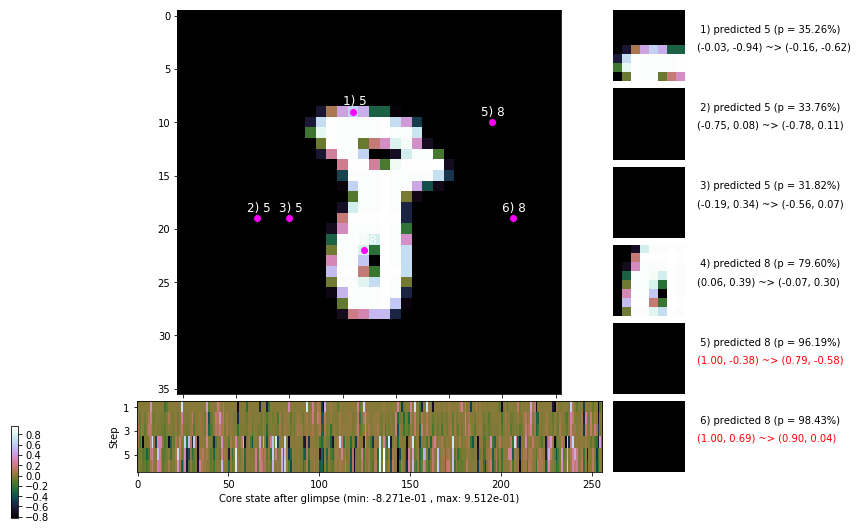

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 136.8 ms/b | lr: 3.98e-04 | grad 2norm: 13.43 | grad inf norm:  3.867
         Weights || abs max:  2.59 ( 2602.40) | mean: -6.67e-04 ( 0.01) | var: 7.99e-02 (   86.29)
          Biases || abs max:  1.45 ( 5888.79) | mean: -1.37e-01 ( 4.60) | var: 9.62e-02 (7890225.50)
                    class loss: 0.358 | steps: 2.250 | reward:  3.666 | acc.: 87.83%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 133.1 ms/b | lr: 3.97e-04 | grad 2norm: 12.76 | grad inf norm:  3.631
         Weights || abs max:  2.59 ( 1676.45) | mean: -6.48e-04 ( 0.01) | var: 7.99e-02 (   36.47)
          Biases || abs max:  1.45 (  162.80) | mean: -1.37e-01 ( 0.13) | var: 9.62e-02 (  418.32)
                    class loss: 0.323 | steps: 2.205 | reward:  3.770 | acc.: 89.52%

	Target class: 0 | Discounted rewards: [-0.281, 0.438, 

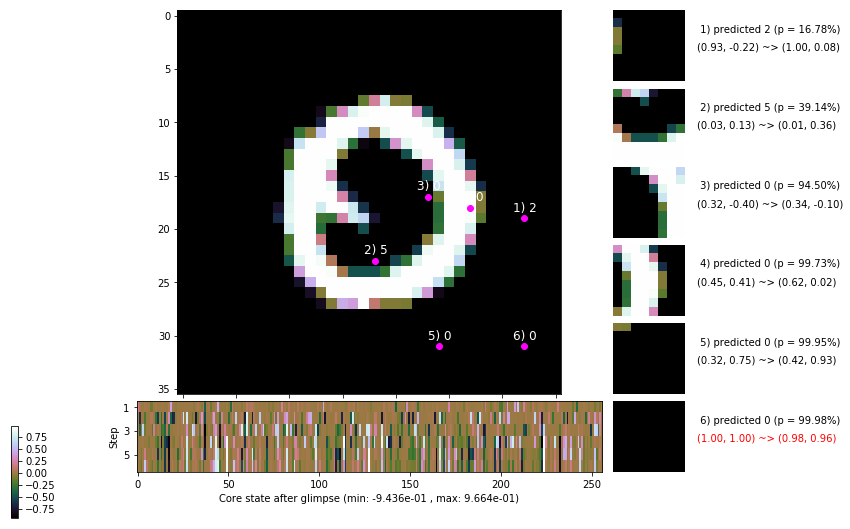

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 138.0 ms/b | lr: 3.96e-04 | grad 2norm: 13.22 | grad inf norm:  3.732
         Weights || abs max:  2.59 ( 3245.69) | mean: -6.42e-04 ( 0.01) | var: 8.00e-02 ( 1207.66)
          Biases || abs max:  1.45 (   46.25) | mean: -1.37e-01 ( 0.07) | var: 9.62e-02 (    7.87)
                    class loss: 0.322 | steps: 2.202 | reward:  3.761 | acc.: 89.25%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 130.9 ms/b | lr: 3.96e-04 | grad 2norm: 13.62 | grad inf norm:  3.852
         Weights || abs max:  2.59 ( 2442.70) | mean: -6.39e-04 ( 0.01) | var: 8.00e-02 (  182.79)
          Biases || abs max:  1.45 (  138.78) | mean: -1.37e-01 ( 0.11) | var: 9.61e-02 (  472.24)
                    class loss: 0.350 | steps: 2.257 | reward:  3.682 | acc.: 88.45%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

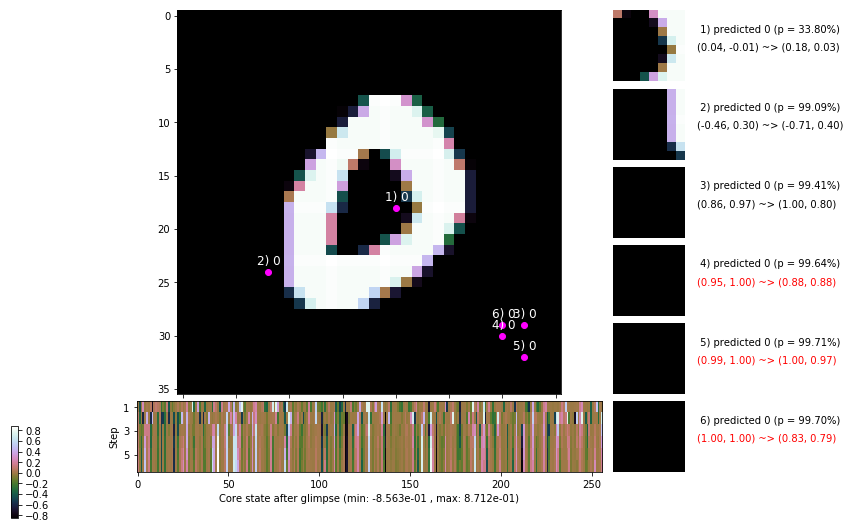

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 135.4 ms/b | lr: 3.95e-04 | grad 2norm: 12.91 | grad inf norm:  3.824
         Weights || abs max:  2.60 ( 2316.08) | mean: -6.52e-04 ( 0.01) | var: 8.00e-02 (  148.85)
          Biases || abs max:  1.45 (   80.99) | mean: -1.37e-01 ( 0.08) | var: 9.62e-02 (   67.42)
                    class loss: 0.320 | steps: 2.185 | reward:  3.792 | acc.: 89.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 131.0 ms/b | lr: 3.95e-04 | grad 2norm: 13.26 | grad inf norm:  3.962
         Weights || abs max:  2.60 ( 2396.99) | mean: -6.56e-04 ( 0.01) | var: 8.01e-02 (  155.64)
          Biases || abs max:  1.45 (   68.58) | mean: -1.36e-01 ( 0.08) | var: 9.61e-02 (   25.16)
                    class loss: 0.315 | steps: 2.211 | reward:  3.745 | acc.: 89.32%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

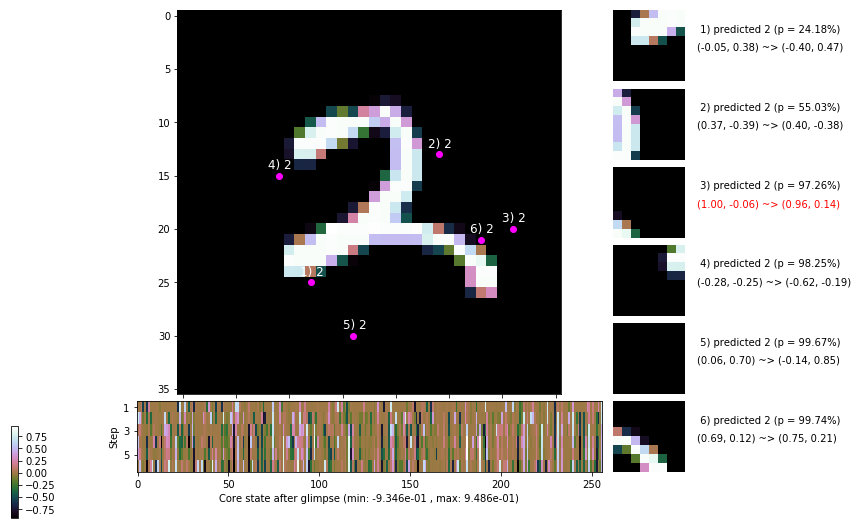

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


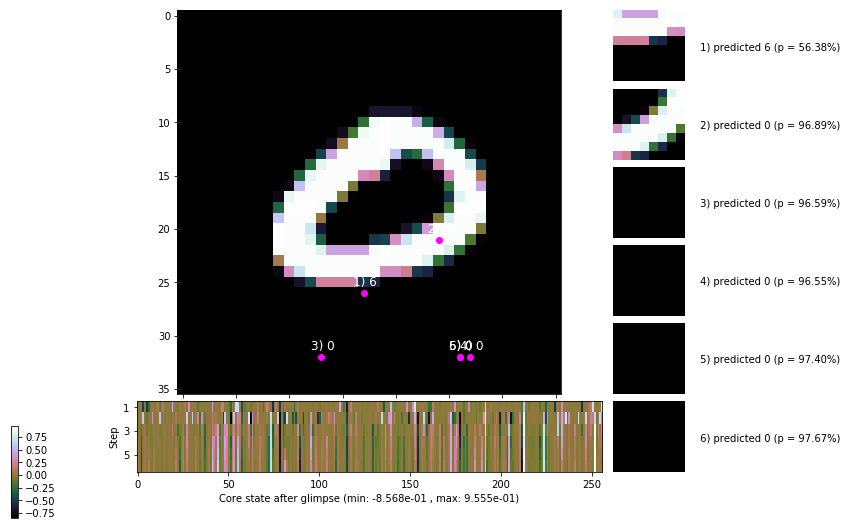


	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


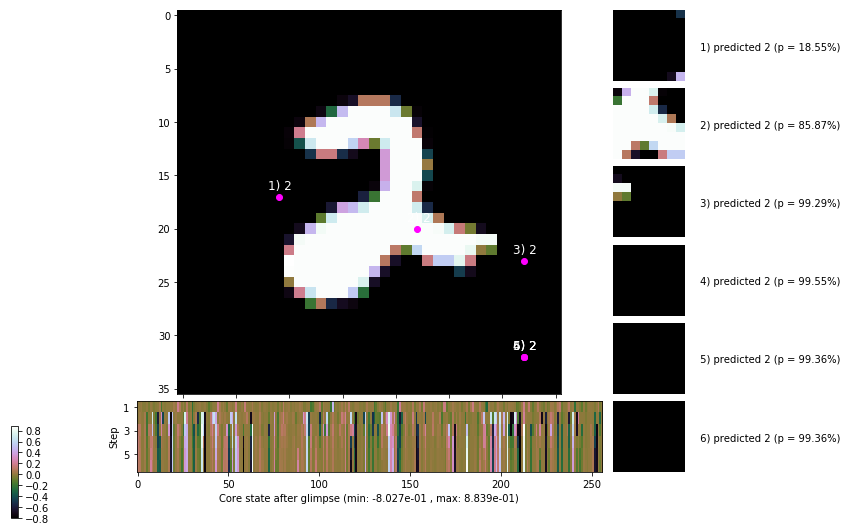

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


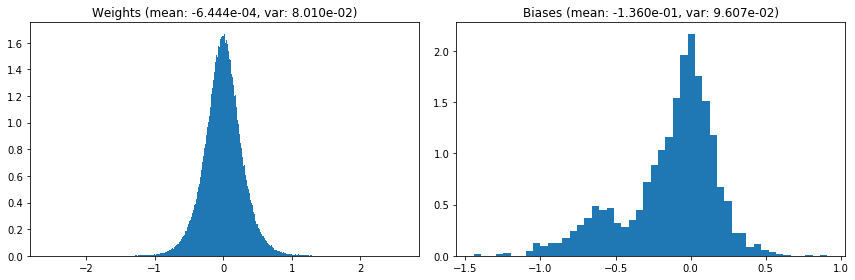

                                      Location network weights and biases


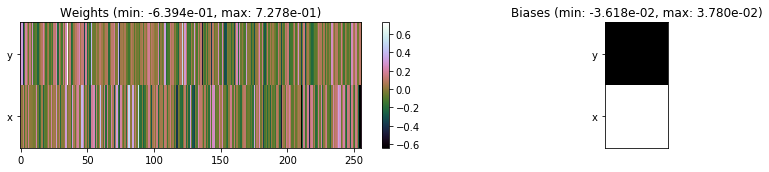

---------------------------------------------------------------------------------------------------------------
Elapsed time:  407.33 sec | TRAIN >> class loss: 0.3353 | steps:  2.218    | reward:  3.7342    | acc.: 88.913% 
                          | VAL   >> class loss: 0.3183 | steps:  2.110    | reward:  3.9360    | acc.: 89.340% :(


Epoch  63/400) lr = 0.0003944
 b    300/  3000 >> 131.9 ms/b | lr: 3.94e-04 | grad 2norm: 13.19 | grad inf norm:  3.762
         Weights || abs max:  2.60 ( 3100.96) | mean: -6.29e-04 ( 0.01) | var: 8.01e-02 (  217.67)
          Biases || abs max:  1.44 (   83.86) | mean: -1.36e-01 ( 0.09) | var: 9.61e-02 (  188.71)
                    class loss: 0.324 | steps: 2.241 | reward:  3.717 | acc.: 88.93%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.5 ms/b | lr: 3.94e-04 | grad 2norm: 13.40 | grad inf norm:  3.725
         Weights || abs max:  2.61 ( 2048.20) | mean: -6.27e-04 ( 0

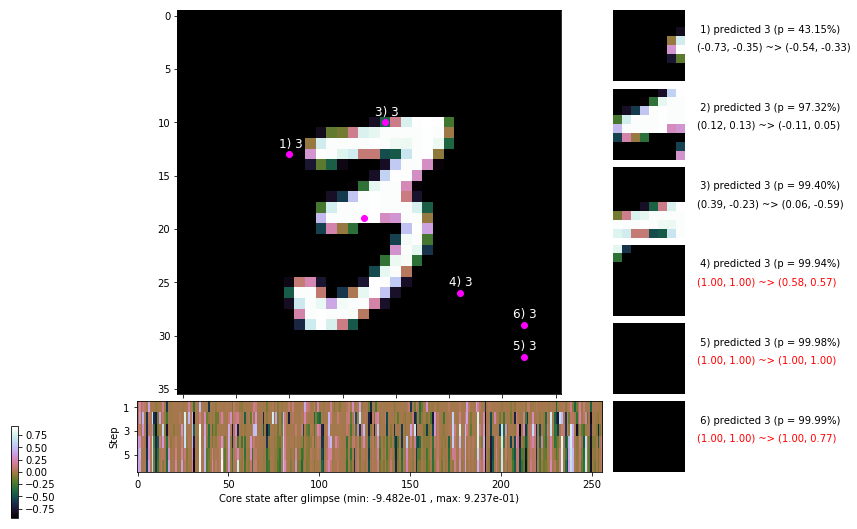

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 158.0 ms/b | lr: 3.93e-04 | grad 2norm: 13.45 | grad inf norm:  3.985
         Weights || abs max:  2.61 ( 3389.97) | mean: -6.41e-04 ( 0.01) | var: 8.02e-02 (  774.66)
          Biases || abs max:  1.44 (   61.80) | mean: -1.36e-01 ( 0.08) | var: 9.64e-02 (   19.80)
                    class loss: 0.335 | steps: 2.215 | reward:  3.727 | acc.: 88.68%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 137.7 ms/b | lr: 3.92e-04 | grad 2norm: 13.56 | grad inf norm:  3.890
         Weights || abs max:  2.61 (114114.63) | mean: -6.49e-04 ( 0.22) | var: 8.02e-02 (6417951.50)
          Biases || abs max:  1.44 (  120.68) | mean: -1.36e-01 ( 0.10) | var: 9.64e-02 (  265.70)
                    class loss: 0.342 | steps: 2.236 | reward:  3.693 | acc.: 88.40%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 

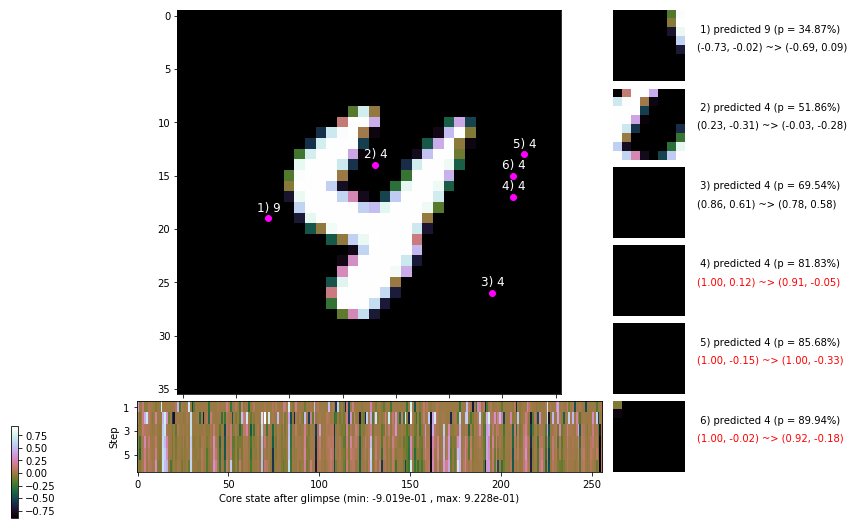

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 135.9 ms/b | lr: 3.92e-04 | grad 2norm: 13.25 | grad inf norm:  3.673
         Weights || abs max:  2.60 ( 2813.01) | mean: -6.58e-04 ( 0.01) | var: 8.02e-02 (  372.26)
          Biases || abs max:  1.44 (   26.25) | mean: -1.36e-01 ( 0.05) | var: 9.65e-02 (    2.18)
                    class loss: 0.315 | steps: 2.228 | reward:  3.744 | acc.: 89.32%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.0 ms/b | lr: 3.91e-04 | grad 2norm: 12.96 | grad inf norm:  3.592
         Weights || abs max:  2.61 (15478.26) | mean: -6.52e-04 ( 0.04) | var: 8.03e-02 (93958.41)
          Biases || abs max:  1.44 (  182.36) | mean: -1.36e-01 ( 0.11) | var: 9.66e-02 ( 2255.87)
                    class loss: 0.315 | steps: 2.151 | reward:  3.862 | acc.: 89.97%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

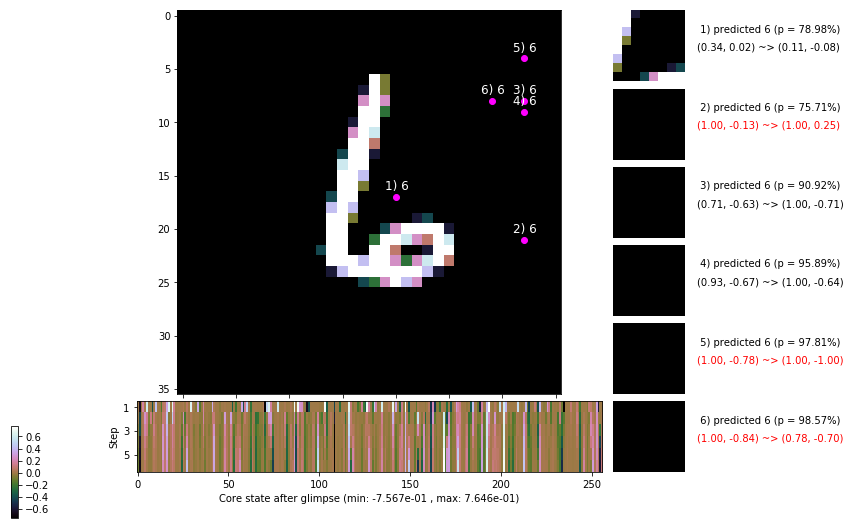

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.3 ms/b | lr: 3.90e-04 | grad 2norm: 13.23 | grad inf norm:  3.748
         Weights || abs max:  2.60 ( 4436.96) | mean: -6.43e-04 ( 0.02) | var: 8.03e-02 (  773.87)
          Biases || abs max:  1.44 (  142.31) | mean: -1.36e-01 ( 0.13) | var: 9.65e-02 ( 1987.10)
                    class loss: 0.330 | steps: 2.223 | reward:  3.731 | acc.: 89.23%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 149.9 ms/b | lr: 3.90e-04 | grad 2norm: 13.38 | grad inf norm:  3.880
         Weights || abs max:  2.61 ( 2344.28) | mean: -6.42e-04 ( 0.01) | var: 8.03e-02 (   96.54)
          Biases || abs max:  1.44 (   37.43) | mean: -1.36e-01 ( 0.06) | var: 9.67e-02 (    8.72)
                    class loss: 0.353 | steps: 2.240 | reward:  3.698 | acc.: 88.30%

	Target class: 8 | Discounted rewards: [-0.281, 0.438, 1.

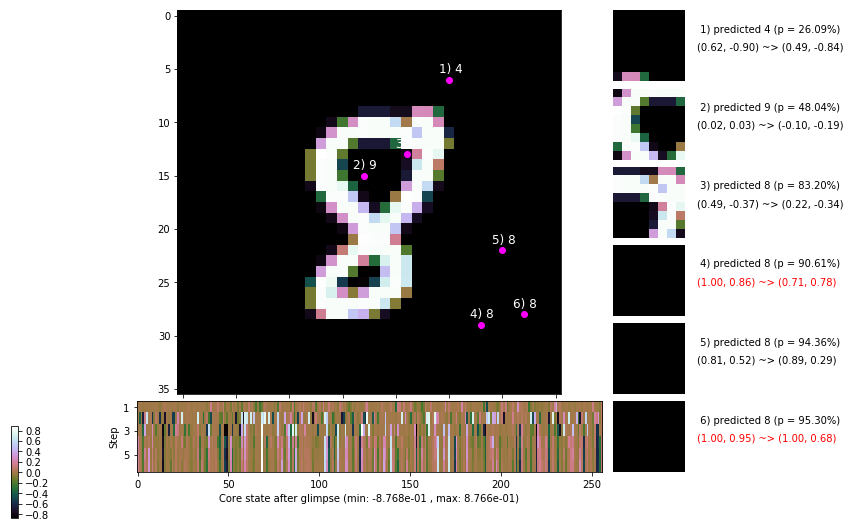

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 133.2 ms/b | lr: 3.89e-04 | grad 2norm: 13.09 | grad inf norm:  3.845
         Weights || abs max:  2.61 ( 3607.53) | mean: -6.52e-04 ( 0.01) | var: 8.04e-02 ( 1478.42)
          Biases || abs max:  1.44 (   58.63) | mean: -1.36e-01 ( 0.08) | var: 9.67e-02 (   65.02)
                    class loss: 0.337 | steps: 2.245 | reward:  3.703 | acc.: 89.10%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 134.2 ms/b | lr: 3.89e-04 | grad 2norm: 13.13 | grad inf norm:  3.783
         Weights || abs max:  2.61 ( 3224.83) | mean: -6.35e-04 ( 0.01) | var: 8.04e-02 (  243.35)
          Biases || abs max:  1.44 (   32.15) | mean: -1.36e-01 ( 0.05) | var: 9.67e-02 (    6.12)
                    class loss: 0.333 | steps: 2.234 | reward:  3.736 | acc.: 89.15%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

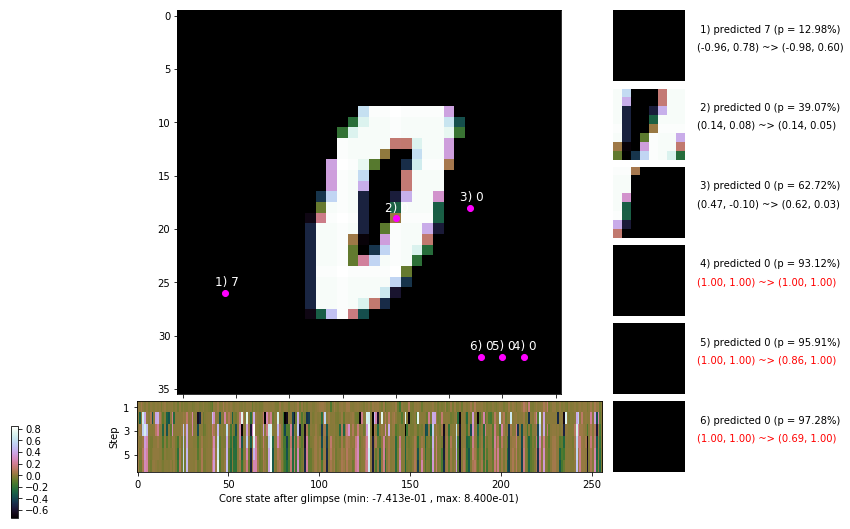

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


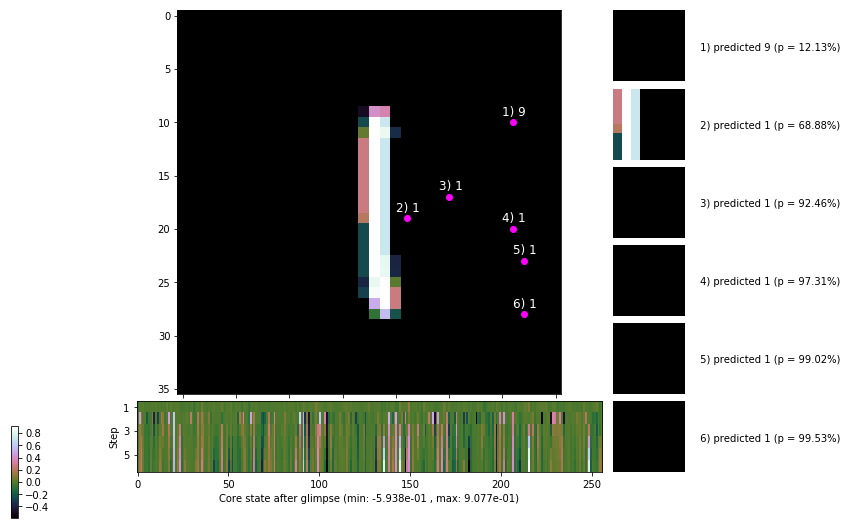


	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


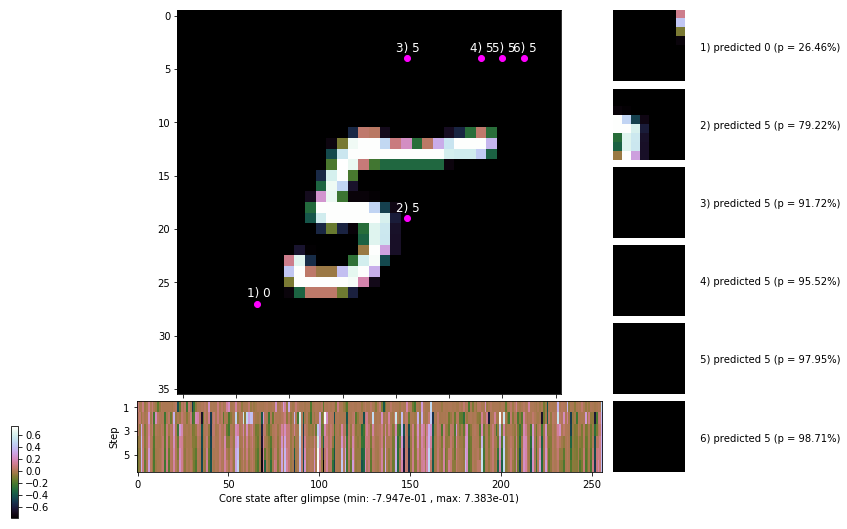

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


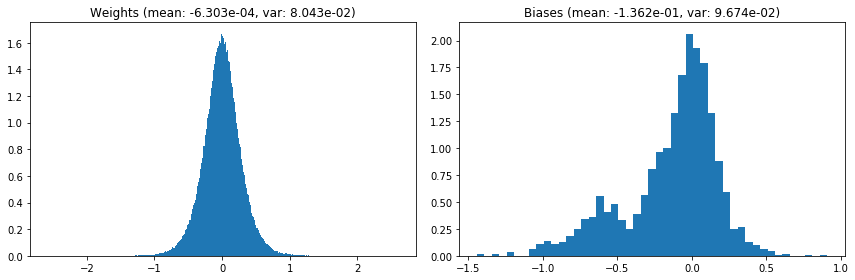

                                      Location network weights and biases


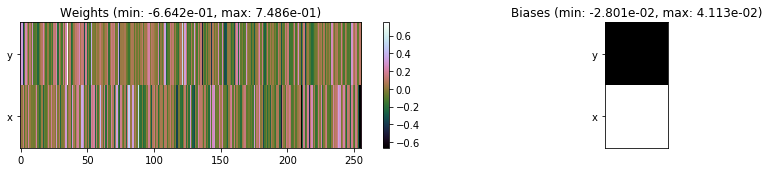

---------------------------------------------------------------------------------------------------------------
Elapsed time:  425.52 sec | TRAIN >> class loss: 0.3326 | steps:  2.224 :( | reward:  3.7323 :( | acc.: 88.965% 
                          | VAL   >> class loss: 0.3002 | steps:  2.129 :( | reward:  3.9282 :( | acc.: 89.800% :(


Epoch  64/400) lr = 0.0003885
 b    300/  3000 >> 131.8 ms/b | lr: 3.88e-04 | grad 2norm: 13.12 | grad inf norm:  3.743
         Weights || abs max:  2.60 ( 5196.82) | mean: -6.34e-04 ( 0.02) | var: 8.05e-02 ( 8552.49)
          Biases || abs max:  1.45 (   49.95) | mean: -1.36e-01 ( 0.07) | var: 9.67e-02 (   21.42)
                    class loss: 0.333 | steps: 2.226 | reward:  3.718 | acc.: 88.78%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 132.9 ms/b | lr: 3.88e-04 | grad 2norm: 13.05 | grad inf norm:  3.894
         Weights || abs max:  2.61 ( 1694.66) | mean: -6.33e-04 ( 0

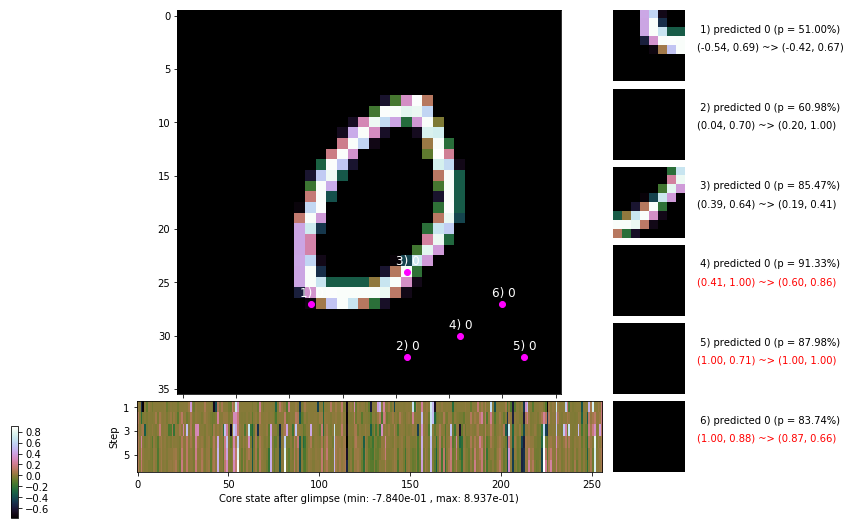

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 127.8 ms/b | lr: 3.87e-04 | grad 2norm: 13.14 | grad inf norm:  3.723
         Weights || abs max:  2.61 ( 2874.12) | mean: -6.32e-04 ( 0.01) | var: 8.05e-02 (  168.37)
          Biases || abs max:  1.44 (   62.34) | mean: -1.37e-01 ( 0.07) | var: 9.68e-02 (   84.00)
                    class loss: 0.322 | steps: 2.195 | reward:  3.772 | acc.: 89.37%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 131.0 ms/b | lr: 3.87e-04 | grad 2norm: 13.28 | grad inf norm:  3.761
         Weights || abs max:  2.61 ( 2194.12) | mean: -6.25e-04 ( 0.01) | var: 8.05e-02 (  123.12)
          Biases || abs max:  1.44 (  140.54) | mean: -1.37e-01 ( 0.11) | var: 9.68e-02 (  552.11)
                    class loss: 0.336 | steps: 2.222 | reward:  3.733 | acc.: 88.95%

	Target class: 9 | Discounted rewards: [-0.984, -0.969, -

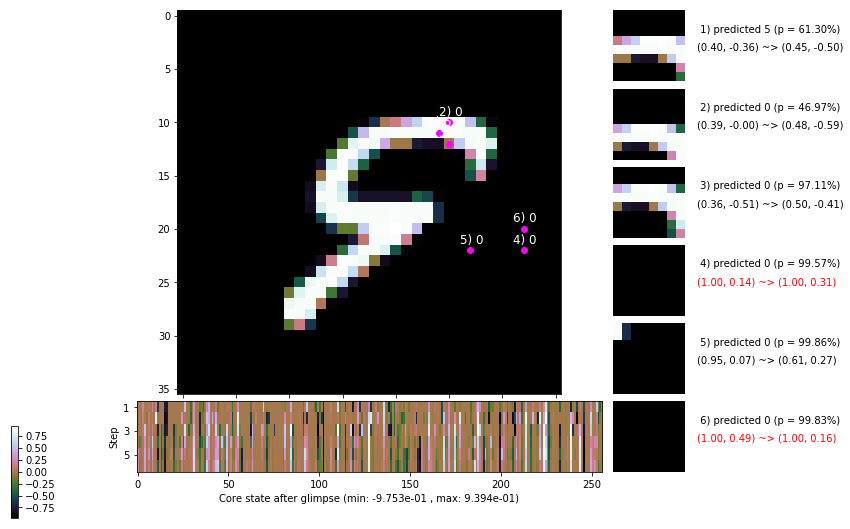

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 129.3 ms/b | lr: 3.86e-04 | grad 2norm: 13.32 | grad inf norm:  3.823
         Weights || abs max:  2.61 ( 1532.23) | mean: -6.30e-04 ( 0.01) | var: 8.06e-02 (   44.26)
          Biases || abs max:  1.43 (  405.72) | mean: -1.37e-01 ( 0.21) | var: 9.68e-02 ( 6082.73)
                    class loss: 0.337 | steps: 2.239 | reward:  3.696 | acc.: 88.87%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 131.0 ms/b | lr: 3.85e-04 | grad 2norm: 12.97 | grad inf norm:  3.756
         Weights || abs max:  2.61 ( 2309.48) | mean: -6.24e-04 ( 0.01) | var: 8.06e-02 (  369.66)
          Biases || abs max:  1.43 (  131.21) | mean: -1.37e-01 ( 0.10) | var: 9.67e-02 (  159.69)
                    class loss: 0.325 | steps: 2.207 | reward:  3.748 | acc.: 88.98%

	Target class: 7 | Discounted rewards: [-0.281, 0.438, 1.

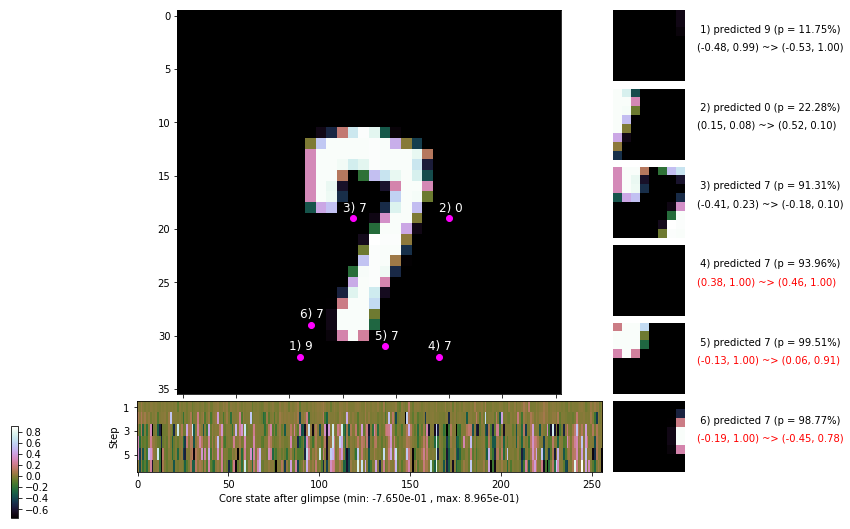

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.4 ms/b | lr: 3.85e-04 | grad 2norm: 13.12 | grad inf norm:  3.801
         Weights || abs max:  2.59 ( 1631.00) | mean: -6.36e-04 ( 0.01) | var: 8.06e-02 (   50.27)
          Biases || abs max:  1.44 (  176.46) | mean: -1.37e-01 ( 0.12) | var: 9.67e-02 ( 1304.87)
                    class loss: 0.326 | steps: 2.235 | reward:  3.704 | acc.: 89.17%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 150.8 ms/b | lr: 3.84e-04 | grad 2norm: 13.11 | grad inf norm:  3.769
         Weights || abs max:  2.59 ( 2054.52) | mean: -6.36e-04 ( 0.01) | var: 8.07e-02 (  119.94)
          Biases || abs max:  1.44 (  126.26) | mean: -1.37e-01 ( 0.10) | var: 9.68e-02 (  465.54)
                    class loss: 0.327 | steps: 2.238 | reward:  3.714 | acc.: 89.23%

	Target class: 2 | Discounted rewards: [-0.281, 0.438, 1.

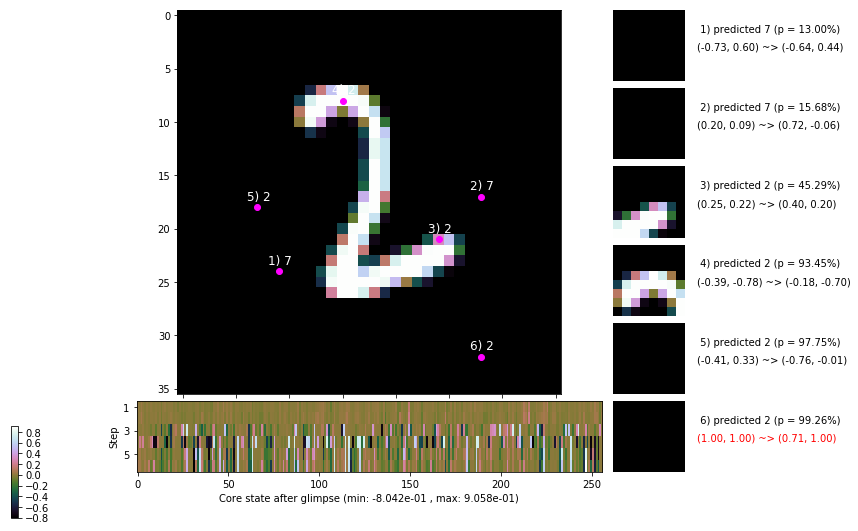

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 147.4 ms/b | lr: 3.83e-04 | grad 2norm: 13.28 | grad inf norm:  3.893
         Weights || abs max:  2.60 ( 5810.63) | mean: -6.25e-04 ( 0.02) | var: 8.07e-02 ( 8433.10)
          Biases || abs max:  1.43 (   91.75) | mean: -1.37e-01 ( 0.09) | var: 9.68e-02 (   62.16)
                    class loss: 0.343 | steps: 2.265 | reward:  3.663 | acc.: 88.43%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 179.8 ms/b | lr: 3.83e-04 | grad 2norm: 13.23 | grad inf norm:  3.919
         Weights || abs max:  2.59 ( 4467.74) | mean: -6.25e-04 ( 0.01) | var: 8.07e-02 ( 1951.55)
          Biases || abs max:  1.44 (   52.13) | mean: -1.37e-01 ( 0.07) | var: 9.68e-02 (    7.24)
                    class loss: 0.326 | steps: 2.217 | reward:  3.739 | acc.: 89.08%

	Target class: 6 | Discounted rewards: [-0.281, 0.438, 1.

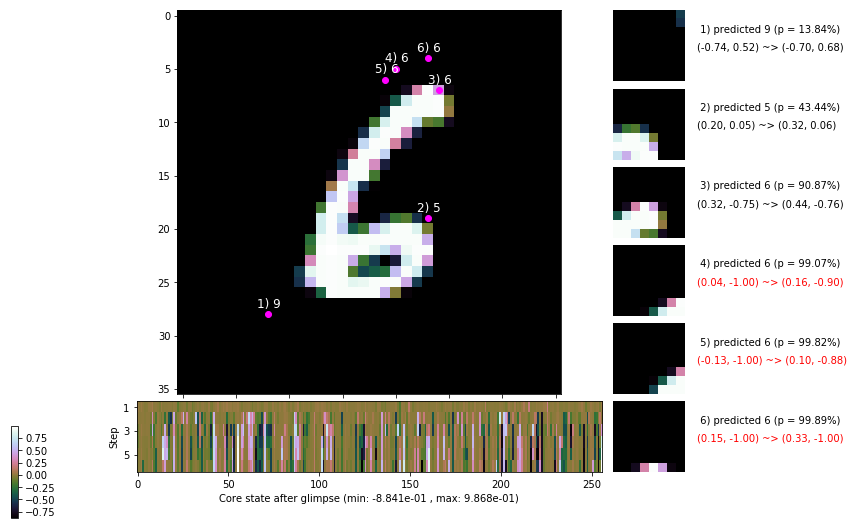

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


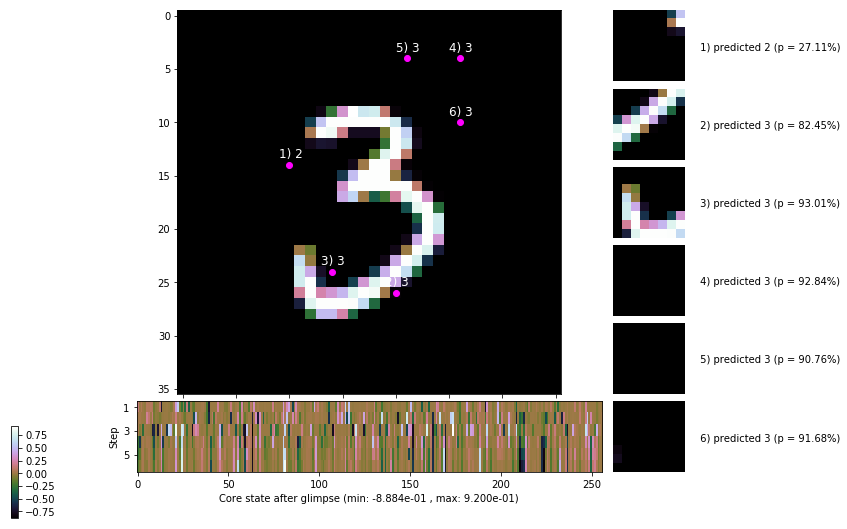


	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


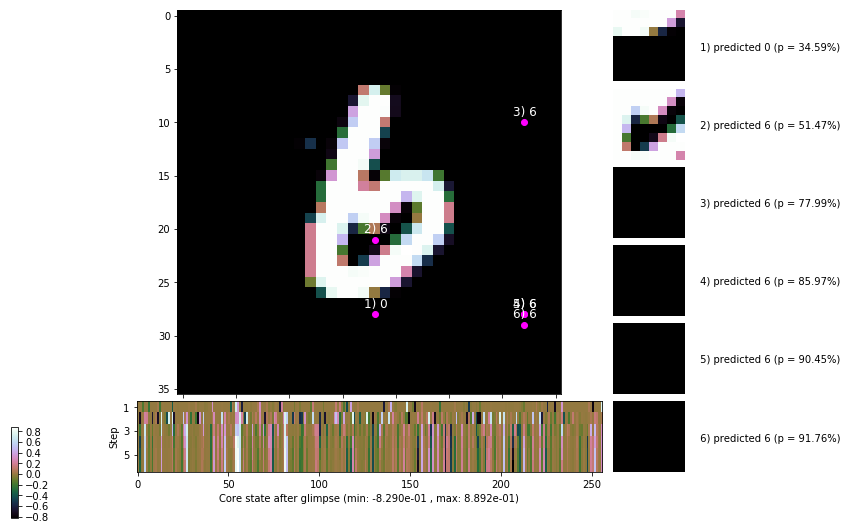

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


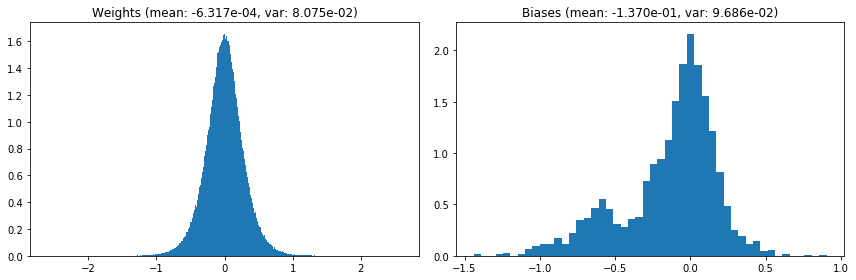

                                      Location network weights and biases


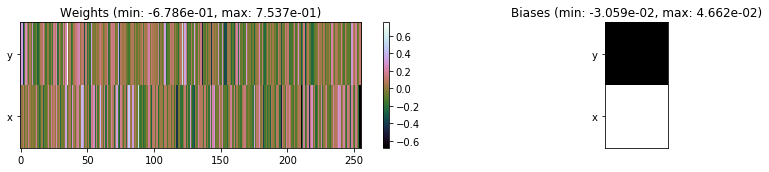

---------------------------------------------------------------------------------------------------------------
Elapsed time:  425.81 sec | TRAIN >> class loss: 0.3304 | steps:  2.226 :( | reward:  3.7219 :( | acc.: 88.950% :(
                          | VAL   >> class loss: 0.3352 | steps:  2.127 :( | reward:  3.9165 :( | acc.: 89.020% :(


Epoch  65/400) lr = 0.0003827
 b    300/  3000 >> 152.3 ms/b | lr: 3.82e-04 | grad 2norm: 13.34 | grad inf norm:  3.942
         Weights || abs max:  2.59 ( 1905.21) | mean: -6.31e-04 ( 0.01) | var: 8.08e-02 (   58.49)
          Biases || abs max:  1.44 (  337.73) | mean: -1.37e-01 ( 0.21) | var: 9.70e-02 ( 4200.93)
                    class loss: 0.341 | steps: 2.193 | reward:  3.768 | acc.: 88.55%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 149.5 ms/b | lr: 3.82e-04 | grad 2norm: 13.18 | grad inf norm:  3.792
         Weights || abs max:  2.59 ( 4315.05) | mean: -6.26e-04 (

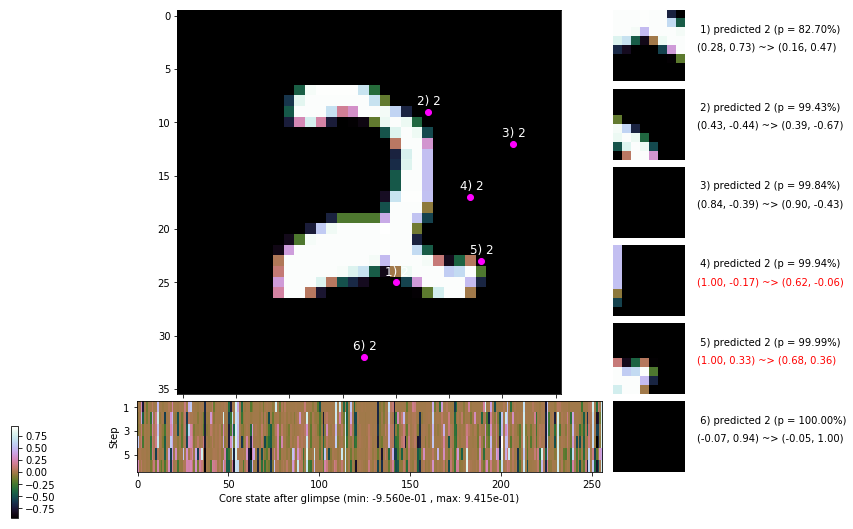

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 141.1 ms/b | lr: 3.81e-04 | grad 2norm: 13.01 | grad inf norm:  3.806
         Weights || abs max:  2.59 ( 5635.15) | mean: -6.27e-04 ( 0.02) | var: 8.08e-02 ( 4833.20)
          Biases || abs max:  1.43 (  139.94) | mean: -1.37e-01 ( 0.11) | var: 9.71e-02 (  131.42)
                    class loss: 0.350 | steps: 2.214 | reward:  3.746 | acc.: 88.40%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 146.4 ms/b | lr: 3.81e-04 | grad 2norm: 13.16 | grad inf norm:  3.852
         Weights || abs max:  2.60 ( 9894.66) | mean: -6.14e-04 ( 0.03) | var: 8.09e-02 ( 9798.75)
          Biases || abs max:  1.44 (   70.62) | mean: -1.37e-01 ( 0.08) | var: 9.71e-02 (   23.98)
                    class loss: 0.357 | steps: 2.238 | reward:  3.681 | acc.: 87.95%

	Target class: 9 | Discounted rewards: [0.516, -0.969, -0

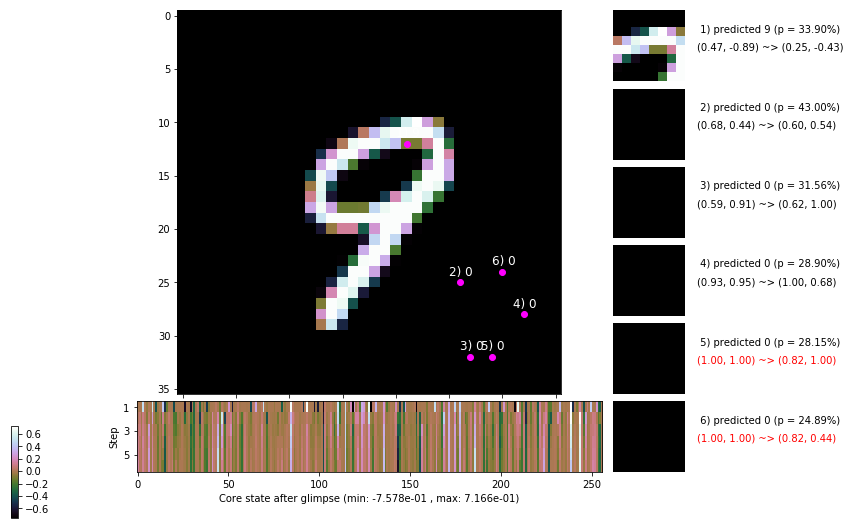

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 151.3 ms/b | lr: 3.80e-04 | grad 2norm: 13.11 | grad inf norm:  3.937
         Weights || abs max:  2.60 ( 5336.72) | mean: -6.10e-04 ( 0.02) | var: 8.09e-02 ( 5504.95)
          Biases || abs max:  1.44 (   78.68) | mean: -1.37e-01 ( 0.09) | var: 9.71e-02 (   92.52)
                    class loss: 0.346 | steps: 2.247 | reward:  3.703 | acc.: 88.32%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 153.5 ms/b | lr: 3.80e-04 | grad 2norm: 13.12 | grad inf norm:  3.929
         Weights || abs max:  2.61 ( 6336.18) | mean: -6.11e-04 ( 0.02) | var: 8.09e-02 ( 2904.52)
          Biases || abs max:  1.43 (   58.91) | mean: -1.37e-01 ( 0.07) | var: 9.69e-02 (   45.78)
                    class loss: 0.343 | steps: 2.225 | reward:  3.724 | acc.: 88.48%

	Target class: 7 | Discounted rewards: [-0.609, -0.219, 0

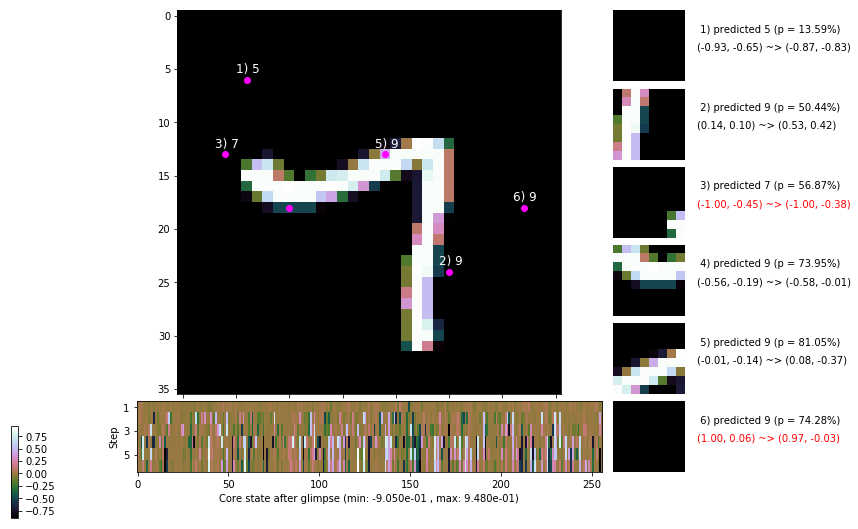

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.3 ms/b | lr: 3.79e-04 | grad 2norm: 13.03 | grad inf norm:  3.662
         Weights || abs max:  2.61 ( 3165.00) | mean: -6.17e-04 ( 0.01) | var: 8.09e-02 (  291.36)
          Biases || abs max:  1.44 (  149.77) | mean: -1.37e-01 ( 0.11) | var: 9.70e-02 (  100.78)
                    class loss: 0.329 | steps: 2.210 | reward:  3.729 | acc.: 88.98%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.8 ms/b | lr: 3.79e-04 | grad 2norm: 13.03 | grad inf norm:  3.833
         Weights || abs max:  2.60 ( 2581.05) | mean: -6.22e-04 ( 0.01) | var: 8.10e-02 (  492.96)
          Biases || abs max:  1.44 (   84.58) | mean: -1.37e-01 ( 0.09) | var: 9.69e-02 (   42.63)
                    class loss: 0.328 | steps: 2.218 | reward:  3.783 | acc.: 89.70%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

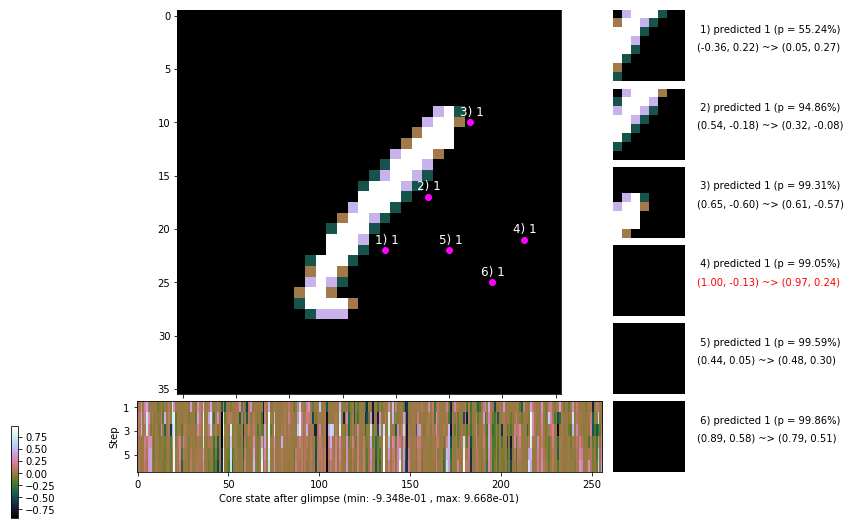

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 141.4 ms/b | lr: 3.78e-04 | grad 2norm: 13.28 | grad inf norm:  3.917
         Weights || abs max:  2.61 ( 3620.66) | mean: -6.23e-04 ( 0.01) | var: 8.10e-02 ( 1741.71)
          Biases || abs max:  1.44 (  191.14) | mean: -1.37e-01 ( 0.17) | var: 9.69e-02 ( 2405.97)
                    class loss: 0.352 | steps: 2.229 | reward:  3.700 | acc.: 88.02%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 132.2 ms/b | lr: 3.77e-04 | grad 2norm: 12.76 | grad inf norm:  3.768
         Weights || abs max:  2.62 ( 2462.82) | mean: -6.21e-04 ( 0.01) | var: 8.10e-02 (  575.40)
          Biases || abs max:  1.44 (  188.20) | mean: -1.37e-01 ( 0.12) | var: 9.70e-02 ( 1415.08)
                    class loss: 0.333 | steps: 2.214 | reward:  3.744 | acc.: 88.88%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

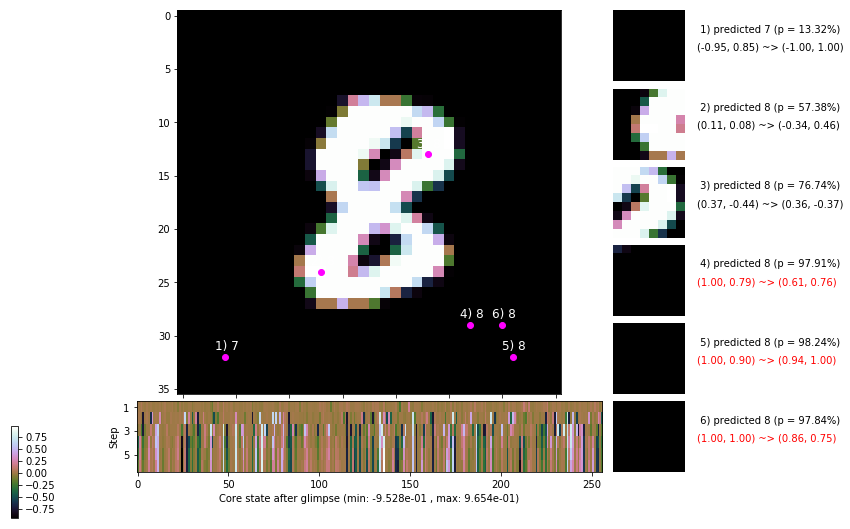

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


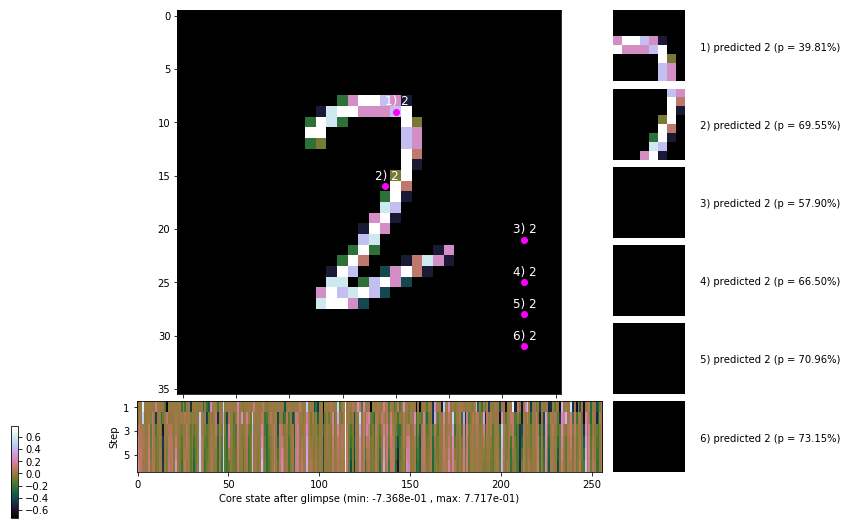


	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


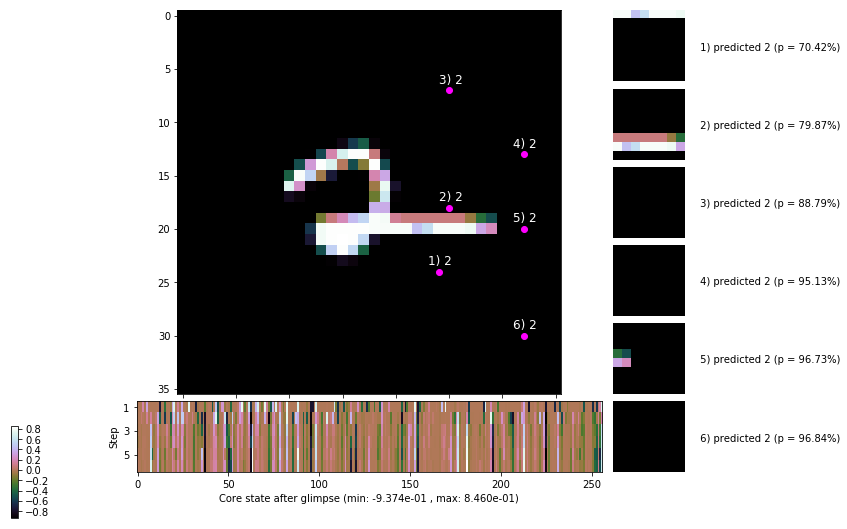

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


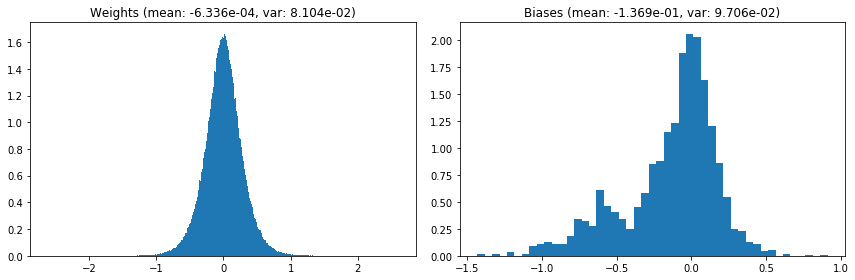

                                      Location network weights and biases


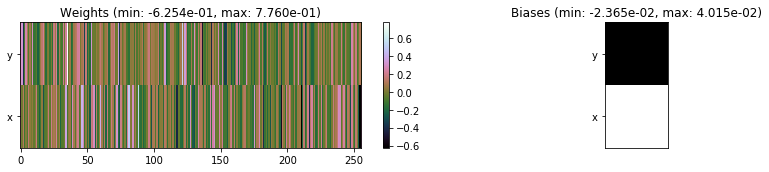

---------------------------------------------------------------------------------------------------------------
Elapsed time:  444.17 sec | TRAIN >> class loss: 0.3412 | steps:  2.220 :( | reward:  3.7342 :( | acc.: 88.597% :(
                          | VAL   >> class loss: 0.3231 | steps:  2.089    | reward:  3.9402    | acc.: 89.580% :(


Epoch  66/400) lr = 0.000377
 b    300/  3000 >> 138.9 ms/b | lr: 3.77e-04 | grad 2norm: 13.17 | grad inf norm:  3.818
         Weights || abs max:  2.61 ( 3735.24) | mean: -6.41e-04 ( 0.01) | var: 8.11e-02 ( 1299.40)
          Biases || abs max:  1.44 (   85.69) | mean: -1.37e-01 ( 0.08) | var: 9.72e-02 (  175.95)
                    class loss: 0.353 | steps: 2.209 | reward:  3.705 | acc.: 88.18%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 130.9 ms/b | lr: 3.76e-04 | grad 2norm: 12.99 | grad inf norm:  3.629
         Weights || abs max:  2.61 ( 4038.62) | mean: -6.51e-04 ( 

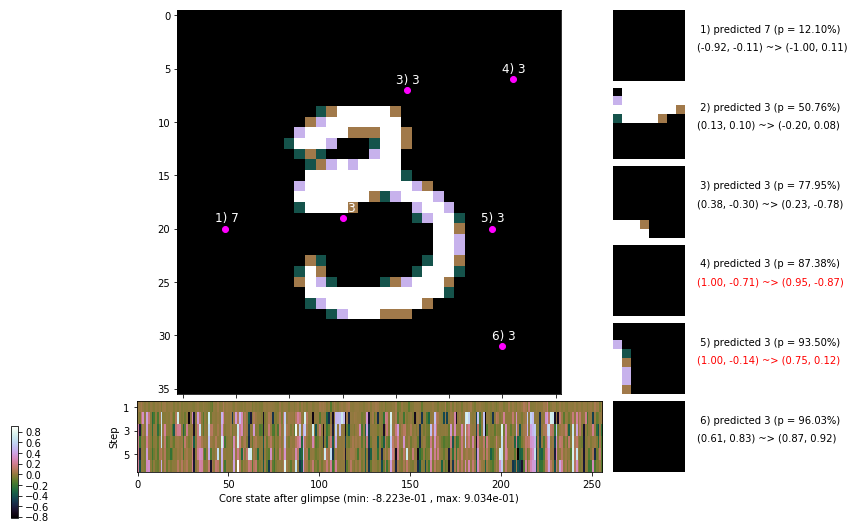

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 171.7 ms/b | lr: 3.76e-04 | grad 2norm: 13.05 | grad inf norm:  3.776
         Weights || abs max:  2.61 ( 4152.36) | mean: -6.33e-04 ( 0.01) | var: 8.11e-02 ( 1133.32)
          Biases || abs max:  1.44 (   62.99) | mean: -1.37e-01 ( 0.08) | var: 9.71e-02 (   13.78)
                    class loss: 0.334 | steps: 2.193 | reward:  3.793 | acc.: 89.23%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 146.1 ms/b | lr: 3.75e-04 | grad 2norm: 13.16 | grad inf norm:  3.924
         Weights || abs max:  2.62 ( 2903.76) | mean: -6.49e-04 ( 0.01) | var: 8.11e-02 (  235.05)
          Biases || abs max:  1.43 (   54.75) | mean: -1.37e-01 ( 0.07) | var: 9.72e-02 (    8.60)
                    class loss: 0.333 | steps: 2.204 | reward:  3.736 | acc.: 88.90%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

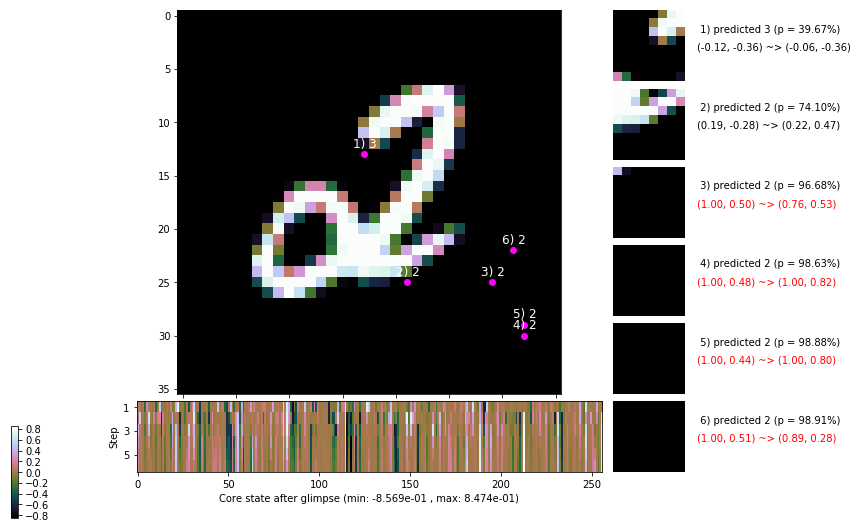

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 134.8 ms/b | lr: 3.74e-04 | grad 2norm: 13.27 | grad inf norm:  3.906
         Weights || abs max:  2.63 ( 4197.58) | mean: -6.55e-04 ( 0.01) | var: 8.12e-02 (  940.48)
          Biases || abs max:  1.43 (   70.42) | mean: -1.37e-01 ( 0.09) | var: 9.72e-02 (   13.88)
                    class loss: 0.354 | steps: 2.233 | reward:  3.689 | acc.: 88.05%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 131.4 ms/b | lr: 3.74e-04 | grad 2norm: 12.87 | grad inf norm:  3.790
         Weights || abs max:  2.63 ( 2332.09) | mean: -6.48e-04 ( 0.01) | var: 8.12e-02 (   80.46)
          Biases || abs max:  1.43 (  197.35) | mean: -1.37e-01 ( 0.13) | var: 9.71e-02 ( 1771.71)
                    class loss: 0.327 | steps: 2.204 | reward:  3.775 | acc.: 89.27%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

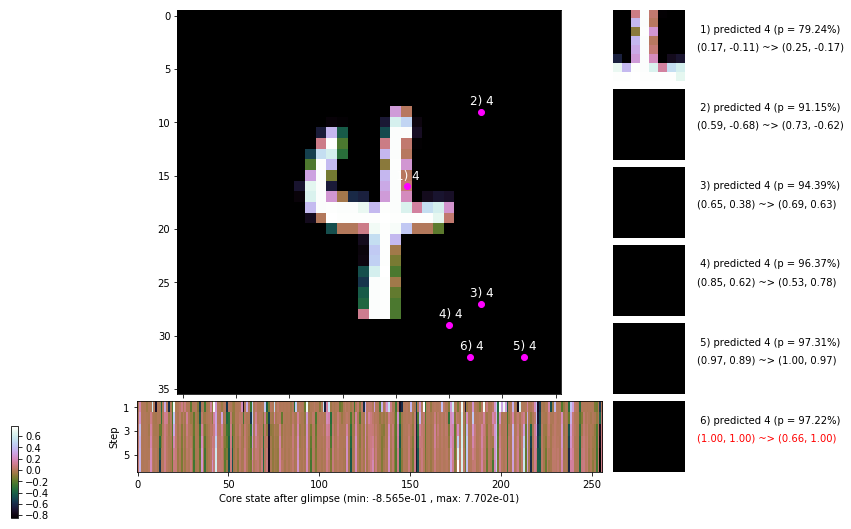

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 134.0 ms/b | lr: 3.73e-04 | grad 2norm: 12.75 | grad inf norm:  3.638
         Weights || abs max:  2.63 ( 2662.42) | mean: -6.38e-04 ( 0.01) | var: 8.12e-02 (  191.53)
          Biases || abs max:  1.43 (  604.67) | mean: -1.38e-01 ( 0.29) | var: 9.73e-02 (31920.88)
                    class loss: 0.339 | steps: 2.231 | reward:  3.718 | acc.: 88.72%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.8 ms/b | lr: 3.73e-04 | grad 2norm: 13.19 | grad inf norm:  3.702
         Weights || abs max:  2.62 ( 1851.75) | mean: -6.15e-04 ( 0.01) | var: 8.12e-02 (   55.35)
          Biases || abs max:  1.44 (   89.01) | mean: -1.38e-01 ( 0.09) | var: 9.75e-02 (   81.27)
                    class loss: 0.362 | steps: 2.206 | reward:  3.721 | acc.: 87.77%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

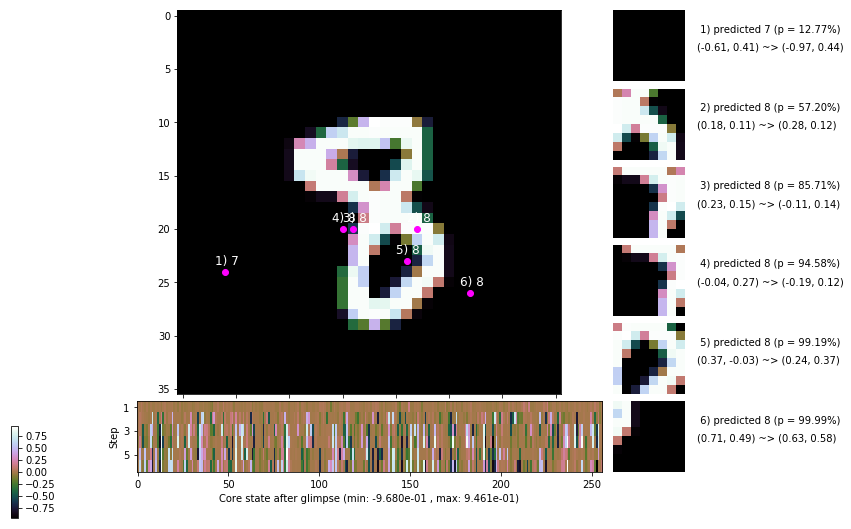

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 141.5 ms/b | lr: 3.72e-04 | grad 2norm: 13.19 | grad inf norm:  3.808
         Weights || abs max:  2.62 ( 8530.12) | mean: -5.98e-04 ( 0.02) | var: 8.13e-02 (19553.94)
          Biases || abs max:  1.44 (   99.77) | mean: -1.37e-01 ( 0.09) | var: 9.74e-02 (   32.76)
                    class loss: 0.345 | steps: 2.235 | reward:  3.708 | acc.: 88.58%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.4 ms/b | lr: 3.72e-04 | grad 2norm: 13.23 | grad inf norm:  3.828
         Weights || abs max:  2.62 ( 4509.87) | mean: -5.92e-04 ( 0.02) | var: 8.13e-02 ( 2478.19)
          Biases || abs max:  1.45 (  195.69) | mean: -1.37e-01 ( 0.14) | var: 9.75e-02 (  419.75)
                    class loss: 0.357 | steps: 2.229 | reward:  3.683 | acc.: 87.47%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

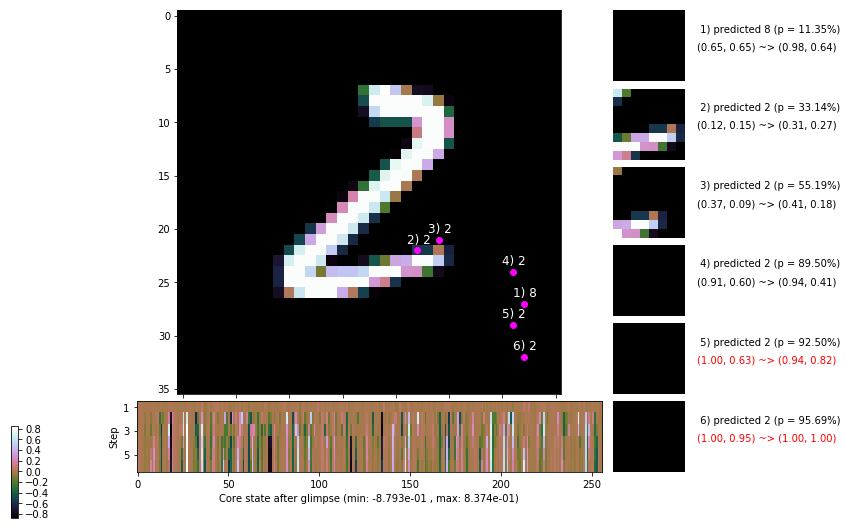

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


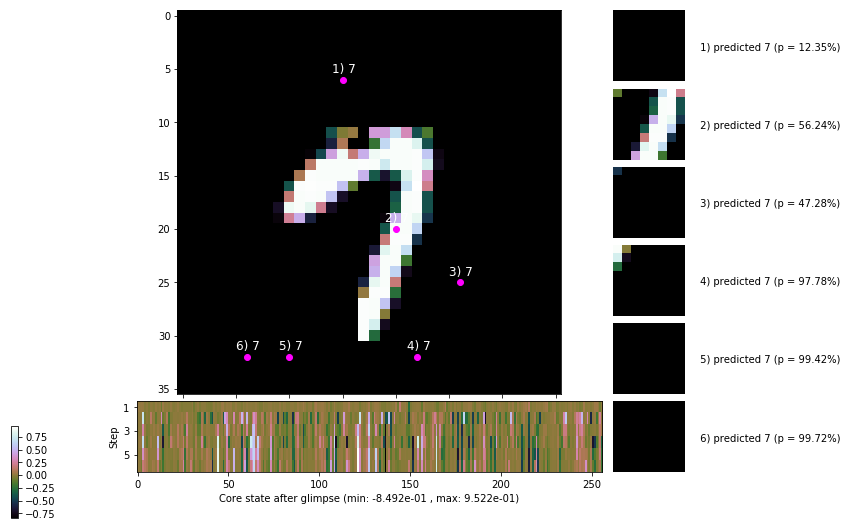


	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


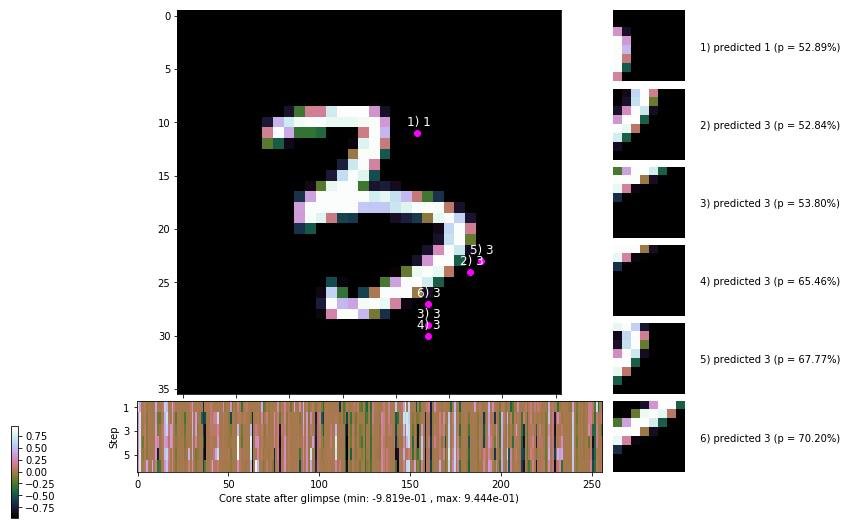

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


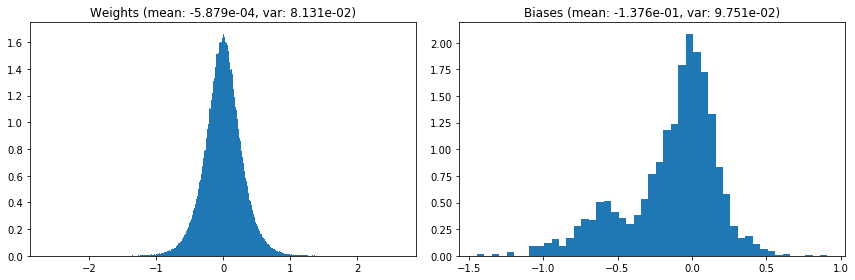

                                      Location network weights and biases


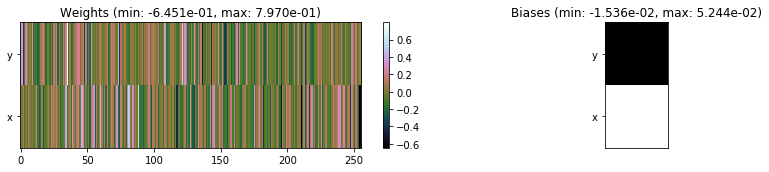

---------------------------------------------------------------------------------------------------------------
Elapsed time:  425.25 sec | TRAIN >> class loss: 0.3444 | steps:  2.216    | reward:  3.7271 :( | acc.: 88.492% :(
                          | VAL   >> class loss: 0.3260 | steps:  2.137 :( | reward:  3.8829 :( | acc.: 88.800% :(


Epoch  67/400) lr = 0.0003714
 b    300/  3000 >> 144.4 ms/b | lr: 3.71e-04 | grad 2norm: 13.33 | grad inf norm:  4.007
         Weights || abs max:  2.62 ( 2277.23) | mean: -5.74e-04 ( 0.01) | var: 8.13e-02 (  160.75)
          Biases || abs max:  1.44 (  129.78) | mean: -1.37e-01 ( 0.11) | var: 9.74e-02 (  193.33)
                    class loss: 0.352 | steps: 2.220 | reward:  3.726 | acc.: 88.30%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 149.0 ms/b | lr: 3.71e-04 | grad 2norm: 12.84 | grad inf norm:  3.824
         Weights || abs max:  2.63 ( 2269.48) | mean: -5.87e-04 (

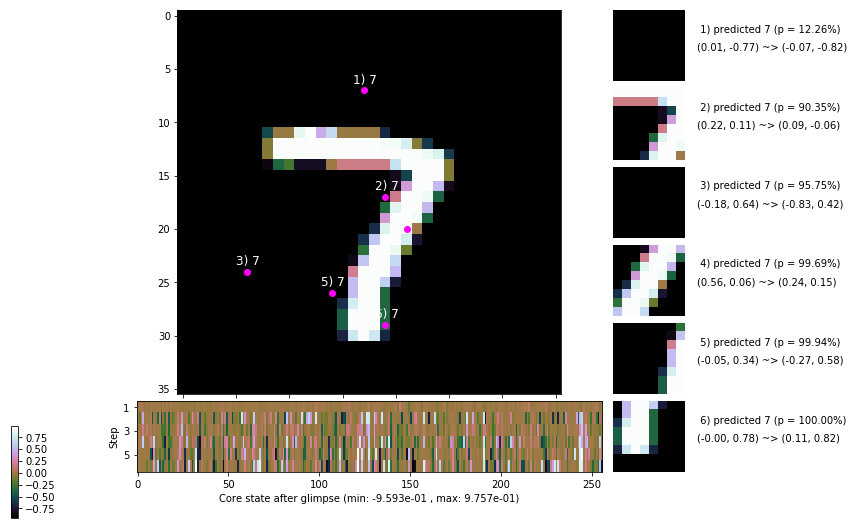

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 139.4 ms/b | lr: 3.70e-04 | grad 2norm: 13.33 | grad inf norm:  4.049
         Weights || abs max:  2.63 ( 2912.60) | mean: -6.14e-04 ( 0.01) | var: 8.14e-02 (  197.15)
          Biases || abs max:  1.44 (  181.25) | mean: -1.38e-01 ( 0.13) | var: 9.74e-02 ( 1362.07)
                    class loss: 0.343 | steps: 2.206 | reward:  3.752 | acc.: 88.58%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 133.1 ms/b | lr: 3.70e-04 | grad 2norm: 12.96 | grad inf norm:  3.704
         Weights || abs max:  2.63 (19079.76) | mean: -6.43e-04 ( 0.04) | var: 8.14e-02 (63520.19)
          Biases || abs max:  1.44 (   53.20) | mean: -1.38e-01 ( 0.08) | var: 9.75e-02 (    5.20)
                    class loss: 0.342 | steps: 2.235 | reward:  3.713 | acc.: 88.67%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

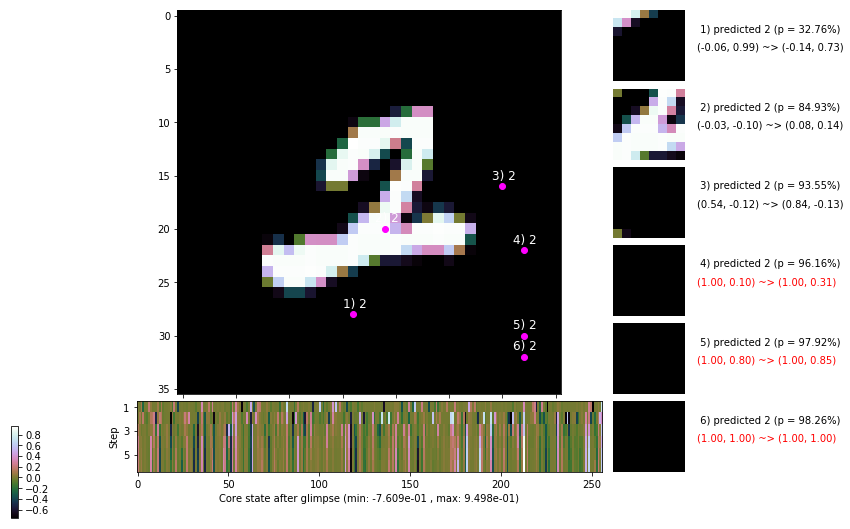

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 134.4 ms/b | lr: 3.69e-04 | grad 2norm: 13.26 | grad inf norm:  3.961
         Weights || abs max:  2.63 ( 6493.85) | mean: -6.48e-04 ( 0.02) | var: 8.14e-02 ( 2135.85)
          Biases || abs max:  1.44 ( 3963.02) | mean: -1.38e-01 ( 1.59) | var: 9.75e-02 (1772435.50)
                    class loss: 0.341 | steps: 2.227 | reward:  3.717 | acc.: 88.22%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.2 ms/b | lr: 3.68e-04 | grad 2norm: 13.18 | grad inf norm:  3.972
         Weights || abs max:  2.63 ( 1568.71) | mean: -6.27e-04 ( 0.01) | var: 8.15e-02 (   28.74)
          Biases || abs max:  1.44 (  147.00) | mean: -1.38e-01 ( 0.11) | var: 9.75e-02 (  484.88)
                    class loss: 0.342 | steps: 2.224 | reward:  3.686 | acc.: 88.08%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1

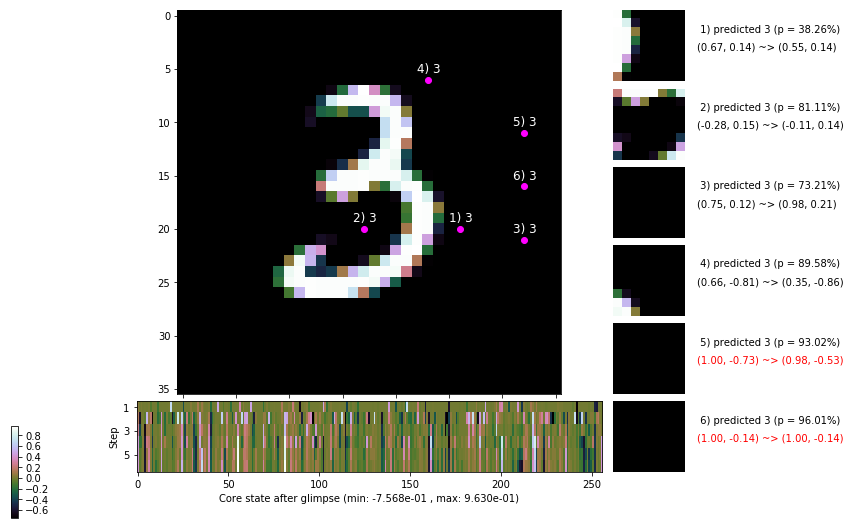

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.4 ms/b | lr: 3.68e-04 | grad 2norm: 13.21 | grad inf norm:  3.879
         Weights || abs max:  2.64 ( 3031.60) | mean: -6.18e-04 ( 0.01) | var: 8.15e-02 (  725.66)
          Biases || abs max:  1.44 (  118.76) | mean: -1.38e-01 ( 0.11) | var: 9.76e-02 (   55.98)
                    class loss: 0.365 | steps: 2.243 | reward:  3.647 | acc.: 87.47%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 152.3 ms/b | lr: 3.67e-04 | grad 2norm: 12.86 | grad inf norm:  3.710
         Weights || abs max:  2.64 ( 4197.39) | mean: -6.04e-04 ( 0.01) | var: 8.15e-02 (  921.57)
          Biases || abs max:  1.44 (   58.91) | mean: -1.38e-01 ( 0.07) | var: 9.76e-02 (   21.68)
                    class loss: 0.328 | steps: 2.204 | reward:  3.760 | acc.: 88.62%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

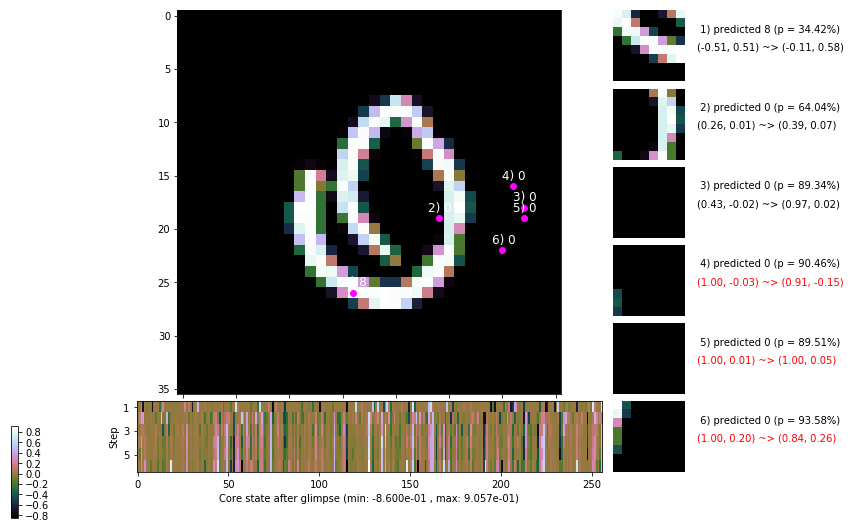

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 138.5 ms/b | lr: 3.67e-04 | grad 2norm: 13.52 | grad inf norm:  3.999
         Weights || abs max:  2.64 ( 7641.96) | mean: -5.96e-04 ( 0.02) | var: 8.16e-02 (14599.88)
          Biases || abs max:  1.44 (   85.59) | mean: -1.38e-01 ( 0.08) | var: 9.76e-02 (   71.02)
                    class loss: 0.361 | steps: 2.275 | reward:  3.607 | acc.: 87.35%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 135.1 ms/b | lr: 3.66e-04 | grad 2norm: 13.29 | grad inf norm:  3.834
         Weights || abs max:  2.65 ( 3496.61) | mean: -6.00e-04 ( 0.01) | var: 8.16e-02 (  493.99)
          Biases || abs max:  1.44 (   41.67) | mean: -1.38e-01 ( 0.06) | var: 9.77e-02 (    3.33)
                    class loss: 0.360 | steps: 2.242 | reward:  3.675 | acc.: 87.65%

	Target class: 7 | Discounted rewards: [-0.281, 0.438, 1.

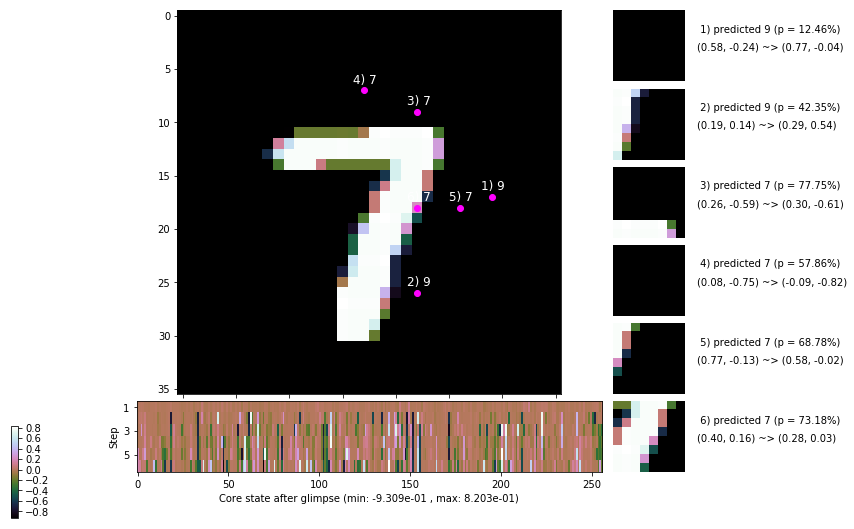

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


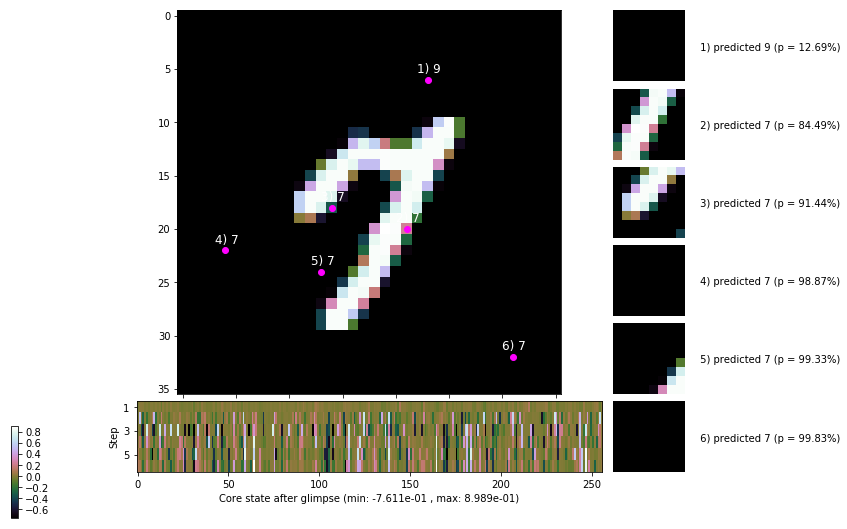


	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


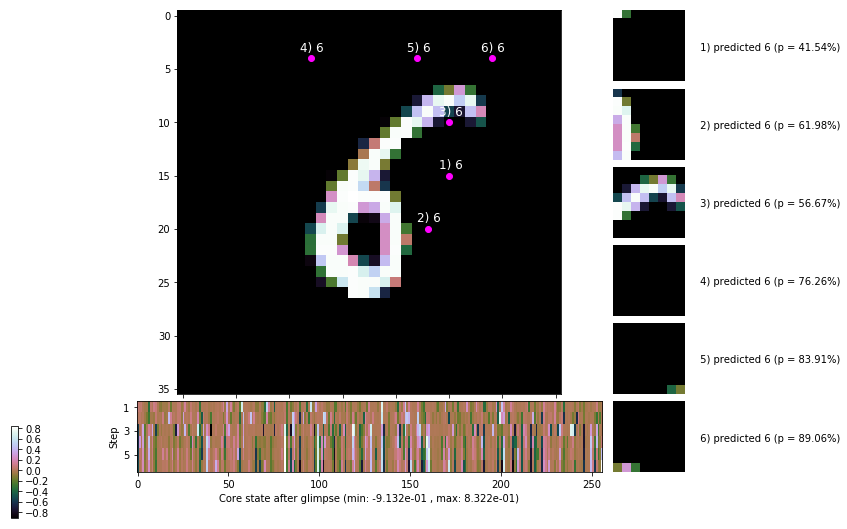

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


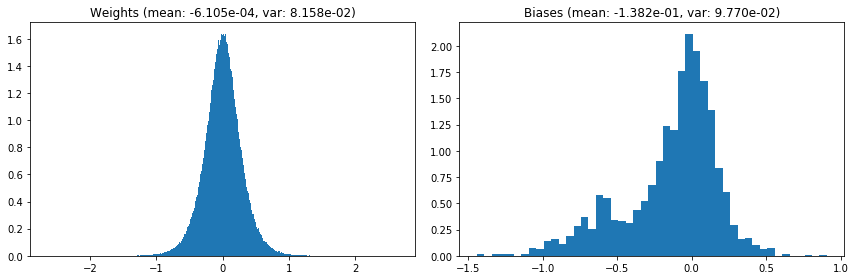

                                      Location network weights and biases


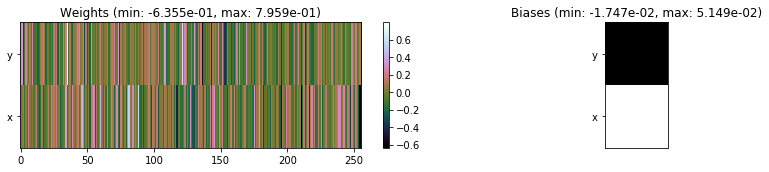

---------------------------------------------------------------------------------------------------------------
Elapsed time:  430.68 sec | TRAIN >> class loss: 0.3487 | steps:  2.229 :( | reward:  3.7026 :( | acc.: 88.125% :(
                          | VAL   >> class loss: 0.3226 | steps:  2.103 :( | reward:  3.9447    | acc.: 89.260% :(


Epoch  68/400) lr = 0.0003659
 b    300/  3000 >> 140.3 ms/b | lr: 3.65e-04 | grad 2norm: 13.08 | grad inf norm:  3.775
         Weights || abs max:  2.64 ( 4385.26) | mean: -6.12e-04 ( 0.02) | var: 8.16e-02 (  400.36)
          Biases || abs max:  1.44 (  115.94) | mean: -1.38e-01 ( 0.10) | var: 9.77e-02 (   51.22)
                    class loss: 0.348 | steps: 2.241 | reward:  3.684 | acc.: 88.22%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 134.7 ms/b | lr: 3.65e-04 | grad 2norm: 13.24 | grad inf norm:  3.922
         Weights || abs max:  2.65 ( 1647.24) | mean: -6.11e-04 (

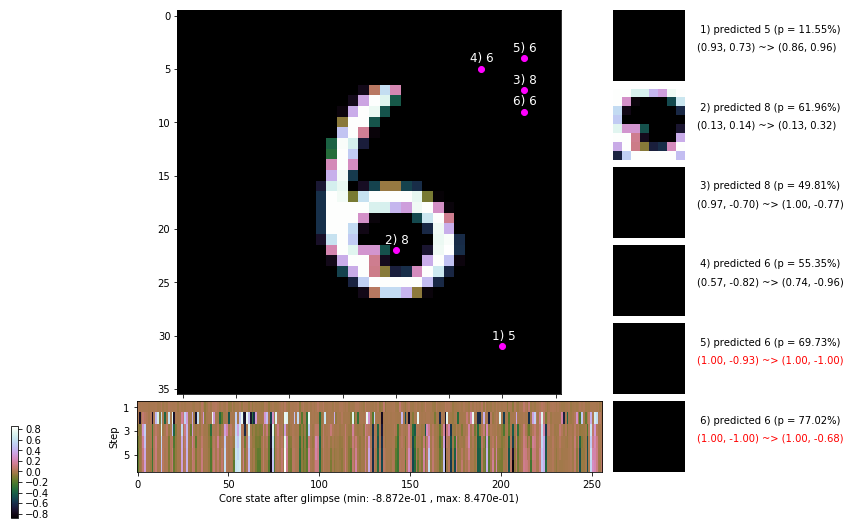

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 138.1 ms/b | lr: 3.64e-04 | grad 2norm: 12.99 | grad inf norm:  3.962
         Weights || abs max:  2.65 ( 1656.20) | mean: -6.22e-04 ( 0.01) | var: 8.17e-02 (  135.07)
          Biases || abs max:  1.44 (  117.97) | mean: -1.38e-01 ( 0.10) | var: 9.78e-02 (  247.01)
                    class loss: 0.350 | steps: 2.219 | reward:  3.711 | acc.: 88.30%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 139.5 ms/b | lr: 3.64e-04 | grad 2norm: 13.02 | grad inf norm:  3.763
         Weights || abs max:  2.66 ( 2637.61) | mean: -6.27e-04 ( 0.01) | var: 8.17e-02 (  424.22)
          Biases || abs max:  1.44 (  125.09) | mean: -1.38e-01 ( 0.11) | var: 9.78e-02 (  129.52)
                    class loss: 0.345 | steps: 2.259 | reward:  3.671 | acc.: 88.07%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

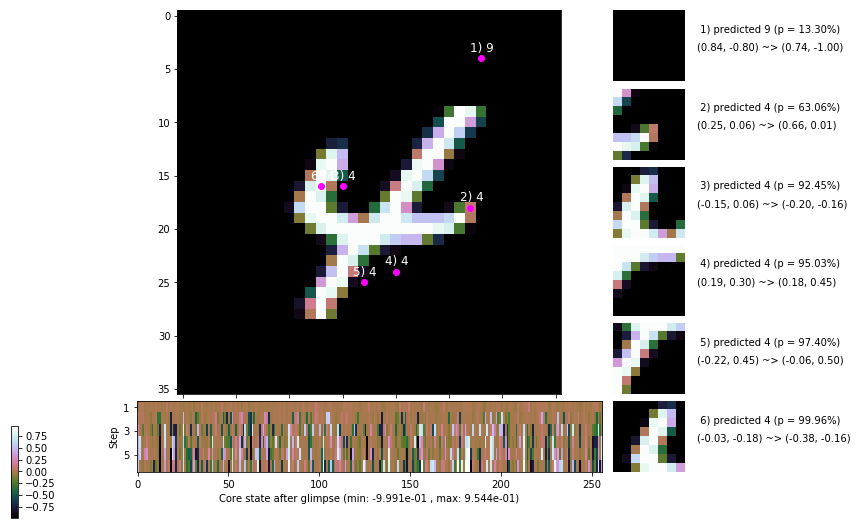

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.6 ms/b | lr: 3.63e-04 | grad 2norm: 13.33 | grad inf norm:  3.817
         Weights || abs max:  2.66 ( 1994.62) | mean: -6.30e-04 ( 0.01) | var: 8.17e-02 (   37.92)
          Biases || abs max:  1.44 (  148.55) | mean: -1.38e-01 ( 0.11) | var: 9.76e-02 (  370.89)
                    class loss: 0.362 | steps: 2.248 | reward:  3.680 | acc.: 87.80%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.0 ms/b | lr: 3.63e-04 | grad 2norm: 12.98 | grad inf norm:  3.893
         Weights || abs max:  2.67 ( 2144.42) | mean: -6.23e-04 ( 0.01) | var: 8.17e-02 (   54.05)
          Biases || abs max:  1.44 (  822.11) | mean: -1.38e-01 ( 0.38) | var: 9.78e-02 (36904.12)
                    class loss: 0.352 | steps: 2.201 | reward:  3.752 | acc.: 88.40%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.8

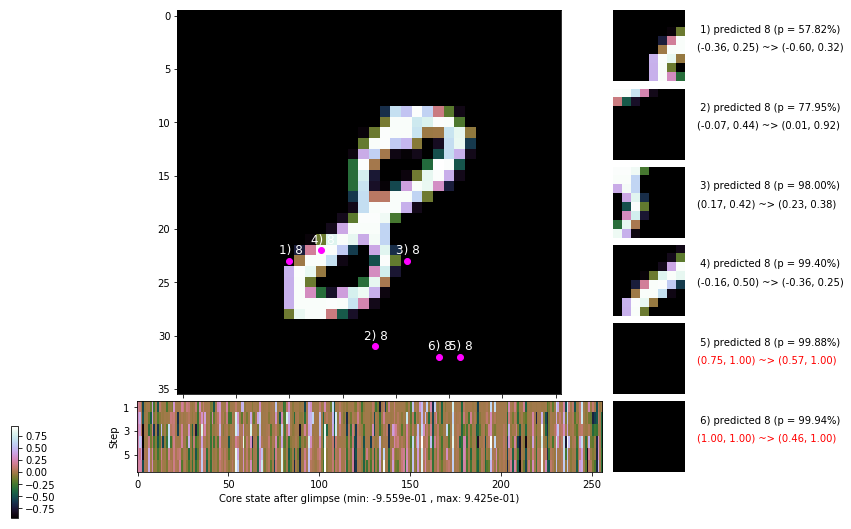

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 149.2 ms/b | lr: 3.62e-04 | grad 2norm: 13.09 | grad inf norm:  3.886
         Weights || abs max:  2.67 ( 4152.66) | mean: -6.25e-04 ( 0.01) | var: 8.18e-02 (  607.66)
          Biases || abs max:  1.44 (  129.58) | mean: -1.38e-01 ( 0.10) | var: 9.77e-02 (  396.82)
                    class loss: 0.344 | steps: 2.232 | reward:  3.700 | acc.: 88.33%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.9 ms/b | lr: 3.62e-04 | grad 2norm: 13.02 | grad inf norm:  3.667
         Weights || abs max:  2.68 ( 2632.64) | mean: -6.19e-04 ( 0.01) | var: 8.18e-02 (  106.60)
          Biases || abs max:  1.44 (  101.10) | mean: -1.38e-01 ( 0.10) | var: 9.77e-02 (   47.88)
                    class loss: 0.335 | steps: 2.206 | reward:  3.731 | acc.: 88.30%

	Target class: 5 | Discounted rewards: [0.375, 1.750, 1.5

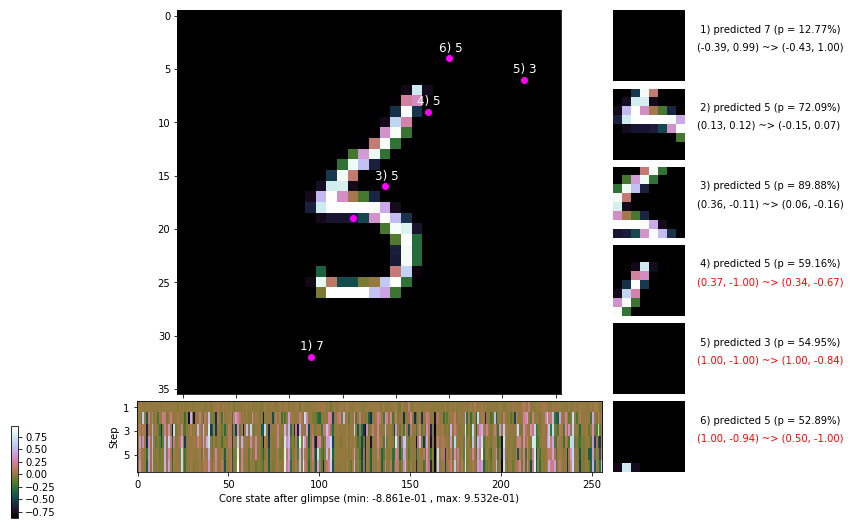

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.7 ms/b | lr: 3.61e-04 | grad 2norm: 13.01 | grad inf norm:  3.854
         Weights || abs max:  2.68 ( 3220.66) | mean: -6.13e-04 ( 0.01) | var: 8.18e-02 (  436.30)
          Biases || abs max:  1.44 (  170.34) | mean: -1.38e-01 ( 0.12) | var: 9.78e-02 ( 1707.12)
                    class loss: 0.355 | steps: 2.220 | reward:  3.691 | acc.: 87.88%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 147.3 ms/b | lr: 3.61e-04 | grad 2norm: 13.07 | grad inf norm:  3.943
         Weights || abs max:  2.67 ( 3552.59) | mean: -6.12e-04 ( 0.01) | var: 8.18e-02 (  684.58)
          Biases || abs max:  1.44 (  141.27) | mean: -1.38e-01 ( 0.10) | var: 9.78e-02 (  229.34)
                    class loss: 0.333 | steps: 2.200 | reward:  3.744 | acc.: 88.87%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

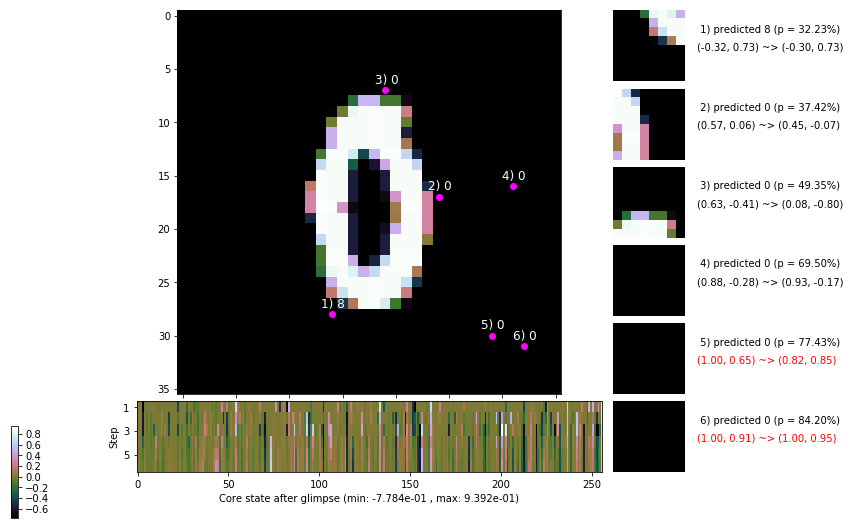

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


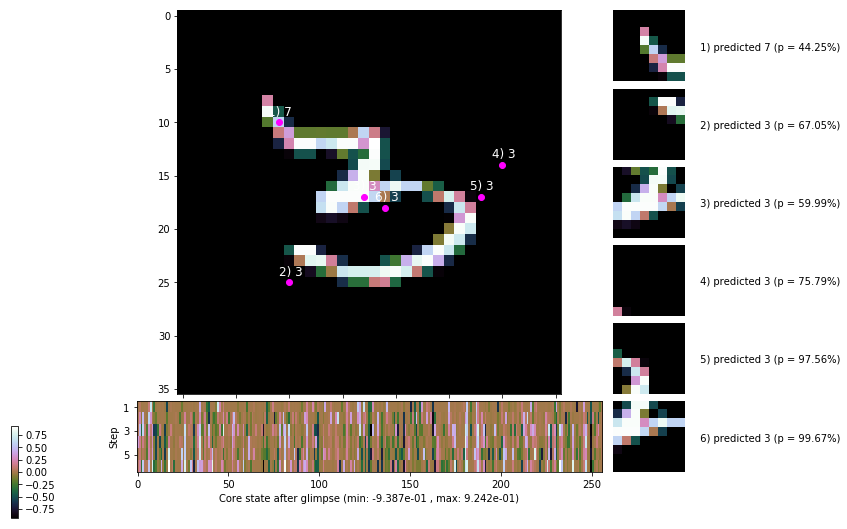


	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


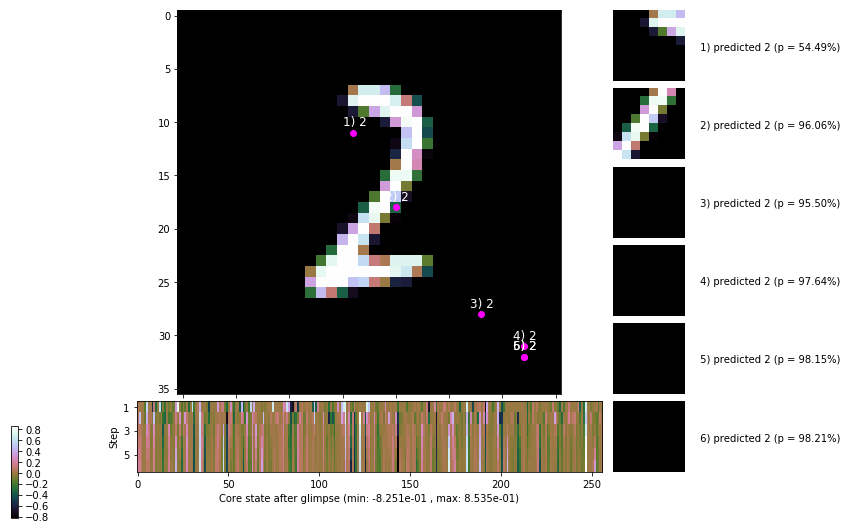

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


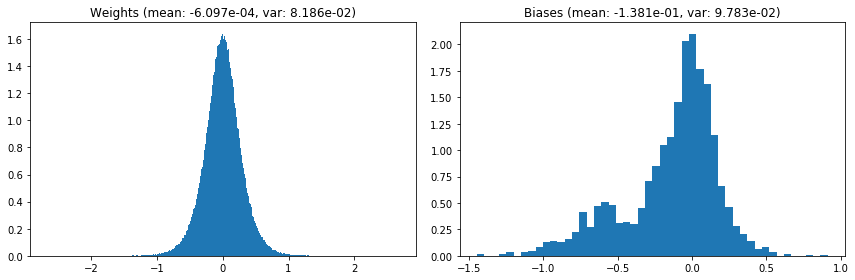

                                      Location network weights and biases


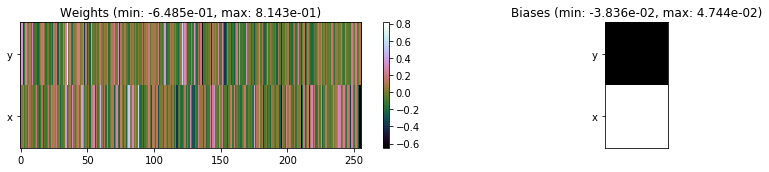

---------------------------------------------------------------------------------------------------------------
Elapsed time:  427.92 sec | TRAIN >> class loss: 0.3476 | steps:  2.224 :( | reward:  3.7089 :( | acc.: 88.247% :(
                          | VAL   >> class loss: 0.3094 | steps:  2.107 :( | reward:  3.9474    | acc.: 89.940% :(


Epoch  69/400) lr = 0.0003604
 b    300/  3000 >> 145.3 ms/b | lr: 3.60e-04 | grad 2norm: 12.78 | grad inf norm:  3.682
         Weights || abs max:  2.67 ( 4628.28) | mean: -6.13e-04 ( 0.02) | var: 8.19e-02 ( 3609.87)
          Biases || abs max:  1.44 (   27.02) | mean: -1.38e-01 ( 0.05) | var: 9.78e-02 (    2.04)
                    class loss: 0.321 | steps: 2.207 | reward:  3.747 | acc.: 89.23%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 139.5 ms/b | lr: 3.60e-04 | grad 2norm: 12.91 | grad inf norm:  3.728
         Weights || abs max:  2.67 ( 2352.46) | mean: -5.96e-04 (

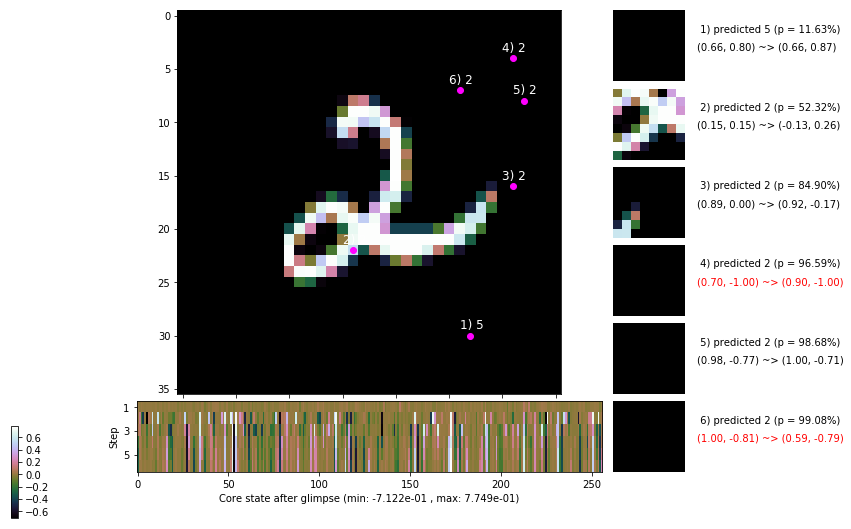

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.9 ms/b | lr: 3.59e-04 | grad 2norm: 13.18 | grad inf norm:  3.830
         Weights || abs max:  2.67 ( 4646.74) | mean: -6.07e-04 ( 0.02) | var: 8.19e-02 (  850.17)
          Biases || abs max:  1.44 (  167.55) | mean: -1.38e-01 ( 0.11) | var: 9.78e-02 ( 1076.07)
                    class loss: 0.357 | steps: 2.227 | reward:  3.693 | acc.: 87.85%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 140.8 ms/b | lr: 3.59e-04 | grad 2norm: 13.08 | grad inf norm:  3.889
         Weights || abs max:  2.67 (107839.27) | mean: -6.07e-04 ( 0.21) | var: 8.20e-02 (5964455.50)
          Biases || abs max:  1.44 (  632.56) | mean: -1.38e-01 ( 0.29) | var: 9.78e-02 (27382.68)
                    class loss: 0.361 | steps: 2.241 | reward:  3.702 | acc.: 88.52%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 

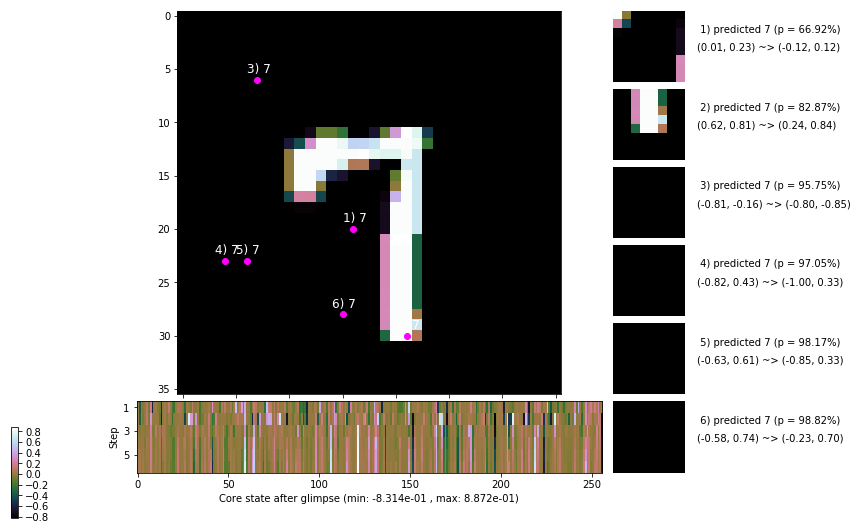

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.3 ms/b | lr: 3.58e-04 | grad 2norm: 13.08 | grad inf norm:  3.807
         Weights || abs max:  2.67 ( 4090.98) | mean: -6.06e-04 ( 0.01) | var: 8.20e-02 (  728.43)
          Biases || abs max:  1.44 (   87.53) | mean: -1.38e-01 ( 0.09) | var: 9.79e-02 (  129.53)
                    class loss: 0.365 | steps: 2.233 | reward:  3.675 | acc.: 87.85%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.1 ms/b | lr: 3.58e-04 | grad 2norm: 12.90 | grad inf norm:  3.801
         Weights || abs max:  2.67 ( 1489.24) | mean: -6.03e-04 ( 0.01) | var: 8.20e-02 (   22.33)
          Biases || abs max:  1.44 (  115.82) | mean: -1.38e-01 ( 0.11) | var: 9.80e-02 (  139.77)
                    class loss: 0.339 | steps: 2.251 | reward:  3.697 | acc.: 88.53%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

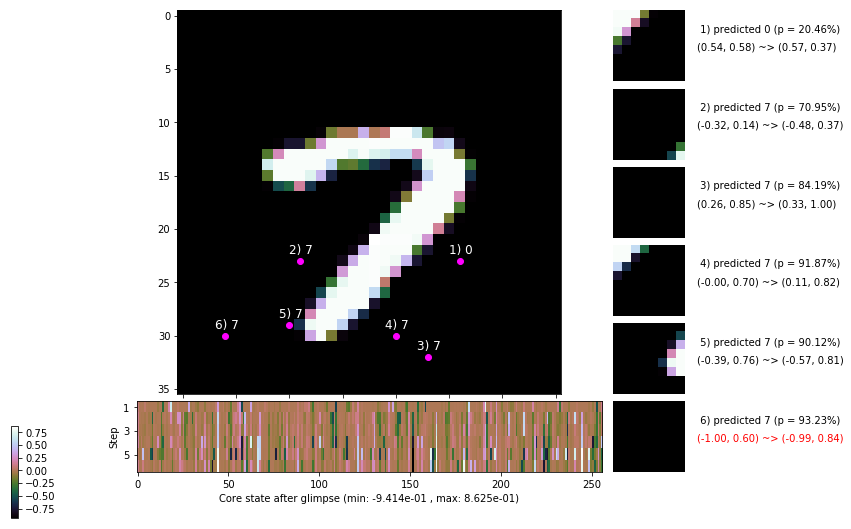

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 145.0 ms/b | lr: 3.57e-04 | grad 2norm: 12.83 | grad inf norm:  3.769
         Weights || abs max:  2.66 ( 4836.58) | mean: -5.87e-04 ( 0.02) | var: 8.20e-02 ( 4089.05)
          Biases || abs max:  1.44 (  130.73) | mean: -1.39e-01 ( 0.12) | var: 9.80e-02 (  221.86)
                    class loss: 0.342 | steps: 2.212 | reward:  3.714 | acc.: 88.52%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 137.5 ms/b | lr: 3.56e-04 | grad 2norm: 13.24 | grad inf norm:  3.879
         Weights || abs max:  2.67 ( 5739.17) | mean: -5.82e-04 ( 0.02) | var: 8.21e-02 ( 3625.90)
          Biases || abs max:  1.45 (   99.42) | mean: -1.39e-01 ( 0.09) | var: 9.80e-02 (   13.00)
                    class loss: 0.347 | steps: 2.246 | reward:  3.691 | acc.: 88.57%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

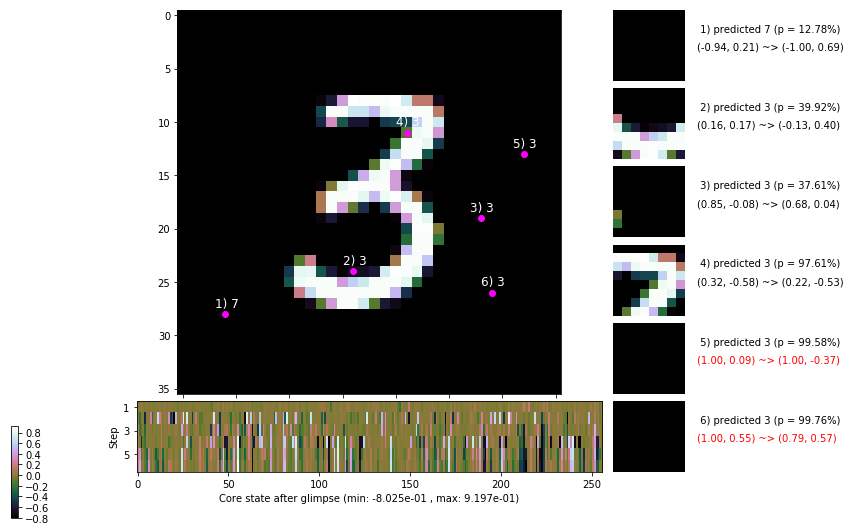

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.4 ms/b | lr: 3.56e-04 | grad 2norm: 12.59 | grad inf norm:  3.498
         Weights || abs max:  2.67 ( 3388.38) | mean: -5.83e-04 ( 0.01) | var: 8.21e-02 (  422.98)
          Biases || abs max:  1.44 (   95.64) | mean: -1.38e-01 ( 0.10) | var: 9.80e-02 (   17.26)
                    class loss: 0.317 | steps: 2.175 | reward:  3.803 | acc.: 89.47%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.8 ms/b | lr: 3.55e-04 | grad 2norm: 12.62 | grad inf norm:  3.657
         Weights || abs max:  2.67 ( 2390.10) | mean: -5.77e-04 ( 0.01) | var: 8.21e-02 (   77.99)
          Biases || abs max:  1.44 (  154.20) | mean: -1.38e-01 ( 0.12) | var: 9.79e-02 (  248.36)
                    class loss: 0.317 | steps: 2.201 | reward:  3.792 | acc.: 89.55%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

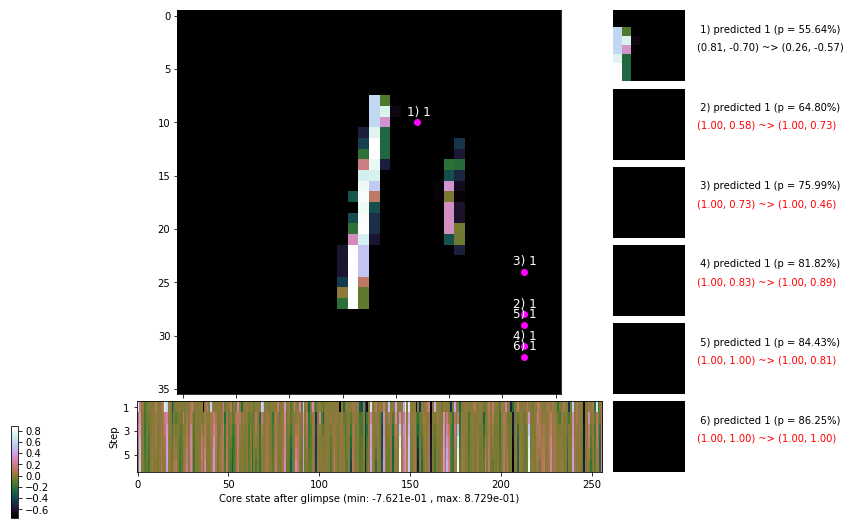

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


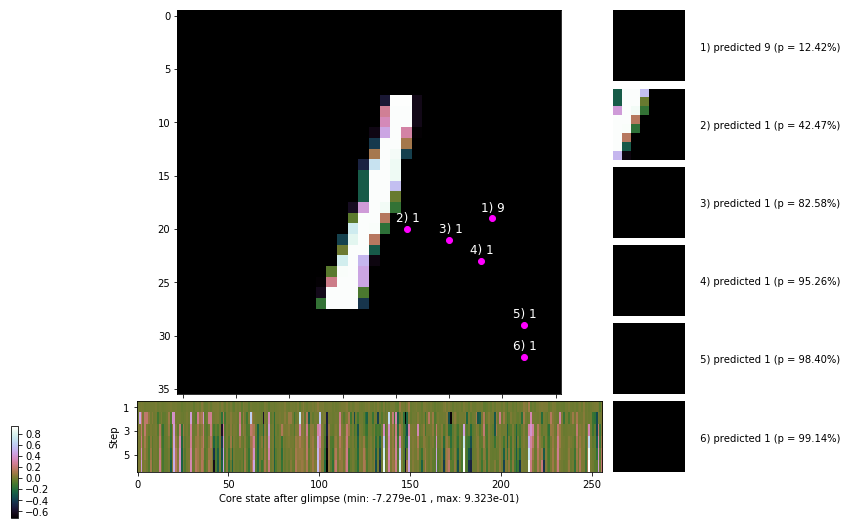


	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


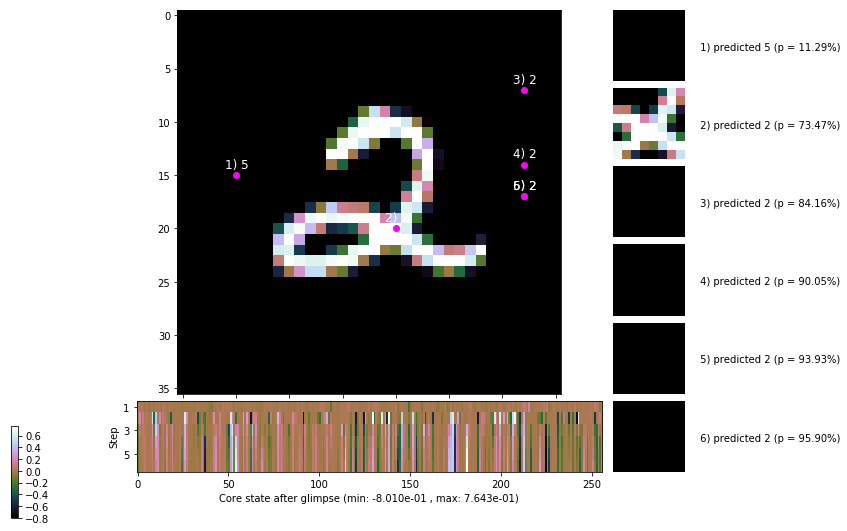

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


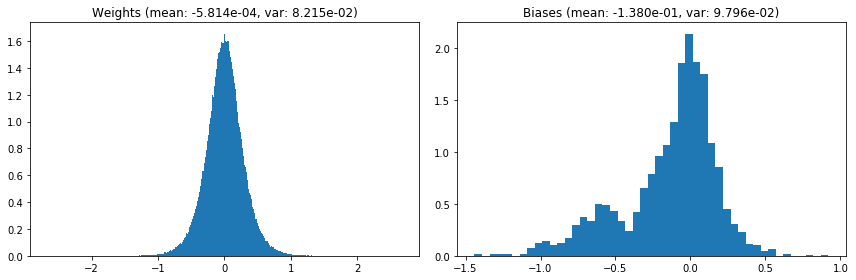

                                      Location network weights and biases


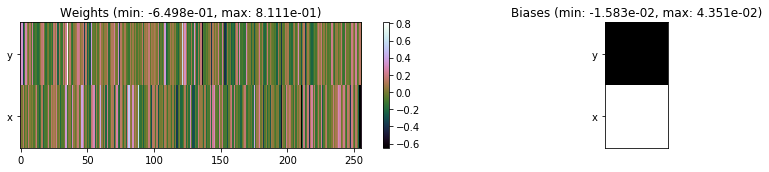

---------------------------------------------------------------------------------------------------------------
Elapsed time:  429.18 sec | TRAIN >> class loss: 0.3397 | steps:  2.220 :( | reward:  3.7277 :( | acc.: 88.692% :(
                          | VAL   >> class loss: 0.3194 | steps:  2.099 :( | reward:  3.9486    | acc.: 89.500% :(


Epoch  70/400) lr = 0.000355
 b    300/  3000 >> 142.8 ms/b | lr: 3.55e-04 | grad 2norm: 13.13 | grad inf norm:  3.848
         Weights || abs max:  2.66 ( 3789.50) | mean: -5.72e-04 ( 0.01) | var: 8.22e-02 (  270.81)
          Biases || abs max:  1.44 (  742.35) | mean: -1.38e-01 ( 0.35) | var: 9.80e-02 (51275.50)
                    class loss: 0.339 | steps: 2.235 | reward:  3.696 | acc.: 88.38%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 143.2 ms/b | lr: 3.54e-04 | grad 2norm: 12.95 | grad inf norm:  3.683
         Weights || abs max:  2.66 ( 2208.86) | mean: -5.61e-04 ( 

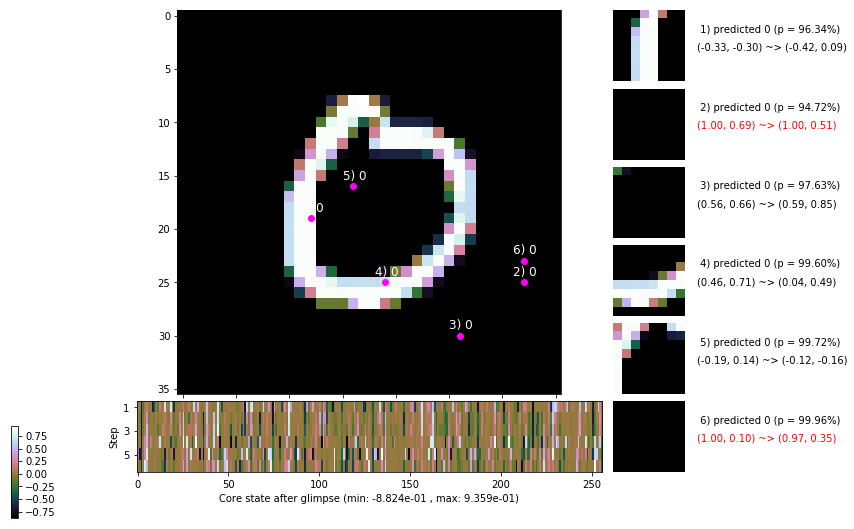

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.5 ms/b | lr: 3.54e-04 | grad 2norm: 13.31 | grad inf norm:  4.059
         Weights || abs max:  2.67 ( 9928.96) | mean: -5.44e-04 ( 0.03) | var: 8.22e-02 (33430.08)
          Biases || abs max:  1.45 (  220.94) | mean: -1.38e-01 ( 0.15) | var: 9.82e-02 (  353.41)
                    class loss: 0.343 | steps: 2.216 | reward:  3.697 | acc.: 88.27%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.5 ms/b | lr: 3.53e-04 | grad 2norm: 12.98 | grad inf norm:  3.702
         Weights || abs max:  2.67 ( 2263.41) | mean: -5.44e-04 ( 0.01) | var: 8.22e-02 (  306.99)
          Biases || abs max:  1.45 ( 1295.65) | mean: -1.38e-01 ( 0.56) | var: 9.83e-02 (162900.55)
                    class loss: 0.336 | steps: 2.215 | reward:  3.729 | acc.: 88.85%

	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.

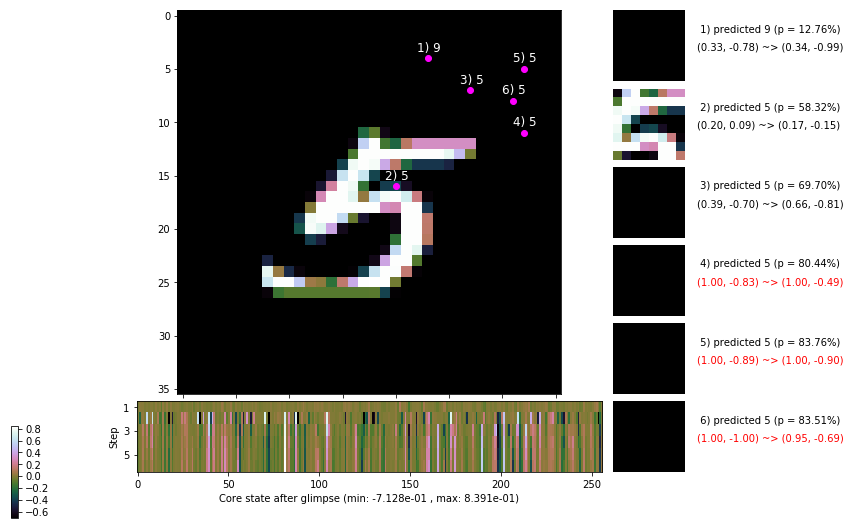

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 151.7 ms/b | lr: 3.53e-04 | grad 2norm: 13.08 | grad inf norm:  3.973
         Weights || abs max:  2.67 (16926.56) | mean: -5.33e-04 ( 0.04) | var: 8.22e-02 (102349.43)
          Biases || abs max:  1.45 (  666.63) | mean: -1.39e-01 ( 0.32) | var: 9.84e-02 ( 1847.01)
                    class loss: 0.337 | steps: 2.213 | reward:  3.744 | acc.: 88.92%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 147.0 ms/b | lr: 3.52e-04 | grad 2norm: 12.86 | grad inf norm:  3.645
         Weights || abs max:  2.68 ( 2620.90) | mean: -5.15e-04 ( 0.01) | var: 8.23e-02 (  161.43)
          Biases || abs max:  1.45 (  330.49) | mean: -1.39e-01 ( 0.21) | var: 9.85e-02 ( 1544.14)
                    class loss: 0.339 | steps: 2.203 | reward:  3.740 | acc.: 88.70%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.

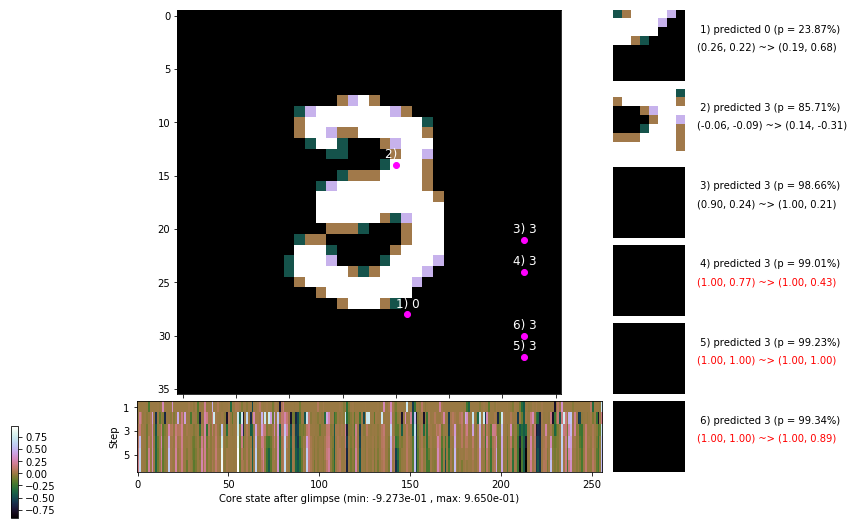

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 151.6 ms/b | lr: 3.52e-04 | grad 2norm: 13.21 | grad inf norm:  3.689
         Weights || abs max:  2.67 ( 1655.83) | mean: -5.22e-04 ( 0.01) | var: 8.23e-02 (   18.80)
          Biases || abs max:  1.45 (  758.98) | mean: -1.38e-01 ( 0.38) | var: 9.84e-02 ( 5776.96)
                    class loss: 0.350 | steps: 2.221 | reward:  3.695 | acc.: 88.02%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.9 ms/b | lr: 3.51e-04 | grad 2norm: 12.86 | grad inf norm:  3.771
         Weights || abs max:  2.67 ( 2775.80) | mean: -5.17e-04 ( 0.01) | var: 8.23e-02 (  138.85)
          Biases || abs max:  1.45 (  151.31) | mean: -1.38e-01 ( 0.12) | var: 9.84e-02 (  205.36)
                    class loss: 0.328 | steps: 2.215 | reward:  3.749 | acc.: 89.17%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

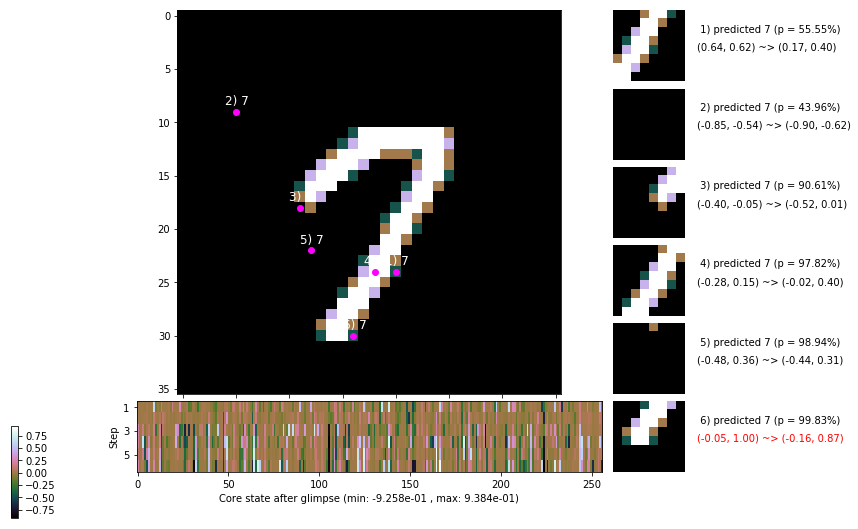

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 140.8 ms/b | lr: 3.50e-04 | grad 2norm: 13.00 | grad inf norm:  4.050
         Weights || abs max:  2.67 ( 4308.47) | mean: -5.07e-04 ( 0.02) | var: 8.24e-02 (  647.95)
          Biases || abs max:  1.45 (  124.53) | mean: -1.38e-01 ( 0.12) | var: 9.83e-02 (  233.50)
                    class loss: 0.331 | steps: 2.215 | reward:  3.738 | acc.: 89.05%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.6 ms/b | lr: 3.50e-04 | grad 2norm: 13.06 | grad inf norm:  4.024
         Weights || abs max:  2.68 ( 5449.97) | mean: -4.88e-04 ( 0.02) | var: 8.24e-02 ( 1877.53)
          Biases || abs max:  1.45 (  115.70) | mean: -1.38e-01 ( 0.12) | var: 9.82e-02 (   43.31)
                    class loss: 0.339 | steps: 2.226 | reward:  3.707 | acc.: 88.85%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

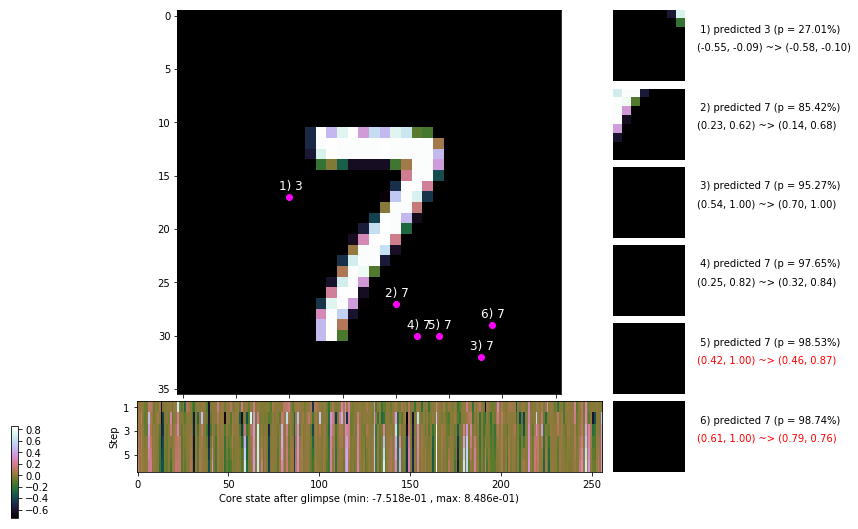

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [-0.844, -0.688, -0.375, 0.250, 1.500, 1.000]


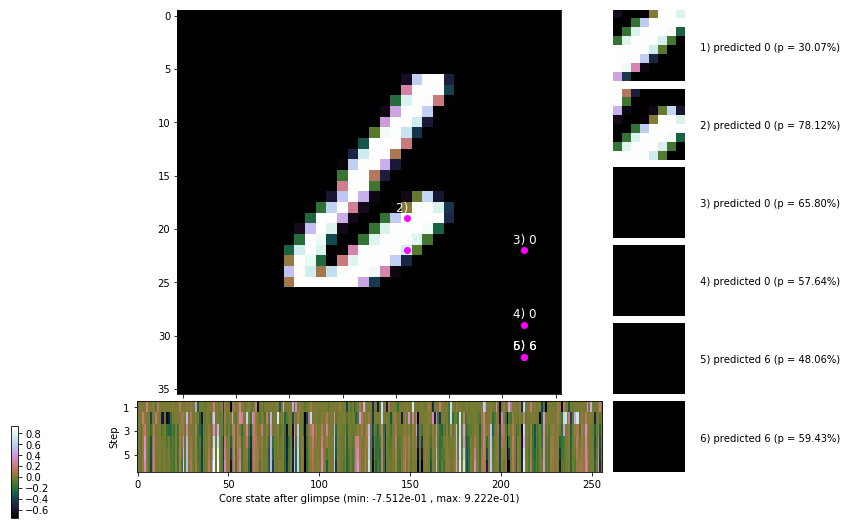


	Target class: 6 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


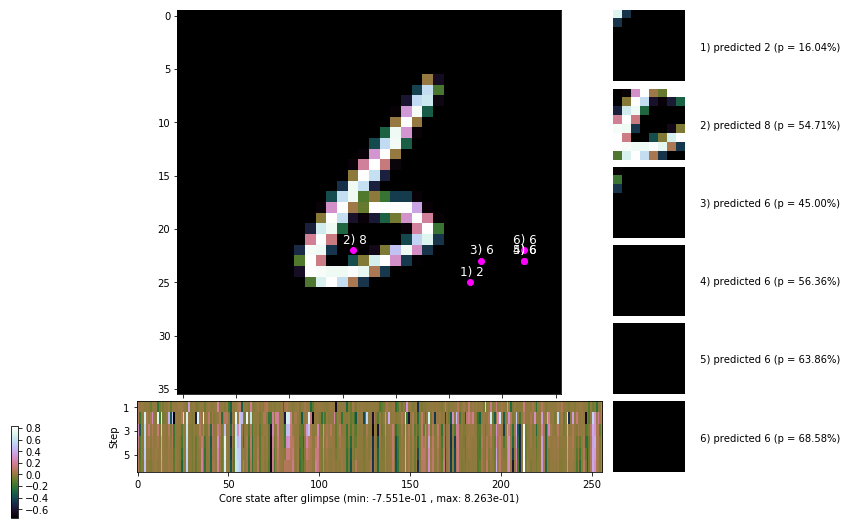

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


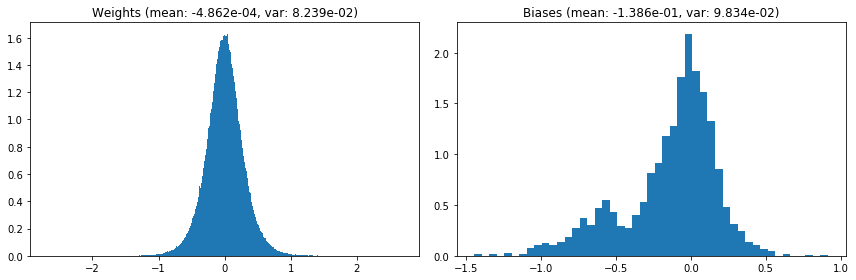

                                      Location network weights and biases


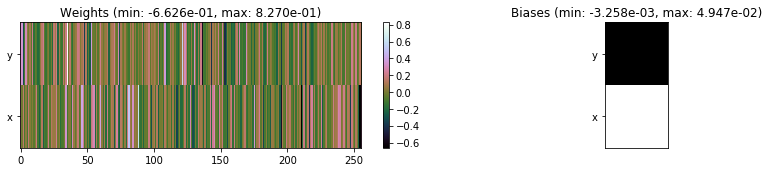

---------------------------------------------------------------------------------------------------------------
Elapsed time:  441.41 sec | TRAIN >> class loss: 0.3389 | steps:  2.219 :( | reward:  3.7197 :( | acc.: 88.622% :(
                          | VAL   >> class loss: 0.3083 | steps:  2.087    | reward:  3.9939    | acc.: 90.120% 


Epoch  71/400) lr = 0.0003498
 b    300/  3000 >> 145.5 ms/b | lr: 3.49e-04 | grad 2norm: 13.37 | grad inf norm:  3.927
         Weights || abs max:  2.68 ( 7580.17) | mean: -5.05e-04 ( 0.02) | var: 8.24e-02 ( 8507.83)
          Biases || abs max:  1.45 (  142.78) | mean: -1.39e-01 ( 0.13) | var: 9.84e-02 (   40.70)
                    class loss: 0.369 | steps: 2.234 | reward:  3.653 | acc.: 87.30%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 148.6 ms/b | lr: 3.49e-04 | grad 2norm: 12.90 | grad inf norm:  3.790
         Weights || abs max:  2.68 ( 2910.78) | mean: -5.11e-04 ( 0

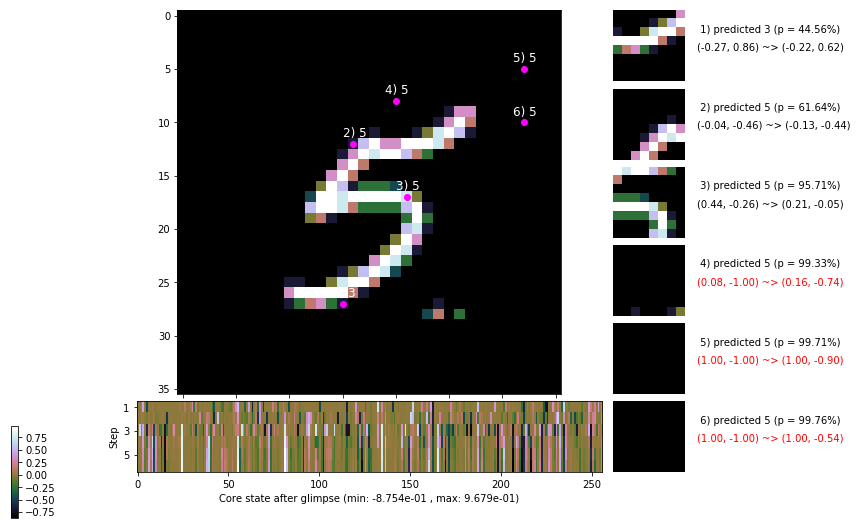

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.4 ms/b | lr: 3.48e-04 | grad 2norm: 12.95 | grad inf norm:  3.856
         Weights || abs max:  2.68 ( 5839.59) | mean: -4.87e-04 ( 0.02) | var: 8.25e-02 ( 6109.02)
          Biases || abs max:  1.45 (  149.92) | mean: -1.38e-01 ( 0.12) | var: 9.83e-02 (  248.86)
                    class loss: 0.338 | steps: 2.223 | reward:  3.724 | acc.: 88.70%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.5 ms/b | lr: 3.48e-04 | grad 2norm: 12.96 | grad inf norm:  3.875
         Weights || abs max:  2.68 ( 5250.55) | mean: -4.79e-04 ( 0.02) | var: 8.25e-02 ( 2112.03)
          Biases || abs max:  1.45 (  156.10) | mean: -1.38e-01 ( 0.12) | var: 9.83e-02 (  347.03)
                    class loss: 0.352 | steps: 2.223 | reward:  3.700 | acc.: 88.02%

	Target class: 5 | Discounted rewards: [-0.281, 0.438, 1.

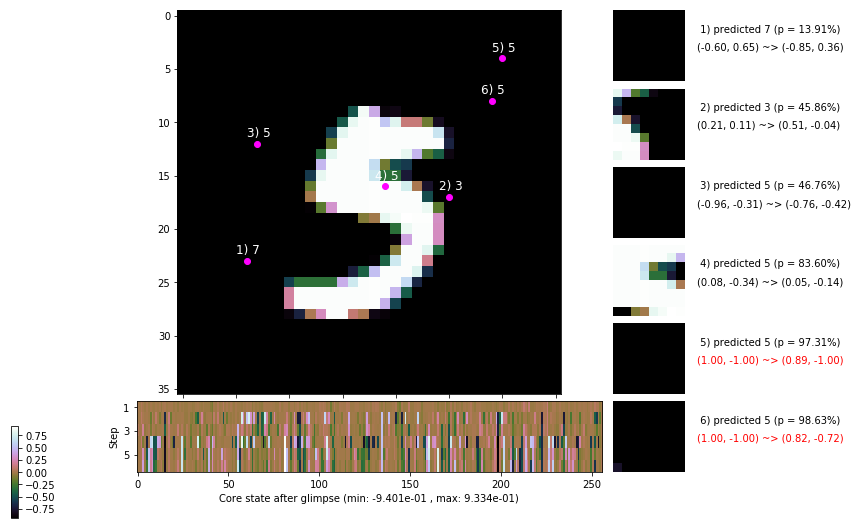

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.9 ms/b | lr: 3.47e-04 | grad 2norm: 13.22 | grad inf norm:  3.879
         Weights || abs max:  2.69 ( 3223.72) | mean: -4.94e-04 ( 0.01) | var: 8.25e-02 (  390.16)
          Biases || abs max:  1.45 (  190.62) | mean: -1.38e-01 ( 0.14) | var: 9.84e-02 (  975.83)
                    class loss: 0.371 | steps: 2.225 | reward:  3.695 | acc.: 87.67%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 140.2 ms/b | lr: 3.47e-04 | grad 2norm: 12.79 | grad inf norm:  3.838
         Weights || abs max:  2.69 ( 6138.32) | mean: -5.21e-04 ( 0.02) | var: 8.25e-02 ( 5126.65)
          Biases || abs max:  1.44 (   93.77) | mean: -1.39e-01 ( 0.09) | var: 9.87e-02 (   65.28)
                    class loss: 0.345 | steps: 2.223 | reward:  3.703 | acc.: 88.08%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

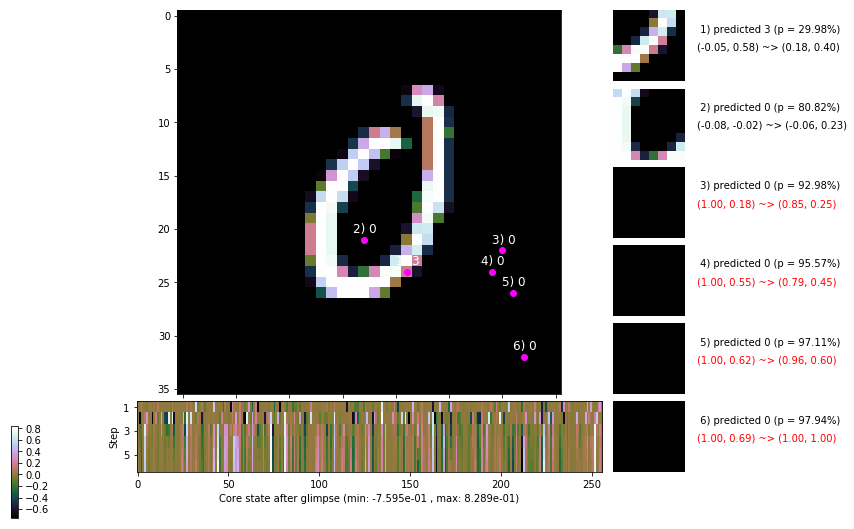

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 145.4 ms/b | lr: 3.46e-04 | grad 2norm: 12.93 | grad inf norm:  3.900
         Weights || abs max:  2.69 ( 2432.51) | mean: -5.14e-04 ( 0.01) | var: 8.25e-02 (  288.18)
          Biases || abs max:  1.45 (   98.05) | mean: -1.39e-01 ( 0.09) | var: 9.88e-02 (   54.54)
                    class loss: 0.350 | steps: 2.242 | reward:  3.673 | acc.: 87.92%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 140.5 ms/b | lr: 3.46e-04 | grad 2norm: 12.93 | grad inf norm:  3.585
         Weights || abs max:  2.69 ( 2132.90) | mean: -4.91e-04 ( 0.01) | var: 8.26e-02 (   99.69)
          Biases || abs max:  1.45 (   98.62) | mean: -1.39e-01 ( 0.11) | var: 9.88e-02 (   29.56)
                    class loss: 0.348 | steps: 2.220 | reward:  3.711 | acc.: 88.22%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

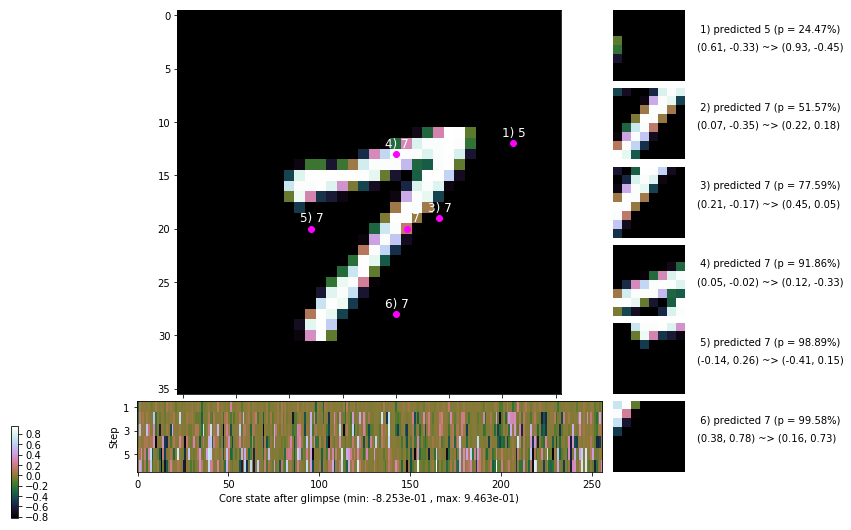

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 138.8 ms/b | lr: 3.45e-04 | grad 2norm: 12.61 | grad inf norm:  3.793
         Weights || abs max:  2.69 ( 3755.69) | mean: -4.89e-04 ( 0.01) | var: 8.26e-02 (  315.11)
          Biases || abs max:  1.45 (  119.05) | mean: -1.39e-01 ( 0.12) | var: 9.88e-02 (   48.92)
                    class loss: 0.331 | steps: 2.189 | reward:  3.773 | acc.: 88.95%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.3 ms/b | lr: 3.45e-04 | grad 2norm: 13.00 | grad inf norm:  4.017
         Weights || abs max:  2.69 ( 2039.84) | mean: -4.96e-04 ( 0.01) | var: 8.26e-02 (  257.93)
          Biases || abs max:  1.45 (  137.60) | mean: -1.38e-01 ( 0.11) | var: 9.87e-02 (  195.06)
                    class loss: 0.337 | steps: 2.195 | reward:  3.757 | acc.: 88.73%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.8

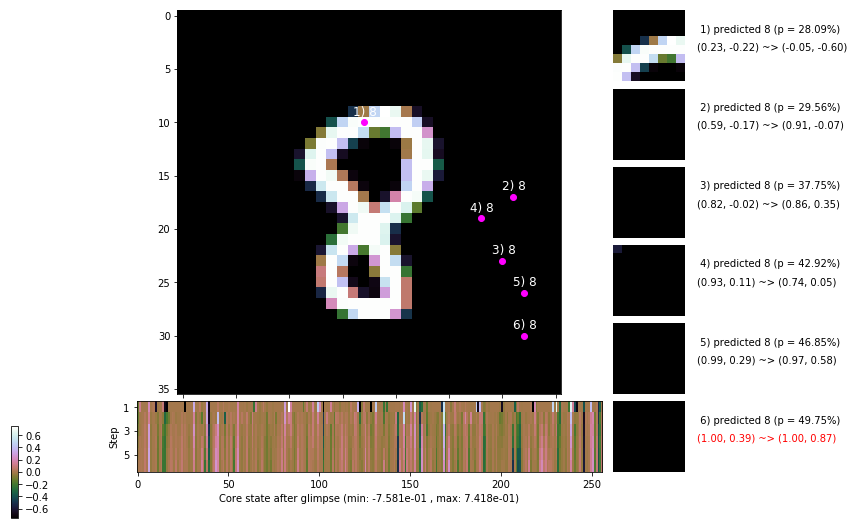

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


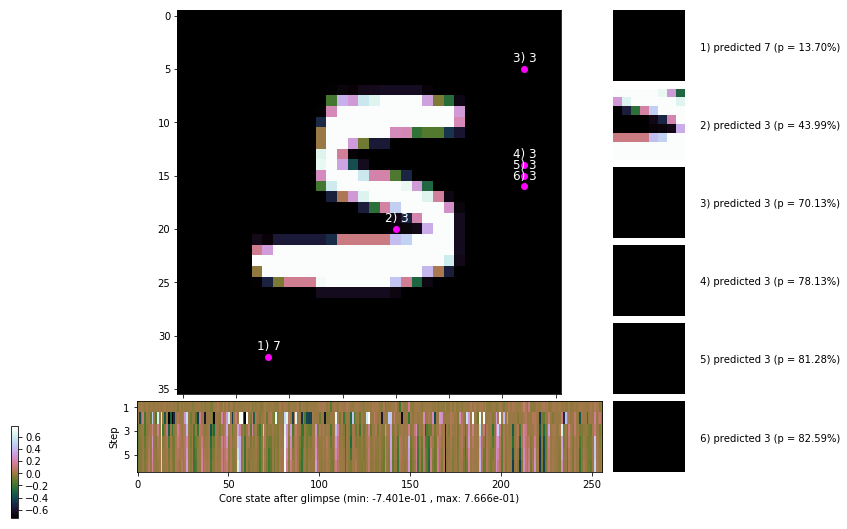


	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


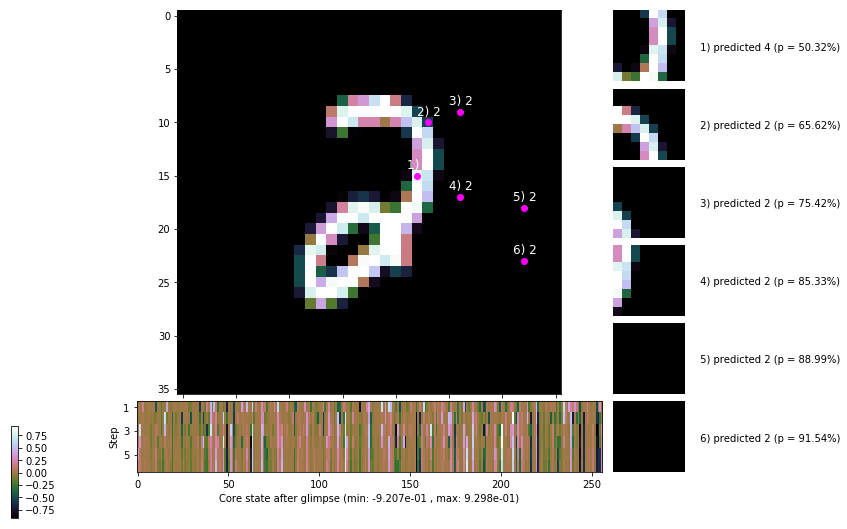

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


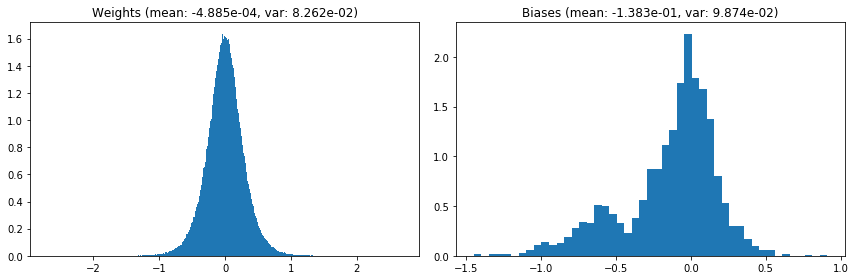

                                      Location network weights and biases


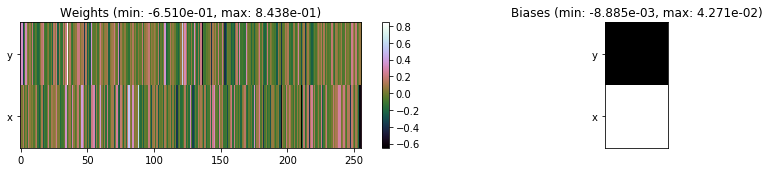

---------------------------------------------------------------------------------------------------------------
Elapsed time:  429.36 sec | TRAIN >> class loss: 0.3480 | steps:  2.217 :( | reward:  3.7138 :( | acc.: 88.207% :(
                          | VAL   >> class loss: 0.3161 | steps:  2.084    | reward:  3.9513 :( | acc.: 89.080% :(


Epoch  72/400) lr = 0.0003445
 b    300/  3000 >> 142.6 ms/b | lr: 3.44e-04 | grad 2norm: 13.02 | grad inf norm:  3.929
         Weights || abs max:  2.69 ( 2477.45) | mean: -4.88e-04 ( 0.01) | var: 8.26e-02 (   93.12)
          Biases || abs max:  1.45 (  164.03) | mean: -1.39e-01 ( 0.13) | var: 9.89e-02 (  775.16)
                    class loss: 0.345 | steps: 2.212 | reward:  3.722 | acc.: 88.17%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 138.3 ms/b | lr: 3.44e-04 | grad 2norm: 12.65 | grad inf norm:  3.825
         Weights || abs max:  2.69 ( 5061.84) | mean: -4.84e-04 (

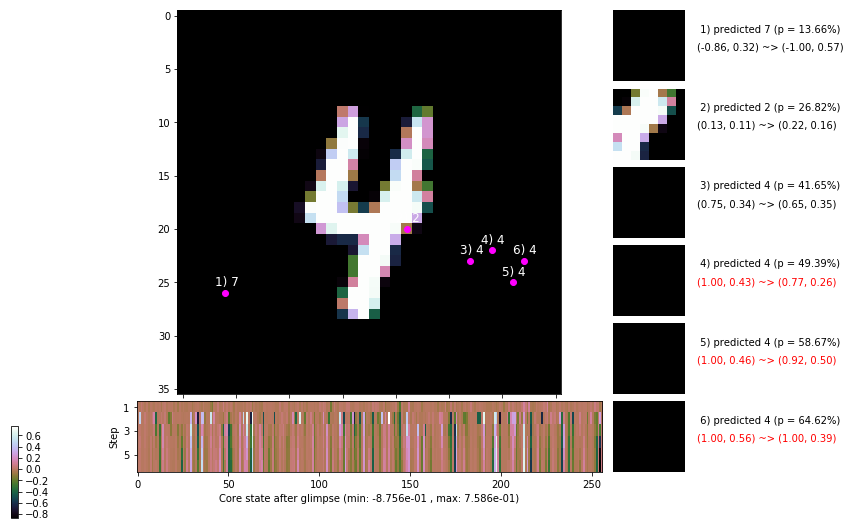

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.9 ms/b | lr: 3.43e-04 | grad 2norm: 12.48 | grad inf norm:  3.756
         Weights || abs max:  2.69 ( 2864.87) | mean: -4.86e-04 ( 0.01) | var: 8.27e-02 (  341.56)
          Biases || abs max:  1.45 (   96.71) | mean: -1.39e-01 ( 0.11) | var: 9.89e-02 (   90.96)
                    class loss: 0.347 | steps: 2.215 | reward:  3.749 | acc.: 88.38%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.2 ms/b | lr: 3.43e-04 | grad 2norm: 12.86 | grad inf norm:  3.802
         Weights || abs max:  2.68 ( 2264.44) | mean: -4.92e-04 ( 0.01) | var: 8.27e-02 (  159.57)
          Biases || abs max:  1.45 (  112.10) | mean: -1.39e-01 ( 0.11) | var: 9.88e-02 (   49.10)
                    class loss: 0.342 | steps: 2.239 | reward:  3.723 | acc.: 88.13%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

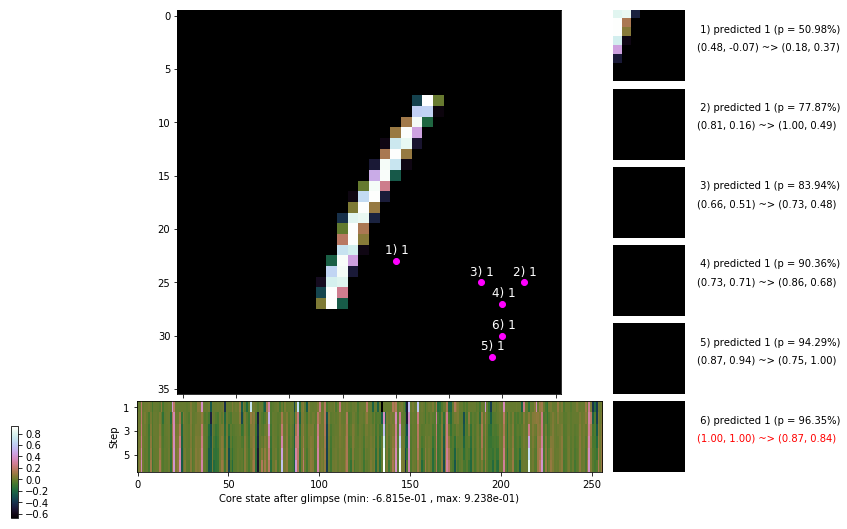

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.8 ms/b | lr: 3.42e-04 | grad 2norm: 12.92 | grad inf norm:  3.928
         Weights || abs max:  2.68 ( 3180.56) | mean: -4.98e-04 ( 0.01) | var: 8.27e-02 (  186.28)
          Biases || abs max:  1.46 (  259.81) | mean: -1.39e-01 ( 0.17) | var: 9.88e-02 ( 1121.33)
                    class loss: 0.360 | steps: 2.223 | reward:  3.711 | acc.: 88.27%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.6 ms/b | lr: 3.42e-04 | grad 2norm: 13.10 | grad inf norm:  3.944
         Weights || abs max:  2.68 ( 8678.38) | mean: -5.05e-04 ( 0.02) | var: 8.28e-02 ( 4010.21)
          Biases || abs max:  1.46 (  188.21) | mean: -1.39e-01 ( 0.16) | var: 9.88e-02 (  649.89)
                    class loss: 0.379 | steps: 2.246 | reward:  3.662 | acc.: 87.57%

	Target class: 1 | Discounted rewards: [1.219, 0.438, 1.8

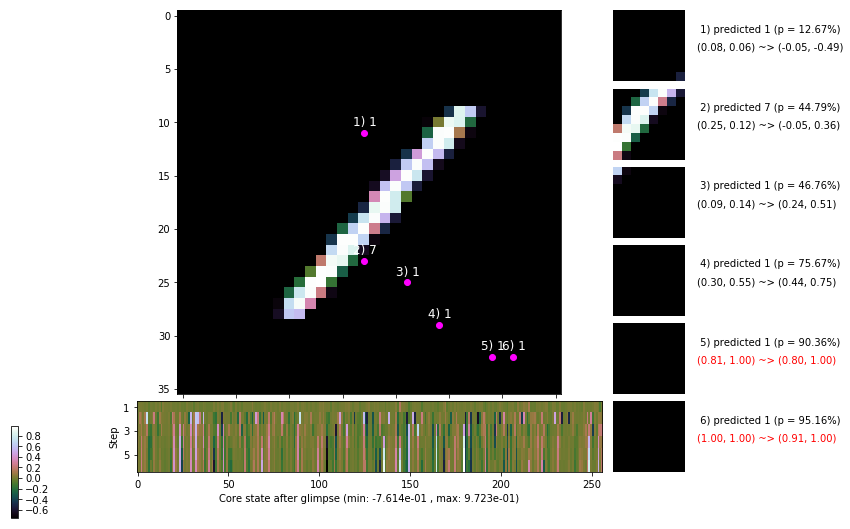

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.9 ms/b | lr: 3.41e-04 | grad 2norm: 12.80 | grad inf norm:  3.787
         Weights || abs max:  2.69 ( 3452.31) | mean: -4.94e-04 ( 0.01) | var: 8.28e-02 (  690.40)
          Biases || abs max:  1.46 (  112.18) | mean: -1.39e-01 ( 0.11) | var: 9.89e-02 (  304.85)
                    class loss: 0.340 | steps: 2.194 | reward:  3.728 | acc.: 88.28%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 140.2 ms/b | lr: 3.41e-04 | grad 2norm: 13.16 | grad inf norm:  3.891
         Weights || abs max:  2.69 ( 2222.18) | mean: -4.89e-04 ( 0.01) | var: 8.28e-02 (  139.79)
          Biases || abs max:  1.46 (  128.59) | mean: -1.39e-01 ( 0.11) | var: 9.89e-02 (  392.64)
                    class loss: 0.357 | steps: 2.207 | reward:  3.712 | acc.: 87.67%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

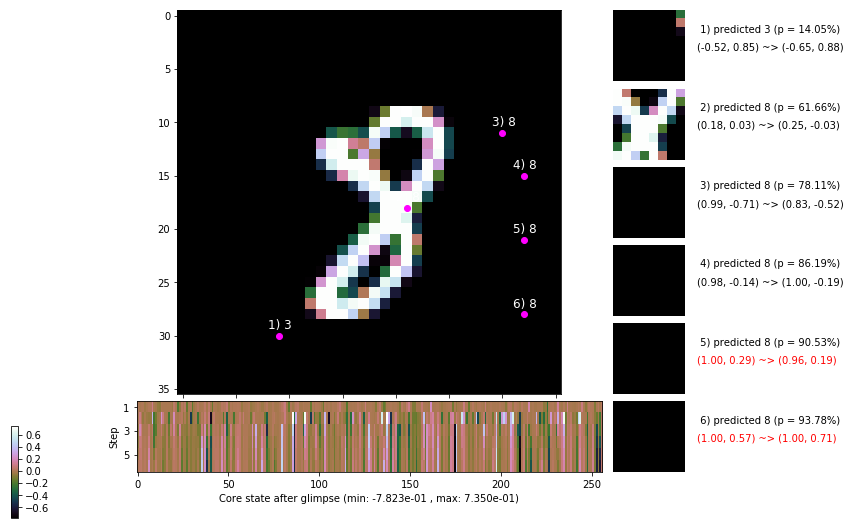

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.1 ms/b | lr: 3.40e-04 | grad 2norm: 13.10 | grad inf norm:  3.846
         Weights || abs max:  2.70 ( 2219.44) | mean: -4.74e-04 ( 0.01) | var: 8.28e-02 (   97.03)
          Biases || abs max:  1.46 (  114.76) | mean: -1.39e-01 ( 0.11) | var: 9.90e-02 (  261.69)
                    class loss: 0.364 | steps: 2.248 | reward:  3.646 | acc.: 87.85%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.7 ms/b | lr: 3.40e-04 | grad 2norm: 12.71 | grad inf norm:  3.849
         Weights || abs max:  2.71 ( 9101.55) | mean: -4.63e-04 ( 0.02) | var: 8.29e-02 (15077.68)
          Biases || abs max:  1.46 (   67.05) | mean: -1.39e-01 ( 0.08) | var: 9.90e-02 (   12.72)
                    class loss: 0.332 | steps: 2.199 | reward:  3.751 | acc.: 89.05%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

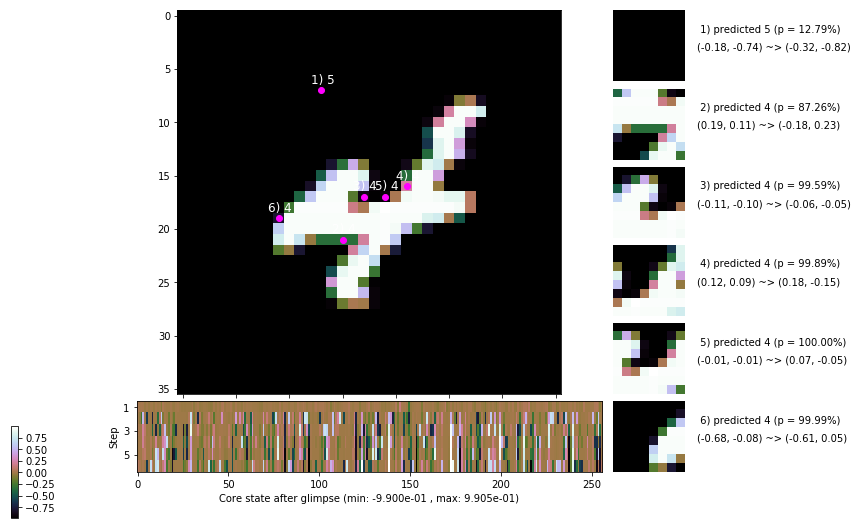

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


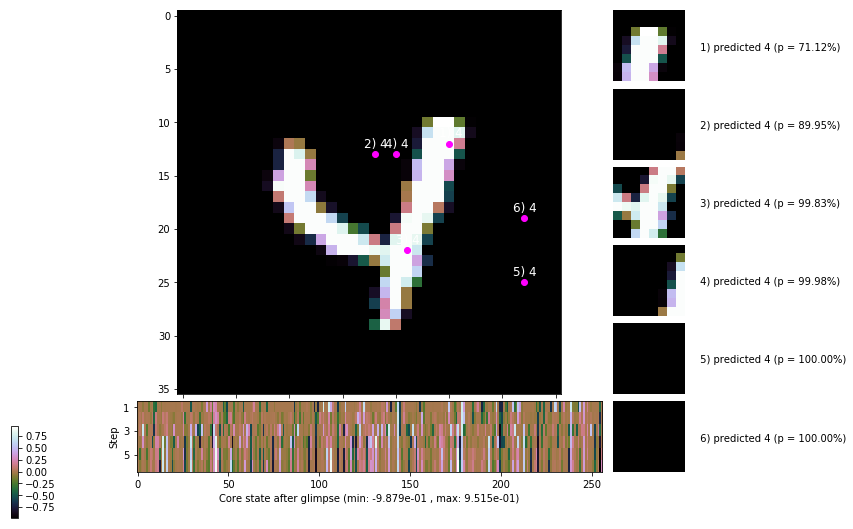


	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


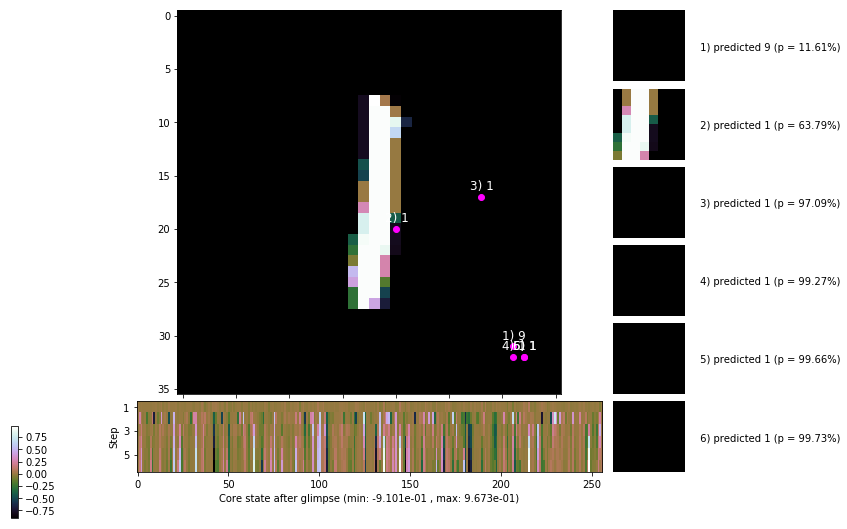

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


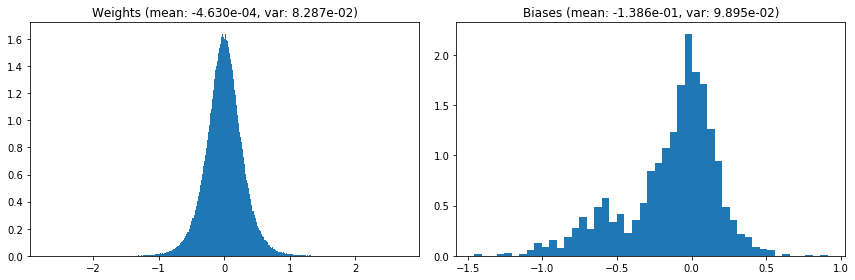

                                      Location network weights and biases


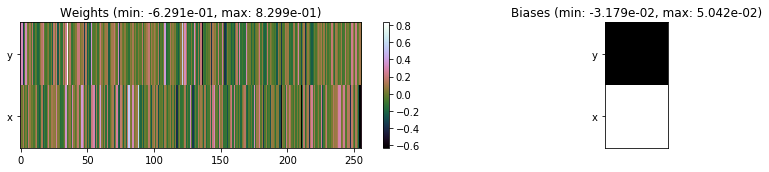

---------------------------------------------------------------------------------------------------------------
Elapsed time:  428.13 sec | TRAIN >> class loss: 0.3524 | steps:  2.217 :( | reward:  3.7168 :( | acc.: 88.197% :(
                          | VAL   >> class loss: 0.3155 | steps:  2.105 :( | reward:  3.9441 :( | acc.: 89.620% :(


Epoch  73/400) lr = 0.0003394
 b    300/  3000 >> 142.1 ms/b | lr: 3.39e-04 | grad 2norm: 12.94 | grad inf norm:  3.853
         Weights || abs max:  2.71 ( 3949.27) | mean: -4.49e-04 ( 0.01) | var: 8.29e-02 ( 1949.37)
          Biases || abs max:  1.46 (  293.76) | mean: -1.39e-01 ( 0.19) | var: 9.89e-02 ( 2278.89)
                    class loss: 0.358 | steps: 2.212 | reward:  3.740 | acc.: 88.17%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 140.4 ms/b | lr: 3.39e-04 | grad 2norm: 12.91 | grad inf norm:  3.798
         Weights || abs max:  2.70 ( 5154.71) | mean: -4.45e-04 (

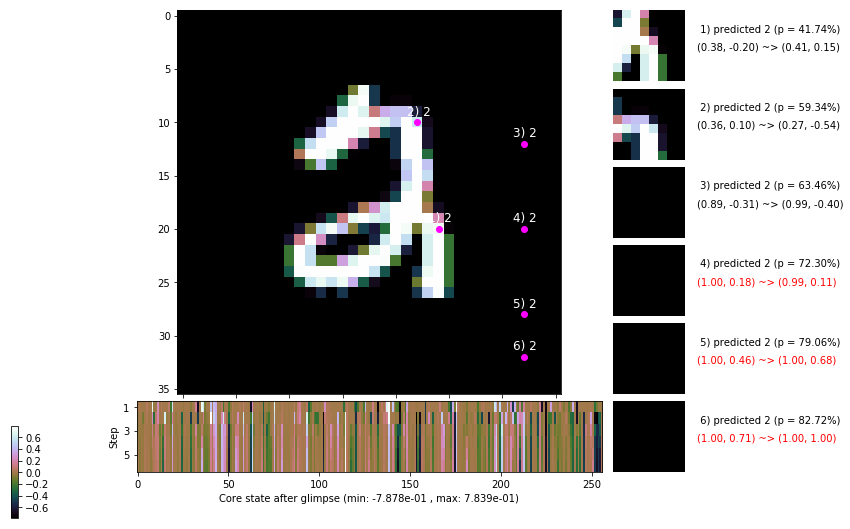

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 142.4 ms/b | lr: 3.38e-04 | grad 2norm: 12.61 | grad inf norm:  3.716
         Weights || abs max:  2.71 ( 3307.25) | mean: -4.36e-04 ( 0.01) | var: 8.29e-02 (  221.31)
          Biases || abs max:  1.46 (  102.25) | mean: -1.38e-01 ( 0.11) | var: 9.88e-02 (   27.74)
                    class loss: 0.323 | steps: 2.173 | reward:  3.811 | acc.: 89.12%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.5 ms/b | lr: 3.38e-04 | grad 2norm: 12.78 | grad inf norm:  3.639
         Weights || abs max:  2.70 ( 5120.24) | mean: -4.44e-04 ( 0.02) | var: 8.30e-02 ( 6985.92)
          Biases || abs max:  1.46 (  112.68) | mean: -1.38e-01 ( 0.12) | var: 9.88e-02 (   99.54)
                    class loss: 0.331 | steps: 2.183 | reward:  3.755 | acc.: 88.82%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

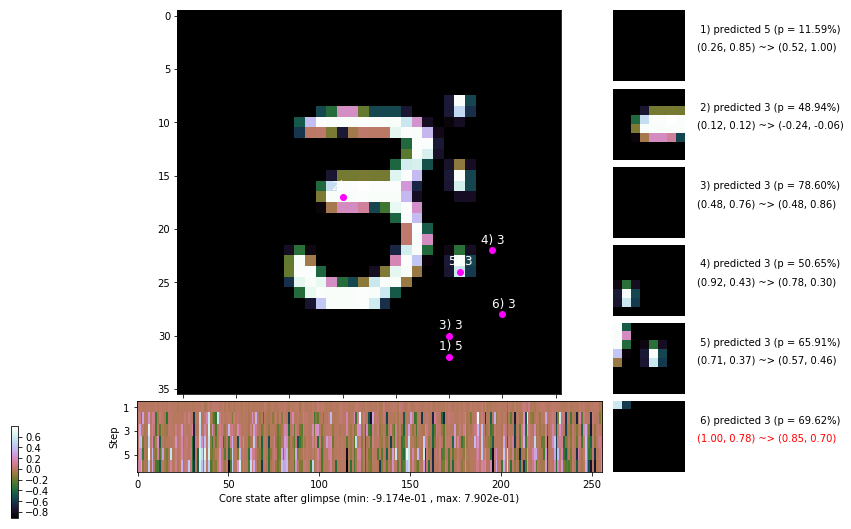

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.3 ms/b | lr: 3.37e-04 | grad 2norm: 13.02 | grad inf norm:  3.775
         Weights || abs max:  2.70 ( 6061.13) | mean: -4.50e-04 ( 0.02) | var: 8.30e-02 ( 8058.35)
          Biases || abs max:  1.46 (  922.02) | mean: -1.38e-01 ( 0.43) | var: 9.88e-02 (44830.51)
                    class loss: 0.350 | steps: 2.229 | reward:  3.698 | acc.: 88.17%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 139.2 ms/b | lr: 3.37e-04 | grad 2norm: 12.84 | grad inf norm:  3.905
         Weights || abs max:  2.70 ( 3274.57) | mean: -4.48e-04 ( 0.01) | var: 8.30e-02 (  406.79)
          Biases || abs max:  1.45 (   82.42) | mean: -1.39e-01 ( 0.09) | var: 9.89e-02 (  135.77)
                    class loss: 0.345 | steps: 2.195 | reward:  3.773 | acc.: 88.48%

	Target class: 2 | Discounted rewards: [-0.281, 0.438, 1.

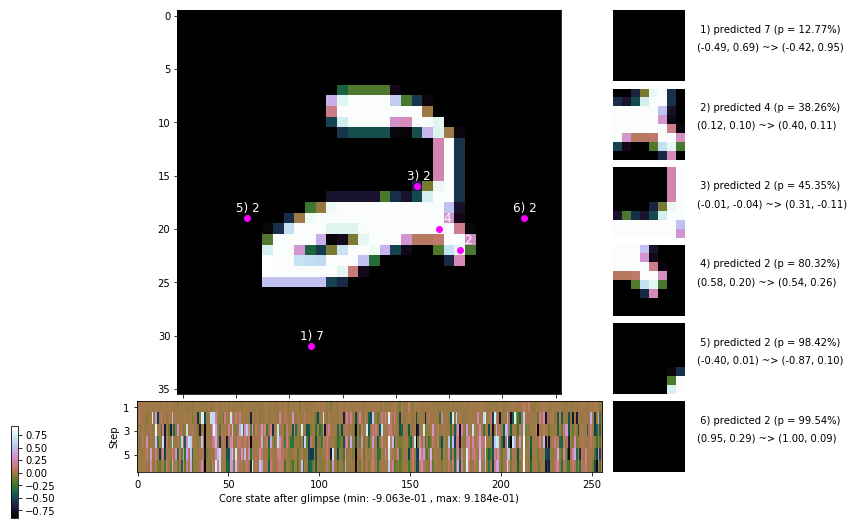

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.7 ms/b | lr: 3.36e-04 | grad 2norm: 12.55 | grad inf norm:  3.568
         Weights || abs max:  2.70 ( 3950.00) | mean: -4.44e-04 ( 0.01) | var: 8.30e-02 (  777.93)
          Biases || abs max:  1.46 (  191.31) | mean: -1.39e-01 ( 0.15) | var: 9.90e-02 (  394.69)
                    class loss: 0.346 | steps: 2.223 | reward:  3.703 | acc.: 88.30%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 141.4 ms/b | lr: 3.36e-04 | grad 2norm: 12.68 | grad inf norm:  3.667
         Weights || abs max:  2.71 ( 2796.39) | mean: -4.31e-04 ( 0.01) | var: 8.31e-02 (   66.08)
          Biases || abs max:  1.46 (  117.13) | mean: -1.39e-01 ( 0.11) | var: 9.90e-02 (   72.25)
                    class loss: 0.351 | steps: 2.234 | reward:  3.702 | acc.: 88.20%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

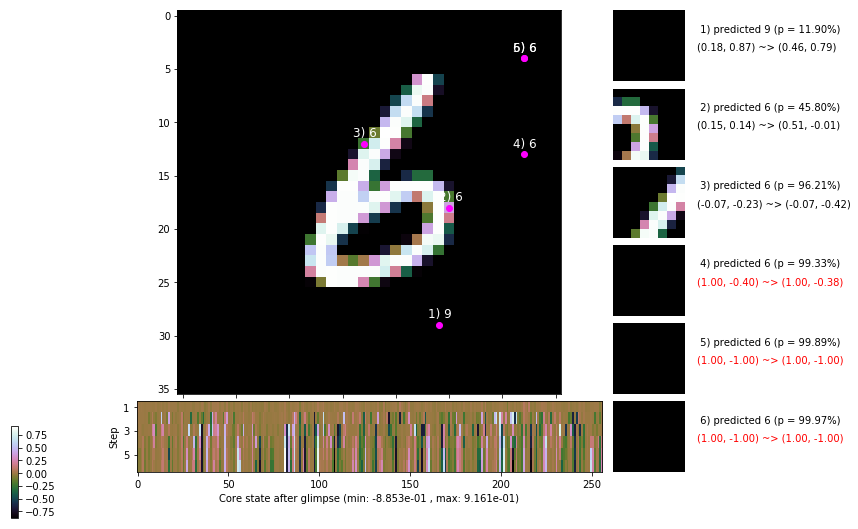

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 142.4 ms/b | lr: 3.35e-04 | grad 2norm: 12.76 | grad inf norm:  3.732
         Weights || abs max:  2.70 ( 3290.04) | mean: -4.17e-04 ( 0.01) | var: 8.31e-02 (  235.48)
          Biases || abs max:  1.46 (   86.64) | mean: -1.39e-01 ( 0.09) | var: 9.91e-02 (   26.51)
                    class loss: 0.343 | steps: 2.198 | reward:  3.756 | acc.: 88.70%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 139.0 ms/b | lr: 3.35e-04 | grad 2norm: 12.72 | grad inf norm:  3.844
         Weights || abs max:  2.71 ( 3680.62) | mean: -4.15e-04 ( 0.01) | var: 8.31e-02 (  526.67)
          Biases || abs max:  1.47 (  276.02) | mean: -1.39e-01 ( 0.19) | var: 9.91e-02 ( 1662.75)
                    class loss: 0.328 | steps: 2.200 | reward:  3.758 | acc.: 89.02%

	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.8

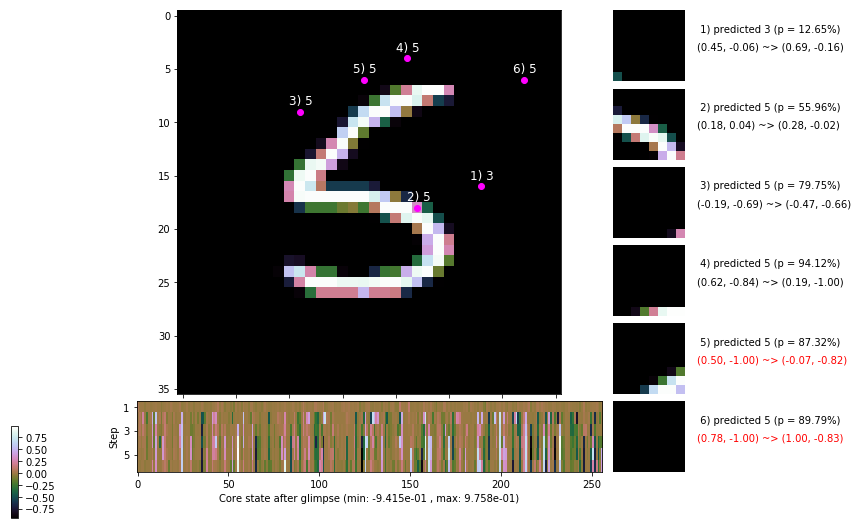

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


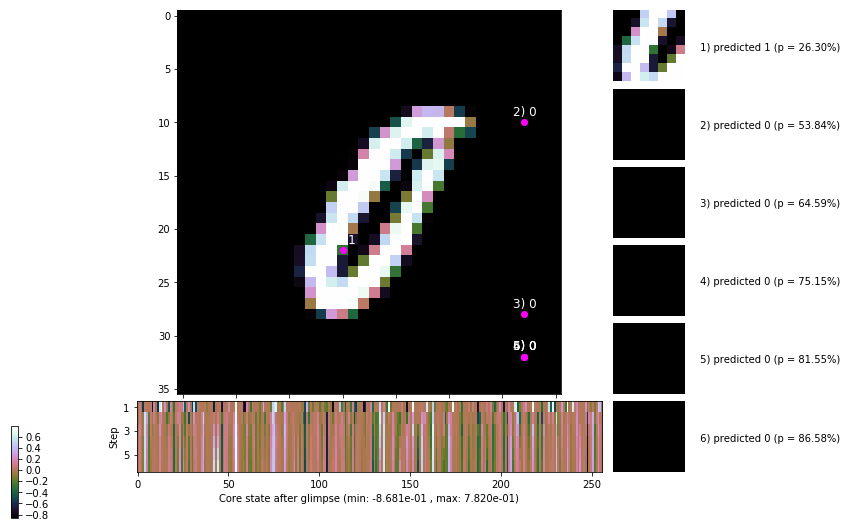


	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


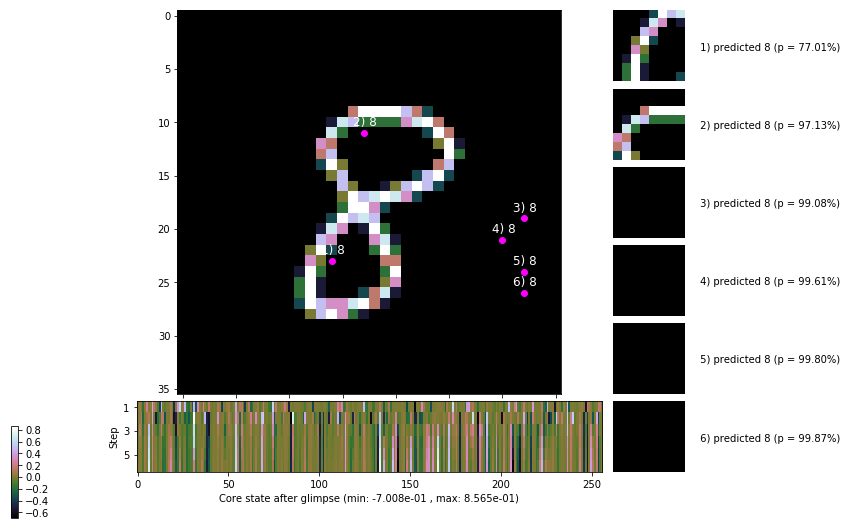

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


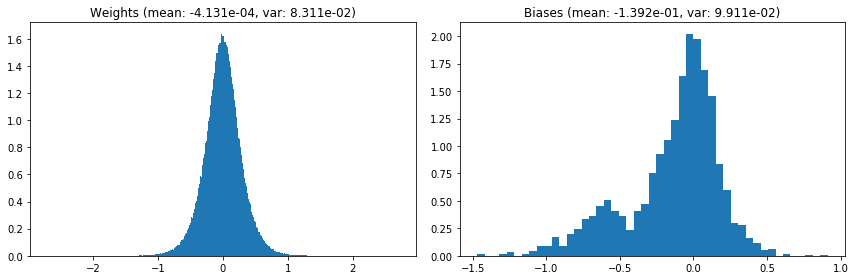

                                      Location network weights and biases


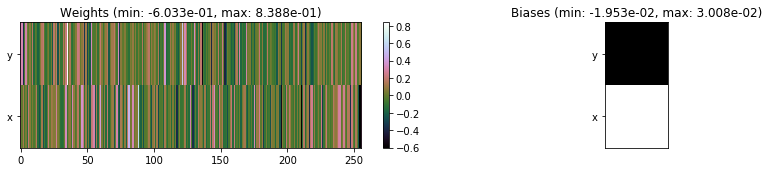

---------------------------------------------------------------------------------------------------------------
Elapsed time:  426.31 sec | TRAIN >> class loss: 0.3415 | steps:  2.206    | reward:  3.7431    | acc.: 88.562% :(
                          | VAL   >> class loss: 0.2927 | steps:  2.096 :( | reward:  3.9702 :( | acc.: 90.220% 


Epoch  74/400) lr = 0.0003344
 b    300/  3000 >> 141.1 ms/b | lr: 3.34e-04 | grad 2norm: 12.65 | grad inf norm:  3.743
         Weights || abs max:  2.71 ( 3219.12) | mean: -4.15e-04 ( 0.01) | var: 8.31e-02 (  398.42)
          Biases || abs max:  1.47 (  126.70) | mean: -1.39e-01 ( 0.12) | var: 9.90e-02 (   38.77)
                    class loss: 0.331 | steps: 2.227 | reward:  3.698 | acc.: 88.53%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 139.4 ms/b | lr: 3.34e-04 | grad 2norm: 12.24 | grad inf norm:  3.604
         Weights || abs max:  2.70 ( 2924.59) | mean: -4.15e-04 ( 0

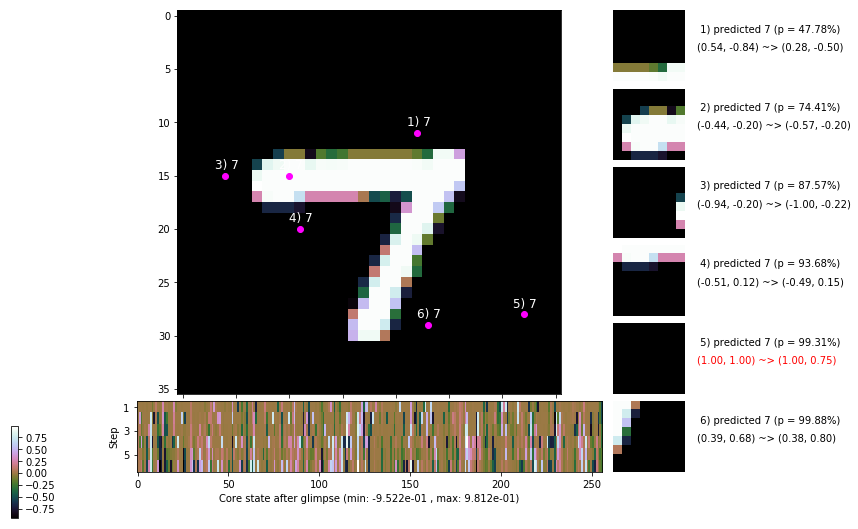

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 145.8 ms/b | lr: 3.33e-04 | grad 2norm: 13.11 | grad inf norm:  3.926
         Weights || abs max:  2.71 ( 2308.16) | mean: -4.04e-04 ( 0.01) | var: 8.32e-02 (   47.11)
          Biases || abs max:  1.47 (  121.75) | mean: -1.39e-01 ( 0.13) | var: 9.90e-02 (  335.23)
                    class loss: 0.344 | steps: 2.219 | reward:  3.711 | acc.: 88.35%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.2 ms/b | lr: 3.33e-04 | grad 2norm: 12.92 | grad inf norm:  3.744
         Weights || abs max:  2.71 ( 8353.30) | mean: -4.11e-04 ( 0.02) | var: 8.32e-02 (15220.89)
          Biases || abs max:  1.47 (   75.38) | mean: -1.39e-01 ( 0.09) | var: 9.90e-02 (   28.78)
                    class loss: 0.336 | steps: 2.202 | reward:  3.750 | acc.: 88.52%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

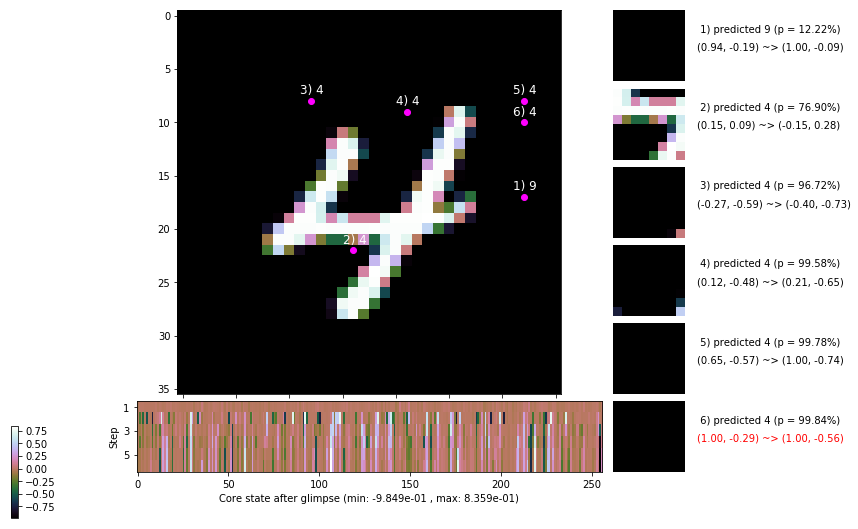

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.0 ms/b | lr: 3.32e-04 | grad 2norm: 12.83 | grad inf norm:  3.747
         Weights || abs max:  2.71 ( 8934.12) | mean: -4.00e-04 ( 0.02) | var: 8.32e-02 (14169.70)
          Biases || abs max:  1.47 (   83.44) | mean: -1.39e-01 ( 0.10) | var: 9.90e-02 (   33.22)
                    class loss: 0.332 | steps: 2.230 | reward:  3.728 | acc.: 89.32%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 148.1 ms/b | lr: 3.32e-04 | grad 2norm: 13.06 | grad inf norm:  3.949
         Weights || abs max:  2.71 ( 7362.19) | mean: -4.03e-04 ( 0.02) | var: 8.32e-02 ( 6347.71)
          Biases || abs max:  1.46 (  133.71) | mean: -1.39e-01 ( 0.12) | var: 9.91e-02 (   78.02)
                    class loss: 0.334 | steps: 2.207 | reward:  3.733 | acc.: 89.02%

	Target class: 9 | Discounted rewards: [-0.984, -0.969, -

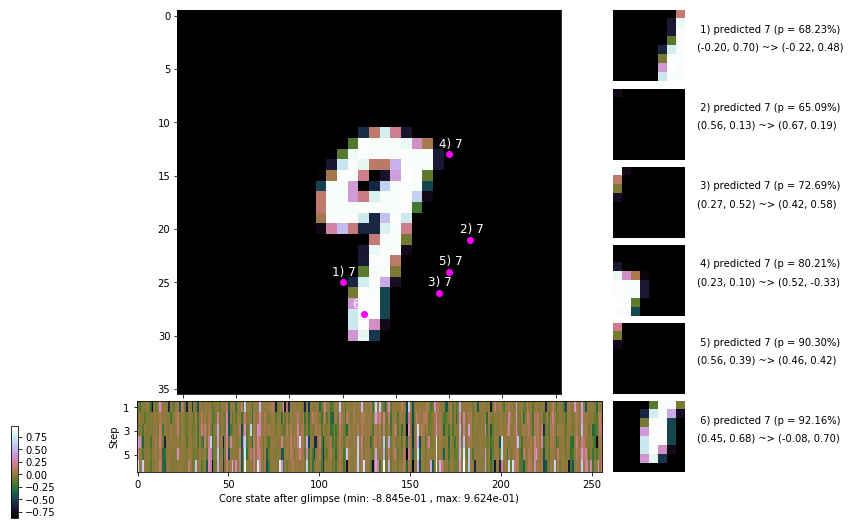

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.2 ms/b | lr: 3.31e-04 | grad 2norm: 12.72 | grad inf norm:  3.934
         Weights || abs max:  2.71 ( 1492.22) | mean: -4.08e-04 ( 0.01) | var: 8.33e-02 (   28.52)
          Biases || abs max:  1.46 (  142.03) | mean: -1.39e-01 ( 0.13) | var: 9.92e-02 (   74.40)
                    class loss: 0.341 | steps: 2.190 | reward:  3.760 | acc.: 88.67%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.5 ms/b | lr: 3.31e-04 | grad 2norm: 12.79 | grad inf norm:  3.767
         Weights || abs max:  2.72 ( 2968.71) | mean: -4.17e-04 ( 0.01) | var: 8.33e-02 (  481.57)
          Biases || abs max:  1.46 (  230.22) | mean: -1.39e-01 ( 0.15) | var: 9.93e-02 (  739.09)
                    class loss: 0.326 | steps: 2.198 | reward:  3.772 | acc.: 89.17%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

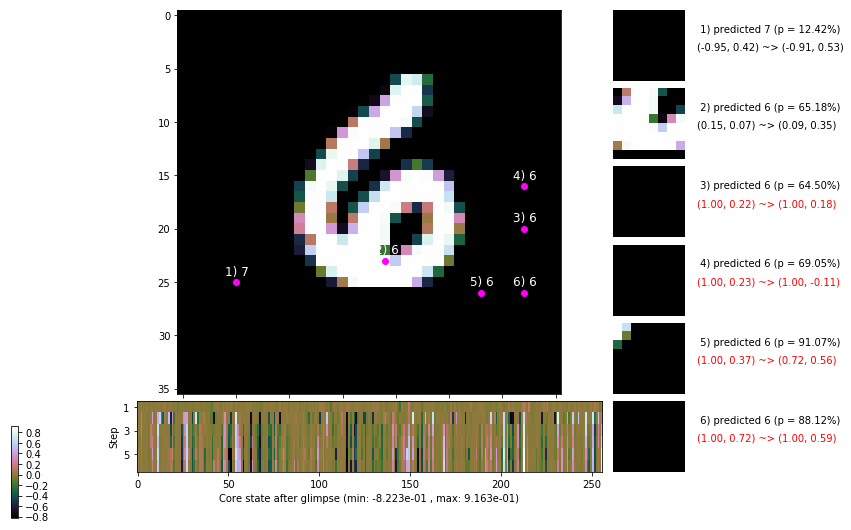

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 139.8 ms/b | lr: 3.30e-04 | grad 2norm: 13.00 | grad inf norm:  3.824
         Weights || abs max:  2.72 ( 3871.45) | mean: -4.33e-04 ( 0.01) | var: 8.33e-02 (  727.91)
          Biases || abs max:  1.46 (  217.27) | mean: -1.39e-01 ( 0.14) | var: 9.92e-02 (  666.81)
                    class loss: 0.337 | steps: 2.219 | reward:  3.725 | acc.: 88.40%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.5 ms/b | lr: 3.30e-04 | grad 2norm: 12.26 | grad inf norm:  3.705
         Weights || abs max:  2.72 ( 2151.67) | mean: -4.22e-04 ( 0.01) | var: 8.33e-02 (   50.64)
          Biases || abs max:  1.46 (   82.20) | mean: -1.39e-01 ( 0.09) | var: 9.92e-02 (  132.65)
                    class loss: 0.318 | steps: 2.183 | reward:  3.801 | acc.: 88.93%

	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.8

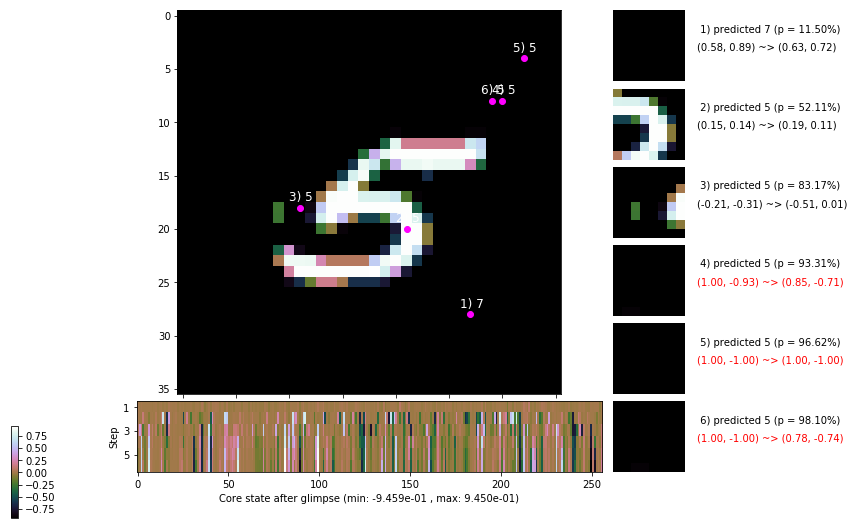

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


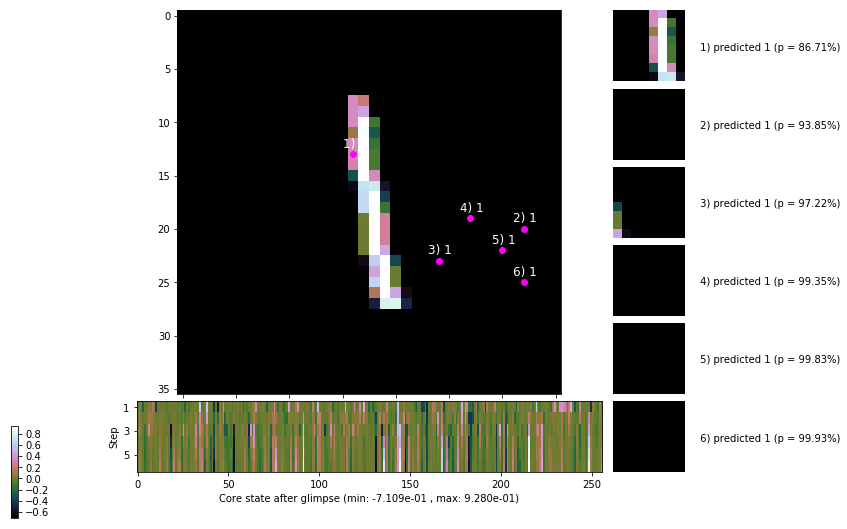


	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


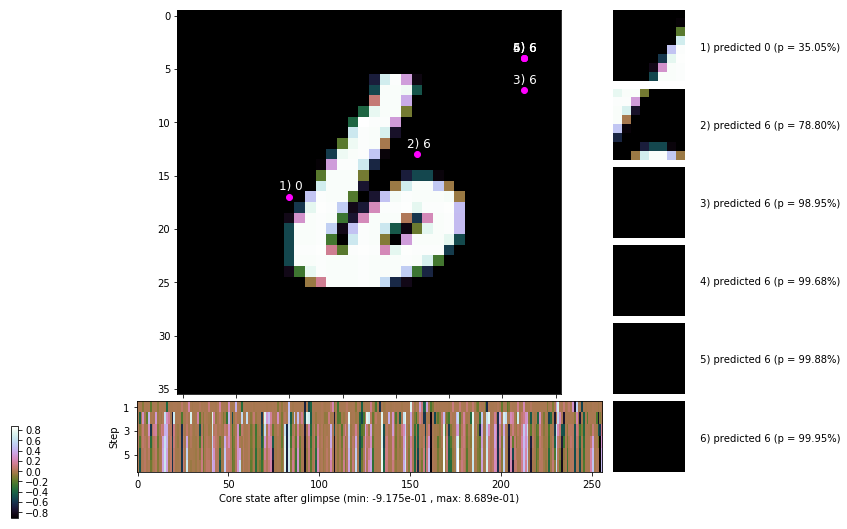

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


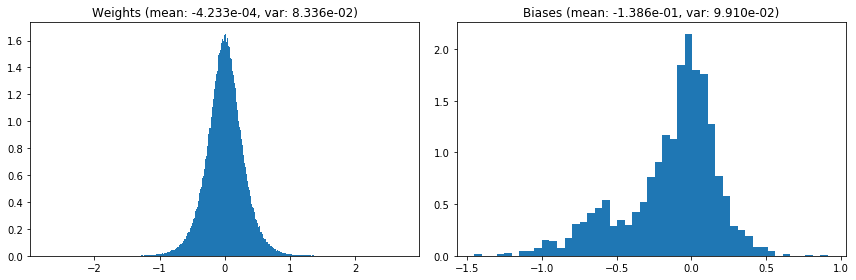

                                      Location network weights and biases


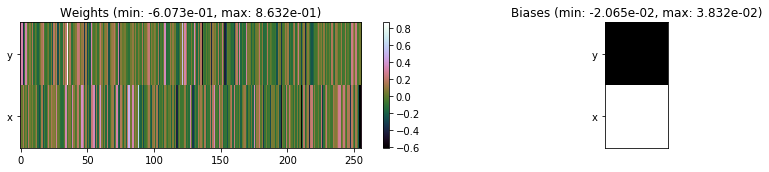

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.40 sec | TRAIN >> class loss: 0.3306 | steps:  2.205    | reward:  3.7509    | acc.: 88.873% :(
                          | VAL   >> class loss: 0.3107 | steps:  2.096 :( | reward:  3.9453 :( | acc.: 89.600% :(


Epoch  75/400) lr = 0.0003294
 b    300/  3000 >> 140.6 ms/b | lr: 3.29e-04 | grad 2norm: 12.68 | grad inf norm:  3.700
         Weights || abs max:  2.72 ( 2212.57) | mean: -4.25e-04 ( 0.01) | var: 8.34e-02 (  104.21)
          Biases || abs max:  1.45 (   92.86) | mean: -1.39e-01 ( 0.10) | var: 9.92e-02 (   86.96)
                    class loss: 0.339 | steps: 2.210 | reward:  3.739 | acc.: 88.57%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 139.8 ms/b | lr: 3.29e-04 | grad 2norm: 12.46 | grad inf norm:  3.750
         Weights || abs max:  2.72 ( 1874.40) | mean: -4.37e-04 (

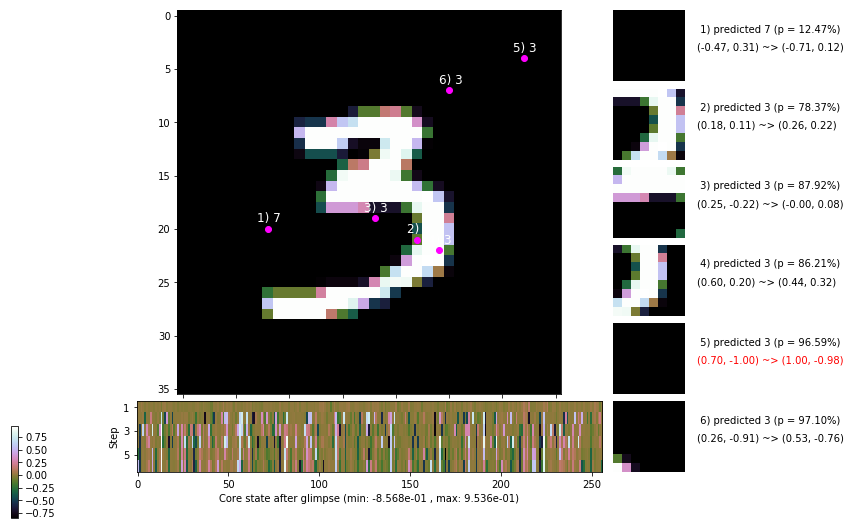

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 147.8 ms/b | lr: 3.28e-04 | grad 2norm: 12.65 | grad inf norm:  3.658
         Weights || abs max:  2.72 ( 1651.96) | mean: -4.47e-04 ( 0.01) | var: 8.34e-02 (   40.08)
          Biases || abs max:  1.46 (  237.58) | mean: -1.39e-01 ( 0.16) | var: 9.92e-02 ( 1268.54)
                    class loss: 0.337 | steps: 2.204 | reward:  3.762 | acc.: 88.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 140.0 ms/b | lr: 3.28e-04 | grad 2norm: 12.67 | grad inf norm:  3.646
         Weights || abs max:  2.72 (20710.49) | mean: -4.34e-04 ( 0.05) | var: 8.34e-02 (178559.91)
          Biases || abs max:  1.46 (  244.92) | mean: -1.39e-01 ( 0.17) | var: 9.93e-02 (  597.62)
                    class loss: 0.321 | steps: 2.203 | reward:  3.760 | acc.: 88.92%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.

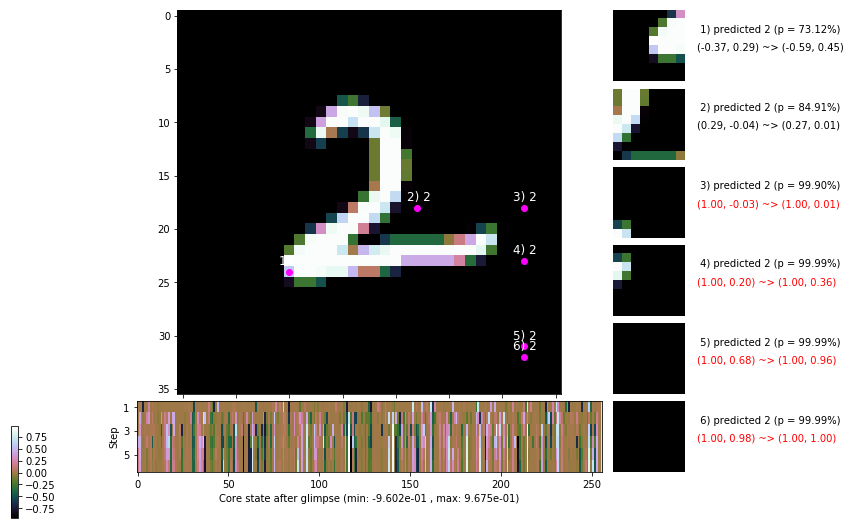

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.6 ms/b | lr: 3.27e-04 | grad 2norm: 12.89 | grad inf norm:  3.808
         Weights || abs max:  2.72 ( 8972.21) | mean: -4.22e-04 ( 0.02) | var: 8.35e-02 ( 9431.19)
          Biases || abs max:  1.46 (  173.09) | mean: -1.39e-01 ( 0.13) | var: 9.93e-02 (  232.53)
                    class loss: 0.341 | steps: 2.236 | reward:  3.704 | acc.: 88.62%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.7 ms/b | lr: 3.27e-04 | grad 2norm: 12.66 | grad inf norm:  3.748
         Weights || abs max:  2.72 ( 5137.45) | mean: -4.18e-04 ( 0.02) | var: 8.35e-02 ( 2664.44)
          Biases || abs max:  1.46 (   77.57) | mean: -1.39e-01 ( 0.10) | var: 9.92e-02 (   30.25)
                    class loss: 0.330 | steps: 2.199 | reward:  3.752 | acc.: 88.95%

	Target class: 8 | Discounted rewards: [0.094, 1.188, 0.3

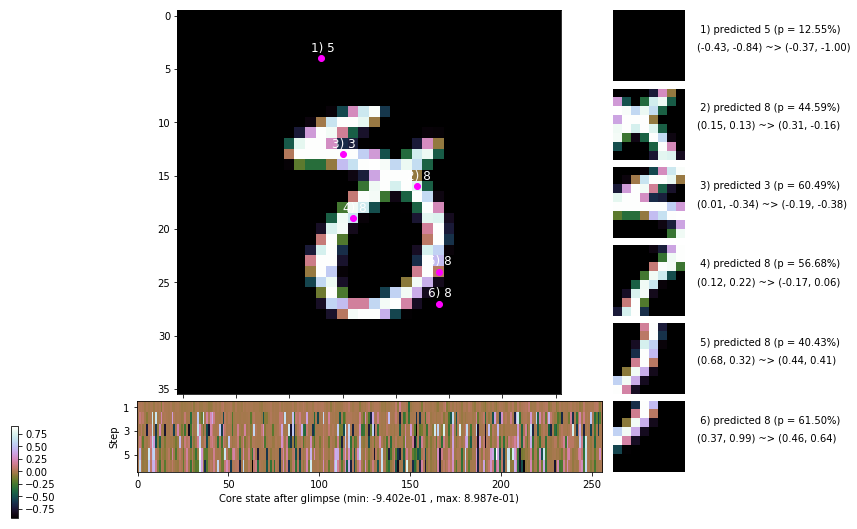

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.8 ms/b | lr: 3.26e-04 | grad 2norm: 12.98 | grad inf norm:  4.107
         Weights || abs max:  2.72 ( 2121.07) | mean: -4.04e-04 ( 0.01) | var: 8.35e-02 (   86.97)
          Biases || abs max:  1.46 (   50.95) | mean: -1.39e-01 ( 0.07) | var: 9.92e-02 (    6.56)
                    class loss: 0.351 | steps: 2.213 | reward:  3.736 | acc.: 88.38%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 138.4 ms/b | lr: 3.26e-04 | grad 2norm: 12.91 | grad inf norm:  3.821
         Weights || abs max:  2.72 ( 2934.58) | mean: -4.14e-04 ( 0.01) | var: 8.35e-02 (  462.97)
          Biases || abs max:  1.46 (   97.86) | mean: -1.39e-01 ( 0.10) | var: 9.92e-02 (   44.21)
                    class loss: 0.336 | steps: 2.201 | reward:  3.748 | acc.: 88.60%

	Target class: 9 | Discounted rewards: [-0.281, 0.438, 1.

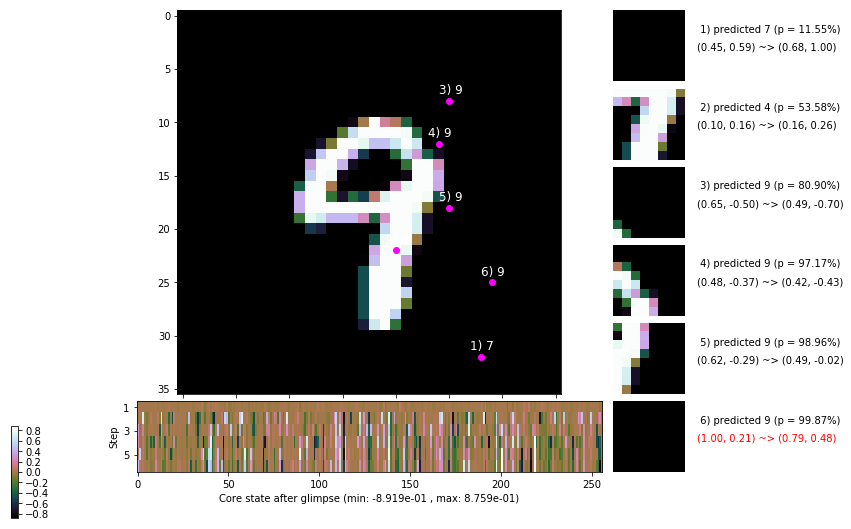

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.8 ms/b | lr: 3.25e-04 | grad 2norm: 12.66 | grad inf norm:  3.759
         Weights || abs max:  2.72 ( 1240.30) | mean: -4.34e-04 ( 0.01) | var: 8.36e-02 (   27.03)
          Biases || abs max:  1.46 (   78.01) | mean: -1.39e-01 ( 0.10) | var: 9.92e-02 (   19.92)
                    class loss: 0.333 | steps: 2.226 | reward:  3.727 | acc.: 88.48%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.9 ms/b | lr: 3.25e-04 | grad 2norm: 13.02 | grad inf norm:  3.994
         Weights || abs max:  2.72 ( 3946.04) | mean: -4.27e-04 ( 0.01) | var: 8.36e-02 (  674.14)
          Biases || abs max:  1.46 (   48.57) | mean: -1.39e-01 ( 0.08) | var: 9.92e-02 (    7.48)
                    class loss: 0.344 | steps: 2.212 | reward:  3.733 | acc.: 88.10%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

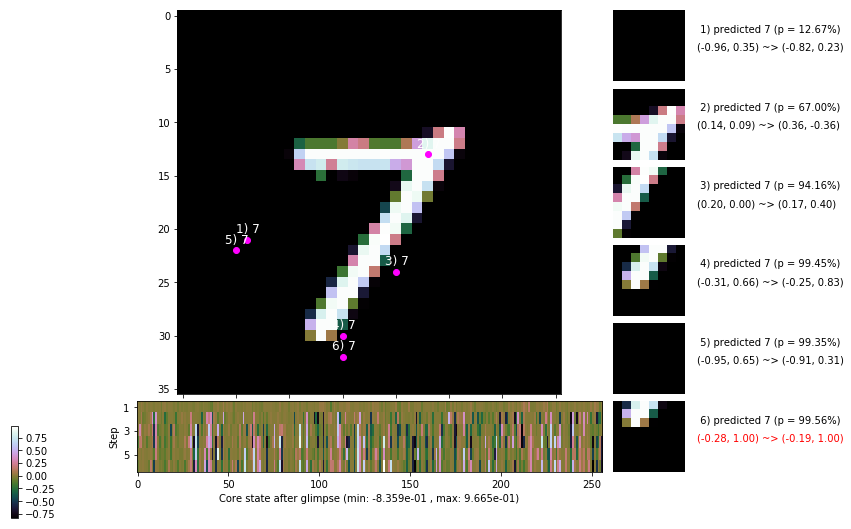

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


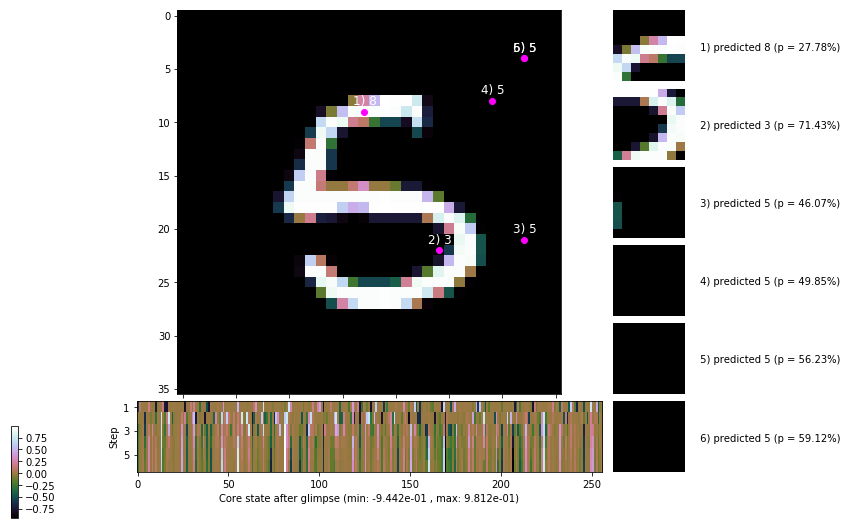


	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


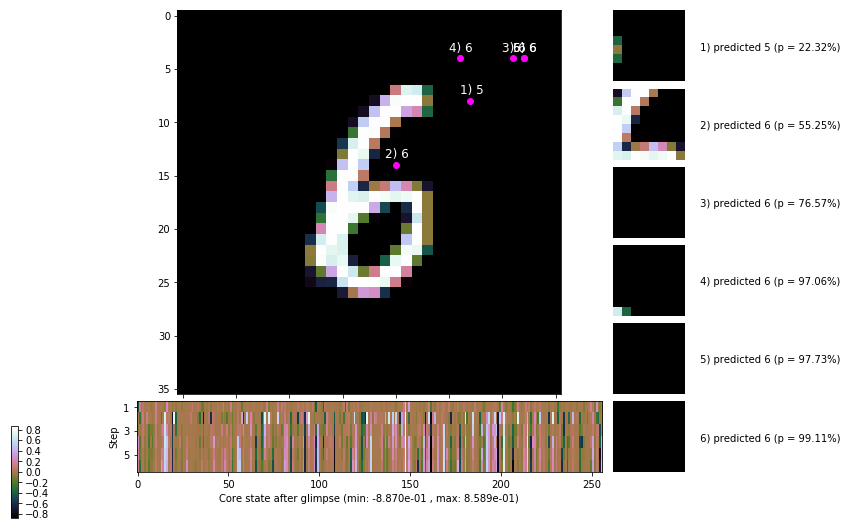

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


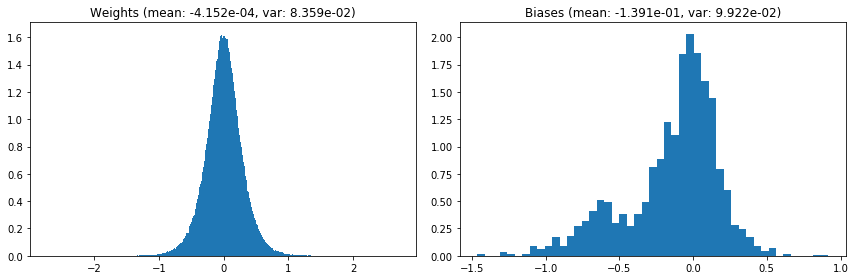

                                      Location network weights and biases


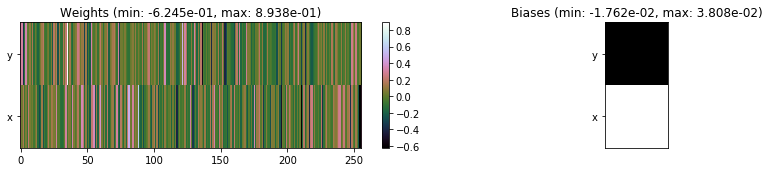

---------------------------------------------------------------------------------------------------------------
Elapsed time:  428.73 sec | TRAIN >> class loss: 0.3357 | steps:  2.209 :( | reward:  3.7451 :( | acc.: 88.698% :(
                          | VAL   >> class loss: 0.3134 | steps:  2.116 :( | reward:  3.9453 :( | acc.: 89.440% :(


Epoch  76/400) lr = 0.0003245
 b    300/  3000 >> 143.8 ms/b | lr: 3.24e-04 | grad 2norm: 12.70 | grad inf norm:  3.753
         Weights || abs max:  2.72 (34916.68) | mean: -4.26e-04 ( 0.07) | var: 8.36e-02 (617735.38)
          Biases || abs max:  1.46 (  160.27) | mean: -1.39e-01 ( 0.13) | var: 9.92e-02 (  583.76)
                    class loss: 0.335 | steps: 2.191 | reward:  3.784 | acc.: 89.25%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.6 ms/b | lr: 3.24e-04 | grad 2norm: 12.90 | grad inf norm:  3.858
         Weights || abs max:  2.73 ( 3235.95) | mean: -4.31e-04 

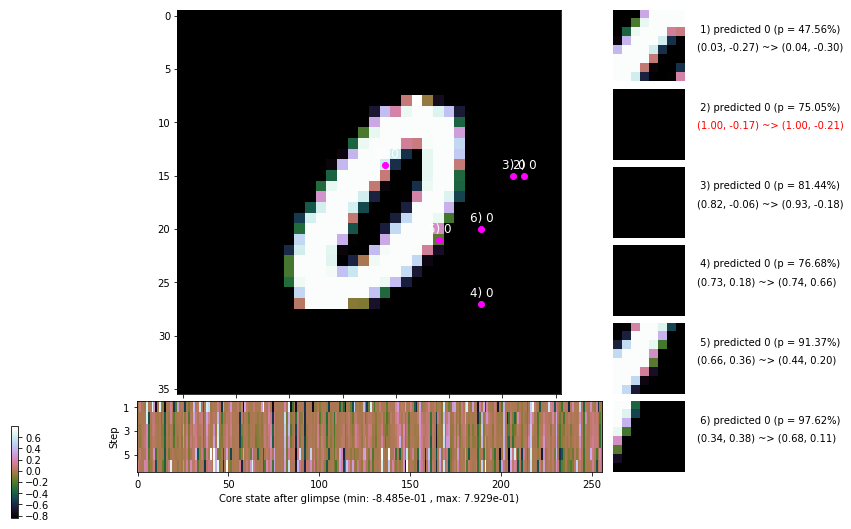

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.1 ms/b | lr: 3.23e-04 | grad 2norm: 13.19 | grad inf norm:  3.847
         Weights || abs max:  2.74 ( 2211.71) | mean: -4.26e-04 ( 0.01) | var: 8.36e-02 (  420.51)
          Biases || abs max:  1.45 (  103.95) | mean: -1.40e-01 ( 0.10) | var: 9.94e-02 (   78.68)
                    class loss: 0.358 | steps: 2.241 | reward:  3.684 | acc.: 87.80%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 148.2 ms/b | lr: 3.23e-04 | grad 2norm: 13.07 | grad inf norm:  3.939
         Weights || abs max:  2.74 ( 1787.53) | mean: -4.28e-04 ( 0.01) | var: 8.37e-02 (  105.85)
          Biases || abs max:  1.46 (  215.38) | mean: -1.40e-01 ( 0.15) | var: 9.94e-02 ( 1257.58)
                    class loss: 0.349 | steps: 2.212 | reward:  3.724 | acc.: 88.13%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

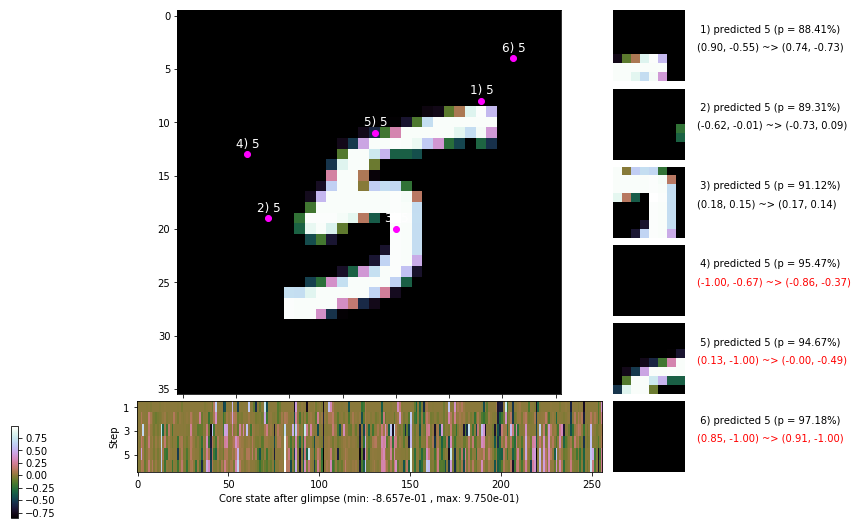

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.9 ms/b | lr: 3.22e-04 | grad 2norm: 12.87 | grad inf norm:  3.886
         Weights || abs max:  2.74 ( 4412.95) | mean: -4.20e-04 ( 0.02) | var: 8.37e-02 ( 1409.89)
          Biases || abs max:  1.46 (  310.59) | mean: -1.39e-01 ( 0.20) | var: 9.94e-02 ( 4109.30)
                    class loss: 0.348 | steps: 2.227 | reward:  3.729 | acc.: 88.57%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 138.5 ms/b | lr: 3.22e-04 | grad 2norm: 12.85 | grad inf norm:  3.905
         Weights || abs max:  2.73 ( 4395.26) | mean: -4.39e-04 ( 0.02) | var: 8.37e-02 ( 1342.15)
          Biases || abs max:  1.47 (14584.52) | mean: -1.40e-01 (11.35) | var: 9.94e-02 (48550352.00)
                    class loss: 0.357 | steps: 2.235 | reward:  3.723 | acc.: 88.45%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 

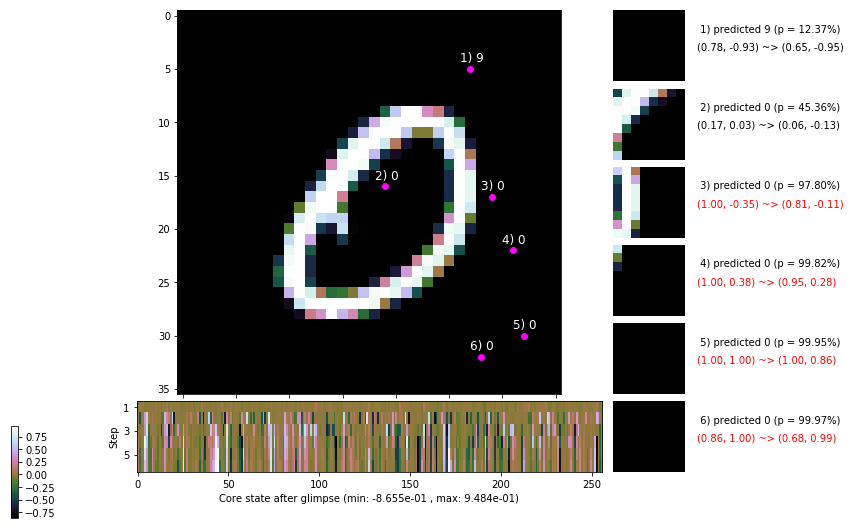

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 142.4 ms/b | lr: 3.21e-04 | grad 2norm: 12.85 | grad inf norm:  3.842
         Weights || abs max:  2.73 (37800.23) | mean: -4.45e-04 ( 0.08) | var: 8.37e-02 (583828.06)
          Biases || abs max:  1.47 (  161.04) | mean: -1.40e-01 ( 0.14) | var: 9.95e-02 (   91.83)
                    class loss: 0.352 | steps: 2.230 | reward:  3.712 | acc.: 88.63%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 149.8 ms/b | lr: 3.21e-04 | grad 2norm: 13.00 | grad inf norm:  3.841
         Weights || abs max:  2.73 ( 3177.32) | mean: -4.54e-04 ( 0.01) | var: 8.37e-02 (  297.79)
          Biases || abs max:  1.47 (  121.78) | mean: -1.40e-01 ( 0.12) | var: 9.95e-02 (   90.87)
                    class loss: 0.367 | steps: 2.216 | reward:  3.706 | acc.: 87.57%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.

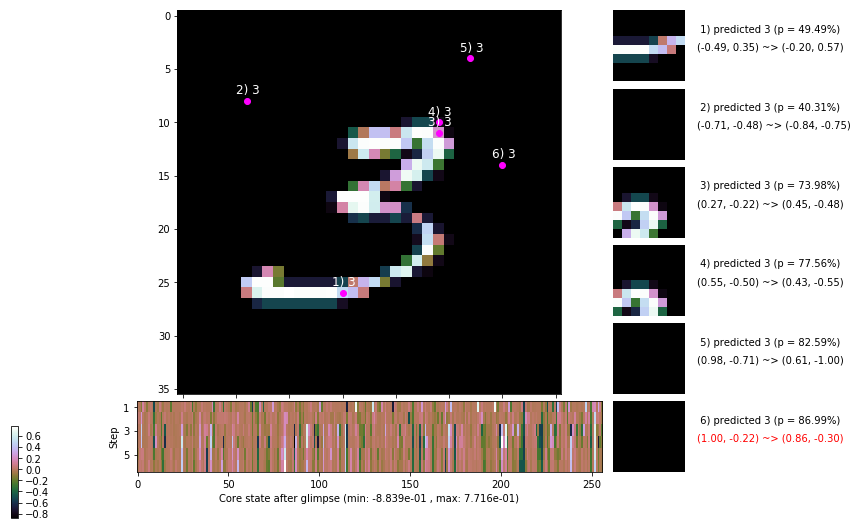

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 146.6 ms/b | lr: 3.20e-04 | grad 2norm: 12.58 | grad inf norm:  3.626
         Weights || abs max:  2.73 ( 4975.86) | mean: -4.42e-04 ( 0.02) | var: 8.38e-02 (  864.69)
          Biases || abs max:  1.47 (  233.21) | mean: -1.40e-01 ( 0.17) | var: 9.94e-02 (  356.39)
                    class loss: 0.331 | steps: 2.200 | reward:  3.754 | acc.: 88.60%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.7 ms/b | lr: 3.20e-04 | grad 2norm: 12.99 | grad inf norm:  3.791
         Weights || abs max:  2.74 ( 7986.75) | mean: -4.49e-04 ( 0.02) | var: 8.38e-02 (21315.45)
          Biases || abs max:  1.47 (  241.16) | mean: -1.39e-01 ( 0.21) | var: 9.95e-02 ( 1378.01)
                    class loss: 0.339 | steps: 2.236 | reward:  3.685 | acc.: 88.07%

	Target class: 4 | Discounted rewards: [-0.281, 0.438, 1.

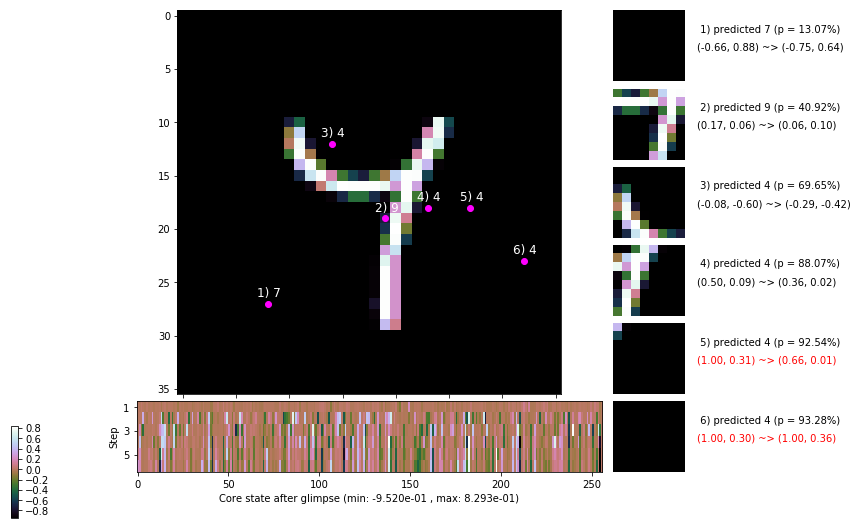

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


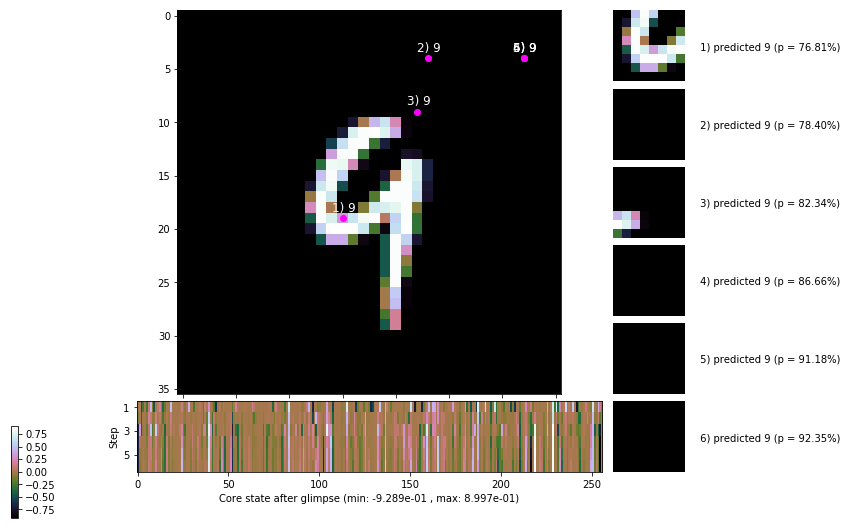


	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


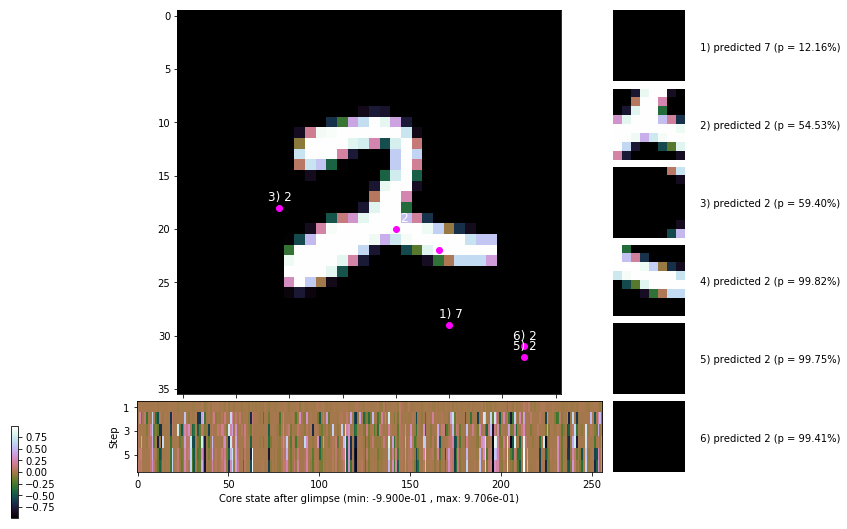

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


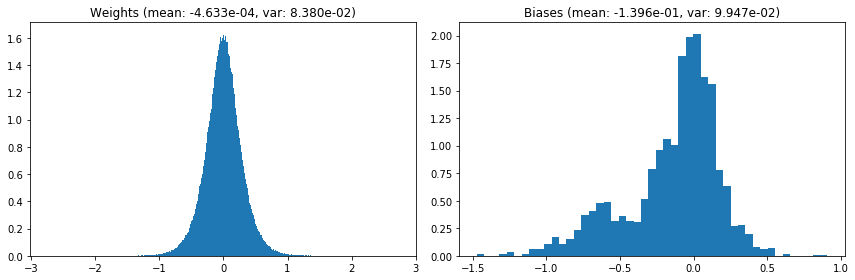

                                      Location network weights and biases


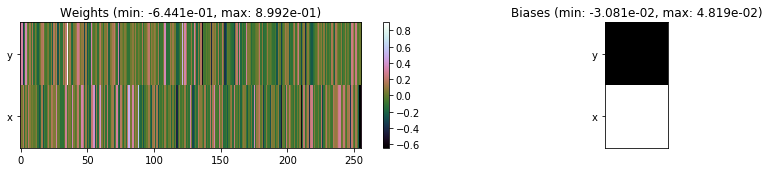

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.77 sec | TRAIN >> class loss: 0.3471 | steps:  2.218 :( | reward:  3.7270 :( | acc.: 88.377% :(
                          | VAL   >> class loss: 0.3058 | steps:  2.113 :( | reward:  3.9270 :( | acc.: 89.480% :(


Epoch  77/400) lr = 0.0003196
 b    300/  3000 >> 149.9 ms/b | lr: 3.19e-04 | grad 2norm: 12.43 | grad inf norm:  3.647
         Weights || abs max:  2.75 ( 3009.23) | mean: -4.70e-04 ( 0.01) | var: 8.38e-02 (  371.10)
          Biases || abs max:  1.47 (  286.57) | mean: -1.39e-01 ( 0.19) | var: 9.94e-02 ( 1788.00)
                    class loss: 0.333 | steps: 2.206 | reward:  3.760 | acc.: 89.02%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 163.1 ms/b | lr: 3.19e-04 | grad 2norm: 12.61 | grad inf norm:  3.732
         Weights || abs max:  2.75 ( 2507.65) | mean: -4.73e-04 (

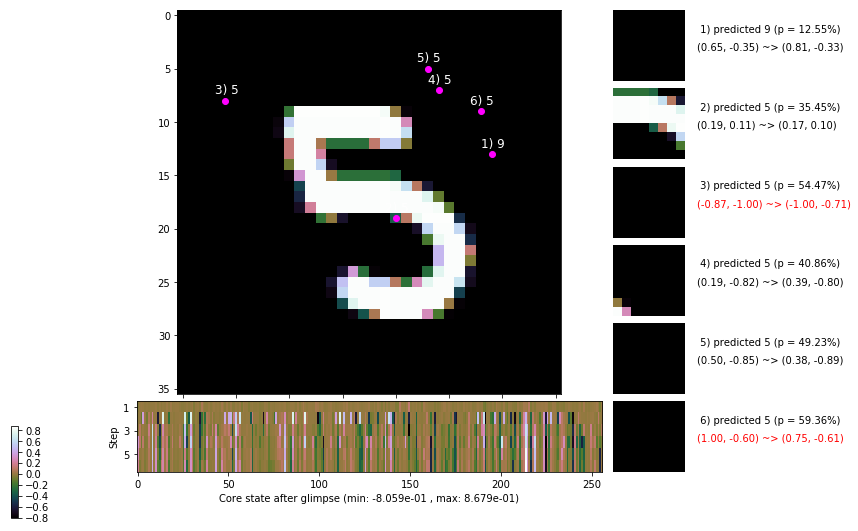

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 174.2 ms/b | lr: 3.18e-04 | grad 2norm: 12.91 | grad inf norm:  3.960
         Weights || abs max:  2.75 ( 2098.08) | mean: -4.45e-04 ( 0.01) | var: 8.39e-02 (   54.97)
          Biases || abs max:  1.47 (  108.73) | mean: -1.39e-01 ( 0.10) | var: 9.94e-02 (   79.88)
                    class loss: 0.350 | steps: 2.241 | reward:  3.714 | acc.: 88.35%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.2 ms/b | lr: 3.18e-04 | grad 2norm: 12.80 | grad inf norm:  3.923
         Weights || abs max:  2.75 ( 1890.03) | mean: -4.42e-04 ( 0.01) | var: 8.39e-02 (   48.86)
          Biases || abs max:  1.47 (  146.93) | mean: -1.40e-01 ( 0.13) | var: 9.93e-02 (   84.53)
                    class loss: 0.360 | steps: 2.232 | reward:  3.684 | acc.: 88.05%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

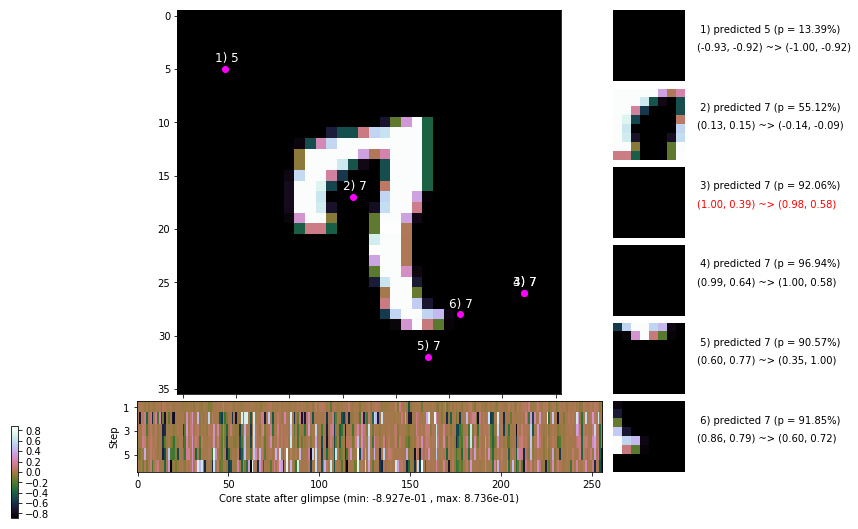

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 159.9 ms/b | lr: 3.17e-04 | grad 2norm: 12.83 | grad inf norm:  3.890
         Weights || abs max:  2.75 ( 3438.73) | mean: -4.60e-04 ( 0.01) | var: 8.39e-02 (  490.39)
          Biases || abs max:  1.47 ( 1257.34) | mean: -1.40e-01 ( 1.02) | var: 9.95e-02 (305824.09)
                    class loss: 0.343 | steps: 2.213 | reward:  3.720 | acc.: 88.15%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 158.6 ms/b | lr: 3.17e-04 | grad 2norm: 12.60 | grad inf norm:  3.726
         Weights || abs max:  2.76 ( 2195.28) | mean: -4.74e-04 ( 0.01) | var: 8.39e-02 (  213.10)
          Biases || abs max:  1.47 ( 1329.72) | mean: -1.40e-01 ( 0.59) | var: 9.96e-02 (110911.92)
                    class loss: 0.336 | steps: 2.176 | reward:  3.760 | acc.: 88.55%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1

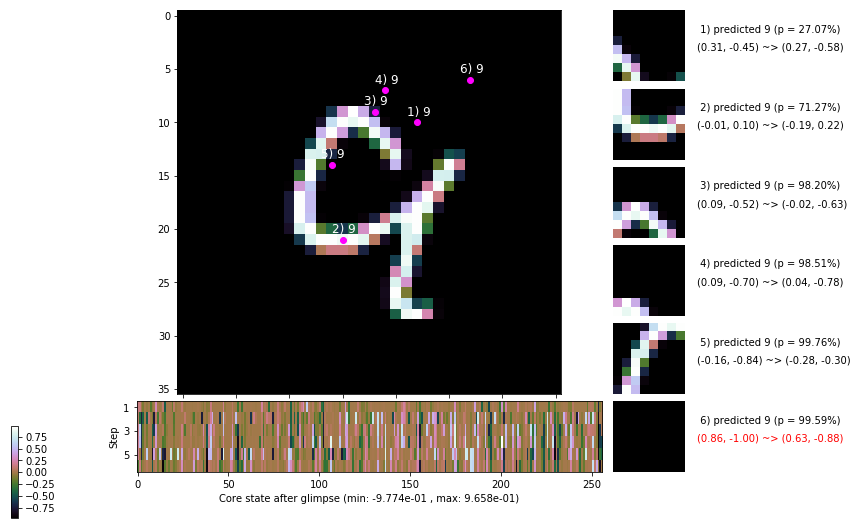

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.4 ms/b | lr: 3.16e-04 | grad 2norm: 12.97 | grad inf norm:  4.000
         Weights || abs max:  2.76 ( 8873.05) | mean: -4.81e-04 ( 0.02) | var: 8.39e-02 (20294.20)
          Biases || abs max:  1.47 (  225.42) | mean: -1.40e-01 ( 0.16) | var: 9.97e-02 (  318.01)
                    class loss: 0.346 | steps: 2.216 | reward:  3.723 | acc.: 88.58%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.9 ms/b | lr: 3.16e-04 | grad 2norm: 12.70 | grad inf norm:  3.941
         Weights || abs max:  2.75 ( 3966.55) | mean: -4.75e-04 ( 0.02) | var: 8.40e-02 (  625.72)
          Biases || abs max:  1.47 (  132.91) | mean: -1.40e-01 ( 0.13) | var: 9.96e-02 (   52.69)
                    class loss: 0.337 | steps: 2.197 | reward:  3.773 | acc.: 88.90%

	Target class: 7 | Discounted rewards: [-0.281, 0.438, 1.

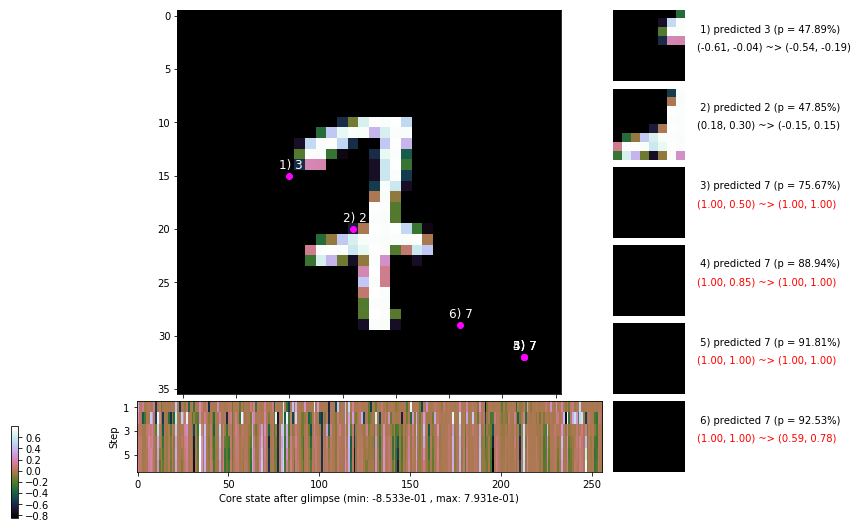

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 150.6 ms/b | lr: 3.16e-04 | grad 2norm: 12.23 | grad inf norm:  3.637
         Weights || abs max:  2.75 ( 5551.06) | mean: -4.79e-04 ( 0.02) | var: 8.40e-02 ( 1535.87)
          Biases || abs max:  1.47 ( 2040.69) | mean: -1.40e-01 ( 0.87) | var: 9.95e-02 (389196.19)
                    class loss: 0.329 | steps: 2.183 | reward:  3.806 | acc.: 89.17%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 155.8 ms/b | lr: 3.15e-04 | grad 2norm: 12.58 | grad inf norm:  3.666
         Weights || abs max:  2.75 ( 2552.30) | mean: -4.72e-04 ( 0.01) | var: 8.40e-02 (  157.96)
          Biases || abs max:  1.46 (  179.91) | mean: -1.40e-01 ( 0.15) | var: 9.94e-02 (  340.58)
                    class loss: 0.343 | steps: 2.216 | reward:  3.746 | acc.: 88.72%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.

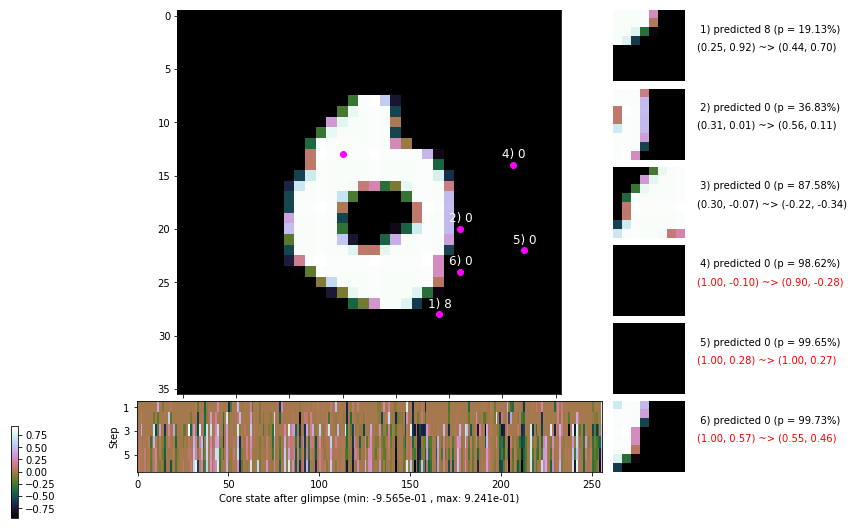

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


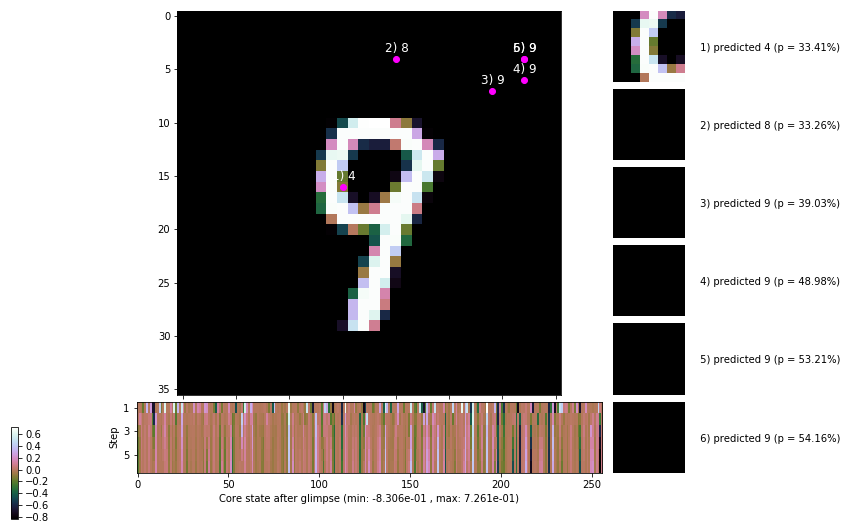


	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


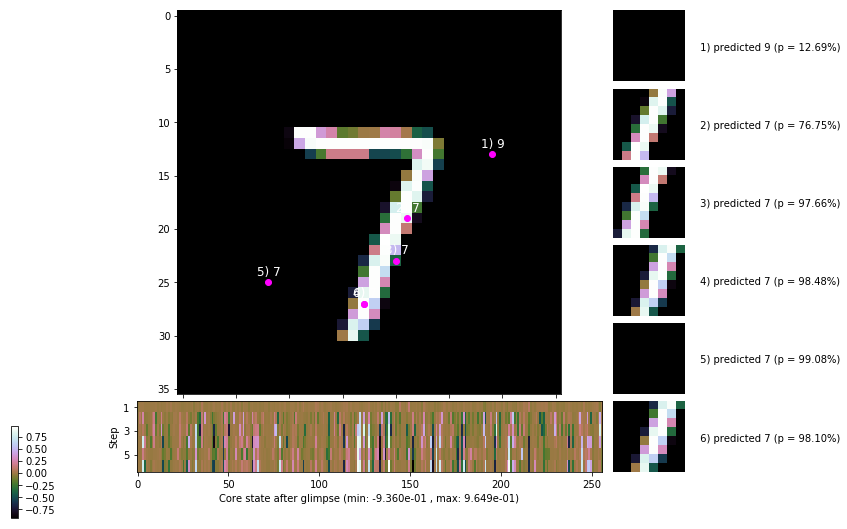

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


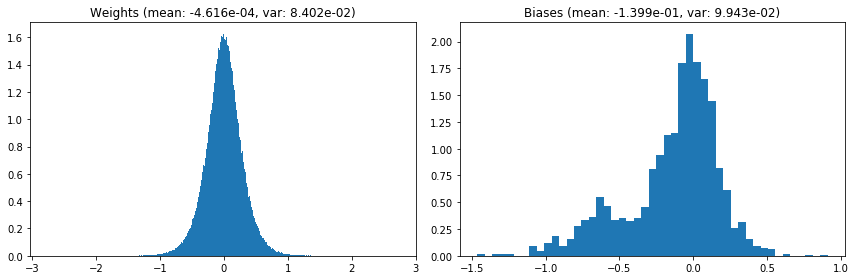

                                      Location network weights and biases


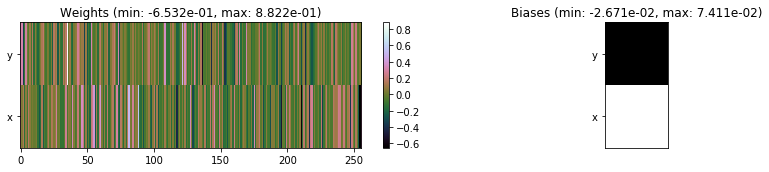

---------------------------------------------------------------------------------------------------------------
Elapsed time:  472.97 sec | TRAIN >> class loss: 0.3413 | steps:  2.209 :( | reward:  3.7432 :( | acc.: 88.605% :(
                          | VAL   >> class loss: 0.3250 | steps:  2.128 :( | reward:  3.9171 :( | acc.: 89.040% :(


Epoch  78/400) lr = 0.0003149
 b    300/  3000 >> 152.1 ms/b | lr: 3.15e-04 | grad 2norm: 12.55 | grad inf norm:  3.690
         Weights || abs max:  2.76 ( 2022.74) | mean: -4.52e-04 ( 0.01) | var: 8.40e-02 (   59.34)
          Biases || abs max:  1.46 (  351.80) | mean: -1.40e-01 ( 0.21) | var: 9.94e-02 ( 4309.24)
                    class loss: 0.335 | steps: 2.209 | reward:  3.753 | acc.: 88.73%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 154.6 ms/b | lr: 3.14e-04 | grad 2norm: 12.47 | grad inf norm:  3.688
         Weights || abs max:  2.76 ( 6045.37) | mean: -4.51e-04 (

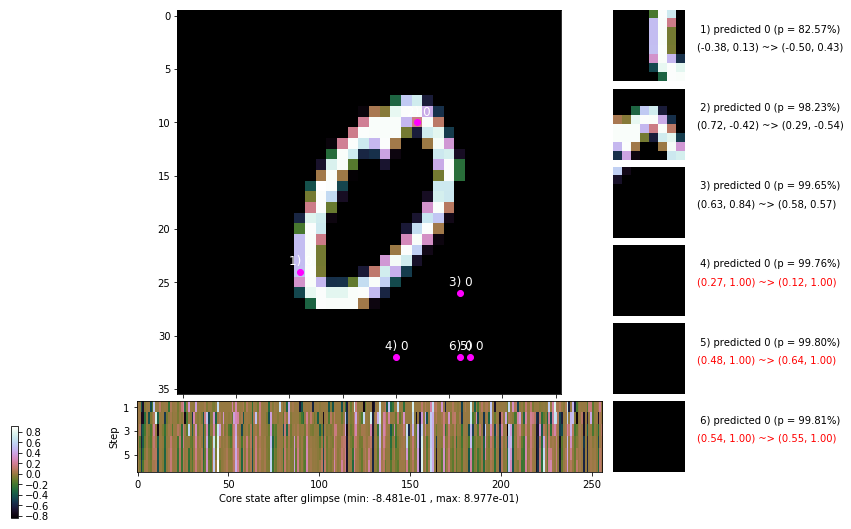

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 149.1 ms/b | lr: 3.14e-04 | grad 2norm: 12.88 | grad inf norm:  3.903
         Weights || abs max:  2.76 ( 3610.87) | mean: -4.32e-04 ( 0.01) | var: 8.41e-02 (  560.29)
          Biases || abs max:  1.46 (  166.07) | mean: -1.40e-01 ( 0.13) | var: 9.93e-02 (  346.02)
                    class loss: 0.336 | steps: 2.212 | reward:  3.740 | acc.: 88.80%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 156.3 ms/b | lr: 3.13e-04 | grad 2norm: 12.81 | grad inf norm:  3.735
         Weights || abs max:  2.76 ( 8001.91) | mean: -4.23e-04 ( 0.02) | var: 8.41e-02 (11653.33)
          Biases || abs max:  1.46 (  229.08) | mean: -1.40e-01 ( 0.15) | var: 9.95e-02 ( 2457.00)
                    class loss: 0.355 | steps: 2.217 | reward:  3.712 | acc.: 88.10%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

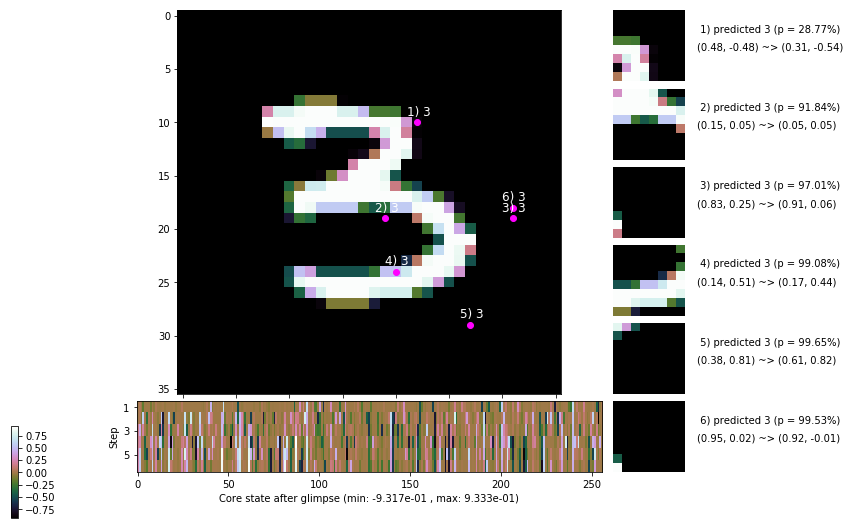

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 158.2 ms/b | lr: 3.13e-04 | grad 2norm: 12.62 | grad inf norm:  3.622
         Weights || abs max:  2.77 ( 8734.87) | mean: -4.22e-04 ( 0.02) | var: 8.41e-02 (12498.00)
          Biases || abs max:  1.46 (  552.33) | mean: -1.40e-01 ( 0.29) | var: 9.97e-02 (22463.11)
                    class loss: 0.348 | steps: 2.239 | reward:  3.720 | acc.: 88.78%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.8 ms/b | lr: 3.12e-04 | grad 2norm: 12.54 | grad inf norm:  3.739
         Weights || abs max:  2.77 (15074.35) | mean: -4.31e-04 ( 0.03) | var: 8.41e-02 (37631.67)
          Biases || abs max:  1.47 (   97.65) | mean: -1.41e-01 ( 0.11) | var: 9.98e-02 (   70.94)
                    class loss: 0.318 | steps: 2.205 | reward:  3.781 | acc.: 89.30%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

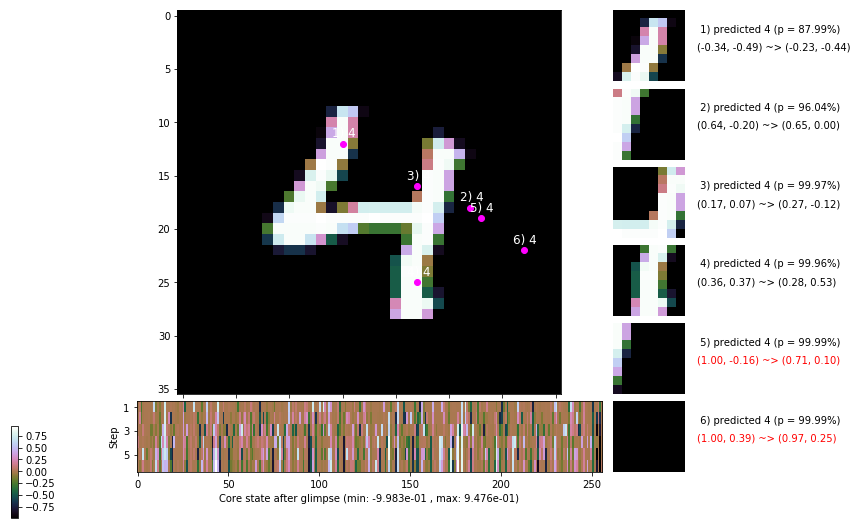

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 158.1 ms/b | lr: 3.12e-04 | grad 2norm: 12.97 | grad inf norm:  3.862
         Weights || abs max:  2.77 ( 2208.17) | mean: -4.39e-04 ( 0.01) | var: 8.41e-02 (  137.97)
          Biases || abs max:  1.47 (   92.80) | mean: -1.41e-01 ( 0.11) | var: 9.98e-02 (   26.55)
                    class loss: 0.357 | steps: 2.228 | reward:  3.696 | acc.: 88.17%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.9 ms/b | lr: 3.11e-04 | grad 2norm: 12.43 | grad inf norm:  3.701
         Weights || abs max:  2.78 ( 3345.14) | mean: -4.43e-04 ( 0.01) | var: 8.41e-02 (  545.32)
          Biases || abs max:  1.47 (   95.19) | mean: -1.40e-01 ( 0.10) | var: 9.97e-02 (   59.66)
                    class loss: 0.328 | steps: 2.222 | reward:  3.743 | acc.: 89.00%

	Target class: 5 | Discounted rewards: [-0.281, 0.438, 1.

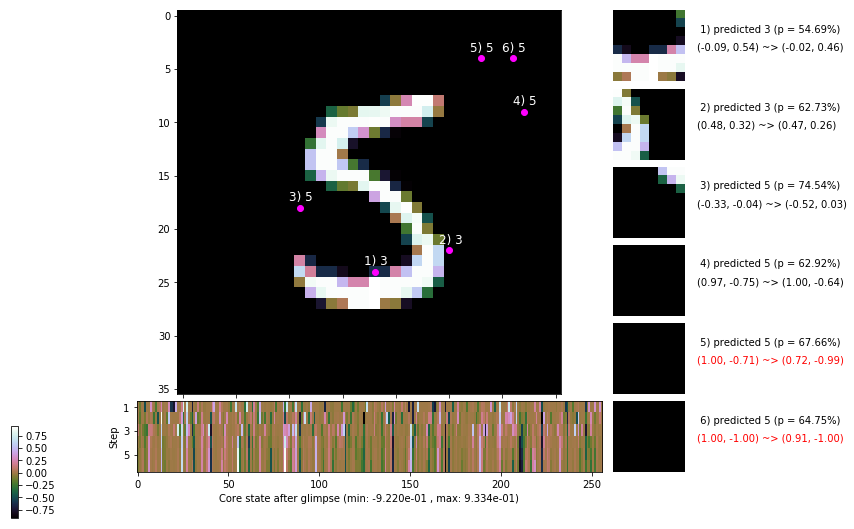

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 153.3 ms/b | lr: 3.11e-04 | grad 2norm: 12.76 | grad inf norm:  3.931
         Weights || abs max:  2.78 ( 1741.37) | mean: -4.48e-04 ( 0.01) | var: 8.42e-02 (   60.79)
          Biases || abs max:  1.47 (   74.24) | mean: -1.40e-01 ( 0.10) | var: 9.98e-02 (   21.15)
                    class loss: 0.345 | steps: 2.226 | reward:  3.713 | acc.: 88.05%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 152.5 ms/b | lr: 3.10e-04 | grad 2norm: 12.76 | grad inf norm:  3.648
         Weights || abs max:  2.78 (12783.36) | mean: -4.44e-04 ( 0.03) | var: 8.42e-02 (64980.46)
          Biases || abs max:  1.47 (  109.25) | mean: -1.40e-01 ( 0.12) | var: 9.98e-02 (   30.18)
                    class loss: 0.335 | steps: 2.237 | reward:  3.705 | acc.: 88.63%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

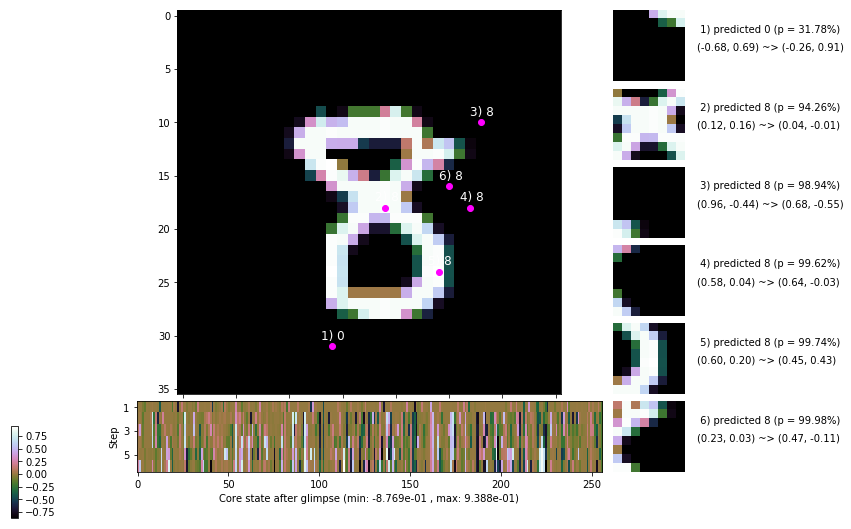

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


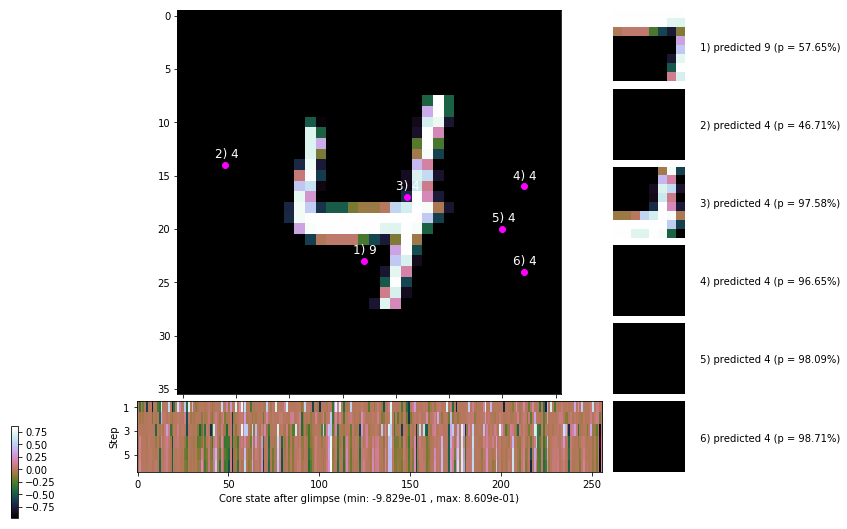


	Target class: 2 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


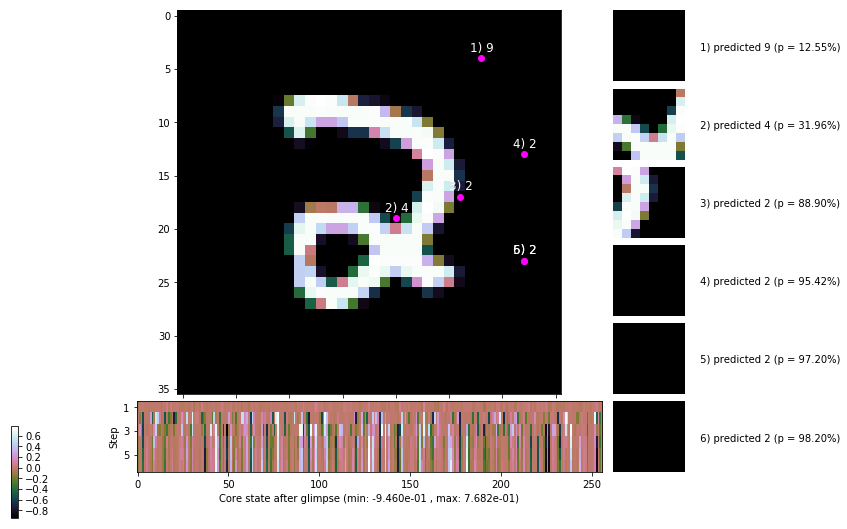

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


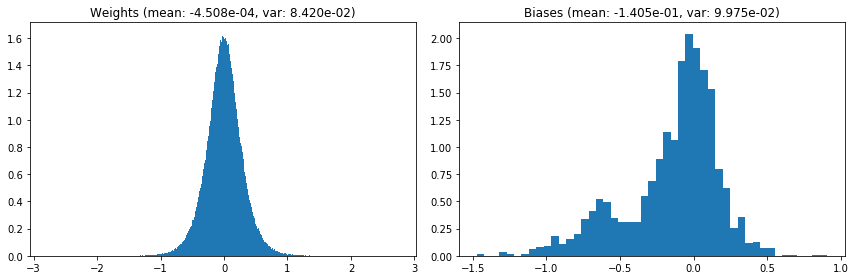

                                      Location network weights and biases


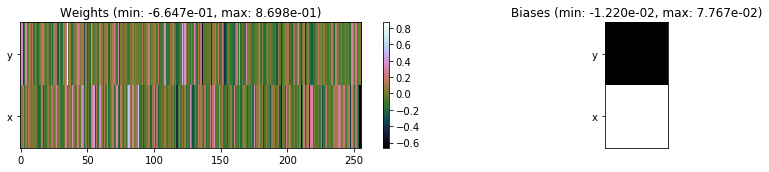

---------------------------------------------------------------------------------------------------------------
Elapsed time:  462.91 sec | TRAIN >> class loss: 0.3381 | steps:  2.222 :( | reward:  3.7292 :( | acc.: 88.645% :(
                          | VAL   >> class loss: 0.3130 | steps:  2.089 :( | reward:  3.9498 :( | acc.: 89.760% :(


Epoch  79/400) lr = 0.0003102
 b    300/  3000 >> 163.9 ms/b | lr: 3.10e-04 | grad 2norm: 12.81 | grad inf norm:  3.930
         Weights || abs max:  2.78 ( 6471.24) | mean: -4.55e-04 ( 0.02) | var: 8.42e-02 ( 5596.03)
          Biases || abs max:  1.47 (  156.17) | mean: -1.41e-01 ( 0.13) | var: 9.97e-02 (  275.09)
                    class loss: 0.331 | steps: 2.221 | reward:  3.724 | acc.: 88.70%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.3 ms/b | lr: 3.10e-04 | grad 2norm: 12.76 | grad inf norm:  3.809
         Weights || abs max:  2.78 ( 2338.38) | mean: -4.59e-04 (

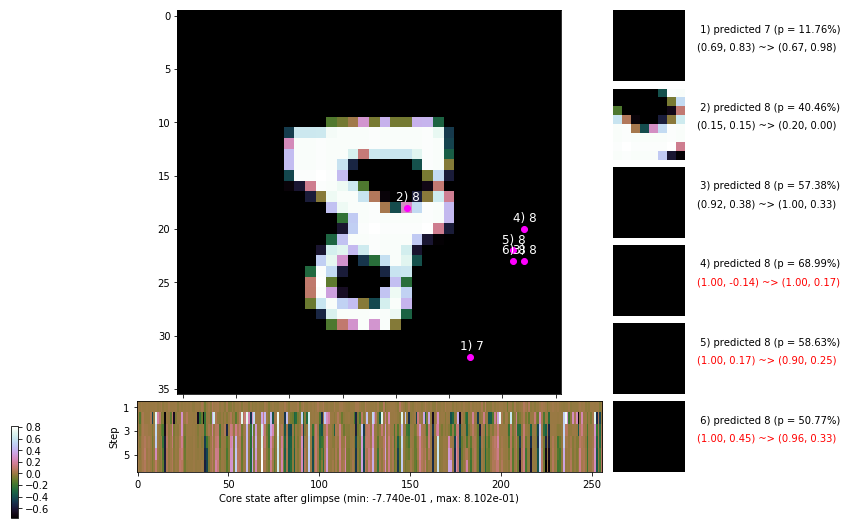

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 160.3 ms/b | lr: 3.09e-04 | grad 2norm: 12.63 | grad inf norm:  3.773
         Weights || abs max:  2.78 ( 2067.46) | mean: -4.45e-04 ( 0.01) | var: 8.42e-02 (   79.30)
          Biases || abs max:  1.47 (  143.90) | mean: -1.40e-01 ( 0.13) | var: 9.98e-02 (  389.25)
                    class loss: 0.327 | steps: 2.211 | reward:  3.784 | acc.: 89.35%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 173.9 ms/b | lr: 3.09e-04 | grad 2norm: 13.10 | grad inf norm:  3.912
         Weights || abs max:  2.77 ( 2561.26) | mean: -4.55e-04 ( 0.01) | var: 8.43e-02 (  122.09)
          Biases || abs max:  1.47 (  122.73) | mean: -1.40e-01 ( 0.12) | var: 9.99e-02 (  147.20)
                    class loss: 0.364 | steps: 2.220 | reward:  3.708 | acc.: 88.05%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

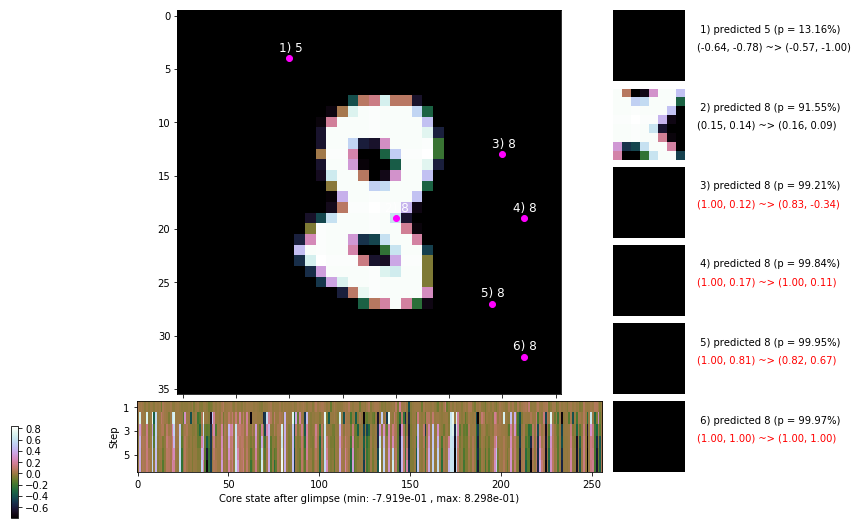

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.9 ms/b | lr: 3.08e-04 | grad 2norm: 12.88 | grad inf norm:  3.891
         Weights || abs max:  2.77 ( 1727.58) | mean: -4.53e-04 ( 0.01) | var: 8.43e-02 (   61.19)
          Biases || abs max:  1.48 (  185.13) | mean: -1.41e-01 ( 0.15) | var: 9.99e-02 (  328.18)
                    class loss: 0.343 | steps: 2.201 | reward:  3.748 | acc.: 88.72%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 162.2 ms/b | lr: 3.08e-04 | grad 2norm: 12.70 | grad inf norm:  3.612
         Weights || abs max:  2.77 ( 1623.99) | mean: -4.50e-04 ( 0.01) | var: 8.43e-02 (   33.48)
          Biases || abs max:  1.48 (  184.24) | mean: -1.41e-01 ( 0.15) | var: 9.98e-02 (  783.58)
                    class loss: 0.345 | steps: 2.230 | reward:  3.710 | acc.: 88.42%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

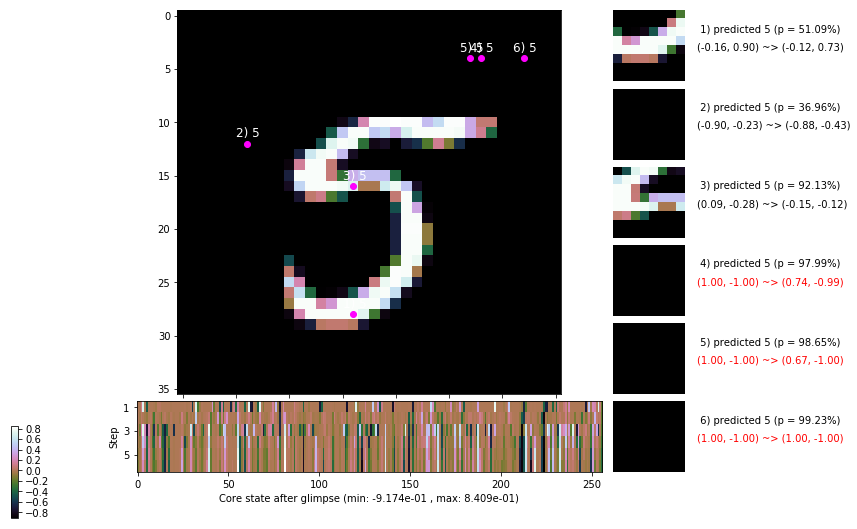

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 158.0 ms/b | lr: 3.07e-04 | grad 2norm: 12.62 | grad inf norm:  3.701
         Weights || abs max:  2.78 ( 3281.85) | mean: -4.40e-04 ( 0.01) | var: 8.43e-02 (  444.20)
          Biases || abs max:  1.48 (   60.65) | mean: -1.41e-01 ( 0.09) | var: 9.98e-02 (   11.36)
                    class loss: 0.347 | steps: 2.216 | reward:  3.718 | acc.: 88.20%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 161.1 ms/b | lr: 3.07e-04 | grad 2norm: 12.86 | grad inf norm:  3.890
         Weights || abs max:  2.79 ( 1974.49) | mean: -4.32e-04 ( 0.01) | var: 8.43e-02 (   84.00)
          Biases || abs max:  1.48 (  175.44) | mean: -1.41e-01 ( 0.15) | var: 9.99e-02 (  148.63)
                    class loss: 0.347 | steps: 2.227 | reward:  3.711 | acc.: 88.27%

	Target class: 3 | Discounted rewards: [-0.984, -0.969, -

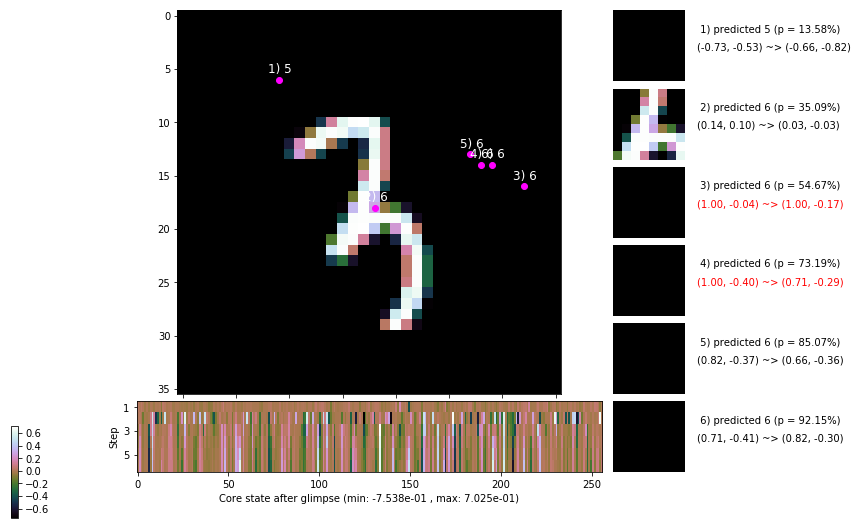

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 160.0 ms/b | lr: 3.06e-04 | grad 2norm: 12.79 | grad inf norm:  3.724
         Weights || abs max:  2.79 ( 1143.29) | mean: -4.41e-04 ( 0.01) | var: 8.43e-02 (   27.07)
          Biases || abs max:  1.47 (   60.36) | mean: -1.41e-01 ( 0.09) | var: 1.00e-01 (   18.57)
                    class loss: 0.337 | steps: 2.179 | reward:  3.783 | acc.: 88.73%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 168.5 ms/b | lr: 3.06e-04 | grad 2norm: 13.01 | grad inf norm:  3.745
         Weights || abs max:  2.79 ( 2320.39) | mean: -4.62e-04 ( 0.01) | var: 8.44e-02 (   80.72)
          Biases || abs max:  1.47 (  217.75) | mean: -1.41e-01 ( 0.15) | var: 1.00e-01 ( 1106.95)
                    class loss: 0.349 | steps: 2.213 | reward:  3.724 | acc.: 88.20%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

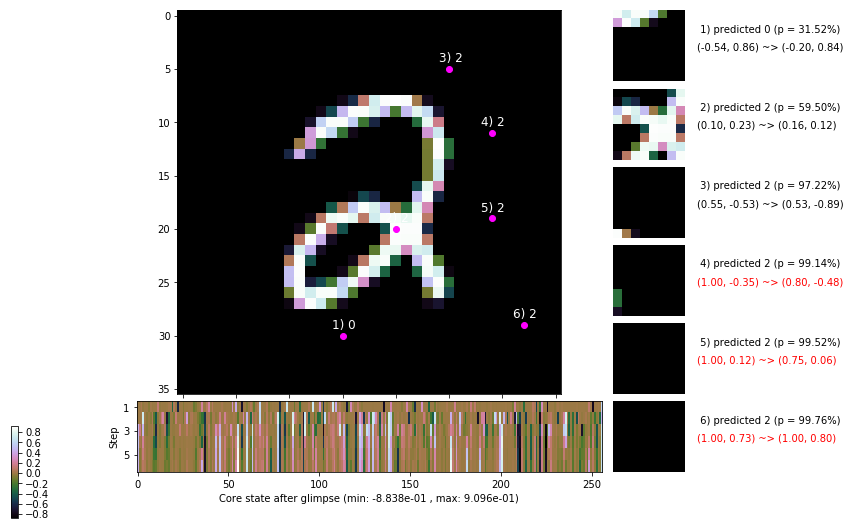

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


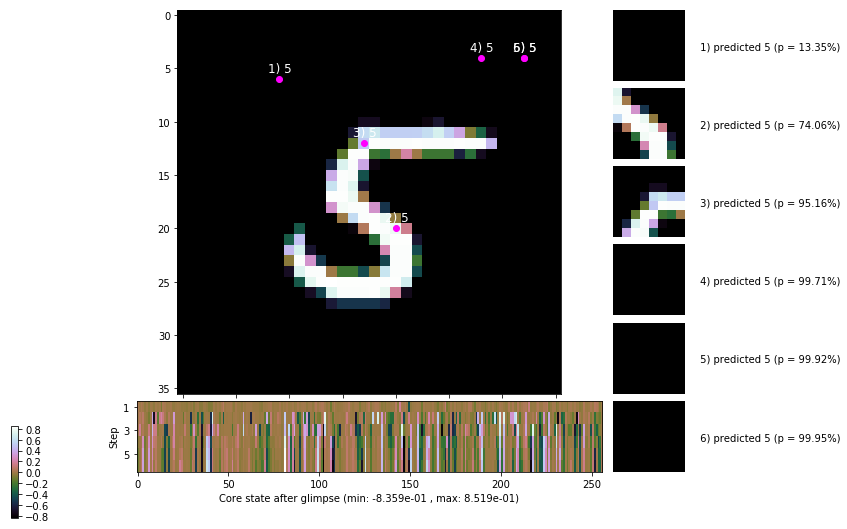


	Target class: 7 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


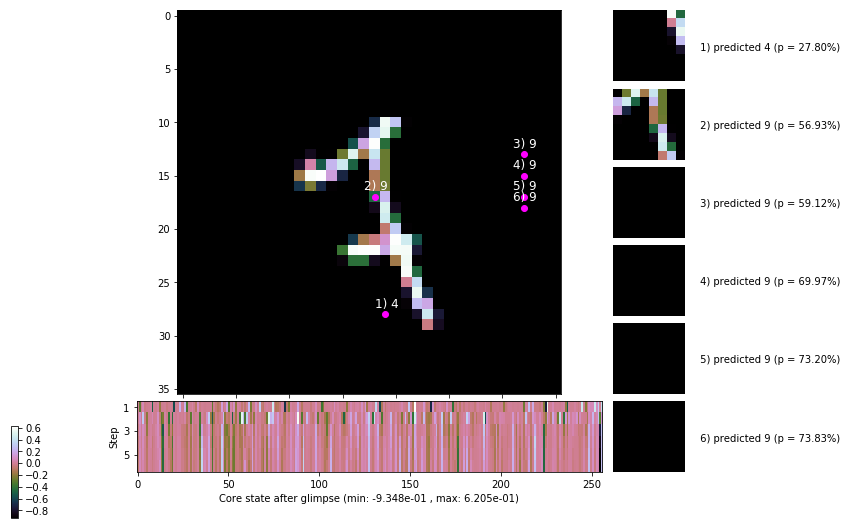

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


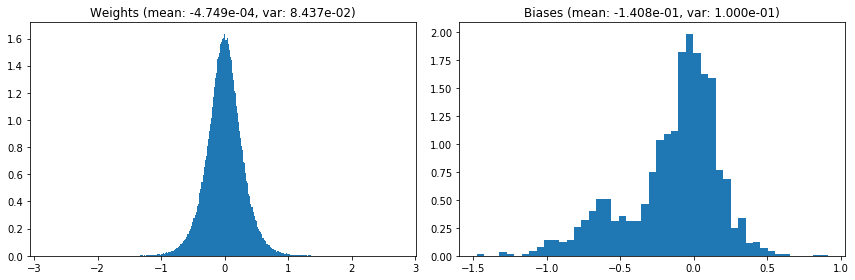

                                      Location network weights and biases


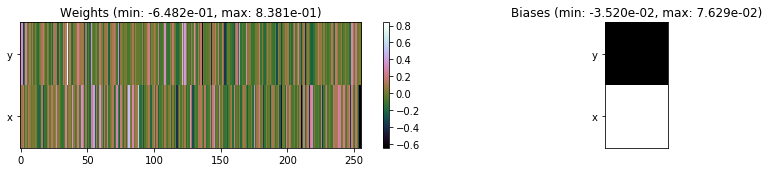

---------------------------------------------------------------------------------------------------------------
Elapsed time:  483.07 sec | TRAIN >> class loss: 0.3432 | steps:  2.213 :( | reward:  3.7348 :( | acc.: 88.503% :(
                          | VAL   >> class loss: 0.3166 | steps:  2.101 :( | reward:  3.9723 :( | acc.: 89.580% :(


Epoch  80/400) lr = 0.0003056
 b    300/  3000 >> 164.8 ms/b | lr: 3.05e-04 | grad 2norm: 12.44 | grad inf norm:  3.674
         Weights || abs max:  2.79 ( 4242.31) | mean: -4.76e-04 ( 0.01) | var: 8.44e-02 (  676.81)
          Biases || abs max:  1.48 (  175.96) | mean: -1.41e-01 ( 0.16) | var: 1.00e-01 (  281.59)
                    class loss: 0.328 | steps: 2.194 | reward:  3.763 | acc.: 88.97%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 165.2 ms/b | lr: 3.05e-04 | grad 2norm: 12.84 | grad inf norm:  3.836
         Weights || abs max:  2.80 ( 3967.68) | mean: -4.67e-04 (

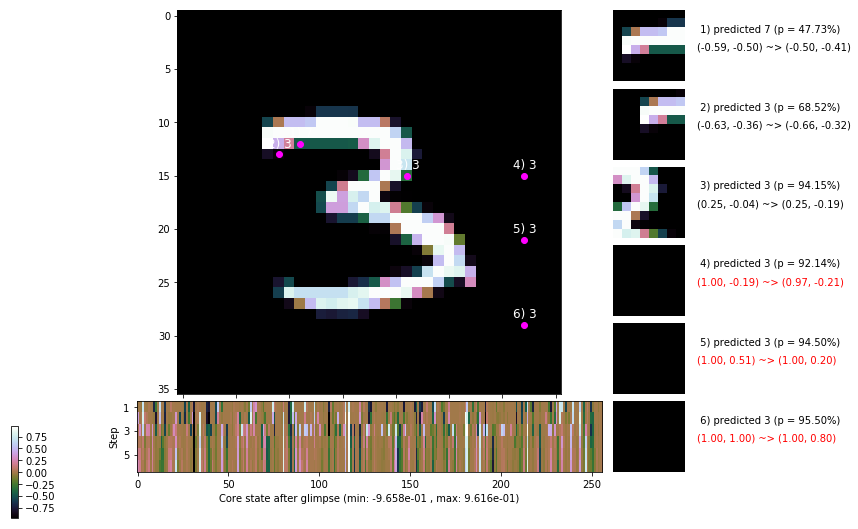

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 159.3 ms/b | lr: 3.04e-04 | grad 2norm: 12.85 | grad inf norm:  3.778
         Weights || abs max:  2.79 (23844.53) | mean: -4.71e-04 ( 0.05) | var: 8.44e-02 (282082.66)
          Biases || abs max:  1.48 (  218.45) | mean: -1.41e-01 ( 0.15) | var: 9.99e-02 (  951.41)
                    class loss: 0.339 | steps: 2.200 | reward:  3.754 | acc.: 88.85%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.6 ms/b | lr: 3.04e-04 | grad 2norm: 12.82 | grad inf norm:  3.986
         Weights || abs max:  2.79 ( 3651.88) | mean: -4.64e-04 ( 0.01) | var: 8.44e-02 ( 1533.47)
          Biases || abs max:  1.48 (  118.71) | mean: -1.41e-01 ( 0.12) | var: 9.99e-02 (   62.58)
                    class loss: 0.347 | steps: 2.209 | reward:  3.764 | acc.: 88.38%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.

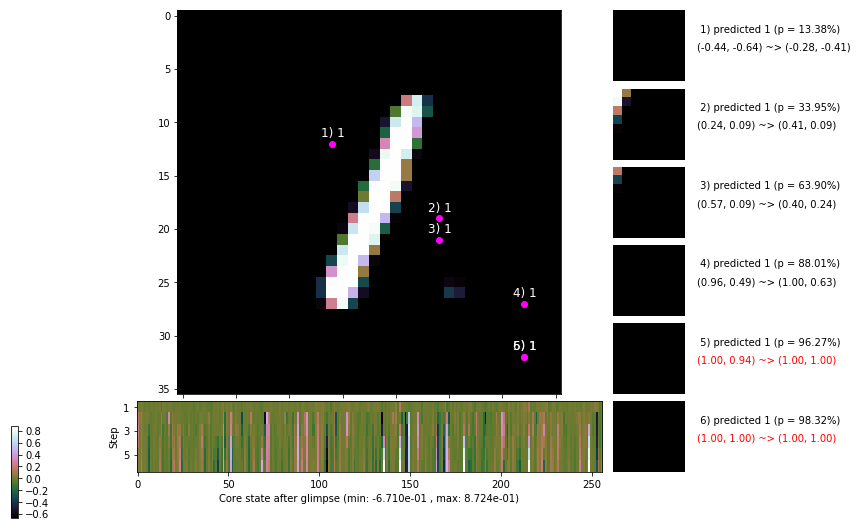

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 143.1 ms/b | lr: 3.03e-04 | grad 2norm: 12.97 | grad inf norm:  3.753
         Weights || abs max:  2.79 ( 2664.08) | mean: -4.59e-04 ( 0.01) | var: 8.44e-02 (  227.74)
          Biases || abs max:  1.48 (  387.46) | mean: -1.41e-01 ( 0.23) | var: 1.00e-01 ( 4615.33)
                    class loss: 0.358 | steps: 2.232 | reward:  3.682 | acc.: 88.02%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.5 ms/b | lr: 3.03e-04 | grad 2norm: 13.02 | grad inf norm:  3.850
         Weights || abs max:  2.80 ( 3339.51) | mean: -4.60e-04 ( 0.01) | var: 8.45e-02 (  628.39)
          Biases || abs max:  1.48 (  138.59) | mean: -1.41e-01 ( 0.12) | var: 1.00e-01 (  147.62)
                    class loss: 0.360 | steps: 2.195 | reward:  3.744 | acc.: 87.83%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

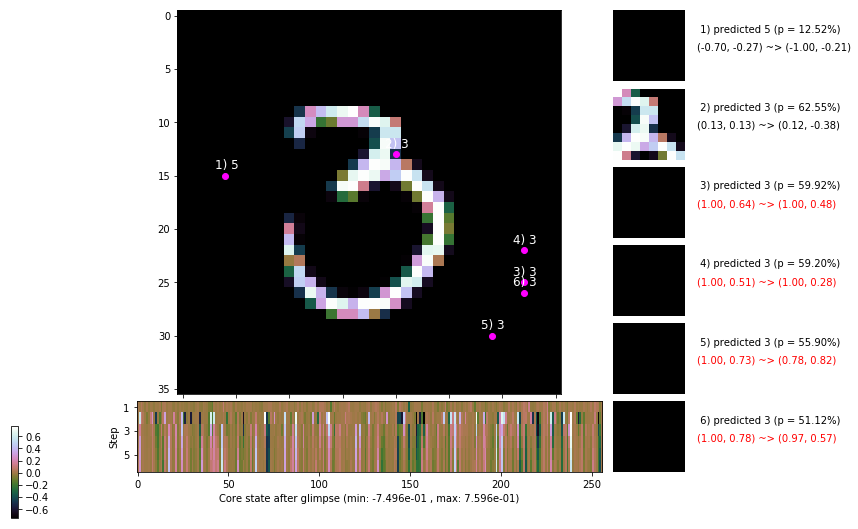

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 152.9 ms/b | lr: 3.03e-04 | grad 2norm: 12.95 | grad inf norm:  3.865
         Weights || abs max:  2.79 ( 3142.78) | mean: -4.54e-04 ( 0.01) | var: 8.45e-02 (  528.86)
          Biases || abs max:  1.48 (  199.97) | mean: -1.41e-01 ( 0.19) | var: 1.00e-01 ( 1582.93)
                    class loss: 0.365 | steps: 2.230 | reward:  3.708 | acc.: 88.00%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 160.3 ms/b | lr: 3.02e-04 | grad 2norm: 12.59 | grad inf norm:  3.764
         Weights || abs max:  2.79 ( 1920.41) | mean: -4.41e-04 ( 0.01) | var: 8.45e-02 (   50.27)
          Biases || abs max:  1.48 (  111.10) | mean: -1.41e-01 ( 0.11) | var: 1.00e-01 (  140.82)
                    class loss: 0.326 | steps: 2.196 | reward:  3.780 | acc.: 88.83%

	Target class: 3 | Discounted rewards: [1.641, 1.281, 0.5

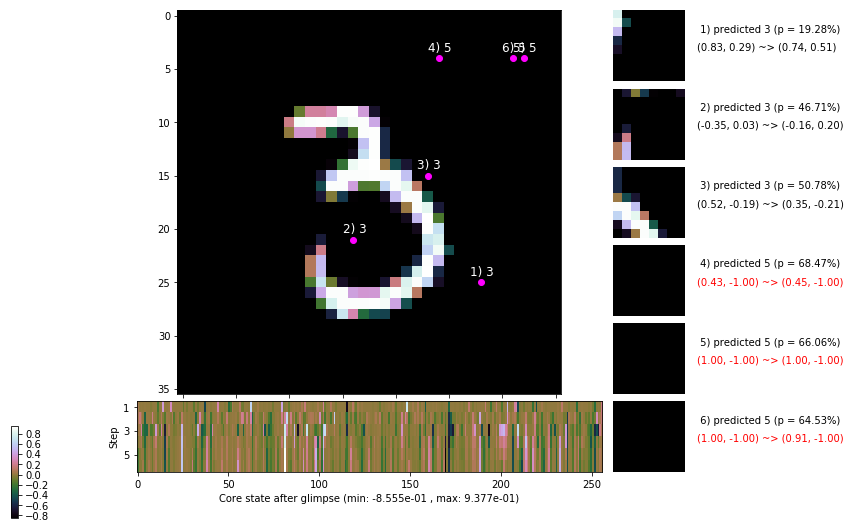

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.0 ms/b | lr: 3.02e-04 | grad 2norm: 12.63 | grad inf norm:  3.669
         Weights || abs max:  2.79 ( 2724.57) | mean: -4.33e-04 ( 0.01) | var: 8.45e-02 (  208.30)
          Biases || abs max:  1.48 (  181.31) | mean: -1.40e-01 ( 0.15) | var: 1.00e-01 (  311.45)
                    class loss: 0.347 | steps: 2.236 | reward:  3.715 | acc.: 88.33%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.9 ms/b | lr: 3.01e-04 | grad 2norm: 12.84 | grad inf norm:  3.792
         Weights || abs max:  2.79 ( 4227.41) | mean: -4.10e-04 ( 0.01) | var: 8.45e-02 ( 1621.22)
          Biases || abs max:  1.48 (   84.29) | mean: -1.40e-01 ( 0.09) | var: 1.00e-01 (   40.70)
                    class loss: 0.332 | steps: 2.165 | reward:  3.796 | acc.: 88.83%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

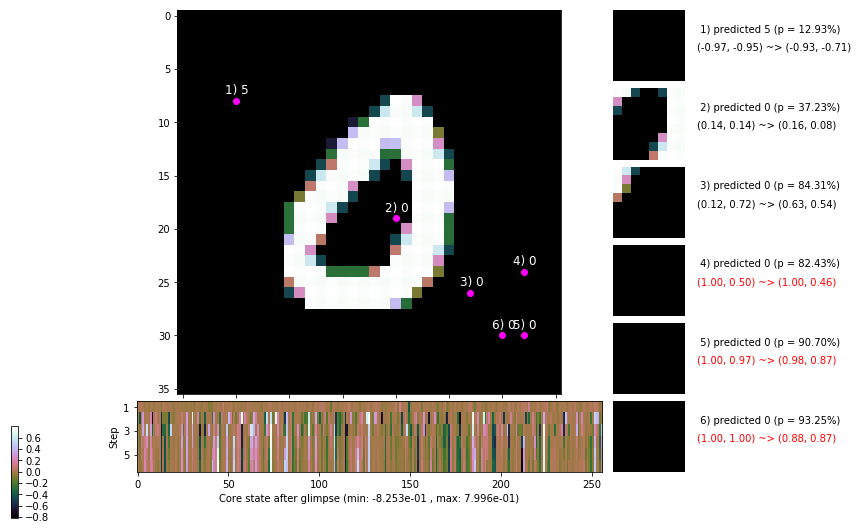

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


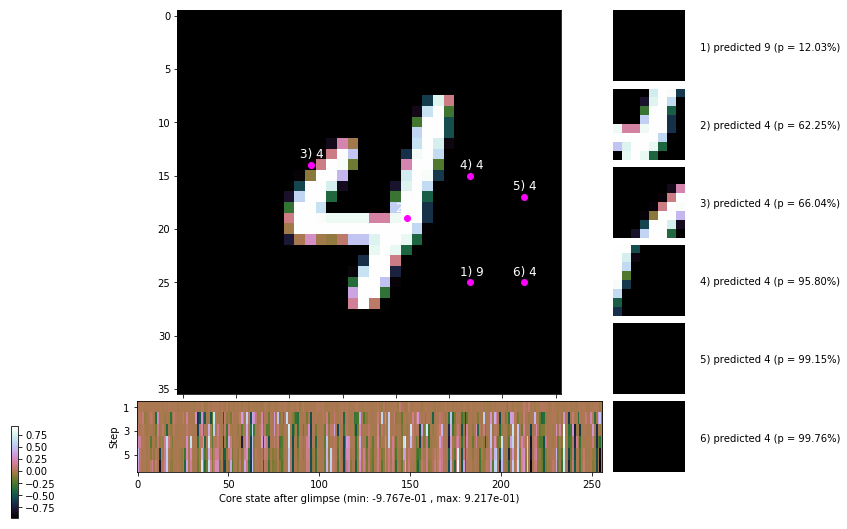


	Target class: 6 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


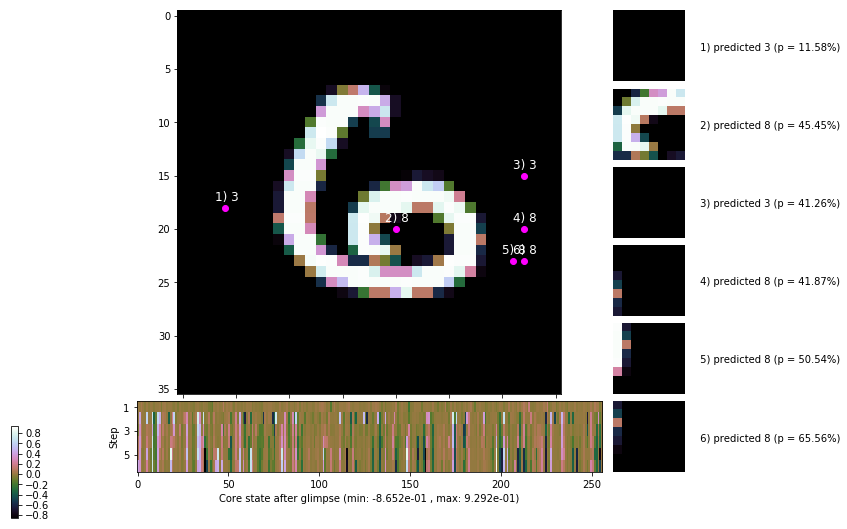

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


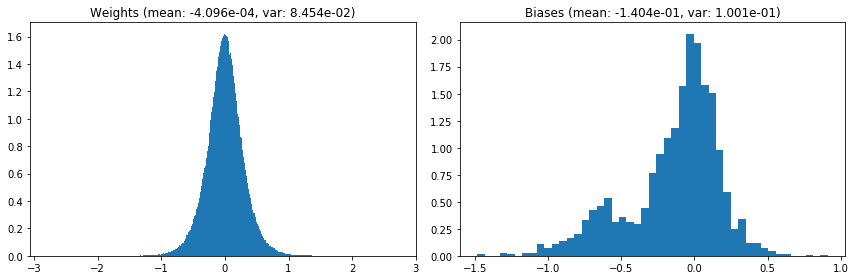

                                      Location network weights and biases


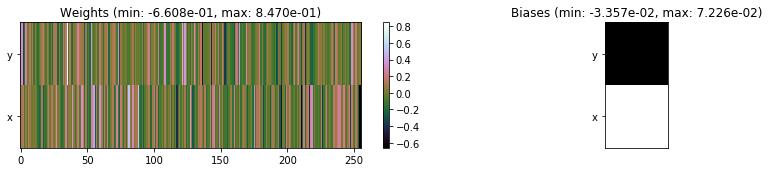

---------------------------------------------------------------------------------------------------------------
Elapsed time:  466.35 sec | TRAIN >> class loss: 0.3444 | steps:  2.207 :( | reward:  3.7456 :( | acc.: 88.485% :(
                          | VAL   >> class loss: 0.3226 | steps:  2.104 :( | reward:  3.9537 :( | acc.: 89.340% :(


Epoch  81/400) lr = 0.000301
 b    300/  3000 >> 155.1 ms/b | lr: 3.01e-04 | grad 2norm: 12.49 | grad inf norm:  3.677
         Weights || abs max:  2.79 ( 2247.18) | mean: -4.19e-04 ( 0.01) | var: 8.45e-02 (  259.96)
          Biases || abs max:  1.49 (   69.32) | mean: -1.40e-01 ( 0.08) | var: 1.00e-01 (   20.68)
                    class loss: 0.329 | steps: 2.201 | reward:  3.797 | acc.: 89.03%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 150.7 ms/b | lr: 3.00e-04 | grad 2norm: 12.61 | grad inf norm:  3.687
         Weights || abs max:  2.79 ( 3445.95) | mean: -4.34e-04 ( 

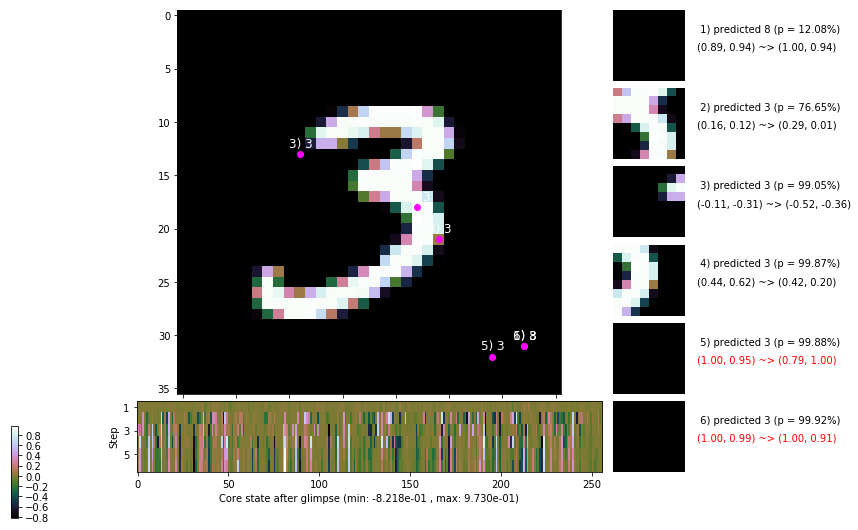

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.2 ms/b | lr: 3.00e-04 | grad 2norm: 12.60 | grad inf norm:  3.765
         Weights || abs max:  2.78 ( 6573.04) | mean: -4.57e-04 ( 0.02) | var: 8.46e-02 ( 3985.51)
          Biases || abs max:  1.48 (  233.06) | mean: -1.41e-01 ( 0.16) | var: 1.00e-01 ( 1269.02)
                    class loss: 0.337 | steps: 2.231 | reward:  3.737 | acc.: 88.73%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 147.1 ms/b | lr: 3.00e-04 | grad 2norm: 12.98 | grad inf norm:  3.871
         Weights || abs max:  2.78 (19183.56) | mean: -4.46e-04 ( 0.04) | var: 8.46e-02 (153006.11)
          Biases || abs max:  1.48 (  106.35) | mean: -1.41e-01 ( 0.11) | var: 1.00e-01 (   35.90)
                    class loss: 0.361 | steps: 2.224 | reward:  3.693 | acc.: 87.82%

	Target class: 2 | Discounted rewards: [-0.094, 0.812, -

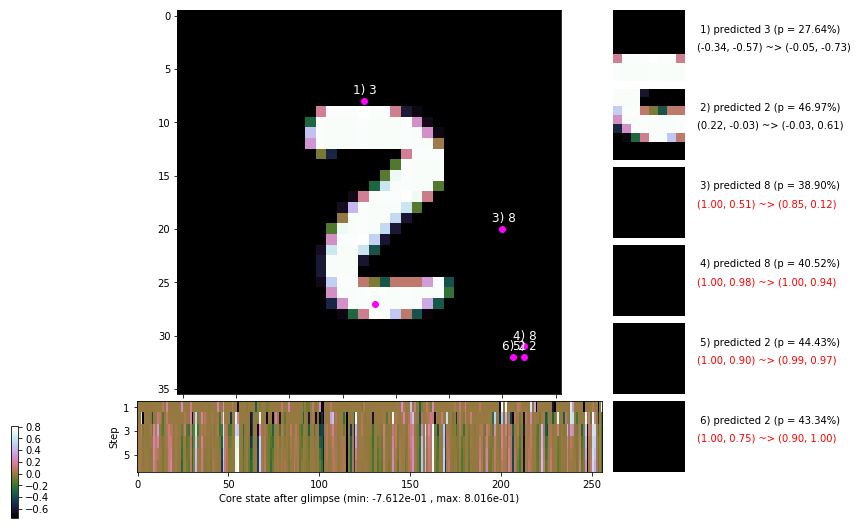

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 149.4 ms/b | lr: 2.99e-04 | grad 2norm: 12.93 | grad inf norm:  3.779
         Weights || abs max:  2.78 ( 3526.73) | mean: -4.58e-04 ( 0.01) | var: 8.46e-02 (  630.64)
          Biases || abs max:  1.48 (   97.64) | mean: -1.41e-01 ( 0.10) | var: 1.00e-01 (   93.24)
                    class loss: 0.360 | steps: 2.221 | reward:  3.688 | acc.: 87.70%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 144.2 ms/b | lr: 2.99e-04 | grad 2norm: 12.76 | grad inf norm:  3.917
         Weights || abs max:  2.79 ( 4801.07) | mean: -4.60e-04 ( 0.02) | var: 8.46e-02 ( 2054.22)
          Biases || abs max:  1.47 (   82.30) | mean: -1.41e-01 ( 0.09) | var: 1.00e-01 (   18.17)
                    class loss: 0.351 | steps: 2.218 | reward:  3.697 | acc.: 87.72%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

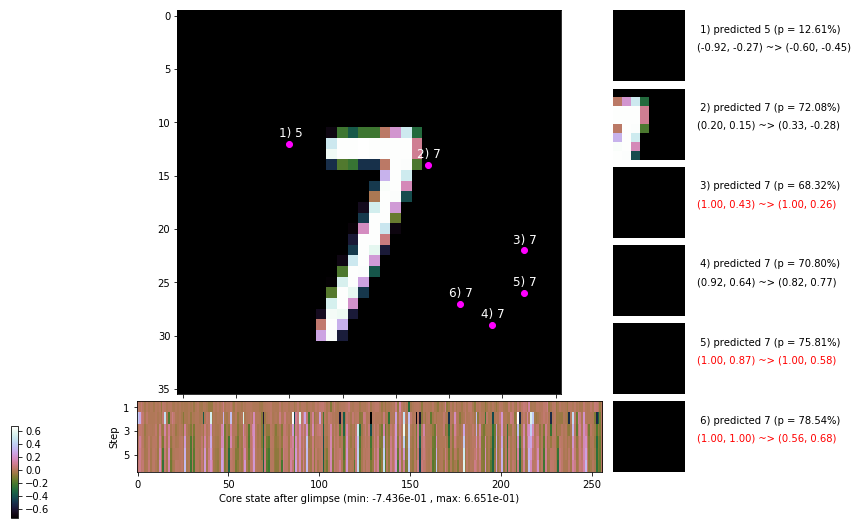

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.3 ms/b | lr: 2.98e-04 | grad 2norm: 12.53 | grad inf norm:  3.846
         Weights || abs max:  2.79 ( 3108.00) | mean: -4.66e-04 ( 0.01) | var: 8.47e-02 (  210.10)
          Biases || abs max:  1.48 (   52.97) | mean: -1.41e-01 ( 0.07) | var: 9.99e-02 (    8.42)
                    class loss: 0.326 | steps: 2.186 | reward:  3.780 | acc.: 89.03%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 140.7 ms/b | lr: 2.98e-04 | grad 2norm: 12.84 | grad inf norm:  3.930
         Weights || abs max:  2.79 ( 3314.89) | mean: -4.73e-04 ( 0.01) | var: 8.47e-02 (  200.12)
          Biases || abs max:  1.48 (  670.83) | mean: -1.41e-01 ( 0.32) | var: 9.99e-02 (30039.06)
                    class loss: 0.345 | steps: 2.211 | reward:  3.731 | acc.: 88.03%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

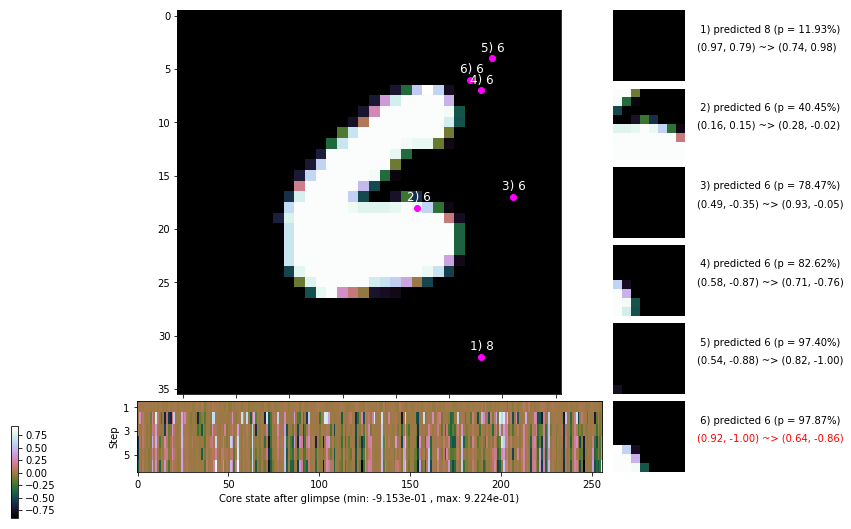

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.2 ms/b | lr: 2.97e-04 | grad 2norm: 12.62 | grad inf norm:  3.832
         Weights || abs max:  2.79 ( 3668.41) | mean: -4.73e-04 ( 0.02) | var: 8.47e-02 (  283.29)
          Biases || abs max:  1.48 (  131.35) | mean: -1.41e-01 ( 0.12) | var: 9.99e-02 (  204.12)
                    class loss: 0.335 | steps: 2.193 | reward:  3.740 | acc.: 88.58%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.6 ms/b | lr: 2.97e-04 | grad 2norm: 12.79 | grad inf norm:  3.865
         Weights || abs max:  2.80 ( 4774.70) | mean: -4.55e-04 ( 0.02) | var: 8.47e-02 ( 1378.79)
          Biases || abs max:  1.48 (  137.56) | mean: -1.40e-01 ( 0.11) | var: 1.00e-01 (  584.08)
                    class loss: 0.342 | steps: 2.224 | reward:  3.719 | acc.: 88.18%

	Target class: 6 | Discounted rewards: [-0.703, -0.406, 0

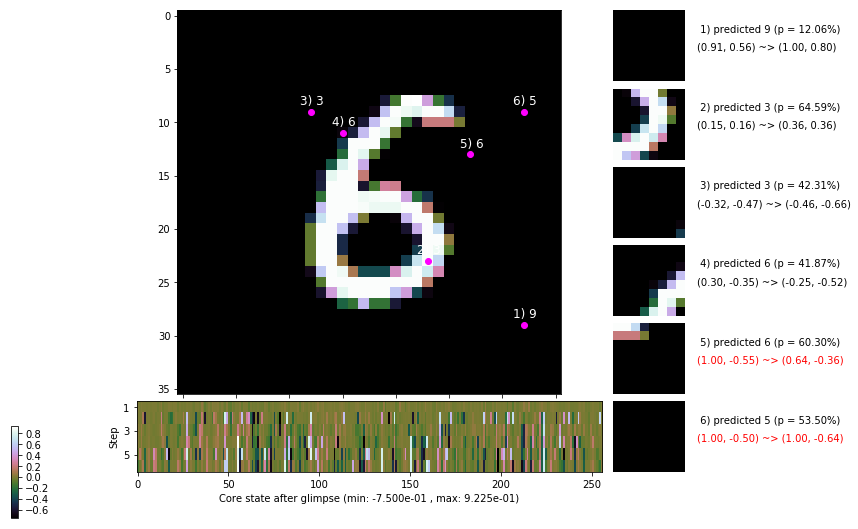

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


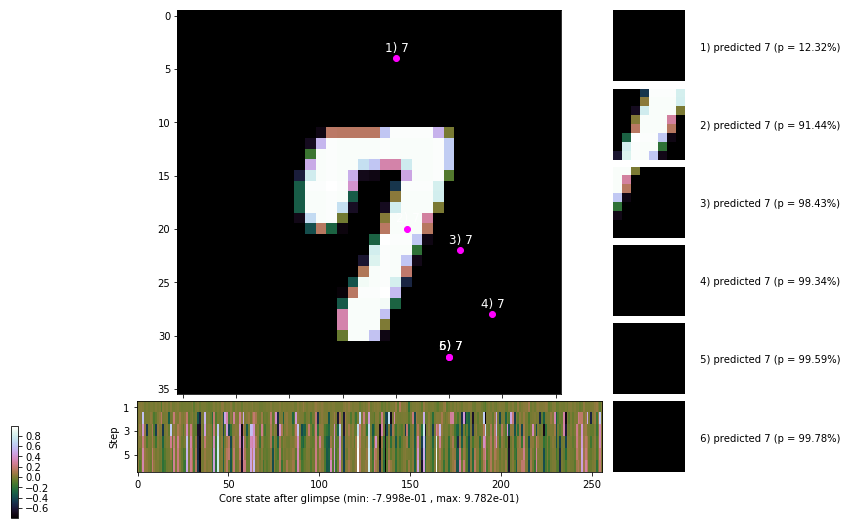


	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


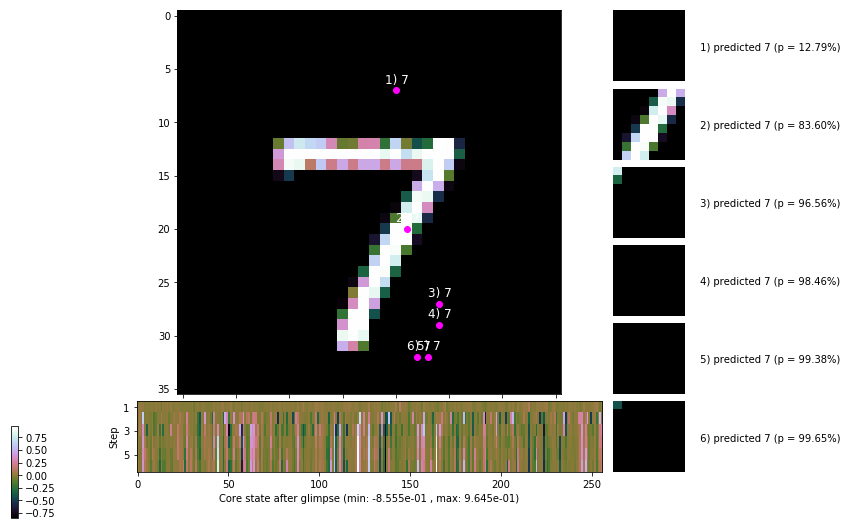

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


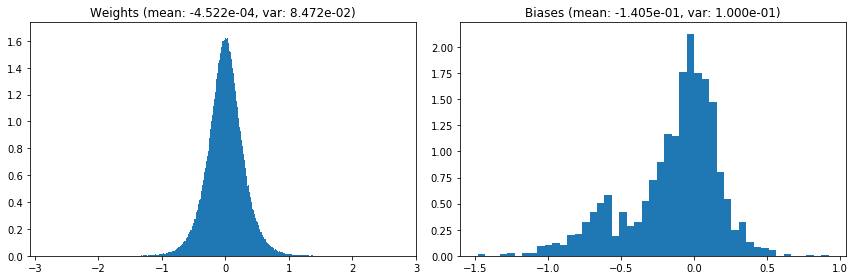

                                      Location network weights and biases


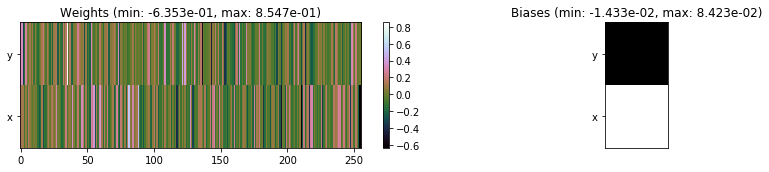

---------------------------------------------------------------------------------------------------------------
Elapsed time:  445.89 sec | TRAIN >> class loss: 0.3424 | steps:  2.212 :( | reward:  3.7322 :( | acc.: 88.342% :(
                          | VAL   >> class loss: 0.3191 | steps:  2.083    | reward:  3.9780 :( | acc.: 89.120% :(


Epoch  82/400) lr = 0.0002965
 b    300/  3000 >> 145.3 ms/b | lr: 2.96e-04 | grad 2norm: 12.79 | grad inf norm:  3.964
         Weights || abs max:  2.80 ( 2127.72) | mean: -4.49e-04 ( 0.01) | var: 8.47e-02 (  106.19)
          Biases || abs max:  1.48 (  122.23) | mean: -1.41e-01 ( 0.11) | var: 1.00e-01 (  521.33)
                    class loss: 0.354 | steps: 2.225 | reward:  3.718 | acc.: 88.42%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 141.5 ms/b | lr: 2.96e-04 | grad 2norm: 12.68 | grad inf norm:  3.662
         Weights || abs max:  2.80 ( 4901.15) | mean: -4.56e-04 (

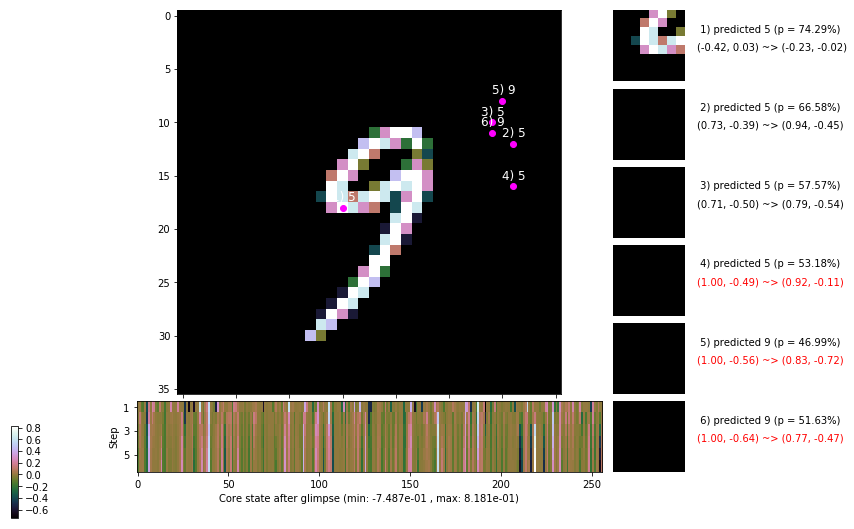

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 148.5 ms/b | lr: 2.95e-04 | grad 2norm: 12.97 | grad inf norm:  4.027
         Weights || abs max:  2.81 ( 2149.34) | mean: -4.53e-04 ( 0.01) | var: 8.48e-02 (  125.52)
          Biases || abs max:  1.49 (  181.21) | mean: -1.40e-01 ( 0.14) | var: 1.00e-01 (  307.25)
                    class loss: 0.340 | steps: 2.201 | reward:  3.747 | acc.: 88.00%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 142.0 ms/b | lr: 2.95e-04 | grad 2norm: 12.88 | grad inf norm:  3.864
         Weights || abs max:  2.81 ( 3277.97) | mean: -4.59e-04 ( 0.01) | var: 8.48e-02 (  875.21)
          Biases || abs max:  1.49 (  134.80) | mean: -1.41e-01 ( 0.12) | var: 1.00e-01 (  345.96)
                    class loss: 0.356 | steps: 2.228 | reward:  3.706 | acc.: 88.08%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

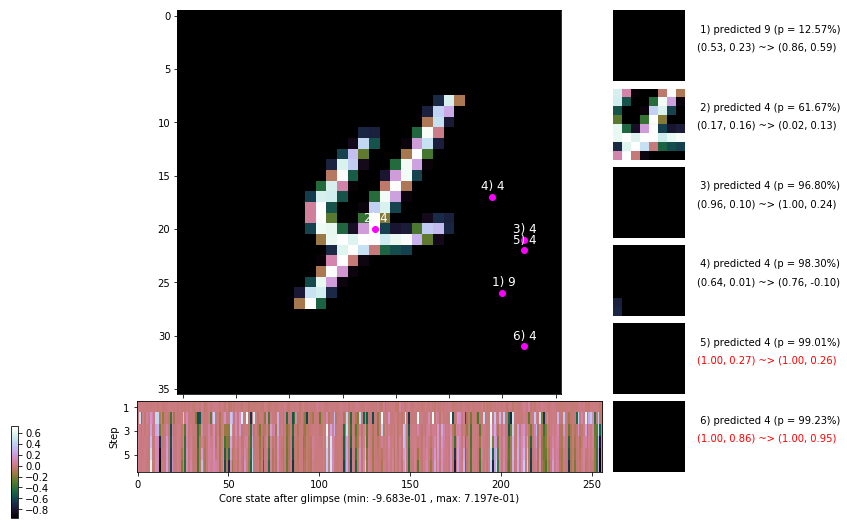

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 147.6 ms/b | lr: 2.94e-04 | grad 2norm: 12.67 | grad inf norm:  3.803
         Weights || abs max:  2.81 ( 4116.37) | mean: -4.67e-04 ( 0.02) | var: 8.48e-02 (  644.68)
          Biases || abs max:  1.49 (   96.46) | mean: -1.41e-01 ( 0.11) | var: 1.00e-01 (   38.14)
                    class loss: 0.352 | steps: 2.211 | reward:  3.727 | acc.: 88.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.5 ms/b | lr: 2.94e-04 | grad 2norm: 12.60 | grad inf norm:  3.789
         Weights || abs max:  2.81 (15605.76) | mean: -4.68e-04 ( 0.04) | var: 8.48e-02 (97467.70)
          Biases || abs max:  1.49 (  133.21) | mean: -1.41e-01 ( 0.12) | var: 1.00e-01 (   62.50)
                    class loss: 0.351 | steps: 2.234 | reward:  3.711 | acc.: 88.17%

	Target class: 8 | Discounted rewards: [-0.984, -0.969, -

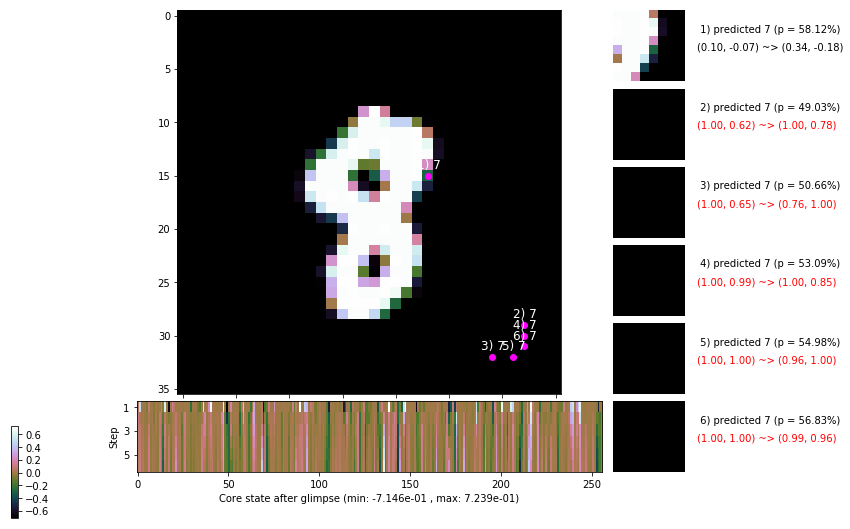

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 147.5 ms/b | lr: 2.94e-04 | grad 2norm: 12.60 | grad inf norm:  3.790
         Weights || abs max:  2.81 ( 4655.84) | mean: -4.74e-04 ( 0.02) | var: 8.48e-02 ( 3403.76)
          Biases || abs max:  1.49 (  156.62) | mean: -1.41e-01 ( 0.13) | var: 1.00e-01 (  167.94)
                    class loss: 0.343 | steps: 2.234 | reward:  3.719 | acc.: 88.20%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.9 ms/b | lr: 2.93e-04 | grad 2norm: 12.62 | grad inf norm:  3.829
         Weights || abs max:  2.81 ( 3594.93) | mean: -4.85e-04 ( 0.01) | var: 8.49e-02 (  817.32)
          Biases || abs max:  1.48 (  130.43) | mean: -1.41e-01 ( 0.12) | var: 1.00e-01 (   75.36)
                    class loss: 0.339 | steps: 2.203 | reward:  3.755 | acc.: 88.60%

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.8

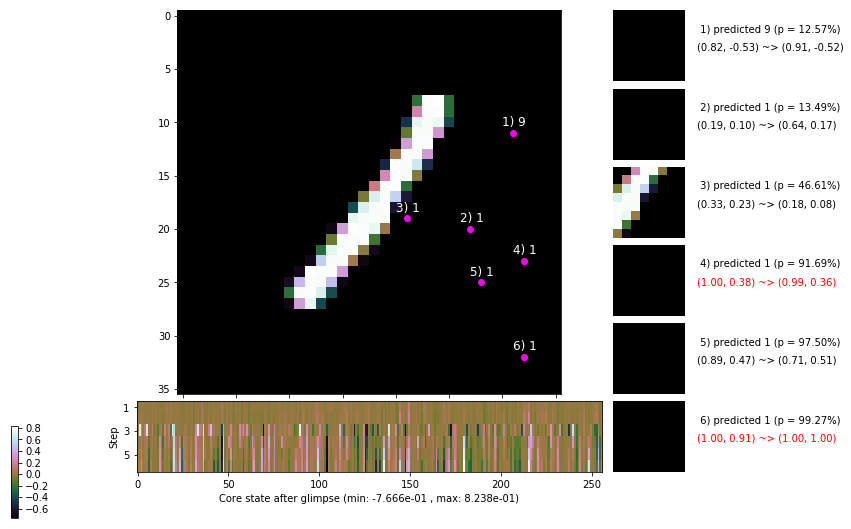

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 150.1 ms/b | lr: 2.93e-04 | grad 2norm: 12.63 | grad inf norm:  3.799
         Weights || abs max:  2.81 ( 1669.15) | mean: -4.99e-04 ( 0.01) | var: 8.49e-02 (   54.71)
          Biases || abs max:  1.49 (  184.03) | mean: -1.41e-01 ( 0.15) | var: 1.00e-01 (  800.47)
                    class loss: 0.340 | steps: 2.208 | reward:  3.737 | acc.: 88.38%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 143.1 ms/b | lr: 2.92e-04 | grad 2norm: 12.76 | grad inf norm:  3.765
         Weights || abs max:  2.81 (30820.64) | mean: -5.19e-04 ( 0.06) | var: 8.49e-02 (337201.09)
          Biases || abs max:  1.49 (  120.40) | mean: -1.41e-01 ( 0.12) | var: 1.00e-01 (  104.52)
                    class loss: 0.342 | steps: 2.227 | reward:  3.714 | acc.: 88.13%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.

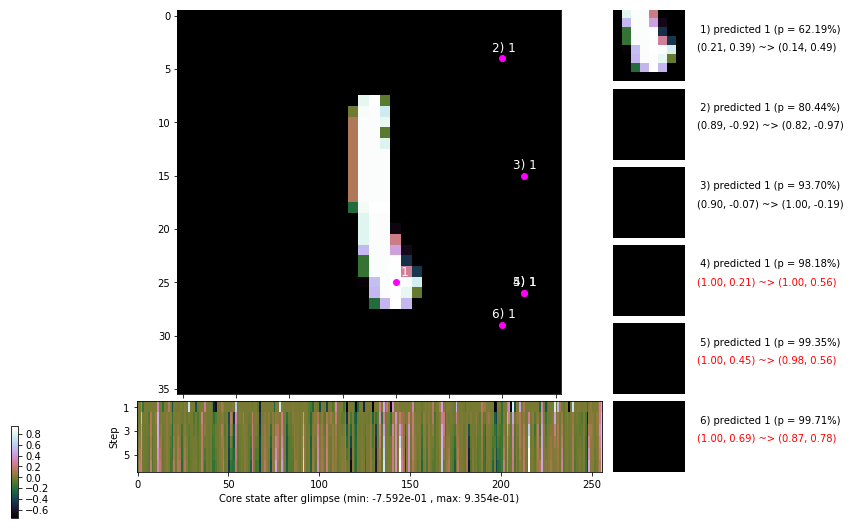

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


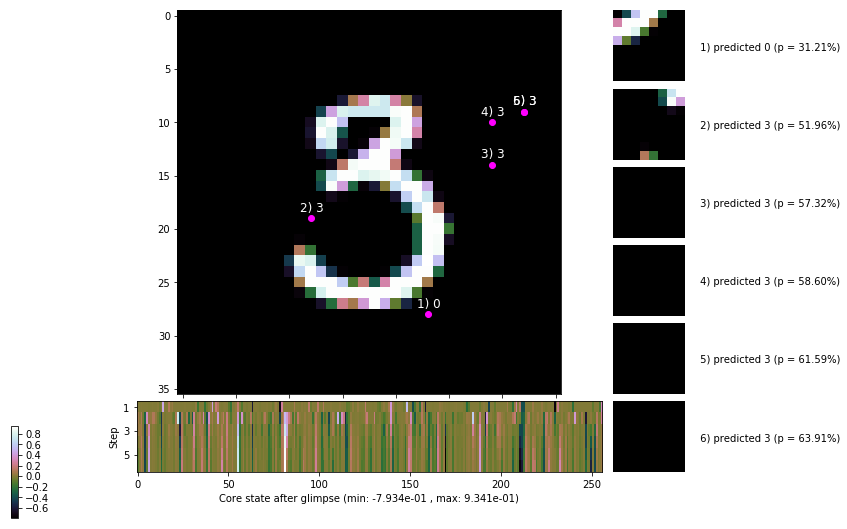


	Target class: 7 | Discounted rewards: [1.219, 0.438, 1.875, 1.750, 1.500, 1.000]


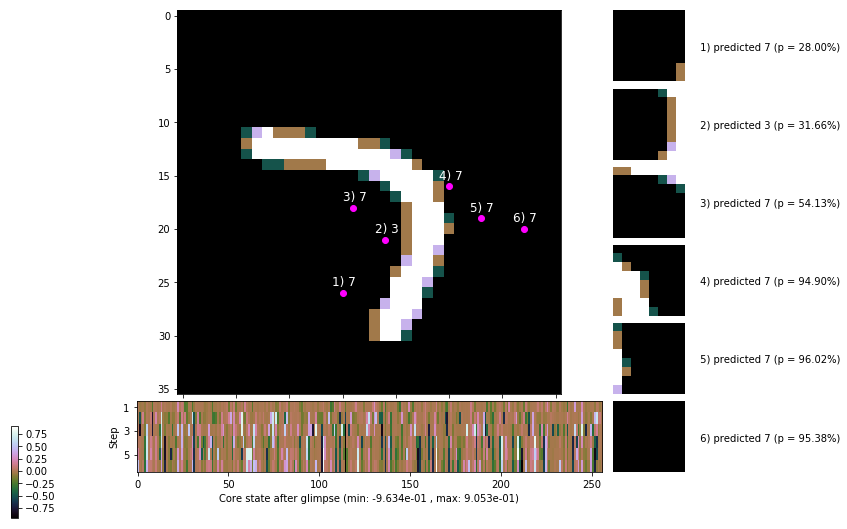

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


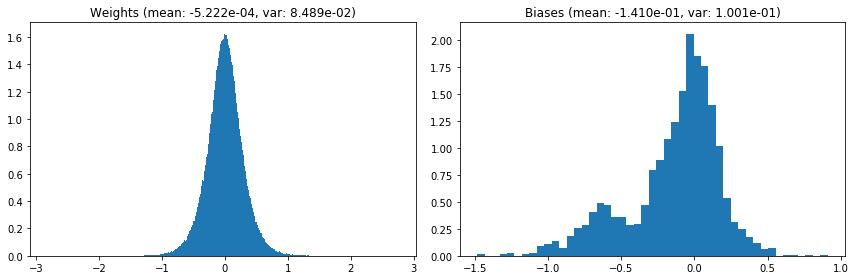

                                      Location network weights and biases


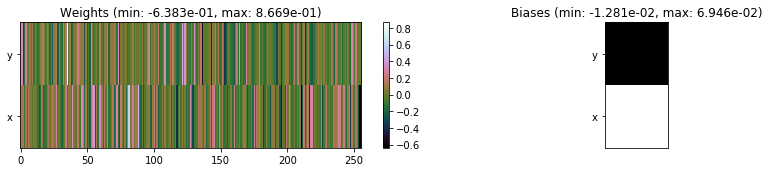

---------------------------------------------------------------------------------------------------------------
Elapsed time:  437.02 sec | TRAIN >> class loss: 0.3455 | steps:  2.217 :( | reward:  3.7293 :( | acc.: 88.252% :(
                          | VAL   >> class loss: 0.3282 | steps:  2.117 :( | reward:  3.8991 :( | acc.: 88.760% :(


Epoch  83/400) lr = 0.0002921
 b    300/  3000 >> 143.1 ms/b | lr: 2.92e-04 | grad 2norm: 12.42 | grad inf norm:  3.831
         Weights || abs max:  2.81 ( 5737.39) | mean: -5.23e-04 ( 0.02) | var: 8.49e-02 ( 2059.14)
          Biases || abs max:  1.48 (  126.14) | mean: -1.41e-01 ( 0.11) | var: 1.00e-01 (  144.94)
                    class loss: 0.327 | steps: 2.193 | reward:  3.780 | acc.: 88.97%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.6 ms/b | lr: 2.92e-04 | grad 2norm: 12.58 | grad inf norm:  3.755
         Weights || abs max:  2.81 ( 2717.57) | mean: -5.31e-04 (

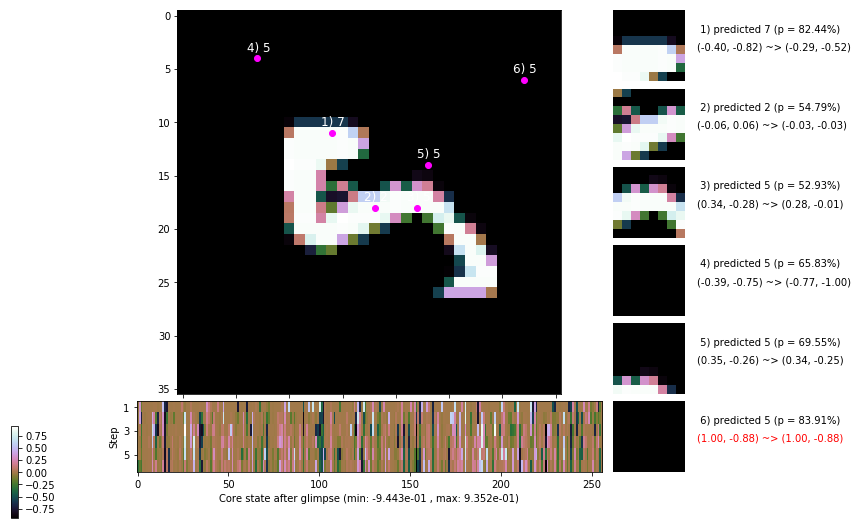

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 150.3 ms/b | lr: 2.91e-04 | grad 2norm: 12.92 | grad inf norm:  3.775
         Weights || abs max:  2.82 (33585.88) | mean: -5.26e-04 ( 0.07) | var: 8.49e-02 (525298.69)
          Biases || abs max:  1.49 (  777.22) | mean: -1.41e-01 ( 0.48) | var: 1.00e-01 (41440.46)
                    class loss: 0.372 | steps: 2.229 | reward:  3.678 | acc.: 87.50%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 145.4 ms/b | lr: 2.91e-04 | grad 2norm: 12.76 | grad inf norm:  3.982
         Weights || abs max:  2.81 ( 2853.01) | mean: -5.25e-04 ( 0.01) | var: 8.50e-02 (  189.21)
          Biases || abs max:  1.48 (   69.00) | mean: -1.41e-01 ( 0.08) | var: 1.00e-01 (   14.15)
                    class loss: 0.357 | steps: 2.218 | reward:  3.696 | acc.: 87.92%

	Target class: 8 | Discounted rewards: [-0.281, 0.438, 1

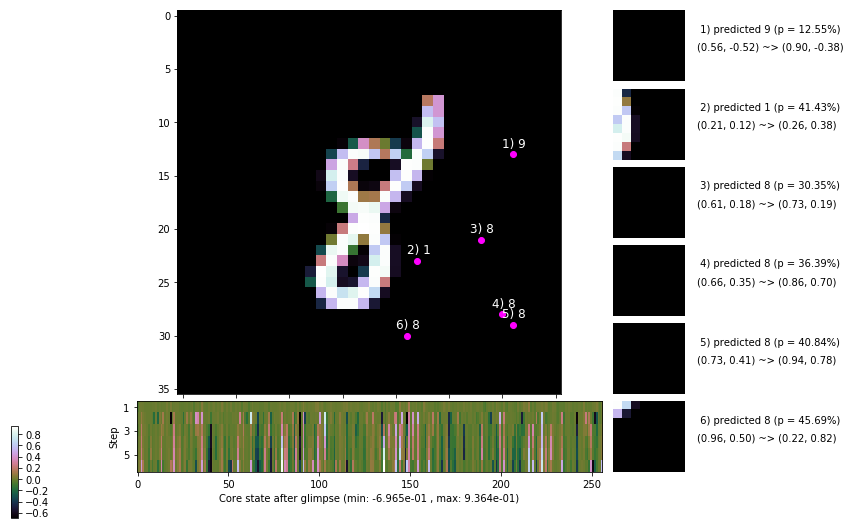

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 147.2 ms/b | lr: 2.90e-04 | grad 2norm: 12.73 | grad inf norm:  3.702
         Weights || abs max:  2.81 ( 2045.96) | mean: -5.33e-04 ( 0.01) | var: 8.50e-02 (   54.35)
          Biases || abs max:  1.49 (   97.62) | mean: -1.41e-01 ( 0.09) | var: 1.00e-01 (  119.89)
                    class loss: 0.349 | steps: 2.200 | reward:  3.742 | acc.: 88.28%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.6 ms/b | lr: 2.90e-04 | grad 2norm: 12.77 | grad inf norm:  3.798
         Weights || abs max:  2.81 ( 6694.15) | mean: -5.32e-04 ( 0.02) | var: 8.50e-02 ( 4673.08)
          Biases || abs max:  1.49 (   61.14) | mean: -1.41e-01 ( 0.08) | var: 1.00e-01 (   10.91)
                    class loss: 0.347 | steps: 2.214 | reward:  3.745 | acc.: 88.20%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

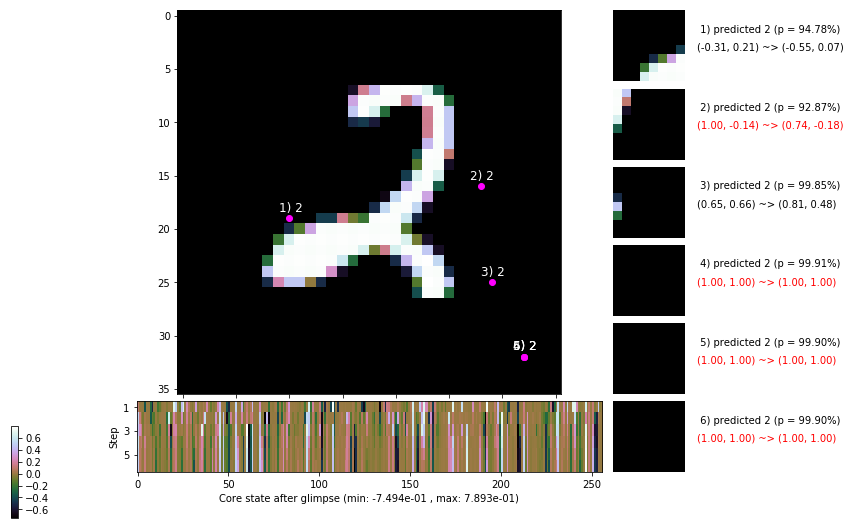

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 150.8 ms/b | lr: 2.89e-04 | grad 2norm: 12.32 | grad inf norm:  3.669
         Weights || abs max:  2.80 (11832.16) | mean: -5.30e-04 ( 0.03) | var: 8.50e-02 (20587.51)
          Biases || abs max:  1.49 (   71.19) | mean: -1.40e-01 ( 0.09) | var: 1.00e-01 (   17.99)
                    class loss: 0.332 | steps: 2.217 | reward:  3.736 | acc.: 88.62%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.8 ms/b | lr: 2.89e-04 | grad 2norm: 12.62 | grad inf norm:  3.589
         Weights || abs max:  2.80 ( 3938.24) | mean: -5.38e-04 ( 0.02) | var: 8.50e-02 (  279.65)
          Biases || abs max:  1.49 (   81.18) | mean: -1.41e-01 ( 0.09) | var: 1.00e-01 (  165.91)
                    class loss: 0.354 | steps: 2.233 | reward:  3.696 | acc.: 87.80%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

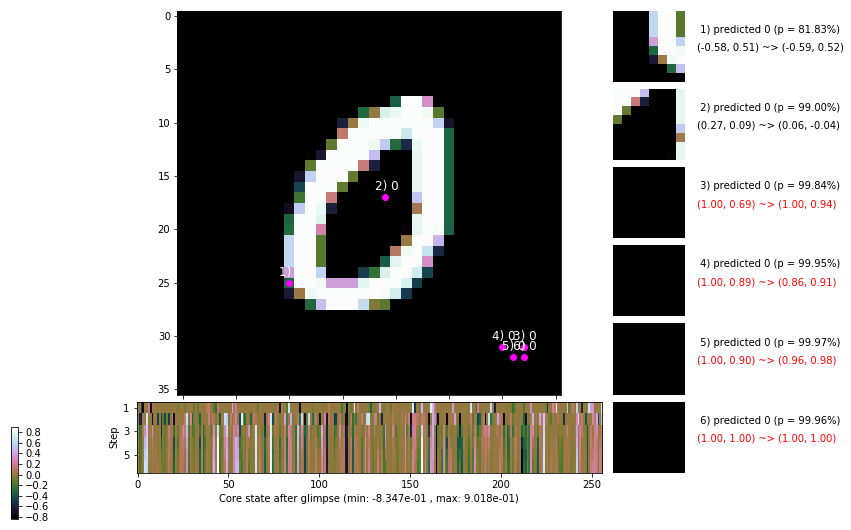

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 149.6 ms/b | lr: 2.88e-04 | grad 2norm: 12.29 | grad inf norm:  3.785
         Weights || abs max:  2.80 ( 3081.38) | mean: -5.41e-04 ( 0.01) | var: 8.51e-02 (   92.06)
          Biases || abs max:  1.48 (  113.65) | mean: -1.41e-01 ( 0.11) | var: 1.00e-01 (   87.77)
                    class loss: 0.320 | steps: 2.175 | reward:  3.799 | acc.: 89.37%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.7 ms/b | lr: 2.88e-04 | grad 2norm: 12.56 | grad inf norm:  3.770
         Weights || abs max:  2.80 ( 8835.16) | mean: -5.35e-04 ( 0.02) | var: 8.51e-02 (12186.51)
          Biases || abs max:  1.49 (  103.48) | mean: -1.41e-01 ( 0.12) | var: 1.00e-01 (  173.10)
                    class loss: 0.342 | steps: 2.197 | reward:  3.740 | acc.: 88.15%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

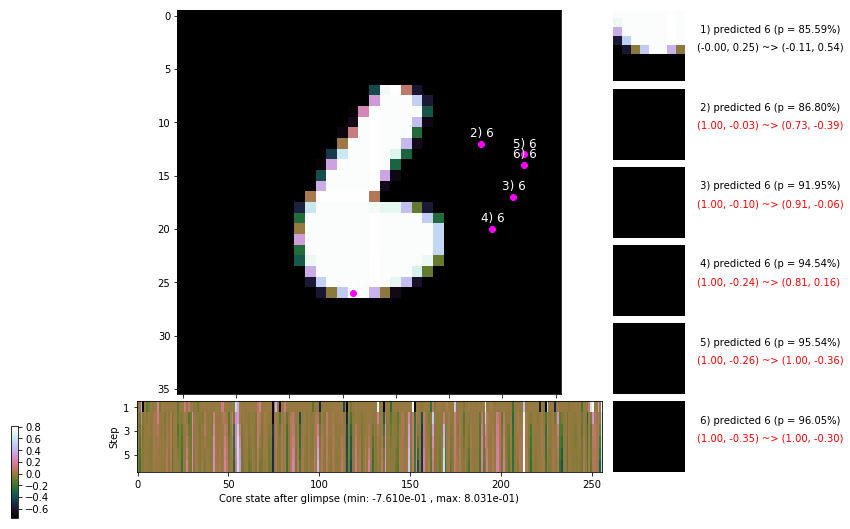

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


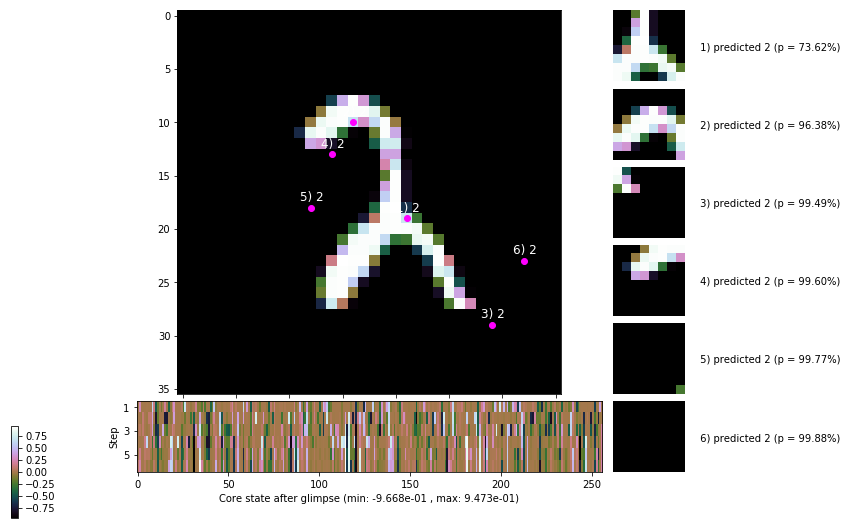


	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


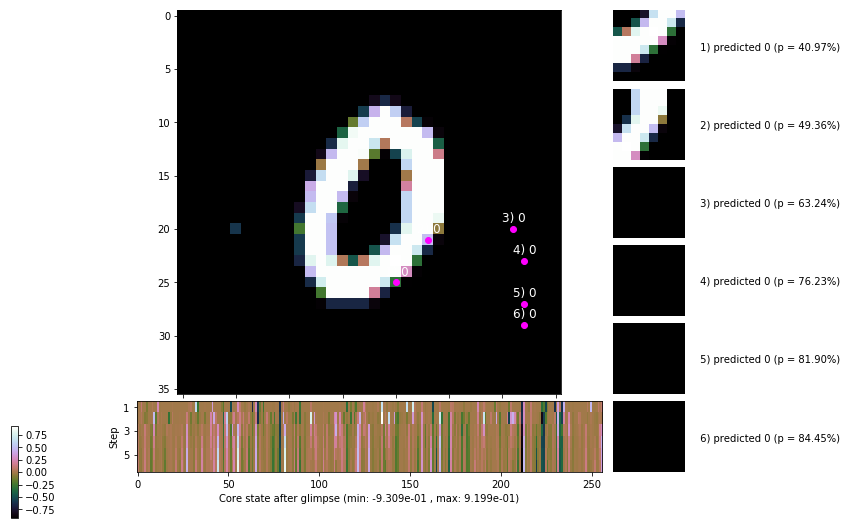

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


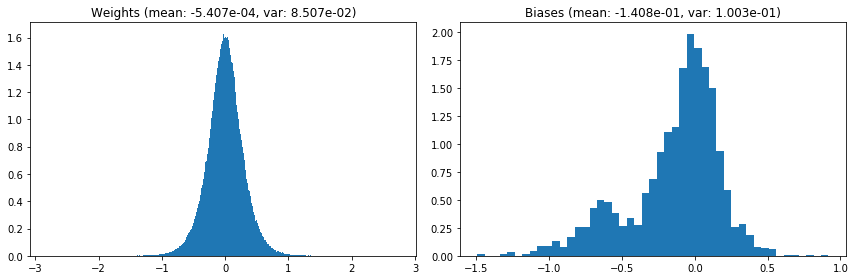

                                      Location network weights and biases


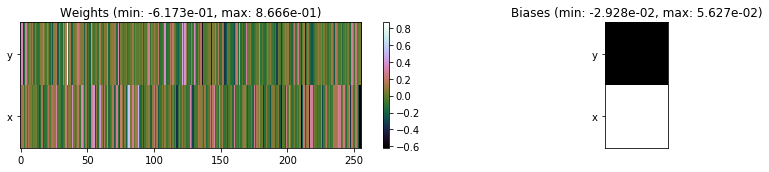

---------------------------------------------------------------------------------------------------------------
Elapsed time:  440.97 sec | TRAIN >> class loss: 0.3458 | steps:  2.210 :( | reward:  3.7338 :( | acc.: 88.307% :(
                          | VAL   >> class loss: 0.3117 | steps:  2.098 :( | reward:  3.9705 :( | acc.: 89.600% :(


Epoch  84/400) lr = 0.0002878
 b    300/  3000 >> 145.4 ms/b | lr: 2.87e-04 | grad 2norm: 12.20 | grad inf norm:  3.643
         Weights || abs max:  2.81 ( 2157.18) | mean: -5.49e-04 ( 0.01) | var: 8.51e-02 (   80.15)
          Biases || abs max:  1.49 (   87.43) | mean: -1.41e-01 ( 0.09) | var: 1.00e-01 (   58.07)
                    class loss: 0.318 | steps: 2.196 | reward:  3.789 | acc.: 89.27%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.8 ms/b | lr: 2.87e-04 | grad 2norm: 12.93 | grad inf norm:  3.922
         Weights || abs max:  2.81 ( 4151.31) | mean: -5.41e-04 (

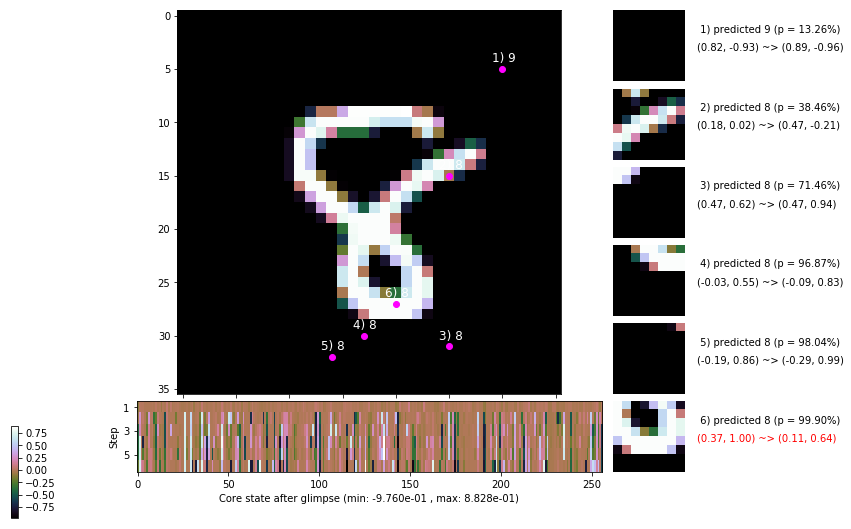

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.9 ms/b | lr: 2.87e-04 | grad 2norm: 12.69 | grad inf norm:  3.845
         Weights || abs max:  2.81 ( 4288.83) | mean: -5.28e-04 ( 0.02) | var: 8.51e-02 (  545.22)
          Biases || abs max:  1.49 (  159.94) | mean: -1.41e-01 ( 0.13) | var: 1.00e-01 (  150.64)
                    class loss: 0.357 | steps: 2.190 | reward:  3.767 | acc.: 88.13%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.3 ms/b | lr: 2.86e-04 | grad 2norm: 12.64 | grad inf norm:  3.731
         Weights || abs max:  2.83 ( 2477.74) | mean: -5.21e-04 ( 0.01) | var: 8.51e-02 (  117.94)
          Biases || abs max:  1.49 (  122.26) | mean: -1.41e-01 ( 0.12) | var: 1.00e-01 (   34.01)
                    class loss: 0.336 | steps: 2.221 | reward:  3.731 | acc.: 88.45%

	Target class: 2 | Discounted rewards: [-0.656, -0.312, 0

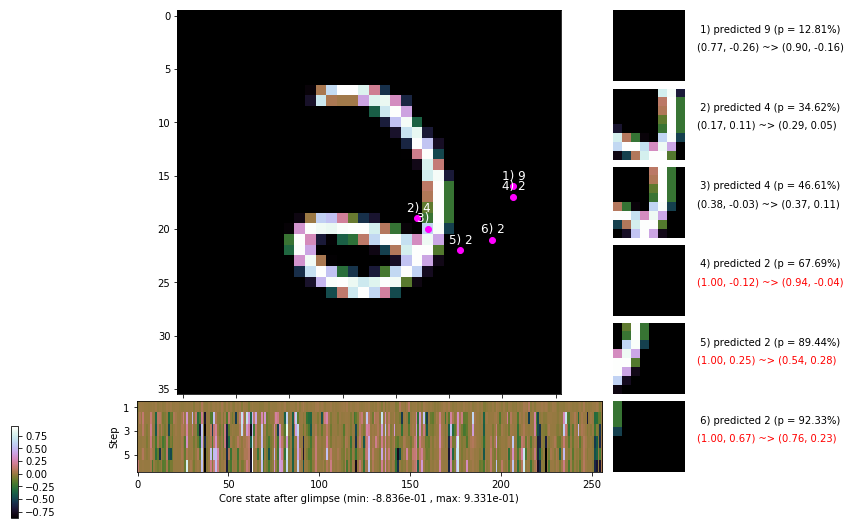

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 145.0 ms/b | lr: 2.86e-04 | grad 2norm: 12.49 | grad inf norm:  3.772
         Weights || abs max:  2.83 ( 3752.98) | mean: -5.20e-04 ( 0.01) | var: 8.51e-02 (  462.09)
          Biases || abs max:  1.49 (  319.91) | mean: -1.41e-01 ( 0.23) | var: 1.00e-01 ( 4225.62)
                    class loss: 0.340 | steps: 2.171 | reward:  3.781 | acc.: 88.63%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.4 ms/b | lr: 2.85e-04 | grad 2norm: 12.49 | grad inf norm:  3.638
         Weights || abs max:  2.82 ( 2598.78) | mean: -5.22e-04 ( 0.01) | var: 8.52e-02 (  196.21)
          Biases || abs max:  1.49 (  163.32) | mean: -1.41e-01 ( 0.15) | var: 1.00e-01 (  182.05)
                    class loss: 0.343 | steps: 2.208 | reward:  3.761 | acc.: 88.73%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

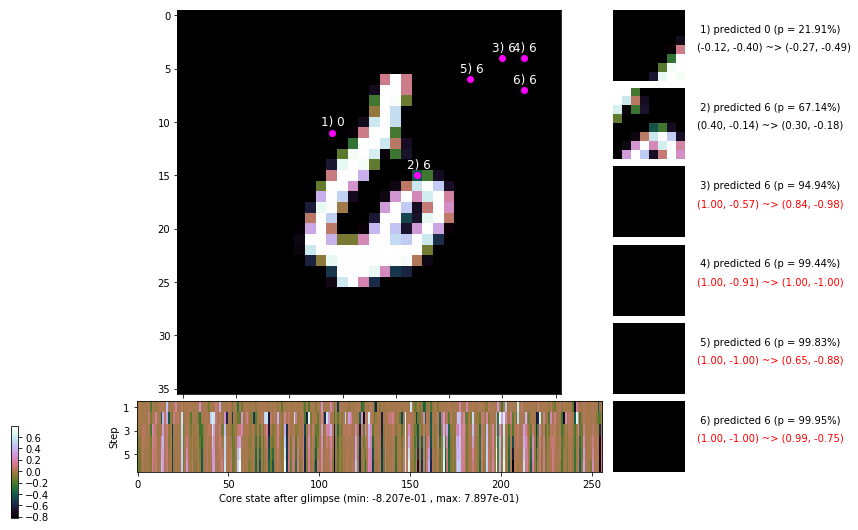

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 151.4 ms/b | lr: 2.85e-04 | grad 2norm: 12.59 | grad inf norm:  3.711
         Weights || abs max:  2.82 ( 2594.02) | mean: -5.40e-04 ( 0.01) | var: 8.52e-02 (  495.82)
          Biases || abs max:  1.49 (   96.44) | mean: -1.41e-01 ( 0.10) | var: 1.00e-01 (   64.13)
                    class loss: 0.334 | steps: 2.164 | reward:  3.801 | acc.: 88.65%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 147.4 ms/b | lr: 2.85e-04 | grad 2norm: 12.69 | grad inf norm:  3.919
         Weights || abs max:  2.83 ( 1951.13) | mean: -5.40e-04 ( 0.01) | var: 8.52e-02 (  104.76)
          Biases || abs max:  1.49 (  133.92) | mean: -1.41e-01 ( 0.14) | var: 1.00e-01 (  245.91)
                    class loss: 0.340 | steps: 2.201 | reward:  3.769 | acc.: 88.53%

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.8

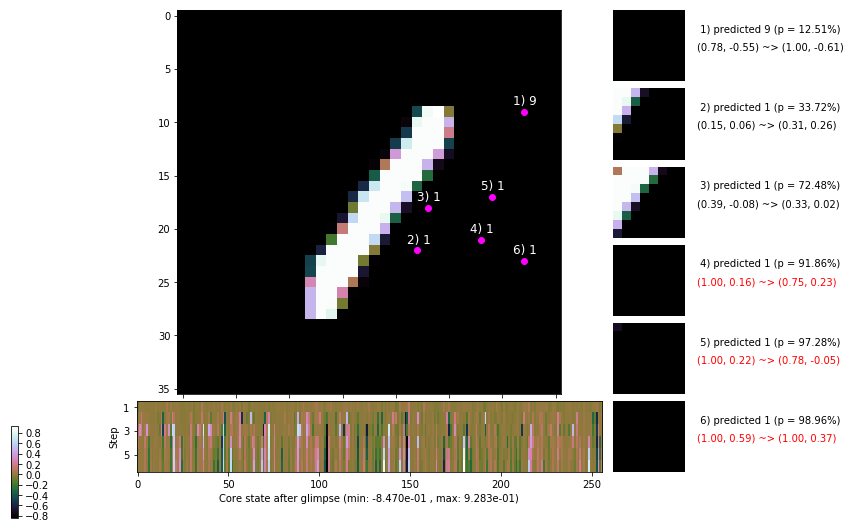

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 149.4 ms/b | lr: 2.84e-04 | grad 2norm: 12.22 | grad inf norm:  3.671
         Weights || abs max:  2.83 ( 9693.96) | mean: -5.26e-04 ( 0.03) | var: 8.52e-02 (13957.19)
          Biases || abs max:  1.49 (  155.81) | mean: -1.41e-01 ( 0.15) | var: 1.00e-01 (  113.12)
                    class loss: 0.307 | steps: 2.186 | reward:  3.817 | acc.: 89.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 149.5 ms/b | lr: 2.84e-04 | grad 2norm: 12.40 | grad inf norm:  3.821
         Weights || abs max:  2.83 ( 3967.64) | mean: -5.27e-04 ( 0.02) | var: 8.52e-02 (  461.91)
          Biases || abs max:  1.49 (  137.92) | mean: -1.40e-01 ( 0.13) | var: 1.00e-01 (  185.39)
                    class loss: 0.340 | steps: 2.198 | reward:  3.773 | acc.: 88.78%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

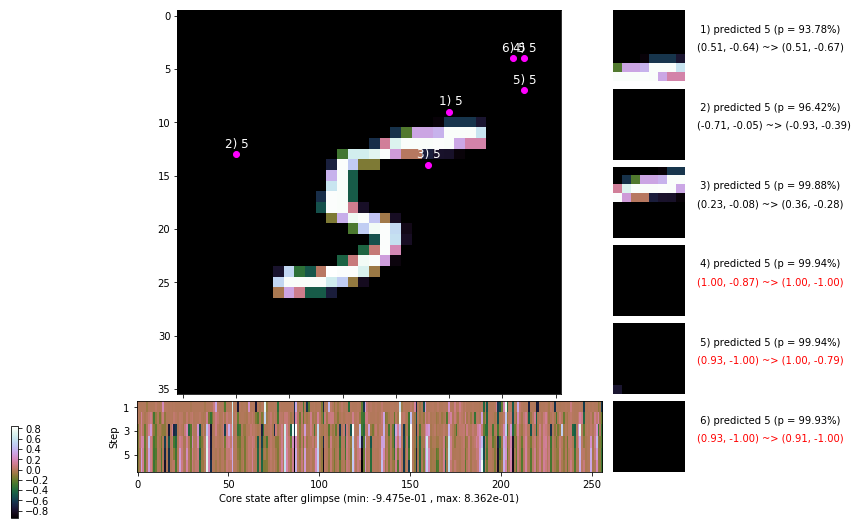

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


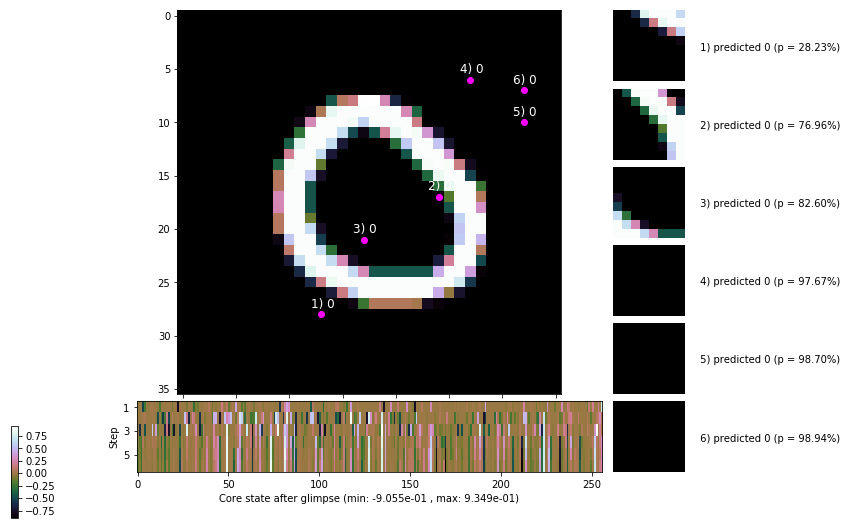


	Target class: 8 | Discounted rewards: [0.328, 1.656, 1.312, 0.625, -0.750, -0.500]


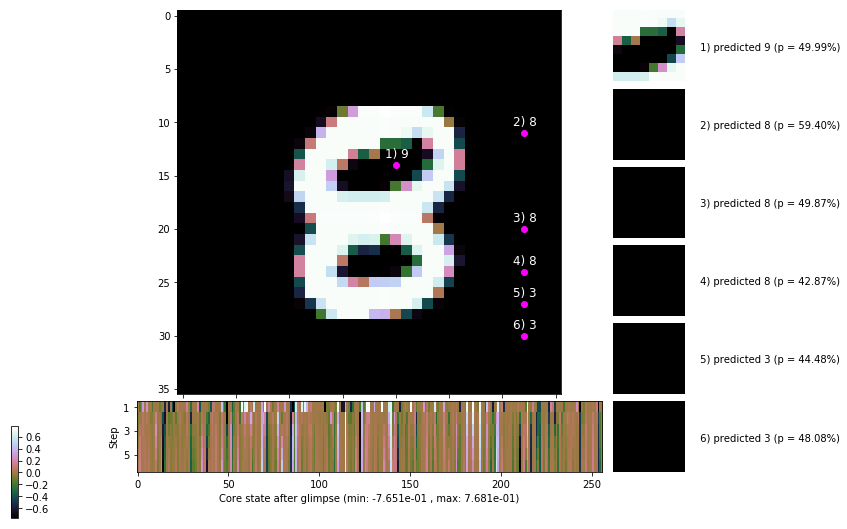

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


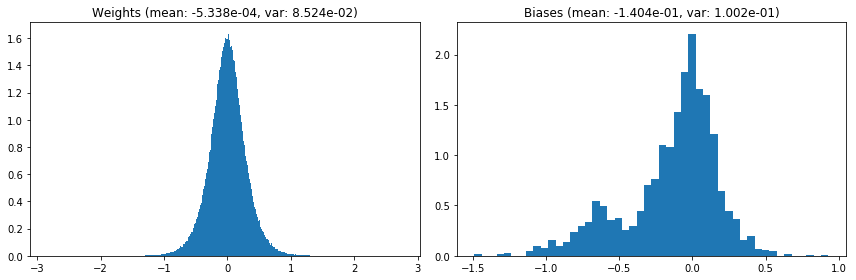

                                      Location network weights and biases


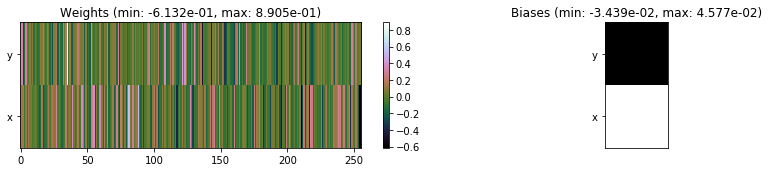

---------------------------------------------------------------------------------------------------------------
Elapsed time:  442.28 sec | TRAIN >> class loss: 0.3359 | steps:  2.197    | reward:  3.7684    | acc.: 88.700% :(
                          | VAL   >> class loss: 0.3227 | steps:  2.092 :( | reward:  3.9828 :( | acc.: 89.360% :(


Epoch  85/400) lr = 0.0002835
 b    300/  3000 >> 144.7 ms/b | lr: 2.83e-04 | grad 2norm: 12.08 | grad inf norm:  3.582
         Weights || abs max:  2.83 ( 4480.13) | mean: -5.32e-04 ( 0.02) | var: 8.53e-02 (  459.27)
          Biases || abs max:  1.49 (   91.33) | mean: -1.41e-01 ( 0.10) | var: 1.00e-01 (   47.20)
                    class loss: 0.319 | steps: 2.142 | reward:  3.859 | acc.: 89.42%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 149.5 ms/b | lr: 2.83e-04 | grad 2norm: 12.56 | grad inf norm:  3.811
         Weights || abs max:  2.83 ( 1473.56) | mean: -5.24e-04 (

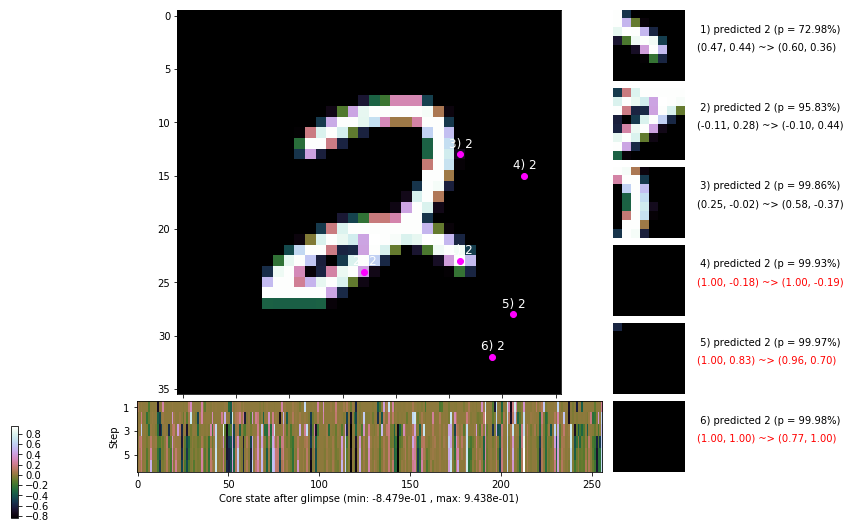

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.5 ms/b | lr: 2.82e-04 | grad 2norm: 12.67 | grad inf norm:  3.755
         Weights || abs max:  2.83 ( 4335.14) | mean: -5.16e-04 ( 0.02) | var: 8.53e-02 (  524.17)
          Biases || abs max:  1.49 (   59.19) | mean: -1.41e-01 ( 0.08) | var: 1.00e-01 (   11.19)
                    class loss: 0.334 | steps: 2.212 | reward:  3.742 | acc.: 88.65%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 146.0 ms/b | lr: 2.82e-04 | grad 2norm: 12.67 | grad inf norm:  3.866
         Weights || abs max:  2.84 ( 7079.28) | mean: -5.20e-04 ( 0.02) | var: 8.53e-02 ( 5580.36)
          Biases || abs max:  1.49 (  182.82) | mean: -1.41e-01 ( 0.15) | var: 1.00e-01 (  129.56)
                    class loss: 0.346 | steps: 2.210 | reward:  3.740 | acc.: 88.05%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

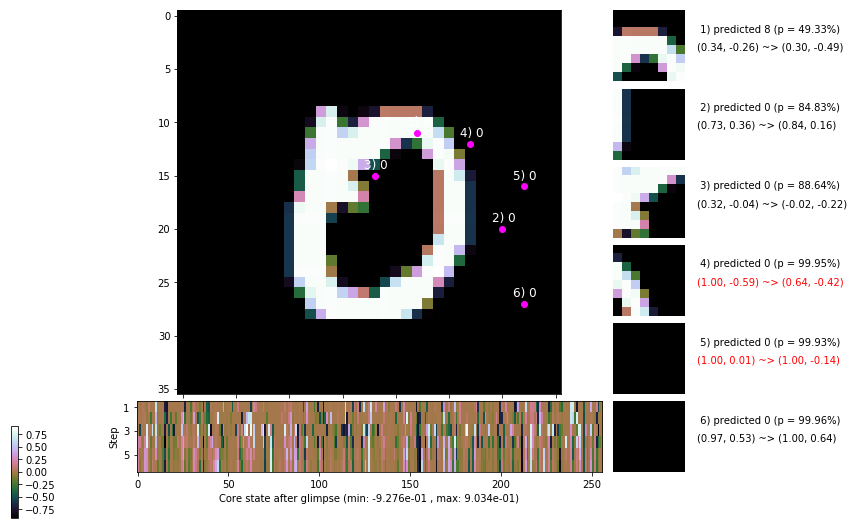

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 148.5 ms/b | lr: 2.81e-04 | grad 2norm: 12.48 | grad inf norm:  3.790
         Weights || abs max:  2.84 ( 2529.97) | mean: -5.15e-04 ( 0.01) | var: 8.53e-02 (   98.20)
          Biases || abs max:  1.49 (  196.98) | mean: -1.41e-01 ( 0.15) | var: 1.00e-01 (  398.76)
                    class loss: 0.333 | steps: 2.176 | reward:  3.773 | acc.: 88.73%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 155.0 ms/b | lr: 2.81e-04 | grad 2norm: 12.70 | grad inf norm:  3.915
         Weights || abs max:  2.84 ( 2344.14) | mean: -5.07e-04 ( 0.01) | var: 8.53e-02 (   98.95)
          Biases || abs max:  1.49 (   72.79) | mean: -1.41e-01 ( 0.10) | var: 1.00e-01 (   21.50)
                    class loss: 0.346 | steps: 2.194 | reward:  3.776 | acc.: 88.53%

	Target class: 1 | Discounted rewards: [-0.281, 0.438, 1.

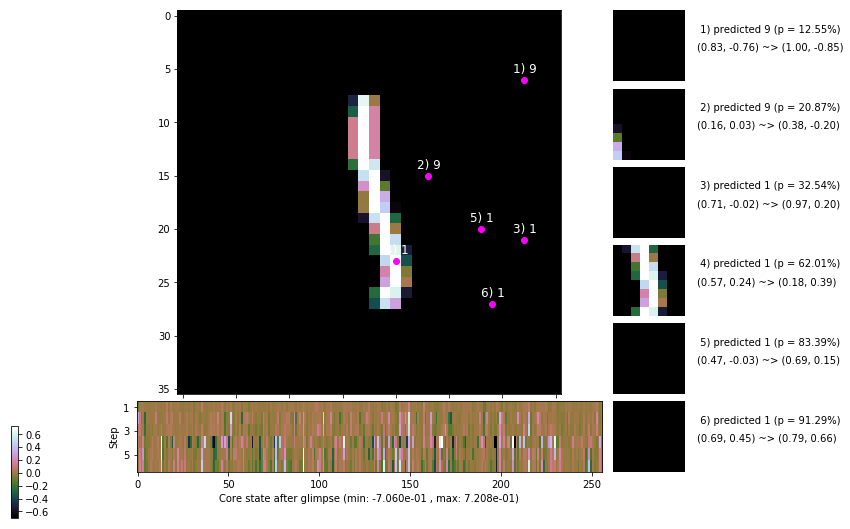

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 151.7 ms/b | lr: 2.81e-04 | grad 2norm: 12.80 | grad inf norm:  3.931
         Weights || abs max:  2.85 ( 3141.74) | mean: -4.99e-04 ( 0.01) | var: 8.54e-02 (  481.97)
          Biases || abs max:  1.49 (   70.73) | mean: -1.41e-01 ( 0.10) | var: 1.01e-01 (   23.78)
                    class loss: 0.360 | steps: 2.210 | reward:  3.722 | acc.: 87.80%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.1 ms/b | lr: 2.80e-04 | grad 2norm: 12.26 | grad inf norm:  3.674
         Weights || abs max:  2.85 (29454.21) | mean: -4.94e-04 ( 0.06) | var: 8.54e-02 (356441.88)
          Biases || abs max:  1.49 (  126.38) | mean: -1.41e-01 ( 0.12) | var: 1.01e-01 (   82.47)
                    class loss: 0.331 | steps: 2.184 | reward:  3.807 | acc.: 88.85%

	Target class: 5 | Discounted rewards: [-0.656, -0.312, 

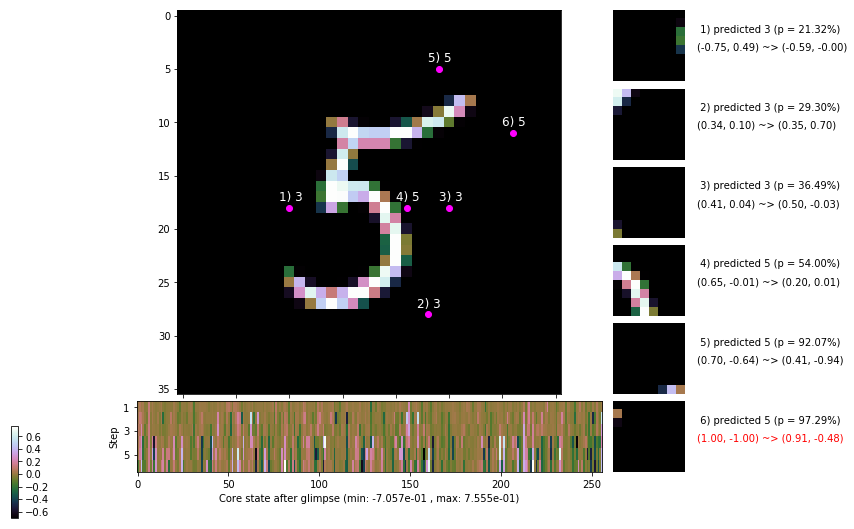

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 144.2 ms/b | lr: 2.80e-04 | grad 2norm: 12.48 | grad inf norm:  3.846
         Weights || abs max:  2.84 ( 3056.60) | mean: -4.80e-04 ( 0.01) | var: 8.54e-02 (  453.09)
          Biases || abs max:  1.50 (   83.45) | mean: -1.41e-01 ( 0.09) | var: 1.01e-01 (   45.84)
                    class loss: 0.345 | steps: 2.229 | reward:  3.725 | acc.: 88.52%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 148.6 ms/b | lr: 2.80e-04 | grad 2norm: 12.54 | grad inf norm:  3.818
         Weights || abs max:  2.84 ( 2348.42) | mean: -4.74e-04 ( 0.01) | var: 8.54e-02 (   63.78)
          Biases || abs max:  1.50 (   84.36) | mean: -1.41e-01 ( 0.09) | var: 1.01e-01 (   23.00)
                    class loss: 0.337 | steps: 2.218 | reward:  3.755 | acc.: 88.92%

	Target class: 8 | Discounted rewards: [-0.328, 0.344, 1.

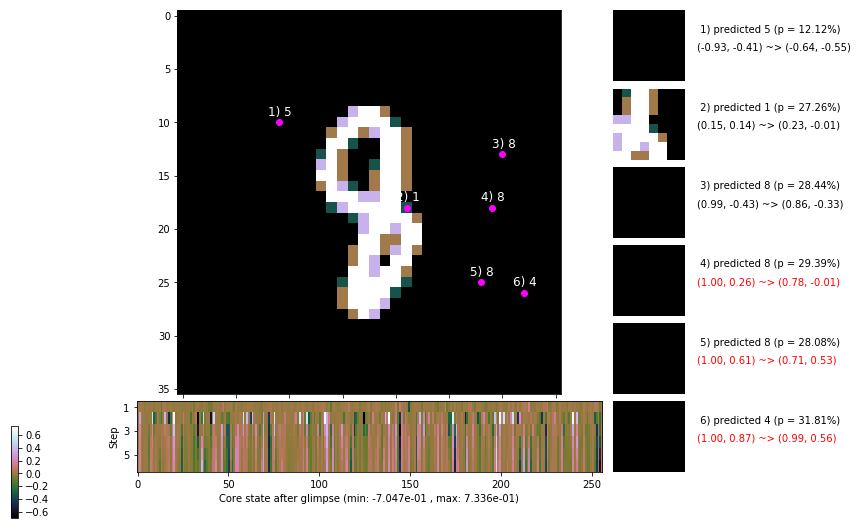

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


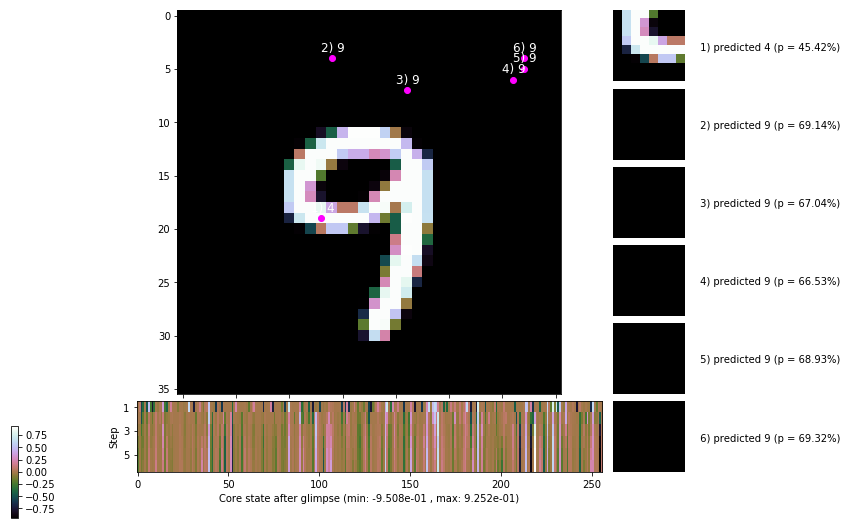


	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


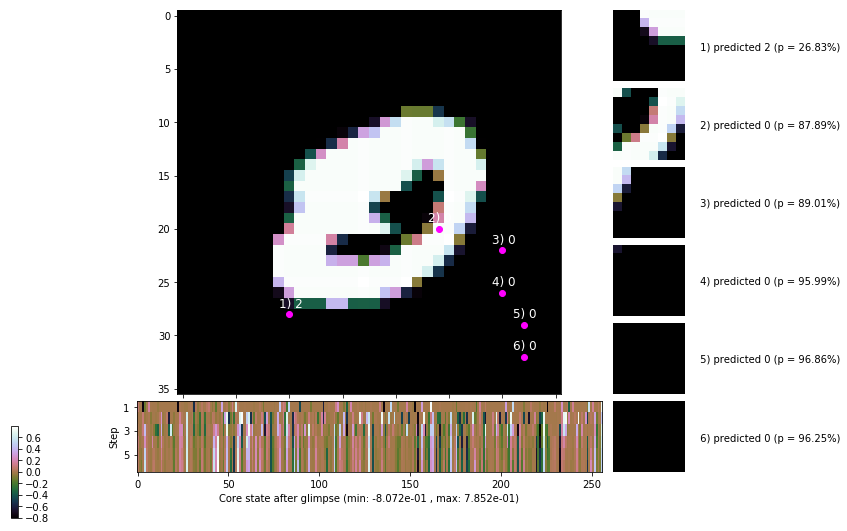

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


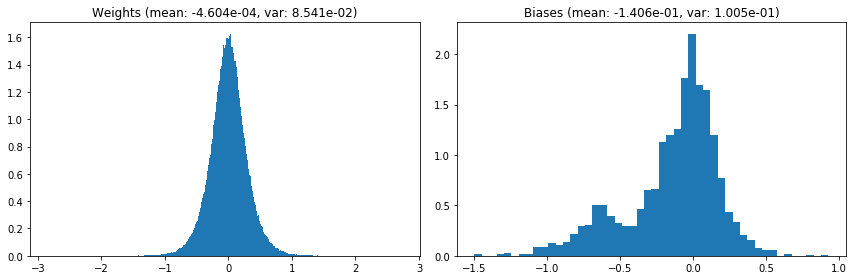

                                      Location network weights and biases


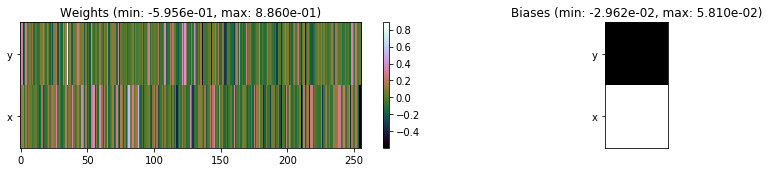

---------------------------------------------------------------------------------------------------------------
Elapsed time:  446.93 sec | TRAIN >> class loss: 0.3397 | steps:  2.197 :( | reward:  3.7673 :( | acc.: 88.603% :(
                          | VAL   >> class loss: 0.3038 | steps:  2.096 :( | reward:  3.9834 :( | acc.: 90.180% :(


Epoch  86/400) lr = 0.0002793
 b    300/  3000 >> 152.0 ms/b | lr: 2.79e-04 | grad 2norm: 12.59 | grad inf norm:  3.806
         Weights || abs max:  2.84 ( 3377.49) | mean: -4.56e-04 ( 0.01) | var: 8.54e-02 (  247.39)
          Biases || abs max:  1.50 (   89.77) | mean: -1.40e-01 ( 0.10) | var: 1.00e-01 (   30.19)
                    class loss: 0.339 | steps: 2.189 | reward:  3.787 | acc.: 88.75%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 146.8 ms/b | lr: 2.79e-04 | grad 2norm: 12.51 | grad inf norm:  3.786
         Weights || abs max:  2.84 ( 2078.24) | mean: -4.72e-04 (

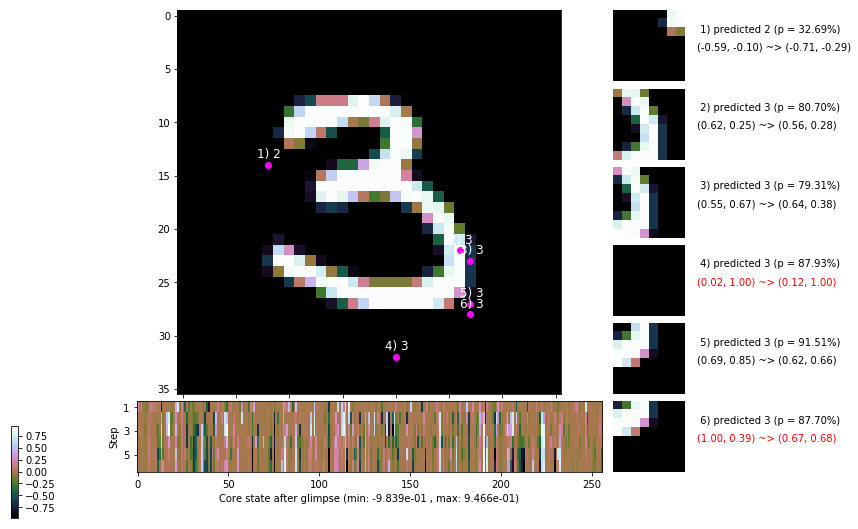

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.2 ms/b | lr: 2.78e-04 | grad 2norm: 12.45 | grad inf norm:  3.734
         Weights || abs max:  2.85 ( 5946.32) | mean: -4.71e-04 ( 0.02) | var: 8.55e-02 ( 8508.52)
          Biases || abs max:  1.50 (  109.88) | mean: -1.41e-01 ( 0.12) | var: 1.01e-01 (  320.91)
                    class loss: 0.353 | steps: 2.178 | reward:  3.780 | acc.: 88.20%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 156.4 ms/b | lr: 2.78e-04 | grad 2norm: 12.38 | grad inf norm:  3.642
         Weights || abs max:  2.85 ( 3858.10) | mean: -4.70e-04 ( 0.01) | var: 8.55e-02 ( 1145.11)
          Biases || abs max:  1.50 (  133.10) | mean: -1.41e-01 ( 0.12) | var: 1.01e-01 (  129.47)
                    class loss: 0.314 | steps: 2.174 | reward:  3.808 | acc.: 88.95%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

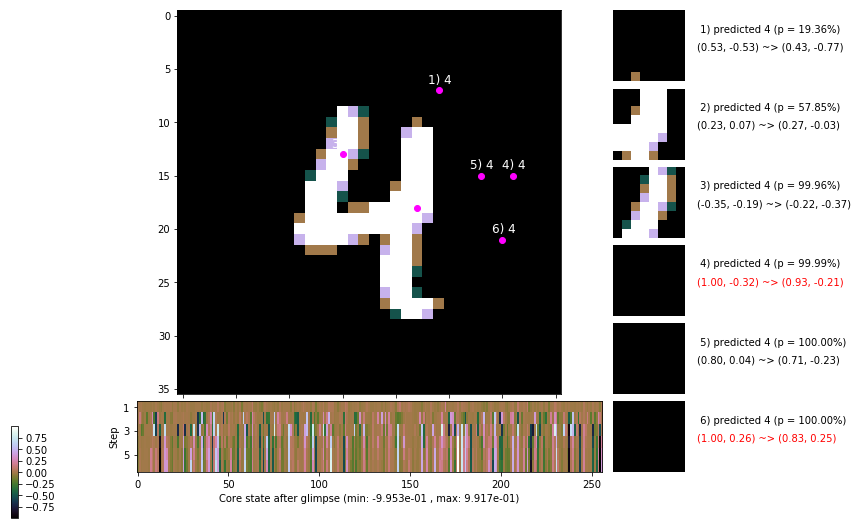

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 159.9 ms/b | lr: 2.77e-04 | grad 2norm: 12.58 | grad inf norm:  3.749
         Weights || abs max:  2.85 ( 4340.33) | mean: -4.74e-04 ( 0.02) | var: 8.55e-02 (  411.19)
          Biases || abs max:  1.50 (  684.90) | mean: -1.40e-01 ( 0.34) | var: 1.00e-01 (22612.26)
                    class loss: 0.345 | steps: 2.174 | reward:  3.777 | acc.: 88.55%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 150.3 ms/b | lr: 2.77e-04 | grad 2norm: 12.47 | grad inf norm:  3.720
         Weights || abs max:  2.85 ( 1728.77) | mean: -4.91e-04 ( 0.01) | var: 8.55e-02 (   37.43)
          Biases || abs max:  1.50 (  236.27) | mean: -1.41e-01 ( 0.17) | var: 1.01e-01 (  503.92)
                    class loss: 0.326 | steps: 2.199 | reward:  3.786 | acc.: 88.93%

	Target class: 9 | Discounted rewards: [-0.797, -0.594, -

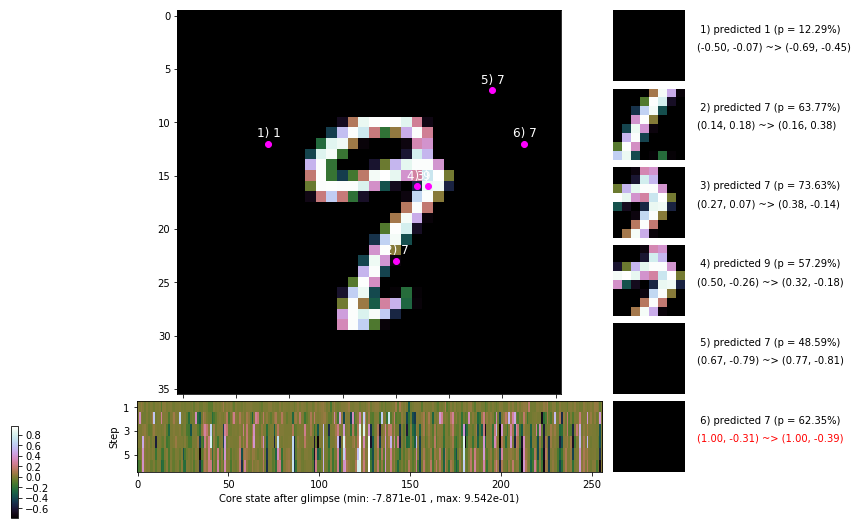

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 162.5 ms/b | lr: 2.76e-04 | grad 2norm: 12.63 | grad inf norm:  3.786
         Weights || abs max:  2.85 ( 4559.88) | mean: -4.94e-04 ( 0.02) | var: 8.55e-02 ( 1612.46)
          Biases || abs max:  1.50 (  302.55) | mean: -1.40e-01 ( 0.21) | var: 1.01e-01 (  949.45)
                    class loss: 0.334 | steps: 2.185 | reward:  3.754 | acc.: 88.10%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.0 ms/b | lr: 2.76e-04 | grad 2norm: 12.46 | grad inf norm:  3.659
         Weights || abs max:  2.85 ( 6563.90) | mean: -4.95e-04 ( 0.02) | var: 8.55e-02 ( 7102.90)
          Biases || abs max:  1.50 (  412.47) | mean: -1.41e-01 ( 0.25) | var: 1.01e-01 ( 3444.95)
                    class loss: 0.329 | steps: 2.184 | reward:  3.799 | acc.: 89.02%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.8

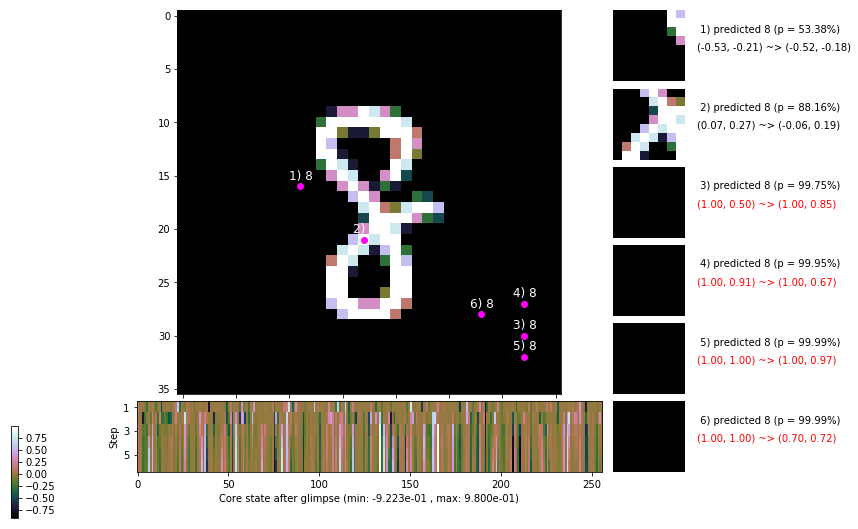

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.5 ms/b | lr: 2.76e-04 | grad 2norm: 12.58 | grad inf norm:  3.879
         Weights || abs max:  2.85 (11618.91) | mean: -4.88e-04 ( 0.03) | var: 8.56e-02 (31172.37)
          Biases || abs max:  1.50 (  261.12) | mean: -1.41e-01 ( 0.22) | var: 1.01e-01 ( 1205.98)
                    class loss: 0.338 | steps: 2.205 | reward:  3.741 | acc.: 88.30%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.1 ms/b | lr: 2.75e-04 | grad 2norm: 12.30 | grad inf norm:  3.710
         Weights || abs max:  2.86 ( 2961.39) | mean: -4.78e-04 ( 0.01) | var: 8.56e-02 (  295.48)
          Biases || abs max:  1.50 (  169.25) | mean: -1.41e-01 ( 0.15) | var: 1.01e-01 (   72.41)
                    class loss: 0.323 | steps: 2.195 | reward:  3.796 | acc.: 89.32%

	Target class: 9 | Discounted rewards: [0.516, -0.969, -0

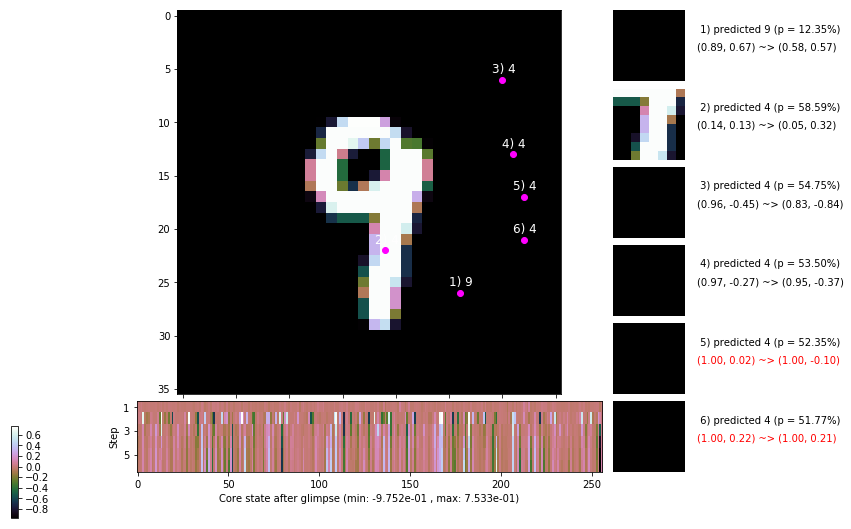

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


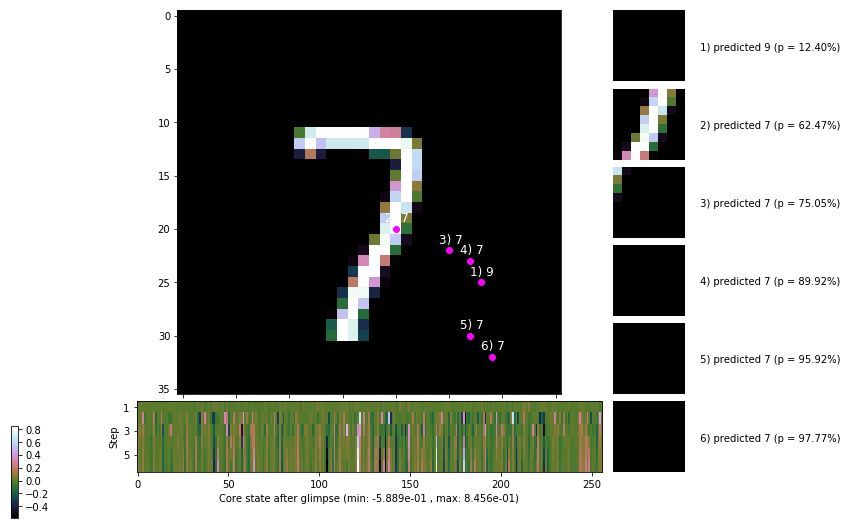


	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


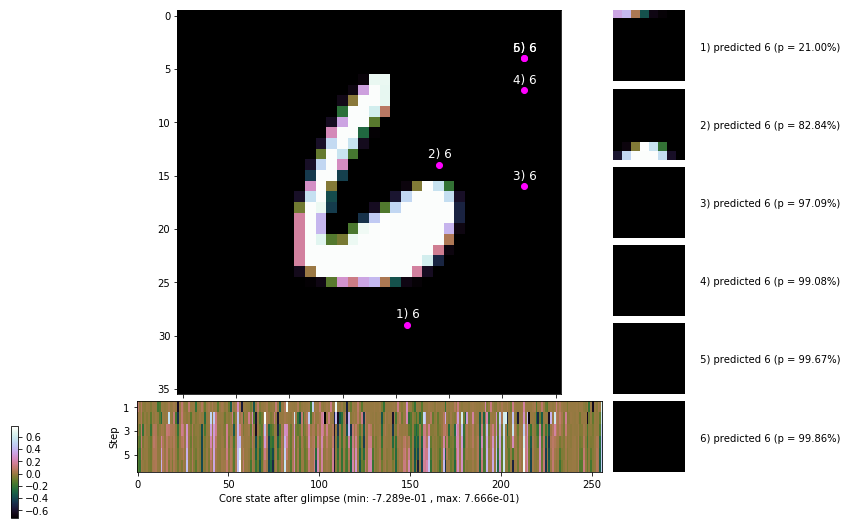

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


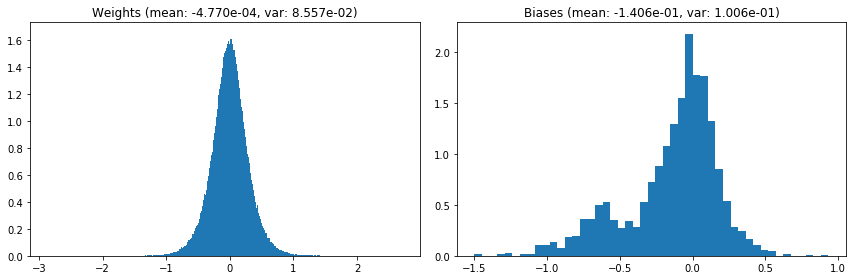

                                      Location network weights and biases


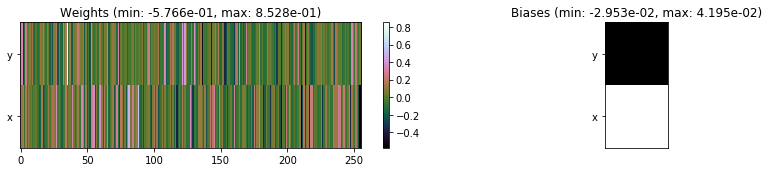

---------------------------------------------------------------------------------------------------------------
Elapsed time:  454.71 sec | TRAIN >> class loss: 0.3351 | steps:  2.189    | reward:  3.7775    | acc.: 88.655% :(
                          | VAL   >> class loss: 0.3051 | steps:  2.075    | reward:  4.0008    | acc.: 90.040% :(


Epoch  87/400) lr = 0.0002751
 b    300/  3000 >> 153.5 ms/b | lr: 2.75e-04 | grad 2norm: 12.64 | grad inf norm:  3.688
         Weights || abs max:  2.86 ( 1609.87) | mean: -4.82e-04 ( 0.01) | var: 8.56e-02 (   20.84)
          Biases || abs max:  1.50 (  126.62) | mean: -1.41e-01 ( 0.13) | var: 1.01e-01 (  102.85)
                    class loss: 0.342 | steps: 2.219 | reward:  3.752 | acc.: 89.08%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.6 ms/b | lr: 2.75e-04 | grad 2norm: 12.41 | grad inf norm:  3.697
         Weights || abs max:  2.85 ( 1441.82) | mean: -4.77e-04 (

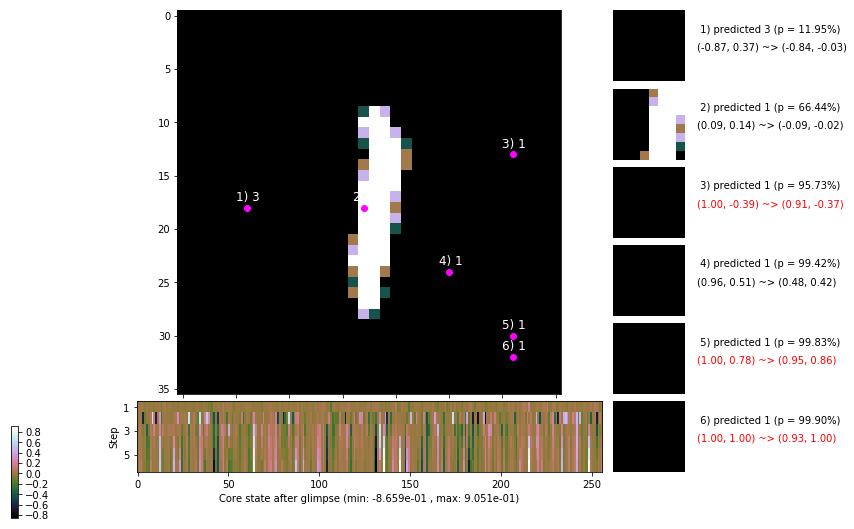

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 166.6 ms/b | lr: 2.74e-04 | grad 2norm: 12.55 | grad inf norm:  3.769
         Weights || abs max:  2.86 ( 5337.38) | mean: -4.83e-04 ( 0.02) | var: 8.56e-02 ( 2340.56)
          Biases || abs max:  1.49 (  204.00) | mean: -1.41e-01 ( 0.15) | var: 1.01e-01 (  974.53)
                    class loss: 0.305 | steps: 2.165 | reward:  3.844 | acc.: 89.50%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 148.5 ms/b | lr: 2.74e-04 | grad 2norm: 12.44 | grad inf norm:  3.626
         Weights || abs max:  2.86 ( 2747.53) | mean: -4.79e-04 ( 0.01) | var: 8.56e-02 (  133.03)
          Biases || abs max:  1.50 (  184.04) | mean: -1.41e-01 ( 0.14) | var: 1.01e-01 (  467.68)
                    class loss: 0.303 | steps: 2.187 | reward:  3.814 | acc.: 89.88%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

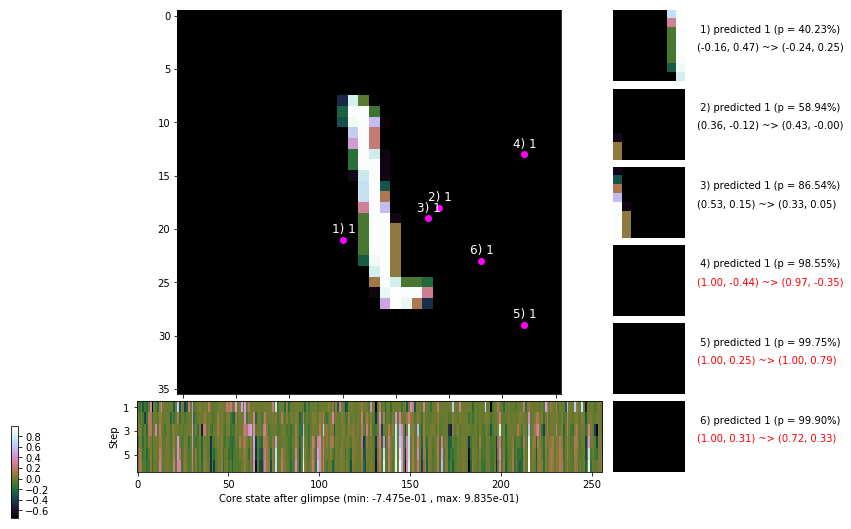

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.2 ms/b | lr: 2.73e-04 | grad 2norm: 12.32 | grad inf norm:  3.717
         Weights || abs max:  2.86 ( 3948.47) | mean: -4.82e-04 ( 0.01) | var: 8.56e-02 ( 1419.49)
          Biases || abs max:  1.50 (  559.75) | mean: -1.41e-01 ( 0.29) | var: 1.01e-01 (16556.63)
                    class loss: 0.303 | steps: 2.181 | reward:  3.810 | acc.: 89.55%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 158.1 ms/b | lr: 2.73e-04 | grad 2norm: 12.24 | grad inf norm:  3.697
         Weights || abs max:  2.87 ( 4827.83) | mean: -4.82e-04 ( 0.02) | var: 8.56e-02 ( 2761.16)
          Biases || abs max:  1.49 (  162.28) | mean: -1.41e-01 ( 0.14) | var: 1.01e-01 (  160.35)
                    class loss: 0.307 | steps: 2.187 | reward:  3.828 | acc.: 89.82%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

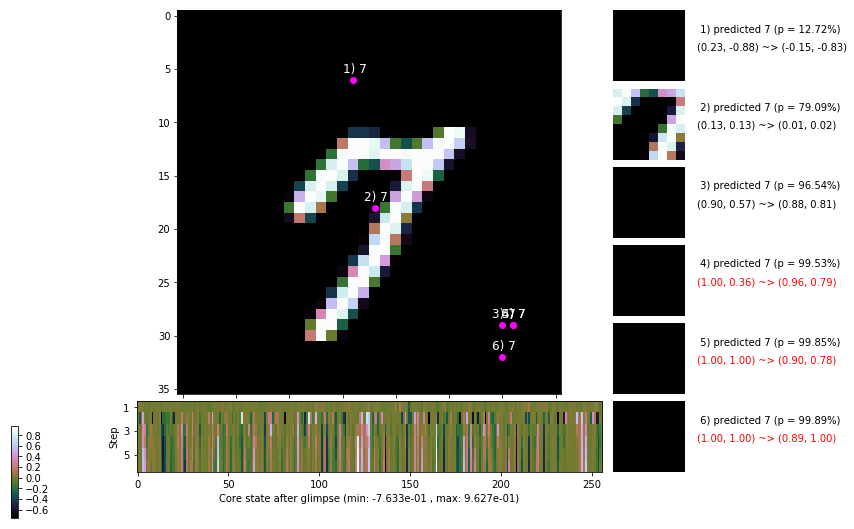

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.3 ms/b | lr: 2.72e-04 | grad 2norm: 12.39 | grad inf norm:  3.784
         Weights || abs max:  2.87 ( 4259.34) | mean: -4.87e-04 ( 0.02) | var: 8.57e-02 (  972.37)
          Biases || abs max:  1.49 (  189.35) | mean: -1.41e-01 ( 0.15) | var: 1.01e-01 (  149.71)
                    class loss: 0.311 | steps: 2.179 | reward:  3.817 | acc.: 89.45%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 157.2 ms/b | lr: 2.72e-04 | grad 2norm: 12.20 | grad inf norm:  3.711
         Weights || abs max:  2.86 ( 3548.27) | mean: -4.95e-04 ( 0.01) | var: 8.57e-02 (  290.20)
          Biases || abs max:  1.49 (   96.29) | mean: -1.41e-01 ( 0.11) | var: 1.01e-01 (   36.29)
                    class loss: 0.314 | steps: 2.169 | reward:  3.852 | acc.: 89.48%

	Target class: 9 | Discounted rewards: [-0.984, -0.969, -

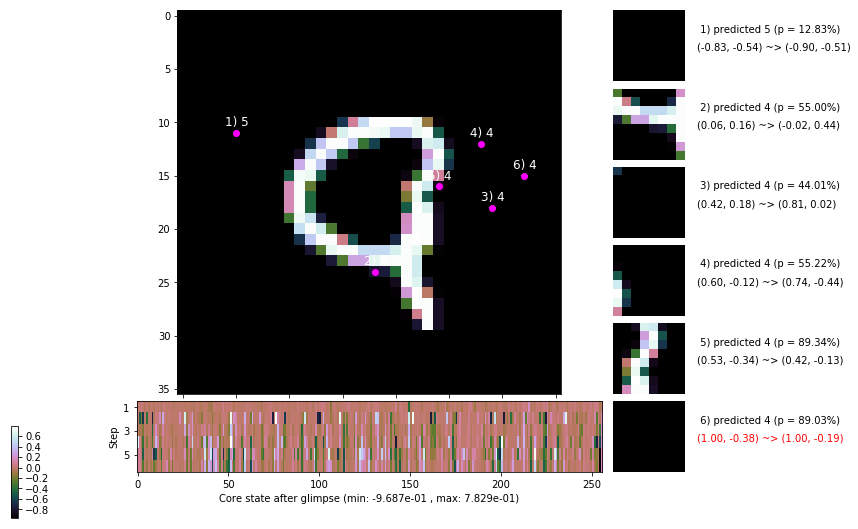

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 172.1 ms/b | lr: 2.72e-04 | grad 2norm: 12.18 | grad inf norm:  3.609
         Weights || abs max:  2.86 ( 5906.19) | mean: -5.17e-04 ( 0.02) | var: 8.57e-02 ( 4659.14)
          Biases || abs max:  1.49 (  129.87) | mean: -1.41e-01 ( 0.11) | var: 1.01e-01 (  116.45)
                    class loss: 0.316 | steps: 2.172 | reward:  3.853 | acc.: 89.85%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 162.5 ms/b | lr: 2.71e-04 | grad 2norm: 12.10 | grad inf norm:  3.662
         Weights || abs max:  2.86 ( 5241.76) | mean: -5.37e-04 ( 0.02) | var: 8.57e-02 ( 5020.19)
          Biases || abs max:  1.49 (  188.39) | mean: -1.41e-01 ( 0.15) | var: 1.01e-01 (  434.87)
                    class loss: 0.323 | steps: 2.183 | reward:  3.826 | acc.: 89.48%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

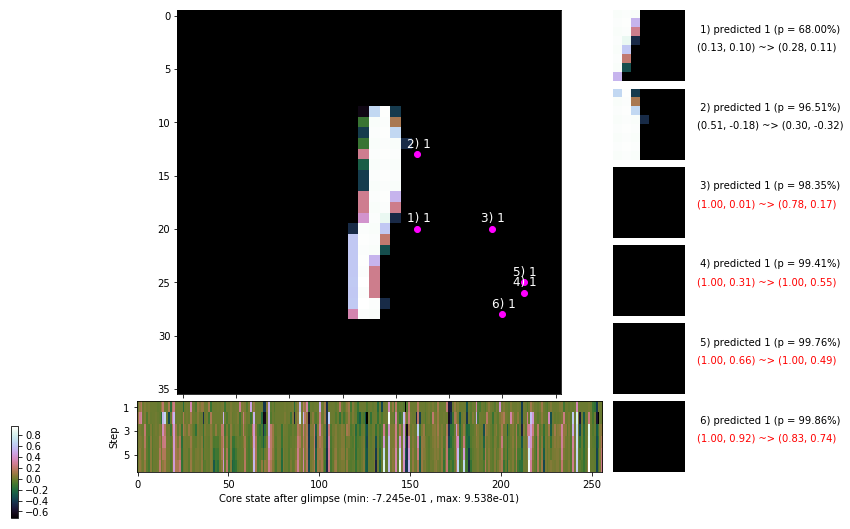

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


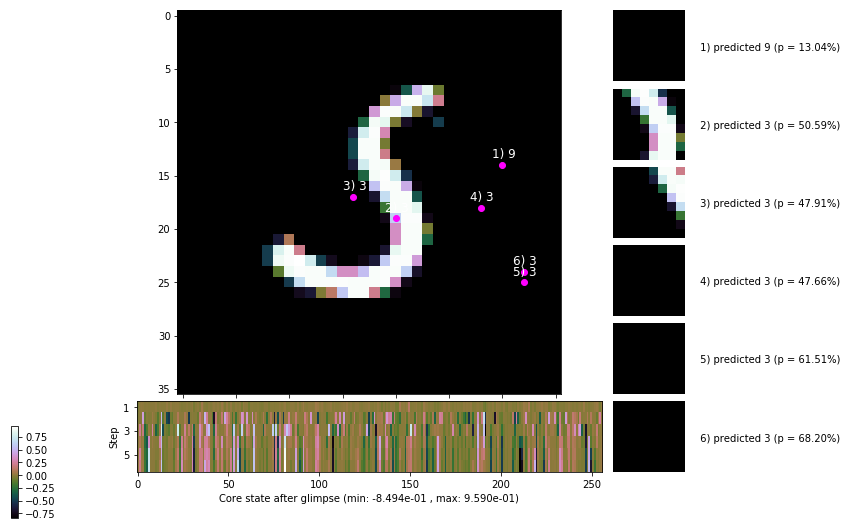


	Target class: 3 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


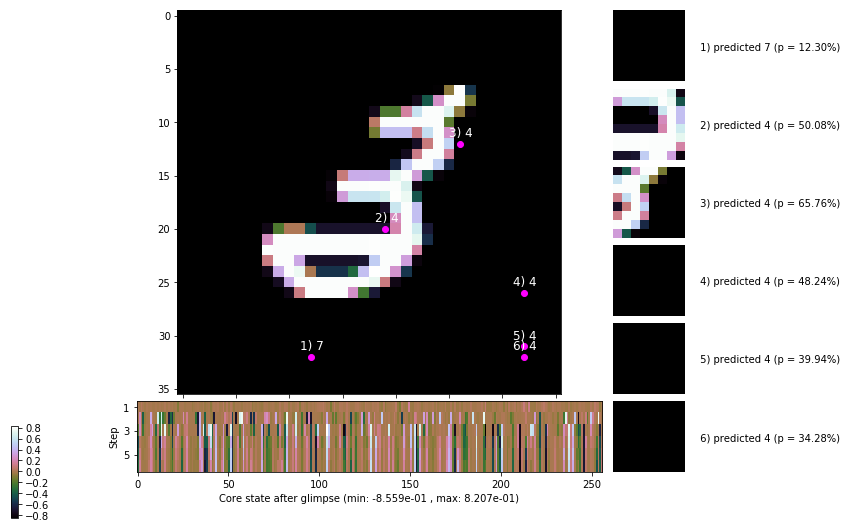

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


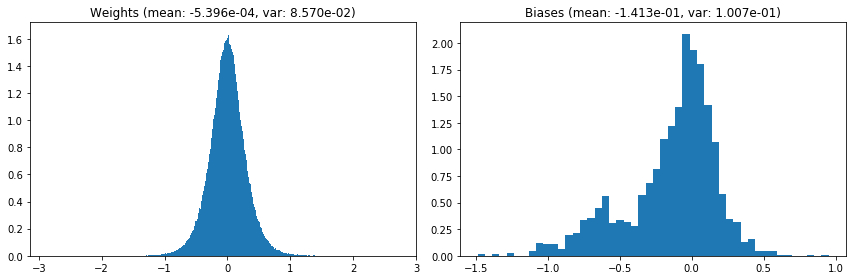

                                      Location network weights and biases


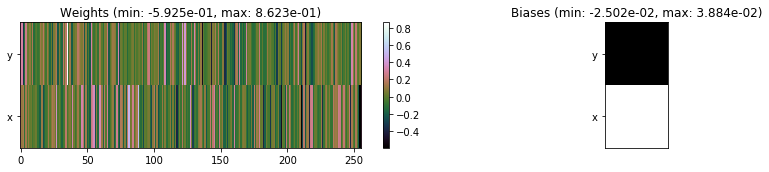

---------------------------------------------------------------------------------------------------------------
Elapsed time:  474.61 sec | TRAIN >> class loss: 0.3144 | steps:  2.185    | reward:  3.8170    | acc.: 89.527% 
                          | VAL   >> class loss: 0.3156 | steps:  2.112 :( | reward:  3.9567 :( | acc.: 89.800% :(


Epoch  88/400) lr = 0.000271
 b    300/  3000 >> 147.1 ms/b | lr: 2.71e-04 | grad 2norm: 12.35 | grad inf norm:  3.849
         Weights || abs max:  2.86 ( 1432.65) | mean: -5.30e-04 ( 0.01) | var: 8.57e-02 (   23.73)
          Biases || abs max:  1.49 (  464.35) | mean: -1.41e-01 ( 0.25) | var: 1.01e-01 (10723.90)
                    class loss: 0.328 | steps: 2.191 | reward:  3.785 | acc.: 89.10%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 163.8 ms/b | lr: 2.70e-04 | grad 2norm: 12.44 | grad inf norm:  3.752
         Weights || abs max:  2.86 (10090.99) | mean: -5.23e-04 ( 0.

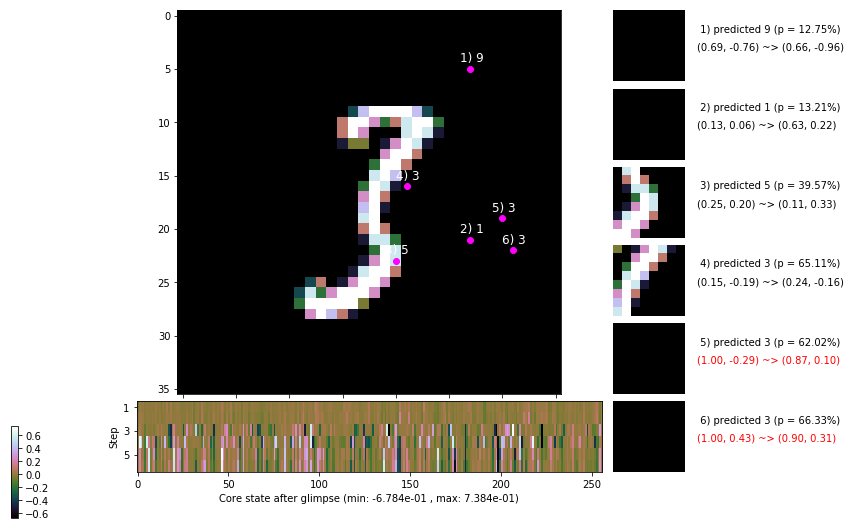

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 149.1 ms/b | lr: 2.70e-04 | grad 2norm: 12.27 | grad inf norm:  3.682
         Weights || abs max:  2.86 ( 2560.01) | mean: -5.37e-04 ( 0.01) | var: 8.57e-02 (   83.29)
          Biases || abs max:  1.48 (  219.44) | mean: -1.41e-01 ( 0.18) | var: 1.01e-01 (  539.11)
                    class loss: 0.324 | steps: 2.189 | reward:  3.784 | acc.: 88.85%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 148.3 ms/b | lr: 2.70e-04 | grad 2norm: 12.25 | grad inf norm:  3.808
         Weights || abs max:  2.87 (12186.64) | mean: -5.32e-04 ( 0.03) | var: 8.58e-02 (47875.20)
          Biases || abs max:  1.48 (  175.21) | mean: -1.41e-01 ( 0.15) | var: 1.01e-01 (  297.98)
                    class loss: 0.319 | steps: 2.181 | reward:  3.818 | acc.: 89.15%

	Target class: 9 | Discounted rewards: [-0.984, -0.969, -

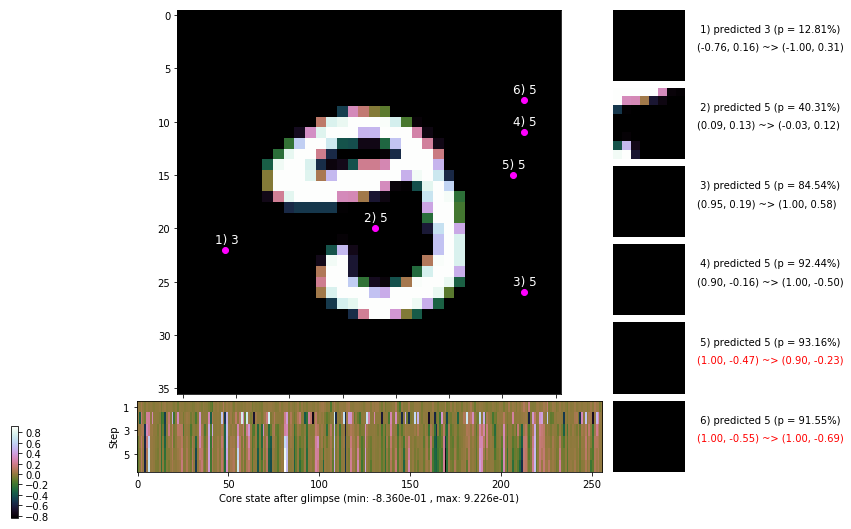

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 149.2 ms/b | lr: 2.69e-04 | grad 2norm: 12.41 | grad inf norm:  3.735
         Weights || abs max:  2.87 ( 2084.25) | mean: -5.40e-04 ( 0.01) | var: 8.58e-02 (   86.57)
          Biases || abs max:  1.48 (   80.36) | mean: -1.41e-01 ( 0.10) | var: 1.01e-01 (   24.71)
                    class loss: 0.321 | steps: 2.188 | reward:  3.800 | acc.: 89.38%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.2 ms/b | lr: 2.69e-04 | grad 2norm: 12.22 | grad inf norm:  3.832
         Weights || abs max:  2.87 ( 3592.15) | mean: -5.51e-04 ( 0.01) | var: 8.58e-02 (  768.86)
          Biases || abs max:  1.48 (  160.24) | mean: -1.41e-01 ( 0.14) | var: 1.01e-01 (  105.95)
                    class loss: 0.321 | steps: 2.170 | reward:  3.834 | acc.: 89.17%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

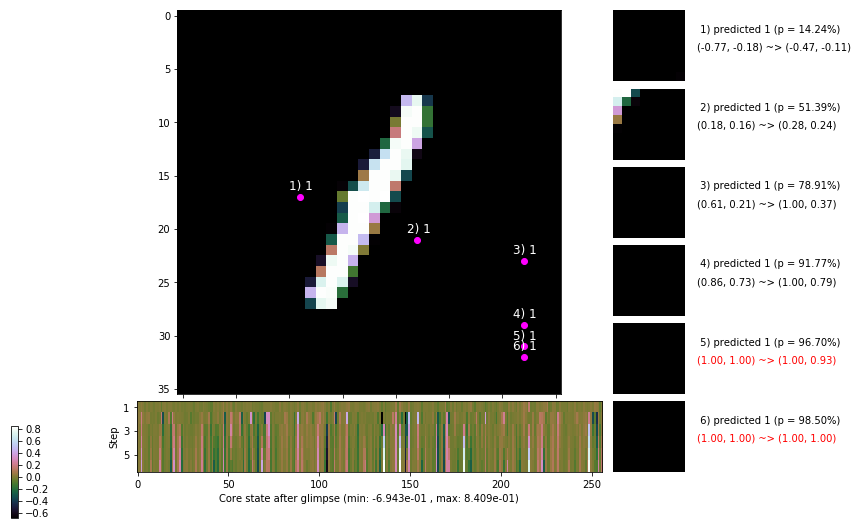

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 151.8 ms/b | lr: 2.68e-04 | grad 2norm: 12.22 | grad inf norm:  3.766
         Weights || abs max:  2.87 ( 1621.72) | mean: -5.62e-04 ( 0.01) | var: 8.58e-02 (   29.90)
          Biases || abs max:  1.49 (  131.61) | mean: -1.41e-01 ( 0.13) | var: 1.01e-01 (   87.25)
                    class loss: 0.332 | steps: 2.186 | reward:  3.787 | acc.: 88.63%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 150.5 ms/b | lr: 2.68e-04 | grad 2norm: 12.38 | grad inf norm:  3.799
         Weights || abs max:  2.87 ( 3722.90) | mean: -5.71e-04 ( 0.01) | var: 8.58e-02 ( 3780.80)
          Biases || abs max:  1.49 (  148.34) | mean: -1.41e-01 ( 0.14) | var: 1.01e-01 (   97.53)
                    class loss: 0.334 | steps: 2.180 | reward:  3.799 | acc.: 89.22%

	Target class: 8 | Discounted rewards: [-0.984, -0.969, -

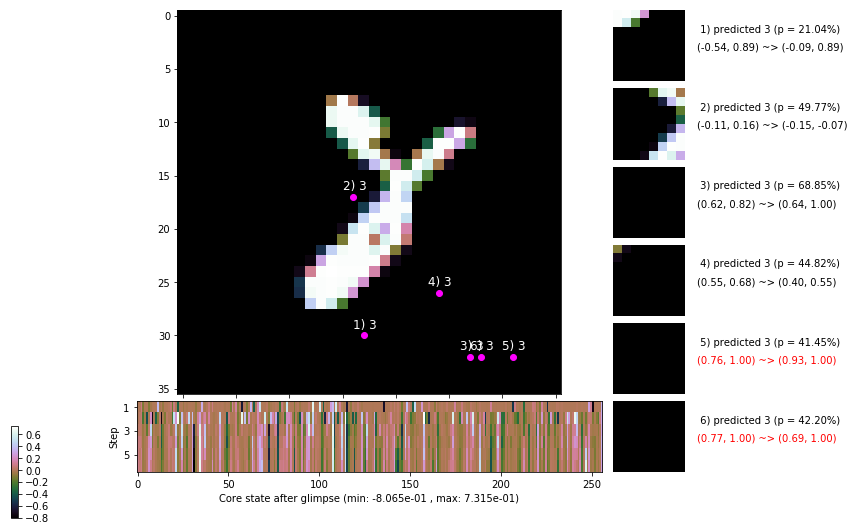

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 150.5 ms/b | lr: 2.67e-04 | grad 2norm: 12.52 | grad inf norm:  3.745
         Weights || abs max:  2.87 ( 2958.84) | mean: -5.75e-04 ( 0.01) | var: 8.58e-02 (  240.99)
          Biases || abs max:  1.49 (  367.44) | mean: -1.41e-01 ( 0.22) | var: 1.01e-01 ( 4804.87)
                    class loss: 0.344 | steps: 2.203 | reward:  3.752 | acc.: 88.63%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 148.4 ms/b | lr: 2.67e-04 | grad 2norm: 12.47 | grad inf norm:  3.646
         Weights || abs max:  2.87 ( 9632.24) | mean: -5.85e-04 ( 0.03) | var: 8.58e-02 ( 7365.65)
          Biases || abs max:  1.49 (  108.69) | mean: -1.41e-01 ( 0.13) | var: 1.01e-01 (   35.00)
                    class loss: 0.358 | steps: 2.225 | reward:  3.709 | acc.: 87.98%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

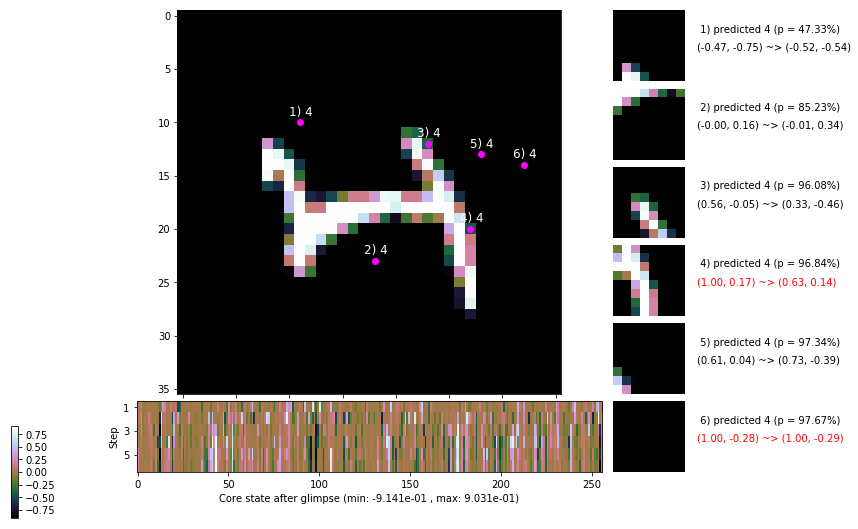

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


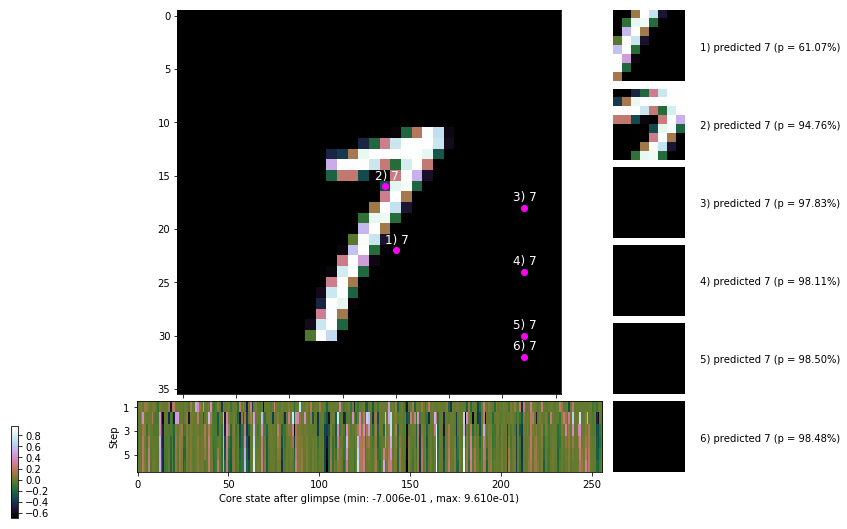


	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


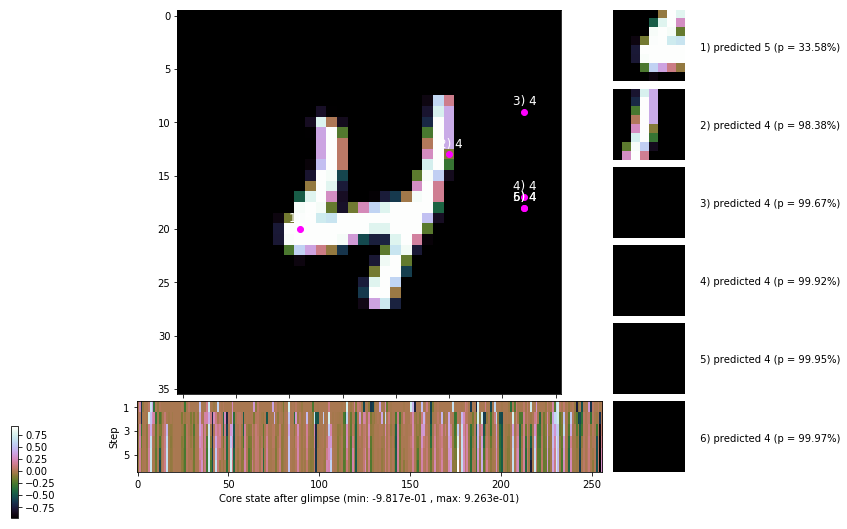

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


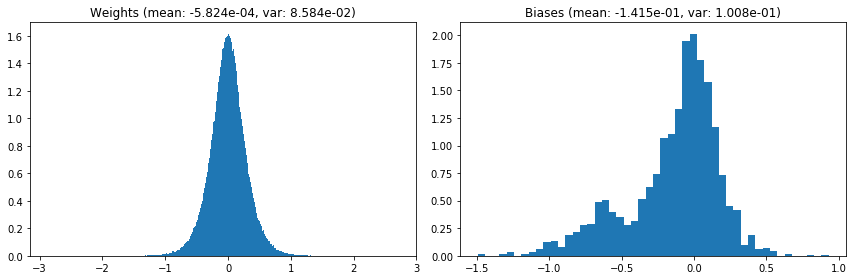

                                      Location network weights and biases


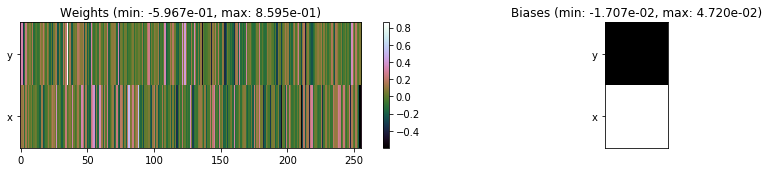

---------------------------------------------------------------------------------------------------------------
Elapsed time:  451.74 sec | TRAIN >> class loss: 0.3303 | steps:  2.193 :( | reward:  3.7811 :( | acc.: 88.878% :(
                          | VAL   >> class loss: 0.3100 | steps:  2.113 :( | reward:  3.9306 :( | acc.: 89.000% :(


Epoch  89/400) lr = 0.000267
 b    300/  3000 >> 152.8 ms/b | lr: 2.67e-04 | grad 2norm: 12.08 | grad inf norm:  3.668
         Weights || abs max:  2.87 ( 2642.91) | mean: -5.73e-04 ( 0.01) | var: 8.58e-02 (  310.74)
          Biases || abs max:  1.49 (  121.07) | mean: -1.41e-01 ( 0.13) | var: 1.01e-01 (   66.47)
                    class loss: 0.325 | steps: 2.168 | reward:  3.800 | acc.: 89.03%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 146.2 ms/b | lr: 2.66e-04 | grad 2norm: 12.30 | grad inf norm:  3.866
         Weights || abs max:  2.87 ( 2010.82) | mean: -5.63e-04 ( 

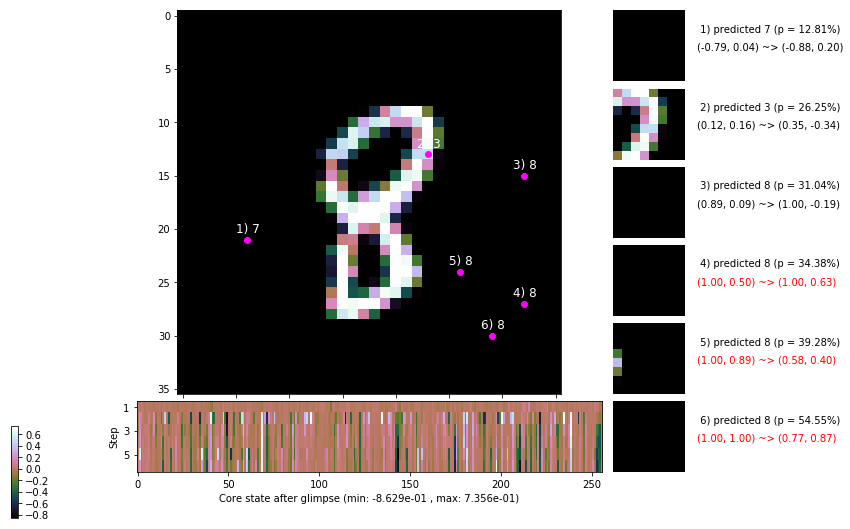

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 149.9 ms/b | lr: 2.66e-04 | grad 2norm: 12.60 | grad inf norm:  3.728
         Weights || abs max:  2.88 ( 8323.04) | mean: -5.69e-04 ( 0.02) | var: 8.59e-02 ( 3747.96)
          Biases || abs max:  1.49 (  107.90) | mean: -1.41e-01 ( 0.13) | var: 1.01e-01 (   89.17)
                    class loss: 0.334 | steps: 2.191 | reward:  3.756 | acc.: 88.30%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 145.5 ms/b | lr: 2.66e-04 | grad 2norm: 12.44 | grad inf norm:  3.654
         Weights || abs max:  2.88 ( 3518.49) | mean: -5.64e-04 ( 0.01) | var: 8.59e-02 (  802.73)
          Biases || abs max:  1.49 (  664.45) | mean: -1.41e-01 ( 0.33) | var: 1.01e-01 (36404.74)
                    class loss: 0.331 | steps: 2.194 | reward:  3.777 | acc.: 89.05%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

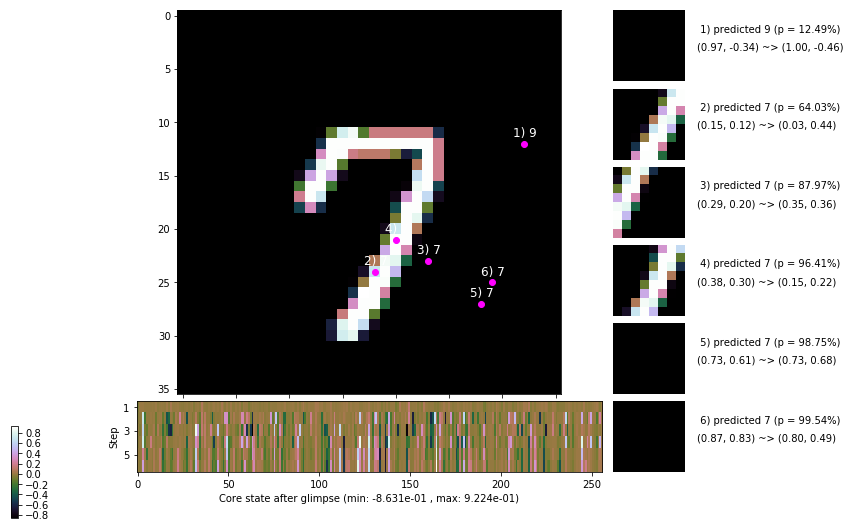

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 152.8 ms/b | lr: 2.65e-04 | grad 2norm: 12.42 | grad inf norm:  3.862
         Weights || abs max:  2.88 ( 2943.13) | mean: -5.57e-04 ( 0.01) | var: 8.59e-02 (  142.83)
          Biases || abs max:  1.49 (   99.72) | mean: -1.41e-01 ( 0.12) | var: 1.01e-01 (   19.36)
                    class loss: 0.325 | steps: 2.217 | reward:  3.749 | acc.: 88.92%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 148.0 ms/b | lr: 2.65e-04 | grad 2norm: 12.51 | grad inf norm:  3.784
         Weights || abs max:  2.88 ( 7758.32) | mean: -5.53e-04 ( 0.02) | var: 8.59e-02 ( 7675.90)
          Biases || abs max:  1.49 (   87.87) | mean: -1.41e-01 ( 0.10) | var: 1.01e-01 (   10.15)
                    class loss: 0.333 | steps: 2.205 | reward:  3.730 | acc.: 88.40%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

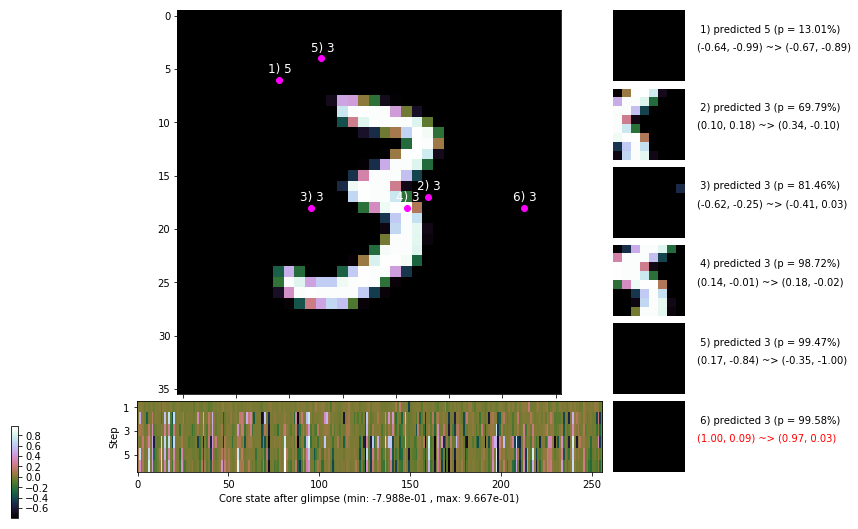

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 148.8 ms/b | lr: 2.64e-04 | grad 2norm: 12.68 | grad inf norm:  3.874
         Weights || abs max:  2.88 ( 3127.41) | mean: -5.63e-04 ( 0.01) | var: 8.59e-02 (  531.30)
          Biases || abs max:  1.49 (  264.60) | mean: -1.41e-01 ( 0.19) | var: 1.01e-01 (  126.23)
                    class loss: 0.342 | steps: 2.202 | reward:  3.744 | acc.: 88.58%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 147.0 ms/b | lr: 2.64e-04 | grad 2norm: 12.49 | grad inf norm:  3.783
         Weights || abs max:  2.88 ( 2580.46) | mean: -5.62e-04 ( 0.01) | var: 8.59e-02 (  115.65)
          Biases || abs max:  1.49 (  582.85) | mean: -1.41e-01 ( 0.32) | var: 1.01e-01 (  882.81)
                    class loss: 0.328 | steps: 2.203 | reward:  3.774 | acc.: 88.63%

	Target class: 7 | Discounted rewards: [-0.281, 0.438, 1.

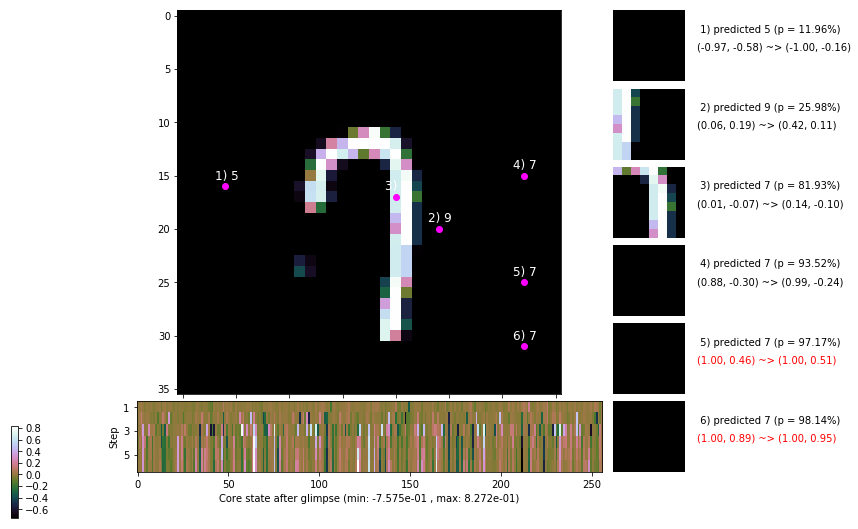

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 151.9 ms/b | lr: 2.64e-04 | grad 2norm: 12.57 | grad inf norm:  3.866
         Weights || abs max:  2.88 ( 1610.83) | mean: -5.63e-04 ( 0.01) | var: 8.60e-02 (   29.76)
          Biases || abs max:  1.50 ( 3158.77) | mean: -1.41e-01 ( 2.45) | var: 1.01e-01 (1987582.88)
                    class loss: 0.333 | steps: 2.227 | reward:  3.723 | acc.: 88.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.3 ms/b | lr: 2.63e-04 | grad 2norm: 12.41 | grad inf norm:  3.810
         Weights || abs max:  2.88 ( 3781.47) | mean: -5.69e-04 ( 0.01) | var: 8.60e-02 (  505.08)
          Biases || abs max:  1.50 ( 2080.23) | mean: -1.41e-01 ( 0.90) | var: 1.01e-01 (22723.96)
                    class loss: 0.331 | steps: 2.203 | reward:  3.753 | acc.: 89.07%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1

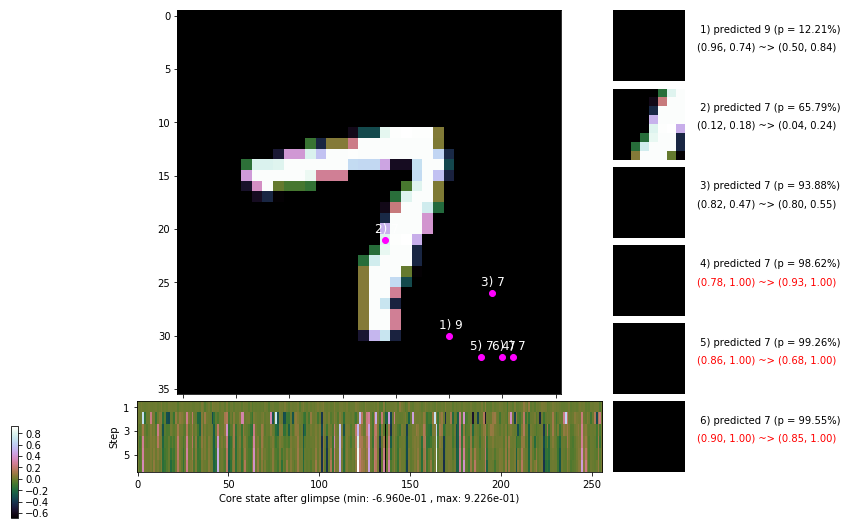

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


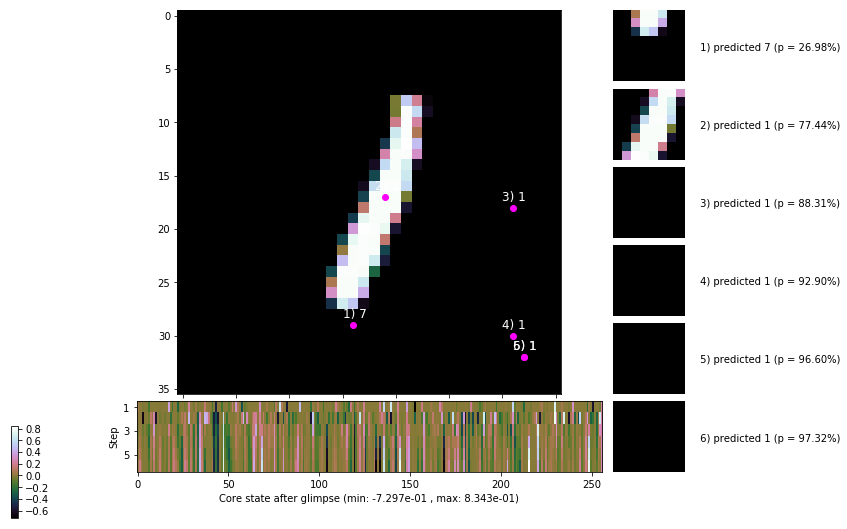


	Target class: 6 | Discounted rewards: [1.219, 0.438, 1.875, 1.750, 1.500, 1.000]


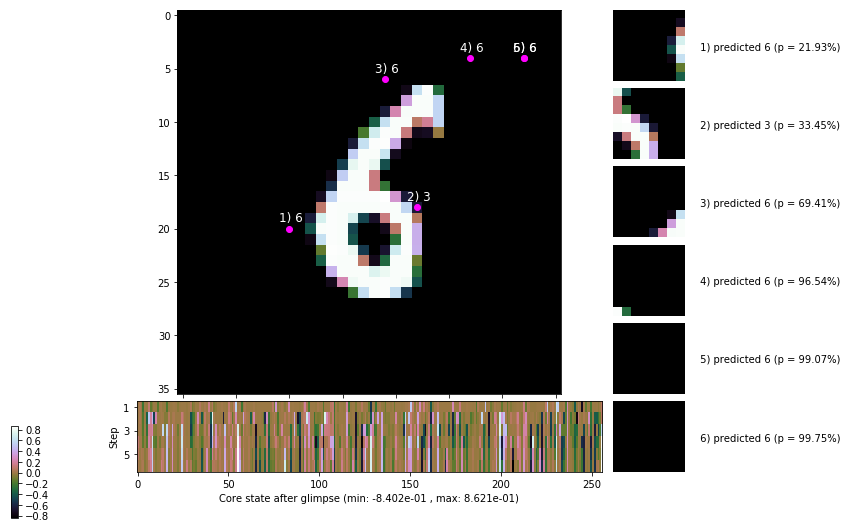

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


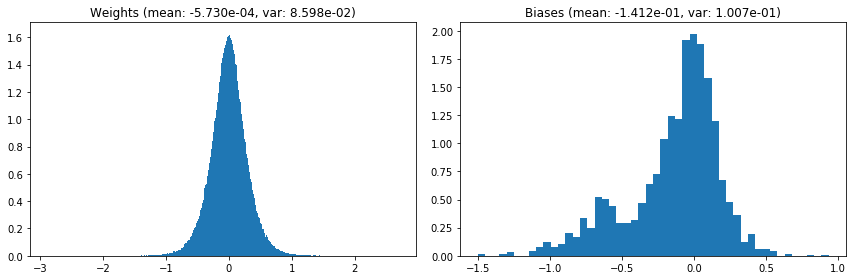

                                      Location network weights and biases


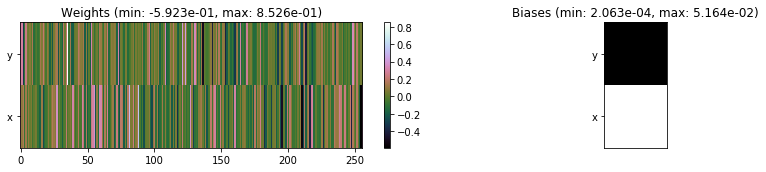

---------------------------------------------------------------------------------------------------------------
Elapsed time:  446.50 sec | TRAIN >> class loss: 0.3323 | steps:  2.201 :( | reward:  3.7581 :( | acc.: 88.730% :(
                          | VAL   >> class loss: 0.2996 | steps:  2.063    | reward:  3.9897 :( | acc.: 89.440% :(


Epoch  90/400) lr = 0.000263
 b    300/  3000 >> 142.9 ms/b | lr: 2.63e-04 | grad 2norm: 12.39 | grad inf norm:  3.777
         Weights || abs max:  2.88 ( 7793.57) | mean: -5.70e-04 ( 0.02) | var: 8.60e-02 (14942.15)
          Biases || abs max:  1.50 (  457.37) | mean: -1.41e-01 ( 0.28) | var: 1.01e-01 (  995.58)
                    class loss: 0.336 | steps: 2.188 | reward:  3.777 | acc.: 88.82%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.2 ms/b | lr: 2.62e-04 | grad 2norm: 12.37 | grad inf norm:  3.735
         Weights || abs max:  2.87 ( 3533.42) | mean: -5.73e-04 ( 

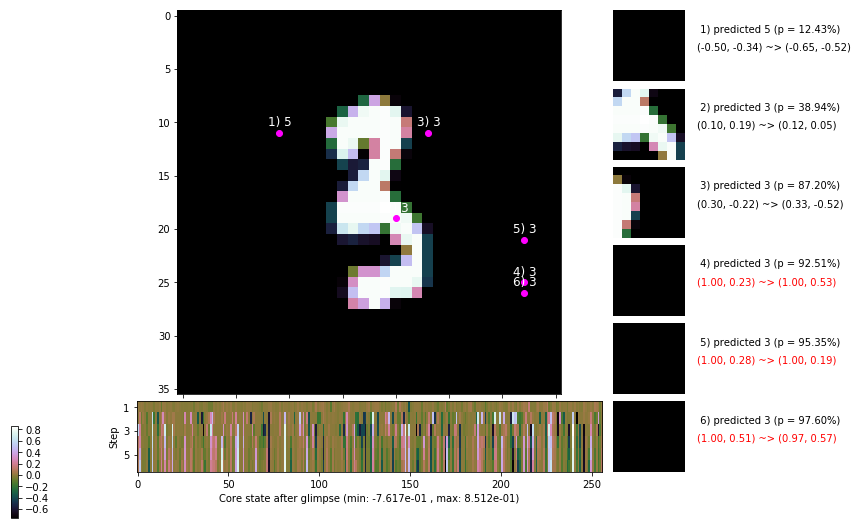

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 149.2 ms/b | lr: 2.62e-04 | grad 2norm: 12.13 | grad inf norm:  3.571
         Weights || abs max:  2.88 ( 1573.05) | mean: -5.72e-04 ( 0.01) | var: 8.60e-02 (   29.93)
          Biases || abs max:  1.50 (  245.14) | mean: -1.41e-01 ( 0.18) | var: 1.01e-01 (  247.00)
                    class loss: 0.320 | steps: 2.174 | reward:  3.813 | acc.: 89.32%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.0 ms/b | lr: 2.62e-04 | grad 2norm: 12.03 | grad inf norm:  3.610
         Weights || abs max:  2.88 ( 6710.67) | mean: -5.76e-04 ( 0.02) | var: 8.60e-02 (10278.18)
          Biases || abs max:  1.50 (  159.66) | mean: -1.41e-01 ( 0.15) | var: 1.01e-01 (  153.22)
                    class loss: 0.314 | steps: 2.155 | reward:  3.839 | acc.: 89.28%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

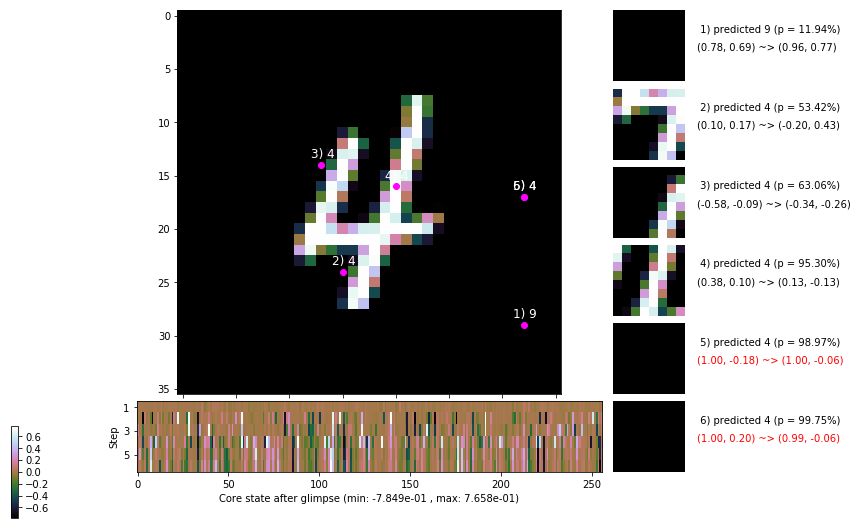

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.3 ms/b | lr: 2.61e-04 | grad 2norm: 12.26 | grad inf norm:  3.742
         Weights || abs max:  2.88 ( 4622.44) | mean: -5.75e-04 ( 0.02) | var: 8.60e-02 ( 2067.01)
          Biases || abs max:  1.50 (  221.37) | mean: -1.41e-01 ( 0.20) | var: 1.01e-01 (  288.13)
                    class loss: 0.325 | steps: 2.179 | reward:  3.800 | acc.: 88.97%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 141.6 ms/b | lr: 2.61e-04 | grad 2norm: 12.12 | grad inf norm:  3.571
         Weights || abs max:  2.88 ( 3183.33) | mean: -5.79e-04 ( 0.01) | var: 8.60e-02 (   97.77)
          Biases || abs max:  1.50 (  767.48) | mean: -1.41e-01 ( 0.42) | var: 1.01e-01 (10109.79)
                    class loss: 0.325 | steps: 2.183 | reward:  3.807 | acc.: 89.28%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

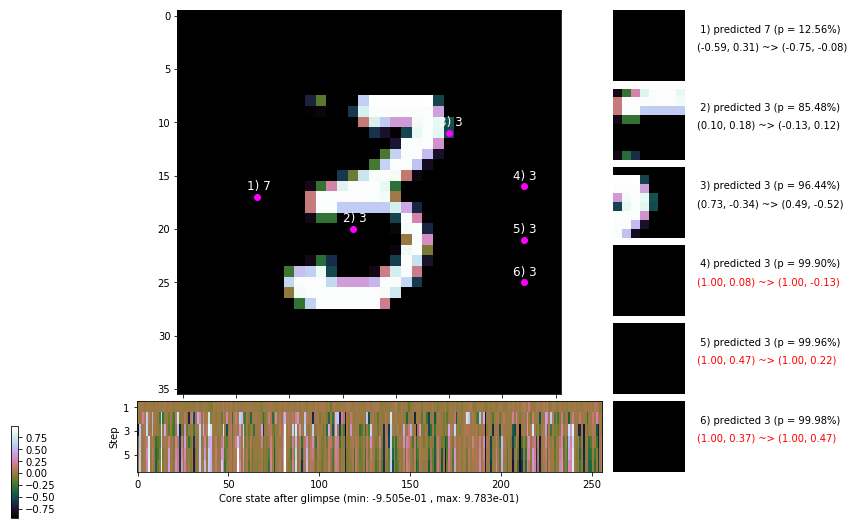

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.8 ms/b | lr: 2.60e-04 | grad 2norm: 12.26 | grad inf norm:  3.752
         Weights || abs max:  2.88 ( 6639.32) | mean: -5.79e-04 ( 0.02) | var: 8.61e-02 ( 3125.07)
          Biases || abs max:  1.50 ( 2672.18) | mean: -1.41e-01 ( 1.13) | var: 1.01e-01 (277841.34)
                    class loss: 0.312 | steps: 2.197 | reward:  3.788 | acc.: 89.70%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 147.1 ms/b | lr: 2.60e-04 | grad 2norm: 12.09 | grad inf norm:  3.716
         Weights || abs max:  2.88 ( 5373.47) | mean: -5.82e-04 ( 0.02) | var: 8.61e-02 ( 5794.95)
          Biases || abs max:  1.50 ( 1422.73) | mean: -1.41e-01 ( 0.66) | var: 1.01e-01 (11371.25)
                    class loss: 0.309 | steps: 2.185 | reward:  3.793 | acc.: 89.35%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.

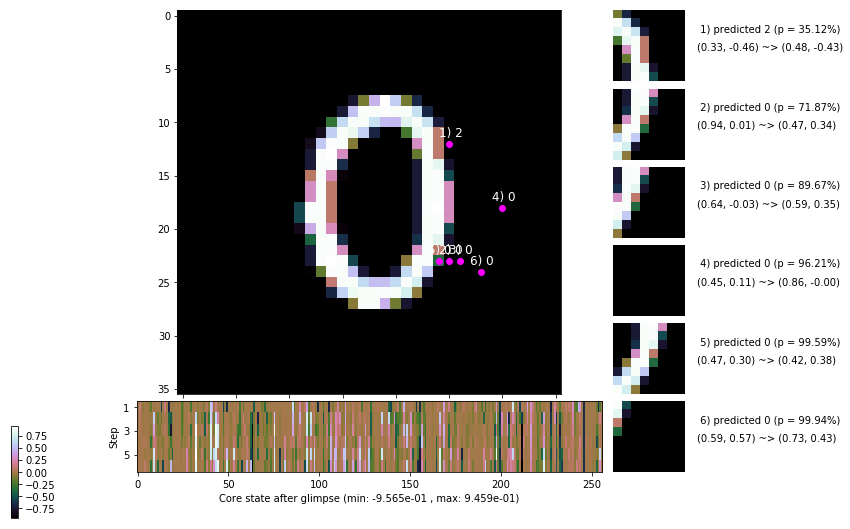

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.0 ms/b | lr: 2.60e-04 | grad 2norm: 12.44 | grad inf norm:  3.757
         Weights || abs max:  2.88 ( 5161.04) | mean: -5.83e-04 ( 0.02) | var: 8.61e-02 (  976.59)
          Biases || abs max:  1.51 (  448.87) | mean: -1.41e-01 ( 0.26) | var: 1.01e-01 ( 2480.26)
                    class loss: 0.327 | steps: 2.218 | reward:  3.738 | acc.: 88.88%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.0 ms/b | lr: 2.59e-04 | grad 2norm: 12.51 | grad inf norm:  3.767
         Weights || abs max:  2.88 ( 4640.65) | mean: -5.85e-04 ( 0.02) | var: 8.61e-02 ( 2592.85)
          Biases || abs max:  1.51 (  165.32) | mean: -1.41e-01 ( 0.15) | var: 1.01e-01 (  113.67)
                    class loss: 0.336 | steps: 2.219 | reward:  3.747 | acc.: 88.75%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

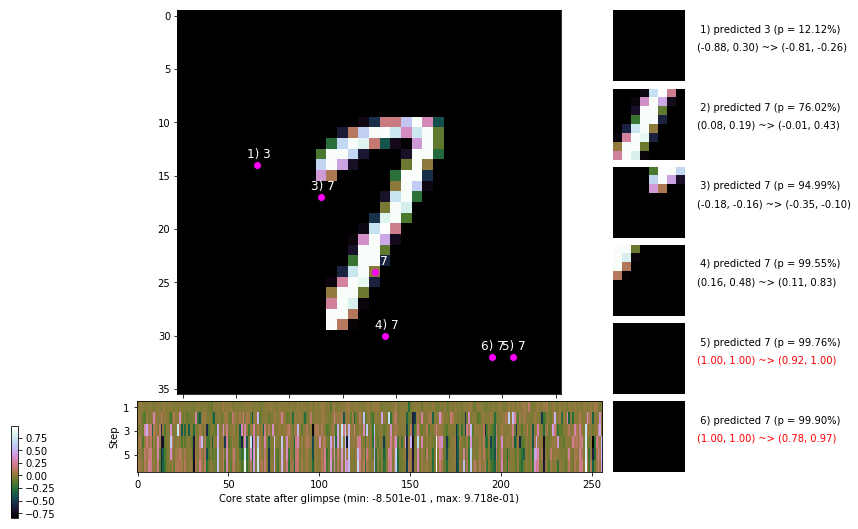

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


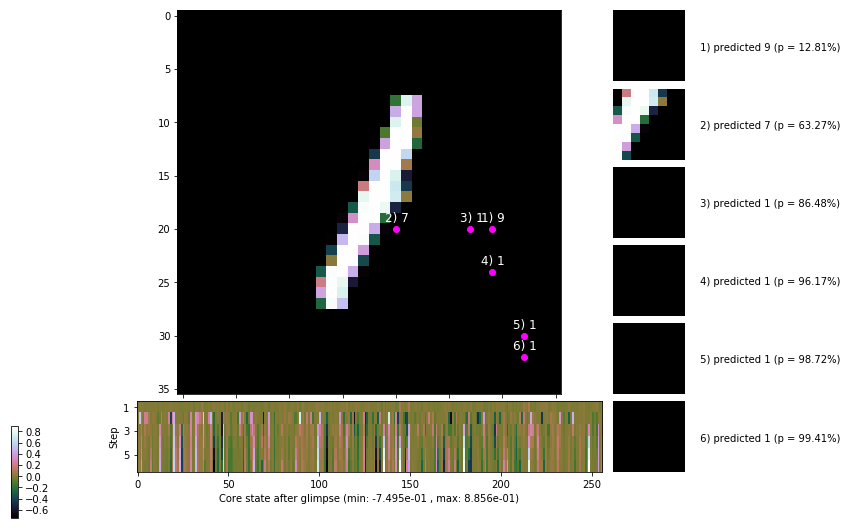


	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


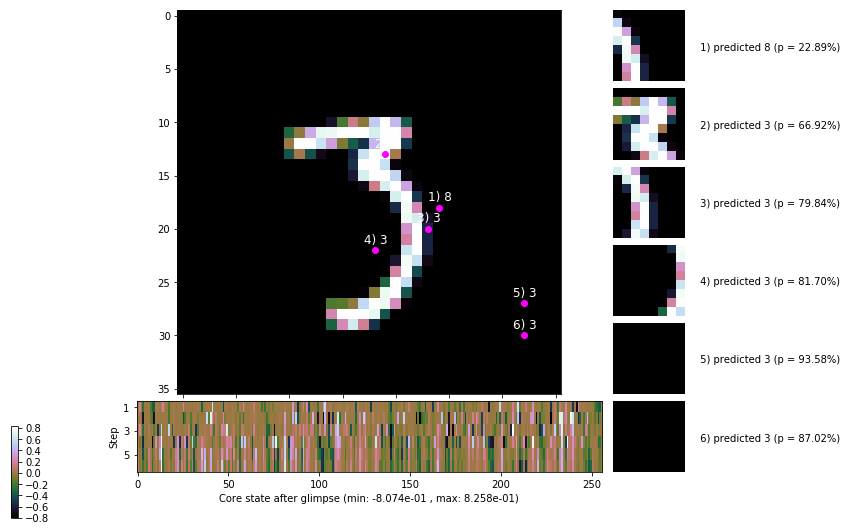

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


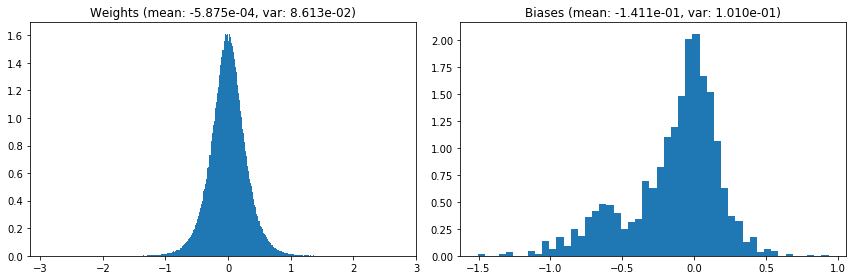

                                      Location network weights and biases


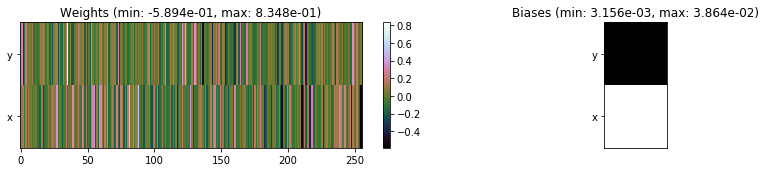

---------------------------------------------------------------------------------------------------------------
Elapsed time:  434.76 sec | TRAIN >> class loss: 0.3235 | steps:  2.188 :( | reward:  3.7895 :( | acc.: 89.132% :(
                          | VAL   >> class loss: 0.2931 | steps:  2.097 :( | reward:  4.0038    | acc.: 90.600% 


Epoch  91/400) lr = 0.0002591
 b    300/  3000 >> 142.8 ms/b | lr: 2.59e-04 | grad 2norm: 12.42 | grad inf norm:  3.683
         Weights || abs max:  2.88 ( 5261.50) | mean: -5.85e-04 ( 0.02) | var: 8.61e-02 ( 2753.60)
          Biases || abs max:  1.51 (  956.83) | mean: -1.41e-01 ( 0.45) | var: 1.01e-01 (16793.79)
                    class loss: 0.329 | steps: 2.198 | reward:  3.748 | acc.: 88.48%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 146.0 ms/b | lr: 2.59e-04 | grad 2norm: 12.48 | grad inf norm:  3.704
         Weights || abs max:  2.89 ( 2257.31) | mean: -5.86e-04 ( 0

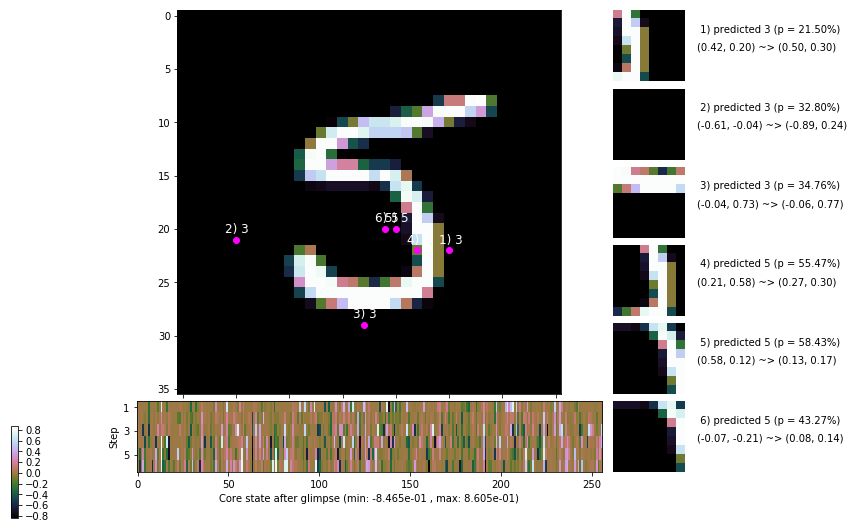

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 143.1 ms/b | lr: 2.58e-04 | grad 2norm: 12.51 | grad inf norm:  3.612
         Weights || abs max:  2.88 ( 2674.30) | mean: -5.76e-04 ( 0.01) | var: 8.62e-02 (  132.43)
          Biases || abs max:  1.51 (  241.96) | mean: -1.41e-01 ( 0.19) | var: 1.01e-01 (  243.09)
                    class loss: 0.343 | steps: 2.219 | reward:  3.729 | acc.: 88.37%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 143.7 ms/b | lr: 2.58e-04 | grad 2norm: 12.54 | grad inf norm:  3.754
         Weights || abs max:  2.88 ( 5173.75) | mean: -5.72e-04 ( 0.02) | var: 8.62e-02 ( 3193.67)
          Biases || abs max:  1.51 (  169.67) | mean: -1.41e-01 ( 0.15) | var: 1.01e-01 (  174.85)
                    class loss: 0.332 | steps: 2.209 | reward:  3.766 | acc.: 89.10%

	Target class: 2 | Discounted rewards: [1.969, 1.938, 1.8

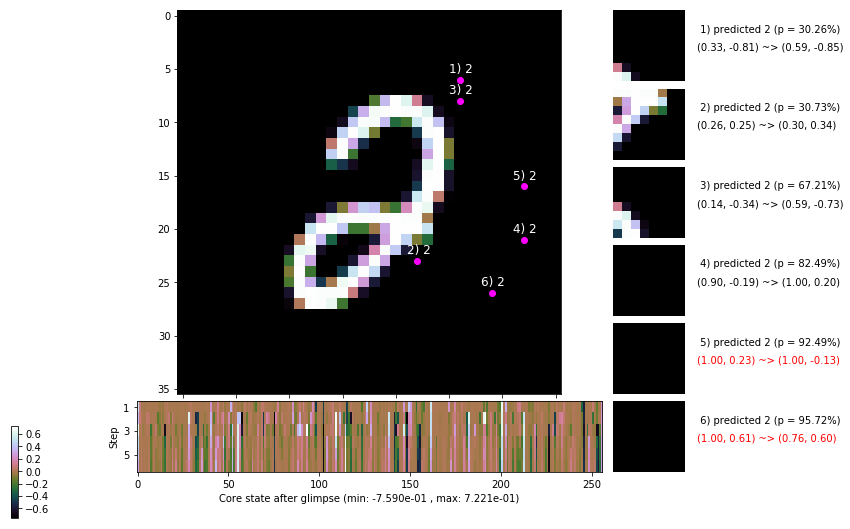

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 142.3 ms/b | lr: 2.57e-04 | grad 2norm: 12.61 | grad inf norm:  3.917
         Weights || abs max:  2.89 ( 2676.99) | mean: -5.77e-04 ( 0.01) | var: 8.62e-02 (  454.10)
          Biases || abs max:  1.51 (  774.98) | mean: -1.41e-01 ( 0.42) | var: 1.01e-01 ( 2192.64)
                    class loss: 0.335 | steps: 2.205 | reward:  3.756 | acc.: 88.80%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 143.6 ms/b | lr: 2.57e-04 | grad 2norm: 12.34 | grad inf norm:  3.609
         Weights || abs max:  2.89 ( 5089.89) | mean: -5.92e-04 ( 0.02) | var: 8.62e-02 ( 3499.92)
          Biases || abs max:  1.51 (  155.21) | mean: -1.41e-01 ( 0.16) | var: 1.01e-01 (   68.75)
                    class loss: 0.335 | steps: 2.199 | reward:  3.748 | acc.: 88.72%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

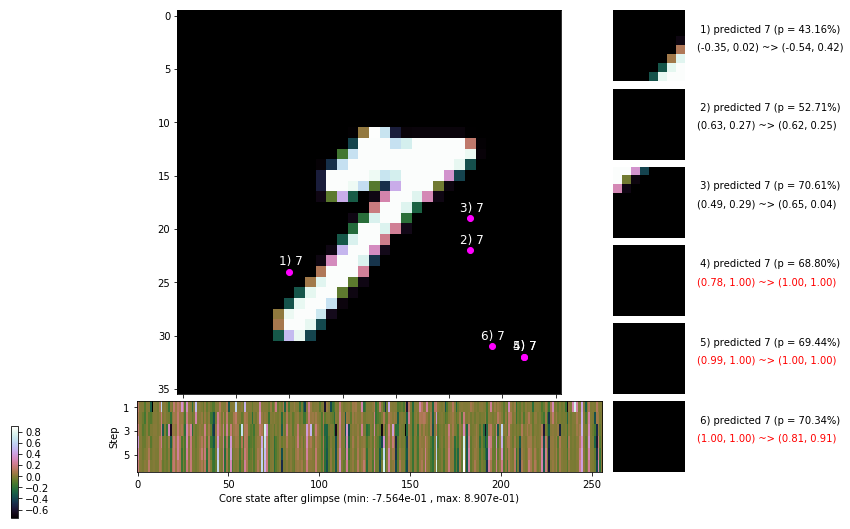

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.8 ms/b | lr: 2.56e-04 | grad 2norm: 12.69 | grad inf norm:  4.047
         Weights || abs max:  2.88 ( 1600.90) | mean: -5.89e-04 ( 0.01) | var: 8.62e-02 (  104.74)
          Biases || abs max:  1.51 (  247.14) | mean: -1.41e-01 ( 0.18) | var: 1.01e-01 (  423.88)
                    class loss: 0.343 | steps: 2.204 | reward:  3.748 | acc.: 88.53%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.1 ms/b | lr: 2.56e-04 | grad 2norm: 12.22 | grad inf norm:  3.643
         Weights || abs max:  2.88 ( 2024.94) | mean: -5.91e-04 ( 0.01) | var: 8.62e-02 (  102.02)
          Biases || abs max:  1.51 (  580.92) | mean: -1.41e-01 ( 0.35) | var: 1.01e-01 (10153.52)
                    class loss: 0.306 | steps: 2.183 | reward:  3.815 | acc.: 89.62%

	Target class: 7 | Discounted rewards: [1.594, 1.188, 0.3

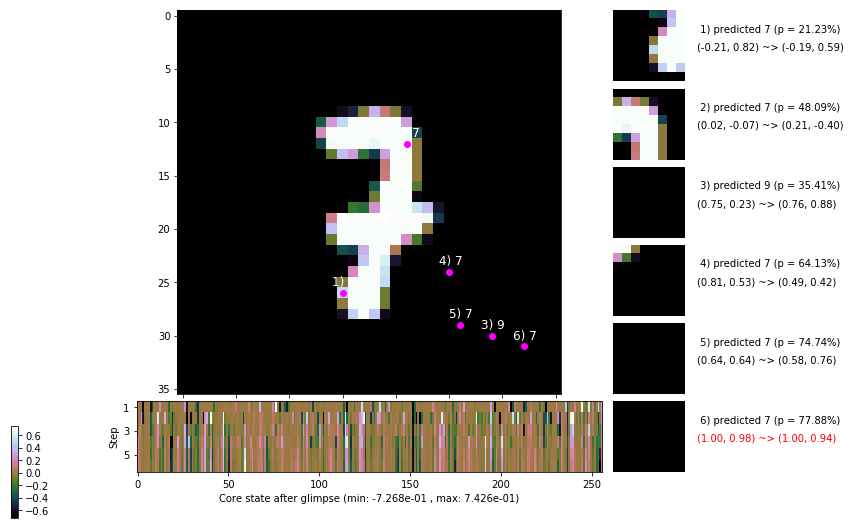

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 144.1 ms/b | lr: 2.56e-04 | grad 2norm: 12.30 | grad inf norm:  3.677
         Weights || abs max:  2.88 ( 3119.18) | mean: -5.83e-04 ( 0.01) | var: 8.63e-02 (  648.29)
          Biases || abs max:  1.51 (  963.69) | mean: -1.41e-01 ( 0.48) | var: 1.01e-01 ( 3689.85)
                    class loss: 0.313 | steps: 2.181 | reward:  3.799 | acc.: 89.12%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 141.0 ms/b | lr: 2.55e-04 | grad 2norm: 12.56 | grad inf norm:  3.982
         Weights || abs max:  2.88 ( 2629.50) | mean: -5.78e-04 ( 0.01) | var: 8.63e-02 (  298.52)
          Biases || abs max:  1.51 ( 1263.47) | mean: -1.41e-01 ( 0.60) | var: 1.01e-01 (10145.12)
                    class loss: 0.321 | steps: 2.181 | reward:  3.787 | acc.: 89.02%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

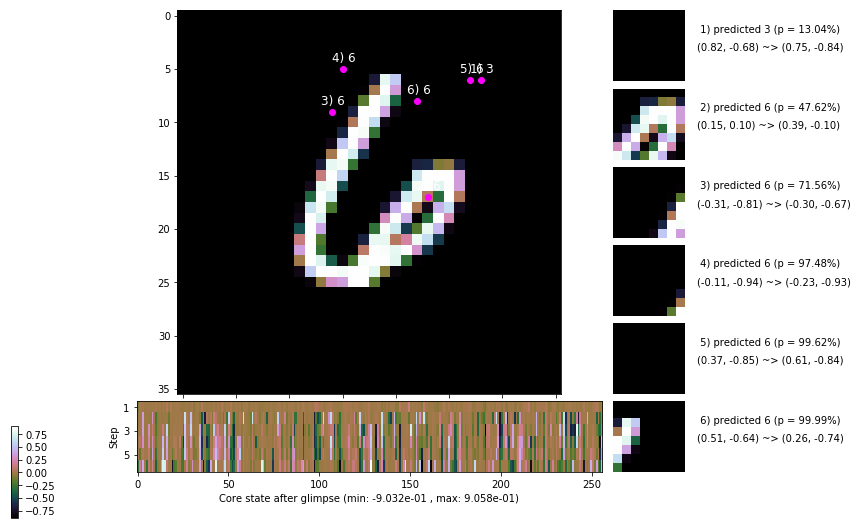

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


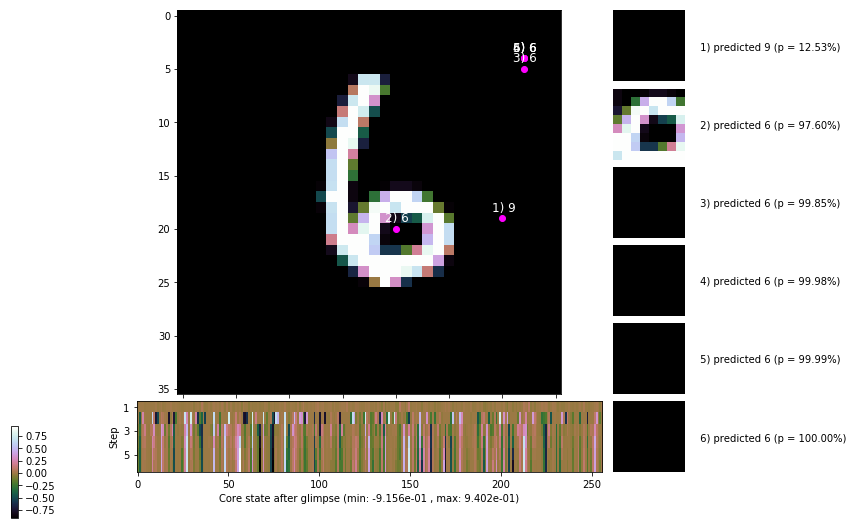


	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


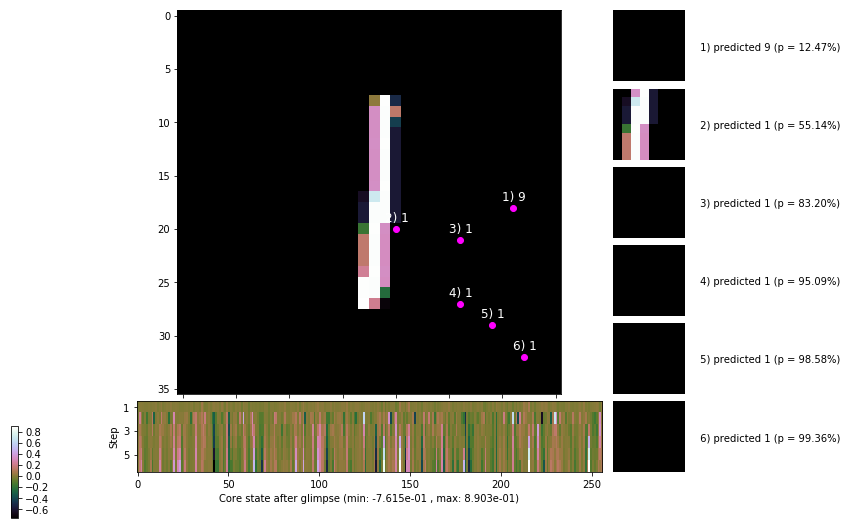

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


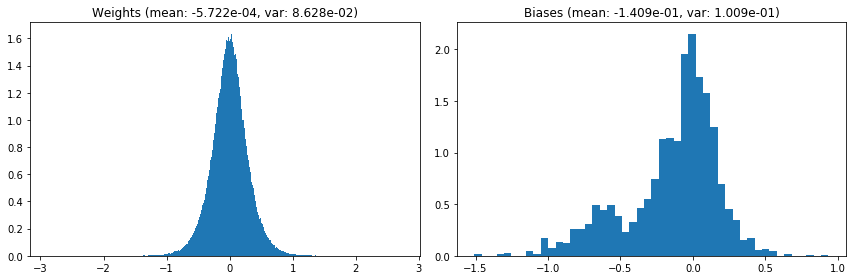

                                      Location network weights and biases


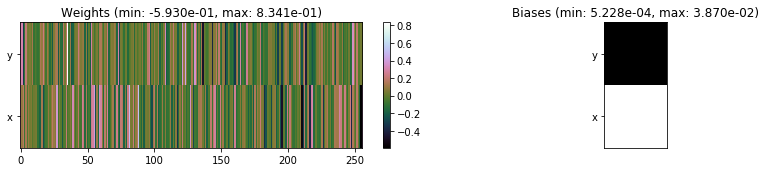

---------------------------------------------------------------------------------------------------------------
Elapsed time:  431.51 sec | TRAIN >> class loss: 0.3283 | steps:  2.197 :( | reward:  3.7677 :( | acc.: 88.898% :(
                          | VAL   >> class loss: 0.2966 | steps:  2.057    | reward:  4.0182    | acc.: 89.900% :(


Epoch  92/400) lr = 0.0002552
 b    300/  3000 >> 146.0 ms/b | lr: 2.55e-04 | grad 2norm: 12.36 | grad inf norm:  3.755
         Weights || abs max:  2.88 ( 4201.00) | mean: -5.71e-04 ( 0.01) | var: 8.63e-02 ( 2618.85)
          Biases || abs max:  1.51 (  959.93) | mean: -1.41e-01 ( 0.48) | var: 1.01e-01 (10587.48)
                    class loss: 0.322 | steps: 2.182 | reward:  3.838 | acc.: 89.40%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 145.6 ms/b | lr: 2.55e-04 | grad 2norm: 12.39 | grad inf norm:  3.691
         Weights || abs max:  2.88 ( 1372.35) | mean: -5.72e-04 (

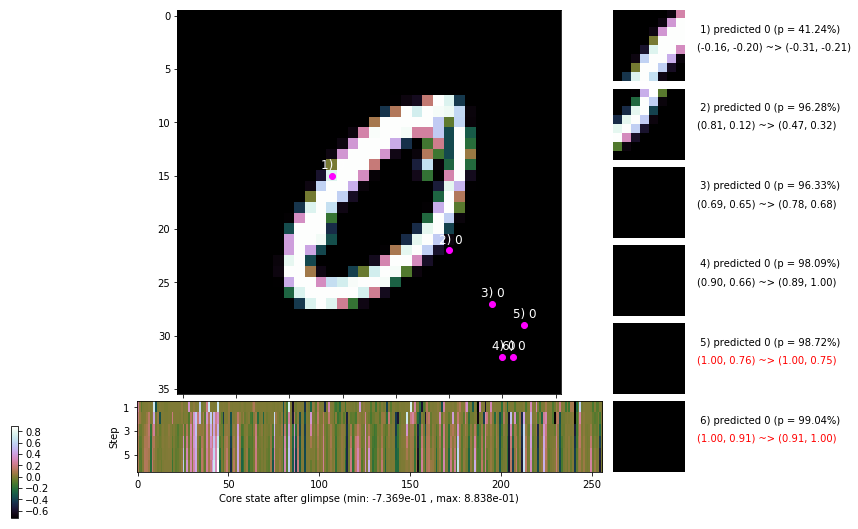

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 153.0 ms/b | lr: 2.54e-04 | grad 2norm: 12.35 | grad inf norm:  3.754
         Weights || abs max:  2.88 ( 1453.83) | mean: -5.86e-04 ( 0.01) | var: 8.63e-02 (   44.44)
          Biases || abs max:  1.51 (  738.96) | mean: -1.41e-01 ( 0.39) | var: 1.01e-01 ( 2428.29)
                    class loss: 0.332 | steps: 2.210 | reward:  3.783 | acc.: 89.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 145.5 ms/b | lr: 2.54e-04 | grad 2norm: 12.53 | grad inf norm:  3.779
         Weights || abs max:  2.88 ( 2252.10) | mean: -6.04e-04 ( 0.01) | var: 8.63e-02 (   86.53)
          Biases || abs max:  1.51 (  513.37) | mean: -1.41e-01 ( 0.30) | var: 1.01e-01 ( 1936.63)
                    class loss: 0.349 | steps: 2.215 | reward:  3.760 | acc.: 88.65%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

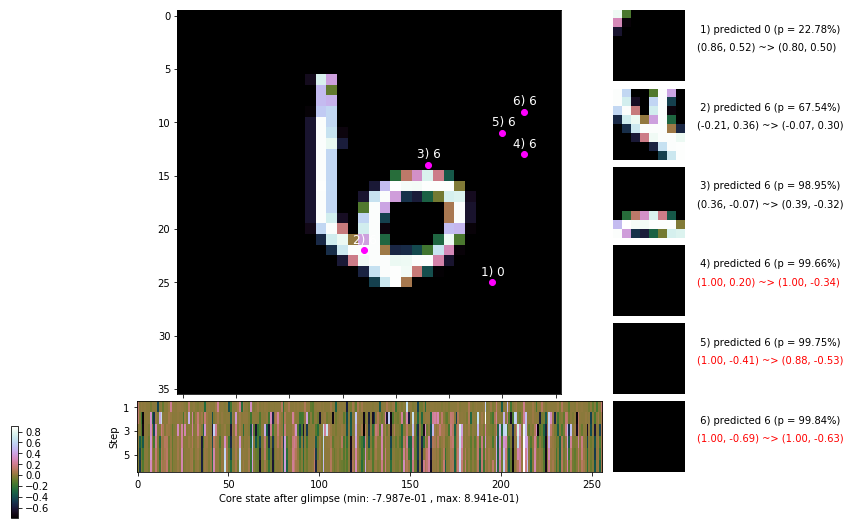

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 148.2 ms/b | lr: 2.53e-04 | grad 2norm: 12.74 | grad inf norm:  3.912
         Weights || abs max:  2.88 ( 4122.52) | mean: -5.99e-04 ( 0.01) | var: 8.63e-02 (  573.99)
          Biases || abs max:  1.51 (  149.28) | mean: -1.41e-01 ( 0.13) | var: 1.01e-01 (  130.23)
                    class loss: 0.347 | steps: 2.231 | reward:  3.713 | acc.: 88.50%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.3 ms/b | lr: 2.53e-04 | grad 2norm: 12.52 | grad inf norm:  3.841
         Weights || abs max:  2.88 ( 2003.36) | mean: -5.90e-04 ( 0.01) | var: 8.64e-02 (   48.14)
          Biases || abs max:  1.51 (  337.74) | mean: -1.41e-01 ( 0.21) | var: 1.01e-01 (  548.93)
                    class loss: 0.322 | steps: 2.176 | reward:  3.803 | acc.: 89.10%

	Target class: 7 | Discounted rewards: [-0.281, 0.438, 1.

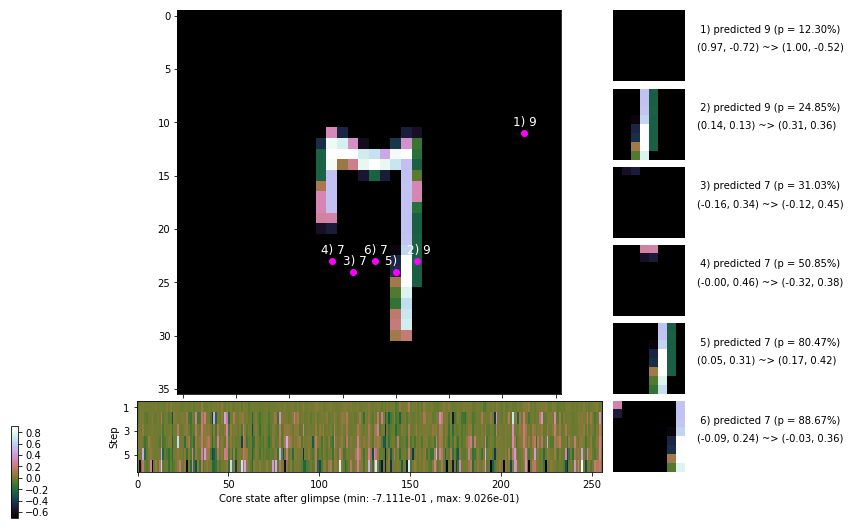

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 144.8 ms/b | lr: 2.53e-04 | grad 2norm: 12.49 | grad inf norm:  3.746
         Weights || abs max:  2.88 ( 2056.38) | mean: -5.82e-04 ( 0.01) | var: 8.64e-02 (   70.00)
          Biases || abs max:  1.51 (  175.10) | mean: -1.41e-01 ( 0.15) | var: 1.01e-01 (   48.68)
                    class loss: 0.319 | steps: 2.187 | reward:  3.766 | acc.: 88.87%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.1 ms/b | lr: 2.52e-04 | grad 2norm: 12.32 | grad inf norm:  3.574
         Weights || abs max:  2.88 ( 1648.79) | mean: -5.78e-04 ( 0.01) | var: 8.64e-02 (   62.21)
          Biases || abs max:  1.51 (  183.85) | mean: -1.41e-01 ( 0.17) | var: 1.01e-01 (  913.54)
                    class loss: 0.326 | steps: 2.190 | reward:  3.776 | acc.: 89.05%

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.8

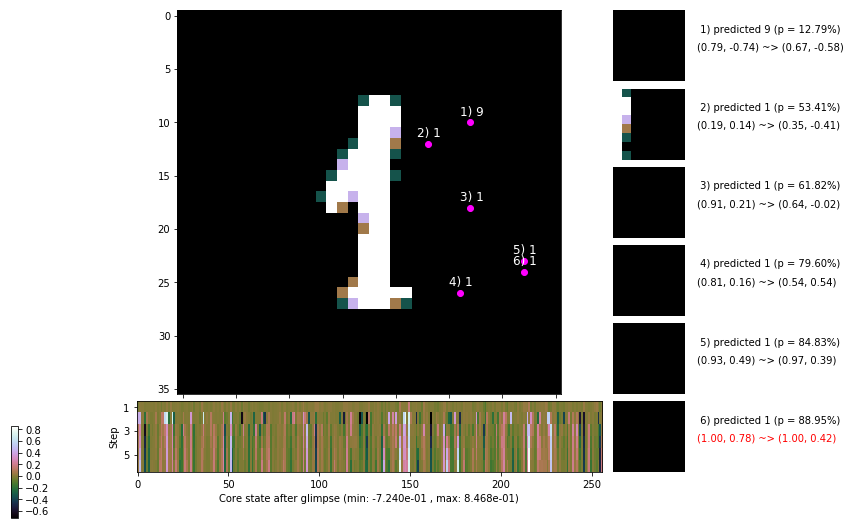

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 149.0 ms/b | lr: 2.52e-04 | grad 2norm: 12.19 | grad inf norm:  3.629
         Weights || abs max:  2.89 ( 1187.65) | mean: -5.87e-04 ( 0.01) | var: 8.64e-02 (   14.74)
          Biases || abs max:  1.51 (  263.74) | mean: -1.41e-01 ( 0.20) | var: 1.01e-01 (  354.39)
                    class loss: 0.307 | steps: 2.181 | reward:  3.810 | acc.: 89.45%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.1 ms/b | lr: 2.52e-04 | grad 2norm: 12.23 | grad inf norm:  3.616
         Weights || abs max:  2.89 ( 1902.74) | mean: -5.91e-04 ( 0.01) | var: 8.64e-02 (   75.06)
          Biases || abs max:  1.51 (  181.01) | mean: -1.41e-01 ( 0.16) | var: 1.01e-01 (  118.68)
                    class loss: 0.323 | steps: 2.177 | reward:  3.806 | acc.: 88.80%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

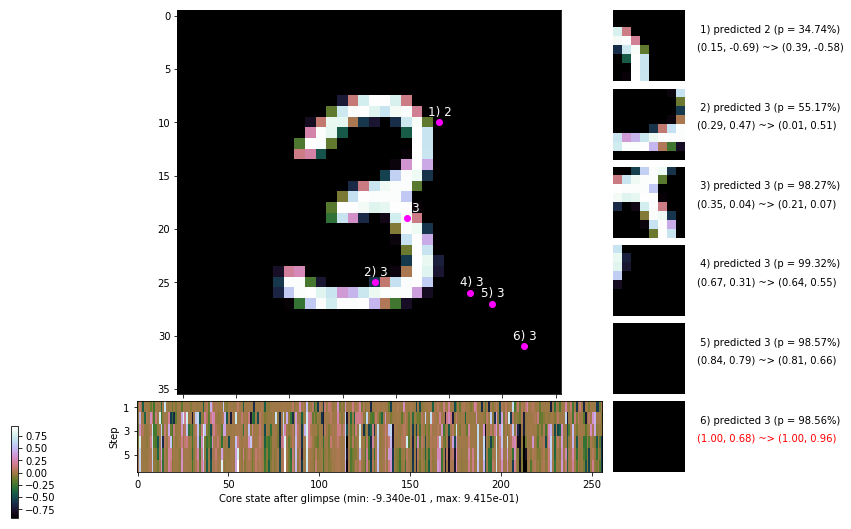

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


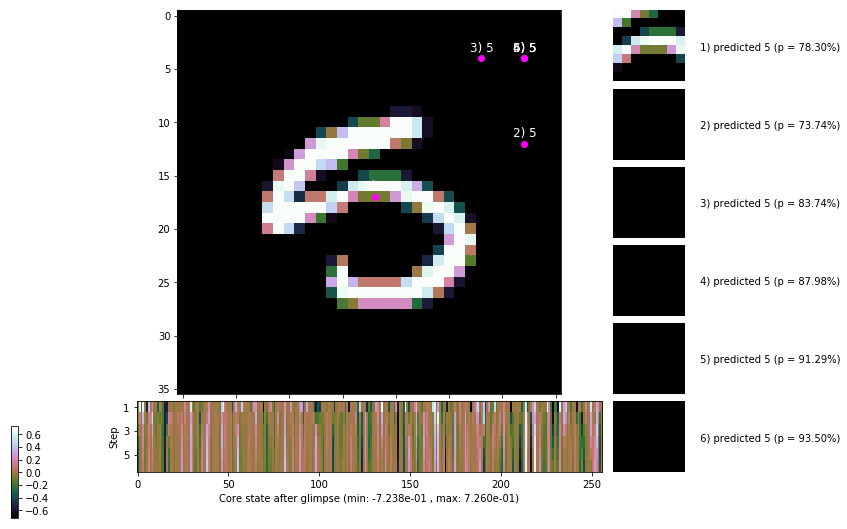


	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


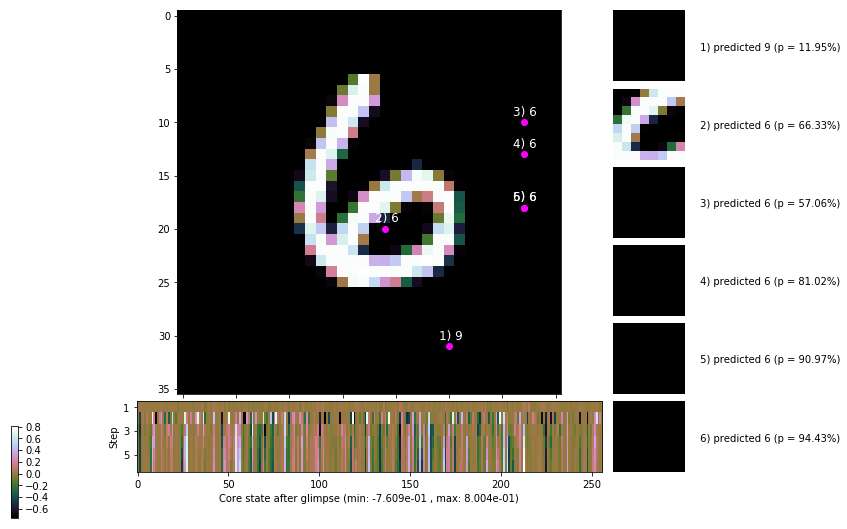

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


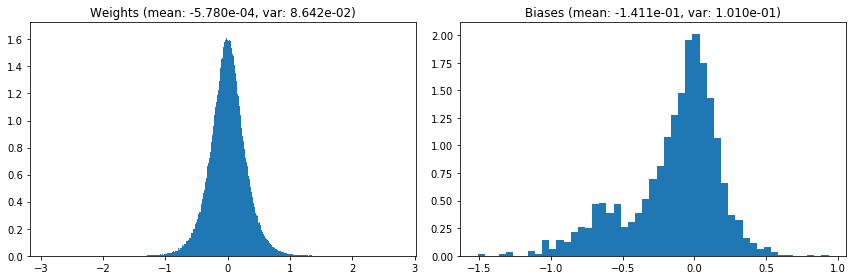

                                      Location network weights and biases


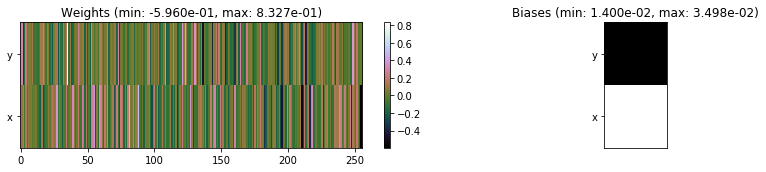

---------------------------------------------------------------------------------------------------------------
Elapsed time:  439.44 sec | TRAIN >> class loss: 0.3266 | steps:  2.193 :( | reward:  3.7849 :( | acc.: 89.010% :(
                          | VAL   >> class loss: 0.3225 | steps:  2.117 :( | reward:  3.9225 :( | acc.: 88.900% :(


Epoch  93/400) lr = 0.0002514
 b    300/  3000 >> 144.5 ms/b | lr: 2.51e-04 | grad 2norm: 12.22 | grad inf norm:  3.808
         Weights || abs max:  2.89 ( 1606.74) | mean: -5.76e-04 ( 0.01) | var: 8.64e-02 (   46.98)
          Biases || abs max:  1.51 (  349.32) | mean: -1.41e-01 ( 0.23) | var: 1.01e-01 (  806.68)
                    class loss: 0.322 | steps: 2.156 | reward:  3.848 | acc.: 89.38%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 150.0 ms/b | lr: 2.51e-04 | grad 2norm: 12.62 | grad inf norm:  3.825
         Weights || abs max:  2.89 ( 2638.22) | mean: -5.73e-04 (

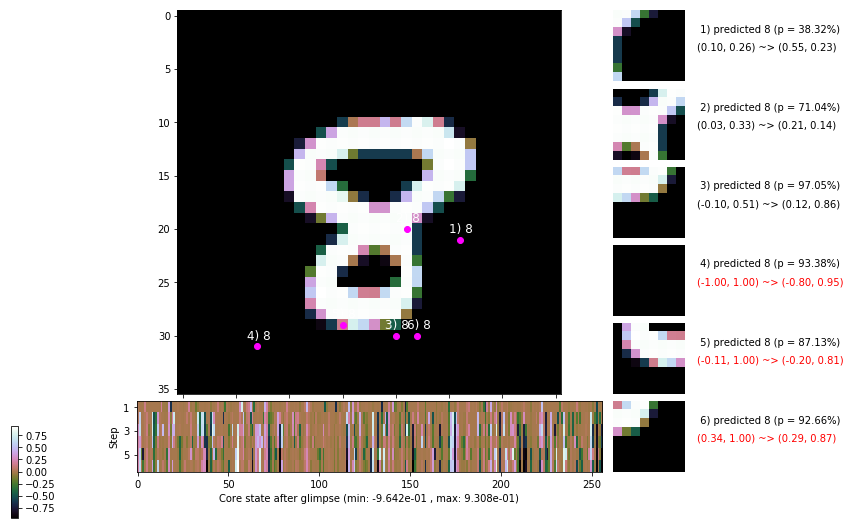

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 151.9 ms/b | lr: 2.50e-04 | grad 2norm: 12.19 | grad inf norm:  3.761
         Weights || abs max:  2.89 ( 3839.52) | mean: -5.86e-04 ( 0.01) | var: 8.64e-02 (  667.57)
          Biases || abs max:  1.51 (  308.29) | mean: -1.42e-01 ( 0.21) | var: 1.01e-01 ( 1214.92)
                    class loss: 0.323 | steps: 2.179 | reward:  3.812 | acc.: 89.48%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 146.3 ms/b | lr: 2.50e-04 | grad 2norm: 12.43 | grad inf norm:  3.961
         Weights || abs max:  2.89 ( 1945.81) | mean: -5.85e-04 ( 0.01) | var: 8.65e-02 (   44.67)
          Biases || abs max:  1.51 (  332.82) | mean: -1.41e-01 ( 0.22) | var: 1.01e-01 ( 1168.94)
                    class loss: 0.321 | steps: 2.175 | reward:  3.800 | acc.: 89.00%

	Target class: 3 | Discounted rewards: [0.844, -0.312, 0.

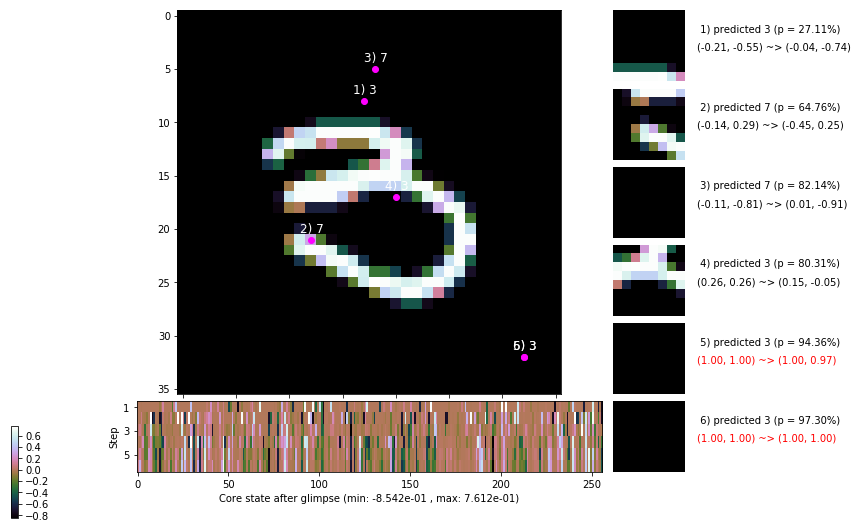

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 145.4 ms/b | lr: 2.50e-04 | grad 2norm: 12.18 | grad inf norm:  3.681
         Weights || abs max:  2.89 ( 1795.10) | mean: -5.95e-04 ( 0.01) | var: 8.65e-02 (   94.94)
          Biases || abs max:  1.51 (   92.86) | mean: -1.41e-01 ( 0.11) | var: 1.01e-01 (   86.89)
                    class loss: 0.322 | steps: 2.196 | reward:  3.785 | acc.: 89.22%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.1 ms/b | lr: 2.49e-04 | grad 2norm: 12.64 | grad inf norm:  3.726
         Weights || abs max:  2.89 ( 3737.14) | mean: -5.97e-04 ( 0.01) | var: 8.65e-02 (  475.42)
          Biases || abs max:  1.51 (  108.71) | mean: -1.41e-01 ( 0.13) | var: 1.01e-01 (  156.86)
                    class loss: 0.328 | steps: 2.195 | reward:  3.766 | acc.: 88.78%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

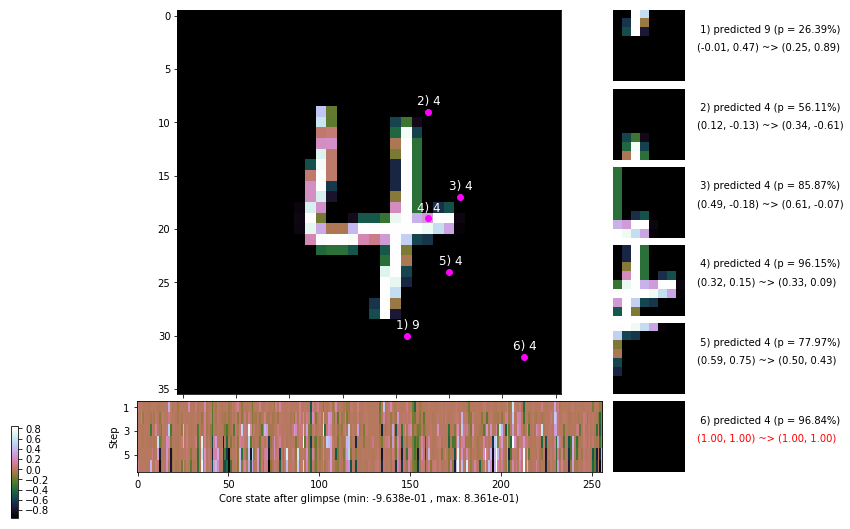

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.3 ms/b | lr: 2.49e-04 | grad 2norm: 12.25 | grad inf norm:  3.628
         Weights || abs max:  2.89 ( 1804.36) | mean: -6.01e-04 ( 0.01) | var: 8.65e-02 (   76.19)
          Biases || abs max:  1.51 ( 5214.06) | mean: -1.42e-01 ( 2.10) | var: 1.01e-01 (3032809.25)
                    class loss: 0.322 | steps: 2.203 | reward:  3.778 | acc.: 89.30%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 143.2 ms/b | lr: 2.49e-04 | grad 2norm: 12.51 | grad inf norm:  3.853
         Weights || abs max:  2.89 ( 2840.93) | mean: -5.95e-04 ( 0.01) | var: 8.65e-02 (  194.29)
          Biases || abs max:  1.51 (  118.96) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (  175.44)
                    class loss: 0.333 | steps: 2.189 | reward:  3.789 | acc.: 89.20%

	Target class: 2 | Discounted rewards: [-0.281, 0.438, 

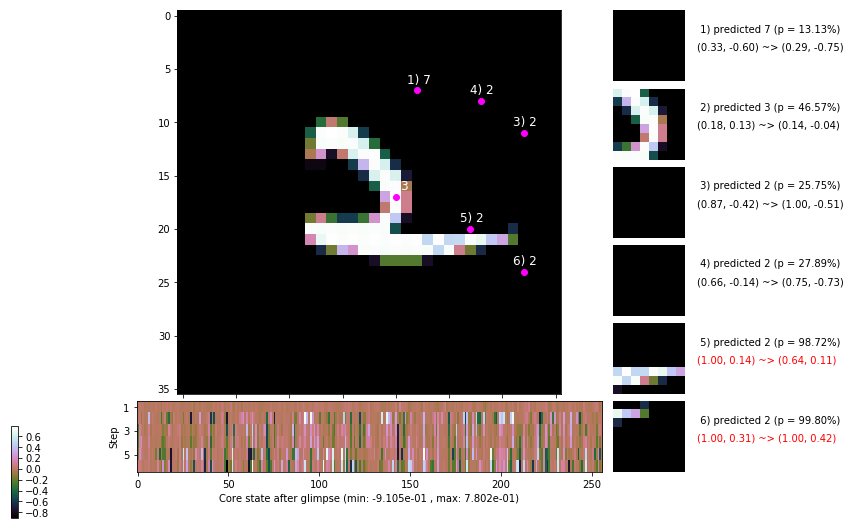

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 148.1 ms/b | lr: 2.48e-04 | grad 2norm: 12.38 | grad inf norm:  3.809
         Weights || abs max:  2.89 ( 4787.01) | mean: -6.10e-04 ( 0.02) | var: 8.65e-02 ( 3545.02)
          Biases || abs max:  1.51 (  267.82) | mean: -1.41e-01 ( 0.20) | var: 1.01e-01 (  664.94)
                    class loss: 0.335 | steps: 2.192 | reward:  3.772 | acc.: 88.58%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 144.0 ms/b | lr: 2.48e-04 | grad 2norm: 12.32 | grad inf norm:  3.726
         Weights || abs max:  2.89 ( 2179.97) | mean: -6.11e-04 ( 0.01) | var: 8.66e-02 (   71.96)
          Biases || abs max:  1.51 (  193.41) | mean: -1.41e-01 ( 0.16) | var: 1.01e-01 (  190.86)
                    class loss: 0.328 | steps: 2.197 | reward:  3.791 | acc.: 89.28%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

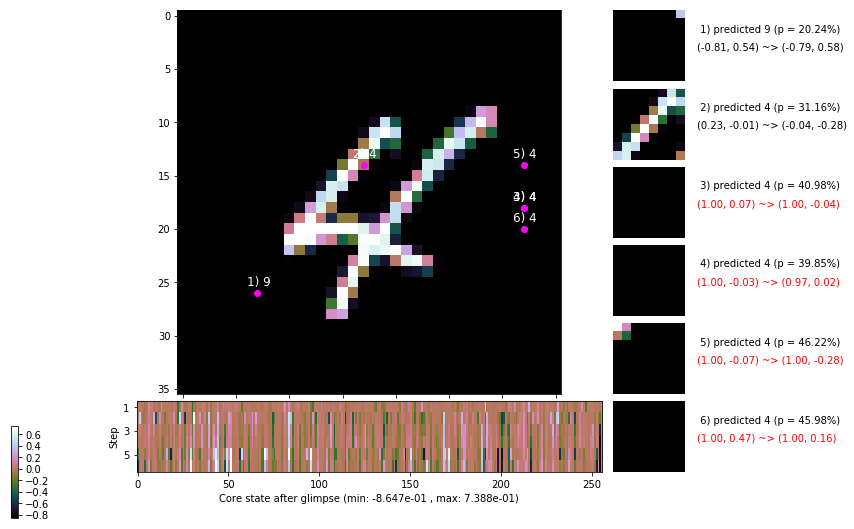

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


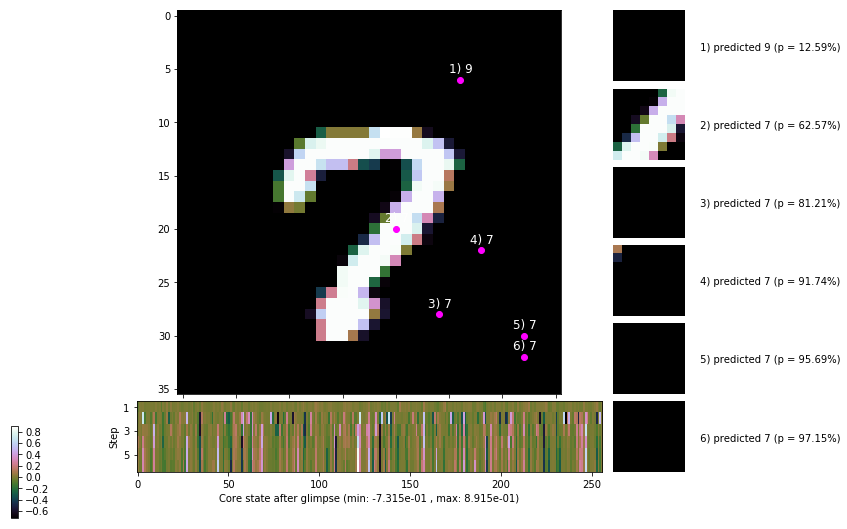


	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


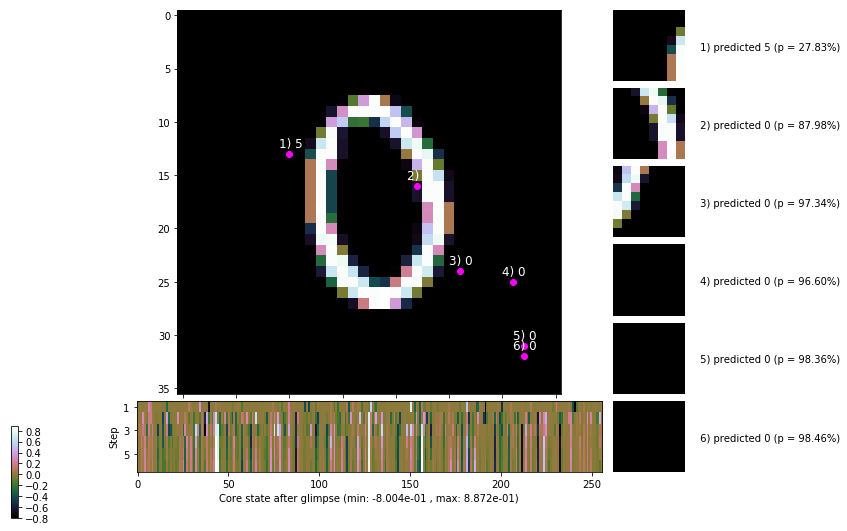

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


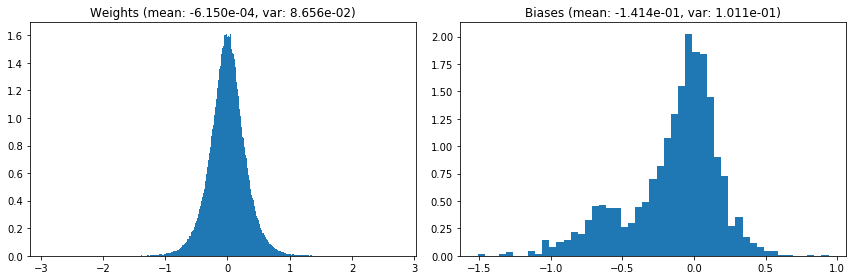

                                      Location network weights and biases


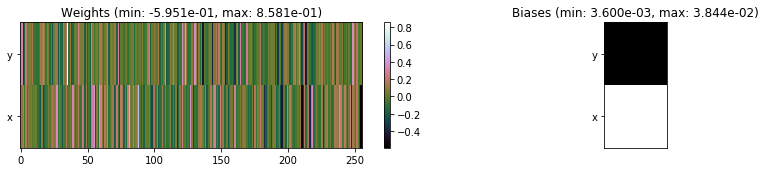

---------------------------------------------------------------------------------------------------------------
Elapsed time:  440.02 sec | TRAIN >> class loss: 0.3273 | steps:  2.187 :( | reward:  3.7926 :( | acc.: 89.100% :(
                          | VAL   >> class loss: 0.3207 | steps:  2.070 :( | reward:  3.9687 :( | acc.: 89.100% :(


Epoch  94/400) lr = 0.0002477
 b    300/  3000 >> 144.7 ms/b | lr: 2.47e-04 | grad 2norm: 12.84 | grad inf norm:  3.977
         Weights || abs max:  2.89 (     inf) | mean: -6.19e-04 (  inf) | var: 8.66e-02 (     nan)
          Biases || abs max:  1.51 (  382.63) | mean: -1.41e-01 ( 0.24) | var: 1.01e-01 ( 2196.00)
                    class loss: 0.353 | steps: 2.212 | reward:  3.715 | acc.: 87.67%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.9 ms/b | lr: 2.47e-04 | grad 2norm: 12.71 | grad inf norm:  3.799
         Weights || abs max:  2.89 ( 2515.93) | mean: -6.21e-04 (

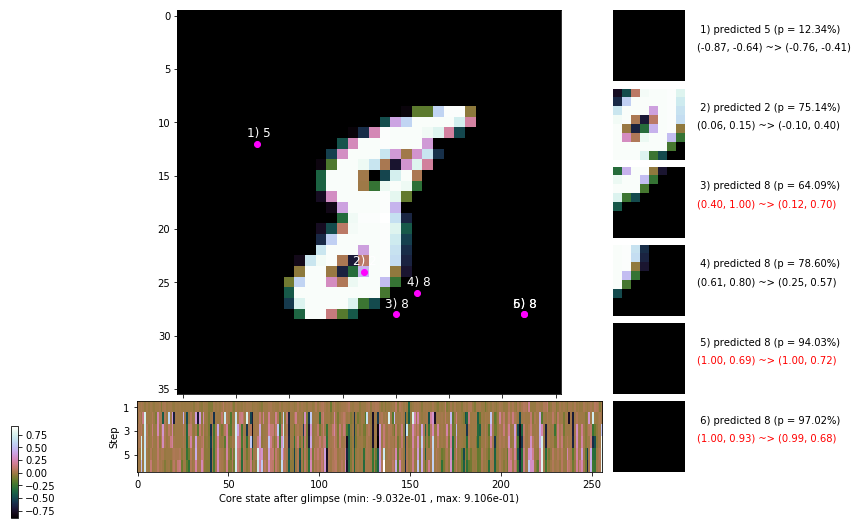

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 145.2 ms/b | lr: 2.47e-04 | grad 2norm: 12.44 | grad inf norm:  3.726
         Weights || abs max:  2.89 ( 2489.92) | mean: -6.30e-04 ( 0.01) | var: 8.66e-02 (  185.28)
          Biases || abs max:  1.50 (  219.26) | mean: -1.42e-01 ( 0.16) | var: 1.01e-01 (  348.22)
                    class loss: 0.332 | steps: 2.183 | reward:  3.802 | acc.: 89.02%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 144.2 ms/b | lr: 2.46e-04 | grad 2norm: 12.18 | grad inf norm:  3.730
         Weights || abs max:  2.89 ( 2210.87) | mean: -6.39e-04 ( 0.01) | var: 8.66e-02 (  110.78)
          Biases || abs max:  1.50 ( 1172.34) | mean: -1.42e-01 ( 0.55) | var: 1.01e-01 (118729.95)
                    class loss: 0.315 | steps: 2.189 | reward:  3.797 | acc.: 89.22%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.

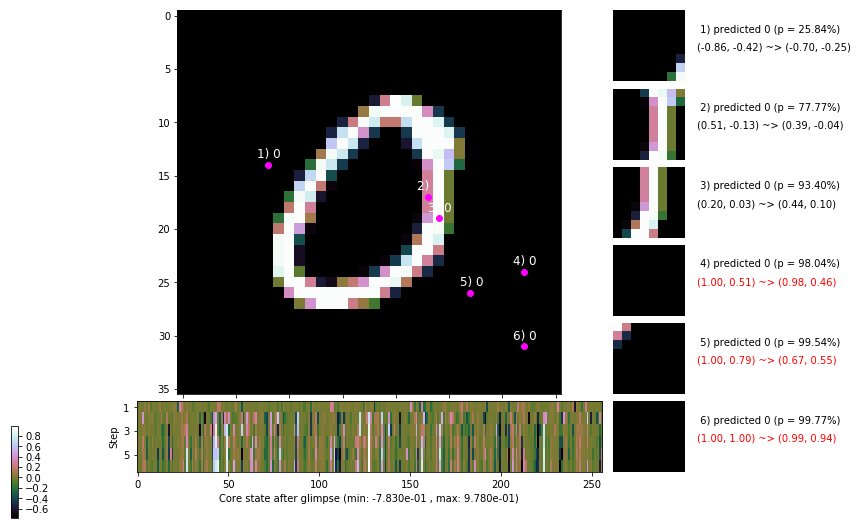

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 147.3 ms/b | lr: 2.46e-04 | grad 2norm: 12.25 | grad inf norm:  3.738
         Weights || abs max:  2.89 ( 5033.98) | mean: -6.33e-04 ( 0.02) | var: 8.66e-02 ( 5180.43)
          Biases || abs max:  1.50 (  599.09) | mean: -1.41e-01 ( 0.34) | var: 1.01e-01 ( 3481.00)
                    class loss: 0.342 | steps: 2.192 | reward:  3.788 | acc.: 89.00%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 143.4 ms/b | lr: 2.46e-04 | grad 2norm: 12.25 | grad inf norm:  3.756
         Weights || abs max:  2.89 ( 5401.09) | mean: -6.34e-04 ( 0.02) | var: 8.66e-02 ( 3986.02)
          Biases || abs max:  1.50 (  537.22) | mean: -1.42e-01 ( 0.36) | var: 1.01e-01 ( 8552.59)
                    class loss: 0.330 | steps: 2.172 | reward:  3.791 | acc.: 88.57%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

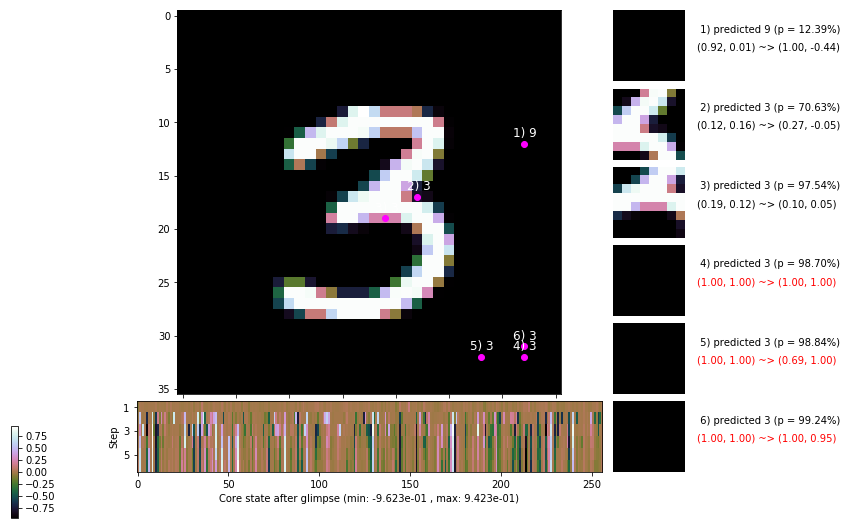

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 145.1 ms/b | lr: 2.45e-04 | grad 2norm: 12.24 | grad inf norm:  3.739
         Weights || abs max:  2.89 ( 2108.74) | mean: -6.29e-04 ( 0.01) | var: 8.67e-02 (  153.32)
          Biases || abs max:  1.50 (  318.67) | mean: -1.41e-01 ( 0.21) | var: 1.01e-01 ( 1873.93)
                    class loss: 0.315 | steps: 2.158 | reward:  3.819 | acc.: 89.05%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 139.7 ms/b | lr: 2.45e-04 | grad 2norm: 12.41 | grad inf norm:  3.671
         Weights || abs max:  2.89 ( 9339.26) | mean: -6.13e-04 ( 0.02) | var: 8.67e-02 (10620.22)
          Biases || abs max:  1.50 (  276.51) | mean: -1.41e-01 ( 0.20) | var: 1.01e-01 (  290.51)
                    class loss: 0.330 | steps: 2.216 | reward:  3.736 | acc.: 88.82%

	Target class: 6 | Discounted rewards: [1.219, 0.438, 1.8

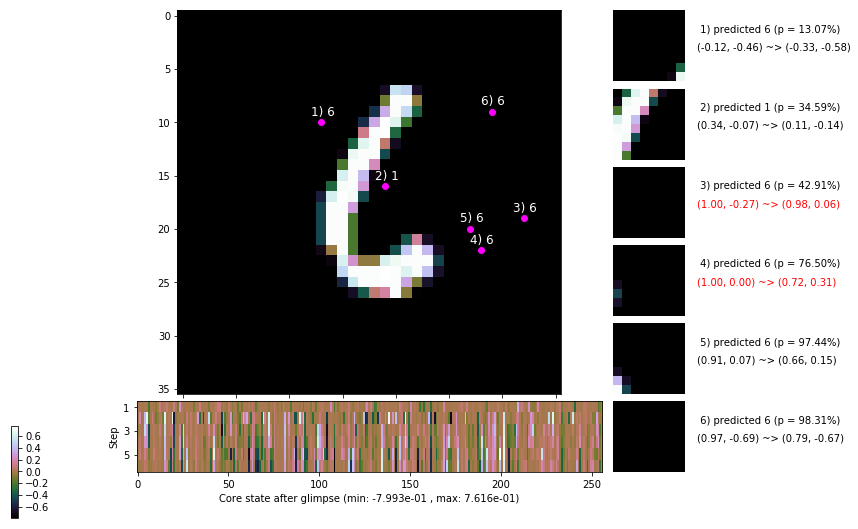

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.4 ms/b | lr: 2.44e-04 | grad 2norm: 12.30 | grad inf norm:  3.835
         Weights || abs max:  2.89 ( 1920.24) | mean: -6.21e-04 ( 0.01) | var: 8.67e-02 (   39.39)
          Biases || abs max:  1.49 (  798.75) | mean: -1.41e-01 ( 0.39) | var: 1.01e-01 (39928.12)
                    class loss: 0.338 | steps: 2.184 | reward:  3.800 | acc.: 89.35%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 147.5 ms/b | lr: 2.44e-04 | grad 2norm: 12.22 | grad inf norm:  3.636
         Weights || abs max:  2.89 ( 5210.49) | mean: -6.13e-04 ( 0.02) | var: 8.67e-02 ( 3655.01)
          Biases || abs max:  1.49 (  121.19) | mean: -1.41e-01 ( 0.13) | var: 1.01e-01 (   41.63)
                    class loss: 0.334 | steps: 2.215 | reward:  3.754 | acc.: 88.73%

	Target class: 8 | Discounted rewards: [-0.281, 0.438, 1.

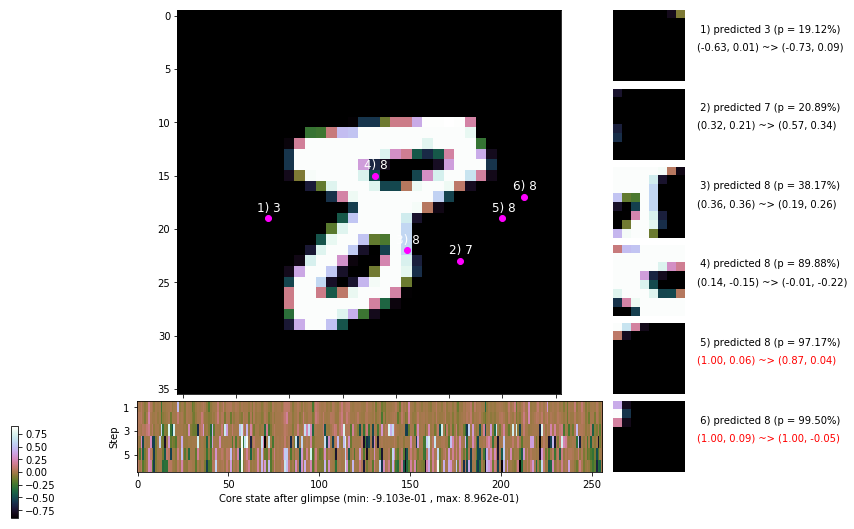

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


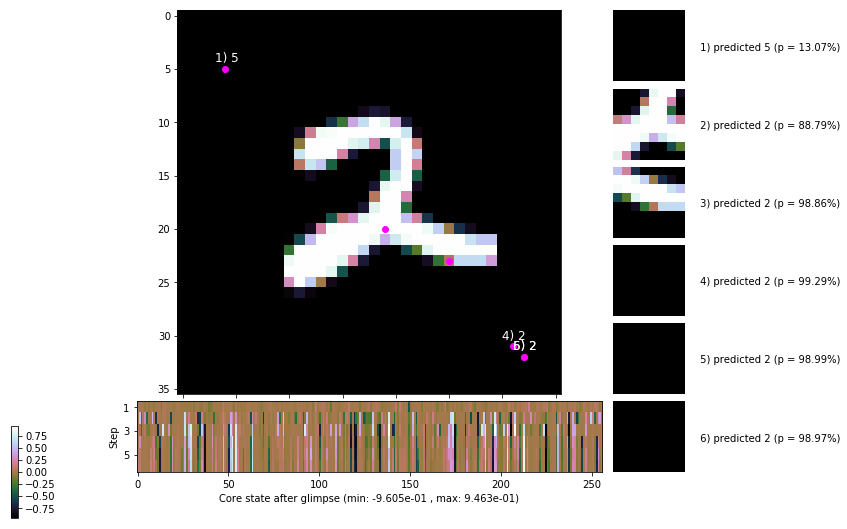


	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


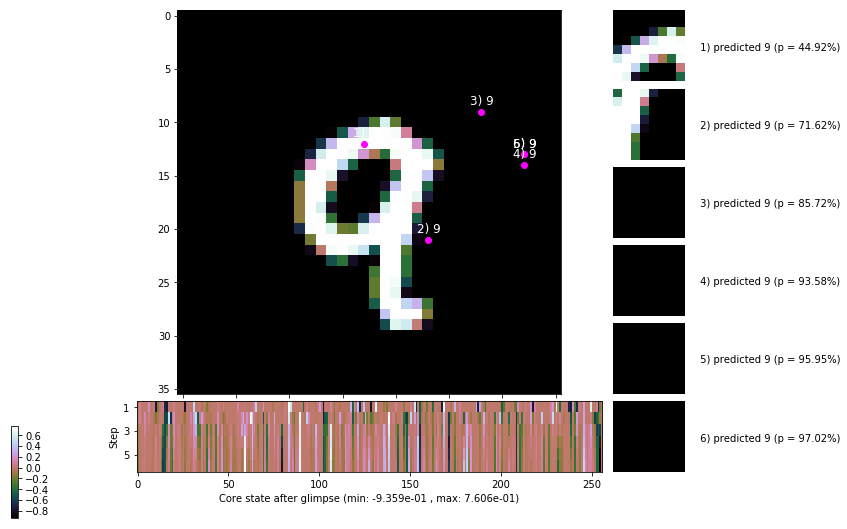

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


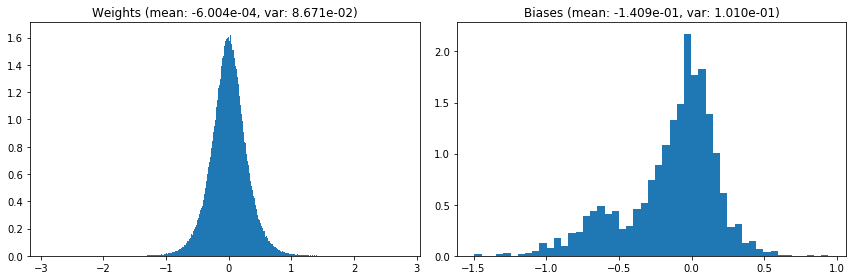

                                      Location network weights and biases


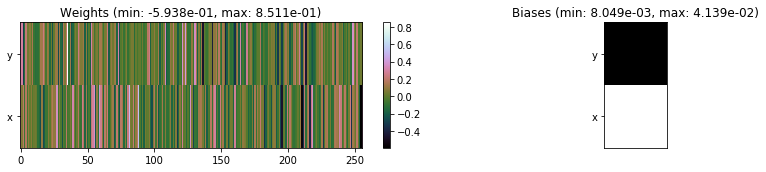

---------------------------------------------------------------------------------------------------------------
Elapsed time:  434.82 sec | TRAIN >> class loss: 0.3343 | steps:  2.191 :( | reward:  3.7776 :( | acc.: 88.777% :(
                          | VAL   >> class loss: 0.3416 | steps:  2.125 :( | reward:  3.9000 :( | acc.: 88.680% :(


Epoch  95/400) lr = 0.000244
 b    300/  3000 >> 144.2 ms/b | lr: 2.44e-04 | grad 2norm: 12.37 | grad inf norm:  3.916
         Weights || abs max:  2.88 ( 1672.68) | mean: -5.97e-04 ( 0.01) | var: 8.67e-02 (   48.65)
          Biases || abs max:  1.50 (  111.69) | mean: -1.41e-01 ( 0.12) | var: 1.01e-01 (  108.96)
                    class loss: 0.342 | steps: 2.213 | reward:  3.721 | acc.: 88.07%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 142.6 ms/b | lr: 2.43e-04 | grad 2norm: 12.58 | grad inf norm:  3.895
         Weights || abs max:  2.88 ( 3036.16) | mean: -5.94e-04 ( 

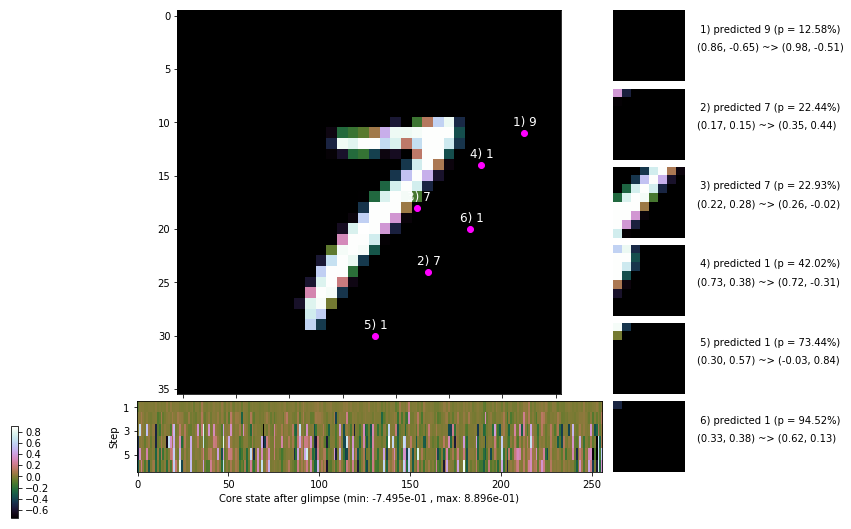

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 145.4 ms/b | lr: 2.43e-04 | grad 2norm: 12.62 | grad inf norm:  3.827
         Weights || abs max:  2.88 ( 2243.18) | mean: -5.95e-04 ( 0.01) | var: 8.67e-02 (   81.23)
          Biases || abs max:  1.50 (  141.53) | mean: -1.41e-01 ( 0.14) | var: 1.01e-01 (   74.81)
                    class loss: 0.359 | steps: 2.228 | reward:  3.709 | acc.: 87.93%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 145.3 ms/b | lr: 2.43e-04 | grad 2norm: 12.67 | grad inf norm:  3.968
         Weights || abs max:  2.88 ( 2289.36) | mean: -5.89e-04 ( 0.01) | var: 8.67e-02 (  167.27)
          Biases || abs max:  1.51 (  288.81) | mean: -1.42e-01 ( 0.21) | var: 1.01e-01 ( 1511.20)
                    class loss: 0.369 | steps: 2.245 | reward:  3.686 | acc.: 87.73%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

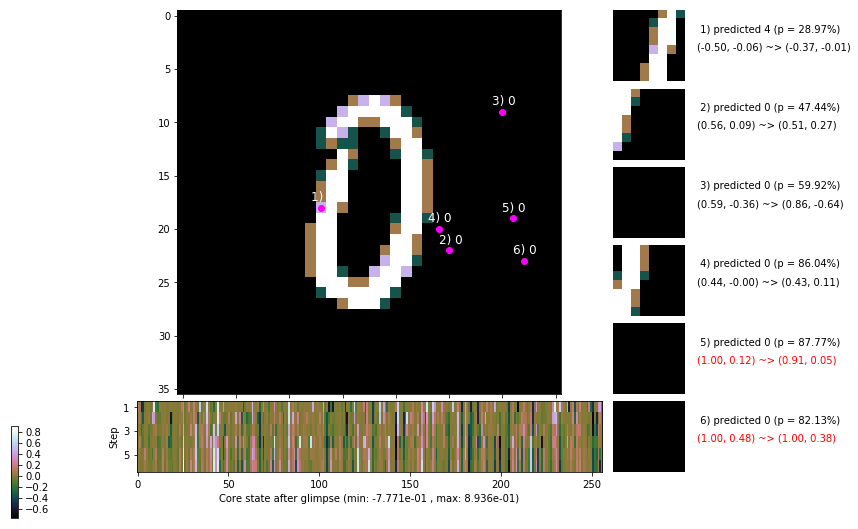

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 148.6 ms/b | lr: 2.42e-04 | grad 2norm: 12.52 | grad inf norm:  3.871
         Weights || abs max:  2.88 ( 2348.47) | mean: -5.88e-04 ( 0.01) | var: 8.67e-02 (  240.10)
          Biases || abs max:  1.51 (  480.76) | mean: -1.42e-01 ( 0.27) | var: 1.01e-01 ( 7865.56)
                    class loss: 0.348 | steps: 2.246 | reward:  3.693 | acc.: 87.87%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.9 ms/b | lr: 2.42e-04 | grad 2norm: 12.51 | grad inf norm:  3.814
         Weights || abs max:  2.88 ( 2940.16) | mean: -5.95e-04 ( 0.01) | var: 8.68e-02 (  302.66)
          Biases || abs max:  1.51 (  241.25) | mean: -1.42e-01 ( 0.18) | var: 1.01e-01 (  374.30)
                    class loss: 0.340 | steps: 2.210 | reward:  3.757 | acc.: 88.53%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

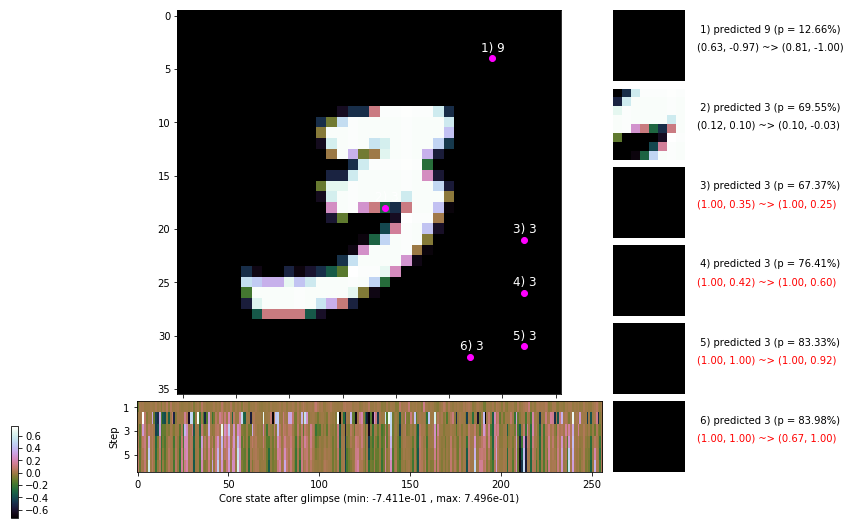

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 146.1 ms/b | lr: 2.42e-04 | grad 2norm: 12.51 | grad inf norm:  3.704
         Weights || abs max:  2.88 ( 3512.78) | mean: -5.92e-04 ( 0.01) | var: 8.68e-02 ( 1137.58)
          Biases || abs max:  1.51 (  153.62) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (  484.93)
                    class loss: 0.342 | steps: 2.215 | reward:  3.728 | acc.: 88.05%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 142.0 ms/b | lr: 2.41e-04 | grad 2norm: 12.57 | grad inf norm:  3.864
         Weights || abs max:  2.88 ( 4635.52) | mean: -5.97e-04 ( 0.01) | var: 8.68e-02 ( 1914.45)
          Biases || abs max:  1.50 (  108.83) | mean: -1.42e-01 ( 0.11) | var: 1.01e-01 (   28.44)
                    class loss: 0.342 | steps: 2.215 | reward:  3.745 | acc.: 88.47%

	Target class: 2 | Discounted rewards: [-0.656, -0.312, 0

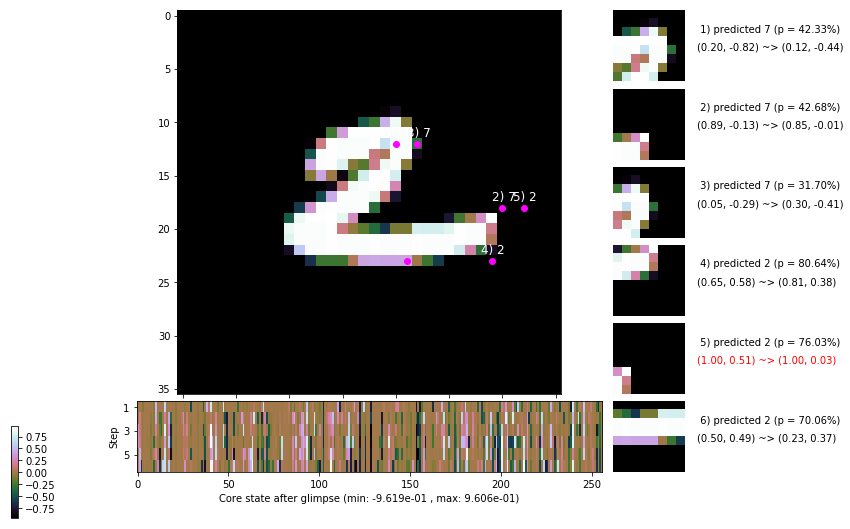

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 150.6 ms/b | lr: 2.41e-04 | grad 2norm: 12.74 | grad inf norm:  3.878
         Weights || abs max:  2.88 (11157.88) | mean: -5.91e-04 ( 0.03) | var: 8.68e-02 (50298.46)
          Biases || abs max:  1.50 (  188.78) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (  146.14)
                    class loss: 0.357 | steps: 2.228 | reward:  3.681 | acc.: 87.88%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 142.5 ms/b | lr: 2.41e-04 | grad 2norm: 12.43 | grad inf norm:  3.934
         Weights || abs max:  2.88 ( 1821.06) | mean: -5.86e-04 ( 0.01) | var: 8.68e-02 (   38.52)
          Biases || abs max:  1.51 (  114.28) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   62.70)
                    class loss: 0.341 | steps: 2.237 | reward:  3.715 | acc.: 88.62%

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.8

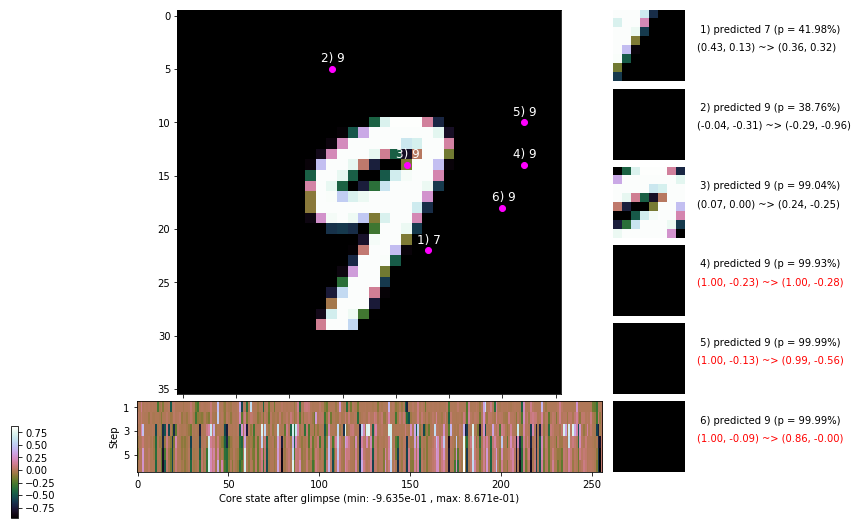

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


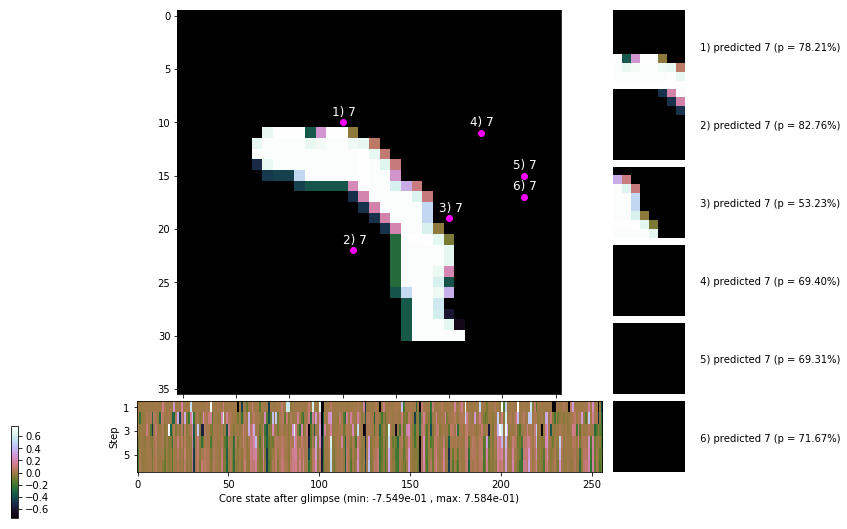


	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


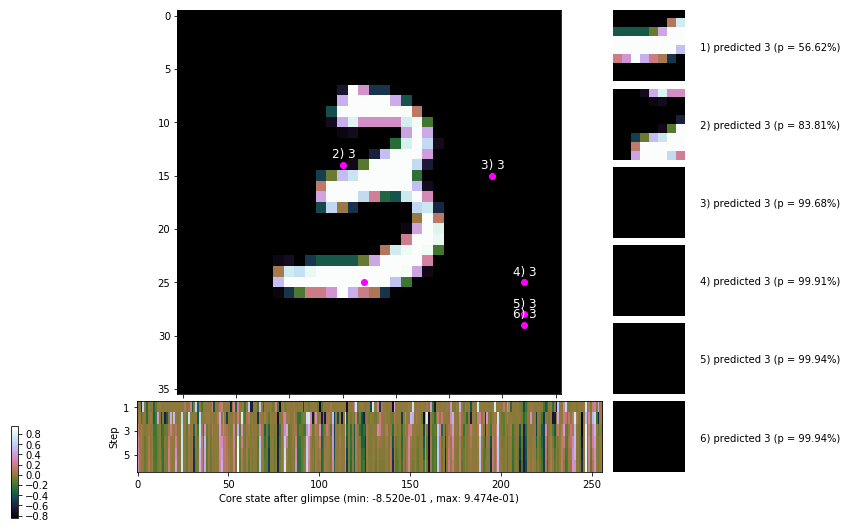

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


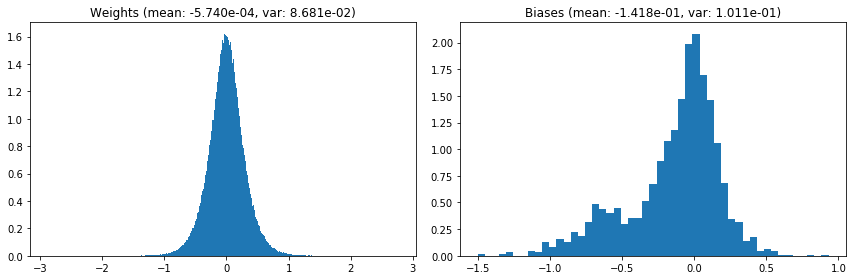

                                      Location network weights and biases


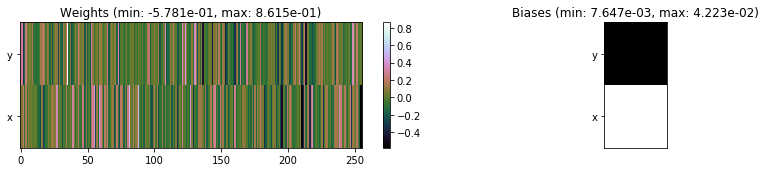

---------------------------------------------------------------------------------------------------------------
Elapsed time:  435.93 sec | TRAIN >> class loss: 0.3498 | steps:  2.226 :( | reward:  3.7137 :( | acc.: 88.093% :(
                          | VAL   >> class loss: 0.3334 | steps:  2.110 :( | reward:  3.9249 :( | acc.: 88.900% :(


Epoch  96/400) lr = 0.0002403
 b    300/  3000 >> 145.0 ms/b | lr: 2.40e-04 | grad 2norm: 12.29 | grad inf norm:  3.717
         Weights || abs max:  2.88 ( 2821.55) | mean: -5.73e-04 ( 0.01) | var: 8.68e-02 (  827.40)
          Biases || abs max:  1.51 (  120.26) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   35.83)
                    class loss: 0.345 | steps: 2.201 | reward:  3.753 | acc.: 88.28%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 150.1 ms/b | lr: 2.40e-04 | grad 2norm: 12.72 | grad inf norm:  4.046
         Weights || abs max:  2.88 ( 3118.18) | mean: -5.69e-04 (

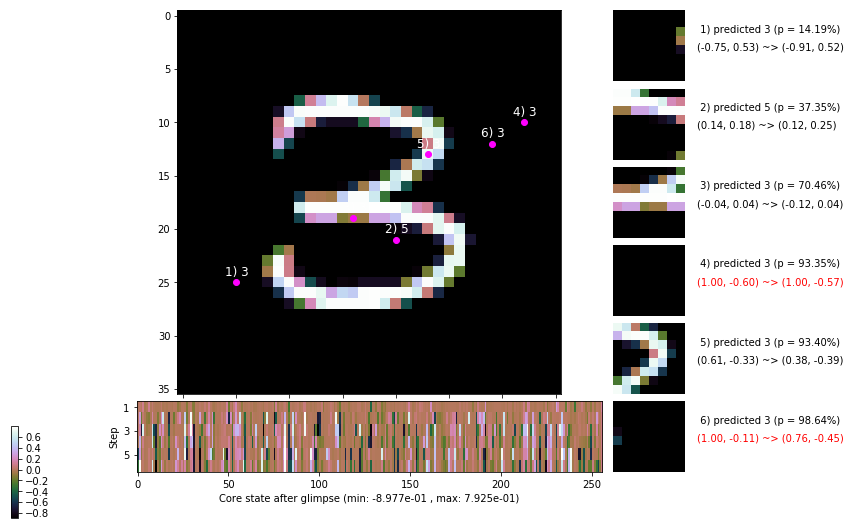

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 159.5 ms/b | lr: 2.39e-04 | grad 2norm: 12.49 | grad inf norm:  3.903
         Weights || abs max:  2.87 ( 2505.22) | mean: -5.62e-04 ( 0.01) | var: 8.68e-02 (  192.38)
          Biases || abs max:  1.51 (  249.95) | mean: -1.42e-01 ( 0.18) | var: 1.01e-01 (  373.67)
                    class loss: 0.343 | steps: 2.222 | reward:  3.743 | acc.: 88.45%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 149.5 ms/b | lr: 2.39e-04 | grad 2norm: 12.21 | grad inf norm:  3.626
         Weights || abs max:  2.87 ( 3186.38) | mean: -5.60e-04 ( 0.01) | var: 8.68e-02 (  437.17)
          Biases || abs max:  1.51 (  169.60) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (  130.52)
                    class loss: 0.328 | steps: 2.217 | reward:  3.732 | acc.: 88.73%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

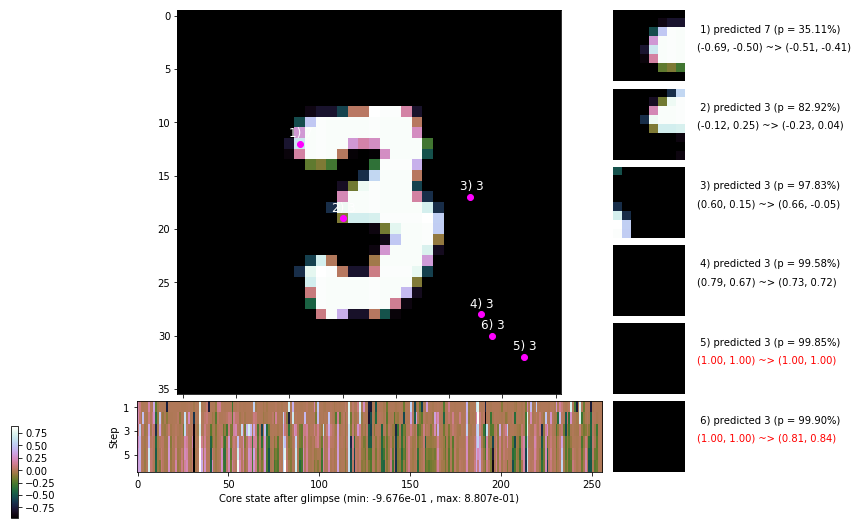

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 144.6 ms/b | lr: 2.39e-04 | grad 2norm: 12.68 | grad inf norm:  4.155
         Weights || abs max:  2.88 ( 3240.18) | mean: -5.50e-04 ( 0.01) | var: 8.69e-02 (  466.10)
          Biases || abs max:  1.51 (  897.21) | mean: -1.42e-01 ( 0.46) | var: 1.01e-01 ( 4378.86)
                    class loss: 0.346 | steps: 2.243 | reward:  3.707 | acc.: 88.55%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 145.4 ms/b | lr: 2.38e-04 | grad 2norm: 12.58 | grad inf norm:  3.813
         Weights || abs max:  2.88 ( 1907.81) | mean: -5.46e-04 ( 0.01) | var: 8.69e-02 (  383.01)
          Biases || abs max:  1.51 (  325.82) | mean: -1.42e-01 ( 0.21) | var: 1.01e-01 (  965.20)
                    class loss: 0.323 | steps: 2.209 | reward:  3.737 | acc.: 88.32%

	Target class: 5 | Discounted rewards: [-0.281, 0.438, 1.

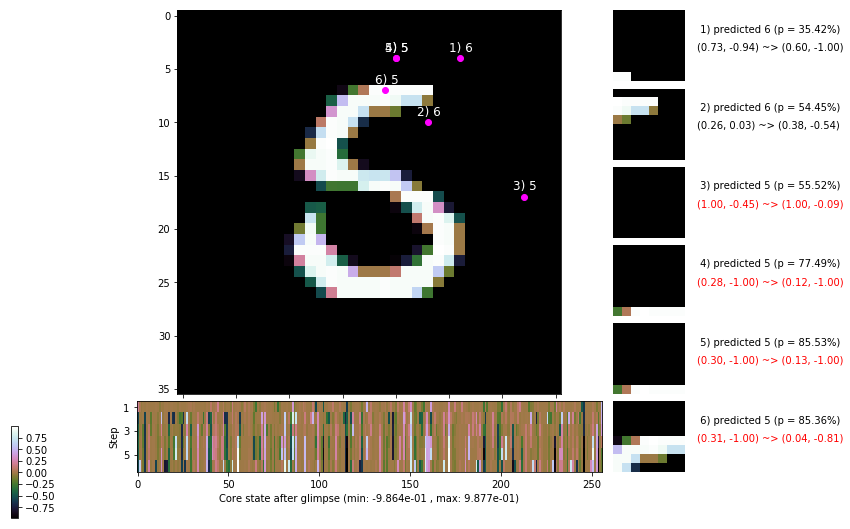

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 150.1 ms/b | lr: 2.38e-04 | grad 2norm: 12.29 | grad inf norm:  3.799
         Weights || abs max:  2.87 ( 1841.59) | mean: -5.40e-04 ( 0.01) | var: 8.69e-02 (   86.88)
          Biases || abs max:  1.50 (  163.23) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (  635.61)
                    class loss: 0.322 | steps: 2.211 | reward:  3.767 | acc.: 88.88%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.4 ms/b | lr: 2.38e-04 | grad 2norm: 12.76 | grad inf norm:  3.975
         Weights || abs max:  2.88 ( 3462.92) | mean: -5.30e-04 ( 0.01) | var: 8.69e-02 ( 1202.50)
          Biases || abs max:  1.50 (  165.07) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (   63.03)
                    class loss: 0.349 | steps: 2.229 | reward:  3.694 | acc.: 87.93%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

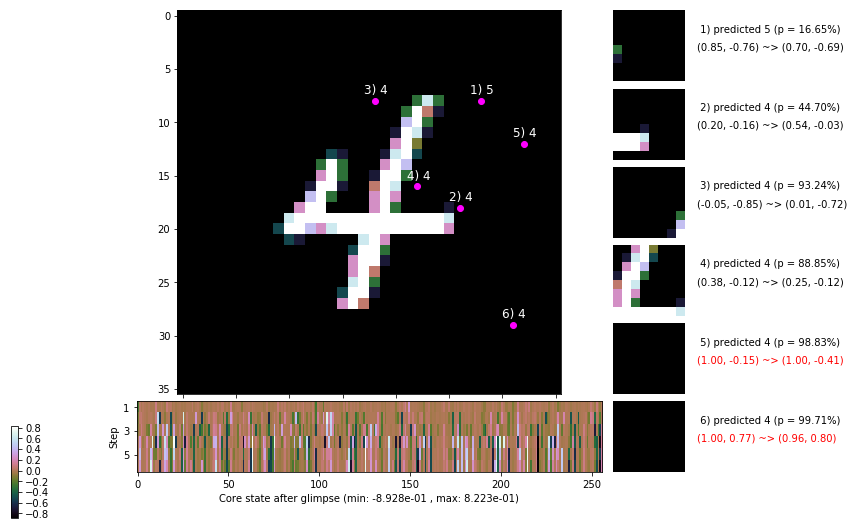

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.6 ms/b | lr: 2.37e-04 | grad 2norm: 12.34 | grad inf norm:  3.790
         Weights || abs max:  2.88 ( 1868.30) | mean: -5.25e-04 ( 0.01) | var: 8.69e-02 (   97.57)
          Biases || abs max:  1.50 ( 2700.89) | mean: -1.42e-01 ( 1.16) | var: 1.01e-01 (315441.34)
                    class loss: 0.340 | steps: 2.213 | reward:  3.742 | acc.: 88.98%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 147.3 ms/b | lr: 2.37e-04 | grad 2norm: 12.53 | grad inf norm:  3.839
         Weights || abs max:  2.88 ( 1739.16) | mean: -5.26e-04 ( 0.01) | var: 8.69e-02 (  105.38)
          Biases || abs max:  1.50 ( 2137.50) | mean: -1.42e-01 ( 0.94) | var: 1.01e-01 (173996.64)
                    class loss: 0.330 | steps: 2.200 | reward:  3.762 | acc.: 88.72%

	Target class: 7 | Discounted rewards: [1.266, 0.531, -

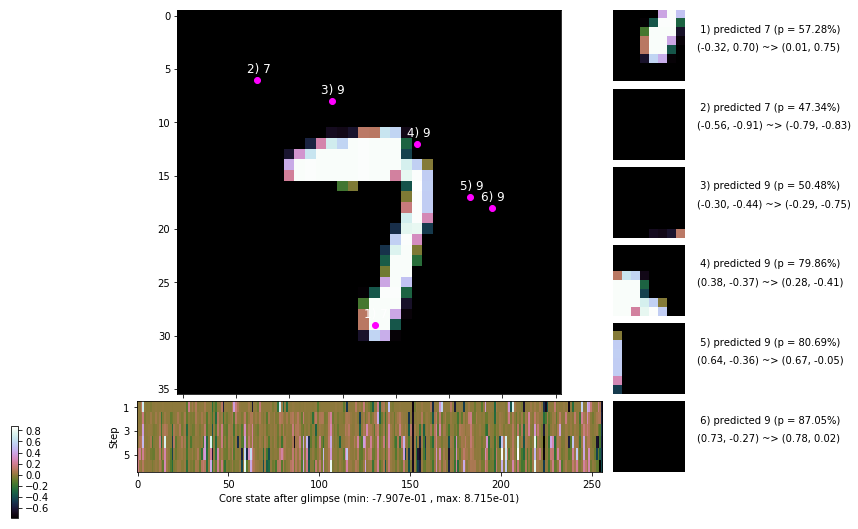

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


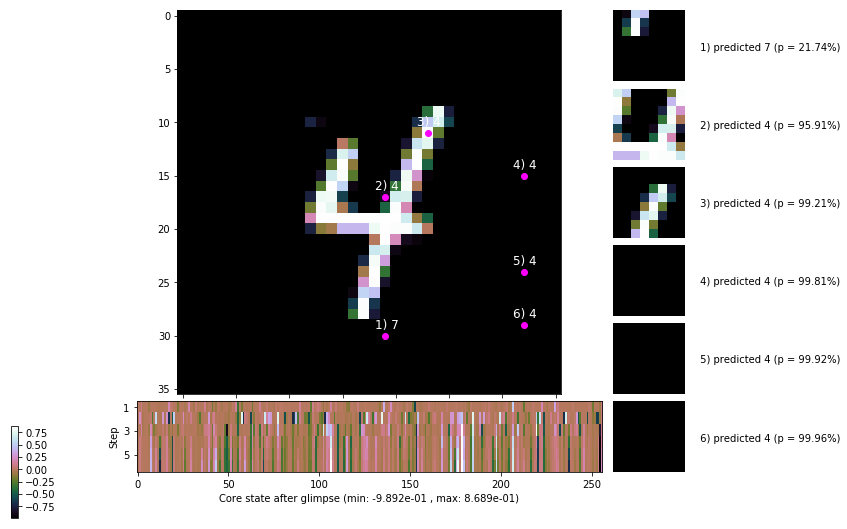


	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


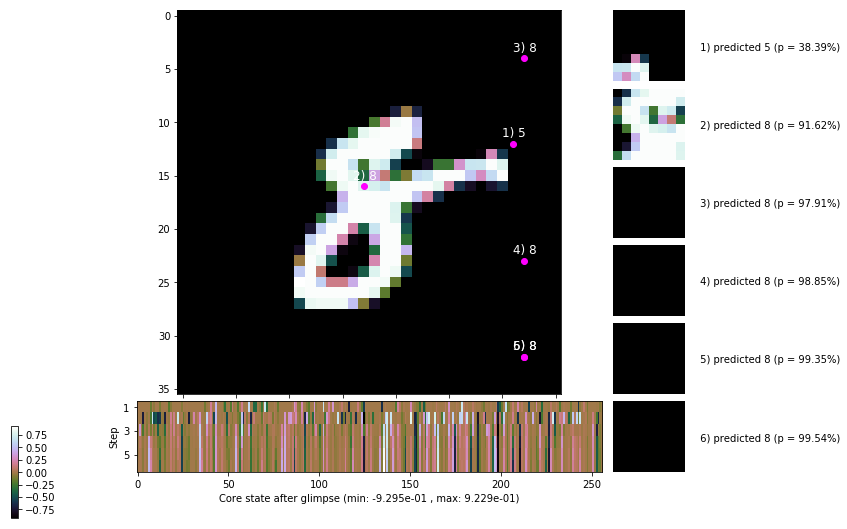

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


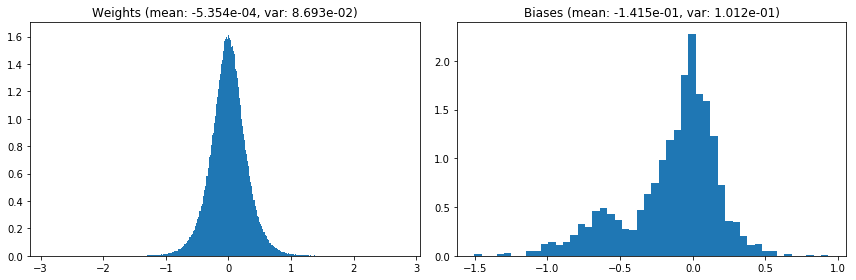

                                      Location network weights and biases


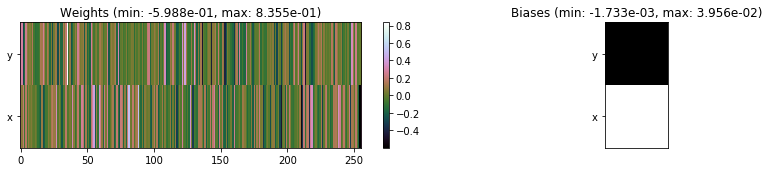

---------------------------------------------------------------------------------------------------------------
Elapsed time:  447.18 sec | TRAIN >> class loss: 0.3371 | steps:  2.217 :( | reward:  3.7334 :( | acc.: 88.482% :(
                          | VAL   >> class loss: 0.3179 | steps:  2.093 :( | reward:  3.9594 :( | acc.: 89.560% :(


Epoch  97/400) lr = 0.0002368
 b    300/  3000 >> 149.2 ms/b | lr: 2.37e-04 | grad 2norm: 12.21 | grad inf norm:  3.654
         Weights || abs max:  2.88 ( 4965.49) | mean: -5.36e-04 ( 0.02) | var: 8.69e-02 ( 1804.42)
          Biases || abs max:  1.50 (  582.81) | mean: -1.41e-01 ( 0.33) | var: 1.01e-01 ( 1878.07)
                    class loss: 0.342 | steps: 2.215 | reward:  3.753 | acc.: 88.58%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 144.1 ms/b | lr: 2.36e-04 | grad 2norm: 12.47 | grad inf norm:  3.964
         Weights || abs max:  2.88 ( 5542.81) | mean: -5.56e-04 (

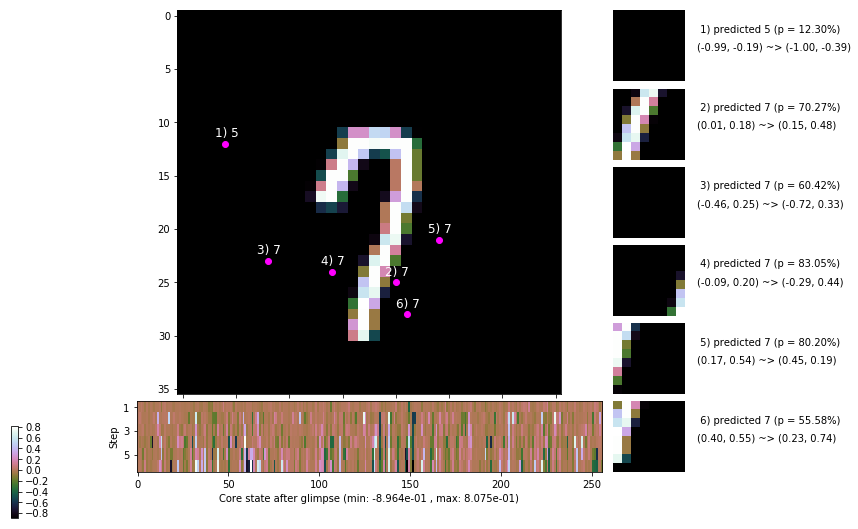

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.1 ms/b | lr: 2.36e-04 | grad 2norm: 12.00 | grad inf norm:  3.625
         Weights || abs max:  2.88 ( 4147.05) | mean: -5.64e-04 ( 0.01) | var: 8.69e-02 ( 4013.27)
          Biases || abs max:  1.50 (  128.06) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (   23.08)
                    class loss: 0.330 | steps: 2.217 | reward:  3.751 | acc.: 88.73%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 144.9 ms/b | lr: 2.36e-04 | grad 2norm: 12.33 | grad inf norm:  3.688
         Weights || abs max:  2.88 ( 2097.36) | mean: -5.74e-04 ( 0.01) | var: 8.69e-02 (  121.01)
          Biases || abs max:  1.50 (  162.75) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (  102.39)
                    class loss: 0.337 | steps: 2.195 | reward:  3.757 | acc.: 88.87%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

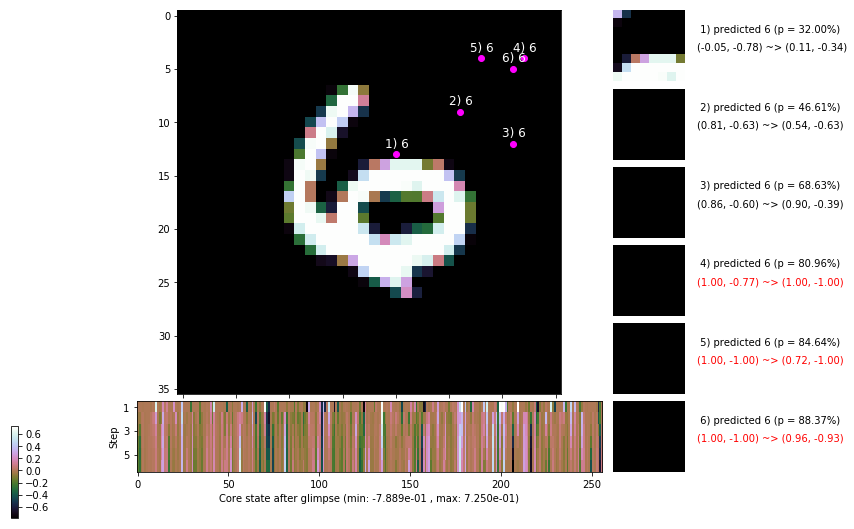

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 151.4 ms/b | lr: 2.35e-04 | grad 2norm: 12.62 | grad inf norm:  3.959
         Weights || abs max:  2.89 ( 2171.44) | mean: -5.73e-04 ( 0.01) | var: 8.70e-02 (  111.84)
          Biases || abs max:  1.50 (  333.87) | mean: -1.42e-01 ( 0.22) | var: 1.01e-01 ( 1024.03)
                    class loss: 0.353 | steps: 2.226 | reward:  3.716 | acc.: 88.18%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 166.1 ms/b | lr: 2.35e-04 | grad 2norm: 12.44 | grad inf norm:  3.866
         Weights || abs max:  2.89 ( 1987.11) | mean: -5.73e-04 ( 0.01) | var: 8.70e-02 (   79.22)
          Biases || abs max:  1.50 (  143.04) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (   69.65)
                    class loss: 0.348 | steps: 2.218 | reward:  3.720 | acc.: 87.87%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.8

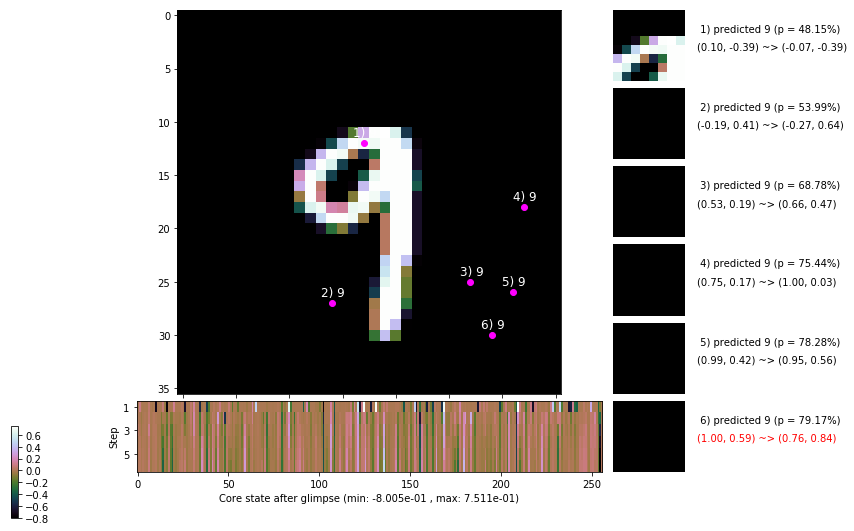

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 155.7 ms/b | lr: 2.34e-04 | grad 2norm: 12.08 | grad inf norm:  3.714
         Weights || abs max:  2.89 ( 2610.67) | mean: -5.83e-04 ( 0.01) | var: 8.70e-02 (  192.29)
          Biases || abs max:  1.50 (  217.63) | mean: -1.42e-01 ( 0.18) | var: 1.01e-01 (  366.47)
                    class loss: 0.328 | steps: 2.217 | reward:  3.760 | acc.: 89.02%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.4 ms/b | lr: 2.34e-04 | grad 2norm: 12.13 | grad inf norm:  3.802
         Weights || abs max:  2.89 ( 1562.86) | mean: -5.79e-04 ( 0.01) | var: 8.70e-02 (   34.08)
          Biases || abs max:  1.50 (  170.04) | mean: -1.41e-01 ( 0.16) | var: 1.01e-01 (  115.20)
                    class loss: 0.328 | steps: 2.197 | reward:  3.790 | acc.: 89.40%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

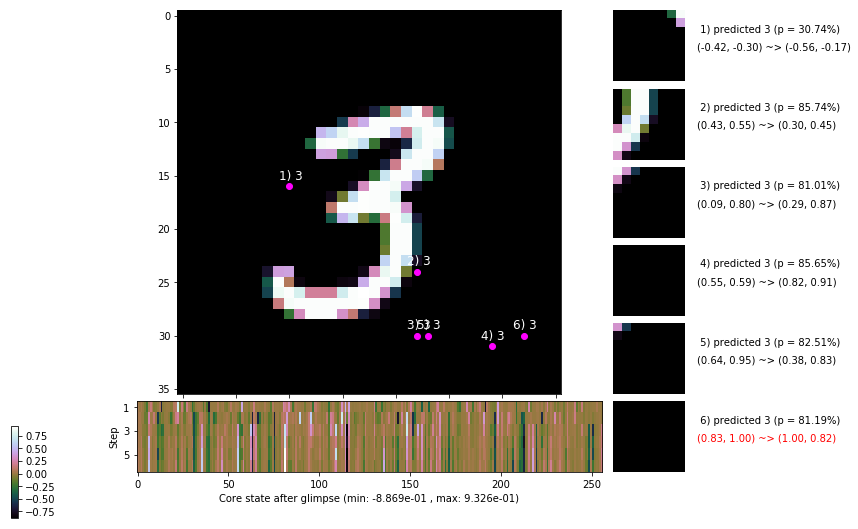

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 156.9 ms/b | lr: 2.34e-04 | grad 2norm: 12.01 | grad inf norm:  3.667
         Weights || abs max:  2.89 ( 1358.93) | mean: -5.82e-04 ( 0.01) | var: 8.70e-02 (   13.67)
          Biases || abs max:  1.50 (  151.99) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 (   57.25)
                    class loss: 0.303 | steps: 2.161 | reward:  3.860 | acc.: 89.87%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.2 ms/b | lr: 2.33e-04 | grad 2norm: 12.36 | grad inf norm:  3.826
         Weights || abs max:  2.89 ( 2953.86) | mean: -5.75e-04 ( 0.01) | var: 8.70e-02 (  334.29)
          Biases || abs max:  1.50 (29642.54) | mean: -1.42e-01 (11.61) | var: 1.01e-01 (100861080.00)
                    class loss: 0.336 | steps: 2.201 | reward:  3.771 | acc.: 88.43%

	Target class: 0 | Discounted rewards: [1.969, 1.938,

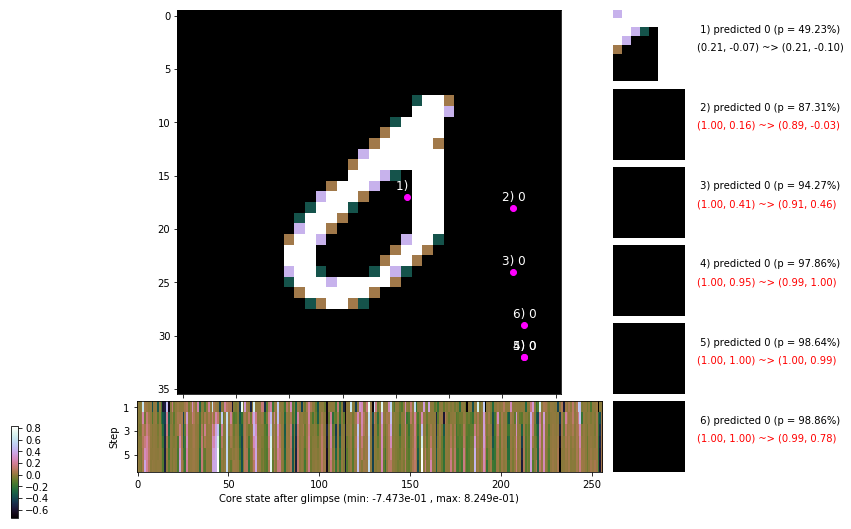

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


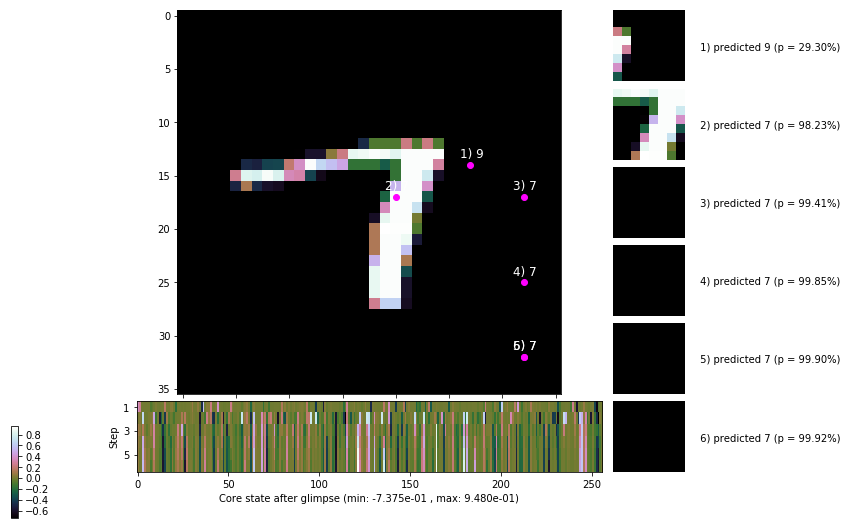


	Target class: 0 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


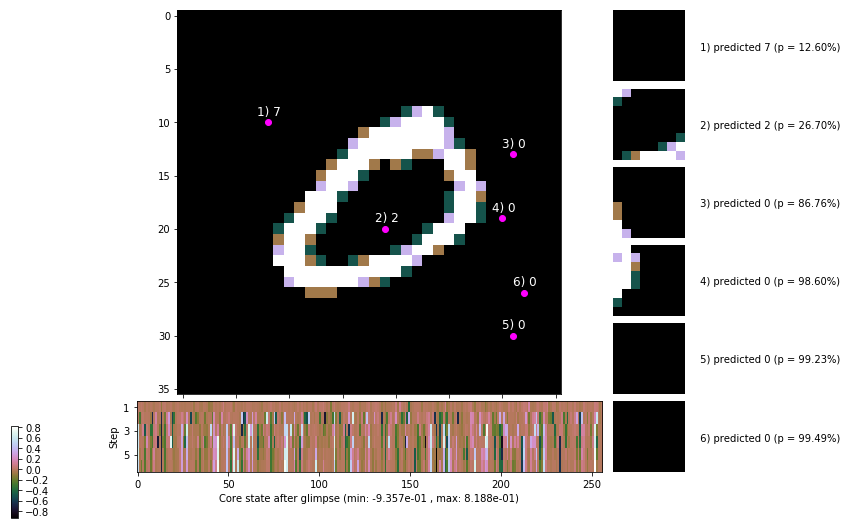

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


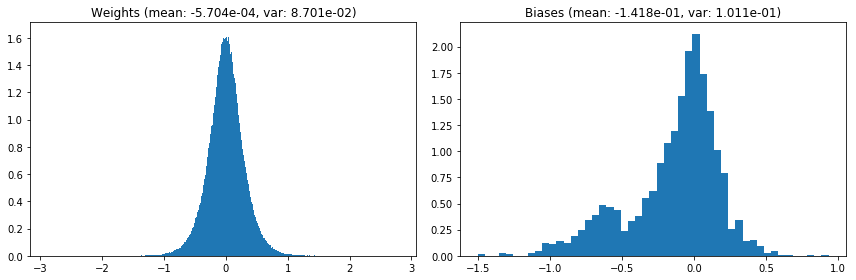

                                      Location network weights and biases


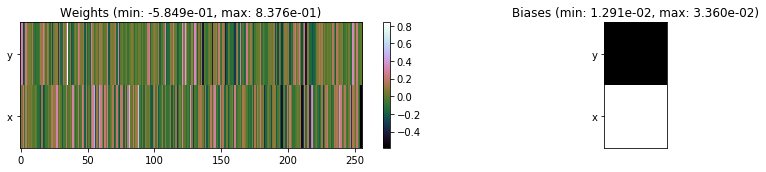

---------------------------------------------------------------------------------------------------------------
Elapsed time:  456.03 sec | TRAIN >> class loss: 0.3354 | steps:  2.210 :( | reward:  3.7569 :( | acc.: 88.685% :(
                          | VAL   >> class loss: 0.2967 | steps:  2.070 :( | reward:  4.0371    | acc.: 90.440% :(


Epoch  98/400) lr = 0.0002332
 b    300/  3000 >> 149.8 ms/b | lr: 2.33e-04 | grad 2norm: 12.31 | grad inf norm:  3.929
         Weights || abs max:  2.88 ( 3024.12) | mean: -5.69e-04 ( 0.01) | var: 8.70e-02 (  493.01)
          Biases || abs max:  1.50 (  235.47) | mean: -1.42e-01 ( 0.19) | var: 1.01e-01 (  344.39)
                    class loss: 0.325 | steps: 2.191 | reward:  3.790 | acc.: 89.03%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.4 ms/b | lr: 2.33e-04 | grad 2norm: 12.37 | grad inf norm:  3.859
         Weights || abs max:  2.88 ( 1571.96) | mean: -5.67e-04 (

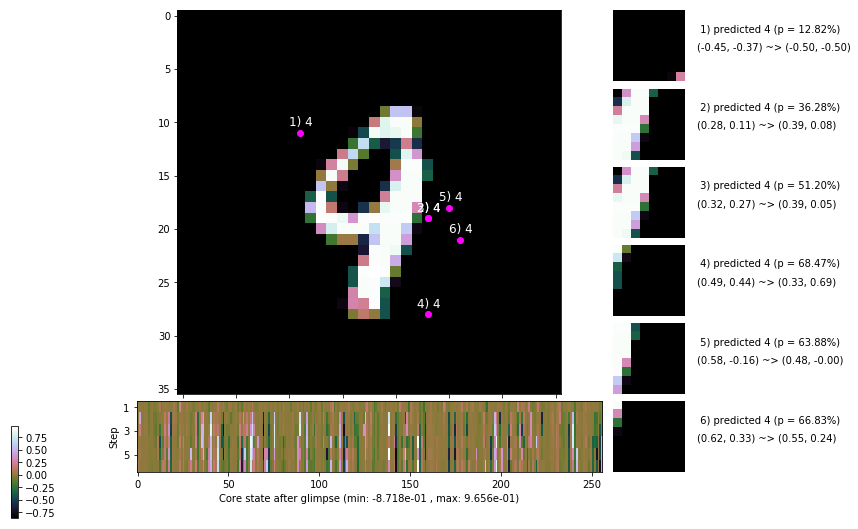

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.2 ms/b | lr: 2.32e-04 | grad 2norm: 12.25 | grad inf norm:  3.885
         Weights || abs max:  2.88 ( 1901.76) | mean: -5.62e-04 ( 0.01) | var: 8.70e-02 (  160.45)
          Biases || abs max:  1.50 (  267.96) | mean: -1.42e-01 ( 0.22) | var: 1.01e-01 (  863.01)
                    class loss: 0.343 | steps: 2.192 | reward:  3.776 | acc.: 88.90%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 169.0 ms/b | lr: 2.32e-04 | grad 2norm: 12.56 | grad inf norm:  3.841
         Weights || abs max:  2.89 ( 2137.61) | mean: -5.62e-04 ( 0.01) | var: 8.70e-02 (  102.70)
          Biases || abs max:  1.50 (  248.39) | mean: -1.42e-01 ( 0.18) | var: 1.01e-01 ( 3196.25)
                    class loss: 0.349 | steps: 2.224 | reward:  3.722 | acc.: 88.23%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

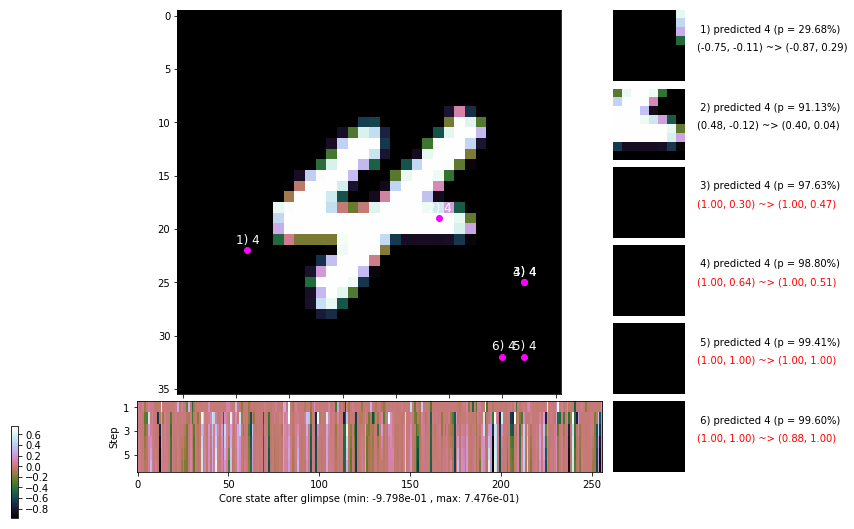

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 155.9 ms/b | lr: 2.32e-04 | grad 2norm: 12.24 | grad inf norm:  3.771
         Weights || abs max:  2.89 ( 1858.31) | mean: -5.58e-04 ( 0.01) | var: 8.70e-02 (   45.62)
          Biases || abs max:  1.50 (  106.47) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   29.09)
                    class loss: 0.325 | steps: 2.225 | reward:  3.740 | acc.: 89.02%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 147.8 ms/b | lr: 2.31e-04 | grad 2norm: 12.29 | grad inf norm:  3.865
         Weights || abs max:  2.88 ( 2509.05) | mean: -5.51e-04 ( 0.01) | var: 8.71e-02 (  223.79)
          Biases || abs max:  1.50 (  129.72) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (  143.32)
                    class loss: 0.328 | steps: 2.207 | reward:  3.771 | acc.: 89.13%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

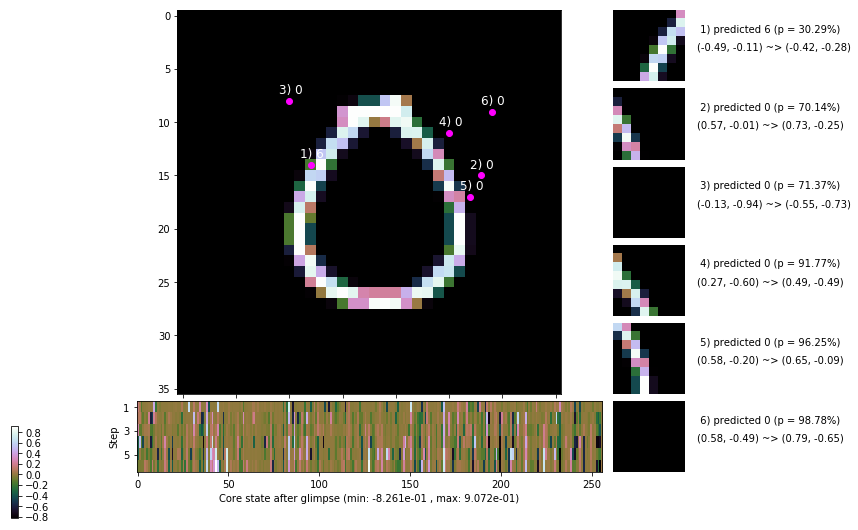

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 154.3 ms/b | lr: 2.31e-04 | grad 2norm: 12.25 | grad inf norm:  3.759
         Weights || abs max:  2.88 ( 2795.03) | mean: -5.59e-04 ( 0.01) | var: 8.71e-02 (  196.53)
          Biases || abs max:  1.50 (  211.82) | mean: -1.42e-01 ( 0.17) | var: 1.01e-01 (  809.58)
                    class loss: 0.318 | steps: 2.182 | reward:  3.826 | acc.: 89.40%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 157.4 ms/b | lr: 2.31e-04 | grad 2norm: 12.54 | grad inf norm:  3.994
         Weights || abs max:  2.88 ( 1778.71) | mean: -5.57e-04 ( 0.01) | var: 8.71e-02 (   25.39)
          Biases || abs max:  1.50 (  226.42) | mean: -1.42e-01 ( 0.18) | var: 1.01e-01 (  565.37)
                    class loss: 0.329 | steps: 2.220 | reward:  3.744 | acc.: 88.72%

	Target class: 3 | Discounted rewards: [-0.281, 0.438, 1.

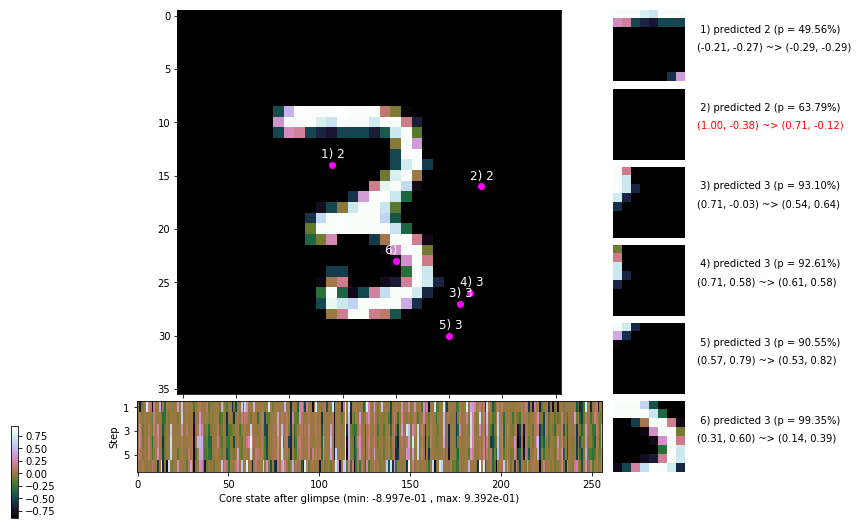

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 143.2 ms/b | lr: 2.30e-04 | grad 2norm: 12.56 | grad inf norm:  3.962
         Weights || abs max:  2.88 ( 2814.47) | mean: -5.74e-04 ( 0.01) | var: 8.71e-02 (  253.91)
          Biases || abs max:  1.50 (   73.52) | mean: -1.42e-01 ( 0.10) | var: 1.01e-01 (   17.74)
                    class loss: 0.341 | steps: 2.220 | reward:  3.712 | acc.: 88.43%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 149.4 ms/b | lr: 2.30e-04 | grad 2norm: 12.41 | grad inf norm:  3.858
         Weights || abs max:  2.89 ( 2247.37) | mean: -5.92e-04 ( 0.01) | var: 8.71e-02 (  226.40)
          Biases || abs max:  1.50 (  116.64) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   29.67)
                    class loss: 0.334 | steps: 2.201 | reward:  3.737 | acc.: 88.47%

	Target class: 8 | Discounted rewards: [-0.281, 0.438, 1.

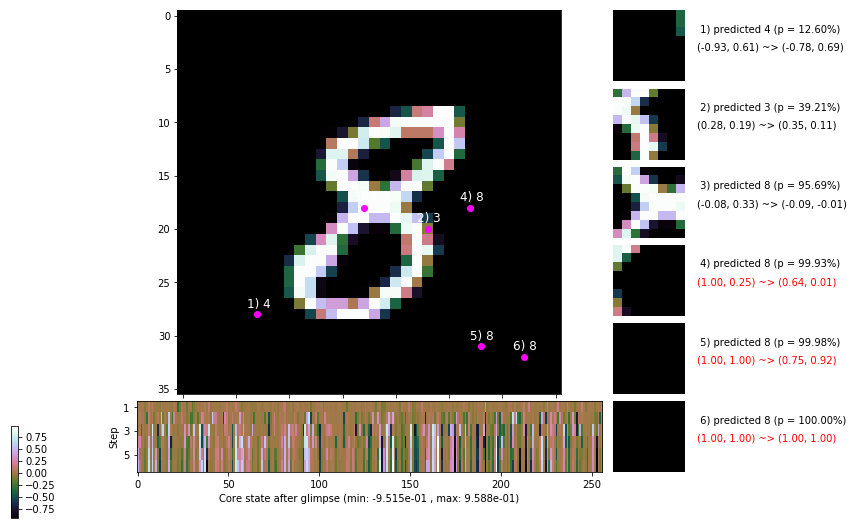

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


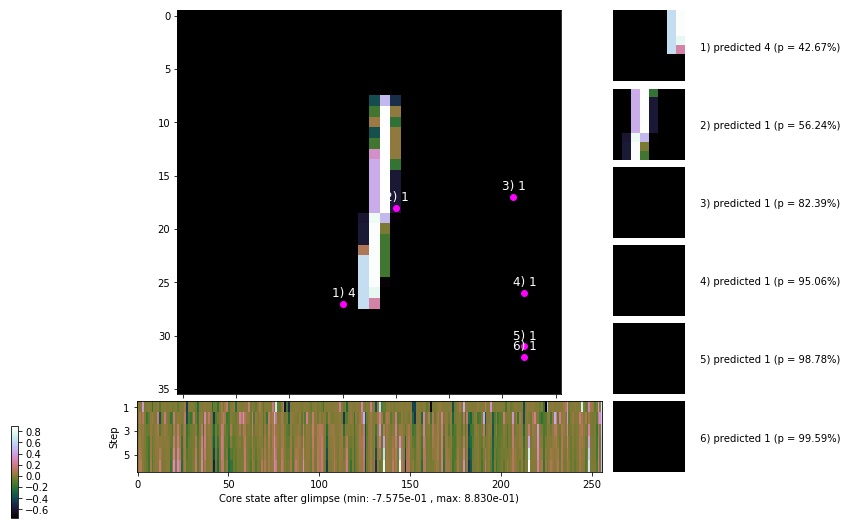


	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


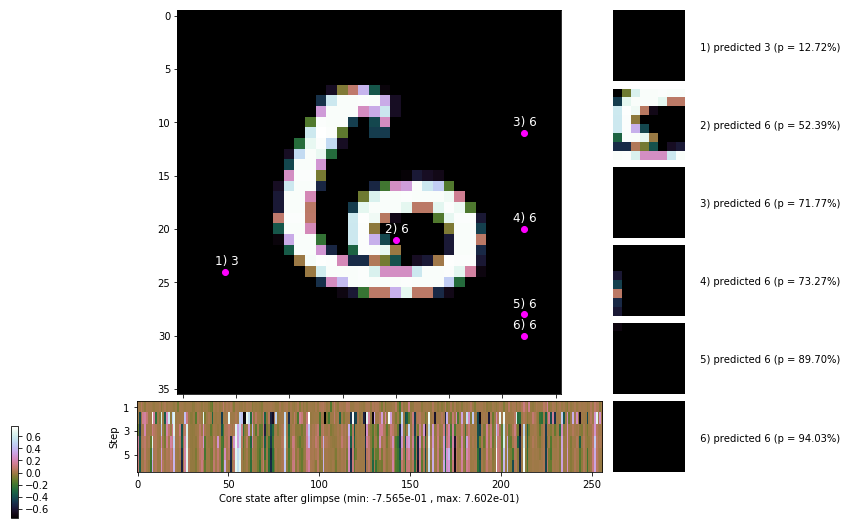

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


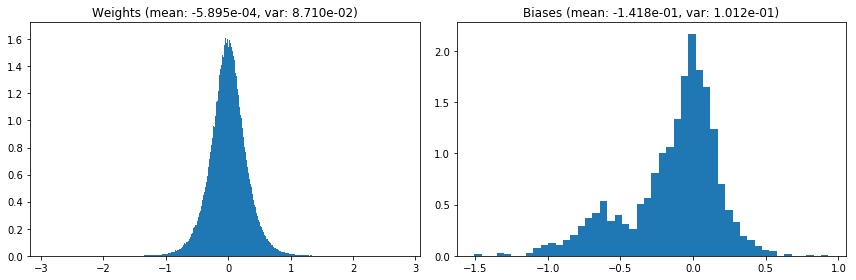

                                      Location network weights and biases


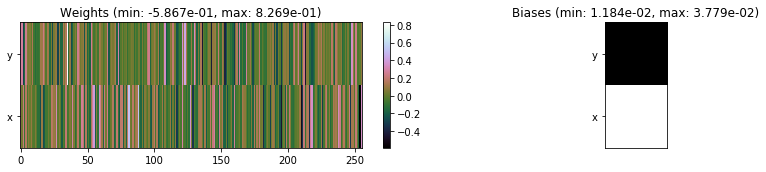

---------------------------------------------------------------------------------------------------------------
Elapsed time:  460.74 sec | TRAIN >> class loss: 0.3312 | steps:  2.205 :( | reward:  3.7624 :( | acc.: 88.845% :(
                          | VAL   >> class loss: 0.3234 | steps:  2.130 :( | reward:  3.9039 :( | acc.: 89.140% :(


Epoch  99/400) lr = 0.0002298
 b    300/  3000 >> 164.3 ms/b | lr: 2.30e-04 | grad 2norm: 12.24 | grad inf norm:  3.668
         Weights || abs max:  2.89 (10047.88) | mean: -5.87e-04 ( 0.03) | var: 8.71e-02 (38271.33)
          Biases || abs max:  1.51 (  104.21) | mean: -1.42e-01 ( 0.11) | var: 1.01e-01 (   25.40)
                    class loss: 0.326 | steps: 2.179 | reward:  3.778 | acc.: 89.00%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 161.1 ms/b | lr: 2.29e-04 | grad 2norm: 12.17 | grad inf norm:  3.818
         Weights || abs max:  2.89 ( 2878.80) | mean: -5.99e-04 (

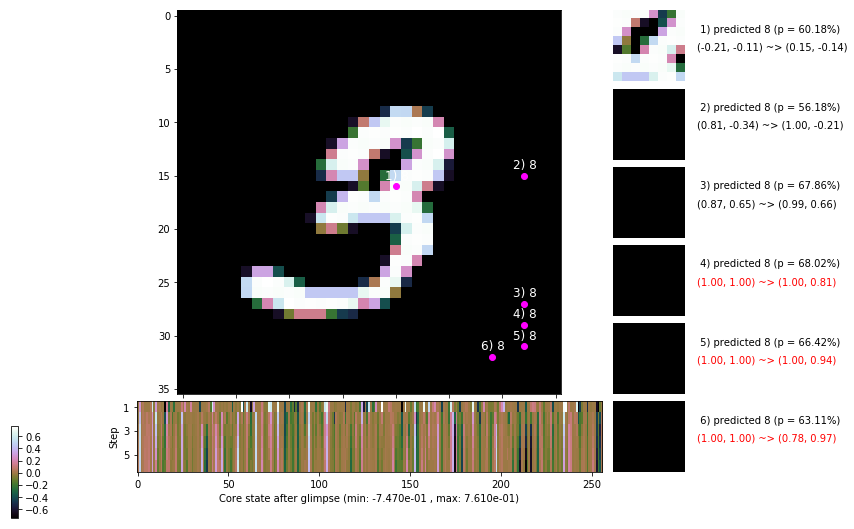

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 152.8 ms/b | lr: 2.29e-04 | grad 2norm: 12.28 | grad inf norm:  3.771
         Weights || abs max:  2.89 ( 6418.58) | mean: -5.94e-04 ( 0.02) | var: 8.71e-02 ( 4858.28)
          Biases || abs max:  1.51 (  135.59) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (   47.74)
                    class loss: 0.336 | steps: 2.205 | reward:  3.757 | acc.: 88.68%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 153.8 ms/b | lr: 2.29e-04 | grad 2norm: 12.14 | grad inf norm:  3.800
         Weights || abs max:  2.89 ( 5786.48) | mean: -5.98e-04 ( 0.02) | var: 8.71e-02 ( 3452.16)
          Biases || abs max:  1.51 ( 1129.43) | mean: -1.42e-01 ( 0.52) | var: 1.01e-01 (118709.76)
                    class loss: 0.342 | steps: 2.234 | reward:  3.700 | acc.: 88.73%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.

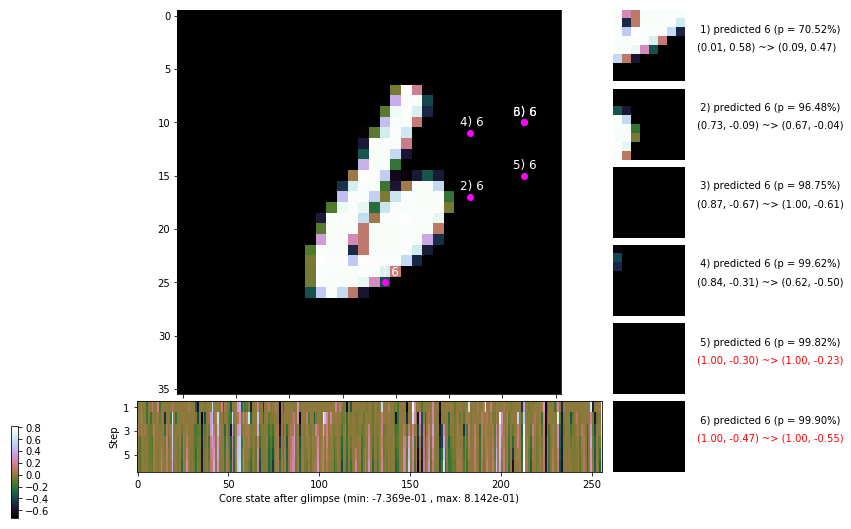

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 161.2 ms/b | lr: 2.28e-04 | grad 2norm: 11.91 | grad inf norm:  3.633
         Weights || abs max:  2.89 ( 2666.66) | mean: -5.95e-04 ( 0.01) | var: 8.71e-02 (  119.93)
          Biases || abs max:  1.52 (  325.79) | mean: -1.42e-01 ( 0.21) | var: 1.01e-01 ( 1826.01)
                    class loss: 0.336 | steps: 2.212 | reward:  3.754 | acc.: 89.20%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.8 ms/b | lr: 2.28e-04 | grad 2norm: 12.17 | grad inf norm:  3.694
         Weights || abs max:  2.89 (679592.31) | mean: -5.95e-04 ( 1.26) | var: 8.72e-02 (253814960.00)
          Biases || abs max:  1.52 (  513.07) | mean: -1.42e-01 ( 0.29) | var: 1.01e-01 (15768.53)
                    class loss: 0.316 | steps: 2.169 | reward:  3.824 | acc.: 89.03%

	Target class: 5 | Discounted rewards: [0.469, 1.938

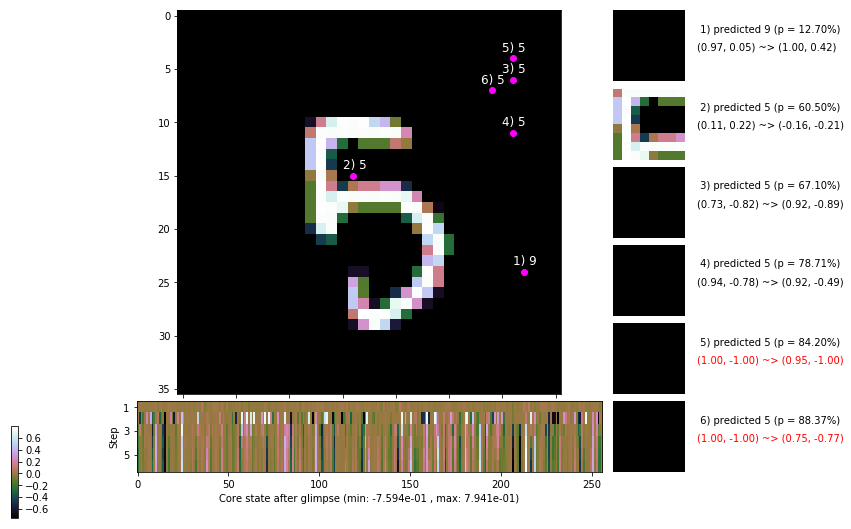

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 158.7 ms/b | lr: 2.27e-04 | grad 2norm: 12.40 | grad inf norm:  3.827
         Weights || abs max:  2.89 ( 6517.88) | mean: -5.87e-04 ( 0.02) | var: 8.72e-02 ( 4651.25)
          Biases || abs max:  1.52 (  125.22) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   67.19)
                    class loss: 0.333 | steps: 2.204 | reward:  3.754 | acc.: 88.53%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 153.9 ms/b | lr: 2.27e-04 | grad 2norm: 12.64 | grad inf norm:  4.035
         Weights || abs max:  2.89 ( 3083.06) | mean: -5.92e-04 ( 0.01) | var: 8.72e-02 (  549.07)
          Biases || abs max:  1.52 (  670.59) | mean: -1.42e-01 ( 0.34) | var: 1.01e-01 (20734.24)
                    class loss: 0.360 | steps: 2.226 | reward:  3.711 | acc.: 87.82%

	Target class: 5 | Discounted rewards: [-0.938, -0.875, -

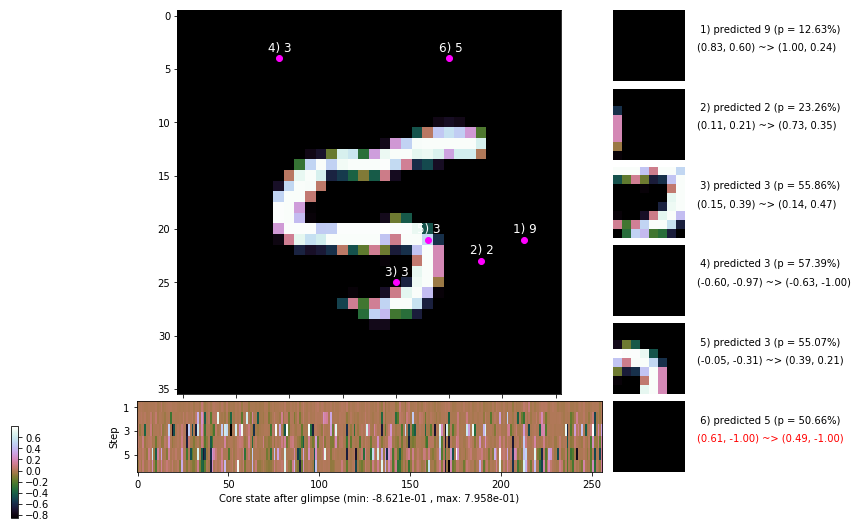

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 158.5 ms/b | lr: 2.27e-04 | grad 2norm: 12.33 | grad inf norm:  3.806
         Weights || abs max:  2.90 ( 4068.42) | mean: -5.92e-04 ( 0.01) | var: 8.72e-02 ( 1384.33)
          Biases || abs max:  1.52 (   75.37) | mean: -1.42e-01 ( 0.10) | var: 1.01e-01 (   25.60)
                    class loss: 0.338 | steps: 2.184 | reward:  3.795 | acc.: 88.75%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 161.7 ms/b | lr: 2.27e-04 | grad 2norm: 12.58 | grad inf norm:  3.864
         Weights || abs max:  2.90 ( 3093.04) | mean: -5.92e-04 ( 0.01) | var: 8.72e-02 ( 1741.89)
          Biases || abs max:  1.52 (   79.84) | mean: -1.42e-01 ( 0.11) | var: 1.01e-01 (   21.65)
                    class loss: 0.353 | steps: 2.198 | reward:  3.744 | acc.: 88.13%

	Target class: 9 | Discounted rewards: [-0.984, -0.969, -

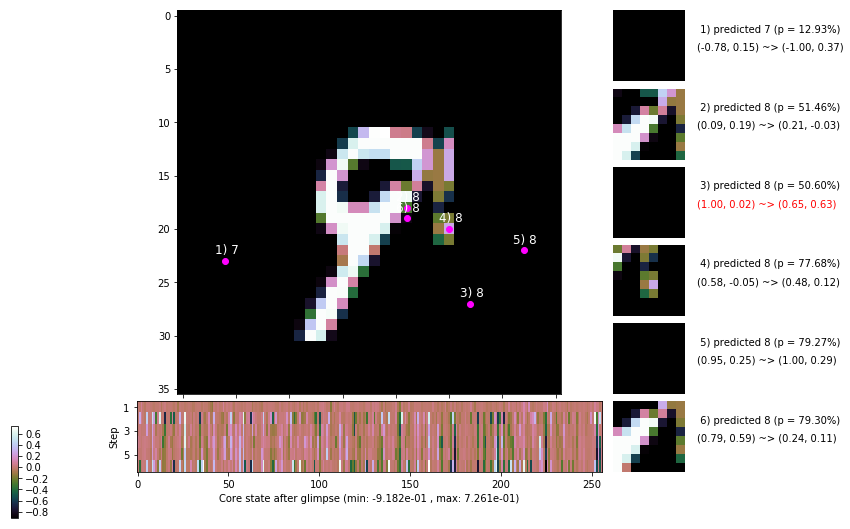

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


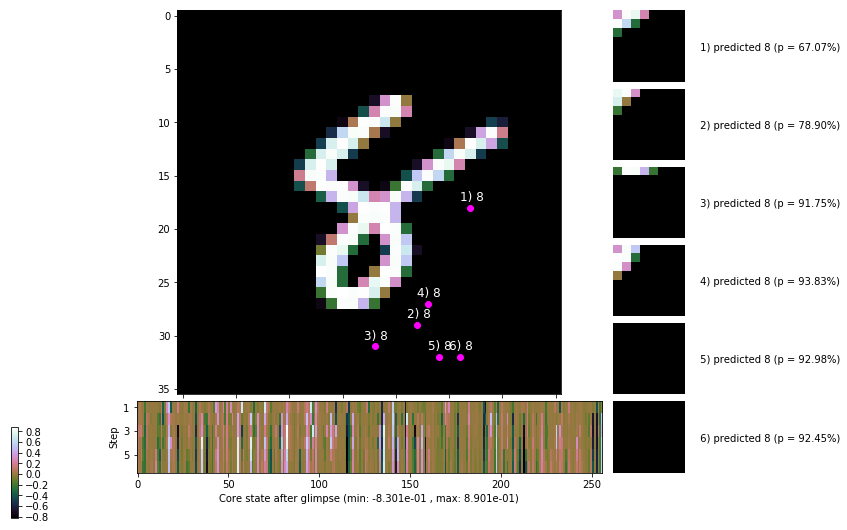


	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


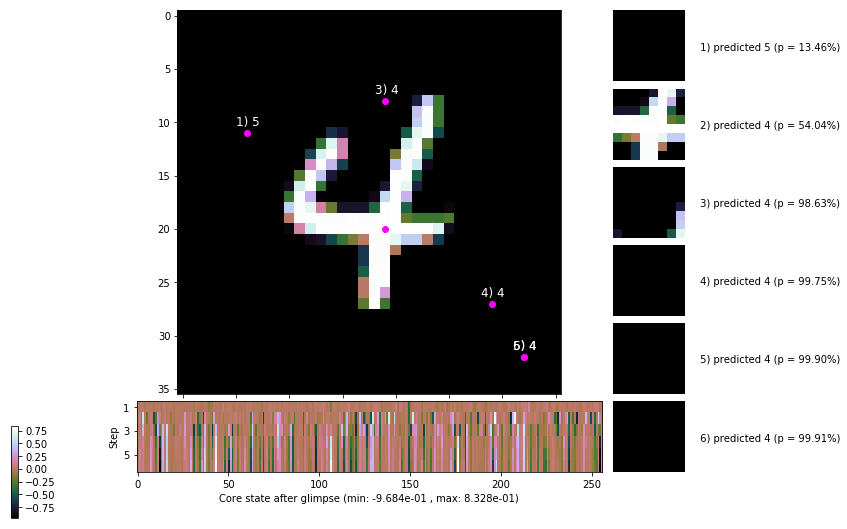

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


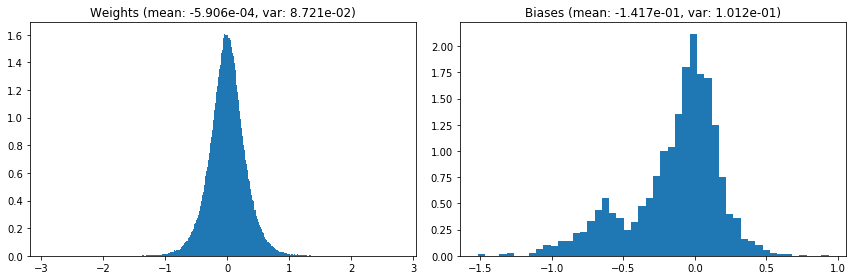

                                      Location network weights and biases


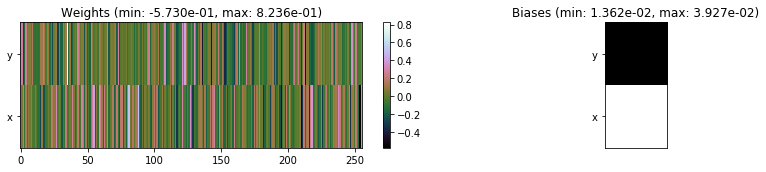

---------------------------------------------------------------------------------------------------------------
Elapsed time:  474.83 sec | TRAIN >> class loss: 0.3367 | steps:  2.199 :( | reward:  3.7616 :( | acc.: 88.693% :(
                          | VAL   >> class loss: 0.3034 | steps:  2.084 :( | reward:  3.9837 :( | acc.: 89.800% :(


Epoch 100/400) lr = 0.0002263
 b    300/  3000 >> 167.3 ms/b | lr: 2.26e-04 | grad 2norm: 12.05 | grad inf norm:  3.719
         Weights || abs max:  2.90 ( 2518.68) | mean: -5.87e-04 ( 0.01) | var: 8.72e-02 (  497.79)
          Biases || abs max:  1.52 (  163.28) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (   76.23)
                    class loss: 0.330 | steps: 2.197 | reward:  3.783 | acc.: 89.32%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 164.2 ms/b | lr: 2.26e-04 | grad 2norm: 12.12 | grad inf norm:  3.532
         Weights || abs max:  2.90 ( 5597.50) | mean: -5.71e-04 (

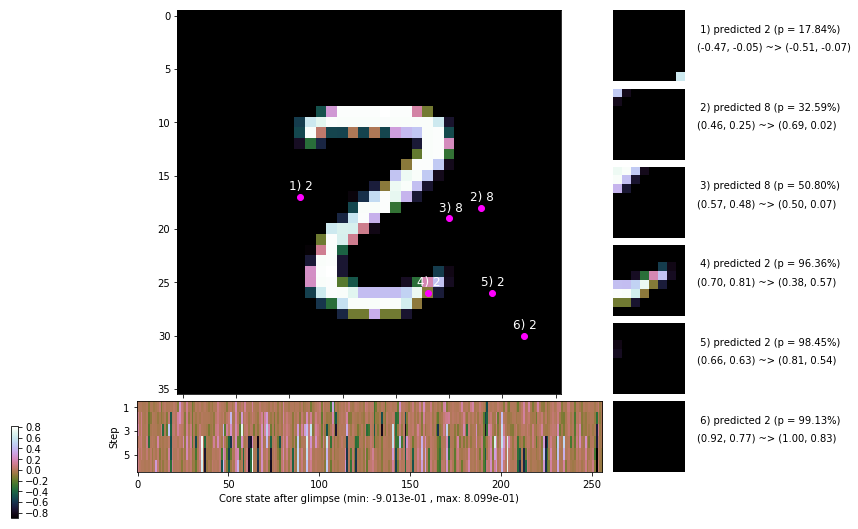

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 167.0 ms/b | lr: 2.25e-04 | grad 2norm: 12.69 | grad inf norm:  3.978
         Weights || abs max:  2.90 ( 4344.92) | mean: -5.74e-04 ( 0.01) | var: 8.72e-02 (  572.57)
          Biases || abs max:  1.52 (  729.52) | mean: -1.42e-01 ( 0.41) | var: 1.01e-01 (10809.35)
                    class loss: 0.369 | steps: 2.247 | reward:  3.705 | acc.: 87.60%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 158.9 ms/b | lr: 2.25e-04 | grad 2norm: 12.33 | grad inf norm:  3.916
         Weights || abs max:  2.90 ( 2544.54) | mean: -5.83e-04 ( 0.01) | var: 8.72e-02 (  130.21)
          Biases || abs max:  1.52 (  216.92) | mean: -1.42e-01 ( 0.20) | var: 1.01e-01 (  237.18)
                    class loss: 0.331 | steps: 2.216 | reward:  3.731 | acc.: 88.38%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

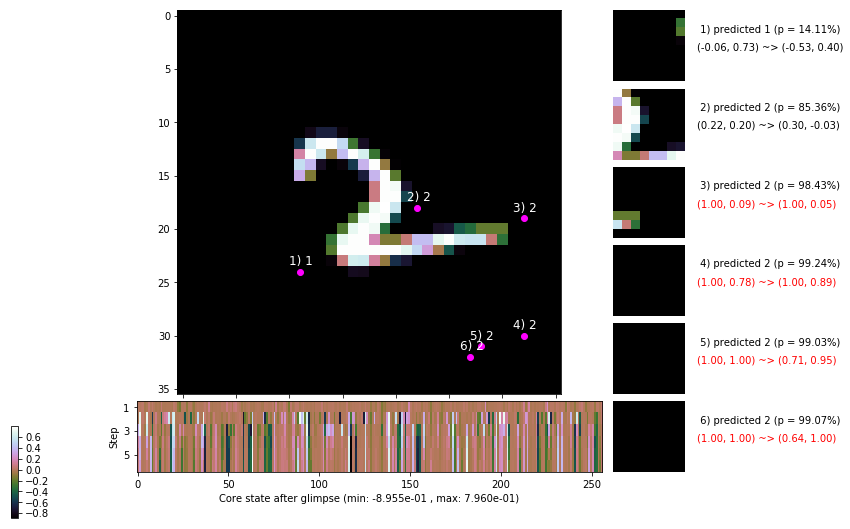

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 154.9 ms/b | lr: 2.25e-04 | grad 2norm: 12.39 | grad inf norm:  3.740
         Weights || abs max:  2.90 ( 3586.55) | mean: -5.76e-04 ( 0.01) | var: 8.73e-02 (  288.34)
          Biases || abs max:  1.51 (  182.13) | mean: -1.42e-01 ( 0.17) | var: 1.01e-01 (   65.98)
                    class loss: 0.348 | steps: 2.197 | reward:  3.773 | acc.: 88.62%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 142.0 ms/b | lr: 2.25e-04 | grad 2norm: 12.31 | grad inf norm:  3.634
         Weights || abs max:  2.90 ( 1656.04) | mean: -5.70e-04 ( 0.01) | var: 8.73e-02 (   24.32)
          Biases || abs max:  1.51 (  107.40) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   33.76)
                    class loss: 0.328 | steps: 2.202 | reward:  3.763 | acc.: 88.75%

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.8

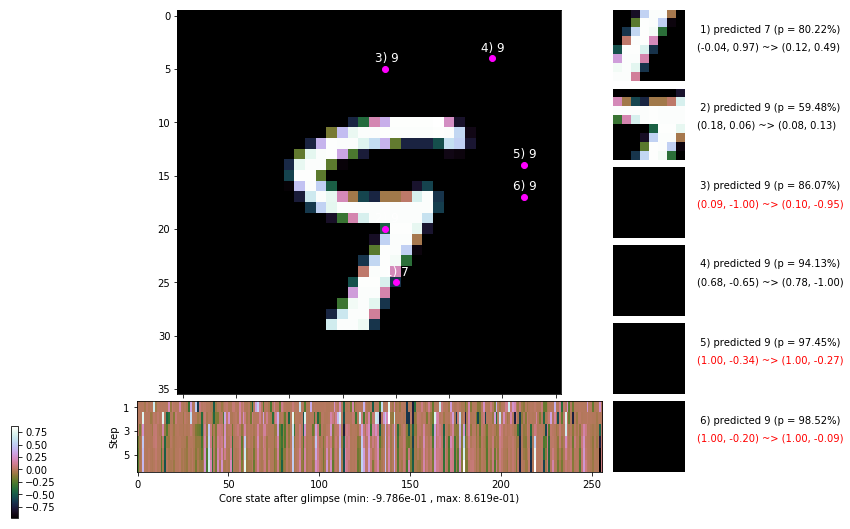

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 148.0 ms/b | lr: 2.24e-04 | grad 2norm: 12.59 | grad inf norm:  3.955
         Weights || abs max:  2.90 (10966.99) | mean: -5.64e-04 ( 0.03) | var: 8.73e-02 (27571.05)
          Biases || abs max:  1.52 (  109.44) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (   48.23)
                    class loss: 0.355 | steps: 2.213 | reward:  3.744 | acc.: 88.12%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 168.0 ms/b | lr: 2.24e-04 | grad 2norm: 12.26 | grad inf norm:  3.890
         Weights || abs max:  2.90 ( 3751.84) | mean: -5.52e-04 ( 0.02) | var: 8.73e-02 (  307.14)
          Biases || abs max:  1.51 (  105.96) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   46.91)
                    class loss: 0.335 | steps: 2.203 | reward:  3.748 | acc.: 88.30%

	Target class: 3 | Discounted rewards: [1.594, 1.188, 0.3

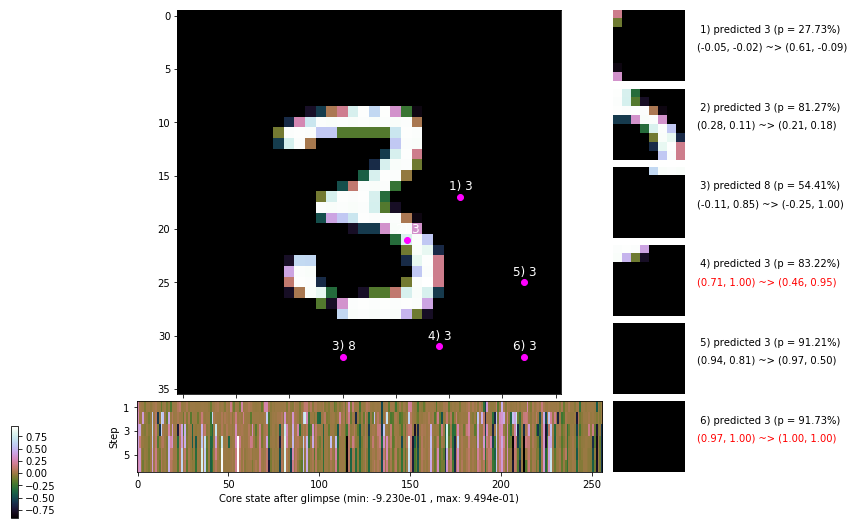

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 170.4 ms/b | lr: 2.23e-04 | grad 2norm: 12.35 | grad inf norm:  3.789
         Weights || abs max:  2.90 ( 3842.99) | mean: -5.55e-04 ( 0.01) | var: 8.73e-02 ( 1256.40)
          Biases || abs max:  1.51 (  129.06) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (  110.71)
                    class loss: 0.340 | steps: 2.231 | reward:  3.707 | acc.: 88.57%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.8 ms/b | lr: 2.23e-04 | grad 2norm: 12.47 | grad inf norm:  3.756
         Weights || abs max:  2.90 ( 3083.55) | mean: -5.57e-04 ( 0.01) | var: 8.73e-02 (  222.51)
          Biases || abs max:  1.51 (  108.63) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   37.05)
                    class loss: 0.339 | steps: 2.196 | reward:  3.750 | acc.: 88.52%

	Target class: 2 | Discounted rewards: [-0.656, -0.312, 0

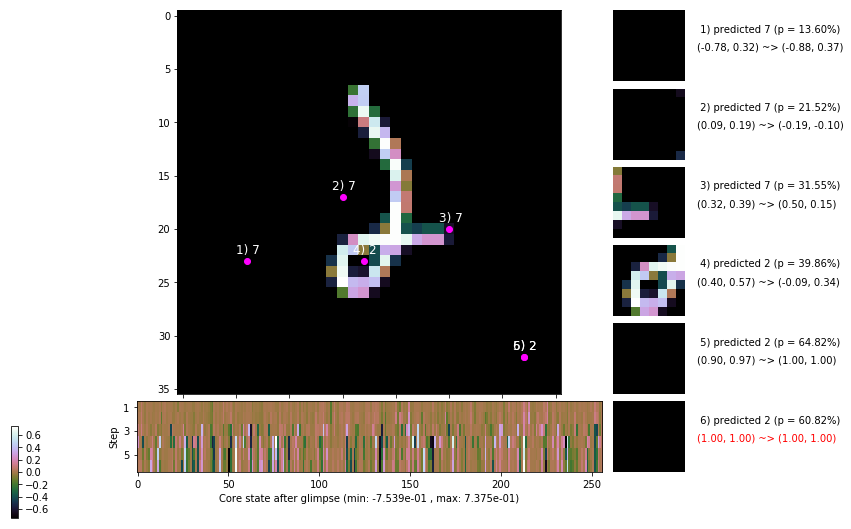

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


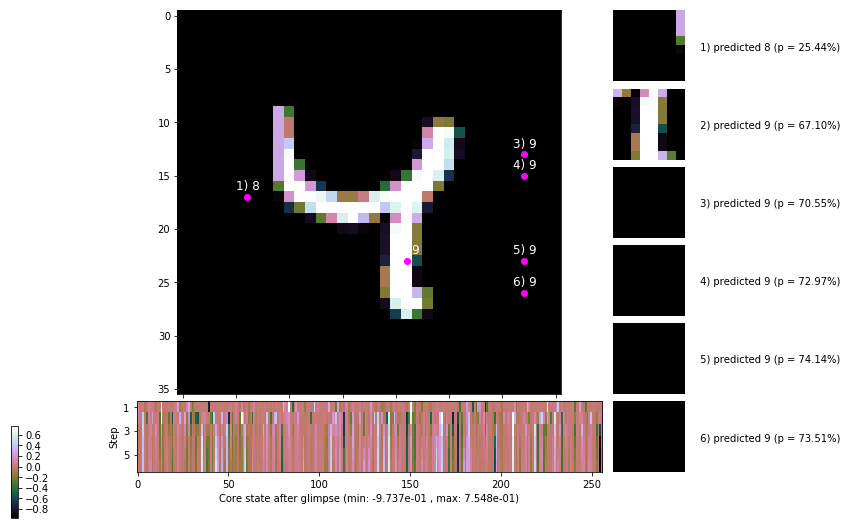


	Target class: 9 | Discounted rewards: [0.516, -0.969, -0.938, -0.875, -0.750, -0.500]


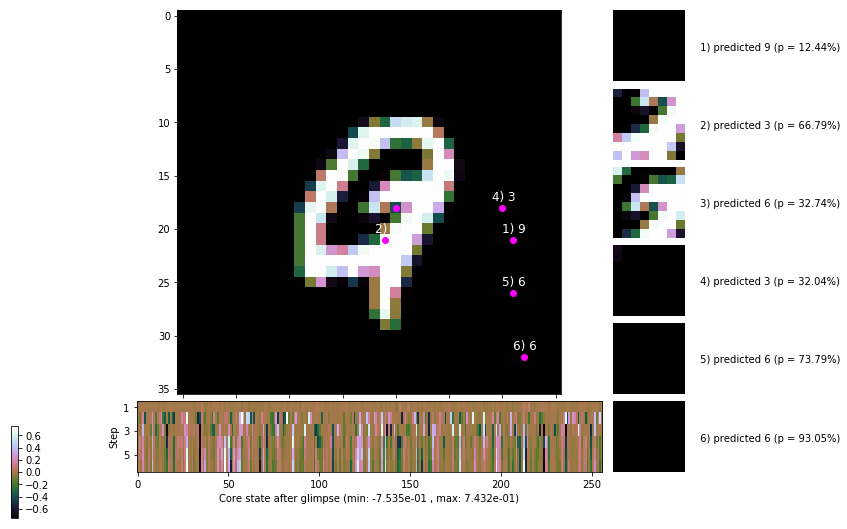

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


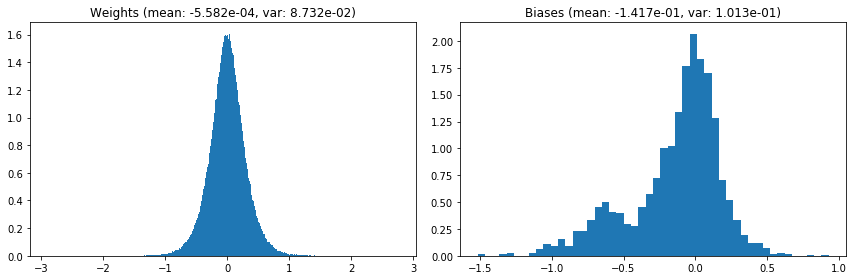

                                      Location network weights and biases


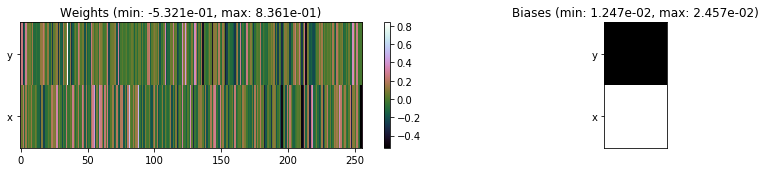

---------------------------------------------------------------------------------------------------------------
Elapsed time:  479.33 sec | TRAIN >> class loss: 0.3403 | steps:  2.208 :( | reward:  3.7520 :( | acc.: 88.537% :(
                          | VAL   >> class loss: 0.3053 | steps:  2.126 :( | reward:  3.9585 :( | acc.: 89.640% :(


Epoch 101/400) lr = 0.000223
 b    300/  3000 >> 158.4 ms/b | lr: 2.23e-04 | grad 2norm: 12.28 | grad inf norm:  3.599
         Weights || abs max:  2.90 ( 4120.72) | mean: -5.55e-04 ( 0.01) | var: 8.73e-02 (  614.06)
          Biases || abs max:  1.52 (  182.78) | mean: -1.42e-01 ( 0.16) | var: 1.01e-01 (  334.61)
                    class loss: 0.322 | steps: 2.204 | reward:  3.773 | acc.: 88.85%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 166.1 ms/b | lr: 2.23e-04 | grad 2norm: 12.26 | grad inf norm:  3.684
         Weights || abs max:  2.90 ( 3915.53) | mean: -5.63e-04 ( 

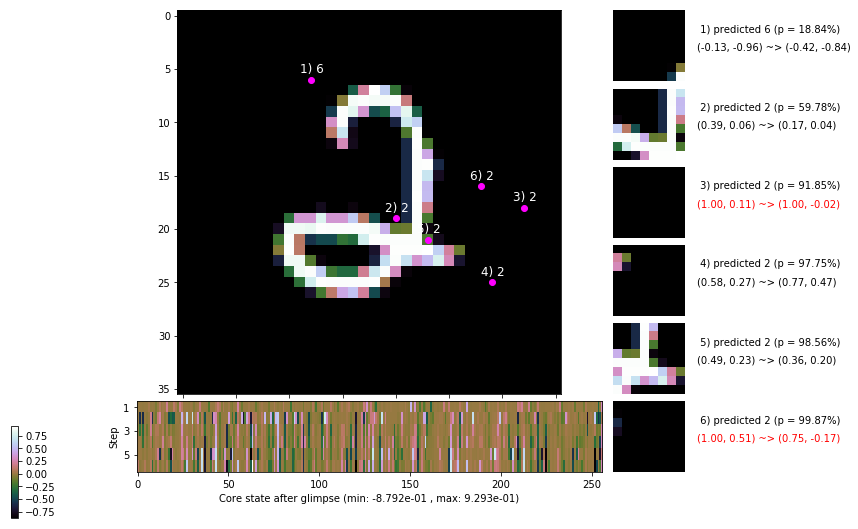

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 170.7 ms/b | lr: 2.22e-04 | grad 2norm: 12.41 | grad inf norm:  3.732
         Weights || abs max:  2.90 ( 2637.58) | mean: -5.62e-04 ( 0.01) | var: 8.73e-02 (  543.01)
          Biases || abs max:  1.51 (  187.08) | mean: -1.41e-01 ( 0.15) | var: 1.01e-01 (  279.48)
                    class loss: 0.329 | steps: 2.211 | reward:  3.739 | acc.: 88.33%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 159.0 ms/b | lr: 2.22e-04 | grad 2norm: 11.99 | grad inf norm:  3.610
         Weights || abs max:  2.90 ( 1727.01) | mean: -5.65e-04 ( 0.01) | var: 8.73e-02 (  106.78)
          Biases || abs max:  1.51 (  339.98) | mean: -1.42e-01 ( 0.25) | var: 1.01e-01 ( 3383.77)
                    class loss: 0.321 | steps: 2.217 | reward:  3.767 | acc.: 89.20%

	Target class: 1 | Discounted rewards: [-0.656, -0.312, 0

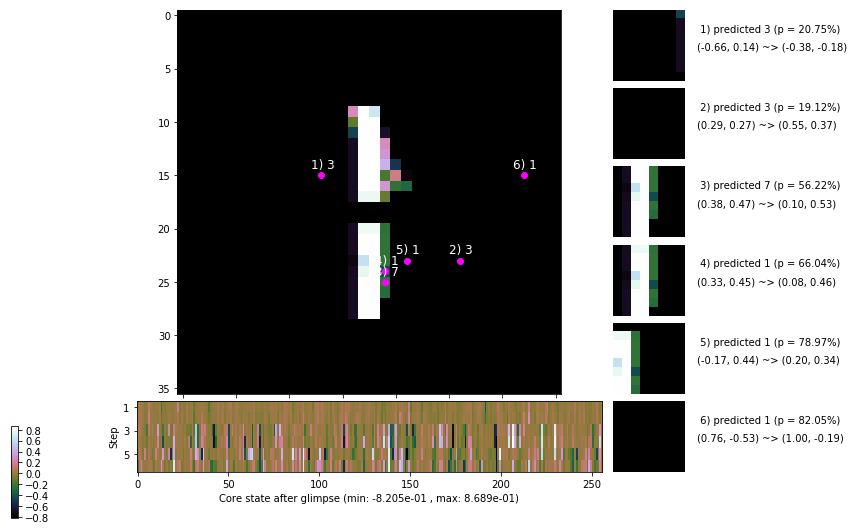

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 168.1 ms/b | lr: 2.21e-04 | grad 2norm: 12.60 | grad inf norm:  4.069
         Weights || abs max:  2.90 ( 2498.92) | mean: -5.67e-04 ( 0.01) | var: 8.74e-02 (  293.37)
          Biases || abs max:  1.51 (  134.78) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 (   90.21)
                    class loss: 0.354 | steps: 2.234 | reward:  3.687 | acc.: 88.15%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 161.1 ms/b | lr: 2.21e-04 | grad 2norm: 11.94 | grad inf norm:  3.573
         Weights || abs max:  2.90 ( 2458.64) | mean: -5.65e-04 ( 0.01) | var: 8.74e-02 (   94.89)
          Biases || abs max:  1.51 (   85.73) | mean: -1.42e-01 ( 0.10) | var: 1.01e-01 (   47.49)
                    class loss: 0.307 | steps: 2.191 | reward:  3.822 | acc.: 89.43%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

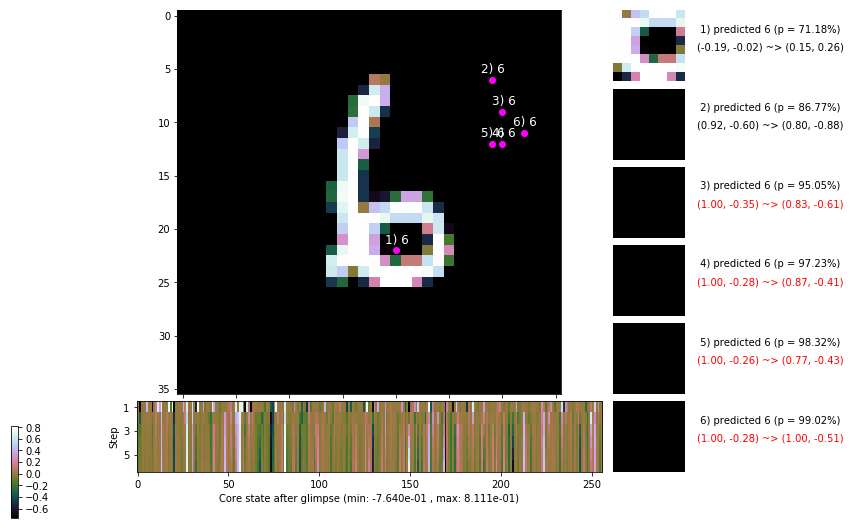

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 158.6 ms/b | lr: 2.21e-04 | grad 2norm: 12.68 | grad inf norm:  3.968
         Weights || abs max:  2.90 ( 4887.52) | mean: -5.67e-04 ( 0.02) | var: 8.74e-02 ( 2120.26)
          Biases || abs max:  1.51 (  222.54) | mean: -1.42e-01 ( 0.16) | var: 1.01e-01 (  830.66)
                    class loss: 0.340 | steps: 2.225 | reward:  3.720 | acc.: 88.23%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 166.4 ms/b | lr: 2.21e-04 | grad 2norm: 12.36 | grad inf norm:  3.768
         Weights || abs max:  2.90 (11021.89) | mean: -5.76e-04 ( 0.03) | var: 8.74e-02 (32608.28)
          Biases || abs max:  1.51 (   76.79) | mean: -1.42e-01 ( 0.10) | var: 1.01e-01 (   17.82)
                    class loss: 0.347 | steps: 2.205 | reward:  3.746 | acc.: 88.52%

	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.8

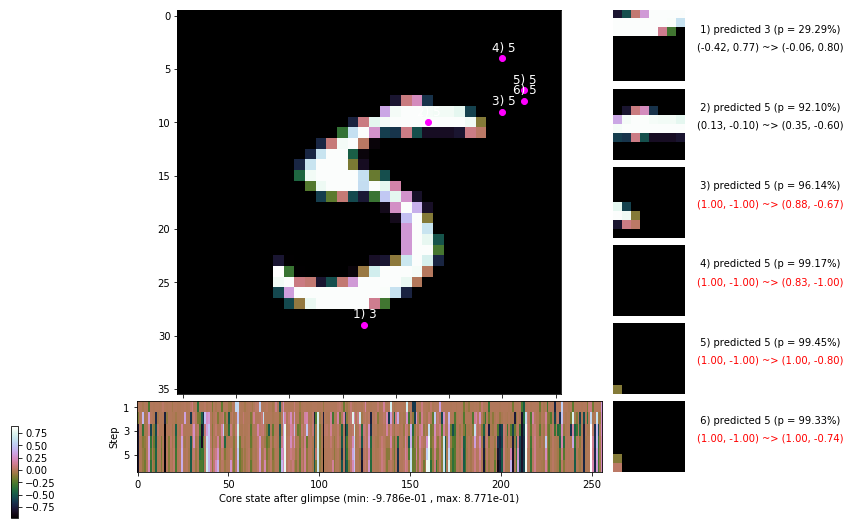

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 165.5 ms/b | lr: 2.20e-04 | grad 2norm: 12.21 | grad inf norm:  3.783
         Weights || abs max:  2.90 ( 2461.21) | mean: -5.79e-04 ( 0.01) | var: 8.74e-02 (   83.76)
          Biases || abs max:  1.51 (  182.82) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (  114.22)
                    class loss: 0.328 | steps: 2.206 | reward:  3.765 | acc.: 88.98%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 153.6 ms/b | lr: 2.20e-04 | grad 2norm: 12.09 | grad inf norm:  3.604
         Weights || abs max:  2.90 ( 2854.01) | mean: -5.77e-04 ( 0.01) | var: 8.74e-02 (  210.19)
          Biases || abs max:  1.52 (   89.79) | mean: -1.42e-01 ( 0.11) | var: 1.01e-01 (   23.96)
                    class loss: 0.313 | steps: 2.174 | reward:  3.814 | acc.: 89.25%

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.8

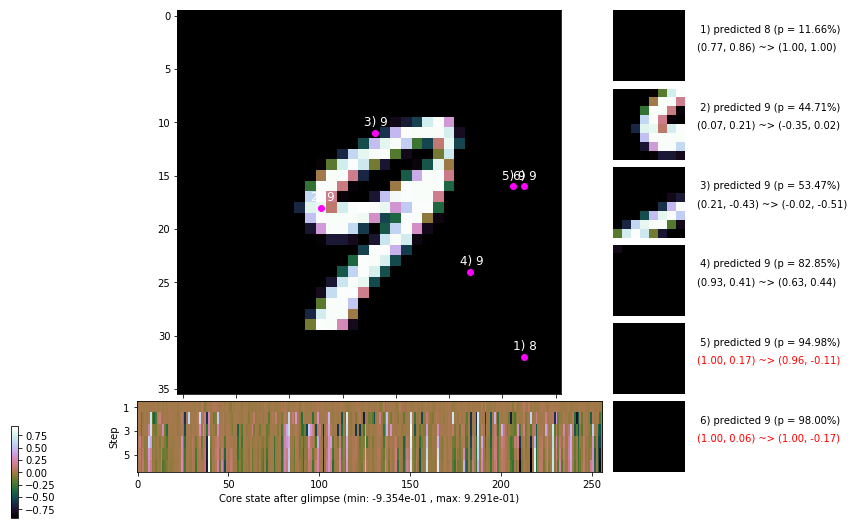

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


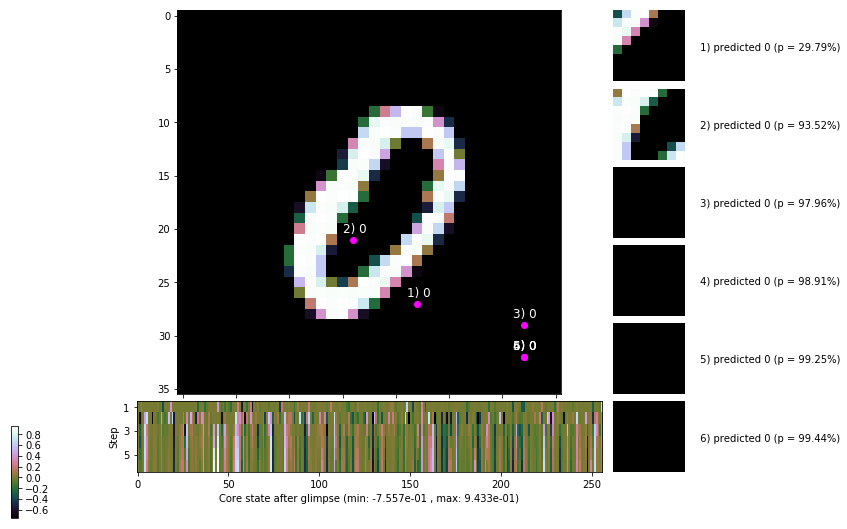


	Target class: 6 | Discounted rewards: [1.219, 0.438, 1.875, 1.750, 1.500, 1.000]


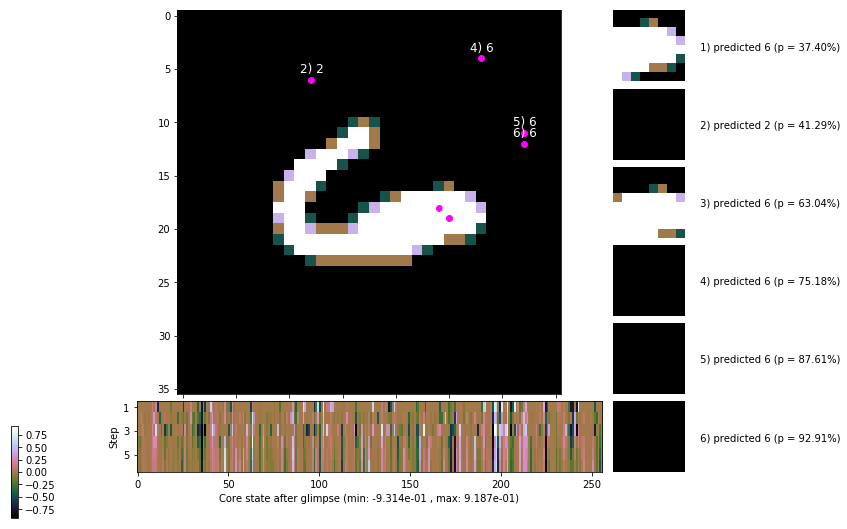

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


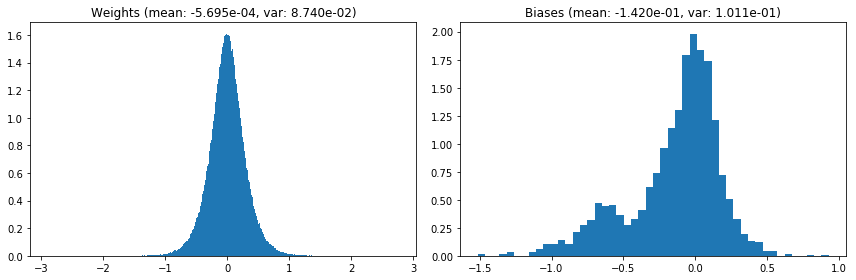

                                      Location network weights and biases


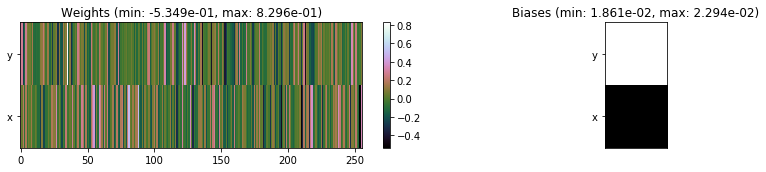

---------------------------------------------------------------------------------------------------------------
Elapsed time:  488.95 sec | TRAIN >> class loss: 0.3291 | steps:  2.204 :( | reward:  3.7624 :( | acc.: 88.773% :(
                          | VAL   >> class loss: 0.3080 | steps:  2.078 :( | reward:  3.9813 :( | acc.: 89.940% :(


Epoch 102/400) lr = 0.0002196
 b    300/  3000 >> 164.9 ms/b | lr: 2.19e-04 | grad 2norm: 12.07 | grad inf norm:  3.496
         Weights || abs max:  2.90 ( 2701.09) | mean: -5.68e-04 ( 0.01) | var: 8.74e-02 (  104.36)
          Biases || abs max:  1.52 (  105.80) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   57.13)
                    class loss: 0.325 | steps: 2.220 | reward:  3.760 | acc.: 88.83%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 158.4 ms/b | lr: 2.19e-04 | grad 2norm: 12.13 | grad inf norm:  3.602
         Weights || abs max:  2.90 ( 3330.97) | mean: -5.75e-04 (

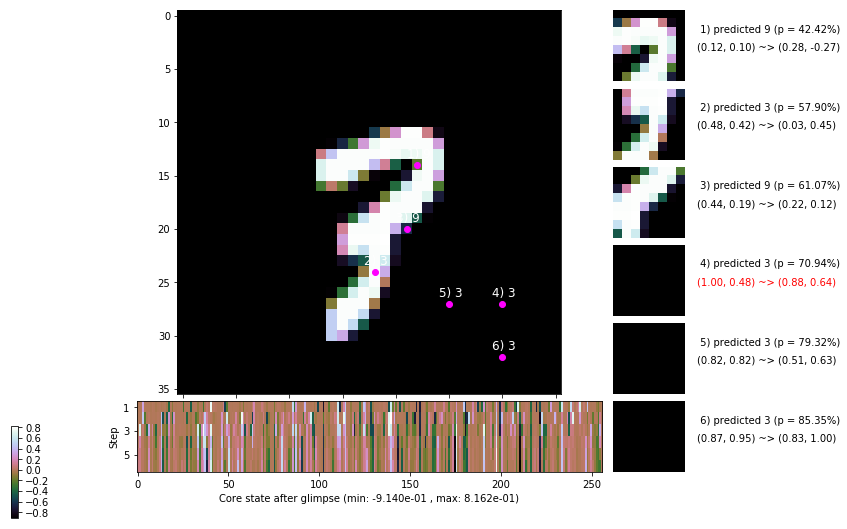

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 167.4 ms/b | lr: 2.19e-04 | grad 2norm: 12.26 | grad inf norm:  3.820
         Weights || abs max:  2.90 ( 5976.93) | mean: -5.78e-04 ( 0.02) | var: 8.74e-02 ( 3061.30)
          Biases || abs max:  1.52 (  108.06) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (  115.15)
                    class loss: 0.321 | steps: 2.192 | reward:  3.777 | acc.: 89.02%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 166.8 ms/b | lr: 2.19e-04 | grad 2norm: 11.86 | grad inf norm:  3.525
         Weights || abs max:  2.89 ( 5108.17) | mean: -5.71e-04 ( 0.02) | var: 8.74e-02 (  759.17)
          Biases || abs max:  1.51 (   74.67) | mean: -1.42e-01 ( 0.09) | var: 1.01e-01 (   15.95)
                    class loss: 0.321 | steps: 2.202 | reward:  3.788 | acc.: 89.17%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

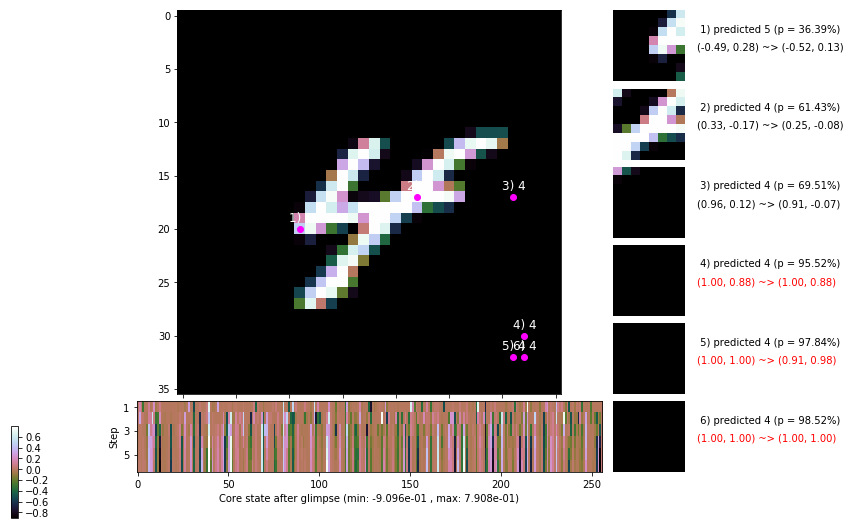

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 159.1 ms/b | lr: 2.18e-04 | grad 2norm: 12.23 | grad inf norm:  3.785
         Weights || abs max:  2.90 ( 2470.48) | mean: -5.67e-04 ( 0.01) | var: 8.75e-02 (  157.76)
          Biases || abs max:  1.51 (  113.97) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   23.43)
                    class loss: 0.319 | steps: 2.184 | reward:  3.802 | acc.: 89.03%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 161.0 ms/b | lr: 2.18e-04 | grad 2norm: 12.13 | grad inf norm:  3.606
         Weights || abs max:  2.90 ( 4518.34) | mean: -5.67e-04 ( 0.02) | var: 8.75e-02 (  608.05)
          Biases || abs max:  1.51 (   60.71) | mean: -1.42e-01 ( 0.09) | var: 1.01e-01 (   10.57)
                    class loss: 0.316 | steps: 2.179 | reward:  3.822 | acc.: 89.62%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

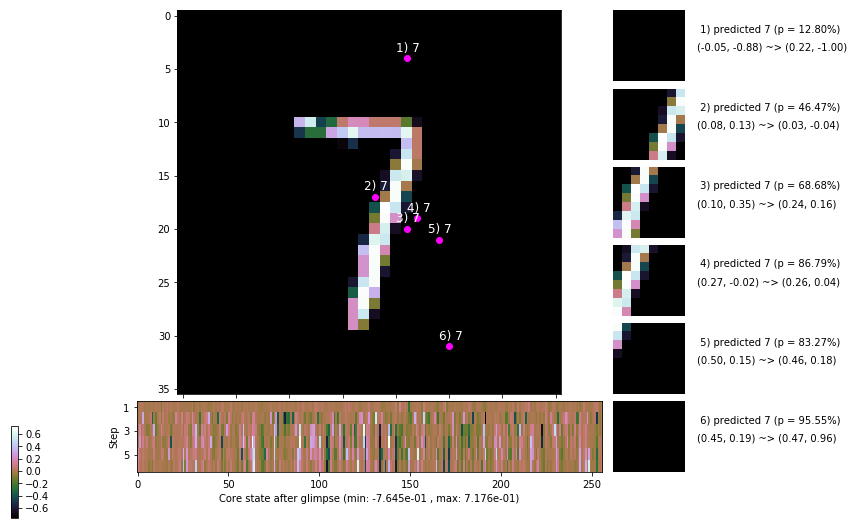

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 161.6 ms/b | lr: 2.17e-04 | grad 2norm: 12.09 | grad inf norm:  3.664
         Weights || abs max:  2.90 ( 8115.98) | mean: -5.69e-04 ( 0.02) | var: 8.75e-02 (10732.41)
          Biases || abs max:  1.51 (  124.59) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   49.24)
                    class loss: 0.318 | steps: 2.202 | reward:  3.797 | acc.: 89.28%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 165.5 ms/b | lr: 2.17e-04 | grad 2norm: 12.32 | grad inf norm:  3.710
         Weights || abs max:  2.91 ( 1952.06) | mean: -5.71e-04 ( 0.01) | var: 8.75e-02 (   42.69)
          Biases || abs max:  1.51 (  440.45) | mean: -1.42e-01 ( 0.28) | var: 1.01e-01 ( 2064.58)
                    class loss: 0.330 | steps: 2.196 | reward:  3.775 | acc.: 89.02%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

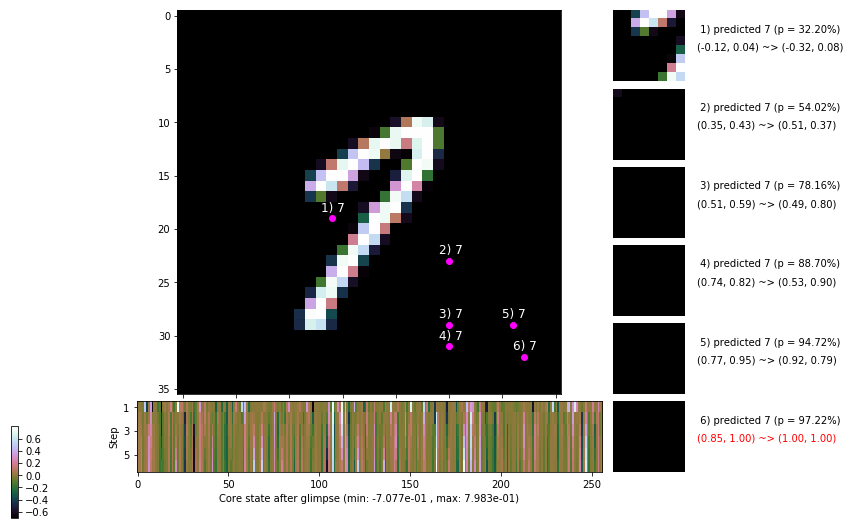

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 154.1 ms/b | lr: 2.17e-04 | grad 2norm: 12.40 | grad inf norm:  3.882
         Weights || abs max:  2.92 ( 3620.62) | mean: -5.75e-04 ( 0.01) | var: 8.75e-02 (  749.99)
          Biases || abs max:  1.51 (  355.50) | mean: -1.42e-01 ( 0.21) | var: 1.01e-01 ( 6345.91)
                    class loss: 0.323 | steps: 2.214 | reward:  3.748 | acc.: 89.13%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 161.7 ms/b | lr: 2.17e-04 | grad 2norm: 12.25 | grad inf norm:  3.678
         Weights || abs max:  2.92 ( 2429.14) | mean: -5.81e-04 ( 0.01) | var: 8.75e-02 (  719.80)
          Biases || abs max:  1.51 (  310.23) | mean: -1.42e-01 ( 0.22) | var: 1.01e-01 ( 1438.20)
                    class loss: 0.324 | steps: 2.196 | reward:  3.784 | acc.: 89.05%

	Target class: 9 | Discounted rewards: [-0.281, 0.438, 1.

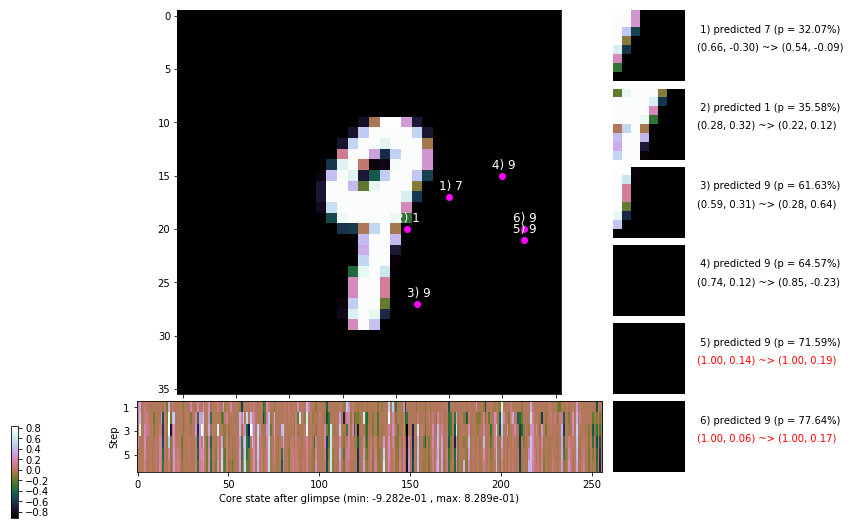

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


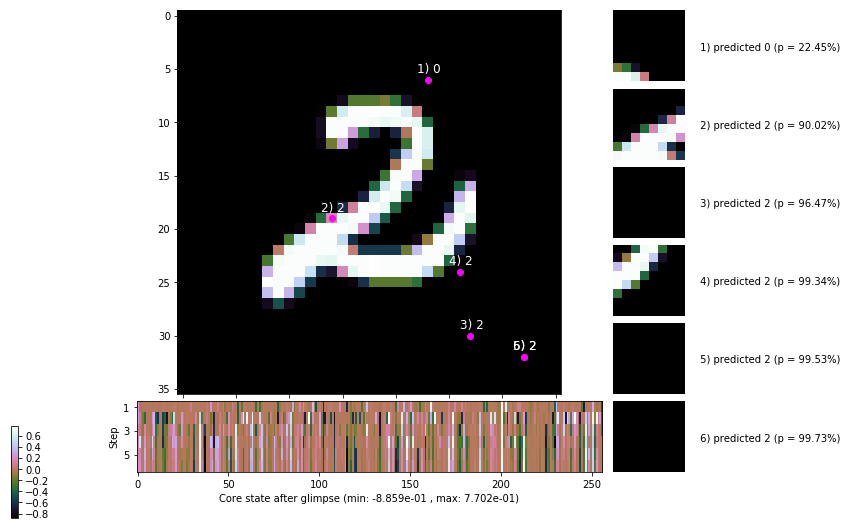


	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


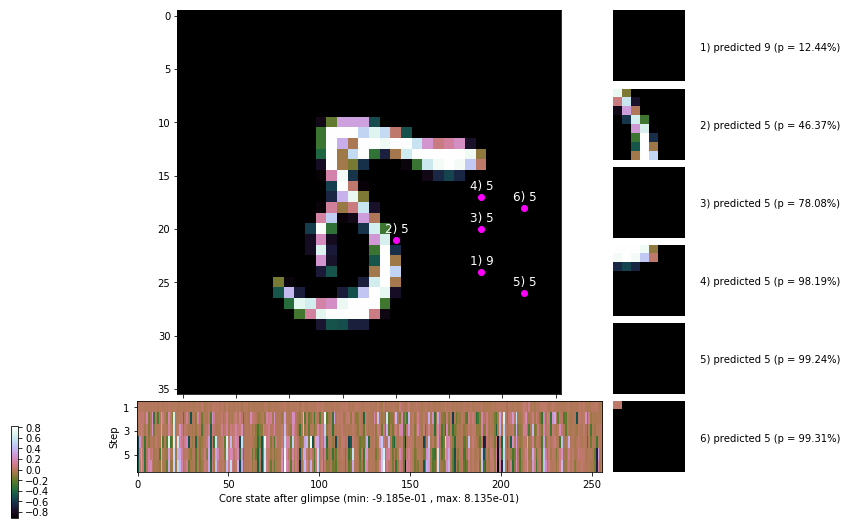

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


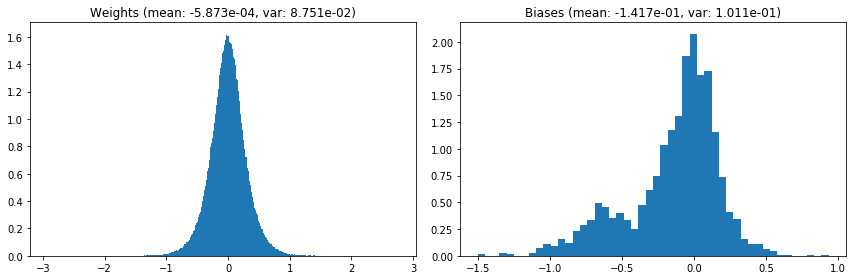

                                      Location network weights and biases


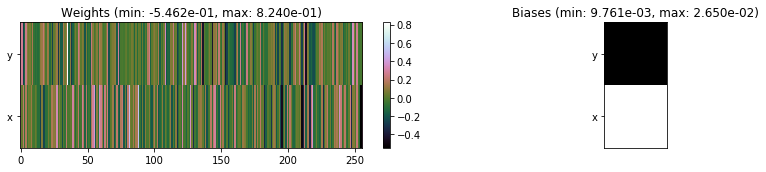

---------------------------------------------------------------------------------------------------------------
Elapsed time:  487.15 sec | TRAIN >> class loss: 0.3224 | steps:  2.197 :( | reward:  3.7840 :( | acc.: 89.083% :(
                          | VAL   >> class loss: 0.2941 | steps:  2.099 :( | reward:  3.9717 :( | acc.: 89.980% :(


Epoch 103/400) lr = 0.0002164
 b    300/  3000 >> 164.9 ms/b | lr: 2.16e-04 | grad 2norm: 12.66 | grad inf norm:  3.925
         Weights || abs max:  2.92 ( 3594.89) | mean: -5.79e-04 ( 0.01) | var: 8.75e-02 (  311.38)
          Biases || abs max:  1.51 (  150.15) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (  207.57)
                    class loss: 0.338 | steps: 2.222 | reward:  3.708 | acc.: 88.13%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 151.8 ms/b | lr: 2.16e-04 | grad 2norm: 12.01 | grad inf norm:  3.716
         Weights || abs max:  2.93 ( 2296.26) | mean: -5.80e-04 (

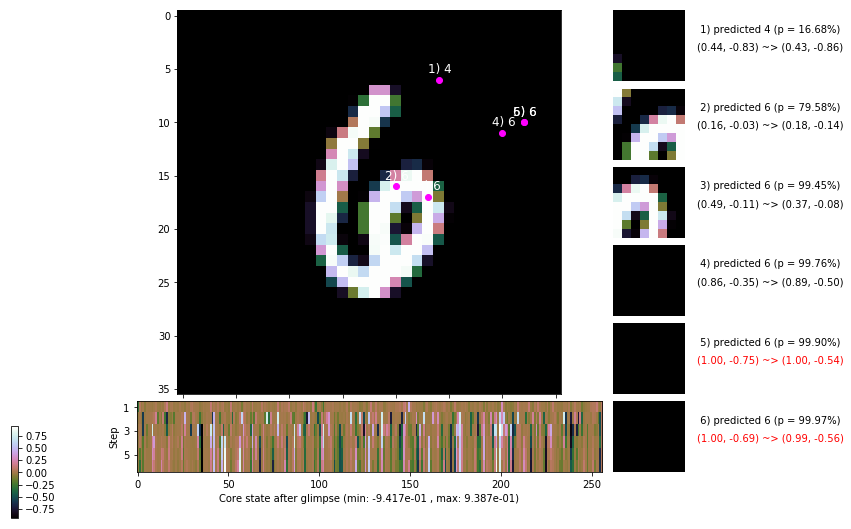

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 167.3 ms/b | lr: 2.16e-04 | grad 2norm: 12.08 | grad inf norm:  3.746
         Weights || abs max:  2.93 ( 2558.97) | mean: -5.81e-04 ( 0.01) | var: 8.75e-02 (  184.12)
          Biases || abs max:  1.51 (  110.18) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (  226.32)
                    class loss: 0.318 | steps: 2.184 | reward:  3.808 | acc.: 89.25%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 165.3 ms/b | lr: 2.15e-04 | grad 2norm: 12.33 | grad inf norm:  3.840
         Weights || abs max:  2.93 ( 3686.48) | mean: -5.88e-04 ( 0.02) | var: 8.75e-02 (  370.65)
          Biases || abs max:  1.51 (  161.25) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 (  160.21)
                    class loss: 0.325 | steps: 2.197 | reward:  3.761 | acc.: 88.97%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

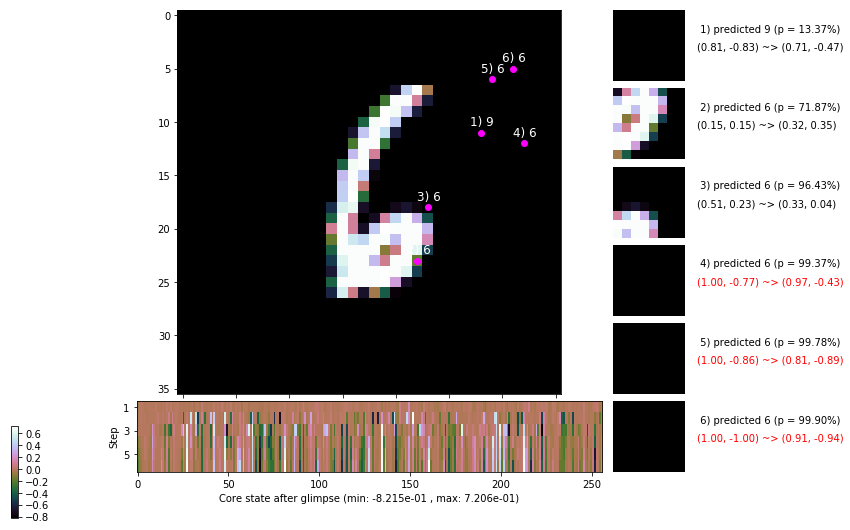

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 163.6 ms/b | lr: 2.15e-04 | grad 2norm: 12.16 | grad inf norm:  3.701
         Weights || abs max:  2.93 ( 3827.56) | mean: -5.89e-04 ( 0.01) | var: 8.75e-02 ( 1084.02)
          Biases || abs max:  1.50 (  150.65) | mean: -1.42e-01 ( 0.16) | var: 1.01e-01 ( 1236.68)
                    class loss: 0.306 | steps: 2.174 | reward:  3.823 | acc.: 89.48%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 154.3 ms/b | lr: 2.15e-04 | grad 2norm: 11.88 | grad inf norm:  3.576
         Weights || abs max:  2.93 ( 4943.11) | mean: -5.94e-04 ( 0.02) | var: 8.76e-02 ( 1096.56)
          Biases || abs max:  1.51 (  124.38) | mean: -1.42e-01 ( 0.11) | var: 1.01e-01 (  290.14)
                    class loss: 0.307 | steps: 2.166 | reward:  3.858 | acc.: 89.87%

	Target class: 6 | Discounted rewards: [-0.844, -0.688, -

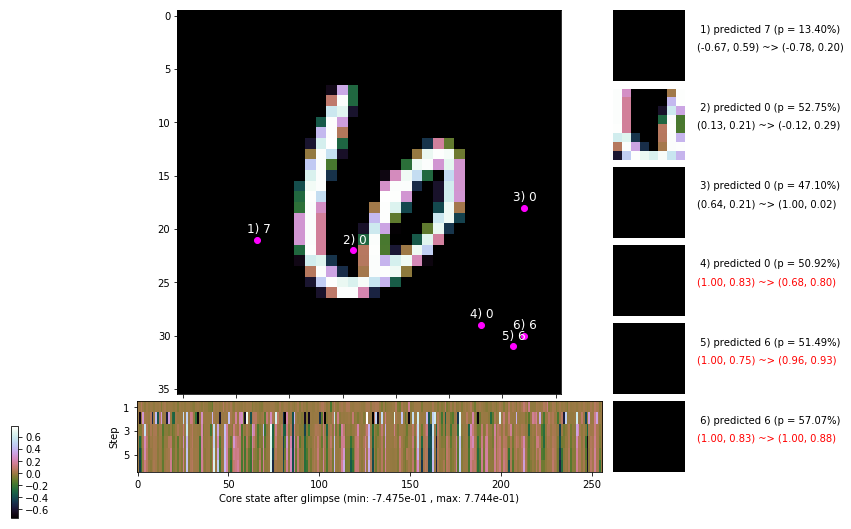

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 175.1 ms/b | lr: 2.14e-04 | grad 2norm: 12.16 | grad inf norm:  3.802
         Weights || abs max:  2.93 ( 7028.68) | mean: -5.88e-04 ( 0.02) | var: 8.76e-02 ( 4004.23)
          Biases || abs max:  1.51 (  132.77) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 (   87.58)
                    class loss: 0.317 | steps: 2.204 | reward:  3.786 | acc.: 89.28%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 164.4 ms/b | lr: 2.14e-04 | grad 2norm: 12.05 | grad inf norm:  3.677
         Weights || abs max:  2.93 ( 2805.18) | mean: -5.86e-04 ( 0.01) | var: 8.76e-02 (   94.90)
          Biases || abs max:  1.51 (  170.50) | mean: -1.41e-01 ( 0.13) | var: 1.01e-01 (  239.18)
                    class loss: 0.304 | steps: 2.187 | reward:  3.811 | acc.: 89.78%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

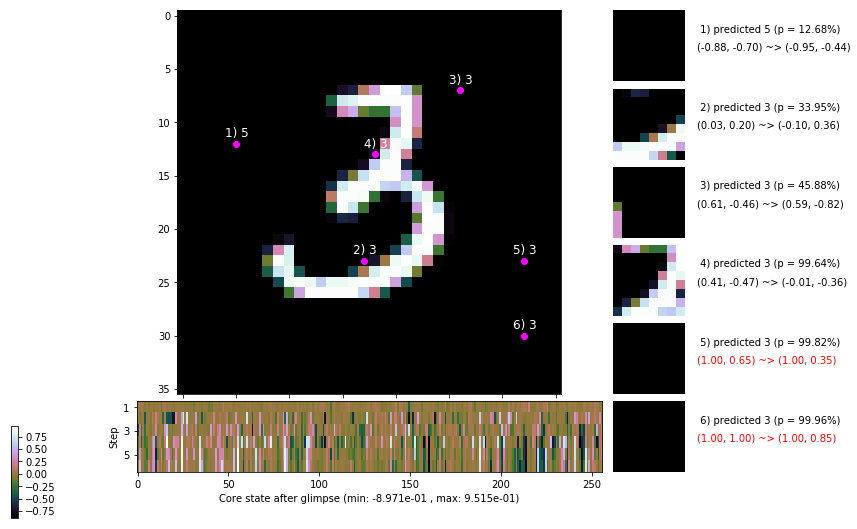

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 166.1 ms/b | lr: 2.14e-04 | grad 2norm: 12.13 | grad inf norm:  3.762
         Weights || abs max:  2.93 ( 2044.11) | mean: -5.82e-04 ( 0.01) | var: 8.76e-02 (   65.74)
          Biases || abs max:  1.51 (  211.05) | mean: -1.42e-01 ( 0.16) | var: 1.01e-01 (  501.77)
                    class loss: 0.323 | steps: 2.199 | reward:  3.789 | acc.: 89.17%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 159.3 ms/b | lr: 2.13e-04 | grad 2norm: 12.41 | grad inf norm:  3.776
         Weights || abs max:  2.92 (10585.53) | mean: -5.86e-04 ( 0.03) | var: 8.76e-02 (44075.50)
          Biases || abs max:  1.51 (  179.80) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (  102.93)
                    class loss: 0.335 | steps: 2.193 | reward:  3.755 | acc.: 88.62%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

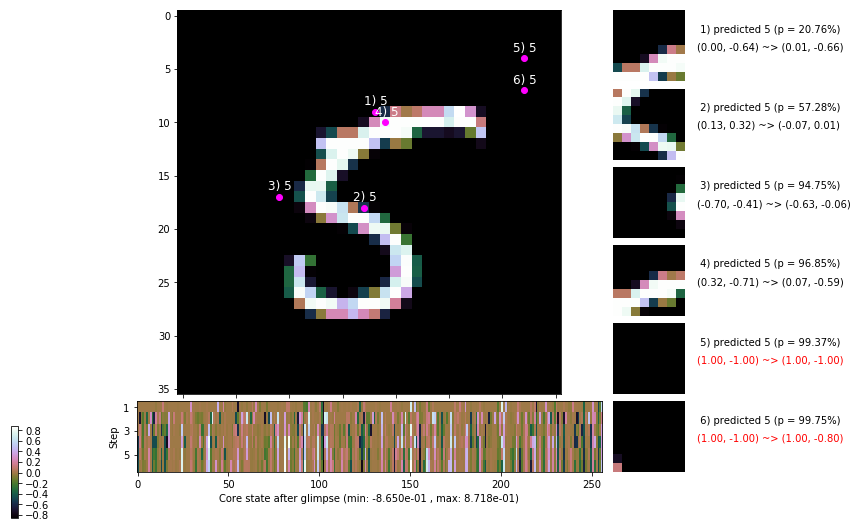

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


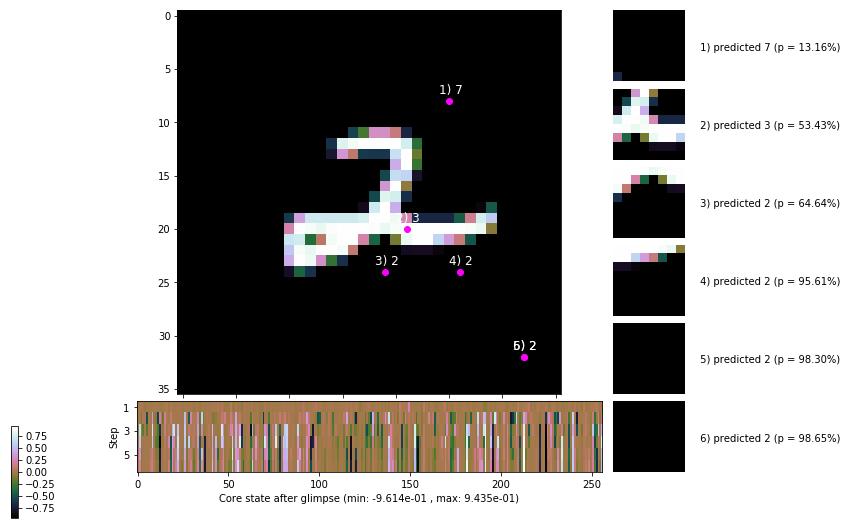


	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


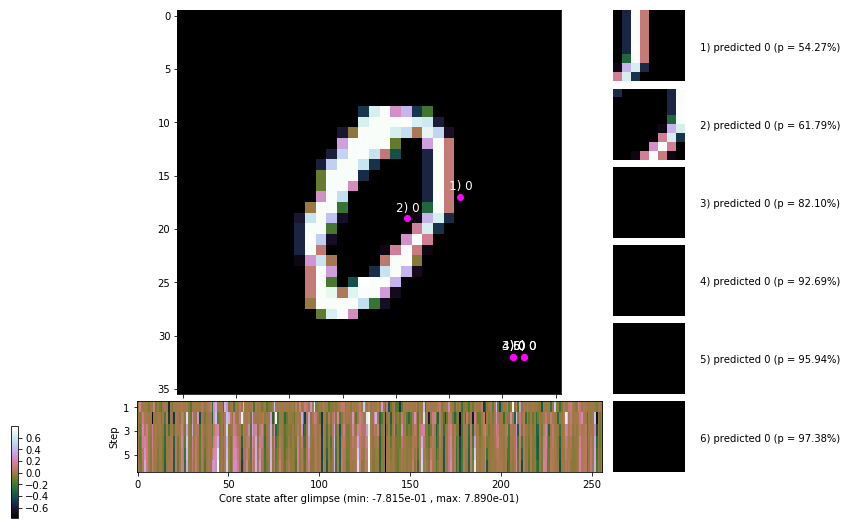

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


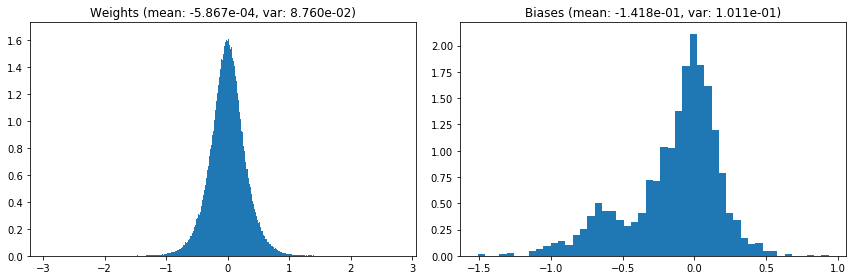

                                      Location network weights and biases


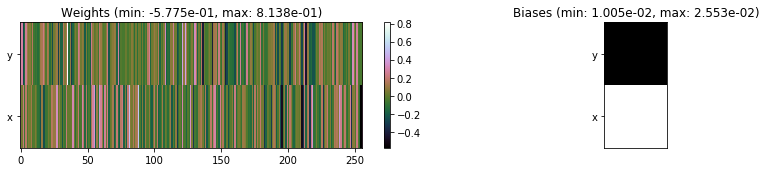

---------------------------------------------------------------------------------------------------------------
Elapsed time:  490.27 sec | TRAIN >> class loss: 0.3179 | steps:  2.192 :( | reward:  3.7878 :( | acc.: 89.195% :(
                          | VAL   >> class loss: 0.3116 | steps:  2.084 :( | reward:  3.9825 :( | acc.: 89.640% :(


Epoch 104/400) lr = 0.0002131
 b    300/  3000 >> 155.6 ms/b | lr: 2.13e-04 | grad 2norm: 12.17 | grad inf norm:  3.665
         Weights || abs max:  2.93 ( 3644.24) | mean: -5.86e-04 ( 0.01) | var: 8.76e-02 (  295.92)
          Biases || abs max:  1.51 (  103.77) | mean: -1.42e-01 ( 0.10) | var: 1.01e-01 (   48.06)
                    class loss: 0.332 | steps: 2.221 | reward:  3.738 | acc.: 88.85%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 157.3 ms/b | lr: 2.13e-04 | grad 2norm: 12.45 | grad inf norm:  3.784
         Weights || abs max:  2.93 ( 2552.06) | mean: -5.84e-04 (

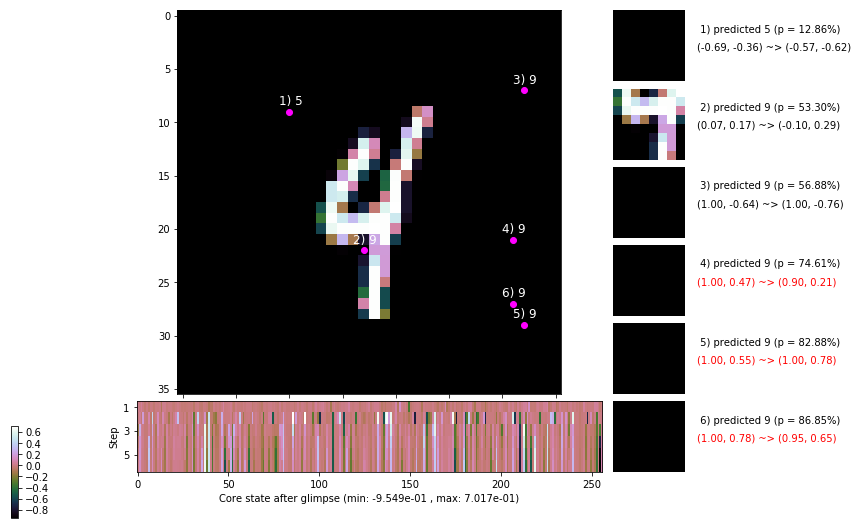

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 162.1 ms/b | lr: 2.12e-04 | grad 2norm: 11.92 | grad inf norm:  3.582
         Weights || abs max:  2.93 ( 3832.81) | mean: -5.81e-04 ( 0.02) | var: 8.76e-02 (  392.37)
          Biases || abs max:  1.51 (  463.29) | mean: -1.42e-01 ( 0.25) | var: 1.01e-01 (  384.10)
                    class loss: 0.316 | steps: 2.153 | reward:  3.842 | acc.: 89.38%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 161.1 ms/b | lr: 2.12e-04 | grad 2norm: 12.38 | grad inf norm:  3.956
         Weights || abs max:  2.92 ( 3535.63) | mean: -5.72e-04 ( 0.01) | var: 8.76e-02 (  451.66)
          Biases || abs max:  1.51 ( 1735.05) | mean: -1.42e-01 ( 0.76) | var: 1.01e-01 (14524.44)
                    class loss: 0.334 | steps: 2.218 | reward:  3.744 | acc.: 88.80%

	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.8

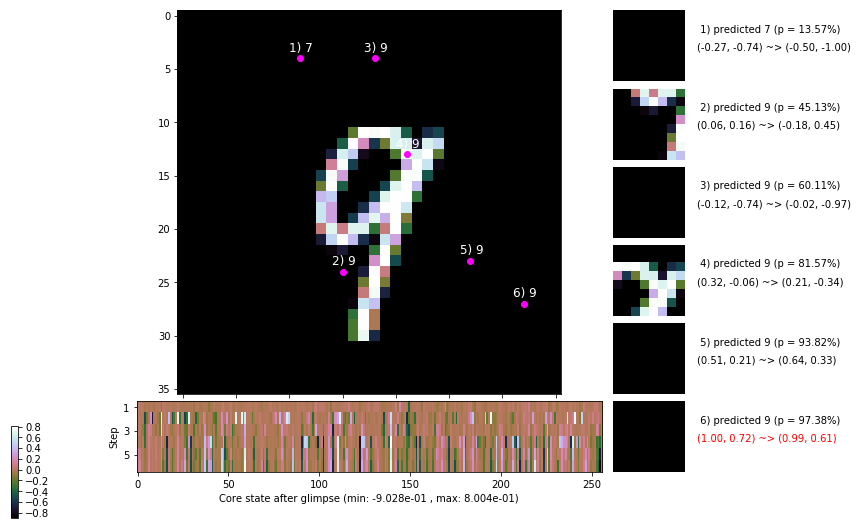

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 160.0 ms/b | lr: 2.12e-04 | grad 2norm: 12.03 | grad inf norm:  3.719
         Weights || abs max:  2.92 ( 3832.72) | mean: -5.83e-04 ( 0.02) | var: 8.77e-02 (  580.09)
          Biases || abs max:  1.51 (  149.70) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 (   44.48)
                    class loss: 0.318 | steps: 2.184 | reward:  3.807 | acc.: 89.23%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 157.8 ms/b | lr: 2.11e-04 | grad 2norm: 12.05 | grad inf norm:  3.889
         Weights || abs max:  2.92 ( 2978.56) | mean: -5.85e-04 ( 0.01) | var: 8.77e-02 (  118.87)
          Biases || abs max:  1.51 (  470.53) | mean: -1.42e-01 ( 0.26) | var: 1.01e-01 (10086.66)
                    class loss: 0.314 | steps: 2.184 | reward:  3.828 | acc.: 89.53%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.8

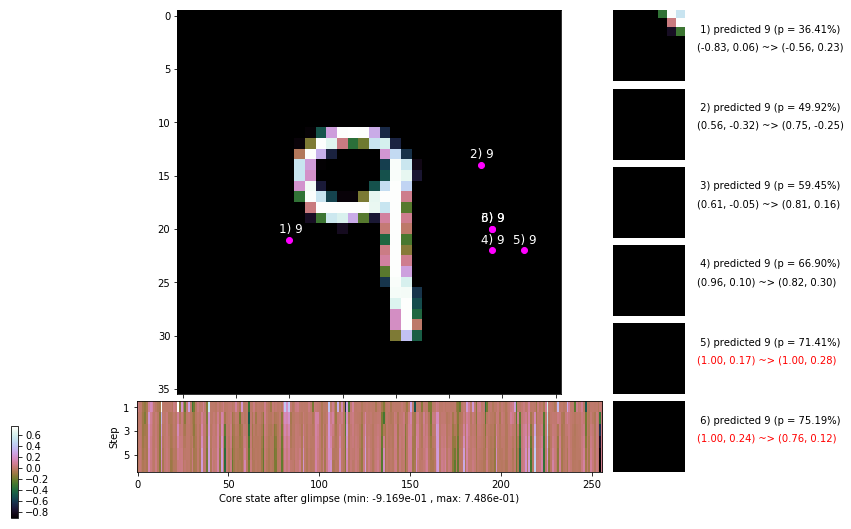

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 173.4 ms/b | lr: 2.11e-04 | grad 2norm: 12.18 | grad inf norm:  3.725
         Weights || abs max:  2.92 ( 3190.86) | mean: -5.79e-04 ( 0.01) | var: 8.77e-02 (  378.85)
          Biases || abs max:  1.51 (   69.96) | mean: -1.42e-01 ( 0.09) | var: 1.01e-01 (    9.22)
                    class loss: 0.340 | steps: 2.182 | reward:  3.800 | acc.: 88.67%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 156.8 ms/b | lr: 2.11e-04 | grad 2norm: 12.43 | grad inf norm:  3.965
         Weights || abs max:  2.92 (12774.50) | mean: -5.81e-04 ( 0.03) | var: 8.77e-02 (48178.68)
          Biases || abs max:  1.51 (   87.29) | mean: -1.42e-01 ( 0.11) | var: 1.01e-01 (   15.10)
                    class loss: 0.345 | steps: 2.198 | reward:  3.757 | acc.: 88.35%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.8

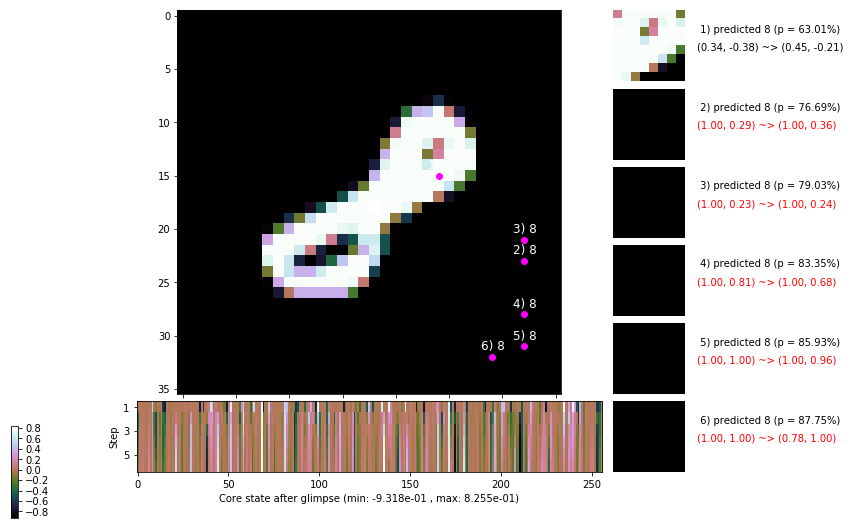

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 159.7 ms/b | lr: 2.10e-04 | grad 2norm: 12.10 | grad inf norm:  3.714
         Weights || abs max:  2.91 ( 2288.24) | mean: -5.79e-04 ( 0.01) | var: 8.77e-02 (  192.78)
          Biases || abs max:  1.51 ( 4951.79) | mean: -1.42e-01 ( 2.02) | var: 1.01e-01 (1957177.88)
                    class loss: 0.330 | steps: 2.182 | reward:  3.802 | acc.: 89.07%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 162.3 ms/b | lr: 2.10e-04 | grad 2norm: 12.11 | grad inf norm:  3.681
         Weights || abs max:  2.91 ( 1747.55) | mean: -5.76e-04 ( 0.01) | var: 8.77e-02 (   96.83)
          Biases || abs max:  1.51 (  241.87) | mean: -1.42e-01 ( 0.17) | var: 1.01e-01 ( 1895.87)
                    class loss: 0.328 | steps: 2.192 | reward:  3.783 | acc.: 89.08%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1

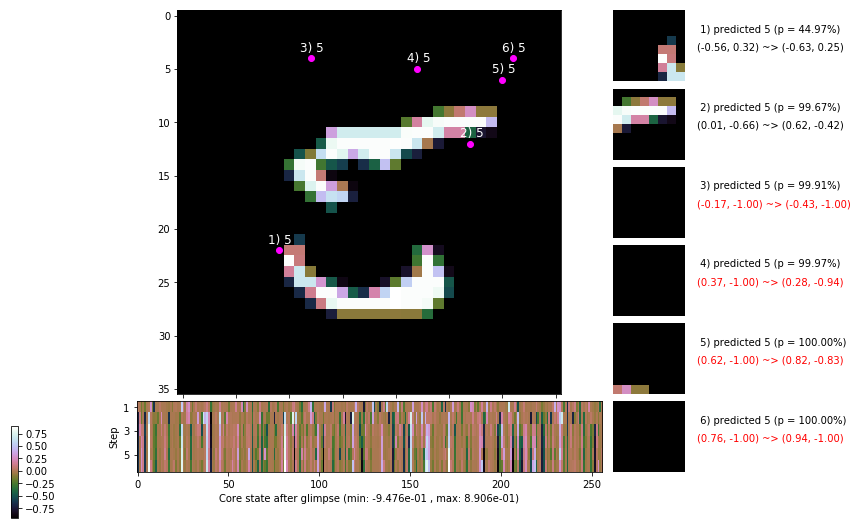

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


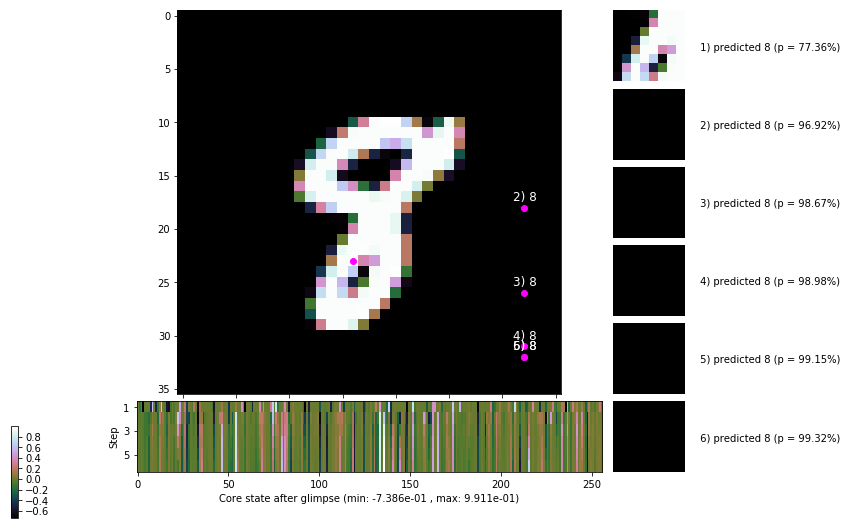


	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


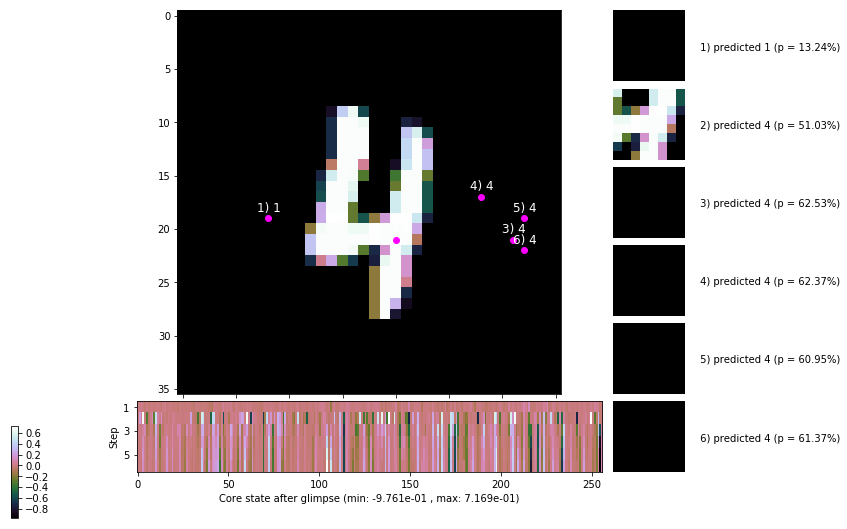

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


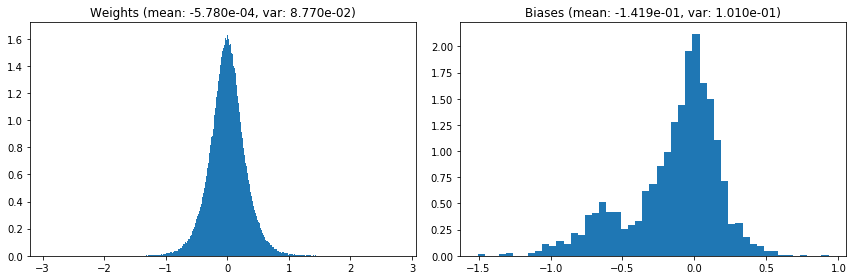

                                      Location network weights and biases


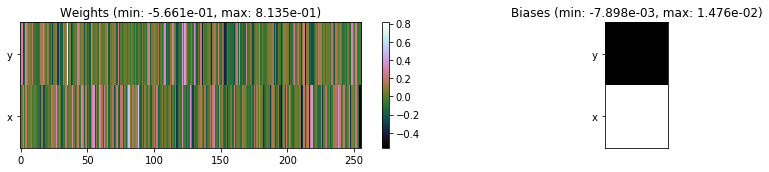

---------------------------------------------------------------------------------------------------------------
Elapsed time:  482.72 sec | TRAIN >> class loss: 0.3294 | steps:  2.193 :( | reward:  3.7839 :( | acc.: 88.950% :(
                          | VAL   >> class loss: 0.3049 | steps:  2.115 :( | reward:  3.9432 :( | acc.: 89.680% :(


Epoch 105/400) lr = 0.00021
 b    300/  3000 >> 148.2 ms/b | lr: 2.10e-04 | grad 2norm: 12.21 | grad inf norm:  3.836
         Weights || abs max:  2.91 (17627.86) | mean: -5.91e-04 ( 0.04) | var: 8.77e-02 (134533.75)
          Biases || abs max:  1.51 (  630.56) | mean: -1.42e-01 ( 0.35) | var: 1.01e-01 (25379.22)
                    class loss: 0.328 | steps: 2.190 | reward:  3.792 | acc.: 89.20%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 146.1 ms/b | lr: 2.10e-04 | grad 2norm: 11.95 | grad inf norm:  3.714
         Weights || abs max:  2.91 ( 3480.10) | mean: -5.95e-04 ( 

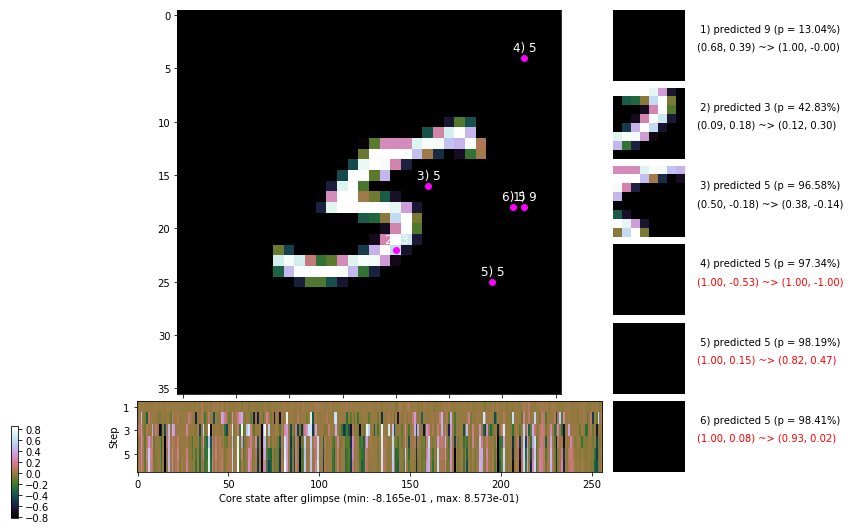

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.0 ms/b | lr: 2.09e-04 | grad 2norm: 11.96 | grad inf norm:  3.637
         Weights || abs max:  2.91 ( 4161.58) | mean: -5.90e-04 ( 0.01) | var: 8.77e-02 ( 1069.34)
          Biases || abs max:  1.51 (  189.15) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 ( 1305.65)
                    class loss: 0.293 | steps: 2.185 | reward:  3.844 | acc.: 90.33%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 149.0 ms/b | lr: 2.09e-04 | grad 2norm: 12.13 | grad inf norm:  3.780
         Weights || abs max:  2.91 ( 2669.10) | mean: -5.98e-04 ( 0.01) | var: 8.77e-02 (  489.19)
          Biases || abs max:  1.51 (  107.42) | mean: -1.42e-01 ( 0.11) | var: 1.01e-01 (   44.42)
                    class loss: 0.322 | steps: 2.220 | reward:  3.756 | acc.: 89.27%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

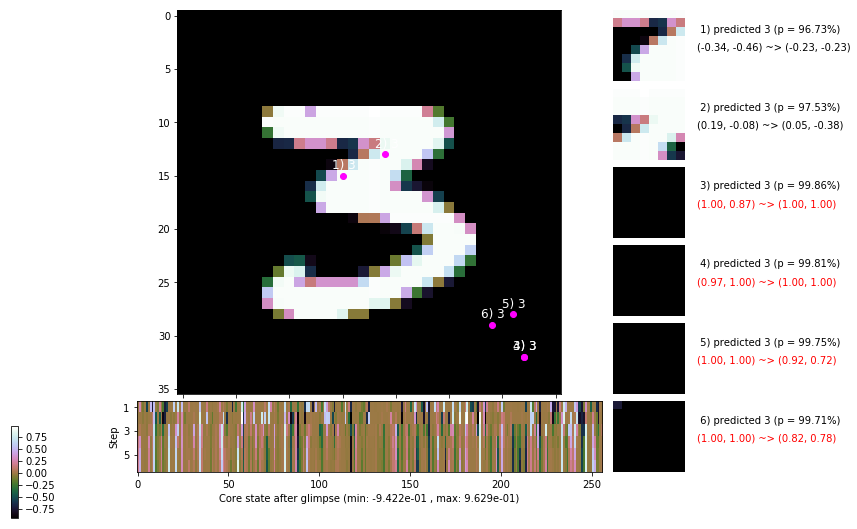

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 149.0 ms/b | lr: 2.09e-04 | grad 2norm: 12.20 | grad inf norm:  3.765
         Weights || abs max:  2.92 ( 2596.71) | mean: -6.00e-04 ( 0.01) | var: 8.77e-02 (  138.37)
          Biases || abs max:  1.51 (  904.72) | mean: -1.42e-01 ( 0.42) | var: 1.01e-01 (63895.65)
                    class loss: 0.316 | steps: 2.180 | reward:  3.809 | acc.: 89.35%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 148.7 ms/b | lr: 2.08e-04 | grad 2norm: 12.28 | grad inf norm:  3.800
         Weights || abs max:  2.92 ( 2250.79) | mean: -5.94e-04 ( 0.01) | var: 8.77e-02 (   92.28)
          Biases || abs max:  1.51 (  120.83) | mean: -1.42e-01 ( 0.11) | var: 1.01e-01 (  314.48)
                    class loss: 0.329 | steps: 2.198 | reward:  3.769 | acc.: 88.90%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

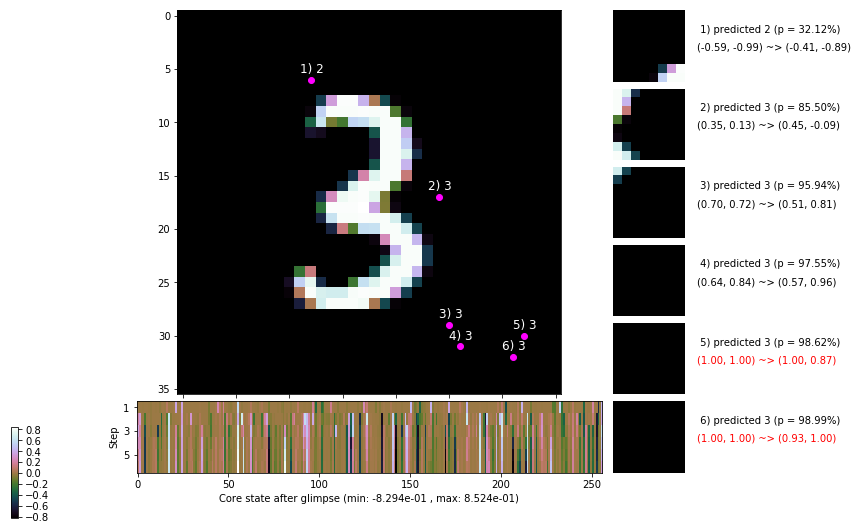

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 150.8 ms/b | lr: 2.08e-04 | grad 2norm: 12.06 | grad inf norm:  3.654
         Weights || abs max:  2.92 ( 2231.76) | mean: -5.89e-04 ( 0.01) | var: 8.78e-02 (  115.17)
          Biases || abs max:  1.51 (  118.95) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (   20.80)
                    class loss: 0.304 | steps: 2.208 | reward:  3.801 | acc.: 90.10%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 149.7 ms/b | lr: 2.08e-04 | grad 2norm: 11.93 | grad inf norm:  3.716
         Weights || abs max:  2.92 ( 2499.89) | mean: -5.96e-04 ( 0.01) | var: 8.78e-02 (   87.95)
          Biases || abs max:  1.51 ( 1054.95) | mean: -1.42e-01 ( 0.51) | var: 1.01e-01 (14361.84)
                    class loss: 0.309 | steps: 2.158 | reward:  3.848 | acc.: 89.80%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

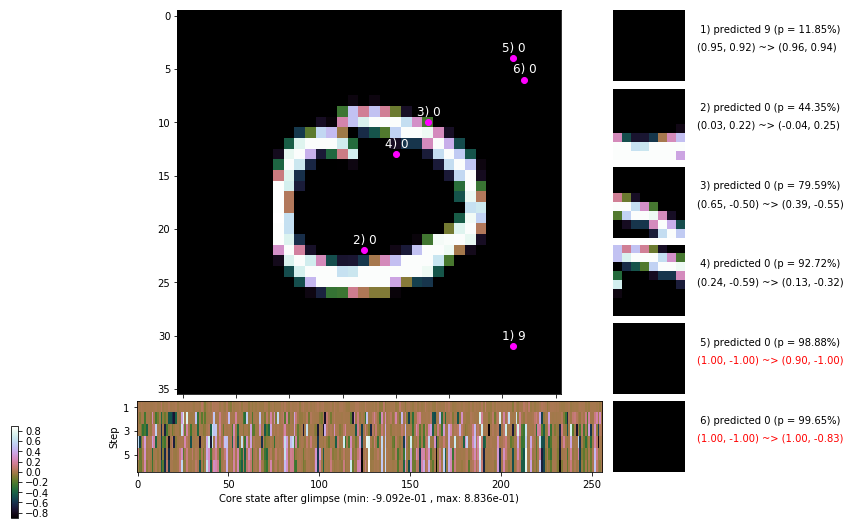

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 151.5 ms/b | lr: 2.07e-04 | grad 2norm: 11.97 | grad inf norm:  3.749
         Weights || abs max:  2.92 ( 2246.16) | mean: -5.92e-04 ( 0.01) | var: 8.78e-02 (  113.73)
          Biases || abs max:  1.51 (  433.02) | mean: -1.42e-01 ( 0.27) | var: 1.01e-01 ( 1186.29)
                    class loss: 0.297 | steps: 2.192 | reward:  3.811 | acc.: 89.75%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 146.3 ms/b | lr: 2.07e-04 | grad 2norm: 12.43 | grad inf norm:  3.791
         Weights || abs max:  2.92 ( 3571.34) | mean: -5.83e-04 ( 0.01) | var: 8.78e-02 ( 1034.31)
          Biases || abs max:  1.50 ( 1662.99) | mean: -1.42e-01 ( 0.79) | var: 1.01e-01 (18679.56)
                    class loss: 0.340 | steps: 2.213 | reward:  3.739 | acc.: 88.52%

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.8

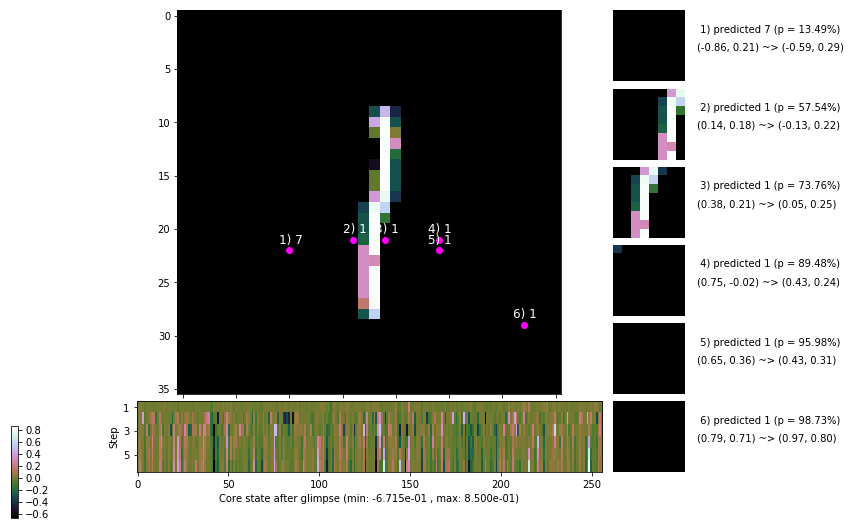

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


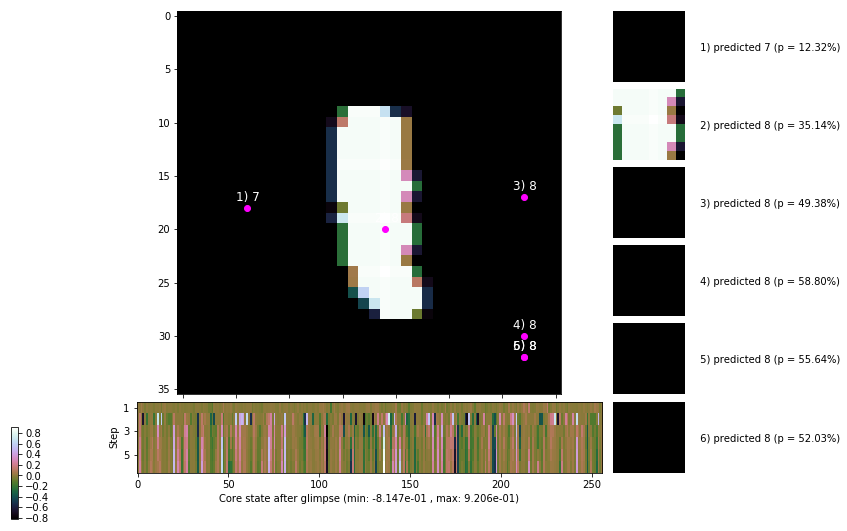


	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


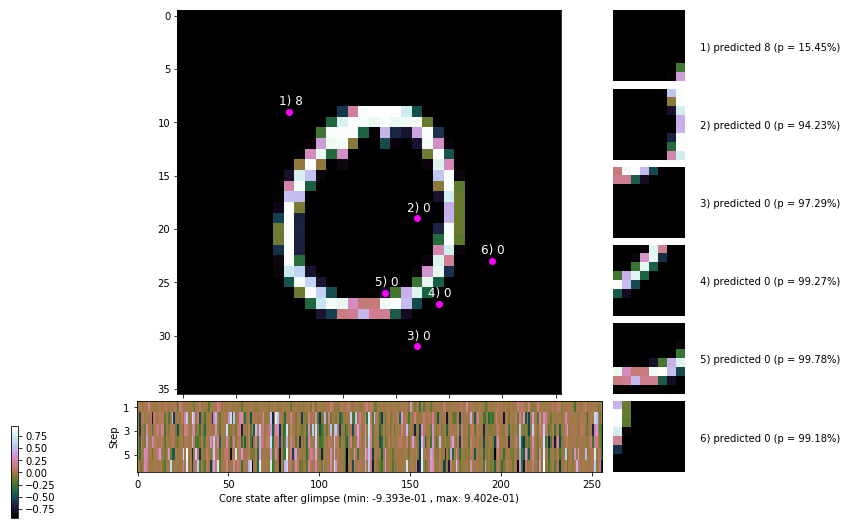

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


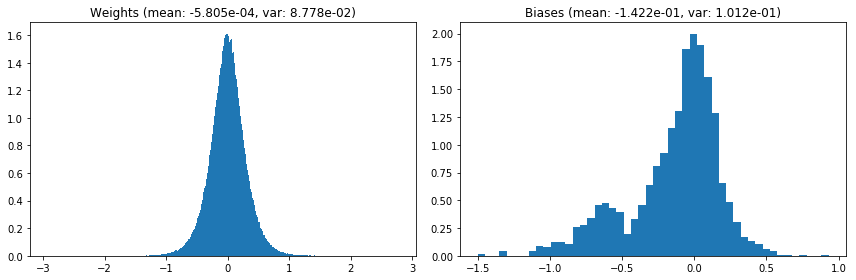

                                      Location network weights and biases


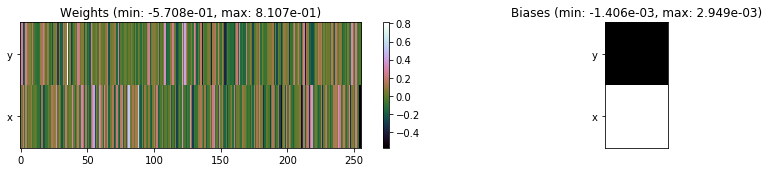

---------------------------------------------------------------------------------------------------------------
Elapsed time:  448.57 sec | TRAIN >> class loss: 0.3152 | steps:  2.193 :( | reward:  3.7978 :( | acc.: 89.470% :(
                          | VAL   >> class loss: 0.2890 | steps:  2.055    | reward:  4.0518    | acc.: 90.300% :(


Epoch 106/400) lr = 0.0002068
 b    300/  3000 >> 150.1 ms/b | lr: 2.07e-04 | grad 2norm: 11.98 | grad inf norm:  3.525
         Weights || abs max:  2.93 ( 3819.78) | mean: -5.85e-04 ( 0.01) | var: 8.78e-02 (  609.87)
          Biases || abs max:  1.50 (  312.16) | mean: -1.42e-01 ( 0.22) | var: 1.01e-01 (  124.95)
                    class loss: 0.311 | steps: 2.187 | reward:  3.812 | acc.: 89.70%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 152.8 ms/b | lr: 2.06e-04 | grad 2norm: 12.12 | grad inf norm:  3.889
         Weights || abs max:  2.93 ( 2768.60) | mean: -5.92e-04 (

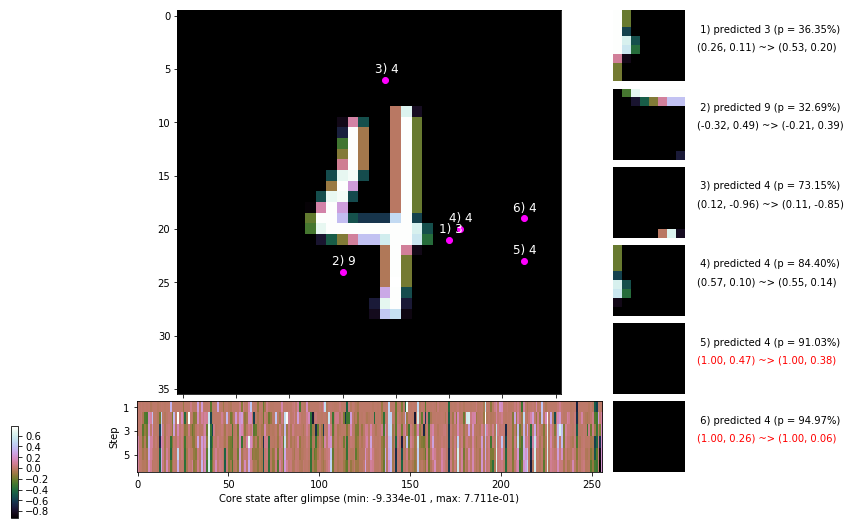

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 146.8 ms/b | lr: 2.06e-04 | grad 2norm: 12.31 | grad inf norm:  3.822
         Weights || abs max:  2.93 ( 2974.56) | mean: -6.11e-04 ( 0.01) | var: 8.78e-02 (  163.82)
          Biases || abs max:  1.50 (  794.03) | mean: -1.42e-01 ( 0.43) | var: 1.01e-01 ( 3065.78)
                    class loss: 0.322 | steps: 2.192 | reward:  3.765 | acc.: 88.87%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 148.5 ms/b | lr: 2.06e-04 | grad 2norm: 11.78 | grad inf norm:  3.523
         Weights || abs max:  2.93 ( 4879.14) | mean: -6.13e-04 ( 0.02) | var: 8.78e-02 ( 1646.59)
          Biases || abs max:  1.50 ( 2193.22) | mean: -1.42e-01 ( 1.01) | var: 1.01e-01 (112538.24)
                    class loss: 0.300 | steps: 2.162 | reward:  3.859 | acc.: 89.93%

	Target class: 5 | Discounted rewards: [-0.281, 0.438, 1

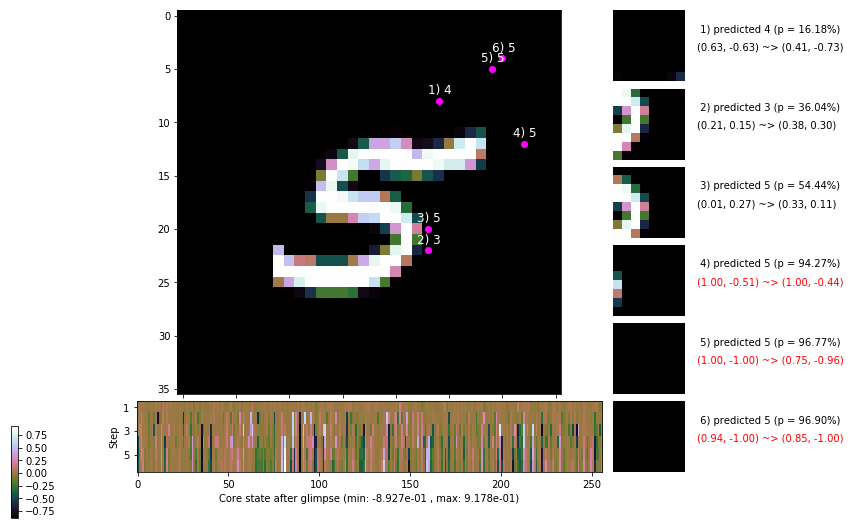

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 147.5 ms/b | lr: 2.05e-04 | grad 2norm: 12.22 | grad inf norm:  3.805
         Weights || abs max:  2.93 ( 2794.50) | mean: -6.05e-04 ( 0.01) | var: 8.78e-02 (  150.46)
          Biases || abs max:  1.50 (  330.20) | mean: -1.42e-01 ( 0.22) | var: 1.01e-01 (  676.45)
                    class loss: 0.317 | steps: 2.188 | reward:  3.785 | acc.: 89.57%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.4 ms/b | lr: 2.05e-04 | grad 2norm: 12.30 | grad inf norm:  3.919
         Weights || abs max:  2.93 ( 1920.80) | mean: -6.14e-04 ( 0.01) | var: 8.78e-02 (   92.87)
          Biases || abs max:  1.50 (  318.93) | mean: -1.42e-01 ( 0.21) | var: 1.01e-01 ( 2803.82)
                    class loss: 0.309 | steps: 2.162 | reward:  3.825 | acc.: 89.38%

	Target class: 6 | Discounted rewards: [-0.281, 0.438, 1.

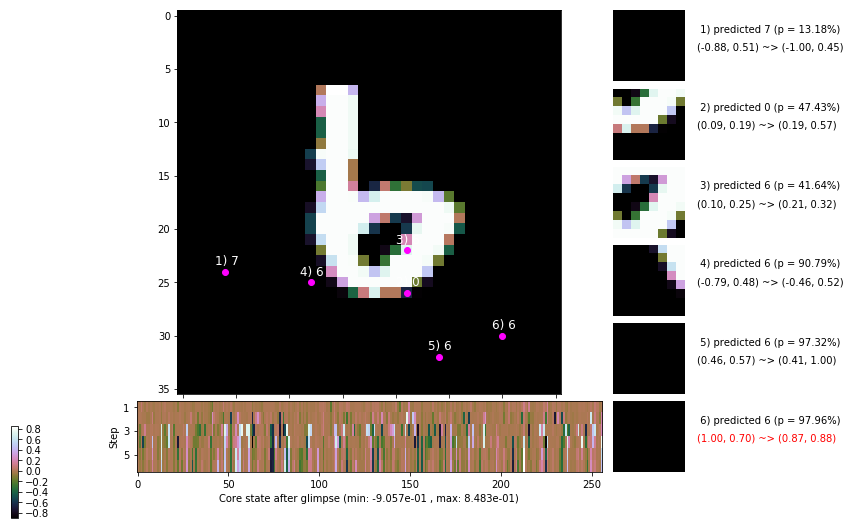

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 150.1 ms/b | lr: 2.05e-04 | grad 2norm: 12.25 | grad inf norm:  3.801
         Weights || abs max:  2.93 ( 1566.95) | mean: -6.33e-04 ( 0.01) | var: 8.78e-02 (   21.06)
          Biases || abs max:  1.50 (  571.73) | mean: -1.42e-01 ( 0.32) | var: 1.01e-01 ( 7587.23)
                    class loss: 0.319 | steps: 2.184 | reward:  3.816 | acc.: 89.48%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 146.9 ms/b | lr: 2.05e-04 | grad 2norm: 12.13 | grad inf norm:  3.779
         Weights || abs max:  2.94 ( 1580.51) | mean: -6.46e-04 ( 0.01) | var: 8.78e-02 (   29.16)
          Biases || abs max:  1.50 (  173.97) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (   67.75)
                    class loss: 0.331 | steps: 2.183 | reward:  3.790 | acc.: 88.97%

	Target class: 9 | Discounted rewards: [-0.984, -0.969, -

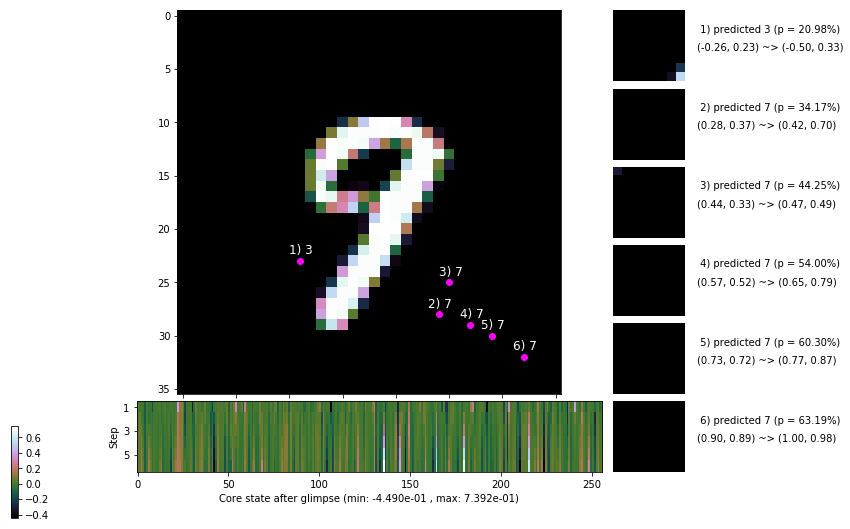

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.0 ms/b | lr: 2.04e-04 | grad 2norm: 12.21 | grad inf norm:  3.792
         Weights || abs max:  2.94 ( 4107.74) | mean: -6.45e-04 ( 0.01) | var: 8.78e-02 (  520.17)
          Biases || abs max:  1.51 (  569.79) | mean: -1.42e-01 ( 0.36) | var: 1.01e-01 ( 8050.83)
                    class loss: 0.320 | steps: 2.193 | reward:  3.786 | acc.: 88.97%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 146.6 ms/b | lr: 2.04e-04 | grad 2norm: 12.18 | grad inf norm:  3.760
         Weights || abs max:  2.93 ( 2569.46) | mean: -6.54e-04 ( 0.01) | var: 8.79e-02 (  200.97)
          Biases || abs max:  1.51 (  258.71) | mean: -1.42e-01 ( 0.21) | var: 1.01e-01 (   60.33)
                    class loss: 0.319 | steps: 2.179 | reward:  3.831 | acc.: 89.50%

	Target class: 6 | Discounted rewards: [-0.656, -0.312, 0

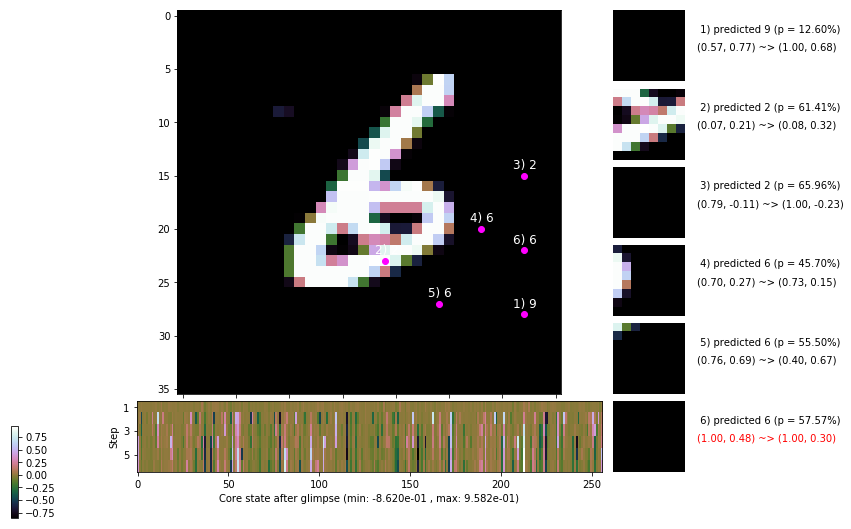

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


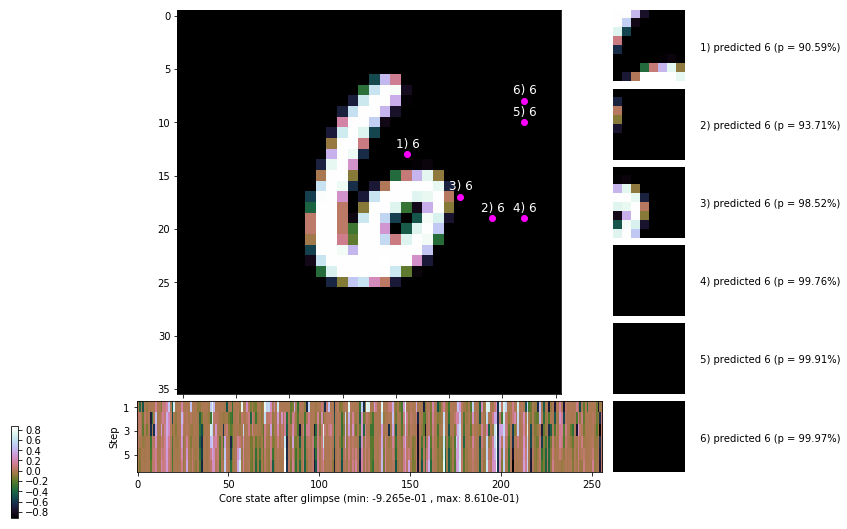


	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


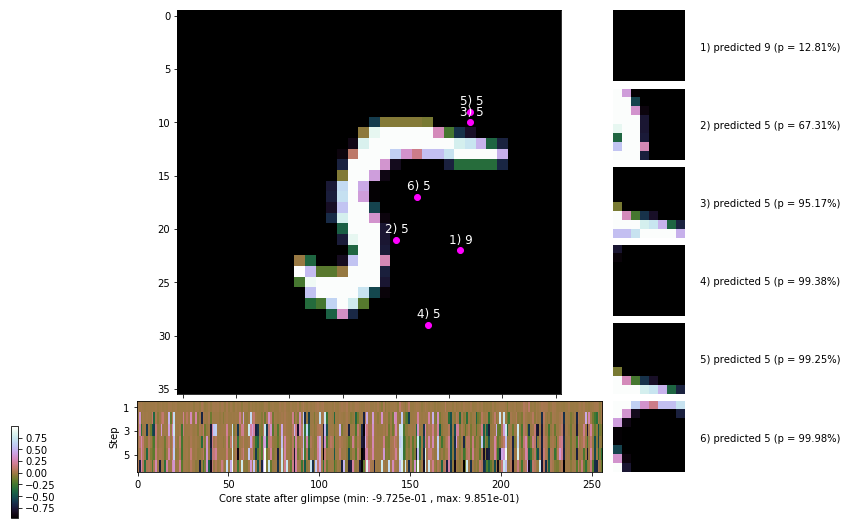

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


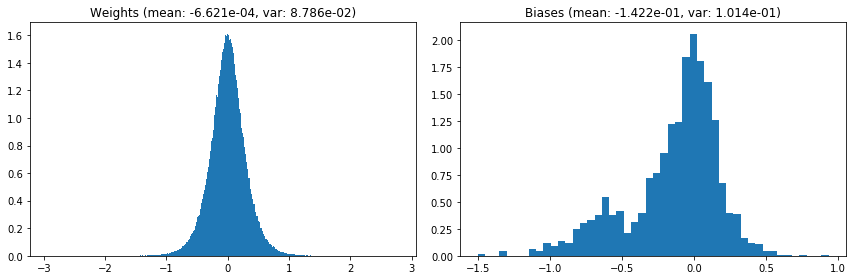

                                      Location network weights and biases


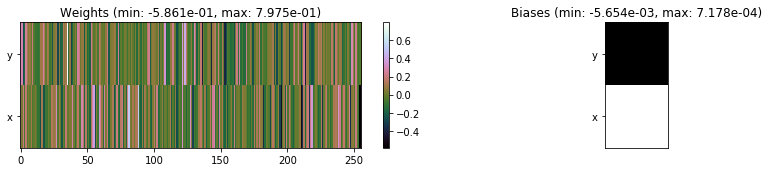

---------------------------------------------------------------------------------------------------------------
Elapsed time:  446.67 sec | TRAIN >> class loss: 0.3153 | steps:  2.182    | reward:  3.8100 :( | acc.: 89.423% :(
                          | VAL   >> class loss: 0.2918 | steps:  2.062 :( | reward:  4.0425 :( | acc.: 90.640% 


Epoch 107/400) lr = 0.0002038
 b    300/  3000 >> 149.8 ms/b | lr: 2.04e-04 | grad 2norm: 12.08 | grad inf norm:  3.737
         Weights || abs max:  2.94 ( 5899.84) | mean: -6.53e-04 ( 0.02) | var: 8.79e-02 ( 4688.41)
          Biases || abs max:  1.51 ( 3724.29) | mean: -1.42e-01 ( 1.60) | var: 1.01e-01 (151001.44)
                    class loss: 0.309 | steps: 2.169 | reward:  3.811 | acc.: 89.22%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.6 ms/b | lr: 2.03e-04 | grad 2norm: 12.33 | grad inf norm:  3.785
         Weights || abs max:  2.93 ( 3098.41) | mean: -6.50e-04 ( 

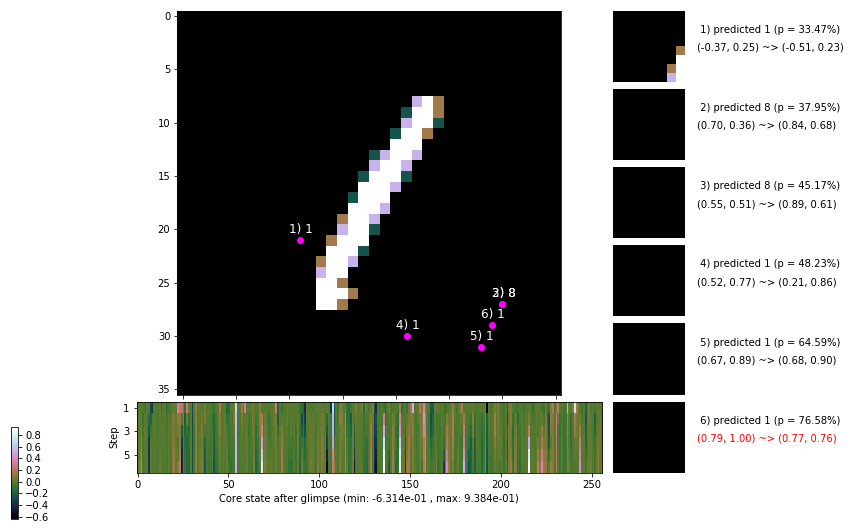

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 148.0 ms/b | lr: 2.03e-04 | grad 2norm: 12.20 | grad inf norm:  3.841
         Weights || abs max:  2.93 ( 1702.72) | mean: -6.56e-04 ( 0.01) | var: 8.79e-02 (   55.80)
          Biases || abs max:  1.51 (  269.29) | mean: -1.42e-01 ( 0.19) | var: 1.01e-01 ( 1499.62)
                    class loss: 0.311 | steps: 2.188 | reward:  3.787 | acc.: 89.00%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 151.5 ms/b | lr: 2.03e-04 | grad 2norm: 12.04 | grad inf norm:  3.740
         Weights || abs max:  2.93 ( 5673.89) | mean: -6.57e-04 ( 0.02) | var: 8.79e-02 (  928.47)
          Biases || abs max:  1.51 (  949.03) | mean: -1.42e-01 ( 0.48) | var: 1.01e-01 ( 2957.27)
                    class loss: 0.297 | steps: 2.183 | reward:  3.831 | acc.: 89.87%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

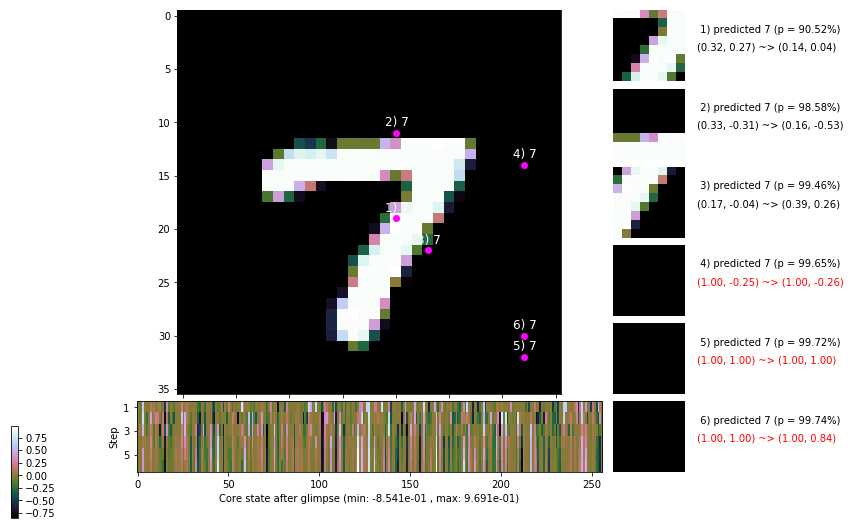

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 150.3 ms/b | lr: 2.02e-04 | grad 2norm: 12.28 | grad inf norm:  3.821
         Weights || abs max:  2.93 ( 3592.10) | mean: -6.58e-04 ( 0.01) | var: 8.79e-02 (  831.49)
          Biases || abs max:  1.51 (  526.10) | mean: -1.42e-01 ( 0.32) | var: 1.01e-01 ( 7204.86)
                    class loss: 0.325 | steps: 2.196 | reward:  3.776 | acc.: 89.12%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 152.4 ms/b | lr: 2.02e-04 | grad 2norm: 11.94 | grad inf norm:  3.669
         Weights || abs max:  2.93 ( 3849.38) | mean: -6.50e-04 ( 0.02) | var: 8.79e-02 (  301.24)
          Biases || abs max:  1.51 (  117.97) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 (   31.02)
                    class loss: 0.296 | steps: 2.172 | reward:  3.857 | acc.: 90.20%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

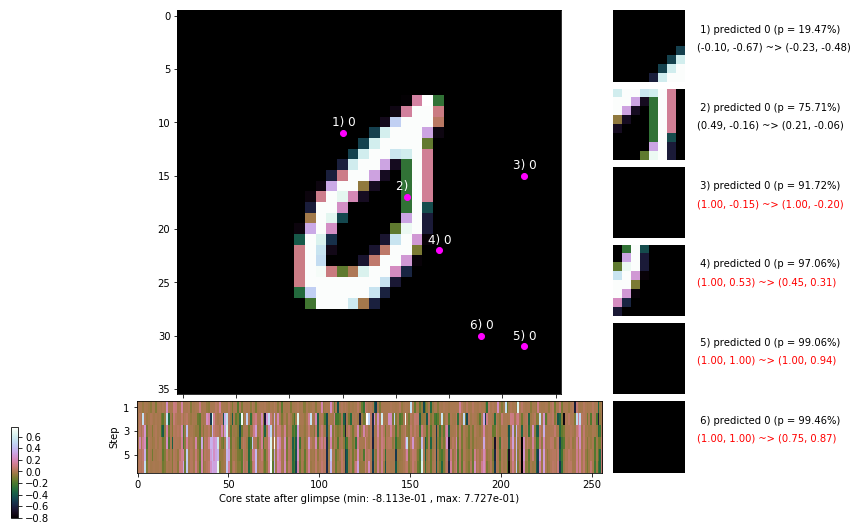

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 152.1 ms/b | lr: 2.02e-04 | grad 2norm: 12.05 | grad inf norm:  3.848
         Weights || abs max:  2.93 ( 3923.45) | mean: -6.42e-04 ( 0.01) | var: 8.79e-02 (  372.29)
          Biases || abs max:  1.51 (  619.72) | mean: -1.42e-01 ( 0.34) | var: 1.01e-01 ( 1913.63)
                    class loss: 0.320 | steps: 2.195 | reward:  3.788 | acc.: 89.20%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 146.6 ms/b | lr: 2.02e-04 | grad 2norm: 12.19 | grad inf norm:  3.666
         Weights || abs max:  2.93 ( 4015.50) | mean: -6.38e-04 ( 0.01) | var: 8.79e-02 ( 1161.45)
          Biases || abs max:  1.51 (  238.08) | mean: -1.42e-01 ( 0.23) | var: 1.01e-01 ( 1185.94)
                    class loss: 0.319 | steps: 2.196 | reward:  3.760 | acc.: 89.02%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

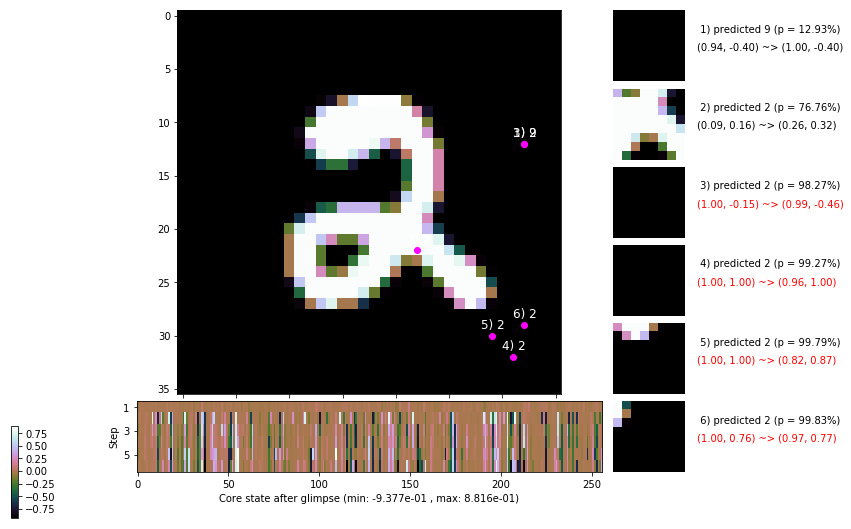

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 145.3 ms/b | lr: 2.01e-04 | grad 2norm: 12.06 | grad inf norm:  3.776
         Weights || abs max:  2.93 ( 1589.94) | mean: -6.34e-04 ( 0.01) | var: 8.79e-02 (  290.96)
          Biases || abs max:  1.51 (   83.53) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   13.19)
                    class loss: 0.305 | steps: 2.174 | reward:  3.821 | acc.: 89.47%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 145.4 ms/b | lr: 2.01e-04 | grad 2norm: 12.34 | grad inf norm:  3.739
         Weights || abs max:  2.93 ( 1168.15) | mean: -6.47e-04 ( 0.01) | var: 8.79e-02 (   18.01)
          Biases || abs max:  1.51 (  113.39) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   17.30)
                    class loss: 0.321 | steps: 2.191 | reward:  3.786 | acc.: 89.22%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

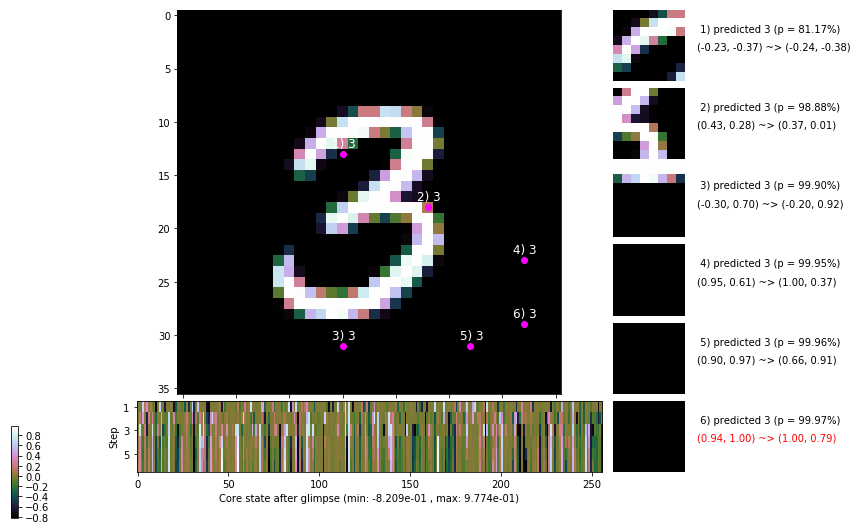

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


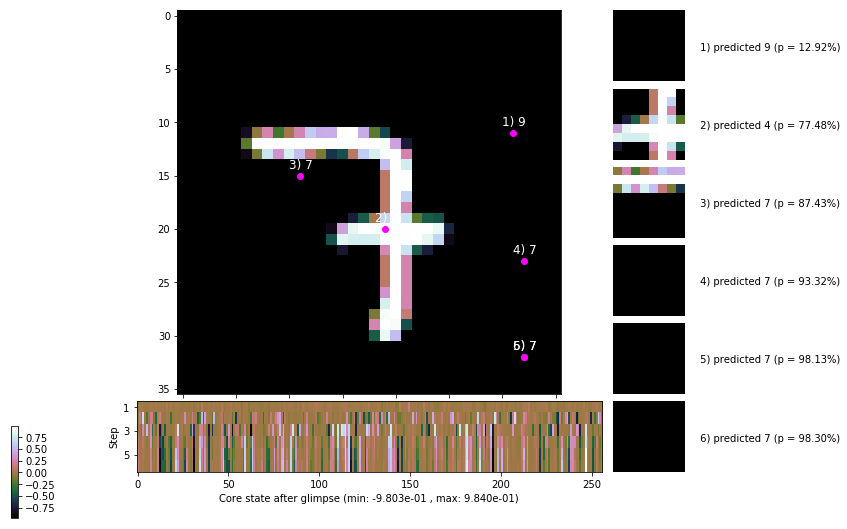


	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


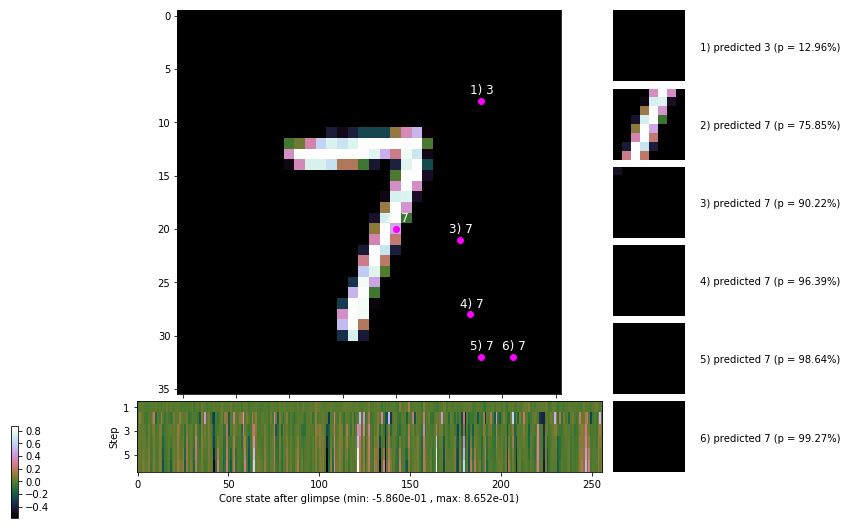

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


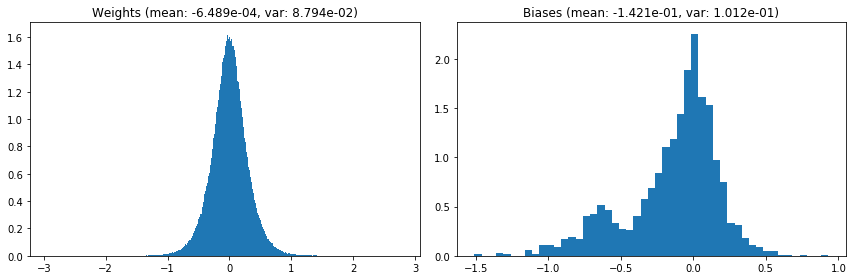

                                      Location network weights and biases


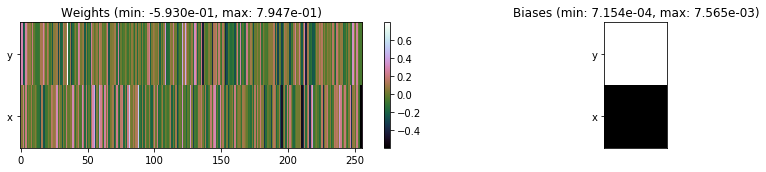

---------------------------------------------------------------------------------------------------------------
Elapsed time:  447.25 sec | TRAIN >> class loss: 0.3128 | steps:  2.188 :( | reward:  3.7999 :( | acc.: 89.342% :(
                          | VAL   >> class loss: 0.2847 | steps:  2.067 :( | reward:  4.0149 :( | acc.: 89.940% :(


Epoch 108/400) lr = 0.0002007
 b    300/  3000 >> 141.3 ms/b | lr: 2.01e-04 | grad 2norm: 12.21 | grad inf norm:  3.796
         Weights || abs max:  2.93 ( 4643.77) | mean: -6.49e-04 ( 0.02) | var: 8.79e-02 (  979.14)
          Biases || abs max:  1.51 ( 1578.35) | mean: -1.42e-01 ( 0.70) | var: 1.01e-01 (23372.62)
                    class loss: 0.311 | steps: 2.182 | reward:  3.832 | acc.: 89.63%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 146.9 ms/b | lr: 2.00e-04 | grad 2norm: 12.17 | grad inf norm:  3.834
         Weights || abs max:  2.93 (14002.50) | mean: -6.44e-04 (

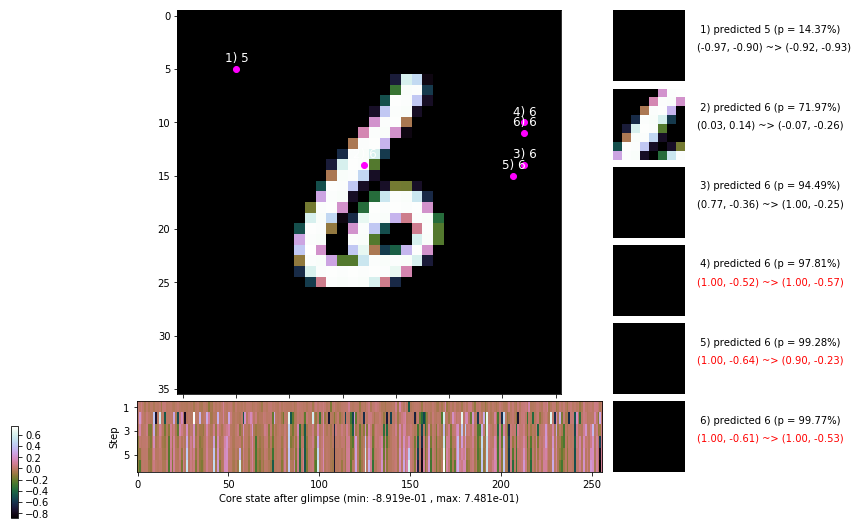

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 154.7 ms/b | lr: 2.00e-04 | grad 2norm: 12.29 | grad inf norm:  3.765
         Weights || abs max:  2.93 ( 1961.26) | mean: -6.45e-04 ( 0.01) | var: 8.80e-02 (   40.97)
          Biases || abs max:  1.51 (  269.32) | mean: -1.42e-01 ( 0.19) | var: 1.01e-01 (  435.51)
                    class loss: 0.327 | steps: 2.209 | reward:  3.759 | acc.: 89.12%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 171.7 ms/b | lr: 2.00e-04 | grad 2norm: 12.08 | grad inf norm:  3.641
         Weights || abs max:  2.93 ( 2243.92) | mean: -6.46e-04 ( 0.01) | var: 8.80e-02 (  127.73)
          Biases || abs max:  1.51 (  124.93) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 (   37.42)
                    class loss: 0.323 | steps: 2.169 | reward:  3.829 | acc.: 89.45%

	Target class: 9 | Discounted rewards: [0.844, -0.312, 0.

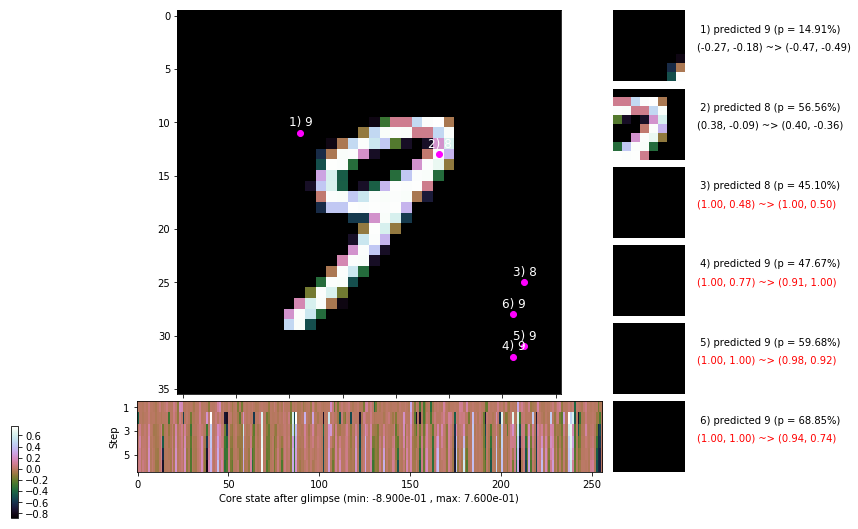

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 162.3 ms/b | lr: 1.99e-04 | grad 2norm: 12.07 | grad inf norm:  3.848
         Weights || abs max:  2.93 ( 2884.23) | mean: -6.65e-04 ( 0.01) | var: 8.80e-02 (  309.36)
          Biases || abs max:  1.51 (  172.16) | mean: -1.42e-01 ( 0.18) | var: 1.01e-01 (   59.30)
                    class loss: 0.316 | steps: 2.201 | reward:  3.782 | acc.: 89.33%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 151.8 ms/b | lr: 1.99e-04 | grad 2norm: 12.34 | grad inf norm:  3.777
         Weights || abs max:  2.93 ( 2214.27) | mean: -6.74e-04 ( 0.01) | var: 8.80e-02 (  451.21)
          Biases || abs max:  1.51 ( 1502.76) | mean: -1.42e-01 ( 0.72) | var: 1.01e-01 (12884.25)
                    class loss: 0.334 | steps: 2.195 | reward:  3.790 | acc.: 89.03%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

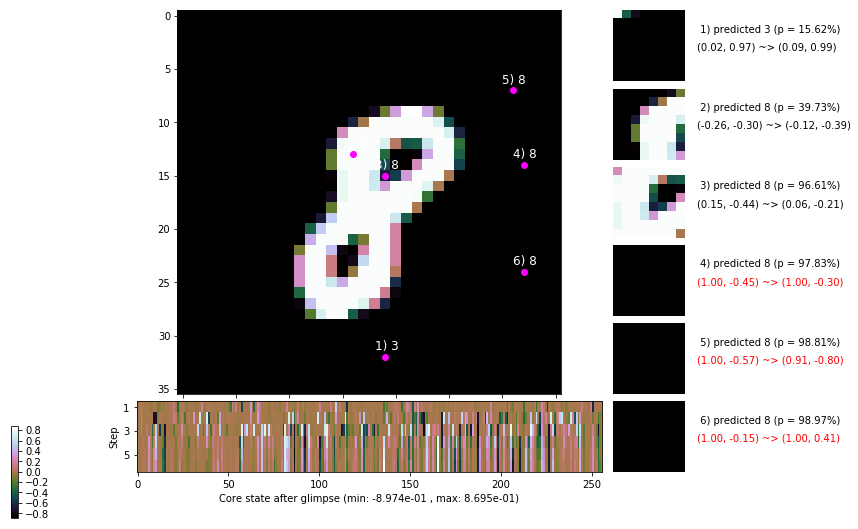

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 150.8 ms/b | lr: 1.99e-04 | grad 2norm: 11.94 | grad inf norm:  3.726
         Weights || abs max:  2.93 ( 1558.68) | mean: -6.78e-04 ( 0.01) | var: 8.80e-02 (   39.93)
          Biases || abs max:  1.51 (  612.99) | mean: -1.42e-01 ( 0.34) | var: 1.01e-01 ( 1219.03)
                    class loss: 0.299 | steps: 2.182 | reward:  3.819 | acc.: 89.93%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.2 ms/b | lr: 1.99e-04 | grad 2norm: 12.12 | grad inf norm:  3.692
         Weights || abs max:  2.94 ( 2586.82) | mean: -6.69e-04 ( 0.01) | var: 8.80e-02 ( 1207.63)
          Biases || abs max:  1.51 (  215.57) | mean: -1.42e-01 ( 0.16) | var: 1.01e-01 (  418.50)
                    class loss: 0.305 | steps: 2.167 | reward:  3.818 | acc.: 89.60%

	Target class: 2 | Discounted rewards: [-0.281, 0.438, 1.

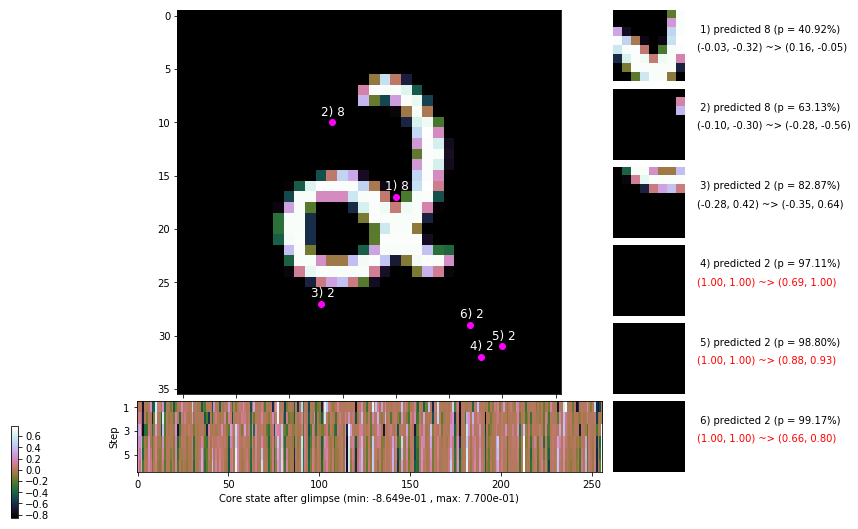

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 182.8 ms/b | lr: 1.98e-04 | grad 2norm: 12.14 | grad inf norm:  3.591
         Weights || abs max:  2.94 ( 2046.31) | mean: -6.72e-04 ( 0.01) | var: 8.80e-02 (  103.78)
          Biases || abs max:  1.51 (  163.95) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (  283.12)
                    class loss: 0.319 | steps: 2.181 | reward:  3.815 | acc.: 89.55%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 169.3 ms/b | lr: 1.98e-04 | grad 2norm: 11.89 | grad inf norm:  3.621
         Weights || abs max:  2.94 ( 2037.86) | mean: -6.78e-04 ( 0.01) | var: 8.80e-02 (  107.12)
          Biases || abs max:  1.51 (  119.83) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   85.10)
                    class loss: 0.317 | steps: 2.194 | reward:  3.819 | acc.: 89.68%

	Target class: 9 | Discounted rewards: [0.141, 1.281, 0.5

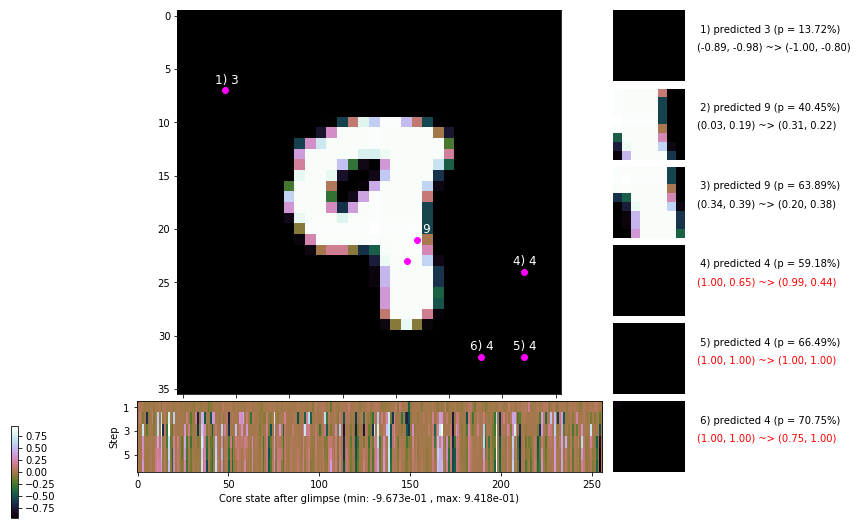

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 7 | Discounted rewards: [-0.984, -0.969, -0.938, -0.875, -0.750, -0.500]


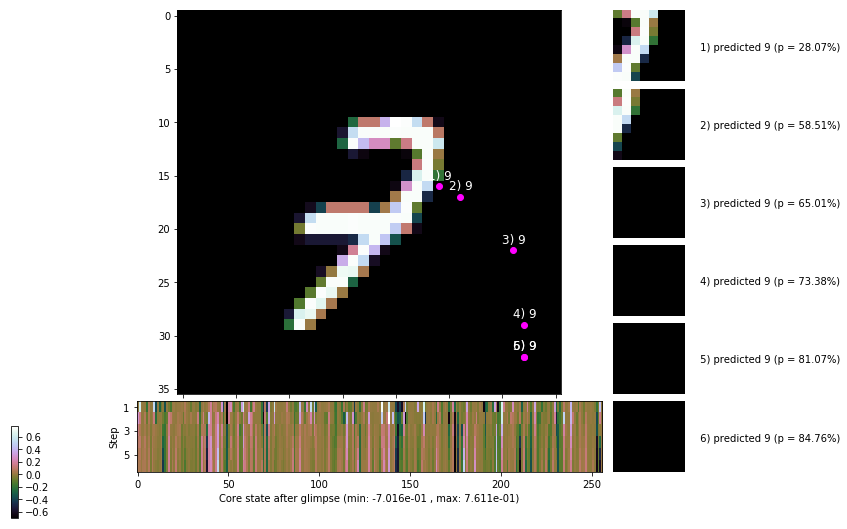


	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


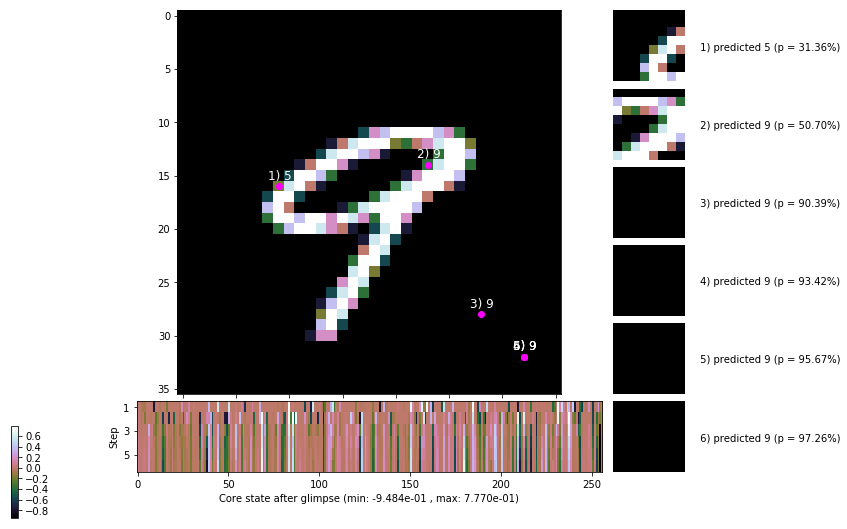

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


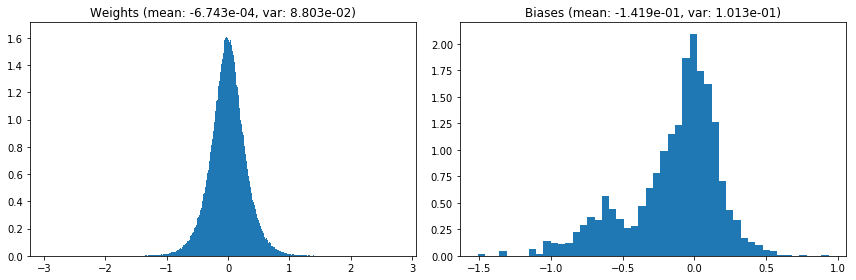

                                      Location network weights and biases


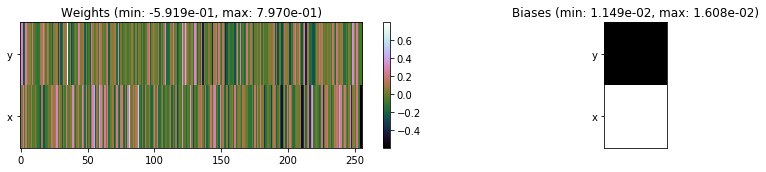

---------------------------------------------------------------------------------------------------------------
Elapsed time:  475.99 sec | TRAIN >> class loss: 0.3163 | steps:  2.188 :( | reward:  3.8064 :( | acc.: 89.502% :(
                          | VAL   >> class loss: 0.3051 | steps:  2.077 :( | reward:  4.0026 :( | acc.: 90.240% :(


Epoch 109/400) lr = 0.0001977
 b    300/  3000 >> 144.0 ms/b | lr: 1.98e-04 | grad 2norm: 12.16 | grad inf norm:  3.809
         Weights || abs max:  2.94 ( 2140.93) | mean: -6.72e-04 ( 0.01) | var: 8.80e-02 (  121.94)
          Biases || abs max:  1.51 (  198.27) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (  884.12)
                    class loss: 0.329 | steps: 2.219 | reward:  3.758 | acc.: 89.07%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 159.6 ms/b | lr: 1.97e-04 | grad 2norm: 12.34 | grad inf norm:  3.788
         Weights || abs max:  2.94 ( 2329.02) | mean: -6.73e-04 (

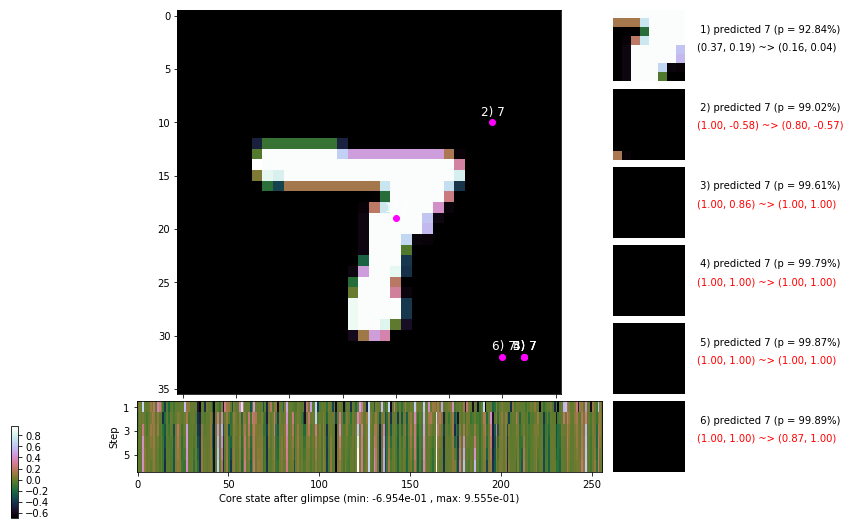

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 151.7 ms/b | lr: 1.97e-04 | grad 2norm: 12.21 | grad inf norm:  3.902
         Weights || abs max:  2.94 ( 2151.82) | mean: -6.76e-04 ( 0.01) | var: 8.80e-02 (   77.86)
          Biases || abs max:  1.51 (   79.65) | mean: -1.42e-01 ( 0.09) | var: 1.01e-01 (   22.56)
                    class loss: 0.326 | steps: 2.195 | reward:  3.807 | acc.: 89.47%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 157.9 ms/b | lr: 1.97e-04 | grad 2norm: 12.03 | grad inf norm:  3.640
         Weights || abs max:  2.94 ( 4607.24) | mean: -6.75e-04 ( 0.02) | var: 8.80e-02 ( 2256.40)
          Biases || abs max:  1.50 (  123.66) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (  112.85)
                    class loss: 0.328 | steps: 2.178 | reward:  3.833 | acc.: 89.43%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

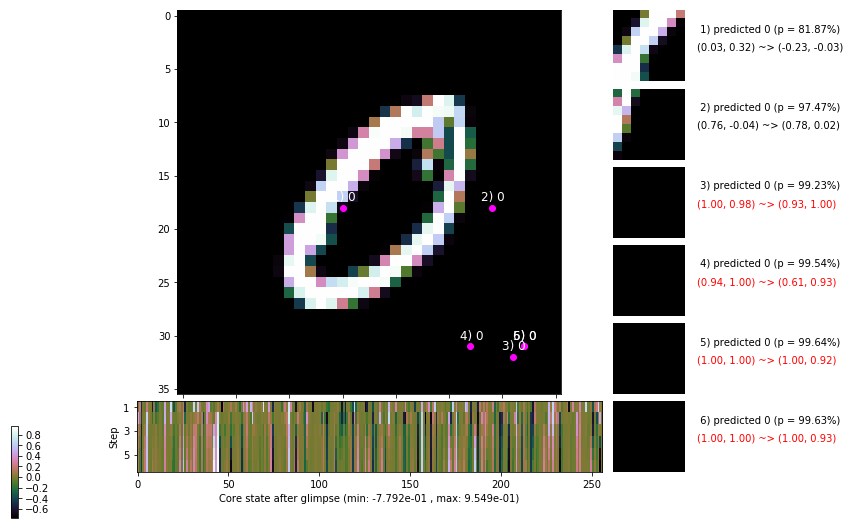

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 176.3 ms/b | lr: 1.96e-04 | grad 2norm: 12.06 | grad inf norm:  3.731
         Weights || abs max:  2.94 ( 4156.05) | mean: -6.76e-04 ( 0.01) | var: 8.81e-02 ( 1012.41)
          Biases || abs max:  1.50 (   87.35) | mean: -1.42e-01 ( 0.10) | var: 1.01e-01 (   46.89)
                    class loss: 0.324 | steps: 2.211 | reward:  3.768 | acc.: 89.20%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 158.5 ms/b | lr: 1.96e-04 | grad 2norm: 11.93 | grad inf norm:  3.497
         Weights || abs max:  2.94 ( 2262.97) | mean: -6.82e-04 ( 0.01) | var: 8.81e-02 (  149.72)
          Biases || abs max:  1.50 (  152.22) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 (  112.21)
                    class loss: 0.327 | steps: 2.207 | reward:  3.761 | acc.: 88.97%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

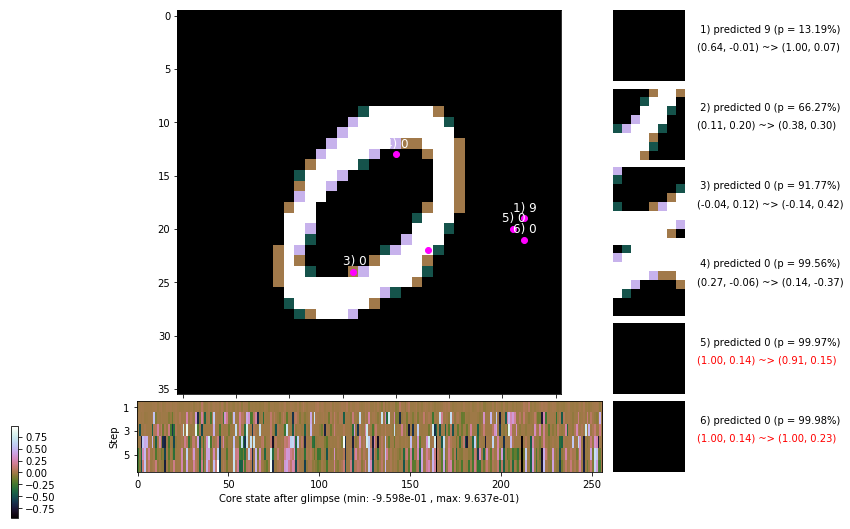

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 150.8 ms/b | lr: 1.96e-04 | grad 2norm: 12.26 | grad inf norm:  3.760
         Weights || abs max:  2.94 ( 2083.64) | mean: -6.81e-04 ( 0.01) | var: 8.81e-02 (   64.31)
          Biases || abs max:  1.50 (  265.29) | mean: -1.42e-01 ( 0.17) | var: 1.01e-01 ( 1402.10)
                    class loss: 0.340 | steps: 2.214 | reward:  3.750 | acc.: 88.57%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 151.4 ms/b | lr: 1.96e-04 | grad 2norm: 12.08 | grad inf norm:  3.712
         Weights || abs max:  2.95 ( 5377.28) | mean: -6.88e-04 ( 0.02) | var: 8.81e-02 ( 1715.64)
          Biases || abs max:  1.50 (   75.30) | mean: -1.42e-01 ( 0.09) | var: 1.01e-01 (   37.42)
                    class loss: 0.331 | steps: 2.197 | reward:  3.758 | acc.: 88.68%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

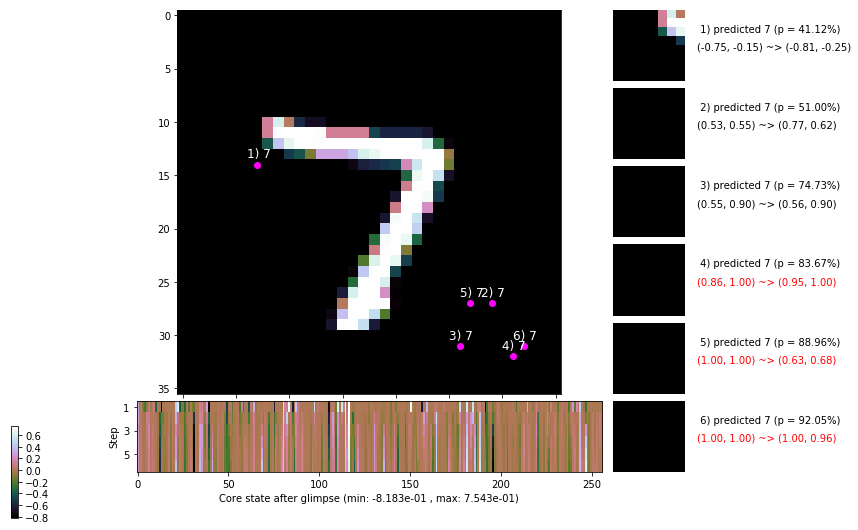

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 150.1 ms/b | lr: 1.95e-04 | grad 2norm: 12.06 | grad inf norm:  3.770
         Weights || abs max:  2.94 ( 3841.97) | mean: -6.92e-04 ( 0.01) | var: 8.81e-02 ( 4070.89)
          Biases || abs max:  1.50 (  189.47) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (  322.36)
                    class loss: 0.321 | steps: 2.183 | reward:  3.783 | acc.: 89.07%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 146.0 ms/b | lr: 1.95e-04 | grad 2norm: 12.07 | grad inf norm:  3.661
         Weights || abs max:  2.94 ( 2619.32) | mean: -6.88e-04 ( 0.01) | var: 8.81e-02 (  202.46)
          Biases || abs max:  1.50 (   71.79) | mean: -1.42e-01 ( 0.10) | var: 1.01e-01 (   25.82)
                    class loss: 0.339 | steps: 2.204 | reward:  3.771 | acc.: 89.05%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

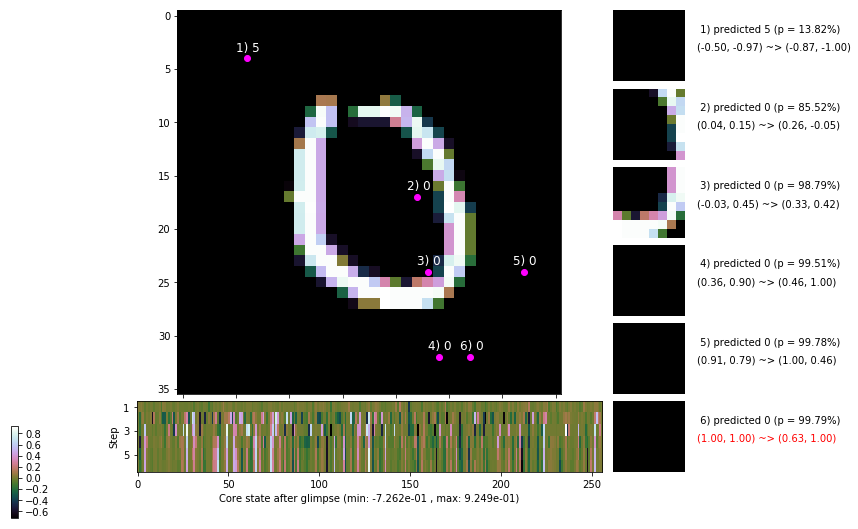

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


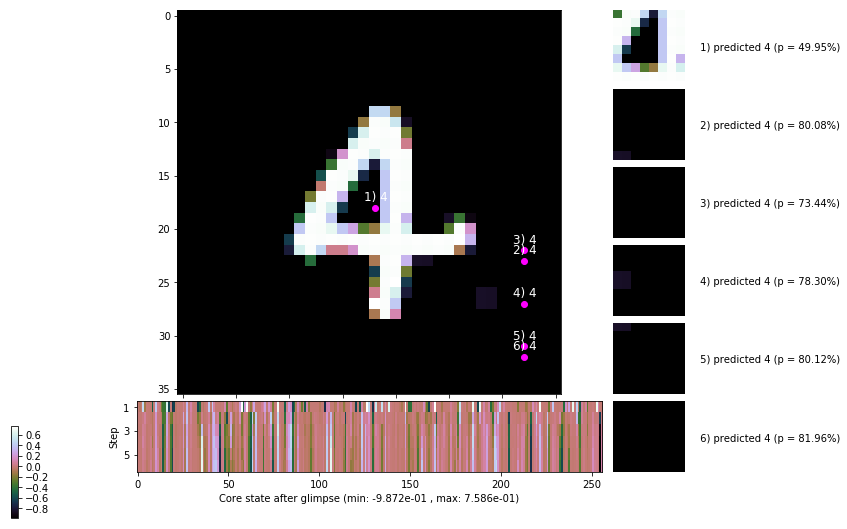


	Target class: 3 | Discounted rewards: [-0.656, -0.312, 0.375, 1.750, 1.500, 1.000]


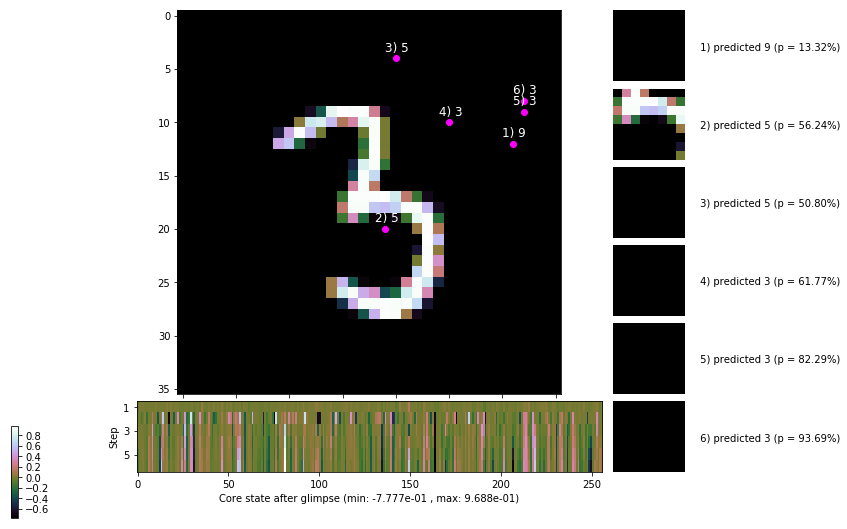

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


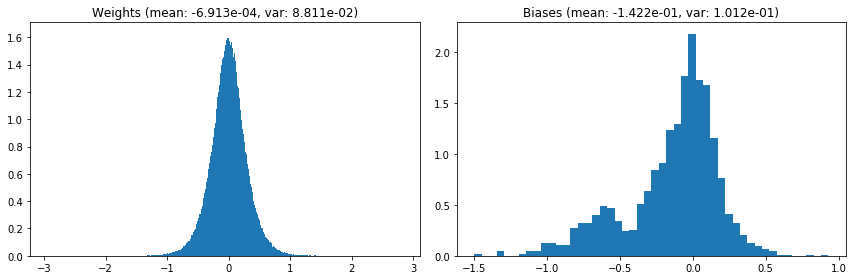

                                      Location network weights and biases


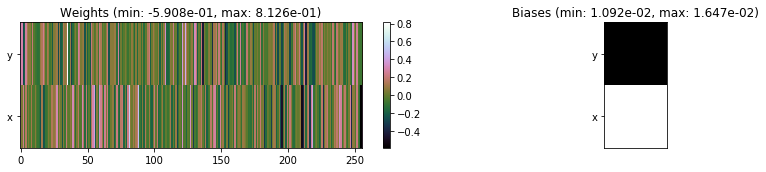

---------------------------------------------------------------------------------------------------------------
Elapsed time:  464.47 sec | TRAIN >> class loss: 0.3289 | steps:  2.198 :( | reward:  3.7775 :( | acc.: 89.037% :(
                          | VAL   >> class loss: 0.3227 | steps:  2.084 :( | reward:  3.9816 :( | acc.: 89.360% :(


Epoch 110/400) lr = 0.0001948
 b    300/  3000 >> 163.0 ms/b | lr: 1.95e-04 | grad 2norm: 12.46 | grad inf norm:  3.909
         Weights || abs max:  2.94 ( 2795.05) | mean: -6.90e-04 ( 0.01) | var: 8.81e-02 (  263.33)
          Biases || abs max:  1.50 (  222.66) | mean: -1.42e-01 ( 0.16) | var: 1.01e-01 ( 1323.44)
                    class loss: 0.350 | steps: 2.196 | reward:  3.771 | acc.: 88.28%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 148.6 ms/b | lr: 1.94e-04 | grad 2norm: 12.12 | grad inf norm:  3.736
         Weights || abs max:  2.94 ( 2503.72) | mean: -6.81e-04 (

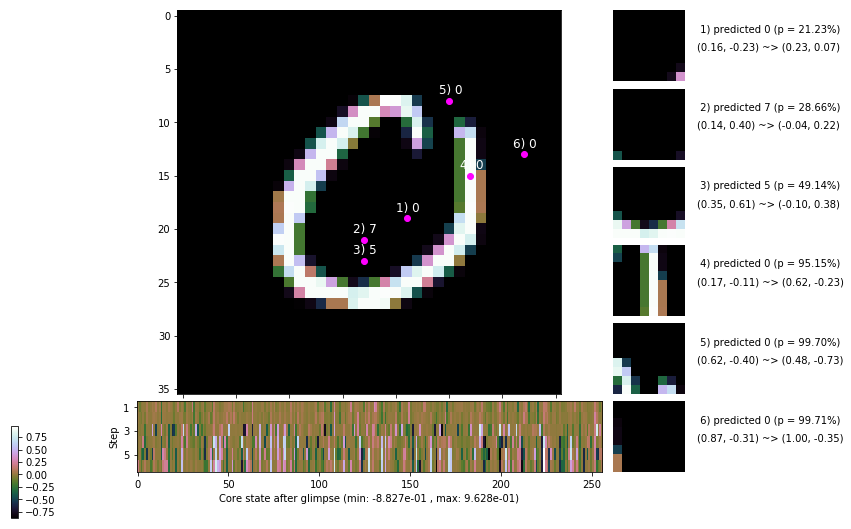

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 149.6 ms/b | lr: 1.94e-04 | grad 2norm: 12.21 | grad inf norm:  3.842
         Weights || abs max:  2.95 ( 3477.25) | mean: -6.75e-04 ( 0.01) | var: 8.81e-02 ( 1338.77)
          Biases || abs max:  1.50 (  253.73) | mean: -1.42e-01 ( 0.16) | var: 1.01e-01 ( 1027.92)
                    class loss: 0.333 | steps: 2.180 | reward:  3.800 | acc.: 89.23%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 155.2 ms/b | lr: 1.94e-04 | grad 2norm: 11.92 | grad inf norm:  3.786
         Weights || abs max:  2.95 ( 4034.06) | mean: -6.72e-04 ( 0.01) | var: 8.81e-02 (  621.91)
          Biases || abs max:  1.49 (   79.40) | mean: -1.42e-01 ( 0.11) | var: 1.01e-01 (   23.34)
                    class loss: 0.330 | steps: 2.196 | reward:  3.786 | acc.: 88.65%

	Target class: 5 | Discounted rewards: [-0.281, 0.438, 1.

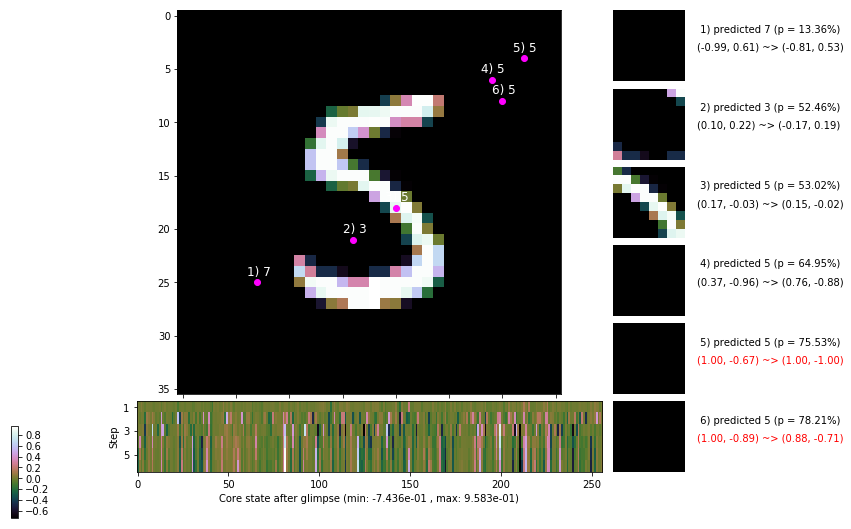

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 173.6 ms/b | lr: 1.93e-04 | grad 2norm: 12.05 | grad inf norm:  3.738
         Weights || abs max:  2.96 ( 7371.56) | mean: -6.79e-04 ( 0.02) | var: 8.81e-02 ( 6045.66)
          Biases || abs max:  1.49 (  292.89) | mean: -1.42e-01 ( 0.20) | var: 1.01e-01 (  981.84)
                    class loss: 0.322 | steps: 2.161 | reward:  3.837 | acc.: 89.00%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 179.6 ms/b | lr: 1.93e-04 | grad 2norm: 12.18 | grad inf norm:  3.876
         Weights || abs max:  2.96 ( 1962.09) | mean: -6.74e-04 ( 0.01) | var: 8.81e-02 (  185.90)
          Biases || abs max:  1.49 (  144.53) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (  120.81)
                    class loss: 0.323 | steps: 2.186 | reward:  3.811 | acc.: 89.20%

	Target class: 4 | Discounted rewards: [-0.984, -0.969, -

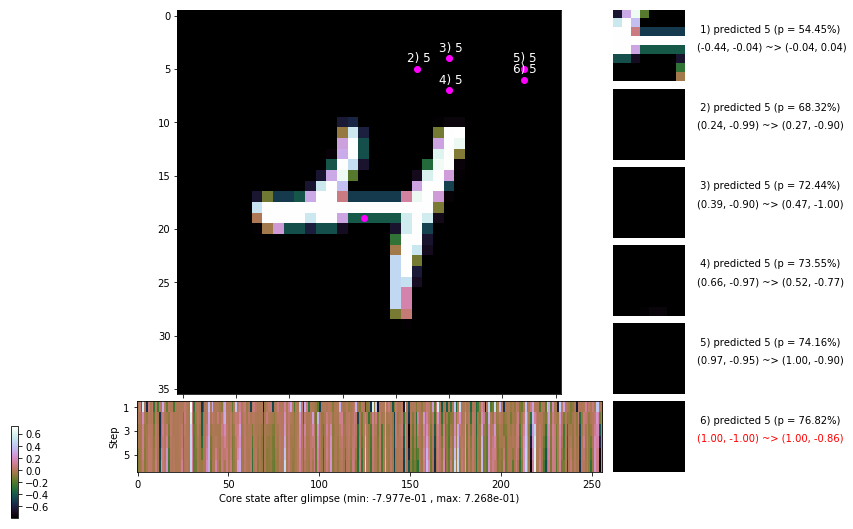

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 176.4 ms/b | lr: 1.93e-04 | grad 2norm: 12.24 | grad inf norm:  3.859
         Weights || abs max:  2.96 ( 2385.01) | mean: -6.69e-04 ( 0.01) | var: 8.82e-02 (  278.50)
          Biases || abs max:  1.49 (   91.33) | mean: -1.42e-01 ( 0.10) | var: 1.01e-01 (   15.62)
                    class loss: 0.326 | steps: 2.183 | reward:  3.795 | acc.: 88.63%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 145.3 ms/b | lr: 1.93e-04 | grad 2norm: 12.06 | grad inf norm:  3.634
         Weights || abs max:  2.95 ( 1886.24) | mean: -6.59e-04 ( 0.01) | var: 8.82e-02 (   48.53)
          Biases || abs max:  1.49 (   56.77) | mean: -1.42e-01 ( 0.09) | var: 1.01e-01 (    4.15)
                    class loss: 0.323 | steps: 2.180 | reward:  3.804 | acc.: 89.30%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

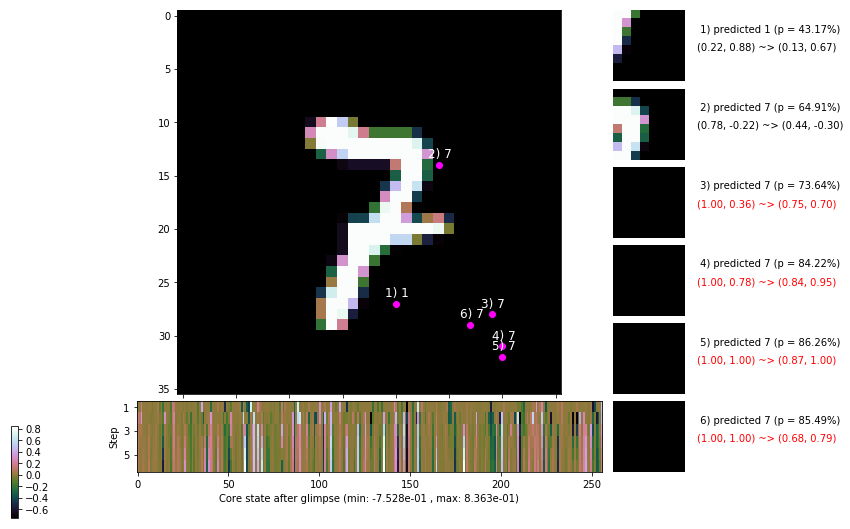

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 149.9 ms/b | lr: 1.92e-04 | grad 2norm: 12.42 | grad inf norm:  3.900
         Weights || abs max:  2.95 ( 3419.21) | mean: -6.70e-04 ( 0.01) | var: 8.82e-02 (  287.96)
          Biases || abs max:  1.49 (  122.32) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   72.28)
                    class loss: 0.349 | steps: 2.216 | reward:  3.761 | acc.: 88.83%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 139.6 ms/b | lr: 1.92e-04 | grad 2norm: 12.06 | grad inf norm:  3.588
         Weights || abs max:  2.95 ( 3693.83) | mean: -6.65e-04 ( 0.01) | var: 8.82e-02 (  981.40)
          Biases || abs max:  1.49 (  153.12) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (  469.14)
                    class loss: 0.325 | steps: 2.200 | reward:  3.781 | acc.: 88.92%

	Target class: 7 | Discounted rewards: [-0.984, -0.969, -

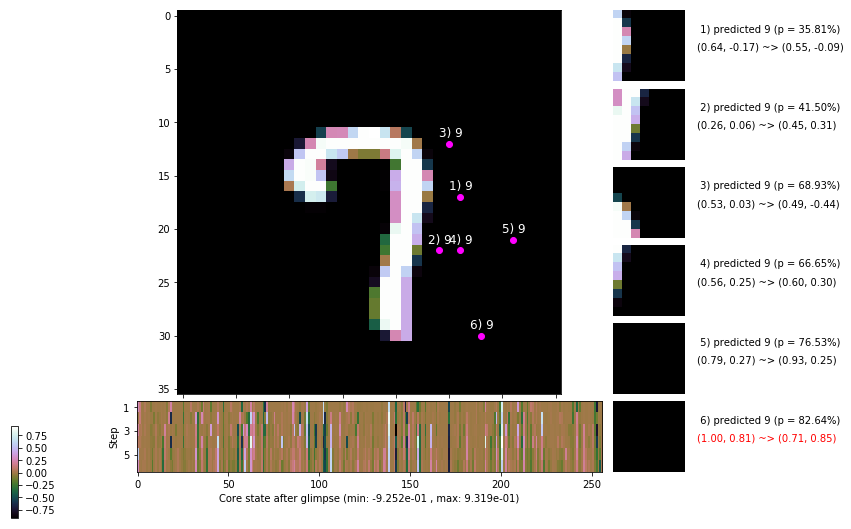

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


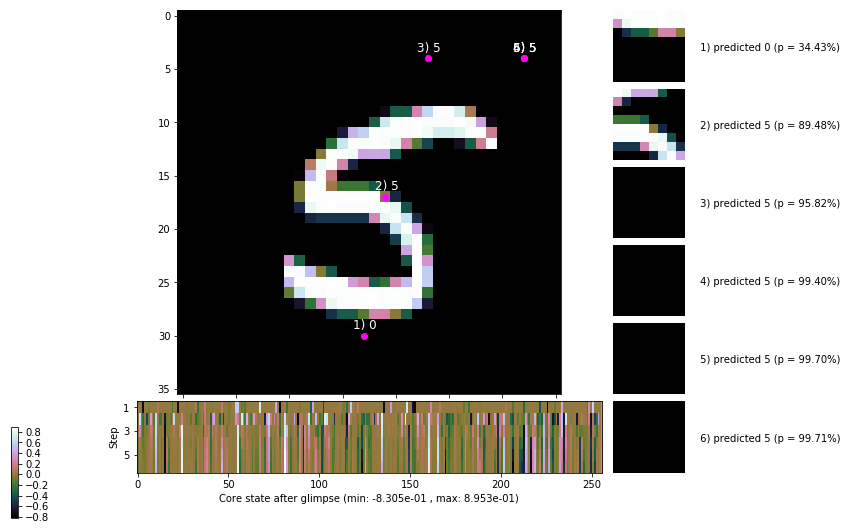


	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


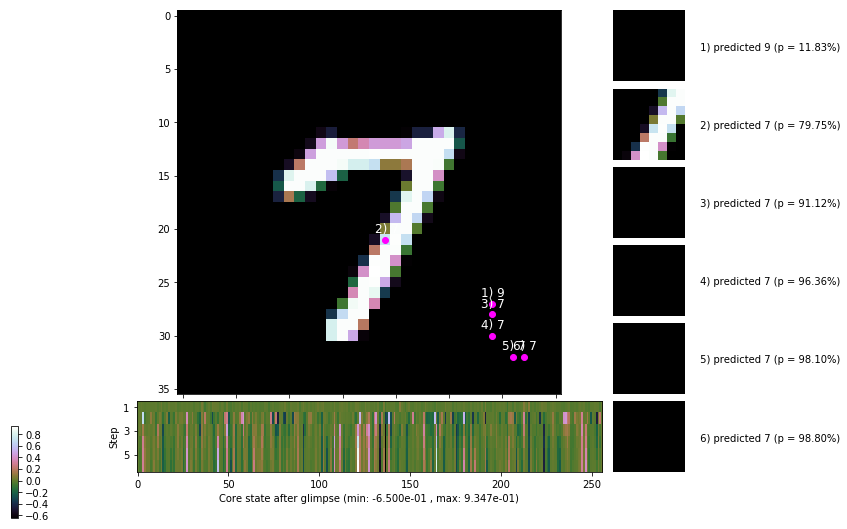

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


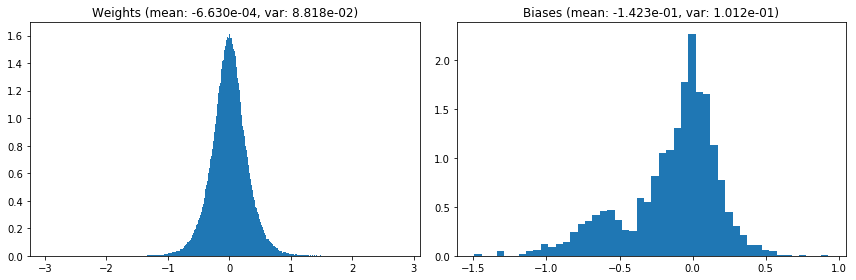

                                      Location network weights and biases


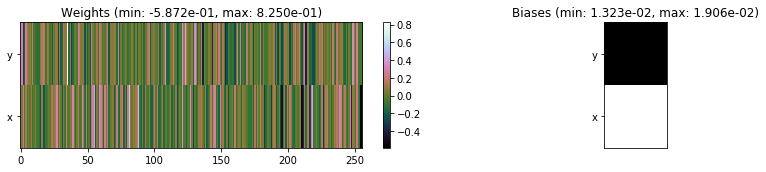

---------------------------------------------------------------------------------------------------------------
Elapsed time:  475.06 sec | TRAIN >> class loss: 0.3315 | steps:  2.187 :( | reward:  3.7935 :( | acc.: 88.860% :(
                          | VAL   >> class loss: 0.3146 | steps:  2.082 :( | reward:  3.9807 :( | acc.: 89.440% :(


Epoch 111/400) lr = 0.0001919
 b    300/  3000 >> 137.1 ms/b | lr: 1.92e-04 | grad 2norm: 11.92 | grad inf norm:  3.724
         Weights || abs max:  2.95 (12560.31) | mean: -6.70e-04 ( 0.03) | var: 8.82e-02 (51356.84)
          Biases || abs max:  1.49 (  216.40) | mean: -1.42e-01 ( 0.16) | var: 1.01e-01 (  544.16)
                    class loss: 0.329 | steps: 2.205 | reward:  3.752 | acc.: 88.98%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 147.3 ms/b | lr: 1.92e-04 | grad 2norm: 11.91 | grad inf norm:  3.649
         Weights || abs max:  2.95 ( 2111.55) | mean: -6.66e-04 (

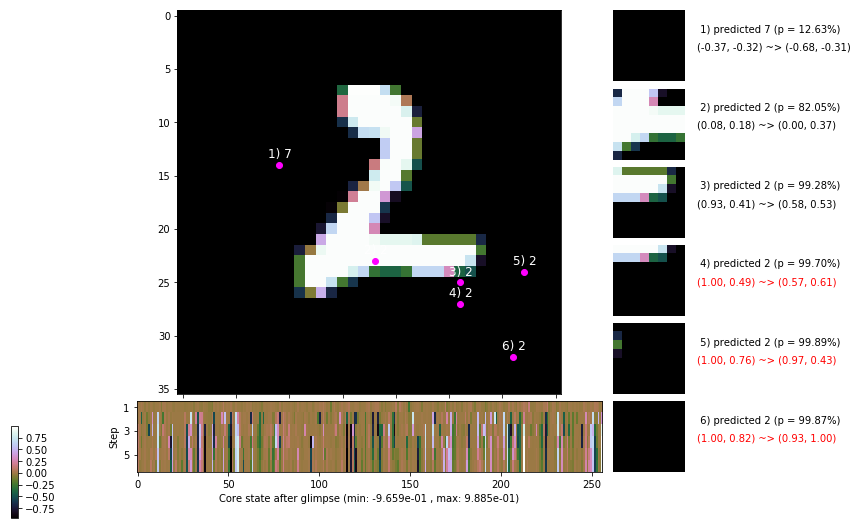

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 144.6 ms/b | lr: 1.91e-04 | grad 2norm: 12.07 | grad inf norm:  3.650
         Weights || abs max:  2.95 ( 1489.05) | mean: -6.66e-04 ( 0.01) | var: 8.82e-02 (   42.13)
          Biases || abs max:  1.50 (  269.00) | mean: -1.42e-01 ( 0.19) | var: 1.01e-01 (  852.43)
                    class loss: 0.322 | steps: 2.190 | reward:  3.785 | acc.: 88.90%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 141.4 ms/b | lr: 1.91e-04 | grad 2norm: 12.27 | grad inf norm:  3.650
         Weights || abs max:  2.95 ( 1736.06) | mean: -6.70e-04 ( 0.01) | var: 8.82e-02 (   46.03)
          Biases || abs max:  1.50 (  180.87) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 (  490.56)
                    class loss: 0.339 | steps: 2.212 | reward:  3.732 | acc.: 88.30%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

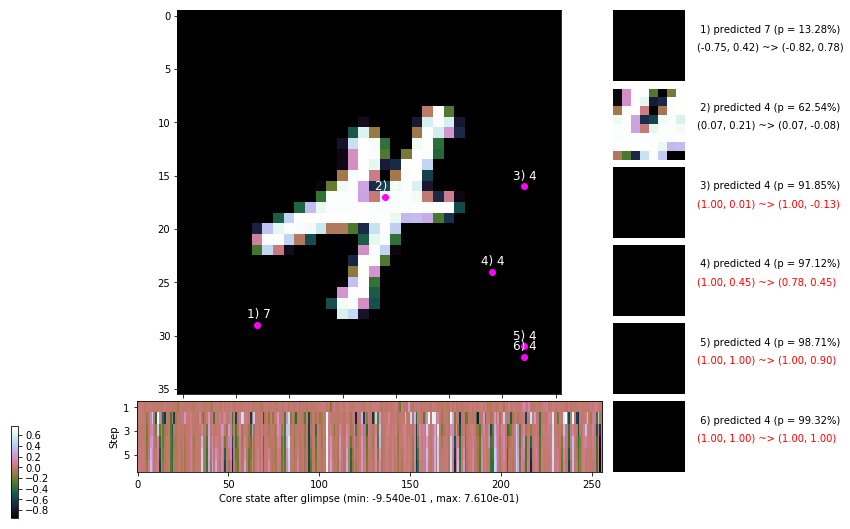

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 146.2 ms/b | lr: 1.91e-04 | grad 2norm: 12.08 | grad inf norm:  3.688
         Weights || abs max:  2.95 ( 3202.69) | mean: -6.80e-04 ( 0.01) | var: 8.82e-02 (  491.43)
          Biases || abs max:  1.50 (  137.72) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (  127.59)
                    class loss: 0.333 | steps: 2.207 | reward:  3.768 | acc.: 89.00%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 136.5 ms/b | lr: 1.90e-04 | grad 2norm: 12.19 | grad inf norm:  3.860
         Weights || abs max:  2.95 ( 1515.08) | mean: -6.71e-04 ( 0.01) | var: 8.82e-02 (   51.51)
          Biases || abs max:  1.50 ( 1660.36) | mean: -1.42e-01 ( 0.73) | var: 1.01e-01 (229568.58)
                    class loss: 0.318 | steps: 2.188 | reward:  3.777 | acc.: 88.77%

	Target class: 8 | Discounted rewards: [1.969, 1.938, 1.

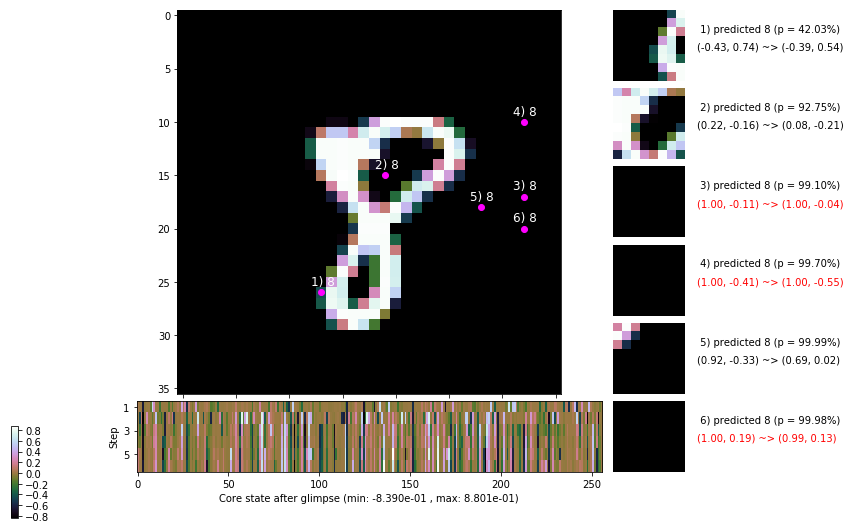

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 129.3 ms/b | lr: 1.90e-04 | grad 2norm: 12.31 | grad inf norm:  3.753
         Weights || abs max:  2.95 ( 1188.71) | mean: -6.62e-04 ( 0.01) | var: 8.82e-02 (   47.91)
          Biases || abs max:  1.50 ( 1427.89) | mean: -1.42e-01 ( 0.64) | var: 1.01e-01 (70662.87)
                    class loss: 0.323 | steps: 2.189 | reward:  3.786 | acc.: 89.05%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 138.0 ms/b | lr: 1.90e-04 | grad 2norm: 11.64 | grad inf norm:  3.486
         Weights || abs max:  2.95 ( 2081.76) | mean: -6.57e-04 ( 0.01) | var: 8.82e-02 (  114.35)
          Biases || abs max:  1.50 (  208.63) | mean: -1.42e-01 ( 0.19) | var: 1.01e-01 (   55.81)
                    class loss: 0.316 | steps: 2.202 | reward:  3.790 | acc.: 89.42%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

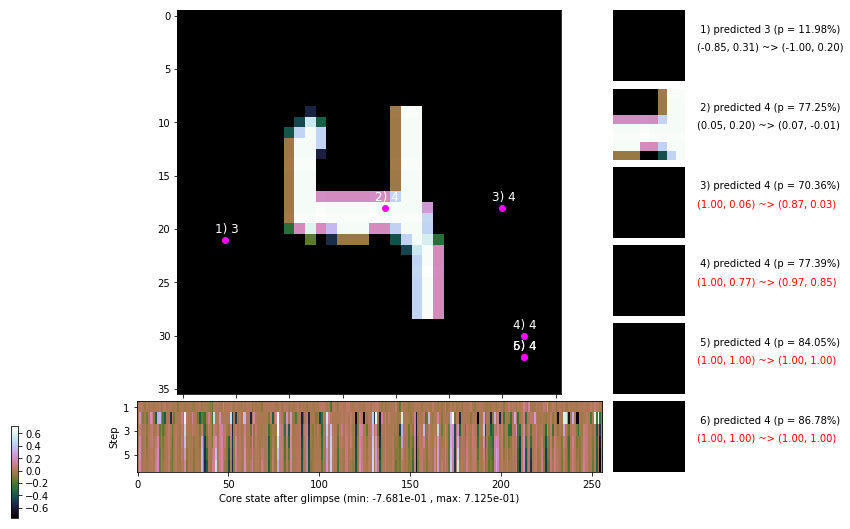

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 140.1 ms/b | lr: 1.89e-04 | grad 2norm: 12.12 | grad inf norm:  3.590
         Weights || abs max:  2.95 ( 4170.27) | mean: -6.53e-04 ( 0.02) | var: 8.83e-02 (  356.29)
          Biases || abs max:  1.50 (  663.43) | mean: -1.42e-01 ( 0.38) | var: 1.01e-01 ( 4050.64)
                    class loss: 0.334 | steps: 2.188 | reward:  3.800 | acc.: 88.82%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 134.1 ms/b | lr: 1.89e-04 | grad 2norm: 12.33 | grad inf norm:  3.931
         Weights || abs max:  2.95 ( 4430.85) | mean: -6.45e-04 ( 0.02) | var: 8.83e-02 (  826.46)
          Biases || abs max:  1.50 (  163.99) | mean: -1.42e-01 ( 0.16) | var: 1.01e-01 (  618.06)
                    class loss: 0.334 | steps: 2.179 | reward:  3.790 | acc.: 88.80%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

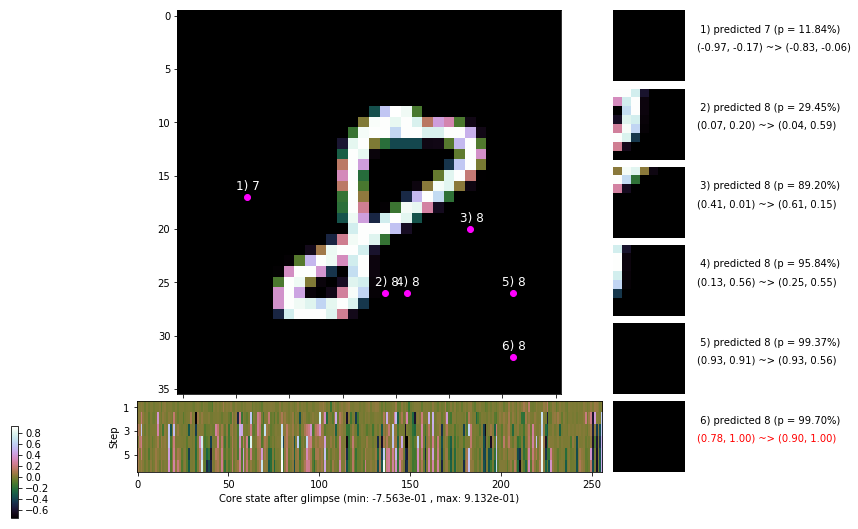

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


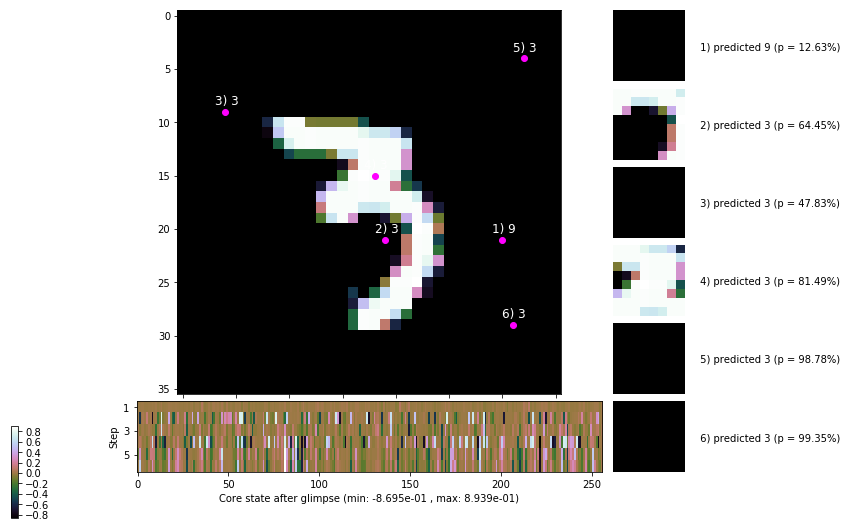


	Target class: 9 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


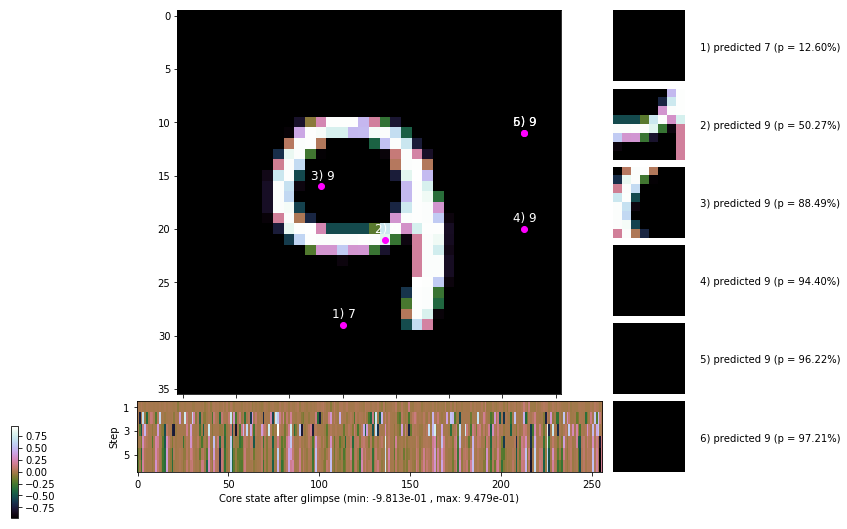

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


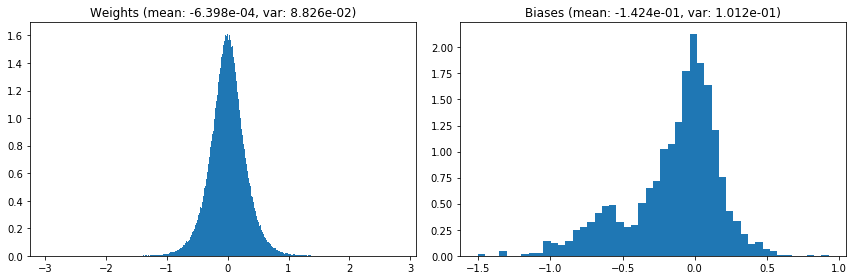

                                      Location network weights and biases


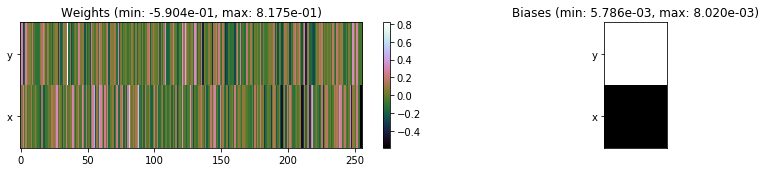

---------------------------------------------------------------------------------------------------------------
Elapsed time:  419.05 sec | TRAIN >> class loss: 0.3257 | steps:  2.193 :( | reward:  3.7796 :( | acc.: 88.947% :(
                          | VAL   >> class loss: 0.2813 | steps:  2.084 :( | reward:  3.9981 :( | acc.: 89.900% :(


Epoch 112/400) lr = 0.000189
 b    300/  3000 >> 131.9 ms/b | lr: 1.89e-04 | grad 2norm: 11.92 | grad inf norm:  3.636
         Weights || abs max:  2.95 ( 1926.80) | mean: -6.40e-04 ( 0.01) | var: 8.83e-02 (   56.98)
          Biases || abs max:  1.50 (  278.01) | mean: -1.42e-01 ( 0.18) | var: 1.01e-01 ( 4221.67)
                    class loss: 0.311 | steps: 2.152 | reward:  3.845 | acc.: 89.85%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 134.2 ms/b | lr: 1.89e-04 | grad 2norm: 11.92 | grad inf norm:  3.672
         Weights || abs max:  2.95 ( 1479.36) | mean: -6.32e-04 ( 

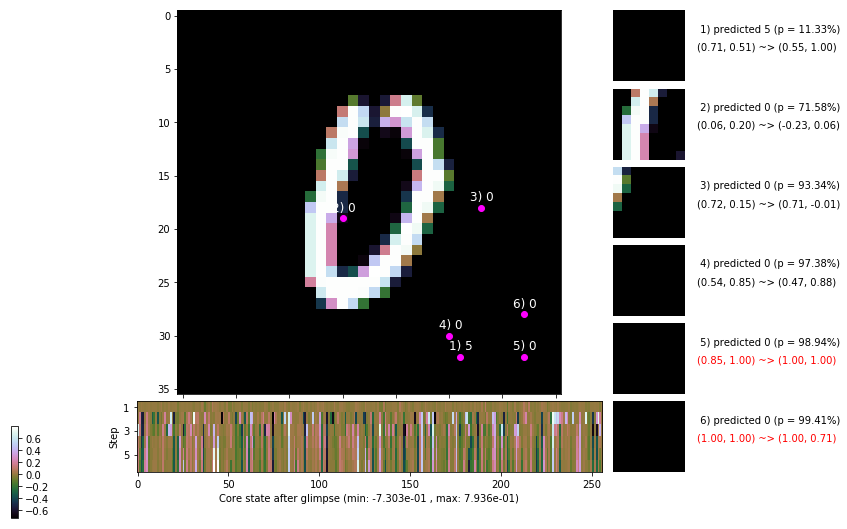

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 132.4 ms/b | lr: 1.88e-04 | grad 2norm: 12.24 | grad inf norm:  3.716
         Weights || abs max:  2.95 ( 2776.26) | mean: -6.18e-04 ( 0.01) | var: 8.83e-02 (  610.20)
          Biases || abs max:  1.51 (  184.43) | mean: -1.43e-01 ( 0.16) | var: 1.01e-01 (  681.26)
                    class loss: 0.335 | steps: 2.197 | reward:  3.779 | acc.: 88.87%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 128.6 ms/b | lr: 1.88e-04 | grad 2norm: 11.79 | grad inf norm:  3.550
         Weights || abs max:  2.95 ( 2596.23) | mean: -6.12e-04 ( 0.01) | var: 8.83e-02 (  144.22)
          Biases || abs max:  1.50 (  189.19) | mean: -1.43e-01 ( 0.17) | var: 1.01e-01 (  180.17)
                    class loss: 0.321 | steps: 2.167 | reward:  3.810 | acc.: 89.43%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

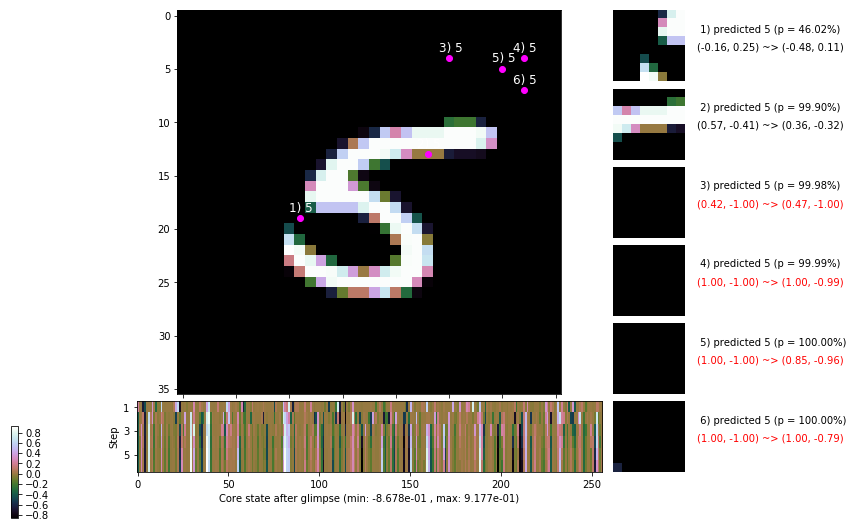

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 122.6 ms/b | lr: 1.88e-04 | grad 2norm: 11.73 | grad inf norm:  3.726
         Weights || abs max:  2.95 ( 2892.08) | mean: -6.20e-04 ( 0.01) | var: 8.83e-02 (  237.26)
          Biases || abs max:  1.50 (  116.04) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (   36.26)
                    class loss: 0.302 | steps: 2.175 | reward:  3.835 | acc.: 89.65%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 125.2 ms/b | lr: 1.88e-04 | grad 2norm: 11.76 | grad inf norm:  3.583
         Weights || abs max:  2.95 ( 3237.10) | mean: -6.23e-04 ( 0.01) | var: 8.83e-02 (  136.68)
          Biases || abs max:  1.50 (  521.11) | mean: -1.42e-01 ( 0.30) | var: 1.01e-01 ( 4111.60)
                    class loss: 0.304 | steps: 2.169 | reward:  3.861 | acc.: 89.72%

	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.8

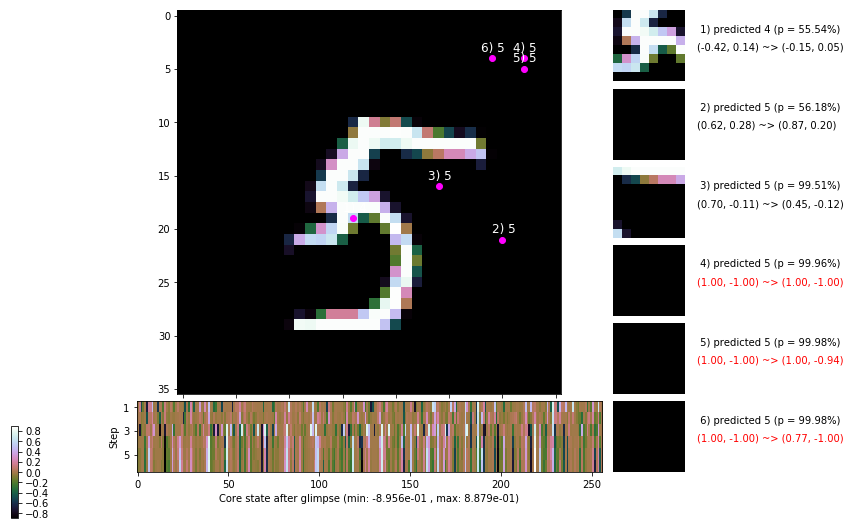

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 126.9 ms/b | lr: 1.87e-04 | grad 2norm: 12.01 | grad inf norm:  3.687
         Weights || abs max:  2.95 ( 5384.20) | mean: -6.21e-04 ( 0.02) | var: 8.83e-02 ( 2627.16)
          Biases || abs max:  1.50 (  250.14) | mean: -1.42e-01 ( 0.20) | var: 1.01e-01 (  641.11)
                    class loss: 0.330 | steps: 2.181 | reward:  3.806 | acc.: 88.90%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 146.3 ms/b | lr: 1.87e-04 | grad 2norm: 12.30 | grad inf norm:  3.886
         Weights || abs max:  2.95 ( 1635.54) | mean: -6.22e-04 ( 0.01) | var: 8.83e-02 (   60.88)
          Biases || abs max:  1.50 (  157.60) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 (   62.51)
                    class loss: 0.346 | steps: 2.226 | reward:  3.740 | acc.: 88.33%

	Target class: 3 | Discounted rewards: [-0.609, -0.219, 0

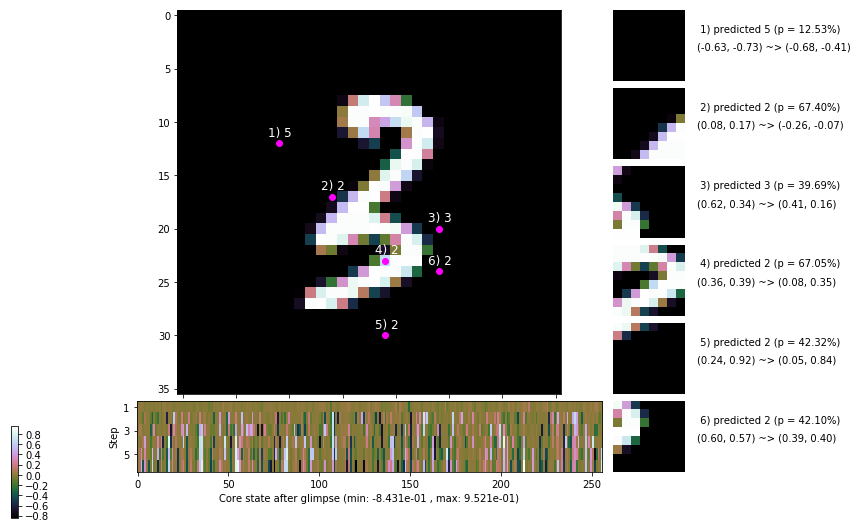

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 235.8 ms/b | lr: 1.87e-04 | grad 2norm: 11.89 | grad inf norm:  3.553
         Weights || abs max:  2.95 ( 3631.17) | mean: -6.32e-04 ( 0.01) | var: 8.83e-02 (  561.32)
          Biases || abs max:  1.50 (   91.14) | mean: -1.42e-01 ( 0.11) | var: 1.01e-01 (   10.02)
                    class loss: 0.327 | steps: 2.187 | reward:  3.801 | acc.: 89.02%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 253.1 ms/b | lr: 1.86e-04 | grad 2norm: 12.05 | grad inf norm:  3.669
         Weights || abs max:  2.95 (58869.12) | mean: -6.36e-04 ( 0.11) | var: 8.83e-02 (1751064.25)
          Biases || abs max:  1.50 (  192.49) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 ( 1771.27)
                    class loss: 0.338 | steps: 2.187 | reward:  3.789 | acc.: 88.87%

	Target class: 2 | Discounted rewards: [-0.984, -0.969,

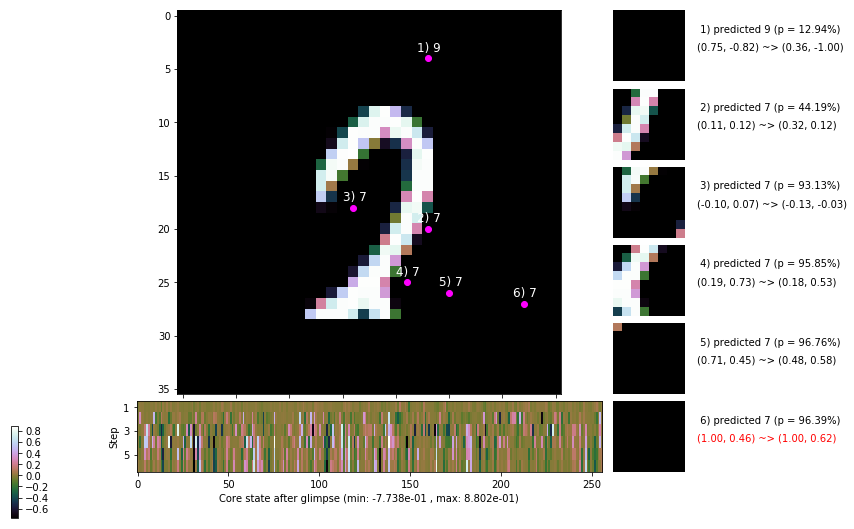

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


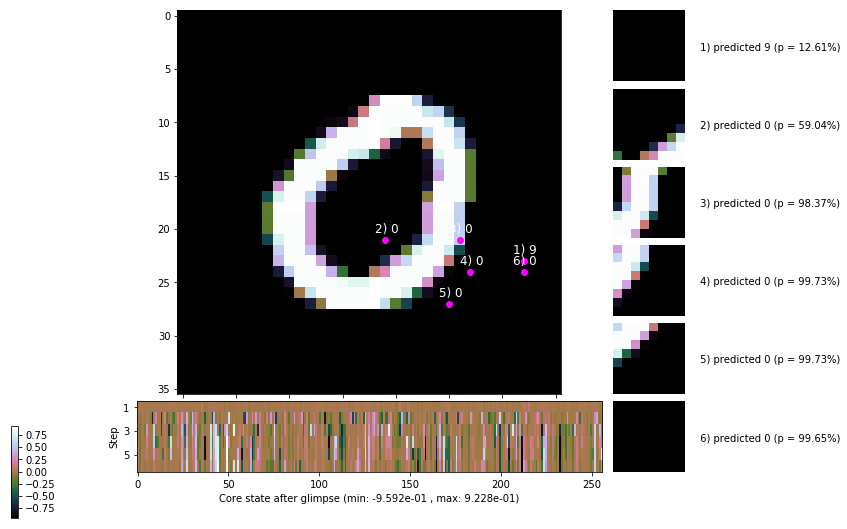


	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


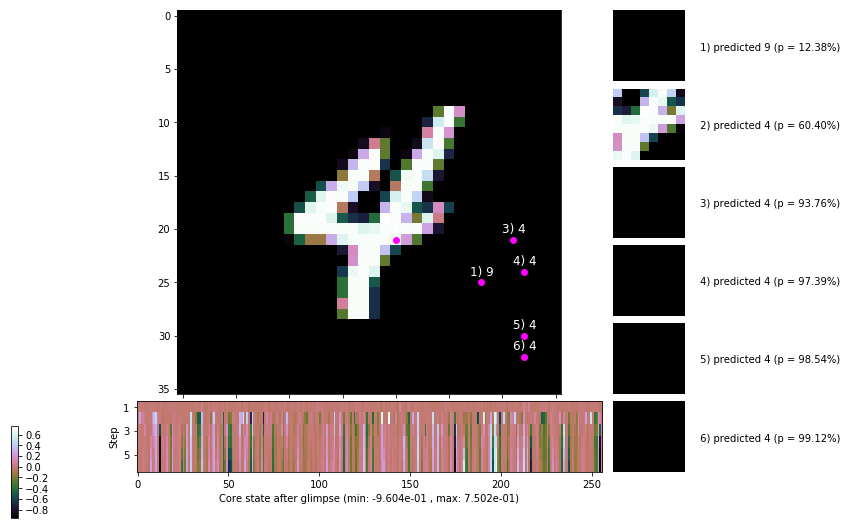

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


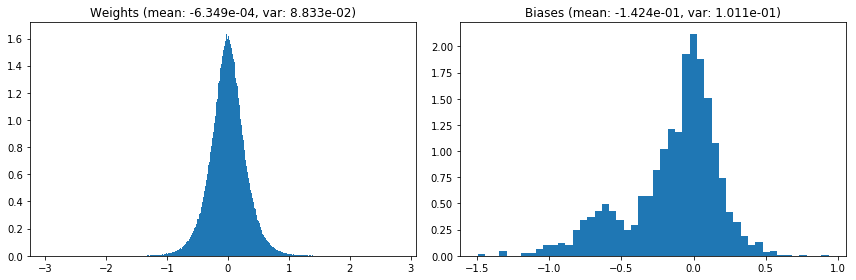

                                      Location network weights and biases


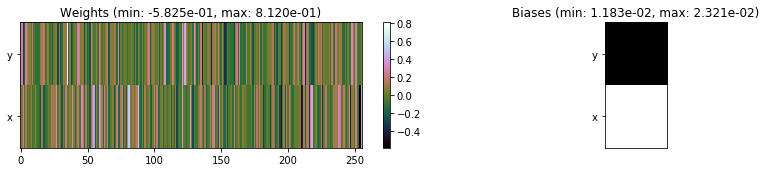

---------------------------------------------------------------------------------------------------------------
Elapsed time:  462.94 sec | TRAIN >> class loss: 0.3236 | steps:  2.178    | reward:  3.8118 :( | acc.: 89.163% :(
                          | VAL   >> class loss: 0.3154 | steps:  2.089 :( | reward:  3.9873 :( | acc.: 89.220% :(


Epoch 113/400) lr = 0.0001862
 b    300/  3000 >> 241.7 ms/b | lr: 1.86e-04 | grad 2norm: 12.25 | grad inf norm:  3.746
         Weights || abs max:  2.95 ( 2504.60) | mean: -6.28e-04 ( 0.01) | var: 8.83e-02 (  149.87)
          Biases || abs max:  1.50 (  670.24) | mean: -1.42e-01 ( 0.53) | var: 1.01e-01 (44301.16)
                    class loss: 0.343 | steps: 2.205 | reward:  3.744 | acc.: 88.42%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 248.2 ms/b | lr: 1.86e-04 | grad 2norm: 11.98 | grad inf norm:  3.608
         Weights || abs max:  2.95 ( 5286.67) | mean: -6.24e-04 (

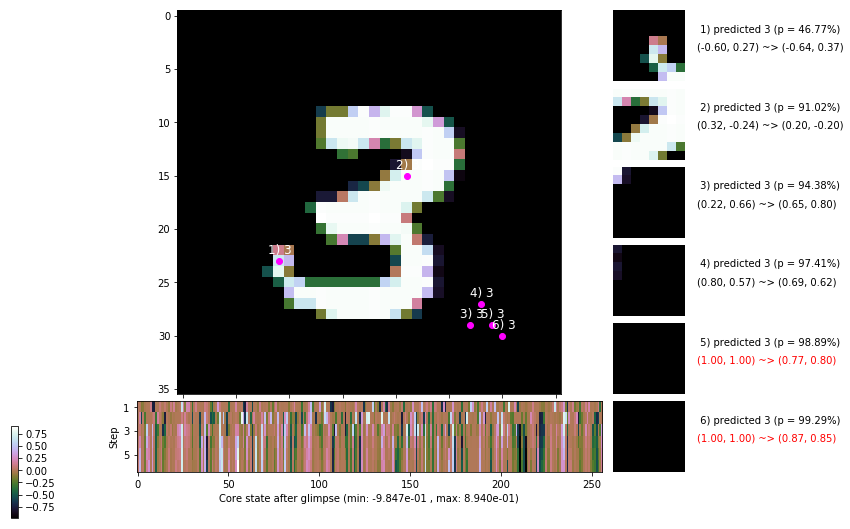

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 261.1 ms/b | lr: 1.85e-04 | grad 2norm: 12.10 | grad inf norm:  3.765
         Weights || abs max:  2.95 ( 2836.73) | mean: -6.16e-04 ( 0.01) | var: 8.83e-02 (  184.22)
          Biases || abs max:  1.50 (   64.07) | mean: -1.42e-01 ( 0.09) | var: 1.01e-01 (   36.64)
                    class loss: 0.322 | steps: 2.202 | reward:  3.761 | acc.: 88.87%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 221.9 ms/b | lr: 1.85e-04 | grad 2norm: 12.44 | grad inf norm:  3.904
         Weights || abs max:  2.95 ( 2723.42) | mean: -6.08e-04 ( 0.01) | var: 8.84e-02 (  232.90)
          Biases || abs max:  1.50 (   51.72) | mean: -1.42e-01 ( 0.08) | var: 1.01e-01 (   12.06)
                    class loss: 0.337 | steps: 2.207 | reward:  3.754 | acc.: 88.60%

	Target class: 3 | Discounted rewards: [0.469, 1.938, 1.8

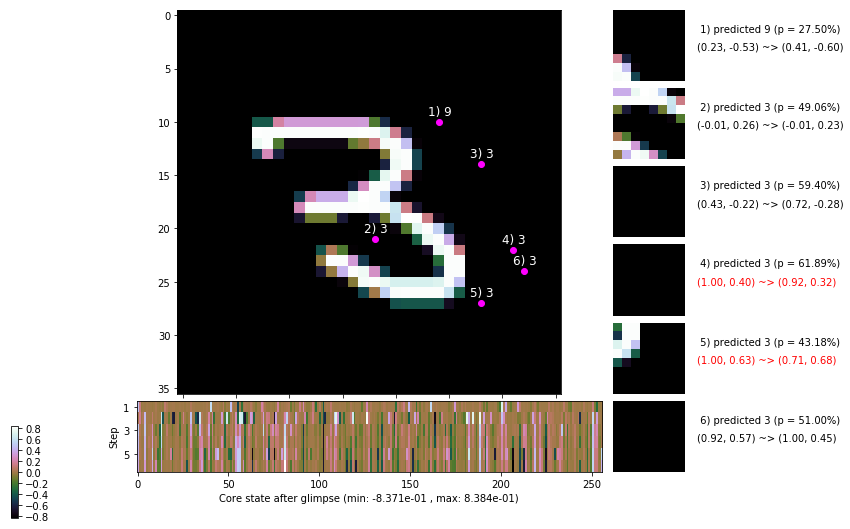

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 219.5 ms/b | lr: 1.85e-04 | grad 2norm: 12.01 | grad inf norm:  3.541
         Weights || abs max:  2.95 ( 2177.55) | mean: -5.98e-04 ( 0.01) | var: 8.84e-02 (  140.14)
          Biases || abs max:  1.50 (  632.13) | mean: -1.42e-01 ( 0.32) | var: 1.01e-01 (26962.48)
                    class loss: 0.332 | steps: 2.174 | reward:  3.808 | acc.: 88.78%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 224.4 ms/b | lr: 1.85e-04 | grad 2norm: 12.07 | grad inf norm:  3.724
         Weights || abs max:  2.95 ( 1004.97) | mean: -6.06e-04 ( 0.01) | var: 8.84e-02 (   12.99)
          Biases || abs max:  1.50 (  100.55) | mean: -1.43e-01 ( 0.10) | var: 1.01e-01 (   44.76)
                    class loss: 0.334 | steps: 2.189 | reward:  3.775 | acc.: 88.33%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

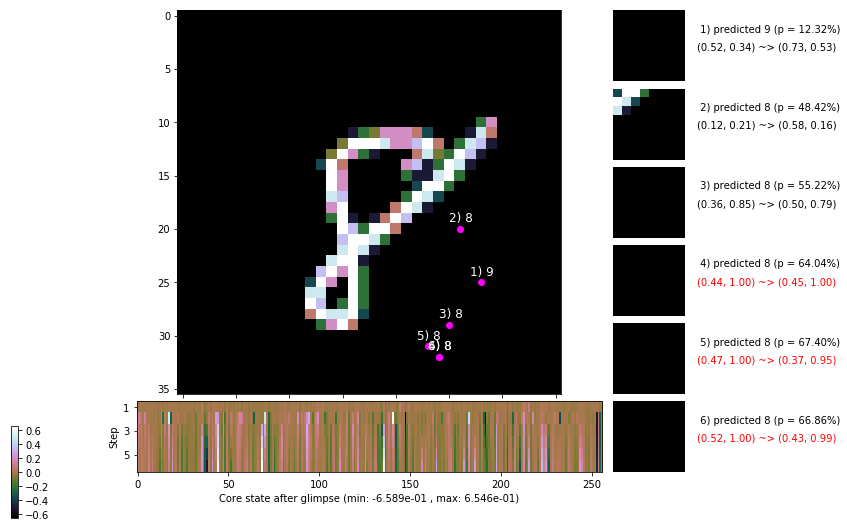

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 130.5 ms/b | lr: 1.84e-04 | grad 2norm: 12.31 | grad inf norm:  3.670
         Weights || abs max:  2.96 ( 5188.17) | mean: -6.04e-04 ( 0.02) | var: 8.84e-02 ( 2049.85)
          Biases || abs max:  1.50 (   96.76) | mean: -1.43e-01 ( 0.11) | var: 1.01e-01 (   79.15)
                    class loss: 0.334 | steps: 2.188 | reward:  3.763 | acc.: 88.40%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 119.6 ms/b | lr: 1.84e-04 | grad 2norm: 12.08 | grad inf norm:  3.770
         Weights || abs max:  2.95 ( 2853.51) | mean: -5.95e-04 ( 0.01) | var: 8.84e-02 (  146.54)
          Biases || abs max:  1.50 (   97.26) | mean: -1.43e-01 ( 0.11) | var: 1.01e-01 (   39.85)
                    class loss: 0.315 | steps: 2.159 | reward:  3.857 | acc.: 89.77%

	Target class: 0 | Discounted rewards: [1.266, 0.531, -0.

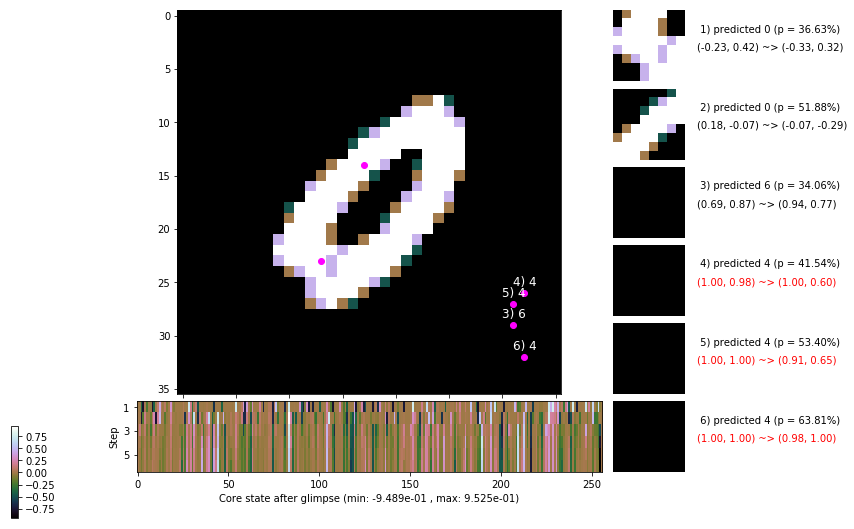

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 121.7 ms/b | lr: 1.84e-04 | grad 2norm: 12.17 | grad inf norm:  3.740
         Weights || abs max:  2.95 ( 2837.44) | mean: -5.98e-04 ( 0.01) | var: 8.84e-02 (  435.68)
          Biases || abs max:  1.50 (  176.77) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (  261.25)
                    class loss: 0.336 | steps: 2.244 | reward:  3.735 | acc.: 88.90%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 121.7 ms/b | lr: 1.84e-04 | grad 2norm: 12.00 | grad inf norm:  3.752
         Weights || abs max:  2.95 ( 2471.79) | mean: -5.92e-04 ( 0.01) | var: 8.84e-02 (  239.04)
          Biases || abs max:  1.50 (  131.98) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (   77.66)
                    class loss: 0.312 | steps: 2.179 | reward:  3.824 | acc.: 89.57%

	Target class: 2 | Discounted rewards: [-0.281, 0.438, 1.

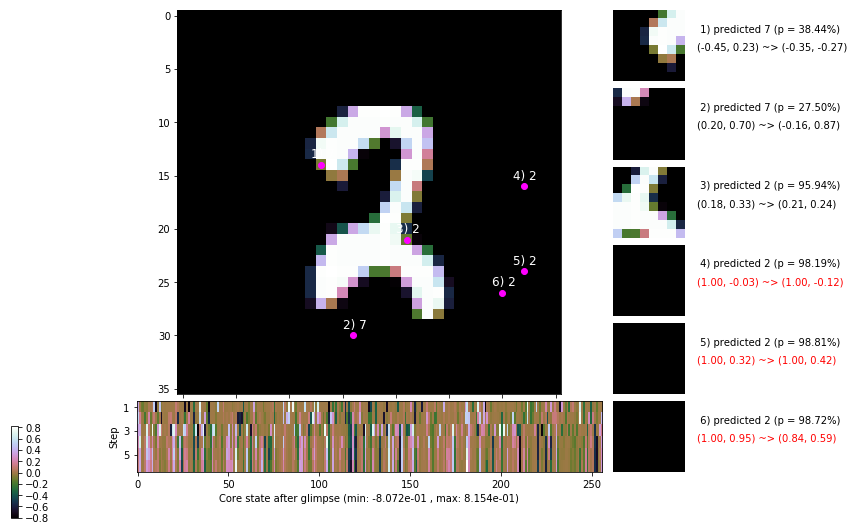

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


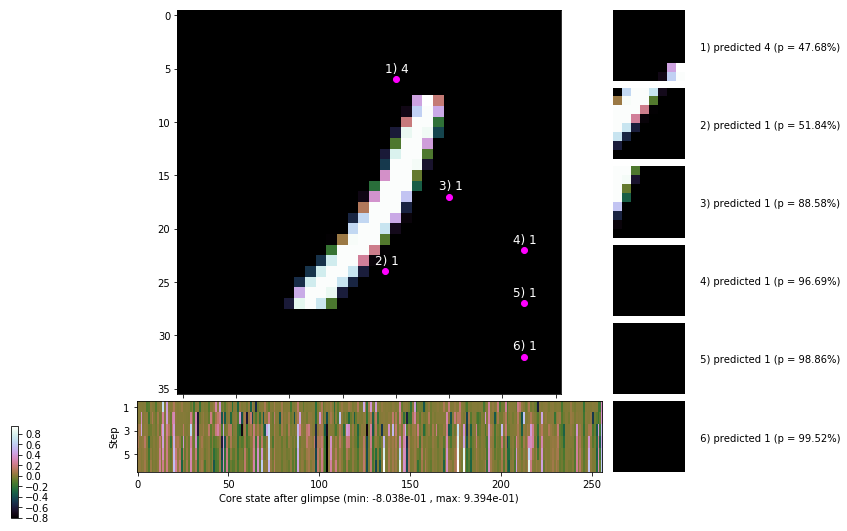


	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


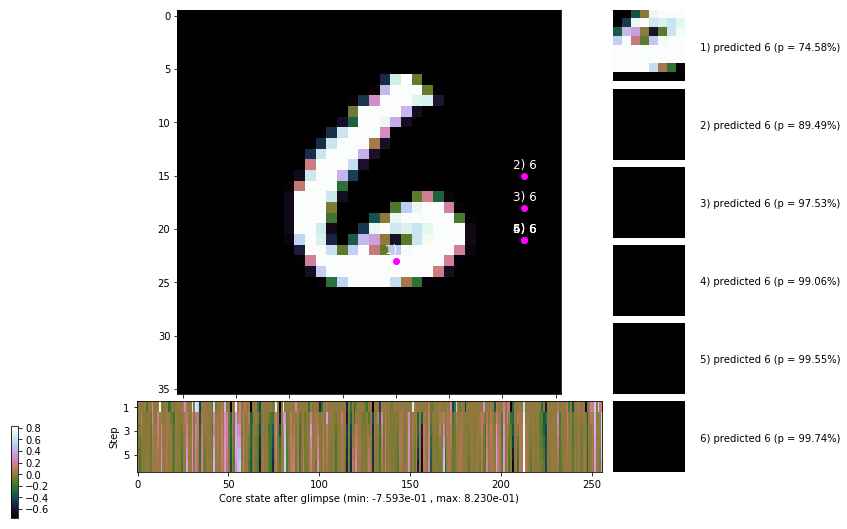

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


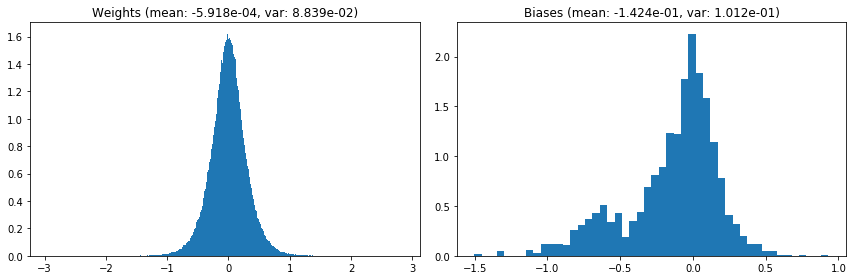

                                      Location network weights and biases


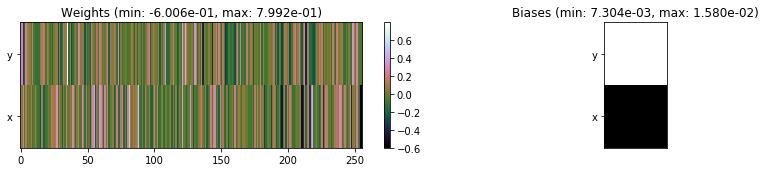

---------------------------------------------------------------------------------------------------------------
Elapsed time:  573.61 sec | TRAIN >> class loss: 0.3288 | steps:  2.194 :( | reward:  3.7804 :( | acc.: 88.810% :(
                          | VAL   >> class loss: 0.2821 | steps:  2.060 :( | reward:  4.0659    | acc.: 90.980% 


Epoch 114/400) lr = 0.0001834
 b    300/  3000 >> 134.9 ms/b | lr: 1.83e-04 | grad 2norm: 12.27 | grad inf norm:  3.825
         Weights || abs max:  2.95 ( 2227.08) | mean: -5.91e-04 ( 0.01) | var: 8.84e-02 (  139.92)
          Biases || abs max:  1.50 (  111.64) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (  122.63)
                    class loss: 0.340 | steps: 2.223 | reward:  3.704 | acc.: 88.17%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 124.5 ms/b | lr: 1.83e-04 | grad 2norm: 12.22 | grad inf norm:  3.932
         Weights || abs max:  2.95 ( 1947.21) | mean: -5.90e-04 ( 0

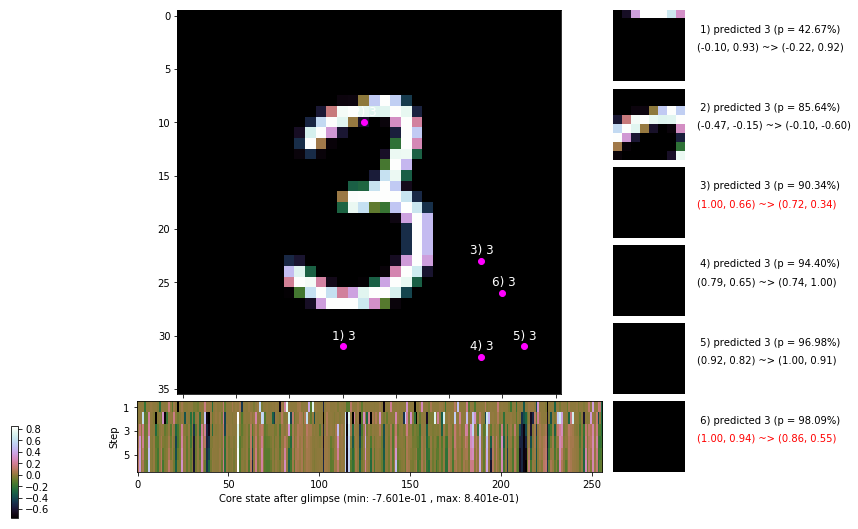

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 155.9 ms/b | lr: 1.83e-04 | grad 2norm: 12.23 | grad inf norm:  3.781
         Weights || abs max:  2.95 ( 1994.02) | mean: -5.90e-04 ( 0.01) | var: 8.84e-02 (  415.63)
          Biases || abs max:  1.51 (  164.18) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 (  501.36)
                    class loss: 0.328 | steps: 2.188 | reward:  3.792 | acc.: 88.87%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 230.8 ms/b | lr: 1.83e-04 | grad 2norm: 11.91 | grad inf norm:  3.602
         Weights || abs max:  2.95 ( 3439.97) | mean: -5.87e-04 ( 0.01) | var: 8.84e-02 (  329.45)
          Biases || abs max:  1.51 ( 1101.17) | mean: -1.42e-01 ( 0.52) | var: 1.01e-01 (73791.12)
                    class loss: 0.315 | steps: 2.161 | reward:  3.835 | acc.: 89.30%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.8

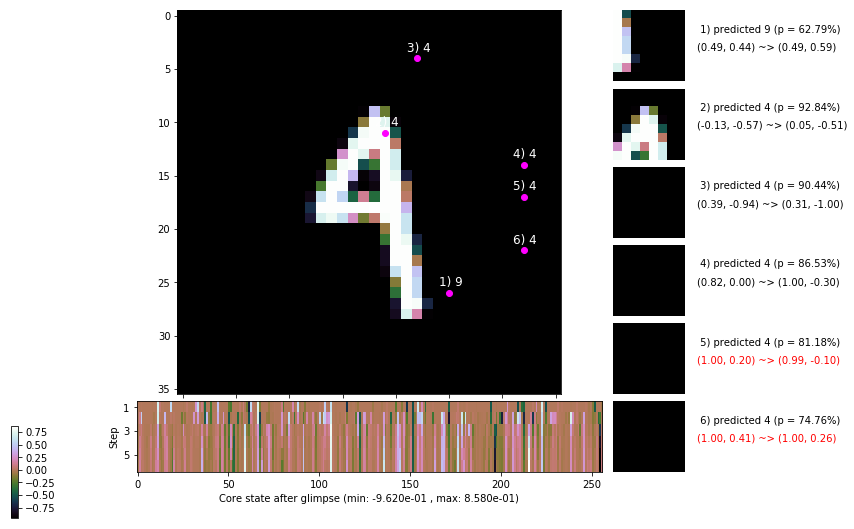

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 246.7 ms/b | lr: 1.82e-04 | grad 2norm: 12.20 | grad inf norm:  3.795
         Weights || abs max:  2.95 ( 1212.22) | mean: -5.90e-04 ( 0.01) | var: 8.84e-02 (   14.48)
          Biases || abs max:  1.51 (  117.61) | mean: -1.42e-01 ( 0.12) | var: 1.01e-01 (   43.66)
                    class loss: 0.323 | steps: 2.206 | reward:  3.788 | acc.: 89.15%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 226.7 ms/b | lr: 1.82e-04 | grad 2norm: 11.92 | grad inf norm:  3.764
         Weights || abs max:  2.95 (10970.21) | mean: -5.85e-04 ( 0.03) | var: 8.84e-02 (37856.58)
          Biases || abs max:  1.50 (  131.17) | mean: -1.43e-01 ( 0.12) | var: 1.01e-01 (  143.81)
                    class loss: 0.315 | steps: 2.176 | reward:  3.813 | acc.: 89.27%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

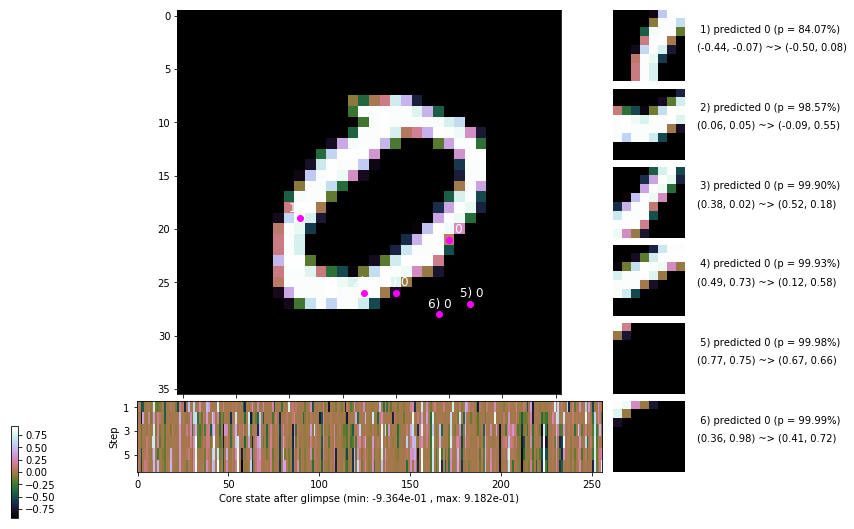

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 156.6 ms/b | lr: 1.82e-04 | grad 2norm: 12.14 | grad inf norm:  3.815
         Weights || abs max:  2.95 ( 4535.52) | mean: -5.81e-04 ( 0.02) | var: 8.84e-02 ( 1068.16)
          Biases || abs max:  1.50 (  123.99) | mean: -1.43e-01 ( 0.12) | var: 1.01e-01 (  124.92)
                    class loss: 0.308 | steps: 2.161 | reward:  3.828 | acc.: 89.45%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 129.5 ms/b | lr: 1.81e-04 | grad 2norm: 11.94 | grad inf norm:  3.611
         Weights || abs max:  2.95 ( 3372.39) | mean: -5.74e-04 ( 0.01) | var: 8.84e-02 (  184.27)
          Biases || abs max:  1.50 (   59.96) | mean: -1.43e-01 ( 0.09) | var: 1.01e-01 (    5.77)
                    class loss: 0.308 | steps: 2.180 | reward:  3.813 | acc.: 89.28%

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.8

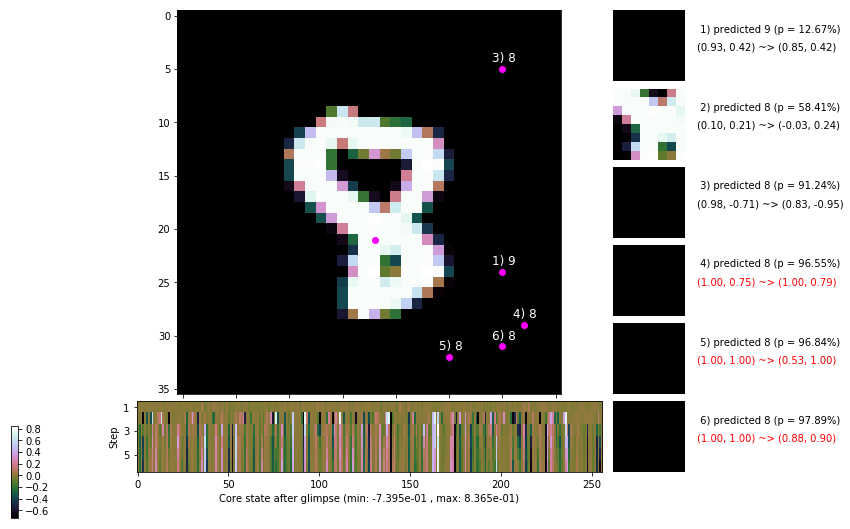

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 131.0 ms/b | lr: 1.81e-04 | grad 2norm: 11.90 | grad inf norm:  3.735
         Weights || abs max:  2.95 (37655.61) | mean: -5.72e-04 ( 0.08) | var: 8.85e-02 (607228.06)
          Biases || abs max:  1.50 (  136.38) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (   63.94)
                    class loss: 0.309 | steps: 2.155 | reward:  3.859 | acc.: 89.52%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 127.9 ms/b | lr: 1.81e-04 | grad 2norm: 12.20 | grad inf norm:  3.699
         Weights || abs max:  2.96 ( 2535.80) | mean: -5.76e-04 ( 0.01) | var: 8.85e-02 (  471.45)
          Biases || abs max:  1.50 (   67.59) | mean: -1.43e-01 ( 0.09) | var: 1.01e-01 (   30.01)
                    class loss: 0.349 | steps: 2.185 | reward:  3.765 | acc.: 88.27%

	Target class: 0 | Discounted rewards: [-0.984, -0.969, 

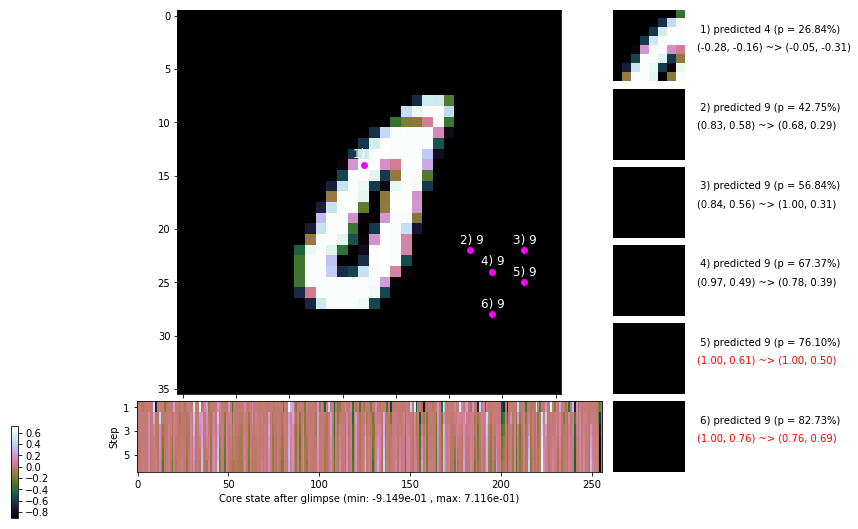

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


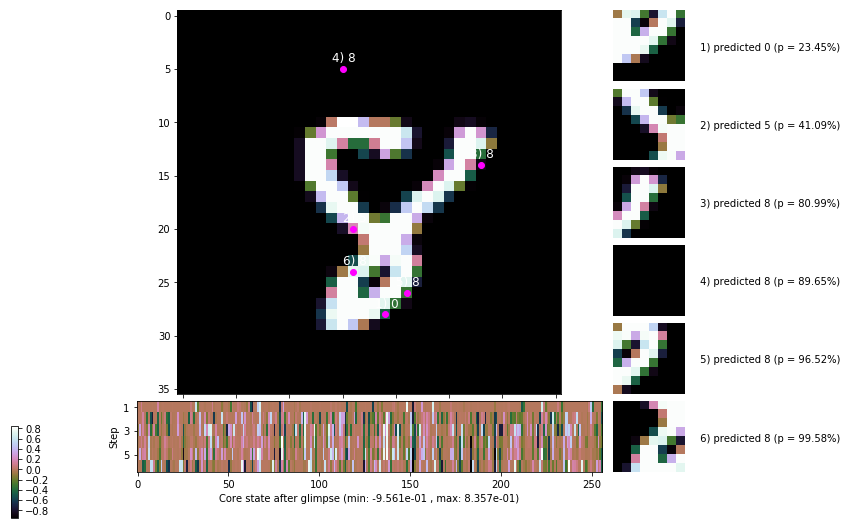


	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


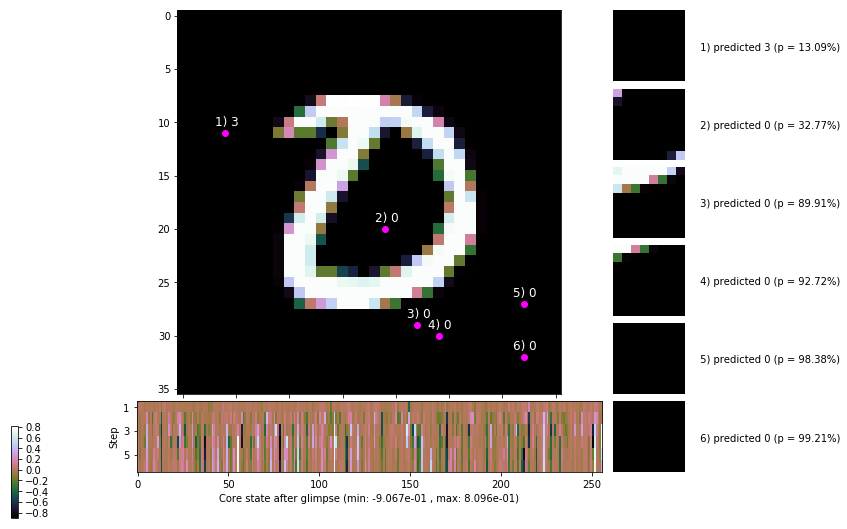

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


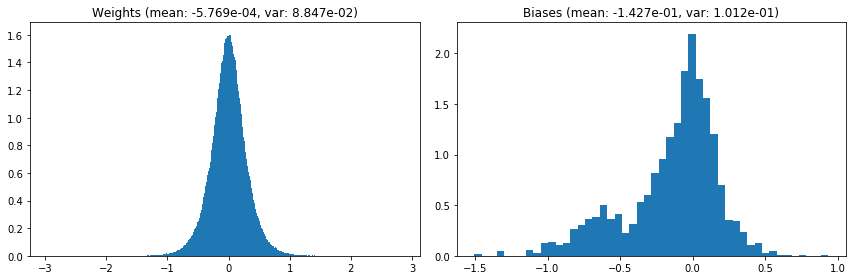

                                      Location network weights and biases


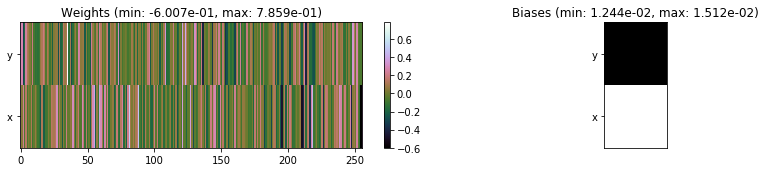

---------------------------------------------------------------------------------------------------------------
Elapsed time:  500.24 sec | TRAIN >> class loss: 0.3211 | steps:  2.178    | reward:  3.8055 :( | acc.: 89.052% :(
                          | VAL   >> class loss: 0.2935 | steps:  2.094 :( | reward:  3.9936 :( | acc.: 89.560% :(


Epoch 115/400) lr = 0.0001807
 b    300/  3000 >> 127.9 ms/b | lr: 1.81e-04 | grad 2norm: 12.06 | grad inf norm:  3.611
         Weights || abs max:  2.96 ( 1216.28) | mean: -5.79e-04 ( 0.01) | var: 8.85e-02 (   14.48)
          Biases || abs max:  1.50 (   50.72) | mean: -1.43e-01 ( 0.08) | var: 1.01e-01 (    6.35)
                    class loss: 0.329 | steps: 2.182 | reward:  3.792 | acc.: 88.82%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 120.5 ms/b | lr: 1.80e-04 | grad 2norm: 12.17 | grad inf norm:  3.606
         Weights || abs max:  2.96 ( 2603.26) | mean: -5.88e-04 (

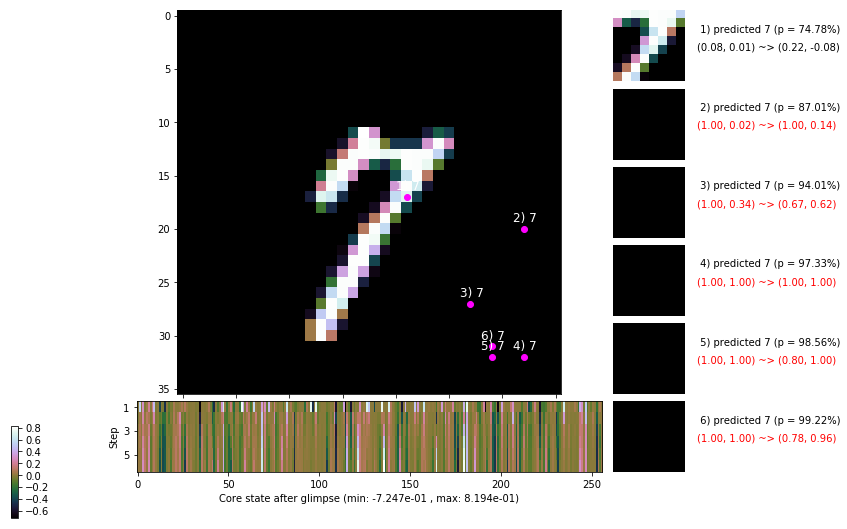

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 123.0 ms/b | lr: 1.80e-04 | grad 2norm: 12.11 | grad inf norm:  3.816
         Weights || abs max:  2.96 ( 4875.49) | mean: -5.89e-04 ( 0.02) | var: 8.85e-02 ( 3549.37)
          Biases || abs max:  1.50 (  359.92) | mean: -1.43e-01 ( 0.32) | var: 1.01e-01 (19433.18)
                    class loss: 0.315 | steps: 2.179 | reward:  3.781 | acc.: 88.68%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 124.6 ms/b | lr: 1.80e-04 | grad 2norm: 11.83 | grad inf norm:  3.852
         Weights || abs max:  2.96 ( 2091.91) | mean: -5.92e-04 ( 0.01) | var: 8.85e-02 (   89.89)
          Biases || abs max:  1.50 (   57.49) | mean: -1.42e-01 ( 0.09) | var: 1.01e-01 (    4.80)
                    class loss: 0.305 | steps: 2.181 | reward:  3.814 | acc.: 89.48%

	Target class: 7 | Discounted rewards: [0.469, 1.938, 1.8

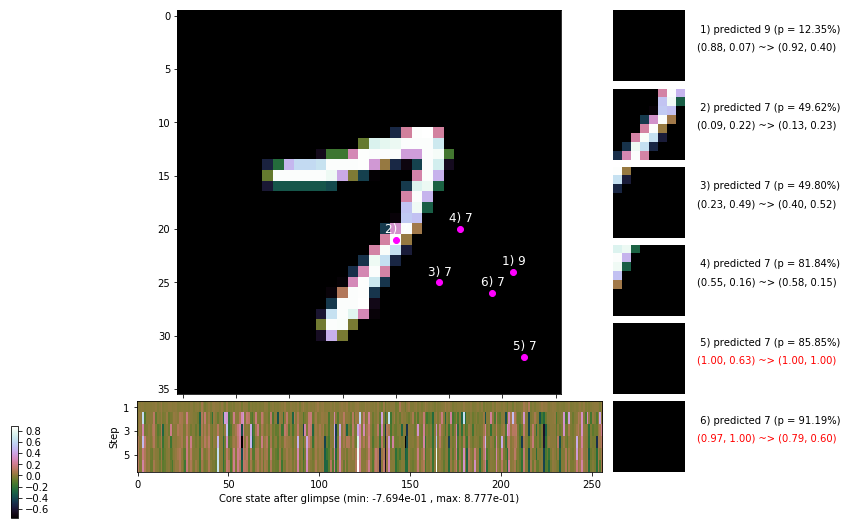

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 123.9 ms/b | lr: 1.79e-04 | grad 2norm: 12.05 | grad inf norm:  3.743
         Weights || abs max:  2.96 ( 4094.52) | mean: -5.91e-04 ( 0.02) | var: 8.85e-02 (  533.57)
          Biases || abs max:  1.50 (  231.42) | mean: -1.42e-01 ( 0.16) | var: 1.01e-01 (  945.77)
                    class loss: 0.326 | steps: 2.218 | reward:  3.740 | acc.: 88.42%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 127.0 ms/b | lr: 1.79e-04 | grad 2norm: 12.04 | grad inf norm:  3.821
         Weights || abs max:  2.96 ( 1955.29) | mean: -6.05e-04 ( 0.01) | var: 8.85e-02 (   47.04)
          Biases || abs max:  1.50 (  120.73) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (   49.60)
                    class loss: 0.324 | steps: 2.190 | reward:  3.821 | acc.: 89.30%

	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.8

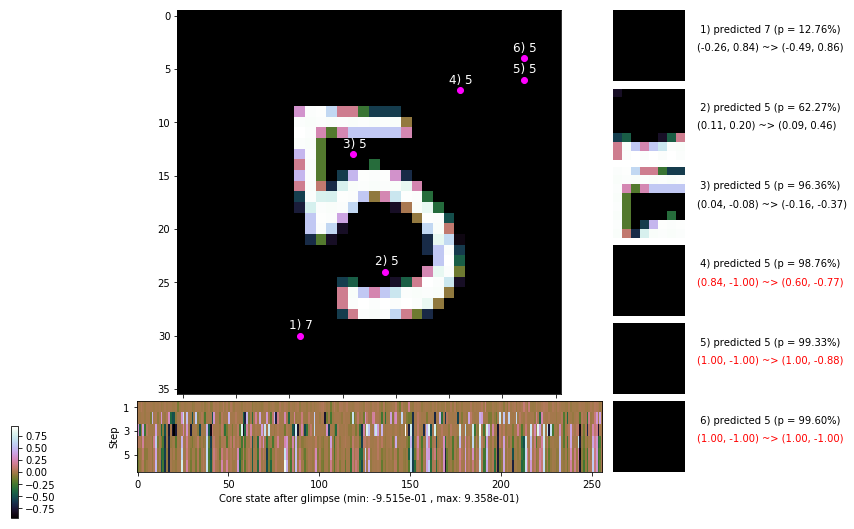

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 135.0 ms/b | lr: 1.79e-04 | grad 2norm: 12.08 | grad inf norm:  3.891
         Weights || abs max:  2.95 ( 3230.45) | mean: -6.07e-04 ( 0.01) | var: 8.85e-02 ( 1113.01)
          Biases || abs max:  1.50 (  475.10) | mean: -1.42e-01 ( 0.27) | var: 1.01e-01 ( 2946.75)
                    class loss: 0.327 | steps: 2.194 | reward:  3.790 | acc.: 89.12%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 124.3 ms/b | lr: 1.79e-04 | grad 2norm: 12.21 | grad inf norm:  3.857
         Weights || abs max:  2.96 ( 4186.82) | mean: -6.01e-04 ( 0.02) | var: 8.85e-02 (  337.22)
          Biases || abs max:  1.50 (  384.88) | mean: -1.42e-01 ( 0.25) | var: 1.01e-01 (  786.75)
                    class loss: 0.336 | steps: 2.193 | reward:  3.741 | acc.: 88.07%

	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.8

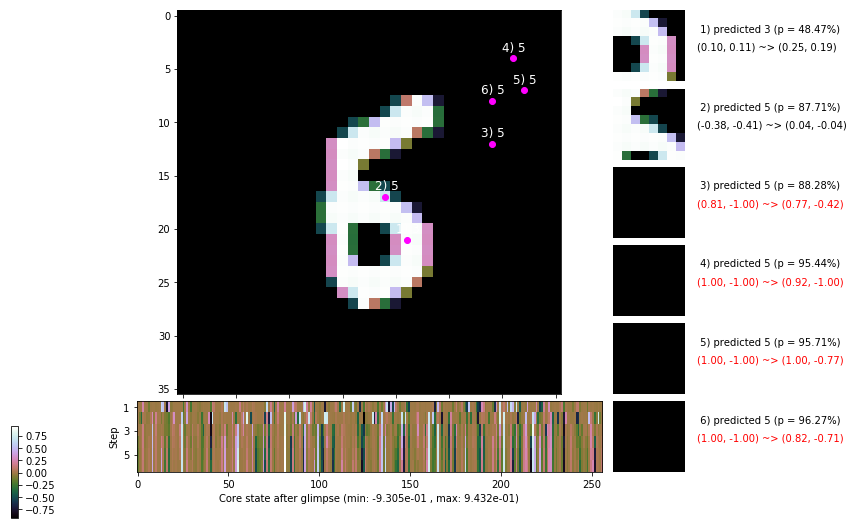

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 125.9 ms/b | lr: 1.78e-04 | grad 2norm: 12.08 | grad inf norm:  3.797
         Weights || abs max:  2.96 ( 1653.70) | mean: -6.00e-04 ( 0.01) | var: 8.85e-02 (  123.83)
          Biases || abs max:  1.50 (  169.20) | mean: -1.43e-01 ( 0.16) | var: 1.01e-01 (  298.94)
                    class loss: 0.322 | steps: 2.172 | reward:  3.820 | acc.: 89.13%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 119.1 ms/b | lr: 1.78e-04 | grad 2norm: 12.29 | grad inf norm:  3.940
         Weights || abs max:  2.96 ( 2532.02) | mean: -5.90e-04 ( 0.01) | var: 8.85e-02 (  235.08)
          Biases || abs max:  1.50 (  561.09) | mean: -1.43e-01 ( 0.34) | var: 1.01e-01 (12626.46)
                    class loss: 0.327 | steps: 2.207 | reward:  3.753 | acc.: 88.45%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.8

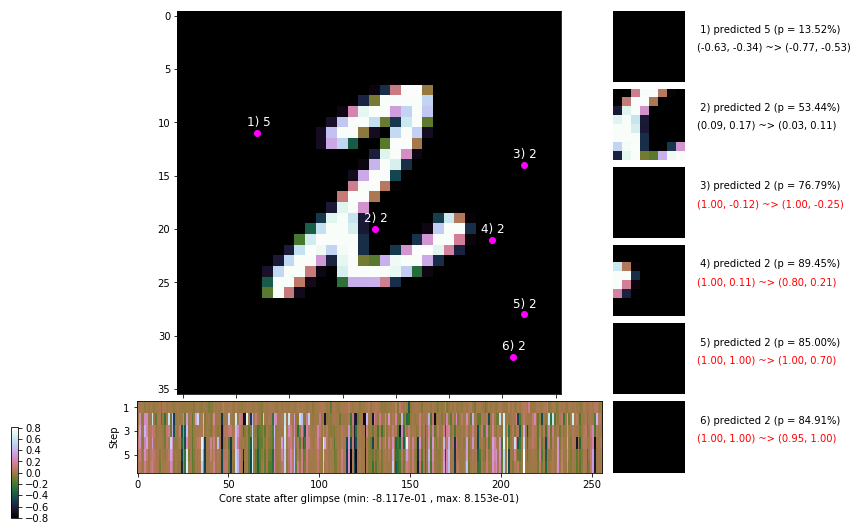

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [-0.797, -0.594, -0.188, 0.625, -0.750, -0.500]


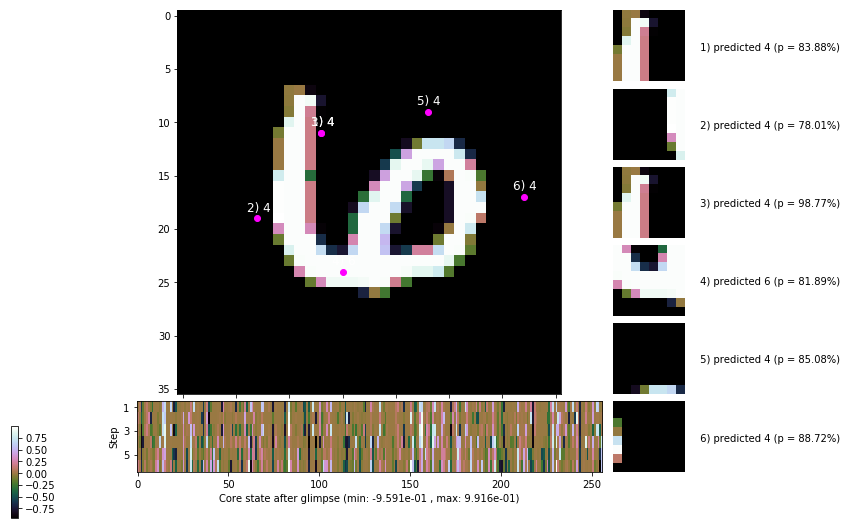


	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


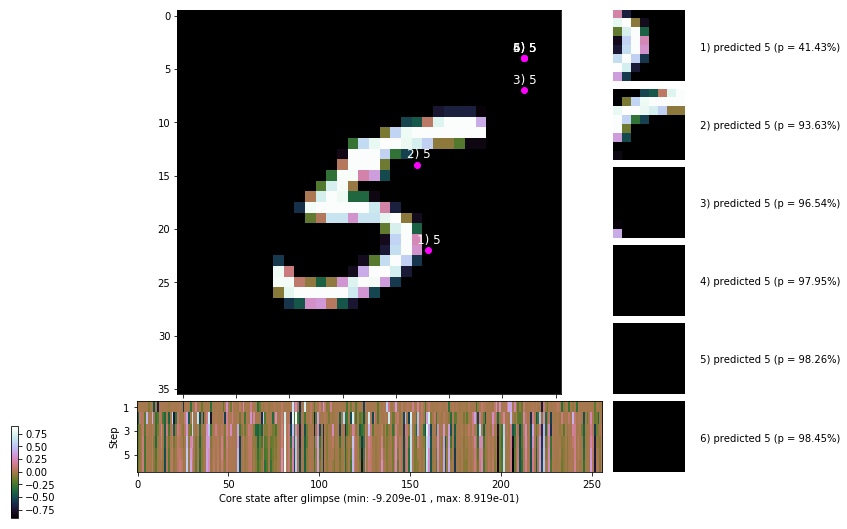

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


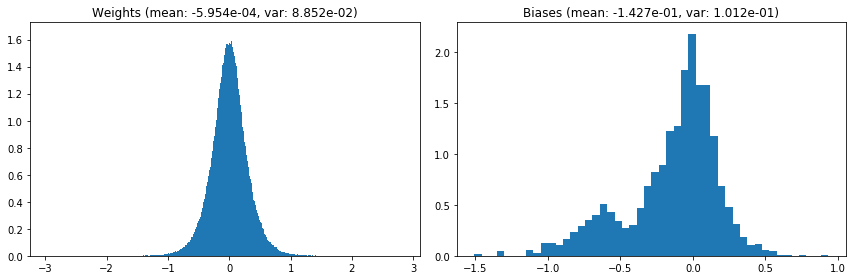

                                      Location network weights and biases


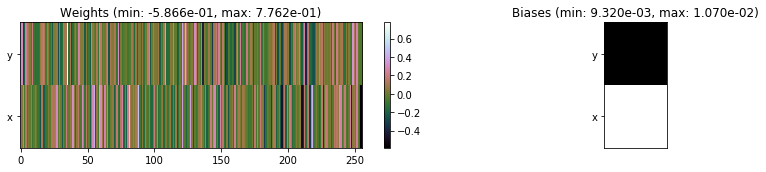

---------------------------------------------------------------------------------------------------------------
Elapsed time:  375.87 sec | TRAIN >> class loss: 0.3240 | steps:  2.191 :( | reward:  3.7841 :( | acc.: 88.828% :(
                          | VAL   >> class loss: 0.3033 | steps:  2.065 :( | reward:  3.9939 :( | acc.: 89.440% :(


Epoch 116/400) lr = 0.000178
 b    300/  3000 >> 121.9 ms/b | lr: 1.78e-04 | grad 2norm: 12.07 | grad inf norm:  3.787
         Weights || abs max:  2.96 ( 4094.34) | mean: -5.92e-04 ( 0.02) | var: 8.85e-02 (  423.92)
          Biases || abs max:  1.50 (  323.73) | mean: -1.43e-01 ( 0.22) | var: 1.01e-01 ( 1278.00)
                    class loss: 0.308 | steps: 2.211 | reward:  3.779 | acc.: 89.33%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 125.3 ms/b | lr: 1.78e-04 | grad 2norm: 11.78 | grad inf norm:  3.429
         Weights || abs max:  2.95 ( 2579.49) | mean: -5.84e-04 ( 

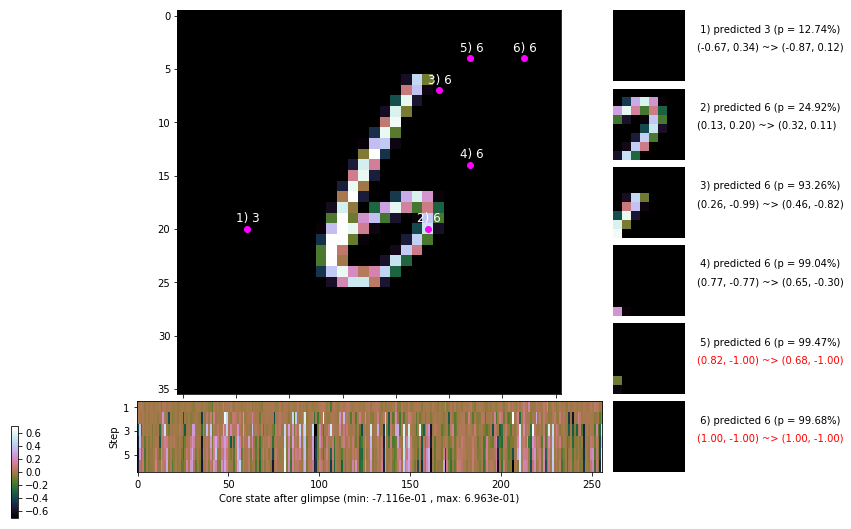

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 125.7 ms/b | lr: 1.77e-04 | grad 2norm: 12.02 | grad inf norm:  3.674
         Weights || abs max:  2.95 ( 1110.90) | mean: -5.79e-04 ( 0.01) | var: 8.85e-02 (   14.55)
          Biases || abs max:  1.50 (  170.60) | mean: -1.42e-01 ( 0.15) | var: 1.01e-01 (   76.39)
                    class loss: 0.315 | steps: 2.173 | reward:  3.836 | acc.: 89.33%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 132.6 ms/b | lr: 1.77e-04 | grad 2norm: 12.12 | grad inf norm:  3.746
         Weights || abs max:  2.96 ( 2639.81) | mean: -5.77e-04 ( 0.01) | var: 8.85e-02 (  105.41)
          Biases || abs max:  1.50 (  220.32) | mean: -1.42e-01 ( 0.17) | var: 1.01e-01 ( 1208.51)
                    class loss: 0.323 | steps: 2.218 | reward:  3.761 | acc.: 89.00%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

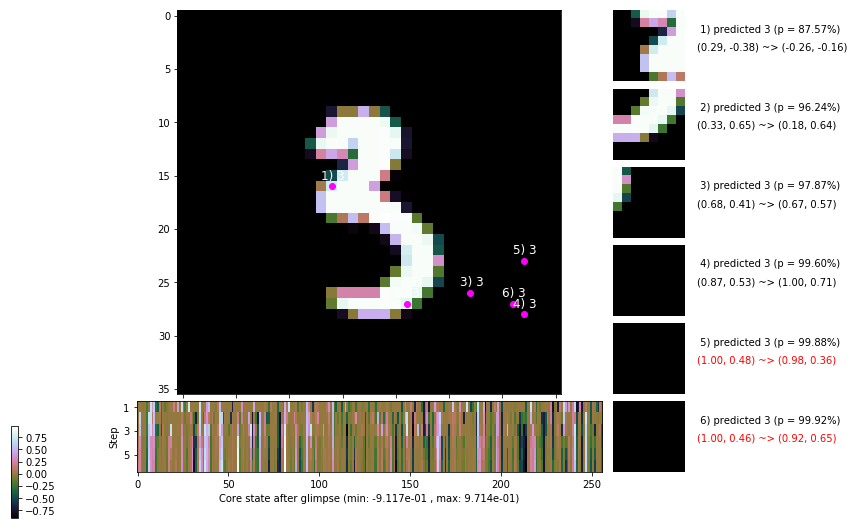

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 127.9 ms/b | lr: 1.77e-04 | grad 2norm: 11.94 | grad inf norm:  3.673
         Weights || abs max:  2.96 ( 2342.66) | mean: -5.81e-04 ( 0.01) | var: 8.85e-02 (  465.26)
          Biases || abs max:  1.50 ( 4189.43) | mean: -1.43e-01 ( 3.29) | var: 1.01e-01 (3683388.75)
                    class loss: 0.316 | steps: 2.159 | reward:  3.842 | acc.: 89.10%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 119.8 ms/b | lr: 1.77e-04 | grad 2norm: 12.08 | grad inf norm:  3.834
         Weights || abs max:  2.96 ( 3485.47) | mean: -5.96e-04 ( 0.01) | var: 8.85e-02 ( 1167.25)
          Biases || abs max:  1.50 (  106.48) | mean: -1.43e-01 ( 0.13) | var: 1.01e-01 (  105.36)
                    class loss: 0.325 | steps: 2.170 | reward:  3.819 | acc.: 88.90%

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1

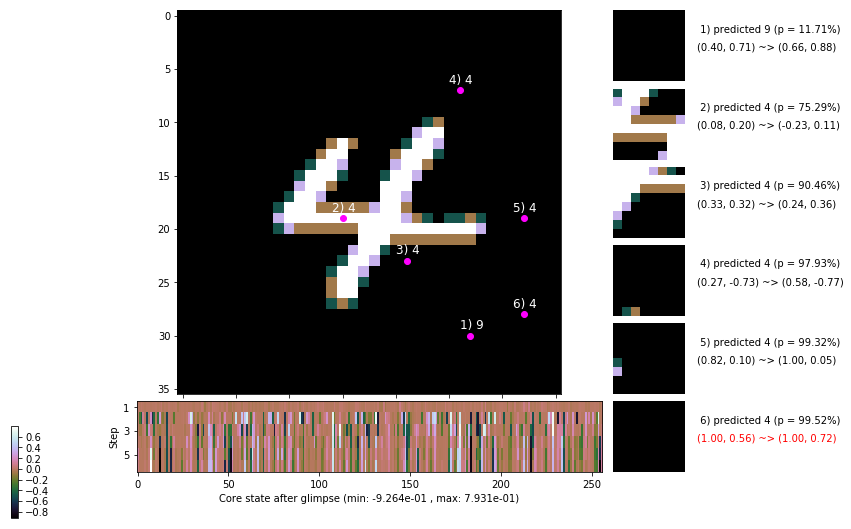

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 128.7 ms/b | lr: 1.76e-04 | grad 2norm: 12.09 | grad inf norm:  3.915
         Weights || abs max:  2.95 ( 1996.51) | mean: -5.80e-04 ( 0.01) | var: 8.86e-02 (  171.51)
          Biases || abs max:  1.50 (  162.52) | mean: -1.43e-01 ( 0.14) | var: 1.01e-01 (  379.34)
                    class loss: 0.332 | steps: 2.195 | reward:  3.776 | acc.: 88.73%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 121.8 ms/b | lr: 1.76e-04 | grad 2norm: 12.23 | grad inf norm:  3.855
         Weights || abs max:  2.95 ( 2686.82) | mean: -5.69e-04 ( 0.01) | var: 8.86e-02 (  261.84)
          Biases || abs max:  1.50 (  226.40) | mean: -1.43e-01 ( 0.17) | var: 1.01e-01 ( 1351.52)
                    class loss: 0.325 | steps: 2.212 | reward:  3.747 | acc.: 88.70%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.8

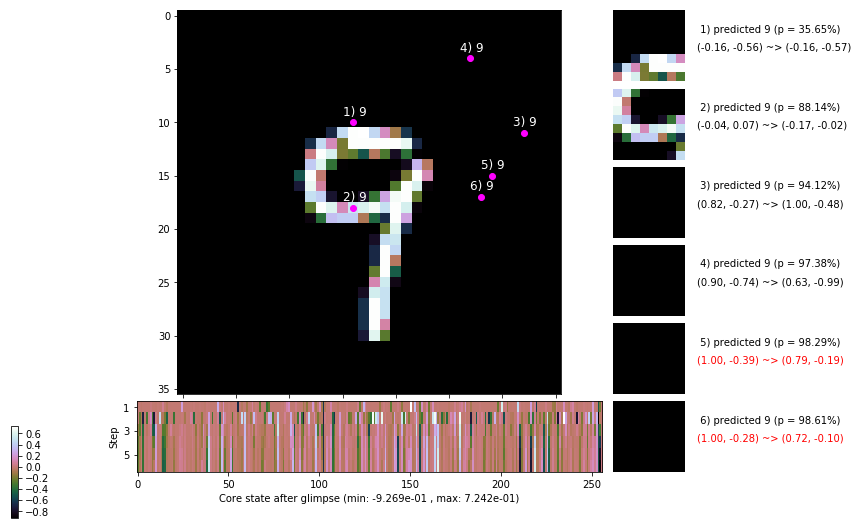

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 123.5 ms/b | lr: 1.76e-04 | grad 2norm: 11.92 | grad inf norm:  3.797
         Weights || abs max:  2.95 ( 2817.22) | mean: -5.65e-04 ( 0.01) | var: 8.86e-02 ( 1391.88)
          Biases || abs max:  1.50 (  109.25) | mean: -1.43e-01 ( 0.12) | var: 1.01e-01 (   98.95)
                    class loss: 0.309 | steps: 2.184 | reward:  3.813 | acc.: 89.60%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 121.3 ms/b | lr: 1.76e-04 | grad 2norm: 11.94 | grad inf norm:  3.701
         Weights || abs max:  2.95 ( 1609.51) | mean: -5.67e-04 ( 0.01) | var: 8.86e-02 (  116.91)
          Biases || abs max:  1.50 (  103.03) | mean: -1.43e-01 ( 0.11) | var: 1.01e-01 (   44.70)
                    class loss: 0.316 | steps: 2.170 | reward:  3.826 | acc.: 89.55%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

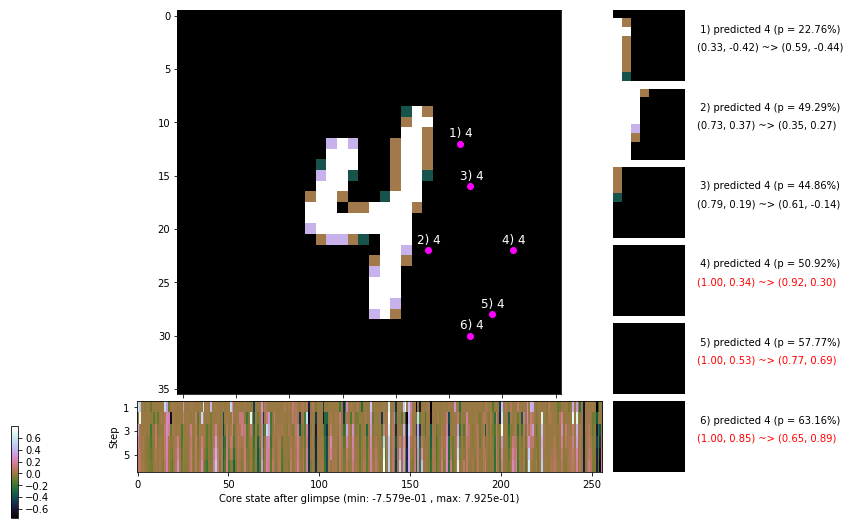

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


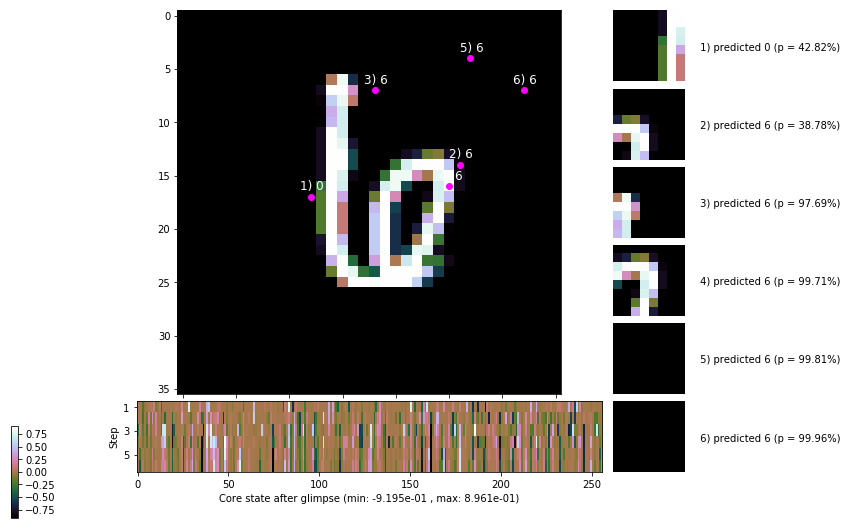


	Target class: 1 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


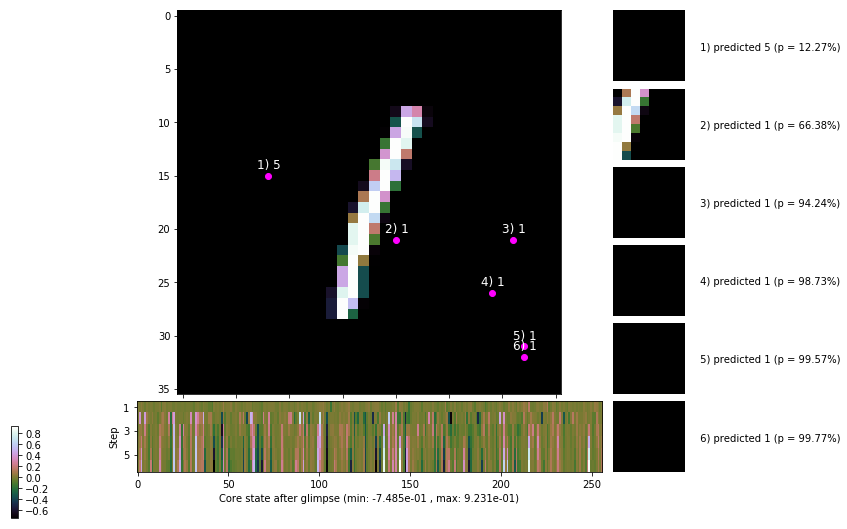

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


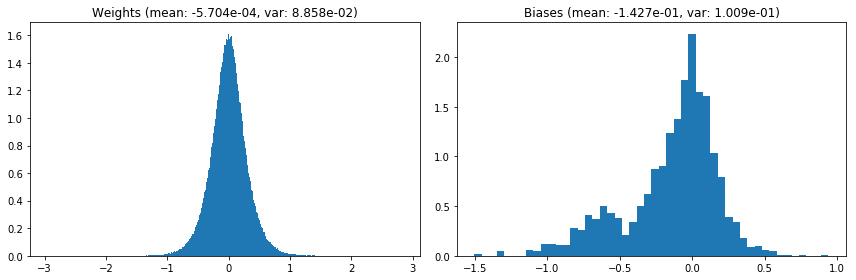

                                      Location network weights and biases


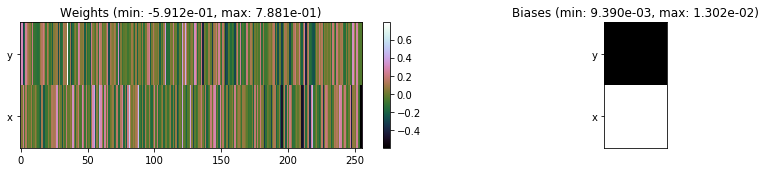

---------------------------------------------------------------------------------------------------------------
Elapsed time:  375.41 sec | TRAIN >> class loss: 0.3191 | steps:  2.188 :( | reward:  3.8003 :( | acc.: 89.152% :(
                          | VAL   >> class loss: 0.2907 | steps:  2.068 :( | reward:  4.0275 :( | acc.: 90.020% :(


Epoch 117/400) lr = 0.0001754
 b    300/  3000 >> 125.0 ms/b | lr: 1.75e-04 | grad 2norm: 11.96 | grad inf norm:  3.724
         Weights || abs max:  2.95 ( 1719.22) | mean: -5.78e-04 ( 0.01) | var: 8.86e-02 (   29.24)
          Biases || abs max:  1.50 (  159.10) | mean: -1.43e-01 ( 0.17) | var: 1.01e-01 (  116.56)
                    class loss: 0.318 | steps: 2.172 | reward:  3.805 | acc.: 89.40%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 122.8 ms/b | lr: 1.75e-04 | grad 2norm: 11.67 | grad inf norm:  3.619
         Weights || abs max:  2.94 ( 4867.83) | mean: -5.78e-04 (

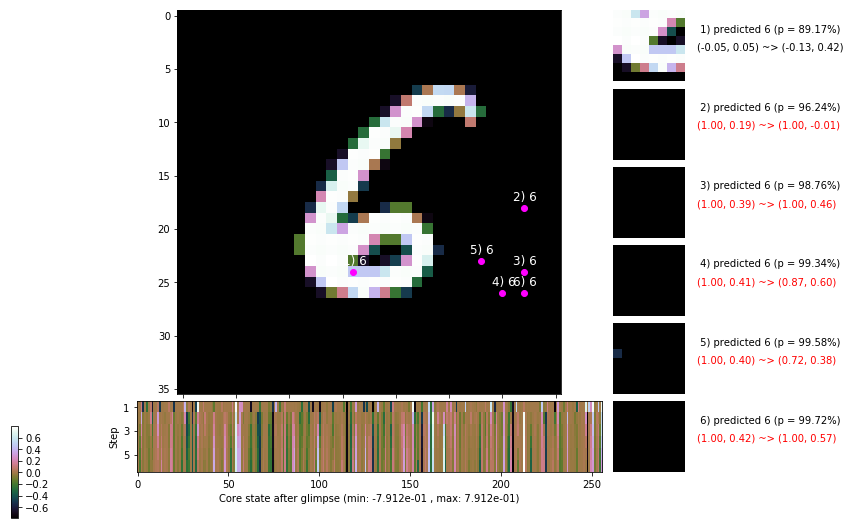

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 128.4 ms/b | lr: 1.75e-04 | grad 2norm: 12.07 | grad inf norm:  3.676
         Weights || abs max:  2.95 ( 2577.81) | mean: -5.68e-04 ( 0.01) | var: 8.86e-02 (  117.76)
          Biases || abs max:  1.50 (  195.76) | mean: -1.43e-01 ( 0.17) | var: 1.01e-01 (  208.75)
                    class loss: 0.325 | steps: 2.221 | reward:  3.745 | acc.: 89.08%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 124.4 ms/b | lr: 1.74e-04 | grad 2norm: 12.11 | grad inf norm:  3.798
         Weights || abs max:  2.95 (13768.56) | mean: -5.65e-04 ( 0.03) | var: 8.86e-02 (37122.62)
          Biases || abs max:  1.50 (   93.25) | mean: -1.43e-01 ( 0.11) | var: 1.01e-01 (   51.35)
                    class loss: 0.326 | steps: 2.196 | reward:  3.789 | acc.: 88.68%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.8

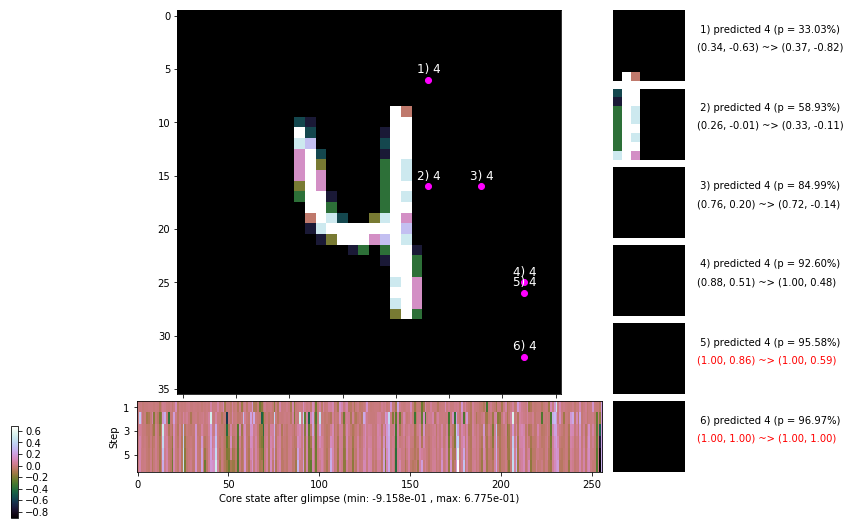

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 130.8 ms/b | lr: 1.74e-04 | grad 2norm: 11.83 | grad inf norm:  3.560
         Weights || abs max:  2.95 ( 3782.50) | mean: -5.79e-04 ( 0.01) | var: 8.86e-02 (  462.97)
          Biases || abs max:  1.50 (  174.93) | mean: -1.43e-01 ( 0.16) | var: 1.01e-01 (  110.20)
                    class loss: 0.326 | steps: 2.205 | reward:  3.760 | acc.: 88.92%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 125.9 ms/b | lr: 1.74e-04 | grad 2norm: 11.99 | grad inf norm:  3.929
         Weights || abs max:  2.95 ( 2475.51) | mean: -5.87e-04 ( 0.01) | var: 8.86e-02 (  140.92)
          Biases || abs max:  1.50 (  540.73) | mean: -1.43e-01 ( 0.36) | var: 1.01e-01 ( 3847.99)
                    class loss: 0.319 | steps: 2.183 | reward:  3.795 | acc.: 89.07%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.8

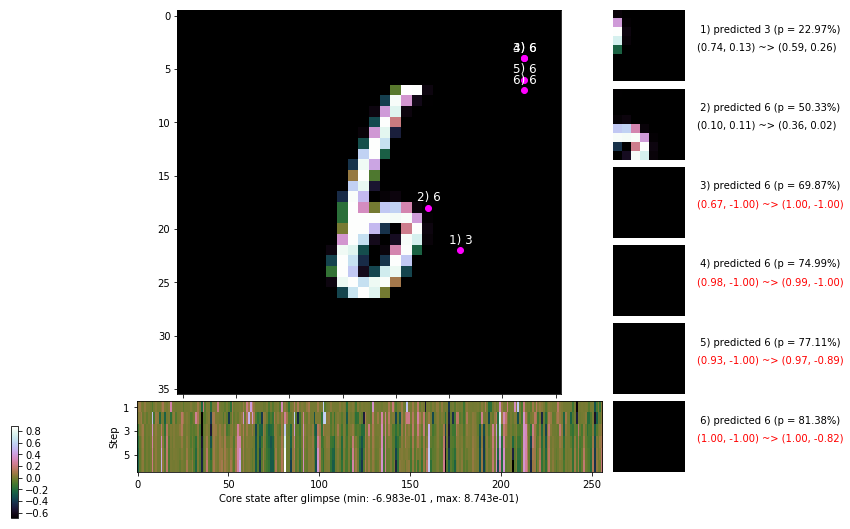

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 129.3 ms/b | lr: 1.74e-04 | grad 2norm: 12.03 | grad inf norm:  3.866
         Weights || abs max:  2.95 ( 3841.10) | mean: -5.85e-04 ( 0.01) | var: 8.86e-02 (  770.91)
          Biases || abs max:  1.50 ( 1815.68) | mean: -1.43e-01 ( 0.79) | var: 1.01e-01 (287935.84)
                    class loss: 0.322 | steps: 2.186 | reward:  3.812 | acc.: 88.97%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 125.0 ms/b | lr: 1.73e-04 | grad 2norm: 12.01 | grad inf norm:  3.810
         Weights || abs max:  2.95 (10731.63) | mean: -5.85e-04 ( 0.03) | var: 8.86e-02 (33175.72)
          Biases || abs max:  1.50 (  152.40) | mean: -1.43e-01 ( 0.15) | var: 1.01e-01 (  114.29)
                    class loss: 0.327 | steps: 2.176 | reward:  3.800 | acc.: 88.88%

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.

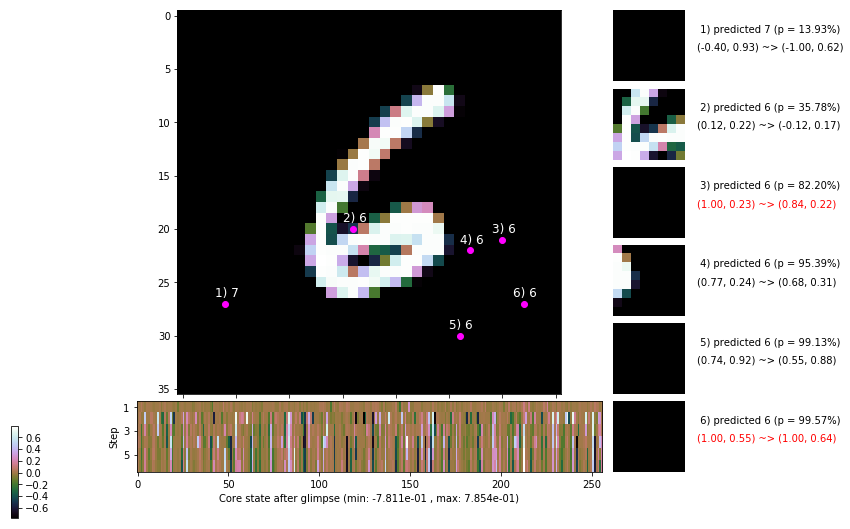

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 125.2 ms/b | lr: 1.73e-04 | grad 2norm: 12.00 | grad inf norm:  3.693
         Weights || abs max:  2.95 ( 5713.32) | mean: -5.83e-04 ( 0.02) | var: 8.86e-02 ( 1866.77)
          Biases || abs max:  1.50 (  213.86) | mean: -1.43e-01 ( 0.17) | var: 1.01e-01 (  273.91)
                    class loss: 0.316 | steps: 2.193 | reward:  3.791 | acc.: 89.22%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 126.4 ms/b | lr: 1.73e-04 | grad 2norm: 11.76 | grad inf norm:  3.688
         Weights || abs max:  2.95 ( 2577.21) | mean: -5.79e-04 ( 0.01) | var: 8.86e-02 (   62.07)
          Biases || abs max:  1.50 (  174.11) | mean: -1.43e-01 ( 0.16) | var: 1.01e-01 (  198.67)
                    class loss: 0.313 | steps: 2.167 | reward:  3.838 | acc.: 89.37%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

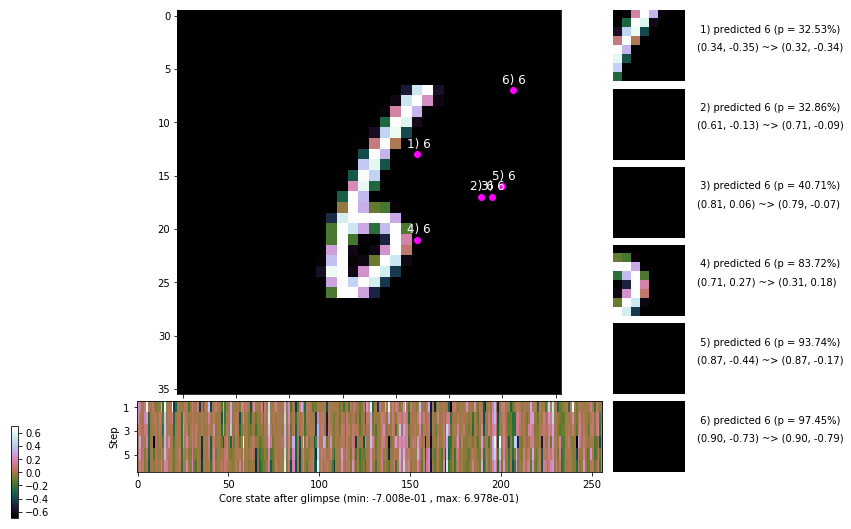

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


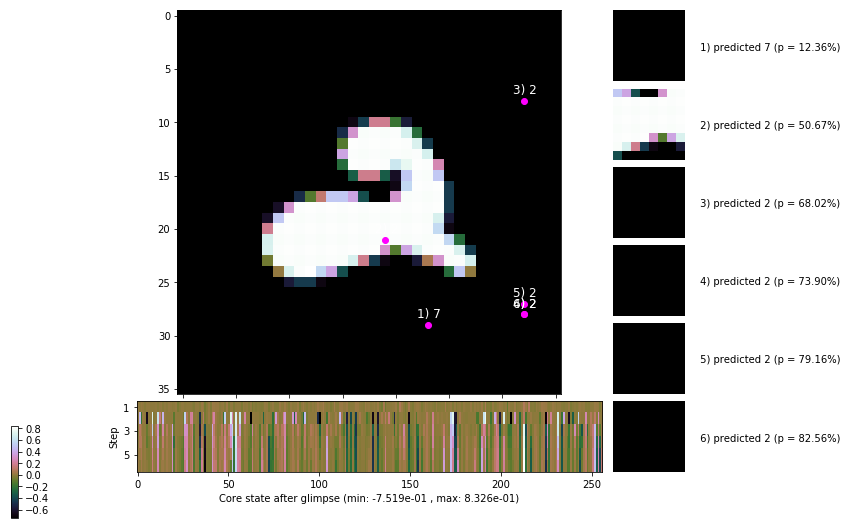


	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


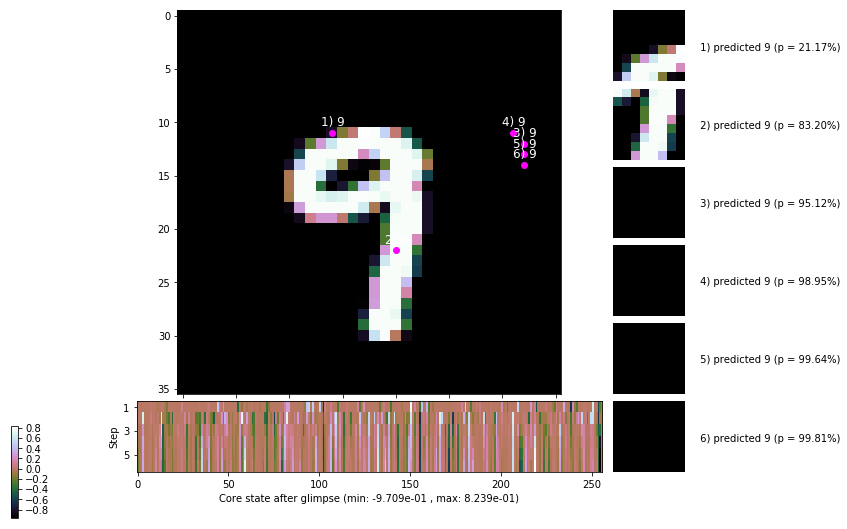

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


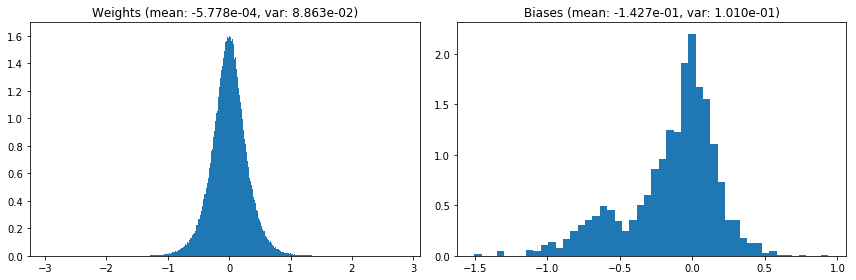

                                      Location network weights and biases


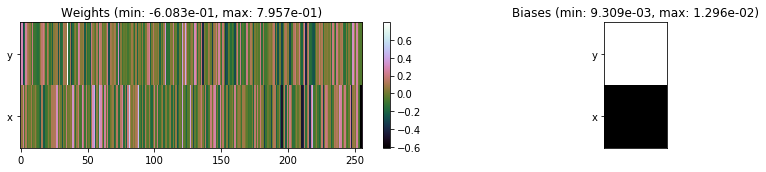

---------------------------------------------------------------------------------------------------------------
Elapsed time:  379.44 sec | TRAIN >> class loss: 0.3190 | steps:  2.186 :( | reward:  3.7985 :( | acc.: 89.128% :(
                          | VAL   >> class loss: 0.2830 | steps:  2.064 :( | reward:  4.0548 :( | acc.: 90.720% :(


Epoch 118/400) lr = 0.0001728
 b    300/  3000 >> 127.0 ms/b | lr: 1.73e-04 | grad 2norm: 12.37 | grad inf norm:  3.952
         Weights || abs max:  2.96 ( 3692.48) | mean: -5.82e-04 ( 0.01) | var: 8.86e-02 (  746.54)
          Biases || abs max:  1.50 ( 4256.15) | mean: -1.43e-01 ( 3.32) | var: 1.01e-01 (3869093.50)
                    class loss: 0.337 | steps: 2.201 | reward:  3.774 | acc.: 88.70%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 125.4 ms/b | lr: 1.72e-04 | grad 2norm: 11.82 | grad inf norm:  3.505
         Weights || abs max:  2.96 ( 1496.90) | mean: -5.78e-04

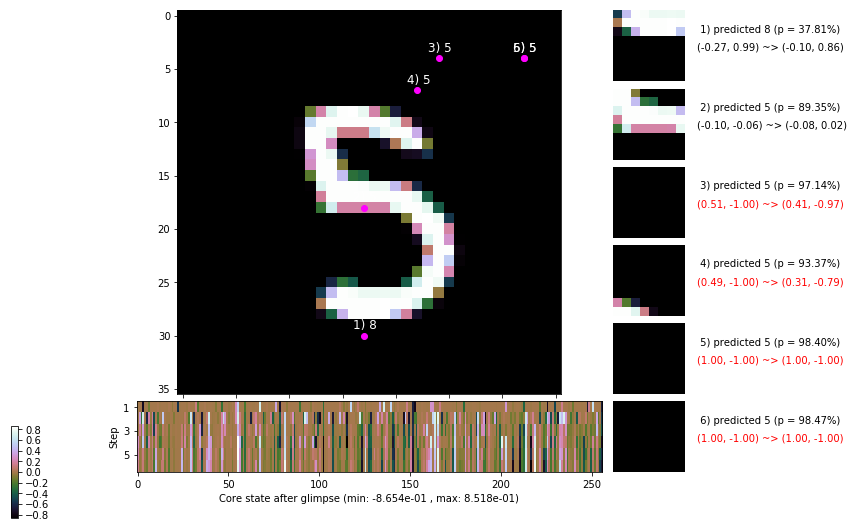

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 124.0 ms/b | lr: 1.72e-04 | grad 2norm: 11.69 | grad inf norm:  3.552
         Weights || abs max:  2.96 ( 1966.88) | mean: -5.68e-04 ( 0.01) | var: 8.87e-02 (   67.24)
          Biases || abs max:  1.50 (  123.18) | mean: -1.43e-01 ( 0.12) | var: 1.01e-01 (  240.52)
                    class loss: 0.311 | steps: 2.181 | reward:  3.809 | acc.: 89.47%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 121.0 ms/b | lr: 1.72e-04 | grad 2norm: 12.22 | grad inf norm:  3.822
         Weights || abs max:  2.96 (44344.52) | mean: -5.71e-04 ( 0.09) | var: 8.87e-02 (927926.88)
          Biases || abs max:  1.50 (   84.91) | mean: -1.43e-01 ( 0.10) | var: 1.01e-01 (   30.34)
                    class loss: 0.325 | steps: 2.202 | reward:  3.783 | acc.: 88.95%

	Target class: 2 | Discounted rewards: [0.469, 1.938, 1.

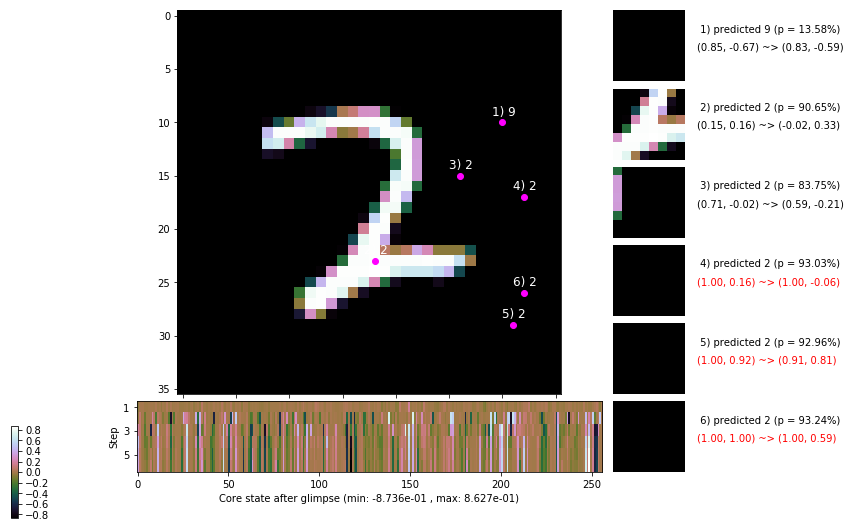

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 124.0 ms/b | lr: 1.72e-04 | grad 2norm: 12.23 | grad inf norm:  3.848
         Weights || abs max:  2.96 (10031.98) | mean: -5.73e-04 ( 0.03) | var: 8.87e-02 (28898.29)
          Biases || abs max:  1.50 (   78.24) | mean: -1.43e-01 ( 0.10) | var: 1.01e-01 (   17.25)
                    class loss: 0.346 | steps: 2.220 | reward:  3.715 | acc.: 88.28%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 120.2 ms/b | lr: 1.71e-04 | grad 2norm: 11.84 | grad inf norm:  3.776
         Weights || abs max:  2.95 ( 1231.99) | mean: -5.71e-04 ( 0.01) | var: 8.87e-02 (   18.96)
          Biases || abs max:  1.50 (   99.80) | mean: -1.43e-01 ( 0.12) | var: 1.01e-01 (   59.63)
                    class loss: 0.319 | steps: 2.171 | reward:  3.814 | acc.: 89.12%

	Target class: 3 | Discounted rewards: [-0.281, 0.438, 1.

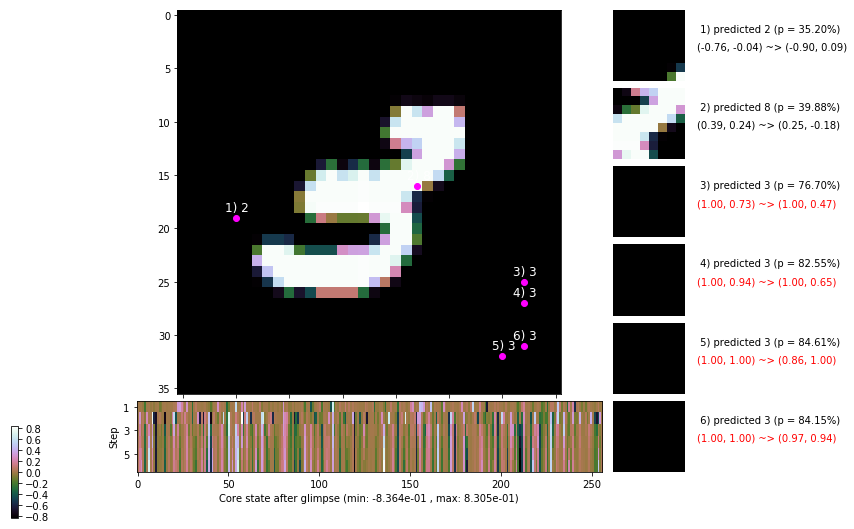

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 141.2 ms/b | lr: 1.71e-04 | grad 2norm: 11.72 | grad inf norm:  3.686
         Weights || abs max:  2.96 ( 1862.84) | mean: -5.74e-04 ( 0.01) | var: 8.87e-02 (   60.59)
          Biases || abs max:  1.50 (  103.55) | mean: -1.43e-01 ( 0.12) | var: 1.01e-01 (   33.27)
                    class loss: 0.317 | steps: 2.175 | reward:  3.829 | acc.: 89.70%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 127.2 ms/b | lr: 1.71e-04 | grad 2norm: 12.10 | grad inf norm:  3.882
         Weights || abs max:  2.96 ( 2960.50) | mean: -5.79e-04 ( 0.01) | var: 8.87e-02 (  264.47)
          Biases || abs max:  1.50 (   80.05) | mean: -1.43e-01 ( 0.11) | var: 1.01e-01 (    9.28)
                    class loss: 0.332 | steps: 2.206 | reward:  3.766 | acc.: 89.07%

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.8

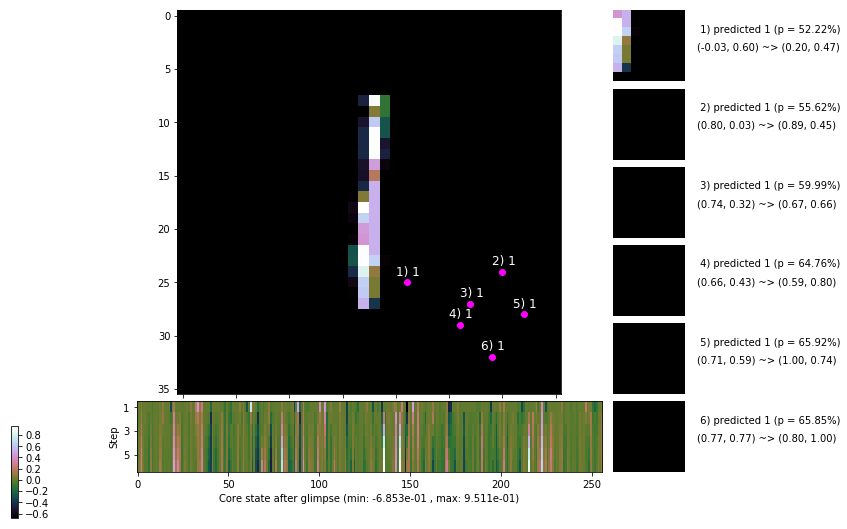

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 125.8 ms/b | lr: 1.71e-04 | grad 2norm: 11.90 | grad inf norm:  3.607
         Weights || abs max:  2.96 ( 2067.10) | mean: -5.78e-04 ( 0.01) | var: 8.87e-02 (  118.01)
          Biases || abs max:  1.50 (  357.10) | mean: -1.43e-01 ( 0.27) | var: 1.01e-01 ( 2414.67)
                    class loss: 0.323 | steps: 2.166 | reward:  3.825 | acc.: 88.82%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 120.2 ms/b | lr: 1.70e-04 | grad 2norm: 11.65 | grad inf norm:  3.701
         Weights || abs max:  2.96 ( 3155.14) | mean: -5.76e-04 ( 0.01) | var: 8.87e-02 (  783.15)
          Biases || abs max:  1.51 (  280.05) | mean: -1.43e-01 ( 0.23) | var: 1.01e-01 (  569.71)
                    class loss: 0.296 | steps: 2.152 | reward:  3.873 | acc.: 89.80%

	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.8

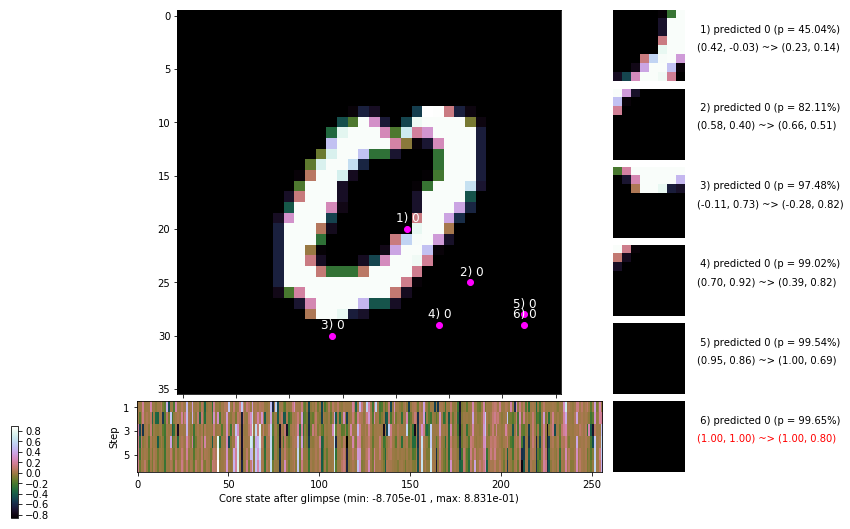

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


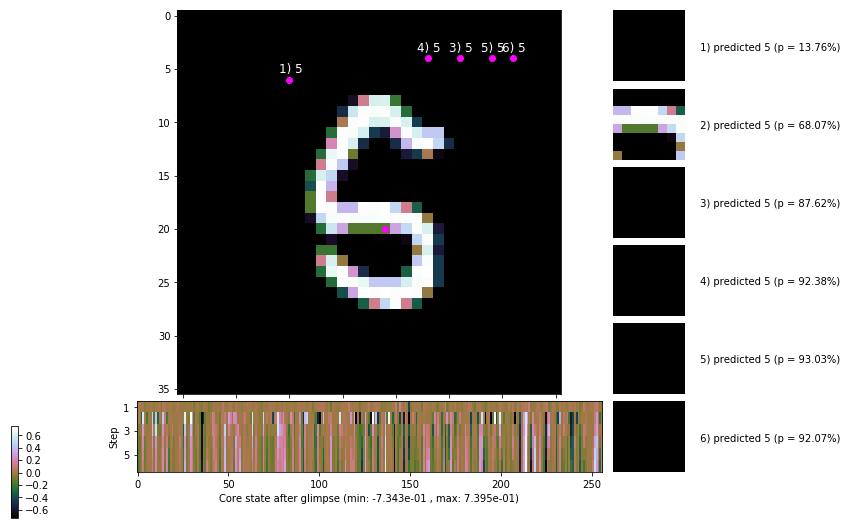


	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


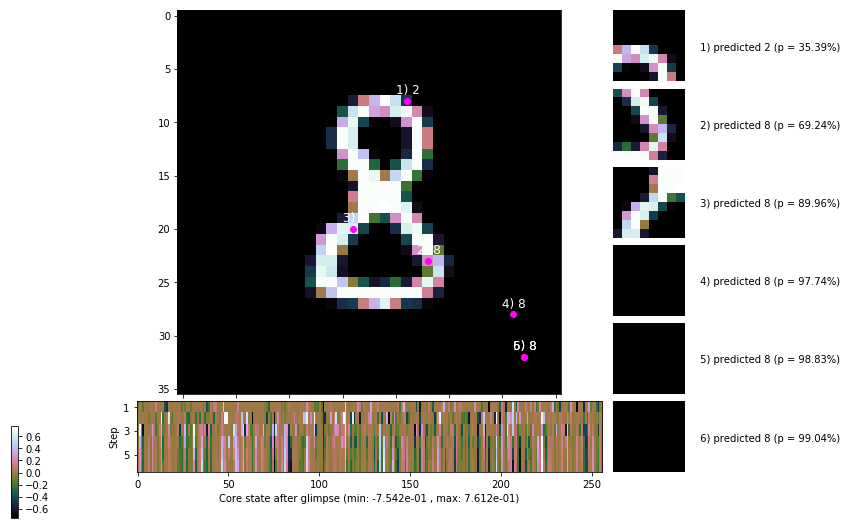

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


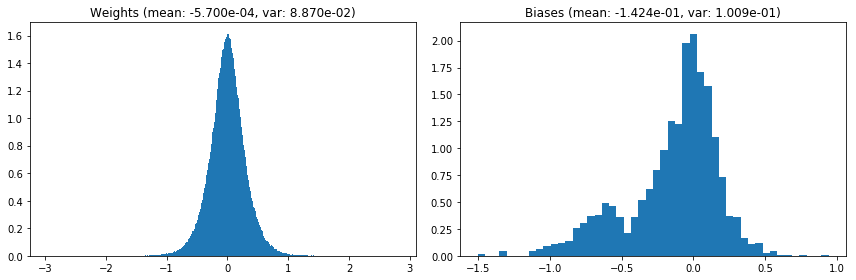

                                      Location network weights and biases


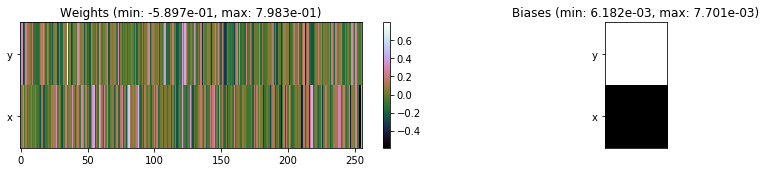

---------------------------------------------------------------------------------------------------------------
Elapsed time:  377.59 sec | TRAIN >> class loss: 0.3221 | steps:  2.188 :( | reward:  3.7976 :( | acc.: 89.140% :(
                          | VAL   >> class loss: 0.3063 | steps:  2.085 :( | reward:  3.9906 :( | acc.: 89.460% :(


Epoch 119/400) lr = 0.0001702
 b    300/  3000 >> 117.7 ms/b | lr: 1.70e-04 | grad 2norm: 11.58 | grad inf norm:  3.548
         Weights || abs max:  2.96 ( 4739.00) | mean: -5.67e-04 ( 0.02) | var: 8.87e-02 ( 3320.00)
          Biases || abs max:  1.50 (  174.83) | mean: -1.42e-01 ( 0.16) | var: 1.01e-01 (  403.08)
                    class loss: 0.299 | steps: 2.162 | reward:  3.859 | acc.: 89.78%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 121.0 ms/b | lr: 1.70e-04 | grad 2norm: 12.05 | grad inf norm:  3.721
         Weights || abs max:  2.96 ( 8614.63) | mean: -5.69e-04 (

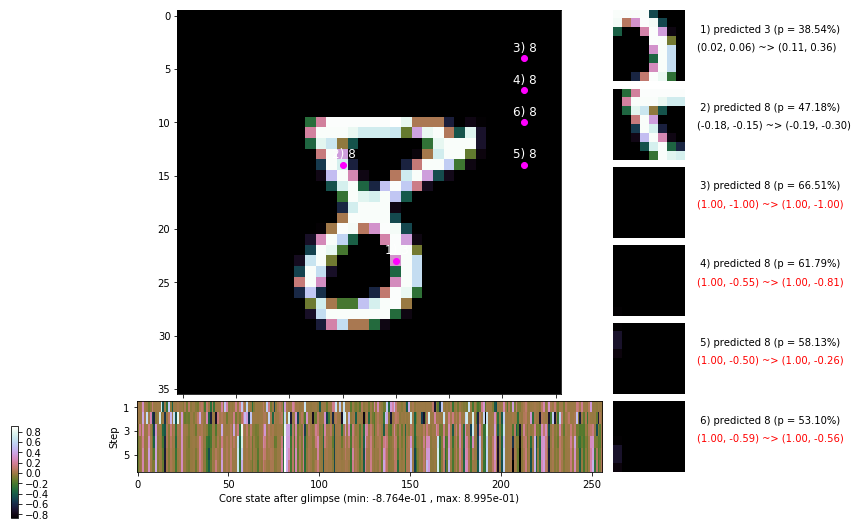

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 118.7 ms/b | lr: 1.70e-04 | grad 2norm: 11.95 | grad inf norm:  3.679
         Weights || abs max:  2.96 ( 1847.60) | mean: -5.85e-04 ( 0.01) | var: 8.87e-02 (   54.87)
          Biases || abs max:  1.51 (  794.06) | mean: -1.42e-01 ( 0.41) | var: 1.01e-01 ( 1706.52)
                    class loss: 0.329 | steps: 2.223 | reward:  3.752 | acc.: 89.00%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 119.1 ms/b | lr: 1.69e-04 | grad 2norm: 12.11 | grad inf norm:  3.680
         Weights || abs max:  2.96 ( 1781.52) | mean: -5.86e-04 ( 0.01) | var: 8.87e-02 (   82.48)
          Biases || abs max:  1.51 (  916.33) | mean: -1.42e-01 ( 0.52) | var: 1.01e-01 ( 7987.20)
                    class loss: 0.328 | steps: 2.192 | reward:  3.783 | acc.: 88.45%

	Target class: 5 | Discounted rewards: [-0.281, 0.438, 1.

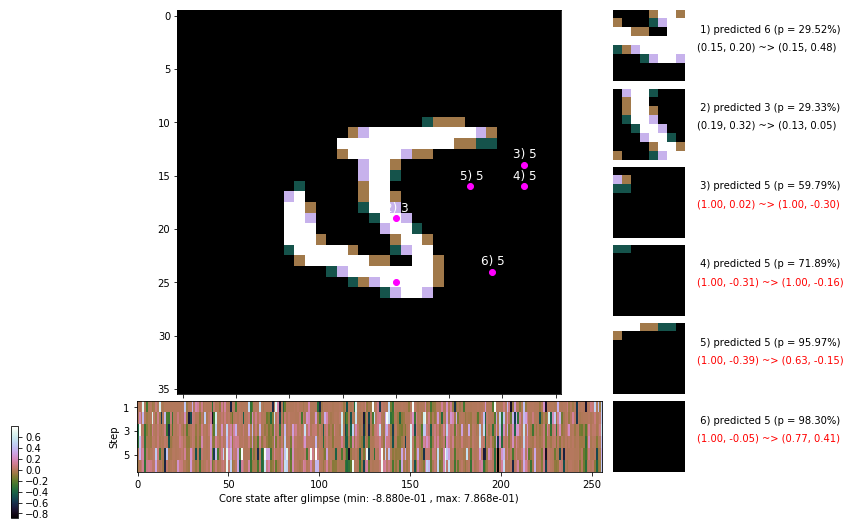

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 124.1 ms/b | lr: 1.69e-04 | grad 2norm: 11.87 | grad inf norm:  3.762
         Weights || abs max:  2.96 ( 1581.84) | mean: -5.87e-04 ( 0.01) | var: 8.87e-02 (   83.75)
          Biases || abs max:  1.51 (  289.61) | mean: -1.42e-01 ( 0.25) | var: 1.01e-01 (  349.75)
                    class loss: 0.324 | steps: 2.170 | reward:  3.817 | acc.: 89.17%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 117.0 ms/b | lr: 1.69e-04 | grad 2norm: 11.90 | grad inf norm:  3.703
         Weights || abs max:  2.95 ( 3031.63) | mean: -5.92e-04 ( 0.01) | var: 8.87e-02 (  185.83)
          Biases || abs max:  1.51 (  489.80) | mean: -1.42e-01 ( 0.29) | var: 1.01e-01 ( 6993.31)
                    class loss: 0.331 | steps: 2.176 | reward:  3.811 | acc.: 88.82%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

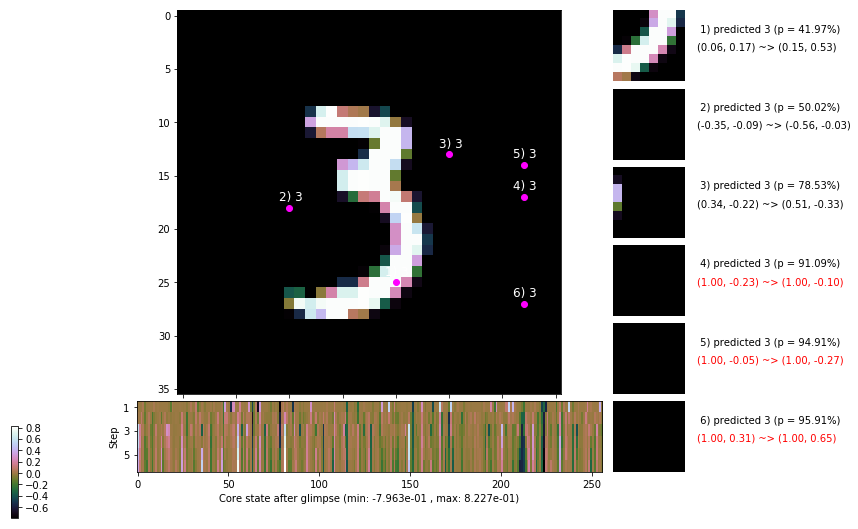

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 121.4 ms/b | lr: 1.68e-04 | grad 2norm: 12.20 | grad inf norm:  3.745
         Weights || abs max:  2.95 ( 2717.90) | mean: -6.00e-04 ( 0.01) | var: 8.87e-02 (  263.95)
          Biases || abs max:  1.51 (  210.10) | mean: -1.43e-01 ( 0.17) | var: 1.01e-01 (  453.26)
                    class loss: 0.351 | steps: 2.204 | reward:  3.739 | acc.: 87.92%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 118.3 ms/b | lr: 1.68e-04 | grad 2norm: 12.19 | grad inf norm:  3.835
         Weights || abs max:  2.96 (  902.48) | mean: -5.89e-04 ( 0.01) | var: 8.87e-02 (   11.03)
          Biases || abs max:  1.51 (  253.22) | mean: -1.43e-01 ( 0.19) | var: 1.01e-01 ( 1160.18)
                    class loss: 0.344 | steps: 2.223 | reward:  3.724 | acc.: 88.42%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

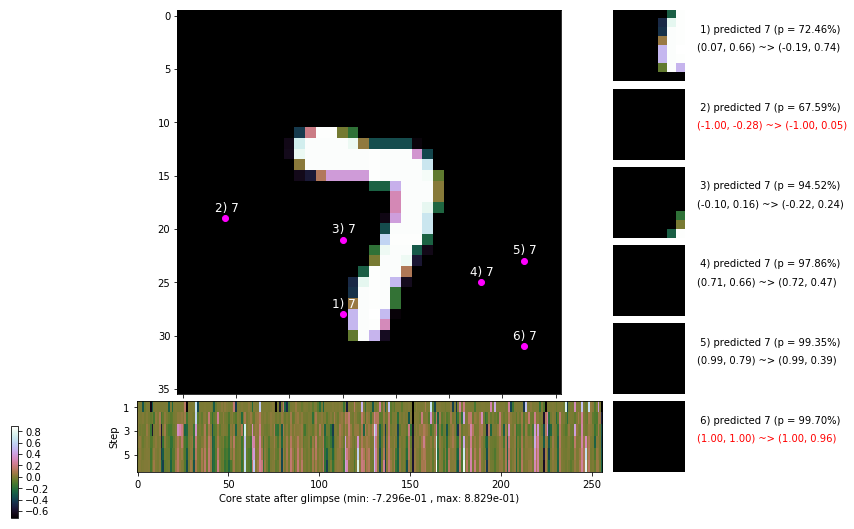

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 119.9 ms/b | lr: 1.68e-04 | grad 2norm: 11.85 | grad inf norm:  3.623
         Weights || abs max:  2.95 ( 4858.32) | mean: -5.88e-04 ( 0.01) | var: 8.87e-02 ( 4355.58)
          Biases || abs max:  1.51 (  433.87) | mean: -1.42e-01 ( 0.27) | var: 1.01e-01 ( 3552.53)
                    class loss: 0.314 | steps: 2.183 | reward:  3.816 | acc.: 89.32%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 119.4 ms/b | lr: 1.68e-04 | grad 2norm: 12.08 | grad inf norm:  3.674
         Weights || abs max:  2.96 ( 1587.28) | mean: -5.89e-04 ( 0.01) | var: 8.87e-02 (  233.51)
          Biases || abs max:  1.51 (  405.58) | mean: -1.42e-01 ( 0.26) | var: 1.01e-01 ( 6823.91)
                    class loss: 0.324 | steps: 2.191 | reward:  3.786 | acc.: 88.97%

	Target class: 3 | Discounted rewards: [1.969, 1.938, 1.8

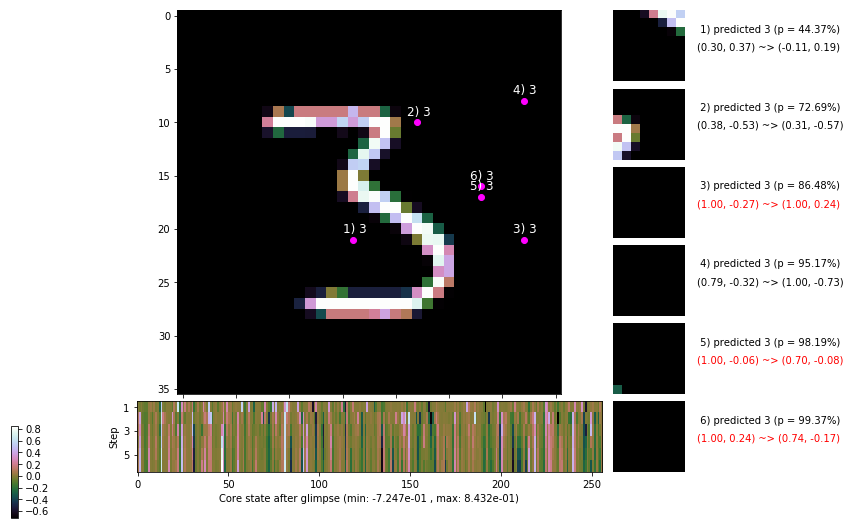

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


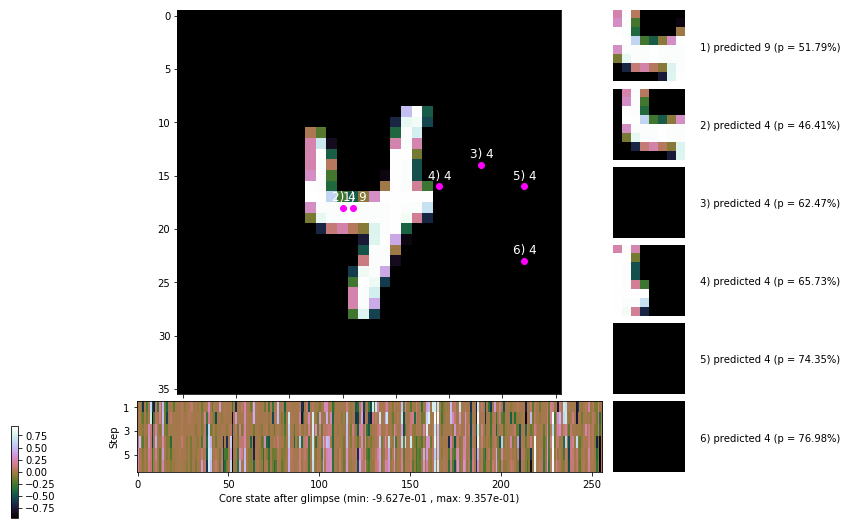


	Target class: 8 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


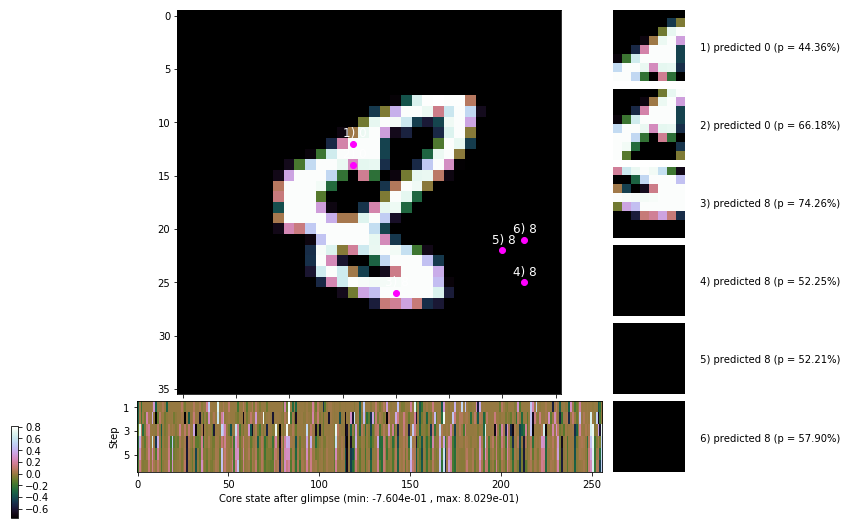

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


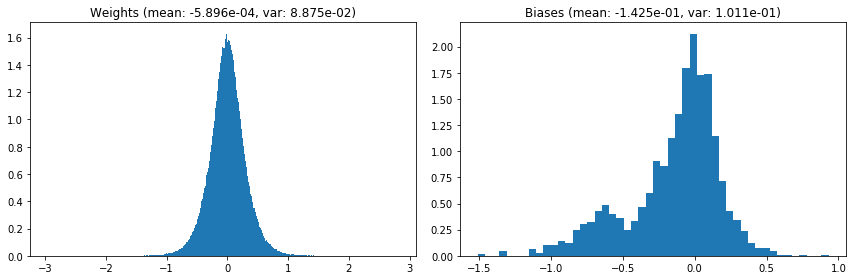

                                      Location network weights and biases


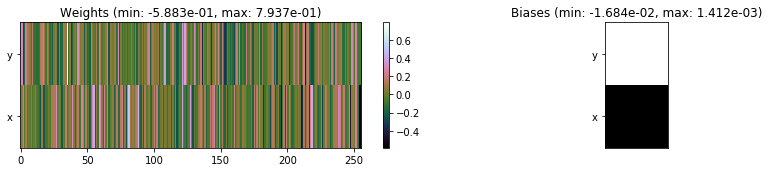

---------------------------------------------------------------------------------------------------------------
Elapsed time:  359.50 sec | TRAIN >> class loss: 0.3270 | steps:  2.191 :( | reward:  3.7879 :( | acc.: 88.877% :(
                          | VAL   >> class loss: 0.2994 | steps:  2.056 :( | reward:  4.0473 :( | acc.: 90.580% :(


Epoch 120/400) lr = 0.0001676
 b    300/  3000 >> 126.5 ms/b | lr: 1.67e-04 | grad 2norm: 11.59 | grad inf norm:  3.562
         Weights || abs max:  2.96 ( 1740.76) | mean: -5.90e-04 ( 0.01) | var: 8.88e-02 (   64.18)
          Biases || abs max:  1.51 (  729.81) | mean: -1.43e-01 ( 0.38) | var: 1.01e-01 ( 6625.97)
                    class loss: 0.300 | steps: 2.168 | reward:  3.856 | acc.: 90.18%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 124.6 ms/b | lr: 1.67e-04 | grad 2norm: 12.16 | grad inf norm:  3.741
         Weights || abs max:  2.96 ( 1648.81) | mean: -5.94e-04 (

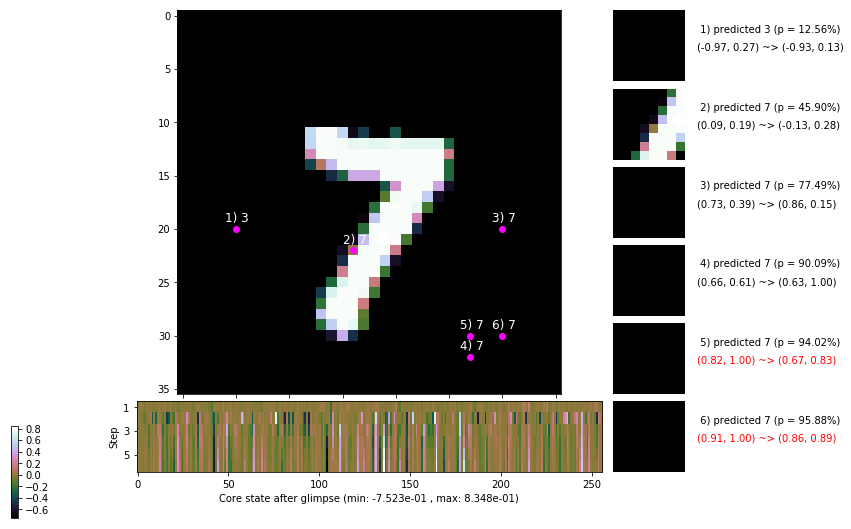

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 126.2 ms/b | lr: 1.67e-04 | grad 2norm: 12.08 | grad inf norm:  3.787
         Weights || abs max:  2.96 ( 5256.34) | mean: -5.91e-04 ( 0.02) | var: 8.88e-02 ( 1247.69)
          Biases || abs max:  1.51 (  176.90) | mean: -1.43e-01 ( 0.16) | var: 1.01e-01 (   67.32)
                    class loss: 0.314 | steps: 2.174 | reward:  3.815 | acc.: 88.95%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 117.4 ms/b | lr: 1.67e-04 | grad 2norm: 11.77 | grad inf norm:  3.512
         Weights || abs max:  2.96 ( 6303.57) | mean: -5.86e-04 ( 0.02) | var: 8.88e-02 ( 5867.12)
          Biases || abs max:  1.51 (  263.75) | mean: -1.42e-01 ( 0.22) | var: 1.01e-01 (  622.28)
                    class loss: 0.311 | steps: 2.179 | reward:  3.817 | acc.: 89.33%

	Target class: 9 | Discounted rewards: [1.969, 1.938, 1.8

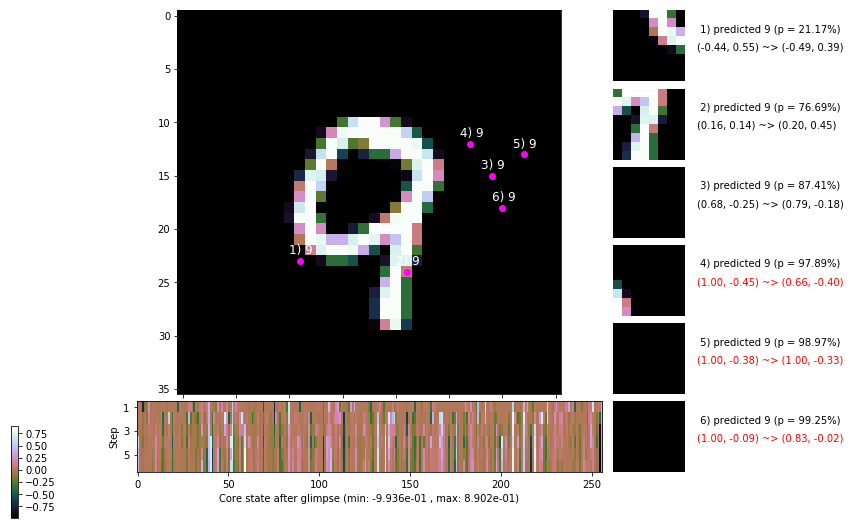

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 125.8 ms/b | lr: 1.66e-04 | grad 2norm: 11.91 | grad inf norm:  3.745
         Weights || abs max:  2.96 ( 3488.16) | mean: -5.77e-04 ( 0.01) | var: 8.88e-02 (  764.10)
          Biases || abs max:  1.51 (  609.64) | mean: -1.42e-01 ( 0.35) | var: 1.01e-01 (10726.01)
                    class loss: 0.329 | steps: 2.178 | reward:  3.811 | acc.: 89.03%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 131.9 ms/b | lr: 1.66e-04 | grad 2norm: 12.07 | grad inf norm:  3.665
         Weights || abs max:  2.96 ( 1280.66) | mean: -5.73e-04 ( 0.01) | var: 8.88e-02 (   24.84)
          Biases || abs max:  1.51 (  127.53) | mean: -1.42e-01 ( 0.14) | var: 1.01e-01 (  122.23)
                    class loss: 0.319 | steps: 2.171 | reward:  3.810 | acc.: 88.92%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

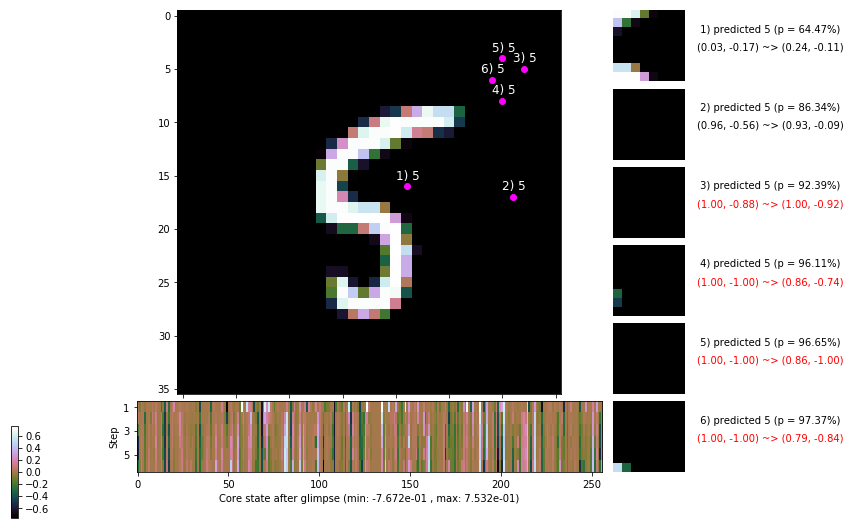

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 133.2 ms/b | lr: 1.66e-04 | grad 2norm: 12.22 | grad inf norm:  3.739
         Weights || abs max:  2.96 ( 1464.42) | mean: -5.70e-04 ( 0.01) | var: 8.88e-02 (   19.02)
          Biases || abs max:  1.51 (  121.26) | mean: -1.42e-01 ( 0.13) | var: 1.01e-01 (   53.81)
                    class loss: 0.310 | steps: 2.194 | reward:  3.784 | acc.: 89.05%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 128.2 ms/b | lr: 1.66e-04 | grad 2norm: 12.00 | grad inf norm:  3.826
         Weights || abs max:  2.96 ( 5549.14) | mean: -5.69e-04 ( 0.02) | var: 8.88e-02 ( 1529.96)
          Biases || abs max:  1.51 (  523.44) | mean: -1.42e-01 ( 0.36) | var: 1.01e-01 ( 3951.23)
                    class loss: 0.314 | steps: 2.179 | reward:  3.827 | acc.: 89.73%

	Target class: 6 | Discounted rewards: [1.969, 1.938, 1.8

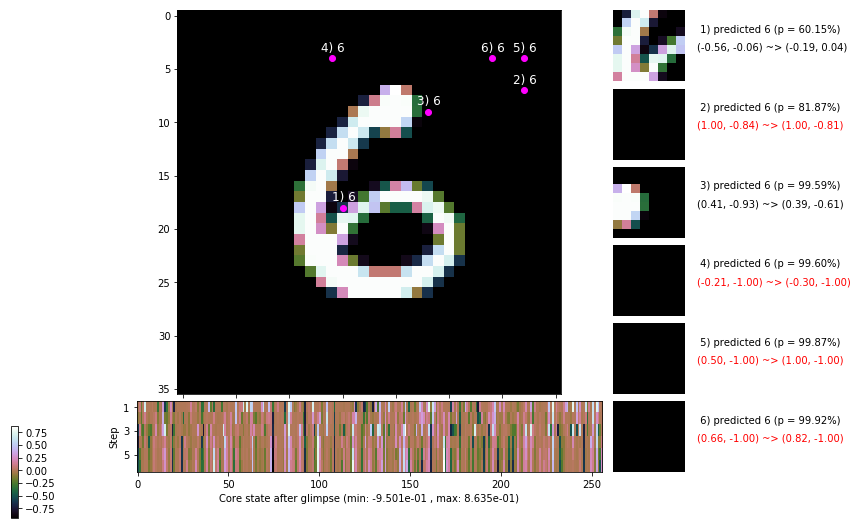

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 134.3 ms/b | lr: 1.65e-04 | grad 2norm: 11.83 | grad inf norm:  3.707
         Weights || abs max:  2.96 ( 2048.09) | mean: -5.73e-04 ( 0.01) | var: 8.88e-02 (   96.74)
          Biases || abs max:  1.51 (  371.20) | mean: -1.42e-01 ( 0.26) | var: 1.01e-01 ( 1042.78)
                    class loss: 0.314 | steps: 2.181 | reward:  3.851 | acc.: 89.95%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 126.6 ms/b | lr: 1.65e-04 | grad 2norm: 11.92 | grad inf norm:  3.693
         Weights || abs max:  2.96 ( 1612.69) | mean: -5.78e-04 ( 0.01) | var: 8.88e-02 (  145.43)
          Biases || abs max:  1.51 (  227.31) | mean: -1.42e-01 ( 0.18) | var: 1.01e-01 (  388.99)
                    class loss: 0.319 | steps: 2.201 | reward:  3.775 | acc.: 89.27%

	Target class: 7 | Discounted rewards: [1.969, 1.938, 1.8

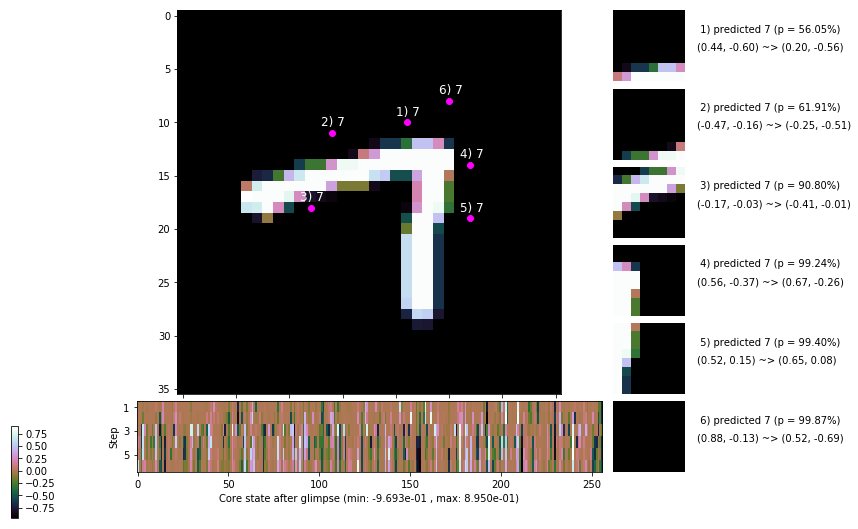

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 8 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


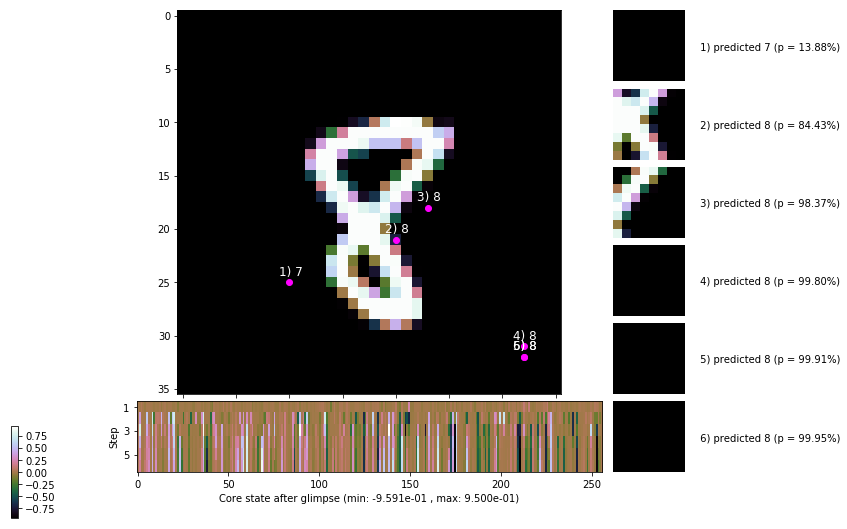


	Target class: 5 | Discounted rewards: [0.984, -0.031, 0.938, -0.125, 0.750, -0.500]


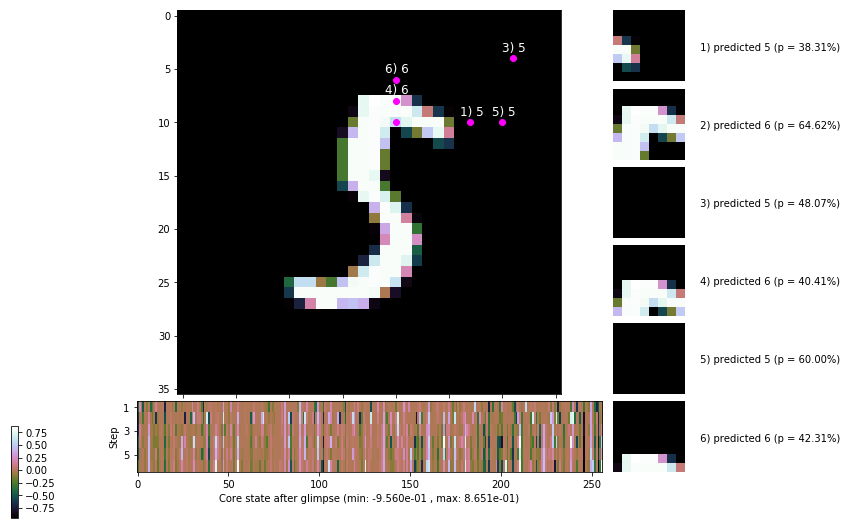

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


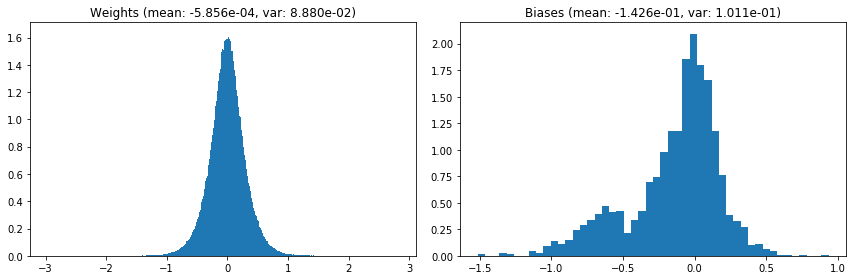

                                      Location network weights and biases


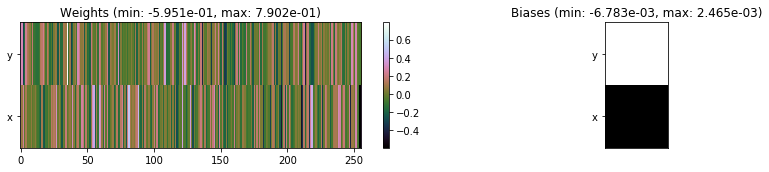

---------------------------------------------------------------------------------------------------------------
Elapsed time:  383.23 sec | TRAIN >> class loss: 0.3168 | steps:  2.184 :( | reward:  3.8120 :( | acc.: 89.325% :(
                          | VAL   >> class loss: 0.2799 | steps:  2.080 :( | reward:  4.0311 :( | acc.: 90.700% :(


Epoch 121/400) lr = 0.0001652
 b    300/  3000 >> 124.4 ms/b | lr: 1.65e-04 | grad 2norm: 12.12 | grad inf norm:  3.840
         Weights || abs max:  2.96 ( 1304.66) | mean: -5.84e-04 ( 0.01) | var: 8.88e-02 (   22.90)
          Biases || abs max:  1.51 (  331.06) | mean: -1.43e-01 ( 0.24) | var: 1.01e-01 (  312.97)
                    class loss: 0.316 | steps: 2.198 | reward:  3.782 | acc.: 89.08%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 129.4 ms/b | lr: 1.65e-04 | grad 2norm: 12.28 | grad inf norm:  3.914
         Weights || abs max:  2.96 ( 9971.32) | mean: -5.83e-04 (

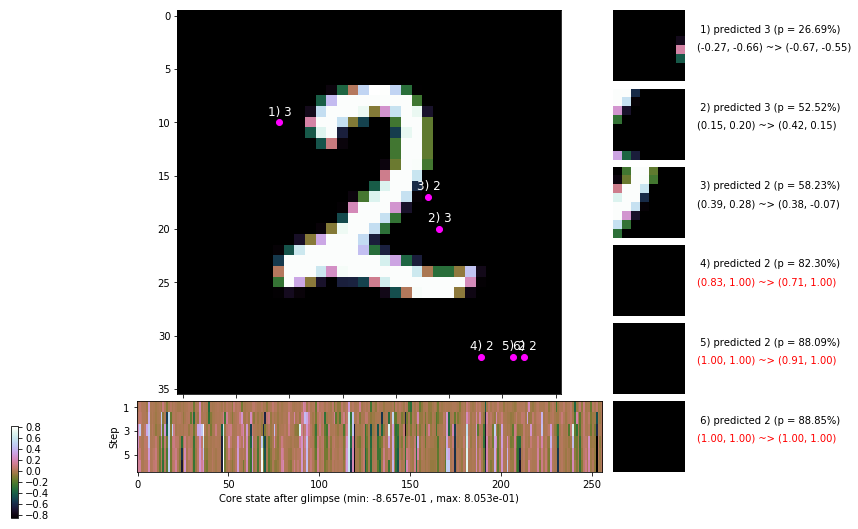

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 125.5 ms/b | lr: 1.64e-04 | grad 2norm: 11.99 | grad inf norm:  3.922
         Weights || abs max:  2.96 ( 1575.52) | mean: -5.84e-04 ( 0.01) | var: 8.88e-02 (   38.15)
          Biases || abs max:  1.52 (  672.34) | mean: -1.43e-01 ( 0.39) | var: 1.01e-01 ( 1554.33)
                    class loss: 0.322 | steps: 2.193 | reward:  3.775 | acc.: 89.07%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 126.2 ms/b | lr: 1.64e-04 | grad 2norm: 11.91 | grad inf norm:  3.725
         Weights || abs max:  2.96 ( 2400.31) | mean: -5.87e-04 ( 0.01) | var: 8.88e-02 (  383.44)
          Biases || abs max:  1.52 (  205.38) | mean: -1.43e-01 ( 0.17) | var: 1.01e-01 (   44.69)
                    class loss: 0.315 | steps: 2.206 | reward:  3.780 | acc.: 89.05%

	Target class: 5 | Discounted rewards: [1.969, 1.938, 1.8

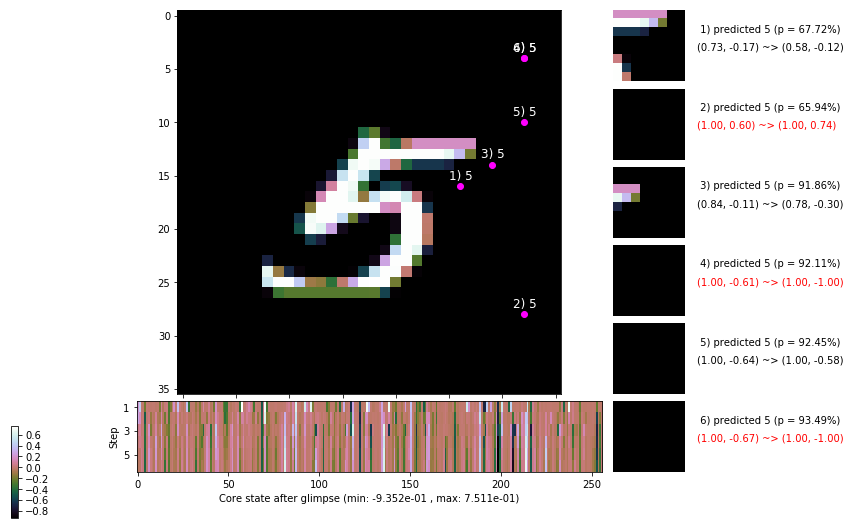

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 127.8 ms/b | lr: 1.64e-04 | grad 2norm: 11.88 | grad inf norm:  3.665
         Weights || abs max:  2.96 (25581.27) | mean: -5.86e-04 ( 0.05) | var: 8.88e-02 (320896.50)
          Biases || abs max:  1.51 (  126.22) | mean: -1.43e-01 ( 0.13) | var: 1.01e-01 (   30.38)
                    class loss: 0.312 | steps: 2.181 | reward:  3.799 | acc.: 89.42%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 125.8 ms/b | lr: 1.64e-04 | grad 2norm: 11.70 | grad inf norm:  3.587
         Weights || abs max:  2.96 ( 2614.00) | mean: -5.88e-04 ( 0.01) | var: 8.88e-02 (   88.74)
          Biases || abs max:  1.51 (  109.94) | mean: -1.43e-01 ( 0.13) | var: 1.01e-01 (   41.16)
                    class loss: 0.302 | steps: 2.171 | reward:  3.835 | acc.: 89.85%

	Target class: 4 | Discounted rewards: [1.969, 1.938, 1.

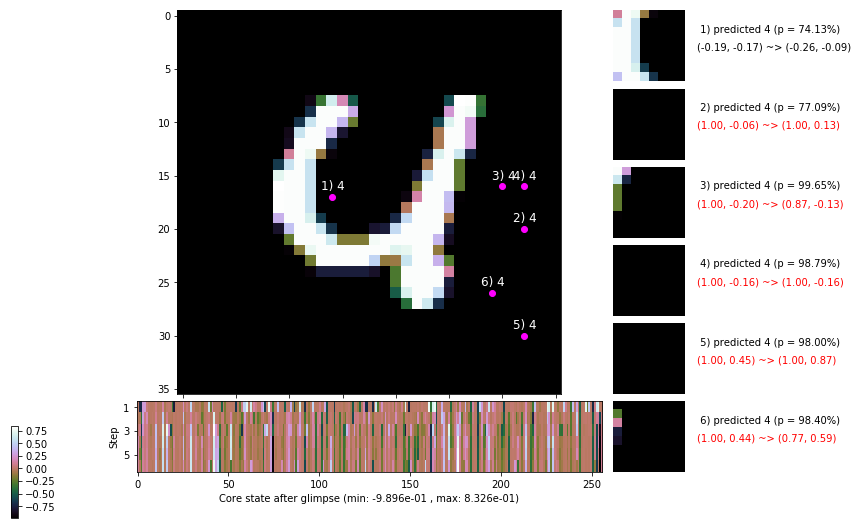

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 131.6 ms/b | lr: 1.64e-04 | grad 2norm: 11.94 | grad inf norm:  3.625
         Weights || abs max:  2.96 ( 2139.10) | mean: -5.93e-04 ( 0.01) | var: 8.88e-02 (  282.51)
          Biases || abs max:  1.51 (  155.77) | mean: -1.42e-01 ( 0.17) | var: 1.01e-01 (   82.57)
                    class loss: 0.321 | steps: 2.211 | reward:  3.756 | acc.: 89.15%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 123.6 ms/b | lr: 1.63e-04 | grad 2norm: 11.84 | grad inf norm:  3.567
         Weights || abs max:  2.96 ( 1772.66) | mean: -5.87e-04 ( 0.01) | var: 8.89e-02 (   53.97)
          Biases || abs max:  1.51 ( 1041.46) | mean: -1.42e-01 ( 0.53) | var: 1.01e-01 (59536.17)
                    class loss: 0.311 | steps: 2.192 | reward:  3.809 | acc.: 89.65%

	Target class: 5 | Discounted rewards: [0.469, 1.938, 1.8

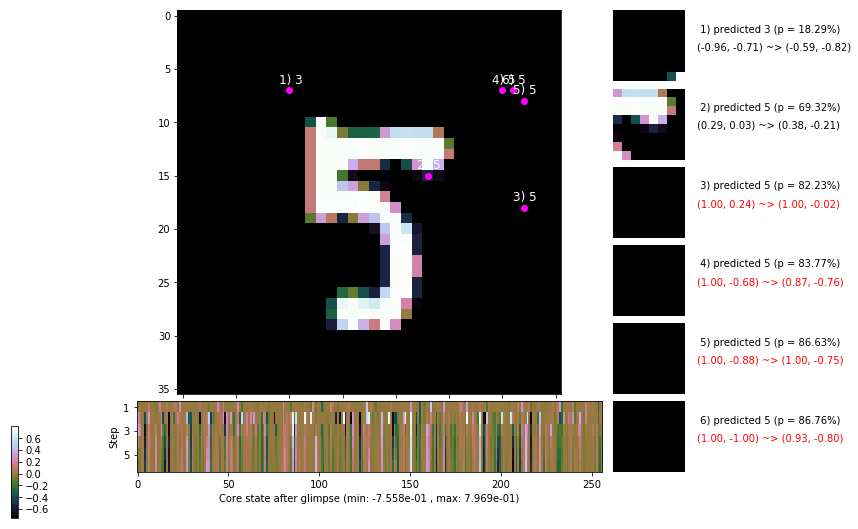

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 126.6 ms/b | lr: 1.63e-04 | grad 2norm: 11.81 | grad inf norm:  3.841
         Weights || abs max:  2.96 ( 1478.11) | mean: -5.88e-04 ( 0.01) | var: 8.89e-02 (   36.84)
          Biases || abs max:  1.51 (  355.08) | mean: -1.43e-01 ( 0.26) | var: 1.01e-01 (  540.32)
                    class loss: 0.316 | steps: 2.194 | reward:  3.801 | acc.: 89.40%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 130.6 ms/b | lr: 1.63e-04 | grad 2norm: 11.80 | grad inf norm:  3.583
         Weights || abs max:  2.97 ( 2097.53) | mean: -5.86e-04 ( 0.01) | var: 8.89e-02 (  198.77)
          Biases || abs max:  1.51 (  419.13) | mean: -1.43e-01 ( 0.28) | var: 1.01e-01 ( 3244.80)
                    class loss: 0.303 | steps: 2.184 | reward:  3.829 | acc.: 89.70%

	Target class: 4 | Discounted rewards: [-0.281, 0.438, 1.

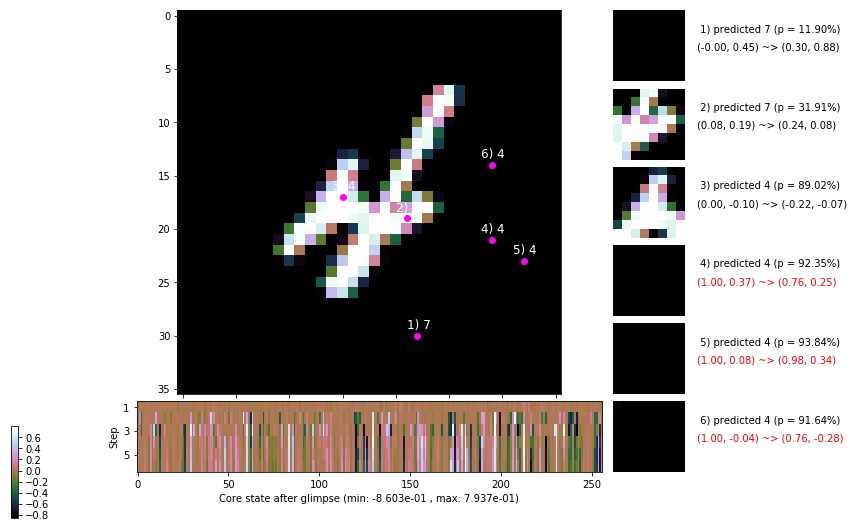

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 1 | Discounted rewards: [-0.281, 0.438, 1.875, 1.750, 1.500, 1.000]


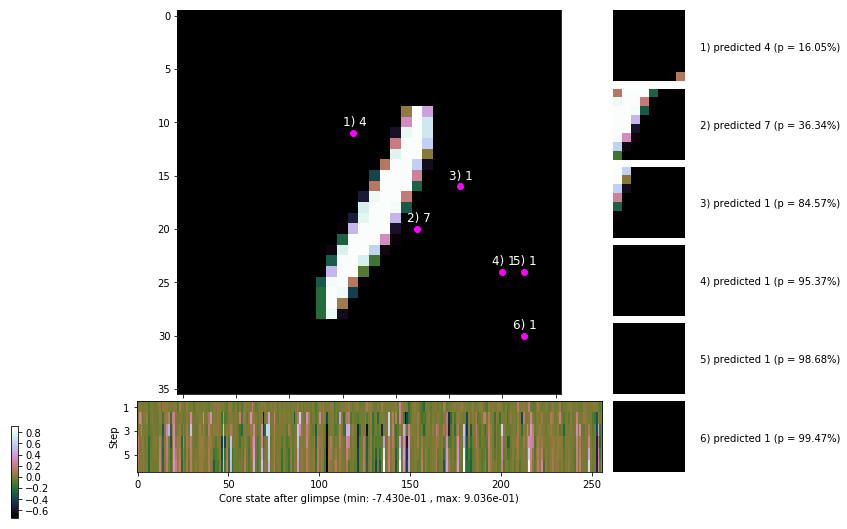


	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


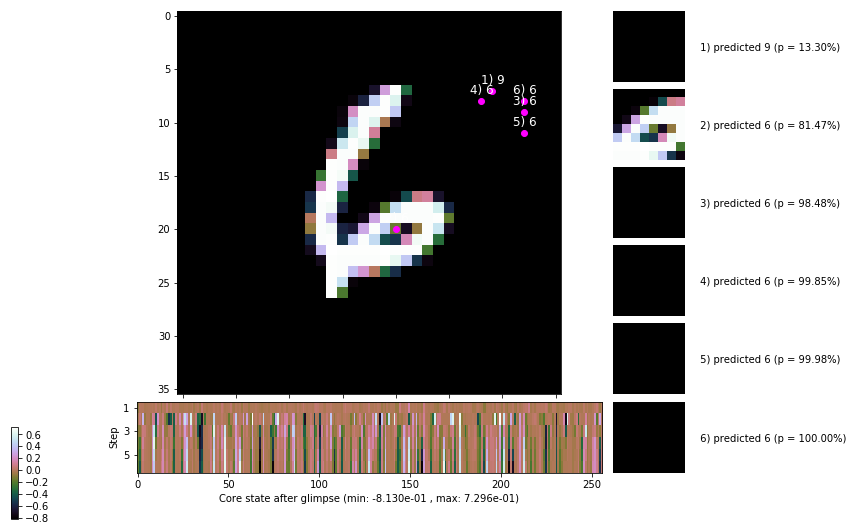

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


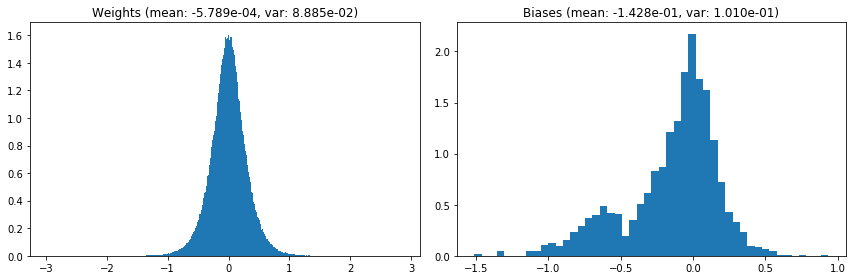

                                      Location network weights and biases


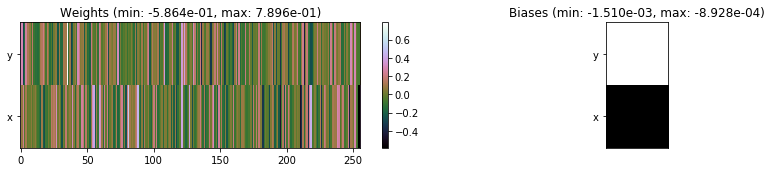

---------------------------------------------------------------------------------------------------------------
Elapsed time:  381.97 sec | TRAIN >> class loss: 0.3128 | steps:  2.191 :( | reward:  3.7984 :( | acc.: 89.352% :(
                          | VAL   >> class loss: 0.2860 | steps:  2.071 :( | reward:  4.0116 :( | acc.: 90.080% :(


Epoch 122/400) lr = 0.0001627
 b    300/  3000 >> 126.9 ms/b | lr: 1.63e-04 | grad 2norm: 12.00 | grad inf norm:  3.610
         Weights || abs max:  2.97 ( 2749.69) | mean: -5.82e-04 ( 0.01) | var: 8.89e-02 (  314.67)
          Biases || abs max:  1.51 ( 9405.39) | mean: -1.43e-01 ( 3.76) | var: 1.01e-01 (6507000.50)
                    class loss: 0.324 | steps: 2.227 | reward:  3.752 | acc.: 89.10%
                 --------------------------------------------------------------------------------
 b    600/  3000 >> 130.8 ms/b | lr: 1.62e-04 | grad 2norm: 11.88 | grad inf norm:  3.694
         Weights || abs max:  2.97 ( 4079.06) | mean: -5.82e-04

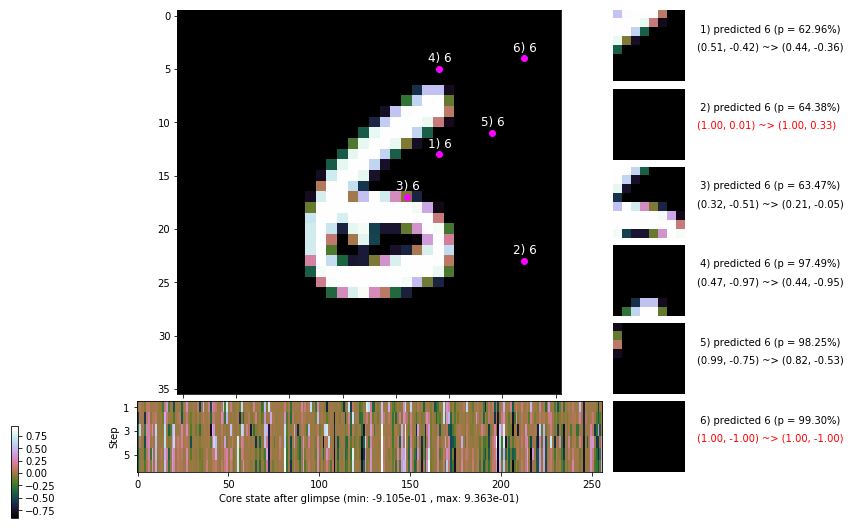

                 --------------------------------------------------------------------------------
 b    900/  3000 >> 131.3 ms/b | lr: 1.62e-04 | grad 2norm: 11.75 | grad inf norm:  3.557
         Weights || abs max:  2.97 ( 2652.83) | mean: -5.83e-04 ( 0.01) | var: 8.89e-02 (  312.08)
          Biases || abs max:  1.51 (  237.71) | mean: -1.43e-01 ( 0.18) | var: 1.01e-01 (  214.72)
                    class loss: 0.305 | steps: 2.203 | reward:  3.793 | acc.: 89.60%
                 --------------------------------------------------------------------------------
 b   1200/  3000 >> 130.1 ms/b | lr: 1.62e-04 | grad 2norm: 11.98 | grad inf norm:  3.741
         Weights || abs max:  2.97 ( 3587.64) | mean: -5.84e-04 ( 0.01) | var: 8.89e-02 ( 1203.33)
          Biases || abs max:  1.51 (  226.04) | mean: -1.43e-01 ( 0.19) | var: 1.01e-01 (  135.71)
                    class loss: 0.318 | steps: 2.185 | reward:  3.793 | acc.: 89.22%

	Target class: 0 | Discounted rewards: [0.469, 1.938, 1.8

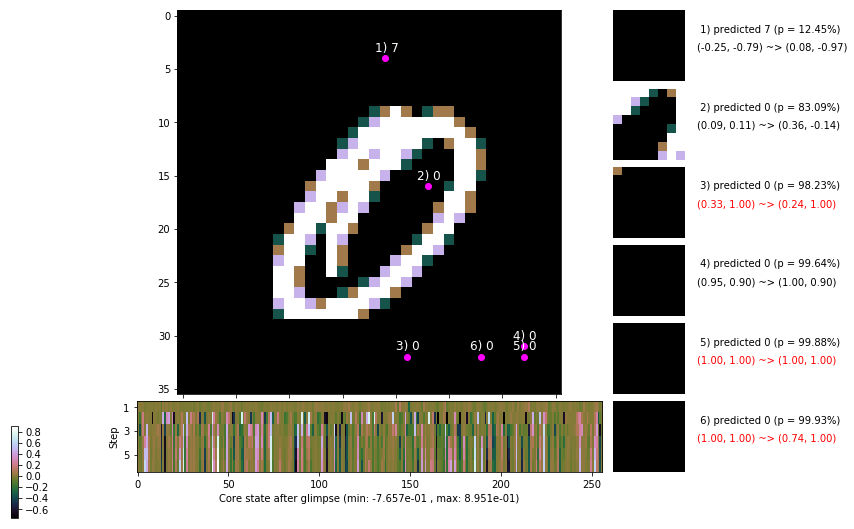

                 --------------------------------------------------------------------------------
 b   1500/  3000 >> 126.7 ms/b | lr: 1.62e-04 | grad 2norm: 12.08 | grad inf norm:  3.847
         Weights || abs max:  2.97 ( 2711.24) | mean: -5.88e-04 ( 0.01) | var: 8.89e-02 (  162.15)
          Biases || abs max:  1.51 (  200.16) | mean: -1.43e-01 ( 0.18) | var: 1.01e-01 (  214.66)
                    class loss: 0.323 | steps: 2.185 | reward:  3.762 | acc.: 88.70%
                 --------------------------------------------------------------------------------
 b   1800/  3000 >> 126.1 ms/b | lr: 1.61e-04 | grad 2norm: 11.89 | grad inf norm:  3.609
         Weights || abs max:  2.97 ( 1802.57) | mean: -5.91e-04 ( 0.01) | var: 8.89e-02 (   61.83)
          Biases || abs max:  1.51 (   69.39) | mean: -1.43e-01 ( 0.10) | var: 1.01e-01 (   12.51)
                    class loss: 0.312 | steps: 2.180 | reward:  3.819 | acc.: 89.68%

	Target class: 9 | Discounted rewards: [-0.609, -0.219, 0

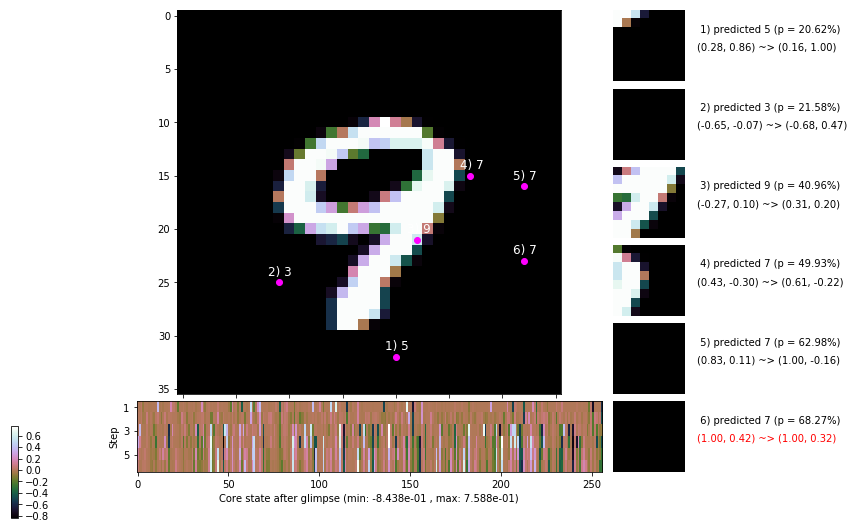

                 --------------------------------------------------------------------------------
 b   2100/  3000 >> 127.6 ms/b | lr: 1.61e-04 | grad 2norm: 11.89 | grad inf norm:  3.675
         Weights || abs max:  2.97 ( 1622.62) | mean: -5.94e-04 ( 0.01) | var: 8.89e-02 (   74.89)
          Biases || abs max:  1.51 (   82.23) | mean: -1.43e-01 ( 0.12) | var: 1.01e-01 (   14.81)
                    class loss: 0.326 | steps: 2.201 | reward:  3.812 | acc.: 89.38%
                 --------------------------------------------------------------------------------
 b   2400/  3000 >> 124.6 ms/b | lr: 1.61e-04 | grad 2norm: 11.95 | grad inf norm:  3.582
         Weights || abs max:  2.97 ( 1893.42) | mean: -5.91e-04 ( 0.01) | var: 8.89e-02 (   84.20)
          Biases || abs max:  1.51 (  149.18) | mean: -1.43e-01 ( 0.14) | var: 1.01e-01 (   68.60)
                    class loss: 0.322 | steps: 2.209 | reward:  3.771 | acc.: 89.17%

	Target class: 6 | Discounted rewards: [-0.281, 0.438, 1.

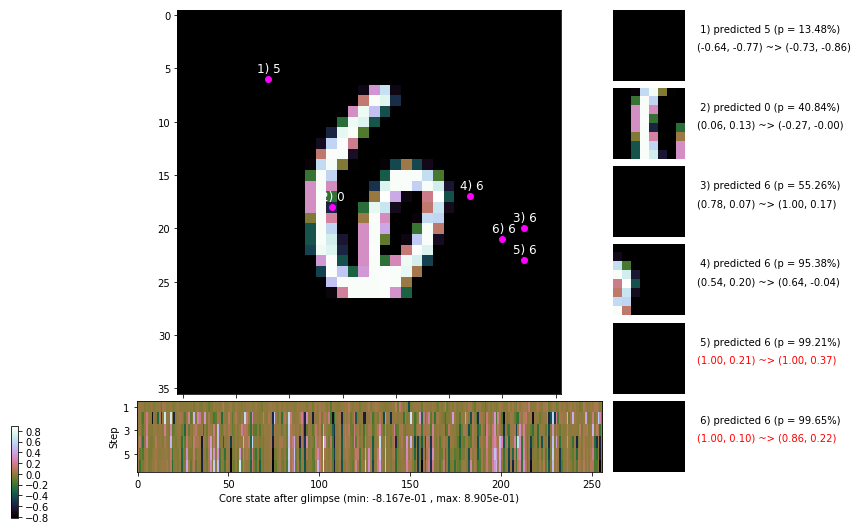

                 --------------------------------------------------------------------------------
 b   2700/  3000 >> 130.0 ms/b | lr: 1.61e-04 | grad 2norm: 12.04 | grad inf norm:  3.819
         Weights || abs max:  2.97 ( 5384.13) | mean: -5.82e-04 ( 0.02) | var: 8.89e-02 ( 1107.08)
          Biases || abs max:  1.51 (  134.01) | mean: -1.43e-01 ( 0.13) | var: 1.01e-01 (   17.98)
                    class loss: 0.338 | steps: 2.210 | reward:  3.765 | acc.: 88.83%
                 --------------------------------------------------------------------------------
 b   3000/  3000 >> 124.7 ms/b | lr: 1.60e-04 | grad 2norm: 11.95 | grad inf norm:  3.571
         Weights || abs max:  2.97 ( 3137.04) | mean: -5.82e-04 ( 0.01) | var: 8.89e-02 (  281.81)
          Biases || abs max:  1.51 (  146.60) | mean: -1.43e-01 ( 0.14) | var: 1.01e-01 (   97.02)
                    class loss: 0.327 | steps: 2.169 | reward:  3.818 | acc.: 89.13%

	Target class: 5 | Discounted rewards: [1.031, 0.062, 1.1

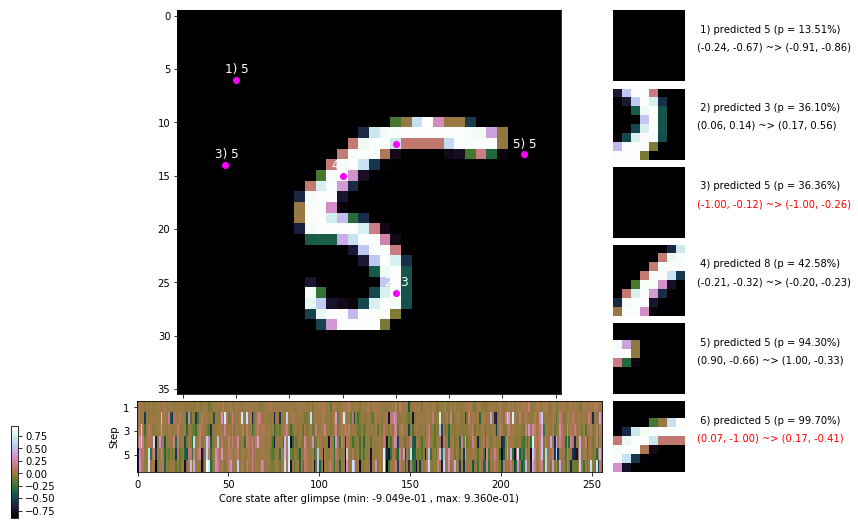

                 --------------------------------------------------------------------------------
                                          ---===  VALIDATION  ===---

	Target class: 6 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


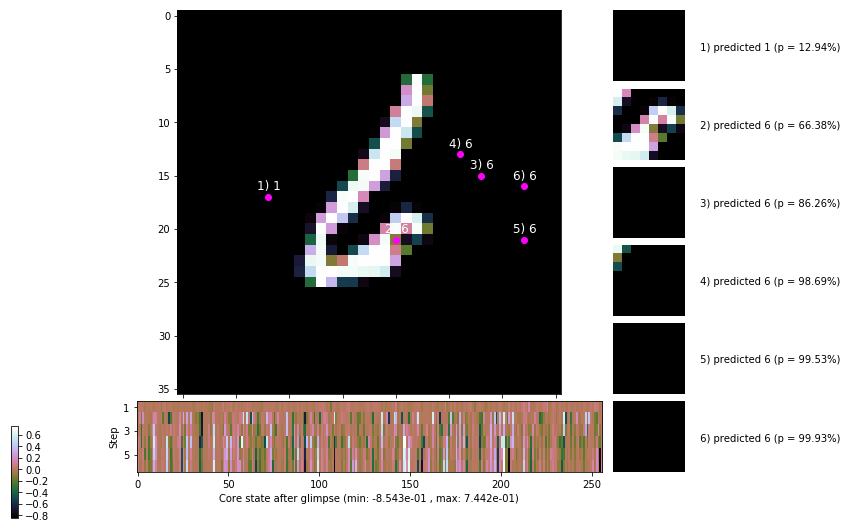


	Target class: 0 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


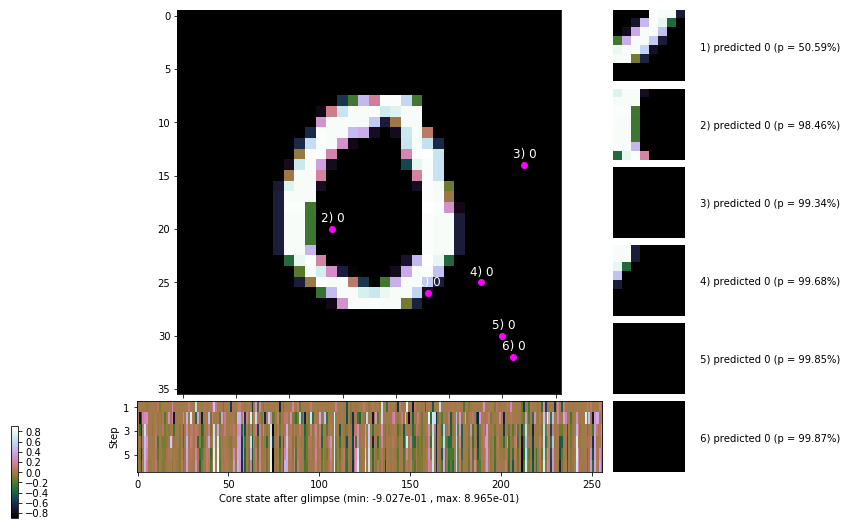

                                    ---===  MODEL PARAM DIAGNOSTICS  ===---


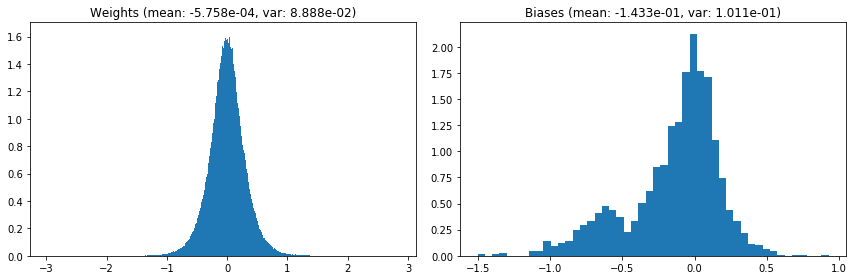

                                      Location network weights and biases


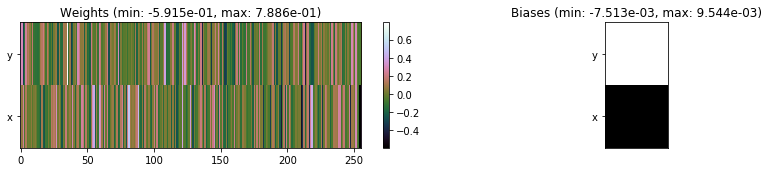

---------------------------------------------------------------------------------------------------------------
Elapsed time:  384.44 sec | TRAIN >> class loss: 0.3211 | steps:  2.193 :( | reward:  3.7929 :( | acc.: 89.223% :(
                          | VAL   >> class loss: 0.3008 | steps:  2.077 :( | reward:  3.9867 :( | acc.: 89.740% :(



			---~~~=== End of training ===~~~---

Evaluating on the TEST dataset...

	Target class: 1 | Discounted rewards: [1.969, 1.938, 1.875, 1.750, 1.500, 1.000]


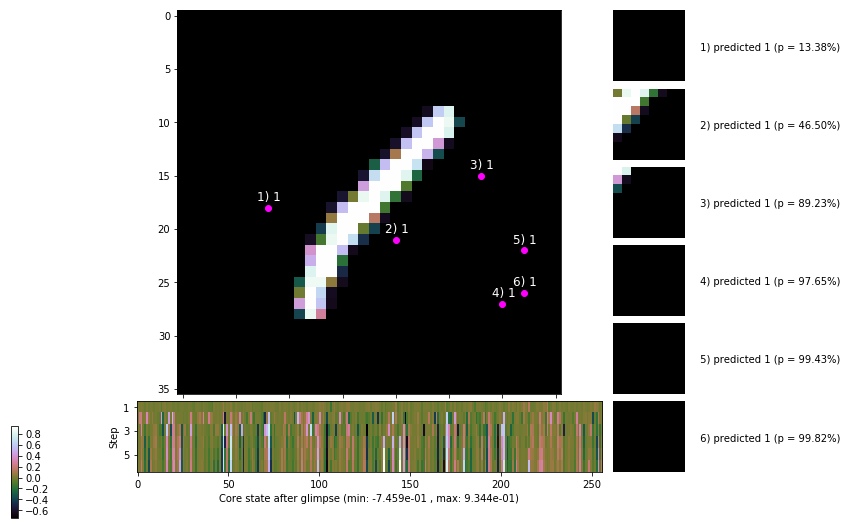


	Target class: 4 | Discounted rewards: [0.469, 1.938, 1.875, 1.750, 1.500, 1.000]


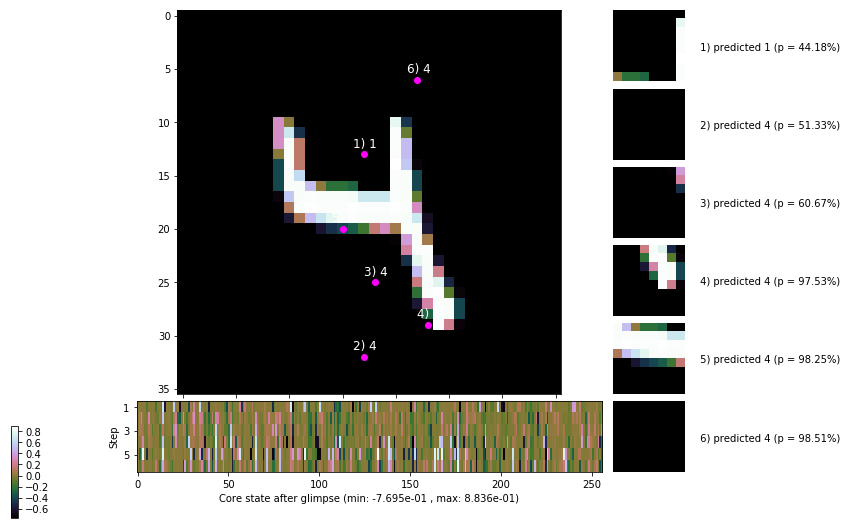

	>> class loss: 0.2740 | steps:  2.058 | reward:  4.0452 | acc.: 90.380%


In [7]:
model_info, train_info, val_info, test_info, epochs = train_eval_loop(
    model = model, epochs = num_epochs, image_size = image_size,
    train_data = train_data, val_data = val_data, test_data = test_data,
    padding = padding, optimizer = optimizer, lr_scheduler = lr_scheduler,
    class_criterion = class_criterion, error_penalty = error_penalty,
    loc_std = loc_std, random_start_loc = random_start_loc, gamma = gamma,
    grad_clip = grad_clip, steps_per_epoch = steps_per_epoch,
    max_ep_len = max_ep_len, log_freq = log_freq, viz_freq = viz_freq,
    early_stopping = early_stopping, eval_viz_freq = eval_viz_freq,
    reward_all_correct = True
)

In [8]:
print('Trained over %d epochs\n' % epochs)

for name, best_stats in zip(['train', 'val'], [train_info['bests'], val_info['bests']]):
    print('Best %s stats:' % name)
    for k, v in best_stats.items():
        print('    %s: %.3f (epoch %d)' % (k, v[k], v['epoch']))
    print('')

Trained over 122 epochs

Best train stats:
    steps: 2.18 (epoch 114)
    reward: 3.82 (epoch 87)
    accuracy: 0.90 (epoch 87)

Best val stats:
    steps: 2.06 (epoch 105)
    reward: 4.07 (epoch 113)
    accuracy: 0.91 (epoch 113)



### Training curves

In [9]:
epoch_range = range(1, epochs+1)
train_col = (1, 0, 0); train_err_col = (1, 0.1, 0.1)
val_col = (0, 0, 1); val_err_col = (0.1, 0.1, 1)

Text(0.5,1,'Weight and bias values over training time')

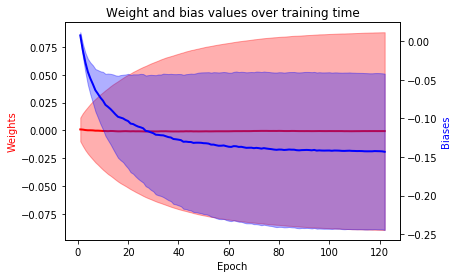

In [10]:
wts_mean = np.array(model_info['weights']['mean'])
wts_var = np.array(model_info['weights']['var'])
bias_mean = np.array(model_info['biases']['mean'])
bias_var = np.array(model_info['biases']['var'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_mean, color = train_col, linewidth = 2)
wts_ax.fill_between(epoch_range,
    wts_mean - wts_var, wts_mean + wts_var,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_mean, color = val_col, linewidth = 2)
bias_ax.fill_between(epoch_range,
    bias_mean - bias_var, bias_mean + bias_var,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Weight and bias values over training time')

Text(0.5,1,'Max absolute weight and bias values over training time')

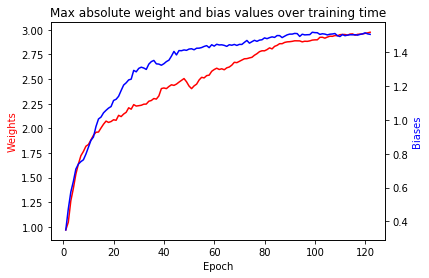

In [11]:
wts_absmax = np.array(model_info['weights']['abs max'])
bias_absmax = np.array(model_info['biases']['abs max'])

fig, wts_ax = plt.subplots()
wts_ax.plot(epoch_range, wts_absmax, color = train_col)
wts_ax.set_xlabel('Epoch')
wts_ax.set_ylabel('Weights', color = train_col)

bias_ax = wts_ax.twinx()
bias_ax.plot(epoch_range, bias_absmax, color = val_col)
bias_ax.set_ylabel('Biases', color = val_col)

plt.title('Max absolute weight and bias values over training time')

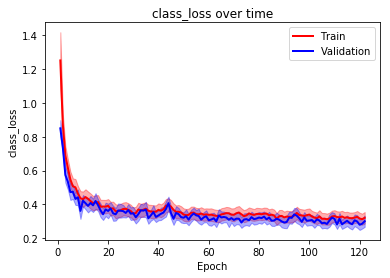

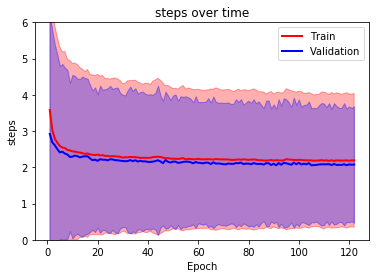

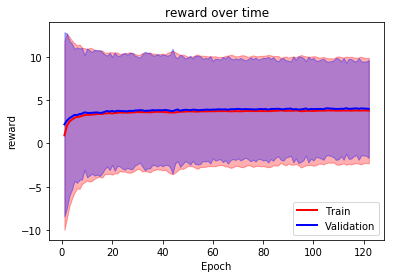

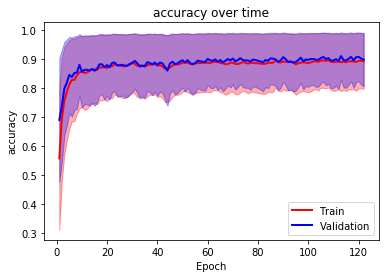

In [12]:
things_to_plot = ['class_loss', 'steps', 'reward', 'accuracy']
for thing in things_to_plot:
    train_avg = np.array([info['averages'][thing] for info in train_info['stats']])
    train_err = np.array([np.var(info['histories'][thing]) for info in train_info['stats']])
    
    val_avg = np.array([info['averages'][thing] for info in val_info['stats']])
    val_err = np.array([np.var(info['histories'][thing]) for info in val_info['stats']])
    
    plt.plot(epoch_range, train_avg, color = train_col, linewidth = 2)
    plt.plot(epoch_range, val_avg, color = val_col, linewidth = 2)
    plt.fill_between(epoch_range,
        train_avg - train_err, train_avg + train_err, alpha = 0.35,
        edgecolor = train_col, facecolor = train_err_col
    )
    plt.fill_between(epoch_range,
        val_avg - val_err, val_avg + val_err, alpha = 0.35,
        edgecolor = val_col, facecolor = val_err_col
    )
    if thing == 'steps':
        plt.ylim([0, 6])
    plt.legend(['Train', 'Validation'], loc = 'upper right' if thing in ['class_loss', 'steps'] else 'lower right')
    plt.xlabel('Epoch'); plt.ylabel(thing)
    plt.title('%s over time' % thing)
    plt.show()
    print('')

Text(0.5,1,'Gradient norms over training time')

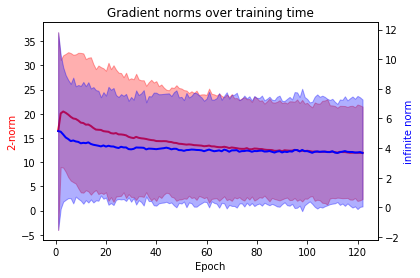

In [13]:
# Gradient stats
grad_2norm = np.array([info['averages']['grad_2norm'] for info in train_info['stats']])
grad_inf_norm = np.array([info['averages']['grad_inf_norm'] for info in train_info['stats']])
grad_2norm_err = np.array([np.var(info['histories']['grad_2norm']) for info in train_info['stats']])
grad_inf_norm_err = np.array([np.var(info['histories']['grad_inf_norm']) for info in train_info['stats']])

fig, pnorm_ax = plt.subplots()
pnorm_ax.plot(epoch_range, grad_2norm, color = train_col, linewidth = 2)
pnorm_ax.fill_between(epoch_range,
    grad_2norm - grad_2norm_err, grad_2norm + grad_2norm_err,
    alpha = 0.35, edgecolor = train_col, facecolor = train_err_col
)
pnorm_ax.set_xlabel('Epoch');
pnorm_ax.set_ylabel('2-norm', color = train_col)

infnorm_ax = pnorm_ax.twinx()
infnorm_ax.plot(epoch_range, grad_inf_norm, color = val_col, linewidth = 2)
infnorm_ax.fill_between(epoch_range,
    grad_inf_norm - grad_inf_norm_err, grad_inf_norm + grad_inf_norm_err,
    alpha = 0.35, edgecolor = val_col, facecolor = val_err_col
)
infnorm_ax.set_ylabel('infinite norm', color = val_col)

plt.title('Gradient norms over training time')